

## Using GANs to generate Brain Tumor MRI images for Data Augmentation


# Generative Adversarial Networks

<p style="font-size:20px">Generative adversarial networks are implicit likelihood models that generate data samples from the statistical distribution of the data. They’re used to copy variations within the dataset. They use a combination of two networks: generator and discriminator.</p>
<br>
<img src="https://debuggercafe.com/wp-content/uploads/2020/07/gan.png" />



## <u> The Generator: </u>
<p style="font-size:20px"> The generator is a part of GAN that learns to create fake data by incorporating feedback from the discriminator. A generator network takes a random normal distribution (z), and outputs a generated sample that’s close to the original distribution. It learns to make the discriminator classify its output as real.</p>

## <u> The Discriminator: </u>
<p style="font-size:20px">The discriminator in a GAN is simply a classifier. It tries to distinguish real data from the data created by the generator. It could use any network architecture appropriate to the type of data it's classifying.</p>

## <u> A Complete GAN model: </u>

<br><img src="https://www.mdpi.com/applsci/applsci-11-02913/article_deploy/html/images/applsci-11-02913-g001.png">

## <u> How do GANs work ? </u>

<p style="font-size:20px">Both the generator and the discriminator are neural networks. The generator output is connected directly to the discriminator input. Through backpropagation, the discriminator's classification provides a signal that the generator uses to update its weights.<br>
The generator learns to generate plausible data. The generated instances become negative training examples for the discriminator.
The discriminator learns to distinguish the generator's fake data from real data. The discriminator penalizes the generator for producing implausible results. <br>
When training begins, the generator produces obviously fake data, and the discriminator quickly learns to tell that it's fake. As training progresses, the generator gets closer to producing output that can fool the discriminator. Eventually, if generator training goes well, the discriminator gets worse at telling the difference between real and fake. It starts to classify fake data as real, and its accuracy decreases. That means the output generated by Generator is so good that the Discriminator could no longer differentiate between real and fake.
</p>

## <u> Loss Function </u>

<br><img src="https://i0.wp.com/neptune.ai/wp-content/uploads/GANs-equation.png?resize=509%2C53&ssl=1" style="width:900px; height:100px;">

<p style="font-size:20px">The loss function, also known as the value function, which evaluates the disparity between the generated data distribution and the real data distribution, holds the key to generating good fakes. There are separate loss functions for the generator and discriminator. In contrast to the discriminator, who seeks to maximise, the generator attempts to reduce the loss function..</p>

## Importing Libraries

In [1]:
import numpy as np 
import matplotlib.pyplot as plt 
from tqdm import tqdm
import cv2
import os
import seaborn as sns
import tensorflow as tf

from keras.models import Sequential, Model
from keras.layers import Dense, Flatten, Conv2D, Reshape, Input, Conv2DTranspose
from keras.layers import Activation, LeakyReLU, BatchNormalization, Dropout, Resizing
from keras.losses import BinaryCrossentropy

import warnings
warnings.filterwarnings('ignore')

try:
    from tensorflow.keras.optimizers import Adam
except:
    from keras.optimizers import Adam

In [2]:
NOISE_DIM = 100  
BATCH_SIZE = 4 
STEPS_PER_EPOCH = 3750
EPOCHS = 10
SEED = 40
WIDTH, HEIGHT, CHANNELS = 128, 128, 1

OPTIMIZER = Adam(0.0002, 0.5)

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
MAIN_DIR = "/content/drive/MyDrive/Datasets/Brain_Tumor_MR_ Classification/Training/glioma"

# Loading and Preprocessing the Images

In [5]:
def load_images(folder):
    
    imgs = []
    target = 1
    labels = []
    for i in os.listdir(folder):
        img_dir = os.path.join(folder,i)
        try:
            img = cv2.imread(img_dir)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            img = cv2.resize(img, (128,128))
            imgs.append(img)
            labels.append(target)
        except:
            continue
        
    imgs = np.array(imgs)
    labels = np.array(labels)
    
    return imgs, labels

In [6]:
data, labels = load_images(MAIN_DIR)
data.shape, labels.shape

((1321, 128, 128), (1321,))

## Generate 20 random numbers to index images from data

In [7]:
np.random.seed(SEED)
idxs = np.random.randint(0, 155, 20)

In [8]:
X_train = data[idxs]
X_train.shape

(20, 128, 128)

## Normalize and Reshape the Data

In [9]:
# Normalize the Images
X_train = (X_train.astype(np.float32) - 127.5) / 127.5

# Reshape images 
X_train = X_train.reshape(-1, WIDTH,HEIGHT,CHANNELS)

# Check shape
X_train.shape

(20, 128, 128, 1)

In [10]:
X_train1 = np.squeeze(X_train)
X_train1.shape

(20, 128, 128)

## Plotting The Real Images

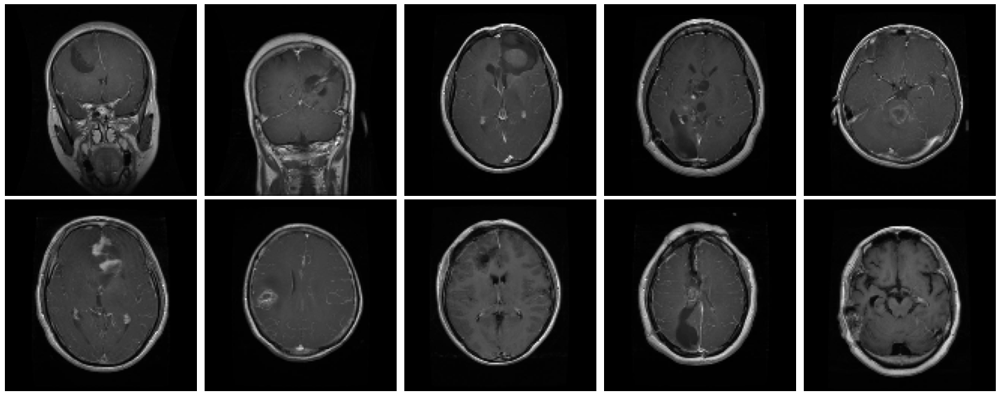

In [11]:
plt.figure(figsize=(20,8))
for i in range(10):
    axs = plt.subplot(2,5,i+1)
    plt.imshow(X_train1[i],cmap="gray")
    plt.axis('off')
    axs.set_xticklabels([])
    axs.set_yticklabels([])
    plt.subplots_adjust(wspace=None, hspace=None)
plt.tight_layout()

# The Architecture

### Building Generator 

In [12]:
def build_generator():

    model = Sequential([

        Dense(32*32*256, input_dim=NOISE_DIM),
        LeakyReLU(alpha=0.2),
        Reshape((32,32,256)),
        
        Conv2DTranspose(128, (4, 4), strides=2, padding='same'),
        LeakyReLU(alpha=0.2),

        Conv2DTranspose(128, (4, 4), strides=2, padding='same'),
        LeakyReLU(alpha=0.2),

        Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh')
    ], 
    name="GAN_Generator")
    model.summary()
    model.compile(loss="binary_crossentropy", optimizer=OPTIMIZER)

    return model

### Building Discriminator

In [13]:
def build_discriminator():
    
    model = Sequential([

        Conv2D(64, (3, 3), padding='same', input_shape=(WIDTH, HEIGHT, CHANNELS)),
        LeakyReLU(alpha=0.2),

        Conv2D(128, (3, 3), strides=2, padding='same'),
        LeakyReLU(alpha=0.2),

        Conv2D(128, (3, 3), strides=2, padding='same'),
        LeakyReLU(alpha=0.2),
        
        Conv2D(256, (3, 3), strides=2, padding='same'),
        LeakyReLU(alpha=0.2),
        
        Flatten(),
        Dropout(0.4),
        Dense(1, activation="sigmoid", input_shape=(WIDTH, HEIGHT, CHANNELS))
    ], name="GAN_Discriminator")
    model.summary()
    model.compile(loss="binary_crossentropy",
                        optimizer=OPTIMIZER)

    return model

### Generator Discrimnator Architecture summary

In [14]:
print('\n')
discriminator = build_discriminator()
print('\n')
generator = build_generator()



Model: "GAN_Discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 64)      640       
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 128, 128, 64)      0         
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 128)       73856     
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 64, 64, 128)       0         
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 128)       147584    
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (None, 32, 32, 128)       0         
                                                                 
 conv2d_3 (Conv2D)           (None, 16, 16, 256

### Combining Generator and Discriminator to make a whole GAN Network

In [15]:
discriminator.trainable = False 

gan_input = Input(shape=(NOISE_DIM,))
fake_image = generator(gan_input)

gan_output = discriminator(fake_image)

gan = Model(gan_input, gan_output, name="GAN_Model")
gan.compile(loss="binary_crossentropy", optimizer=OPTIMIZER)
print("The Whole GAN Network:\n")
gan.summary()

The Whole GAN Network:

Model: "GAN_Model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 100)]             0         
                                                                 
 GAN_Generator (Sequential)  (None, 128, 128, 1)       27265281  
                                                                 
 GAN_Discriminator (Sequenti  (None, 1)                582785    
 al)                                                             
                                                                 
Total params: 27,848,066
Trainable params: 27,265,281
Non-trainable params: 582,785
_________________________________________________________________


In [16]:
def sample_images(noise, subplots, figsize=(22,8), save=False):
    generated_images = generator.predict(noise)
    plt.figure(figsize=figsize)
    
    for i, image in enumerate(generated_images):
        plt.subplot(subplots[0], subplots[1], i+1)
        if CHANNELS == 1:
            plt.imshow(image.reshape((WIDTH, HEIGHT)), cmap='gray')    
                                                                            
        else:
            plt.imshow(image.reshape((WIDTH, HEIGHT, CHANNELS)))
        if save == True:
            img_name = "gen" + str(i)
            plt.savefig(img_name)
        plt.subplots_adjust(wspace=None, hspace=None)
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

## The Training

  0%|          | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 9s 9s/step


  0%|          | 1/3750 [00:10<11:19:56, 10.88s/it]

1/1 [==============================] - 0s 15ms/step


  0%|          | 2/3750 [00:10<4:43:40,  4.54s/it] 

1/1 [==============================] - 0s 15ms/step


  0%|          | 4/3750 [00:11<1:49:38,  1.76s/it]

1/1 [==============================] - 0s 16ms/step


  0%|          | 5/3750 [00:11<1:17:40,  1.24s/it]

1/1 [==============================] - 0s 18ms/step


  0%|          | 7/3750 [00:11<44:02,  1.42it/s]  

1/1 [==============================] - 0s 16ms/step


  0%|          | 9/3750 [00:11<28:48,  2.16it/s]

1/1 [==============================] - 0s 15ms/step


  0%|          | 11/3750 [00:11<20:41,  3.01it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 12/3750 [00:11<17:42,  3.52it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 13/3750 [00:12<15:09,  4.11it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 14/3750 [00:12<12:58,  4.80it/s]

1/1 [==============================] - 0s 15ms/step


  0%|          | 15/3750 [00:12<11:24,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 17/3750 [00:12<09:12,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 18/3750 [00:12<08:37,  7.21it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 19/3750 [00:12<08:03,  7.72it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 20/3750 [00:12<07:41,  8.07it/s]

1/1 [==============================] - 0s 15ms/step


  1%|          | 22/3750 [00:13<06:56,  8.95it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 23/3750 [00:13<07:01,  8.84it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 24/3750 [00:13<06:52,  9.03it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 25/3750 [00:13<06:49,  9.09it/s]

1/1 [==============================] - 0s 15ms/step


  1%|          | 27/3750 [00:13<06:32,  9.48it/s]

1/1 [==============================] - 0s 16ms/step


  1%|          | 28/3750 [00:13<06:31,  9.51it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 29/3750 [00:13<06:34,  9.43it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 30/3750 [00:13<06:38,  9.33it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 31/3750 [00:13<06:44,  9.20it/s]

1/1 [==============================] - 0s 16ms/step


  1%|          | 32/3750 [00:14<06:35,  9.39it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 34/3750 [00:14<06:21,  9.73it/s]

1/1 [==============================] - 0s 16ms/step


  1%|          | 35/3750 [00:14<06:30,  9.50it/s]

1/1 [==============================] - 0s 16ms/step


  1%|          | 36/3750 [00:14<06:39,  9.29it/s]

1/1 [==============================] - 0s 15ms/step


  1%|          | 38/3750 [00:14<06:23,  9.67it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 40/3750 [00:14<06:21,  9.72it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 41/3750 [00:15<06:20,  9.74it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 42/3750 [00:15<06:18,  9.79it/s]

1/1 [==============================] - 0s 16ms/step


  1%|          | 43/3750 [00:15<06:18,  9.79it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 44/3750 [00:15<06:18,  9.79it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 45/3750 [00:15<06:20,  9.74it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 46/3750 [00:15<06:18,  9.80it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 48/3750 [00:15<06:09, 10.01it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 49/3750 [00:15<06:12,  9.95it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 50/3750 [00:15<06:20,  9.74it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 51/3750 [00:16<06:19,  9.74it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 53/3750 [00:16<06:09, 10.02it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 54/3750 [00:16<06:13,  9.89it/s]

1/1 [==============================] - 0s 16ms/step


  1%|▏         | 55/3750 [00:16<06:30,  9.46it/s]

1/1 [==============================] - 0s 16ms/step


  1%|▏         | 56/3750 [00:16<06:30,  9.47it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 57/3750 [00:16<06:28,  9.51it/s]

1/1 [==============================] - 0s 15ms/step


  2%|▏         | 58/3750 [00:16<06:23,  9.64it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 59/3750 [00:16<06:19,  9.71it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 60/3750 [00:16<07:09,  8.58it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 61/3750 [00:17<07:00,  8.78it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 62/3750 [00:17<06:56,  8.86it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 63/3750 [00:17<06:43,  9.14it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 64/3750 [00:17<06:37,  9.28it/s]

1/1 [==============================] - 0s 15ms/step


  2%|▏         | 65/3750 [00:17<06:39,  9.22it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 66/3750 [00:17<06:42,  9.16it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 67/3750 [00:17<06:33,  9.36it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 68/3750 [00:17<06:32,  9.39it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 69/3750 [00:17<06:46,  9.06it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 70/3750 [00:18<06:36,  9.29it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 71/3750 [00:18<06:29,  9.46it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 72/3750 [00:18<06:25,  9.55it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 73/3750 [00:18<06:28,  9.46it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 74/3750 [00:18<06:28,  9.45it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 75/3750 [00:18<06:34,  9.31it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 76/3750 [00:18<06:39,  9.21it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 77/3750 [00:18<06:32,  9.36it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 78/3750 [00:18<07:17,  8.40it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 79/3750 [00:19<06:56,  8.80it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 80/3750 [00:19<06:47,  9.00it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 82/3750 [00:19<06:24,  9.55it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 84/3750 [00:19<06:19,  9.65it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 85/3750 [00:19<06:23,  9.56it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 86/3750 [00:19<06:20,  9.63it/s]

1/1 [==============================] - 0s 15ms/step


  2%|▏         | 87/3750 [00:19<06:16,  9.72it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 88/3750 [00:19<06:24,  9.52it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 89/3750 [00:20<06:41,  9.11it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 90/3750 [00:20<06:35,  9.24it/s]

1/1 [==============================] - 0s 15ms/step


  2%|▏         | 91/3750 [00:20<06:30,  9.36it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 92/3750 [00:20<06:37,  9.20it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 93/3750 [00:20<06:32,  9.32it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 94/3750 [00:20<06:28,  9.42it/s]

1/1 [==============================] - 0s 15ms/step


  3%|▎         | 96/3750 [00:20<06:18,  9.66it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 97/3750 [00:20<06:14,  9.74it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 98/3750 [00:21<06:22,  9.54it/s]

1/1 [==============================] - 0s 15ms/step


  3%|▎         | 99/3750 [00:21<06:19,  9.62it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 100/3750 [00:21<06:18,  9.63it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 101/3750 [00:21<06:29,  9.37it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 102/3750 [00:21<06:25,  9.46it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 104/3750 [00:21<06:14,  9.73it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 105/3750 [00:21<06:14,  9.72it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 106/3750 [00:21<06:20,  9.58it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 107/3750 [00:21<06:27,  9.40it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 108/3750 [00:22<06:34,  9.23it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 109/3750 [00:22<06:33,  9.26it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 110/3750 [00:22<06:25,  9.45it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 111/3750 [00:22<06:23,  9.49it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 112/3750 [00:22<06:20,  9.57it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 113/3750 [00:22<06:27,  9.39it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 114/3750 [00:22<06:31,  9.28it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 115/3750 [00:22<06:29,  9.33it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 116/3750 [00:22<06:28,  9.35it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 117/3750 [00:23<06:37,  9.15it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 118/3750 [00:23<06:45,  8.96it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 119/3750 [00:23<06:35,  9.17it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 120/3750 [00:23<06:32,  9.24it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 121/3750 [00:23<06:25,  9.42it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 122/3750 [00:23<06:22,  9.49it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 123/3750 [00:23<06:27,  9.36it/s]

1/1 [==============================] - 0s 14ms/step


  3%|▎         | 125/3750 [00:23<06:19,  9.55it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 126/3750 [00:24<06:28,  9.33it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 127/3750 [00:24<06:28,  9.32it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 128/3750 [00:24<06:26,  9.38it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 129/3750 [00:24<06:24,  9.43it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 130/3750 [00:24<06:24,  9.42it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 131/3750 [00:24<06:21,  9.49it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▎         | 132/3750 [00:24<06:21,  9.48it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▎         | 133/3750 [00:24<06:22,  9.46it/s]

1/1 [==============================] - 0s 15ms/step


  4%|▎         | 134/3750 [00:24<06:20,  9.50it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▎         | 135/3750 [00:24<06:20,  9.50it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▎         | 136/3750 [00:25<06:27,  9.33it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 137/3750 [00:25<06:31,  9.23it/s]

1/1 [==============================] - 0s 15ms/step


  4%|▎         | 138/3750 [00:25<06:23,  9.41it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 139/3750 [00:25<06:28,  9.28it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▎         | 140/3750 [00:25<06:28,  9.30it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 141/3750 [00:25<06:38,  9.05it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 142/3750 [00:25<06:28,  9.28it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▍         | 143/3750 [00:25<06:24,  9.37it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 144/3750 [00:25<06:23,  9.41it/s]

1/1 [==============================] - 0s 15ms/step


  4%|▍         | 145/3750 [00:26<06:55,  8.68it/s]

1/1 [==============================] - 0s 15ms/step


  4%|▍         | 146/3750 [00:26<06:43,  8.93it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 147/3750 [00:26<06:38,  9.04it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 148/3750 [00:26<06:41,  8.96it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 149/3750 [00:26<06:37,  9.06it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▍         | 150/3750 [00:26<06:31,  9.20it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 151/3750 [00:26<06:28,  9.27it/s]

1/1 [==============================] - 0s 15ms/step


  4%|▍         | 152/3750 [00:26<06:23,  9.37it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 153/3750 [00:26<06:19,  9.47it/s]

1/1 [==============================] - 0s 15ms/step


  4%|▍         | 154/3750 [00:27<06:25,  9.32it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▍         | 155/3750 [00:27<06:29,  9.22it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 156/3750 [00:27<06:37,  9.03it/s]

1/1 [==============================] - 0s 15ms/step


  4%|▍         | 157/3750 [00:27<06:37,  9.05it/s]

1/1 [==============================] - 0s 15ms/step


  4%|▍         | 158/3750 [00:27<06:27,  9.27it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 159/3750 [00:27<06:29,  9.21it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 160/3750 [00:27<06:25,  9.32it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▍         | 161/3750 [00:27<06:22,  9.39it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▍         | 162/3750 [00:27<06:16,  9.52it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▍         | 163/3750 [00:28<06:15,  9.54it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 164/3750 [00:28<06:51,  8.72it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 165/3750 [00:28<06:45,  8.85it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▍         | 166/3750 [00:28<06:50,  8.72it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 167/3750 [00:28<06:53,  8.67it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 168/3750 [00:28<06:50,  8.72it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▍         | 169/3750 [00:28<06:43,  8.88it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 170/3750 [00:28<06:35,  9.04it/s]

1/1 [==============================] - 0s 15ms/step


  5%|▍         | 171/3750 [00:28<06:25,  9.29it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▍         | 172/3750 [00:29<06:23,  9.33it/s]

1/1 [==============================] - 0s 15ms/step


  5%|▍         | 173/3750 [00:29<06:22,  9.36it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▍         | 174/3750 [00:29<06:28,  9.21it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 175/3750 [00:29<06:34,  9.07it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 176/3750 [00:29<06:30,  9.15it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 177/3750 [00:29<06:30,  9.15it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 178/3750 [00:29<06:34,  9.05it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 179/3750 [00:29<06:30,  9.15it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▍         | 180/3750 [00:29<06:27,  9.22it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 181/3750 [00:30<06:30,  9.13it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 182/3750 [00:30<06:31,  9.12it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▍         | 183/3750 [00:30<06:33,  9.06it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 184/3750 [00:30<06:31,  9.12it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 185/3750 [00:30<06:29,  9.16it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 186/3750 [00:30<06:26,  9.23it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▍         | 187/3750 [00:30<06:27,  9.19it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 188/3750 [00:30<06:28,  9.17it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 189/3750 [00:30<06:23,  9.27it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 190/3750 [00:31<06:34,  9.02it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 191/3750 [00:31<06:33,  9.04it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 192/3750 [00:31<06:39,  8.90it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▌         | 193/3750 [00:31<06:34,  9.02it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 194/3750 [00:31<06:34,  9.00it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▌         | 195/3750 [00:31<06:30,  9.10it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▌         | 196/3750 [00:31<06:27,  9.18it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 197/3750 [00:31<06:28,  9.15it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▌         | 198/3750 [00:31<06:39,  8.90it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▌         | 199/3750 [00:31<06:33,  9.03it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 200/3750 [00:32<06:30,  9.08it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▌         | 201/3750 [00:32<06:35,  8.97it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▌         | 202/3750 [00:32<06:38,  8.90it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 203/3750 [00:32<06:43,  8.80it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▌         | 204/3750 [00:32<06:39,  8.88it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▌         | 205/3750 [00:32<06:32,  9.02it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 206/3750 [00:32<06:34,  8.99it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 207/3750 [00:32<06:30,  9.07it/s]

1/1 [==============================] - 0s 15ms/step


  6%|▌         | 208/3750 [00:33<06:32,  9.01it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 209/3750 [00:33<06:44,  8.76it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 210/3750 [00:33<06:45,  8.73it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 211/3750 [00:33<06:38,  8.89it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 212/3750 [00:33<06:30,  9.05it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 213/3750 [00:33<06:27,  9.13it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 214/3750 [00:33<06:30,  9.05it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 215/3750 [00:33<06:23,  9.22it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 216/3750 [00:33<06:20,  9.28it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 217/3750 [00:33<06:20,  9.28it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 218/3750 [00:34<06:35,  8.92it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 219/3750 [00:34<06:32,  9.00it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 220/3750 [00:34<06:43,  8.75it/s]

1/1 [==============================] - 0s 15ms/step


  6%|▌         | 221/3750 [00:34<06:35,  8.92it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 222/3750 [00:34<06:28,  9.08it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 223/3750 [00:34<06:33,  8.97it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 224/3750 [00:34<06:31,  9.01it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 225/3750 [00:34<06:28,  9.06it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 226/3750 [00:34<06:23,  9.19it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 227/3750 [00:35<06:24,  9.16it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 228/3750 [00:35<06:24,  9.16it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 229/3750 [00:35<06:37,  8.85it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 230/3750 [00:35<06:36,  8.87it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 231/3750 [00:35<06:37,  8.84it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 232/3750 [00:35<06:34,  8.92it/s]

1/1 [==============================] - 0s 15ms/step


  6%|▌         | 233/3750 [00:35<06:33,  8.94it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 234/3750 [00:35<06:27,  9.07it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▋         | 235/3750 [00:35<06:23,  9.16it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 236/3750 [00:36<06:25,  9.12it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▋         | 237/3750 [00:36<06:26,  9.09it/s]

1/1 [==============================] - 0s 15ms/step


  6%|▋         | 238/3750 [00:36<06:29,  9.02it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▋         | 239/3750 [00:36<06:28,  9.03it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 240/3750 [00:36<06:40,  8.75it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 241/3750 [00:36<06:42,  8.72it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▋         | 242/3750 [00:36<06:32,  8.94it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 243/3750 [00:36<06:32,  8.94it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 244/3750 [00:37<06:33,  8.91it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 245/3750 [00:37<06:38,  8.80it/s]

1/1 [==============================] - 0s 15ms/step


  7%|▋         | 246/3750 [00:37<06:37,  8.81it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 247/3750 [00:37<06:39,  8.77it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 248/3750 [00:37<06:36,  8.84it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 249/3750 [00:37<06:36,  8.83it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 250/3750 [00:37<06:39,  8.75it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 251/3750 [00:37<06:32,  8.91it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 252/3750 [00:37<06:26,  9.05it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 253/3750 [00:38<06:23,  9.12it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 254/3750 [00:38<06:23,  9.11it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 255/3750 [00:38<06:20,  9.18it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 256/3750 [00:38<06:24,  9.09it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 257/3750 [00:38<06:21,  9.15it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 258/3750 [00:38<06:21,  9.15it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 259/3750 [00:38<06:22,  9.12it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 260/3750 [00:38<06:17,  9.26it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 261/3750 [00:38<06:22,  9.13it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 262/3750 [00:38<06:17,  9.25it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 263/3750 [00:39<06:17,  9.23it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 264/3750 [00:39<06:17,  9.23it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 265/3750 [00:39<06:20,  9.15it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 266/3750 [00:39<06:32,  8.88it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 267/3750 [00:39<06:26,  9.01it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 268/3750 [00:39<06:29,  8.93it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 269/3750 [00:39<06:32,  8.88it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 270/3750 [00:39<06:26,  9.00it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 271/3750 [00:39<06:22,  9.10it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 272/3750 [00:40<06:58,  8.31it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 273/3750 [00:40<06:48,  8.52it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 274/3750 [00:40<06:38,  8.73it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 275/3750 [00:40<06:37,  8.74it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 276/3750 [00:40<06:31,  8.87it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 277/3750 [00:40<06:23,  9.05it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 278/3750 [00:40<06:24,  9.02it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 279/3750 [00:40<06:21,  9.11it/s]

1/1 [==============================] - 0s 15ms/step


  7%|▋         | 280/3750 [00:41<06:26,  8.99it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 281/3750 [00:41<06:18,  9.16it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 282/3750 [00:41<06:13,  9.27it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 283/3750 [00:41<06:11,  9.32it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 284/3750 [00:41<06:21,  9.07it/s]

1/1 [==============================] - 0s 15ms/step


  8%|▊         | 285/3750 [00:41<06:17,  9.18it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 286/3750 [00:41<06:15,  9.23it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 287/3750 [00:41<06:09,  9.37it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 288/3750 [00:41<06:30,  8.86it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 289/3750 [00:42<06:23,  9.03it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 290/3750 [00:42<06:25,  8.98it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 291/3750 [00:42<06:19,  9.11it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 292/3750 [00:42<06:14,  9.22it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 293/3750 [00:42<06:50,  8.42it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 294/3750 [00:42<06:39,  8.64it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 295/3750 [00:42<06:39,  8.64it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 296/3750 [00:42<06:33,  8.77it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 297/3750 [00:42<06:32,  8.79it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 298/3750 [00:43<06:28,  8.89it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 299/3750 [00:43<06:21,  9.05it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 300/3750 [00:43<06:29,  8.87it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 301/3750 [00:43<06:21,  9.05it/s]

1/1 [==============================] - 0s 15ms/step


  8%|▊         | 302/3750 [00:43<06:14,  9.22it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 303/3750 [00:43<06:14,  9.19it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 304/3750 [00:43<06:20,  9.05it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 305/3750 [00:43<06:24,  8.97it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 306/3750 [00:43<07:02,  8.14it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 307/3750 [00:44<06:53,  8.32it/s]

1/1 [==============================] - 0s 15ms/step


  8%|▊         | 308/3750 [00:44<06:38,  8.64it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 309/3750 [00:44<06:31,  8.79it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 310/3750 [00:44<06:32,  8.75it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 311/3750 [00:44<06:32,  8.77it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 312/3750 [00:44<06:25,  8.92it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 313/3750 [00:44<06:22,  8.99it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 314/3750 [00:44<06:20,  9.02it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 315/3750 [00:44<06:18,  9.06it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 316/3750 [00:45<06:15,  9.14it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 317/3750 [00:45<06:17,  9.10it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 318/3750 [00:45<06:20,  9.02it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 319/3750 [00:45<06:19,  9.04it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 320/3750 [00:45<06:29,  8.81it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 321/3750 [00:45<06:24,  8.93it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 322/3750 [00:45<06:19,  9.03it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 323/3750 [00:45<06:21,  8.98it/s]

1/1 [==============================] - 0s 14ms/step


  9%|▊         | 324/3750 [00:45<06:16,  9.10it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▊         | 325/3750 [00:46<06:16,  9.10it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 326/3750 [00:46<06:19,  9.02it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 327/3750 [00:46<06:20,  9.00it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 328/3750 [00:46<06:26,  8.85it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 329/3750 [00:46<06:22,  8.95it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 330/3750 [00:46<06:27,  8.83it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 331/3750 [00:46<06:25,  8.88it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 332/3750 [00:46<06:29,  8.78it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 333/3750 [00:46<06:28,  8.80it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 334/3750 [00:47<06:28,  8.80it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 335/3750 [00:47<06:28,  8.80it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 336/3750 [00:47<06:26,  8.82it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 337/3750 [00:47<06:39,  8.54it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▉         | 338/3750 [00:47<06:32,  8.69it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 339/3750 [00:47<06:30,  8.73it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 340/3750 [00:47<06:29,  8.75it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 341/3750 [00:47<06:33,  8.67it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 342/3750 [00:47<06:24,  8.86it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▉         | 343/3750 [00:48<06:17,  9.03it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 344/3750 [00:48<06:13,  9.12it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 345/3750 [00:48<06:11,  9.18it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 346/3750 [00:48<06:09,  9.20it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 347/3750 [00:48<06:15,  9.05it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 348/3750 [00:48<06:18,  8.98it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 349/3750 [00:48<06:18,  8.98it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 350/3750 [00:48<06:29,  8.73it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▉         | 351/3750 [00:48<06:26,  8.80it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 352/3750 [00:49<06:31,  8.68it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▉         | 353/3750 [00:49<06:18,  8.97it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▉         | 354/3750 [00:49<06:15,  9.05it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▉         | 355/3750 [00:49<06:22,  8.89it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 356/3750 [00:49<06:20,  8.92it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 357/3750 [00:49<06:30,  8.69it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 358/3750 [00:49<06:24,  8.82it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 359/3750 [00:49<06:22,  8.86it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 360/3750 [00:49<06:20,  8.92it/s]

1/1 [==============================] - 0s 16ms/step


 10%|▉         | 361/3750 [00:50<06:24,  8.82it/s]

1/1 [==============================] - 0s 15ms/step


 10%|▉         | 362/3750 [00:50<06:20,  8.91it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 363/3750 [00:50<06:24,  8.80it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 364/3750 [00:50<06:27,  8.73it/s]

1/1 [==============================] - 0s 16ms/step


 10%|▉         | 365/3750 [00:50<06:26,  8.77it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 366/3750 [00:50<06:29,  8.69it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 367/3750 [00:50<06:24,  8.79it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 368/3750 [00:50<06:26,  8.75it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 369/3750 [00:51<06:20,  8.88it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 370/3750 [00:51<06:20,  8.89it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 371/3750 [00:51<06:25,  8.76it/s]

1/1 [==============================] - 0s 16ms/step


 10%|▉         | 372/3750 [00:51<06:22,  8.82it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 373/3750 [00:51<06:27,  8.71it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 374/3750 [00:51<06:24,  8.78it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 375/3750 [00:51<06:58,  8.06it/s]

1/1 [==============================] - 0s 15ms/step


 10%|█         | 376/3750 [00:51<06:44,  8.35it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 377/3750 [00:51<06:29,  8.65it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 378/3750 [00:52<06:26,  8.73it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 379/3750 [00:52<06:22,  8.81it/s]

1/1 [==============================] - 0s 15ms/step


 10%|█         | 380/3750 [00:52<06:17,  8.92it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 381/3750 [00:52<06:25,  8.73it/s]

1/1 [==============================] - 0s 16ms/step


 10%|█         | 382/3750 [00:52<06:22,  8.80it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 383/3750 [00:52<06:21,  8.83it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 384/3750 [00:52<06:32,  8.58it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 385/3750 [00:52<06:24,  8.75it/s]

1/1 [==============================] - 0s 15ms/step


 10%|█         | 386/3750 [00:52<06:19,  8.86it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 387/3750 [00:53<06:22,  8.79it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 388/3750 [00:53<06:25,  8.73it/s]

1/1 [==============================] - 0s 15ms/step


 10%|█         | 389/3750 [00:53<06:17,  8.90it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 390/3750 [00:53<06:15,  8.96it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 391/3750 [00:53<06:16,  8.93it/s]

1/1 [==============================] - 0s 15ms/step


 10%|█         | 392/3750 [00:53<06:14,  8.97it/s]

1/1 [==============================] - 0s 16ms/step


 10%|█         | 393/3750 [00:53<06:23,  8.75it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 394/3750 [00:53<06:29,  8.63it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 395/3750 [00:53<06:24,  8.73it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 396/3750 [00:54<06:21,  8.79it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 397/3750 [00:54<06:18,  8.87it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 398/3750 [00:54<06:17,  8.89it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 399/3750 [00:54<06:22,  8.76it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 400/3750 [00:54<06:24,  8.72it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 401/3750 [00:54<06:19,  8.82it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 402/3750 [00:54<06:32,  8.54it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 403/3750 [00:54<06:26,  8.67it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 404/3750 [00:55<06:23,  8.73it/s]

1/1 [==============================] - 0s 16ms/step


 11%|█         | 405/3750 [00:55<06:21,  8.78it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 406/3750 [00:55<06:19,  8.82it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 407/3750 [00:55<06:21,  8.76it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 408/3750 [00:55<06:24,  8.69it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 409/3750 [00:55<06:24,  8.70it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 410/3750 [00:55<06:17,  8.86it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 411/3750 [00:55<06:28,  8.59it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 412/3750 [00:55<06:26,  8.64it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 413/3750 [00:56<06:33,  8.47it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 414/3750 [00:56<06:30,  8.54it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 415/3750 [00:56<06:23,  8.71it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 416/3750 [00:56<06:25,  8.64it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 417/3750 [00:56<06:24,  8.67it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 418/3750 [00:56<06:29,  8.56it/s]

1/1 [==============================] - 0s 15ms/step


 11%|█         | 419/3750 [00:56<06:35,  8.42it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 420/3750 [00:56<06:31,  8.50it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 421/3750 [00:56<06:26,  8.60it/s]

1/1 [==============================] - 0s 15ms/step


 11%|█▏        | 422/3750 [00:57<06:29,  8.55it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 423/3750 [00:57<06:31,  8.50it/s]

1/1 [==============================] - 0s 16ms/step


 11%|█▏        | 424/3750 [00:57<06:23,  8.67it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 425/3750 [00:57<06:24,  8.65it/s]

1/1 [==============================] - 0s 15ms/step


 11%|█▏        | 426/3750 [00:57<06:20,  8.74it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 427/3750 [00:57<06:18,  8.77it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 428/3750 [00:57<06:55,  7.99it/s]

1/1 [==============================] - 0s 16ms/step


 11%|█▏        | 429/3750 [00:57<06:41,  8.27it/s]

1/1 [==============================] - 0s 15ms/step


 11%|█▏        | 430/3750 [00:58<06:31,  8.48it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 431/3750 [00:58<06:44,  8.21it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 432/3750 [00:58<06:43,  8.22it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 433/3750 [00:58<06:31,  8.48it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 434/3750 [00:58<06:24,  8.63it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 435/3750 [00:58<06:23,  8.65it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 436/3750 [00:58<06:17,  8.78it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 437/3750 [00:58<06:29,  8.50it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 438/3750 [00:58<06:25,  8.60it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 439/3750 [00:59<06:18,  8.75it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 440/3750 [00:59<06:21,  8.69it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 441/3750 [00:59<06:23,  8.62it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 442/3750 [00:59<06:19,  8.72it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 443/3750 [00:59<06:27,  8.53it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 444/3750 [00:59<06:23,  8.62it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 445/3750 [00:59<06:21,  8.67it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 446/3750 [00:59<06:24,  8.59it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 447/3750 [01:00<06:18,  8.73it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 448/3750 [01:00<06:15,  8.79it/s]

1/1 [==============================] - 0s 15ms/step


 12%|█▏        | 449/3750 [01:00<06:13,  8.84it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 450/3750 [01:00<06:13,  8.84it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 451/3750 [01:00<06:14,  8.80it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 452/3750 [01:00<06:17,  8.74it/s]

1/1 [==============================] - 0s 15ms/step


 12%|█▏        | 453/3750 [01:00<06:21,  8.65it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 454/3750 [01:00<06:53,  7.97it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 455/3750 [01:00<06:39,  8.25it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 456/3750 [01:01<06:29,  8.45it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 457/3750 [01:01<06:24,  8.57it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 458/3750 [01:01<06:17,  8.71it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 459/3750 [01:01<06:20,  8.66it/s]

1/1 [==============================] - 0s 15ms/step


 12%|█▏        | 460/3750 [01:01<06:17,  8.72it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 461/3750 [01:01<06:15,  8.76it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 462/3750 [01:01<06:13,  8.81it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 463/3750 [01:01<06:22,  8.60it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 464/3750 [01:02<06:19,  8.66it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 465/3750 [01:02<06:18,  8.69it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 466/3750 [01:02<06:13,  8.79it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 467/3750 [01:02<06:15,  8.74it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 468/3750 [01:02<06:15,  8.75it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 469/3750 [01:02<06:16,  8.72it/s]

1/1 [==============================] - 0s 15ms/step


 13%|█▎        | 470/3750 [01:02<06:13,  8.79it/s]

1/1 [==============================] - 0s 15ms/step


 13%|█▎        | 471/3750 [01:02<06:11,  8.83it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 472/3750 [01:02<06:18,  8.65it/s]

1/1 [==============================] - 0s 15ms/step


 13%|█▎        | 473/3750 [01:03<06:19,  8.64it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 474/3750 [01:03<06:20,  8.61it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 475/3750 [01:03<06:17,  8.66it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 476/3750 [01:03<06:21,  8.58it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 477/3750 [01:03<06:25,  8.50it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 478/3750 [01:03<06:13,  8.76it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 479/3750 [01:03<06:04,  8.99it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 480/3750 [01:03<06:04,  8.96it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 481/3750 [01:03<06:03,  8.99it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 482/3750 [01:04<06:09,  8.85it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 483/3750 [01:04<06:16,  8.69it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 484/3750 [01:04<06:09,  8.85it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 485/3750 [01:04<06:12,  8.78it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 486/3750 [01:04<06:12,  8.75it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 487/3750 [01:04<06:11,  8.79it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 488/3750 [01:04<06:10,  8.81it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 489/3750 [01:04<06:10,  8.81it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 490/3750 [01:04<06:07,  8.86it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 491/3750 [01:05<06:11,  8.78it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 492/3750 [01:05<06:09,  8.82it/s]

1/1 [==============================] - 0s 15ms/step


 13%|█▎        | 493/3750 [01:05<06:10,  8.79it/s]

1/1 [==============================] - 0s 15ms/step


 13%|█▎        | 494/3750 [01:05<06:08,  8.83it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 495/3750 [01:05<06:06,  8.88it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 496/3750 [01:05<06:08,  8.83it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 497/3750 [01:05<06:07,  8.86it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 498/3750 [01:05<06:10,  8.78it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 499/3750 [01:05<06:16,  8.63it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 500/3750 [01:06<06:12,  8.72it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 501/3750 [01:06<06:16,  8.62it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 502/3750 [01:06<06:12,  8.71it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 503/3750 [01:06<06:14,  8.68it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 504/3750 [01:06<06:15,  8.64it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 505/3750 [01:06<06:13,  8.68it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 506/3750 [01:06<06:13,  8.69it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 507/3750 [01:06<06:32,  8.27it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 508/3750 [01:07<06:30,  8.30it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 509/3750 [01:07<06:23,  8.45it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 510/3750 [01:07<06:23,  8.46it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 511/3750 [01:07<06:23,  8.44it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 512/3750 [01:07<06:28,  8.34it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▎        | 513/3750 [01:07<06:19,  8.52it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 514/3750 [01:07<06:19,  8.52it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 515/3750 [01:07<06:19,  8.52it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 516/3750 [01:08<06:51,  7.85it/s]

1/1 [==============================] - 0s 15ms/step


 14%|█▍        | 517/3750 [01:08<06:45,  7.97it/s]

1/1 [==============================] - 0s 15ms/step


 14%|█▍        | 518/3750 [01:08<06:34,  8.20it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▍        | 519/3750 [01:08<06:25,  8.39it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▍        | 520/3750 [01:08<06:18,  8.54it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 521/3750 [01:08<06:17,  8.56it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 522/3750 [01:08<06:14,  8.62it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 523/3750 [01:08<06:15,  8.60it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 524/3750 [01:08<06:19,  8.49it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 525/3750 [01:09<06:30,  8.25it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▍        | 526/3750 [01:09<06:20,  8.48it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 527/3750 [01:09<06:11,  8.67it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 528/3750 [01:09<06:19,  8.50it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 529/3750 [01:09<06:58,  7.70it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 530/3750 [01:09<06:42,  8.01it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▍        | 531/3750 [01:09<06:24,  8.37it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 532/3750 [01:09<06:18,  8.50it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 533/3750 [01:10<06:55,  7.74it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 534/3750 [01:10<06:41,  8.00it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▍        | 535/3750 [01:10<06:31,  8.21it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▍        | 536/3750 [01:10<06:23,  8.38it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 537/3750 [01:10<06:26,  8.32it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▍        | 538/3750 [01:10<06:24,  8.35it/s]

1/1 [==============================] - 0s 15ms/step


 14%|█▍        | 539/3750 [01:10<06:19,  8.45it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 540/3750 [01:10<06:25,  8.32it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▍        | 541/3750 [01:11<06:21,  8.40it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 542/3750 [01:11<06:18,  8.49it/s]

1/1 [==============================] - 0s 15ms/step


 14%|█▍        | 543/3750 [01:11<06:11,  8.62it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 544/3750 [01:11<06:16,  8.51it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 545/3750 [01:11<06:17,  8.50it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▍        | 546/3750 [01:11<06:18,  8.46it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▍        | 547/3750 [01:11<06:15,  8.54it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 548/3750 [01:11<06:13,  8.58it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▍        | 549/3750 [01:11<06:06,  8.73it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 550/3750 [01:12<06:10,  8.65it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▍        | 551/3750 [01:12<06:16,  8.49it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▍        | 552/3750 [01:12<06:11,  8.61it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 553/3750 [01:12<06:09,  8.64it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 554/3750 [01:12<06:05,  8.73it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 555/3750 [01:12<06:12,  8.58it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 556/3750 [01:12<06:11,  8.60it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▍        | 557/3750 [01:12<06:03,  8.79it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▍        | 558/3750 [01:12<06:05,  8.74it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 559/3750 [01:13<06:05,  8.74it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 560/3750 [01:13<06:08,  8.65it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 561/3750 [01:13<06:09,  8.63it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 562/3750 [01:13<06:05,  8.72it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 563/3750 [01:13<06:09,  8.62it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 564/3750 [01:13<06:11,  8.58it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 565/3750 [01:13<06:25,  8.27it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 566/3750 [01:13<06:23,  8.31it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 567/3750 [01:14<06:30,  8.16it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 568/3750 [01:14<06:35,  8.04it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 569/3750 [01:14<06:17,  8.42it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 570/3750 [01:14<06:10,  8.58it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 571/3750 [01:14<06:02,  8.76it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 572/3750 [01:14<05:59,  8.85it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 573/3750 [01:14<05:56,  8.91it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 574/3750 [01:14<06:02,  8.76it/s]

1/1 [==============================] - 0s 15ms/step


 15%|█▌        | 575/3750 [01:14<06:03,  8.74it/s]

1/1 [==============================] - 0s 15ms/step


 15%|█▌        | 576/3750 [01:15<06:06,  8.67it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 577/3750 [01:15<05:59,  8.83it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 578/3750 [01:15<06:00,  8.80it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 579/3750 [01:15<06:01,  8.78it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 580/3750 [01:15<06:00,  8.80it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 581/3750 [01:15<06:02,  8.74it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 582/3750 [01:15<05:52,  8.98it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 583/3750 [01:15<05:50,  9.03it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 584/3750 [01:15<05:48,  9.08it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 585/3750 [01:16<05:56,  8.88it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 586/3750 [01:16<05:57,  8.84it/s]

1/1 [==============================] - 0s 15ms/step


 16%|█▌        | 587/3750 [01:16<05:58,  8.81it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 588/3750 [01:16<05:58,  8.82it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 589/3750 [01:16<06:00,  8.77it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 590/3750 [01:16<05:57,  8.83it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 591/3750 [01:16<05:56,  8.86it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 592/3750 [01:16<05:54,  8.91it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 593/3750 [01:16<05:51,  8.97it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 594/3750 [01:17<05:58,  8.81it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 595/3750 [01:17<06:07,  8.59it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 596/3750 [01:17<06:10,  8.52it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 597/3750 [01:17<06:08,  8.56it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 598/3750 [01:17<06:22,  8.24it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 599/3750 [01:17<06:21,  8.26it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 600/3750 [01:17<06:20,  8.29it/s]

1/1 [==============================] - 0s 15ms/step


 16%|█▌        | 601/3750 [01:17<06:10,  8.49it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 602/3750 [01:18<06:11,  8.48it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 603/3750 [01:18<06:05,  8.62it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 604/3750 [01:18<06:09,  8.52it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 605/3750 [01:18<06:13,  8.41it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 606/3750 [01:18<06:16,  8.35it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 607/3750 [01:18<06:09,  8.51it/s]

1/1 [==============================] - 0s 15ms/step


 16%|█▌        | 608/3750 [01:18<06:02,  8.68it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 609/3750 [01:18<05:58,  8.75it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 610/3750 [01:18<05:59,  8.73it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 611/3750 [01:19<06:00,  8.72it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▋        | 612/3750 [01:19<05:58,  8.76it/s]

1/1 [==============================] - 0s 15ms/step


 16%|█▋        | 613/3750 [01:19<06:10,  8.48it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 614/3750 [01:19<06:06,  8.57it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▋        | 615/3750 [01:19<05:59,  8.71it/s]

1/1 [==============================] - 0s 15ms/step


 16%|█▋        | 616/3750 [01:19<06:05,  8.58it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 617/3750 [01:19<06:10,  8.45it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 618/3750 [01:19<06:10,  8.45it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 619/3750 [01:20<06:13,  8.39it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 620/3750 [01:20<06:09,  8.47it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 621/3750 [01:20<06:15,  8.34it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 622/3750 [01:20<06:09,  8.47it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 623/3750 [01:20<06:09,  8.47it/s]

1/1 [==============================] - 0s 15ms/step


 17%|█▋        | 624/3750 [01:20<06:03,  8.59it/s]

1/1 [==============================] - 0s 14ms/step


 17%|█▋        | 625/3750 [01:20<05:53,  8.84it/s]

1/1 [==============================] - 0s 14ms/step


 17%|█▋        | 626/3750 [01:20<05:56,  8.76it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 627/3750 [01:20<05:55,  8.79it/s]

1/1 [==============================] - 0s 15ms/step


 17%|█▋        | 628/3750 [01:21<06:03,  8.58it/s]

1/1 [==============================] - 0s 15ms/step


 17%|█▋        | 629/3750 [01:21<05:59,  8.68it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 630/3750 [01:21<06:02,  8.60it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 631/3750 [01:21<05:58,  8.69it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 632/3750 [01:21<05:55,  8.76it/s]

1/1 [==============================] - 0s 15ms/step


 17%|█▋        | 633/3750 [01:21<05:49,  8.91it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 634/3750 [01:21<05:49,  8.92it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 635/3750 [01:21<05:52,  8.83it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 636/3750 [01:22<05:59,  8.67it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 637/3750 [01:22<05:54,  8.78it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 638/3750 [01:22<05:55,  8.75it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 639/3750 [01:22<06:09,  8.41it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 640/3750 [01:22<06:09,  8.42it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 641/3750 [01:22<06:04,  8.54it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 642/3750 [01:22<05:54,  8.76it/s]

1/1 [==============================] - 0s 15ms/step


 17%|█▋        | 643/3750 [01:22<05:50,  8.87it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 644/3750 [01:22<05:54,  8.76it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 645/3750 [01:23<05:56,  8.72it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 646/3750 [01:23<06:03,  8.54it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 647/3750 [01:23<06:00,  8.60it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 648/3750 [01:23<06:04,  8.50it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 649/3750 [01:23<06:06,  8.46it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 650/3750 [01:23<06:02,  8.56it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 651/3750 [01:23<06:01,  8.57it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 652/3750 [01:23<06:04,  8.50it/s]

1/1 [==============================] - 0s 15ms/step


 17%|█▋        | 653/3750 [01:23<05:59,  8.61it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 654/3750 [01:24<06:00,  8.60it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 655/3750 [01:24<05:59,  8.62it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 656/3750 [01:24<06:07,  8.41it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 657/3750 [01:24<06:15,  8.23it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 658/3750 [01:24<06:15,  8.24it/s]

1/1 [==============================] - 0s 15ms/step


 18%|█▊        | 659/3750 [01:24<06:09,  8.37it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 660/3750 [01:24<05:59,  8.60it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 661/3750 [01:24<05:54,  8.71it/s]

1/1 [==============================] - 0s 15ms/step


 18%|█▊        | 662/3750 [01:25<05:52,  8.77it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 663/3750 [01:25<05:59,  8.59it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 664/3750 [01:25<05:58,  8.61it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 665/3750 [01:25<06:33,  7.84it/s]

1/1 [==============================] - 0s 15ms/step


 18%|█▊        | 666/3750 [01:25<06:28,  7.93it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 667/3750 [01:25<06:29,  7.92it/s]

1/1 [==============================] - 0s 15ms/step


 18%|█▊        | 668/3750 [01:25<06:14,  8.23it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 669/3750 [01:25<06:04,  8.46it/s]

1/1 [==============================] - 0s 15ms/step


 18%|█▊        | 670/3750 [01:26<06:11,  8.28it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 671/3750 [01:26<05:59,  8.57it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 672/3750 [01:26<05:58,  8.59it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 673/3750 [01:26<06:01,  8.52it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 674/3750 [01:26<06:01,  8.51it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 675/3750 [01:26<05:59,  8.56it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 676/3750 [01:26<05:53,  8.70it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 677/3750 [01:26<05:54,  8.66it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 678/3750 [01:26<05:55,  8.65it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 679/3750 [01:27<05:58,  8.56it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 680/3750 [01:27<05:56,  8.61it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 681/3750 [01:27<05:49,  8.78it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 682/3750 [01:27<05:54,  8.66it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 683/3750 [01:27<05:59,  8.54it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 684/3750 [01:27<05:59,  8.53it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 685/3750 [01:27<06:02,  8.46it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 686/3750 [01:27<05:57,  8.58it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 687/3750 [01:27<05:57,  8.57it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 688/3750 [01:28<06:12,  8.22it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 689/3750 [01:28<06:05,  8.38it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 690/3750 [01:28<06:00,  8.50it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 691/3750 [01:28<06:05,  8.36it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 692/3750 [01:28<06:00,  8.48it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 693/3750 [01:28<05:53,  8.66it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 694/3750 [01:28<05:49,  8.73it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 695/3750 [01:28<05:47,  8.78it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▊        | 696/3750 [01:29<05:51,  8.68it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 697/3750 [01:29<05:51,  8.68it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 698/3750 [01:29<05:59,  8.50it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 699/3750 [01:29<09:07,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 700/3750 [01:29<08:21,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 701/3750 [01:29<07:39,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▊        | 702/3750 [01:29<07:03,  7.19it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 703/3750 [01:30<06:36,  7.69it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▉        | 704/3750 [01:30<06:25,  7.89it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 705/3750 [01:30<06:15,  8.12it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 706/3750 [01:30<06:10,  8.23it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 707/3750 [01:30<06:07,  8.29it/s]

1/1 [==============================] - 0s 15ms/step


 19%|█▉        | 708/3750 [01:30<06:01,  8.42it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 709/3750 [01:30<05:58,  8.49it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 710/3750 [01:30<06:01,  8.42it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 711/3750 [01:31<05:59,  8.45it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 712/3750 [01:31<06:00,  8.42it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▉        | 713/3750 [01:31<05:53,  8.59it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 714/3750 [01:31<05:59,  8.45it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 715/3750 [01:31<05:55,  8.53it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 716/3750 [01:31<05:54,  8.56it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 717/3750 [01:31<05:58,  8.47it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 718/3750 [01:31<06:02,  8.36it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 719/3750 [01:31<06:02,  8.36it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 720/3750 [01:32<06:05,  8.30it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 721/3750 [01:32<05:59,  8.42it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 722/3750 [01:32<06:00,  8.39it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 723/3750 [01:32<05:56,  8.48it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 724/3750 [01:32<05:55,  8.51it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▉        | 725/3750 [01:32<05:55,  8.51it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 726/3750 [01:32<05:51,  8.61it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 727/3750 [01:32<05:46,  8.72it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 728/3750 [01:33<05:58,  8.43it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 729/3750 [01:33<05:49,  8.63it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 730/3750 [01:33<05:50,  8.61it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 731/3750 [01:33<05:49,  8.65it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 732/3750 [01:33<05:49,  8.64it/s]

1/1 [==============================] - 0s 16ms/step


 20%|█▉        | 733/3750 [01:33<05:56,  8.47it/s]

1/1 [==============================] - 0s 15ms/step


 20%|█▉        | 734/3750 [01:33<05:53,  8.52it/s]

1/1 [==============================] - 0s 16ms/step


 20%|█▉        | 735/3750 [01:33<05:55,  8.48it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 736/3750 [01:33<05:59,  8.39it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 737/3750 [01:34<06:03,  8.28it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 738/3750 [01:34<06:03,  8.29it/s]

1/1 [==============================] - 0s 16ms/step


 20%|█▉        | 739/3750 [01:34<06:02,  8.31it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 740/3750 [01:34<06:03,  8.28it/s]

1/1 [==============================] - 0s 16ms/step


 20%|█▉        | 741/3750 [01:34<05:54,  8.48it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 742/3750 [01:34<06:00,  8.35it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 743/3750 [01:34<05:55,  8.45it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 744/3750 [01:34<05:55,  8.46it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 745/3750 [01:35<05:58,  8.39it/s]

1/1 [==============================] - 0s 16ms/step


 20%|█▉        | 746/3750 [01:35<05:54,  8.49it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 747/3750 [01:35<05:52,  8.51it/s]

1/1 [==============================] - 0s 16ms/step


 20%|█▉        | 748/3750 [01:35<05:58,  8.38it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 749/3750 [01:35<05:52,  8.51it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 750/3750 [01:35<06:23,  7.82it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 751/3750 [01:35<06:12,  8.05it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 752/3750 [01:35<06:08,  8.14it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 753/3750 [01:36<06:12,  8.05it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 754/3750 [01:36<06:05,  8.19it/s]

1/1 [==============================] - 0s 16ms/step


 20%|██        | 755/3750 [01:36<05:56,  8.40it/s]

1/1 [==============================] - 0s 16ms/step


 20%|██        | 756/3750 [01:36<05:55,  8.43it/s]

1/1 [==============================] - 0s 16ms/step


 20%|██        | 757/3750 [01:36<05:53,  8.47it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 758/3750 [01:36<05:54,  8.43it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 759/3750 [01:36<05:55,  8.40it/s]

1/1 [==============================] - 0s 16ms/step


 20%|██        | 760/3750 [01:36<05:50,  8.52it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 761/3750 [01:36<05:51,  8.51it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 762/3750 [01:37<05:51,  8.50it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 763/3750 [01:37<05:50,  8.52it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 764/3750 [01:37<05:53,  8.44it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 765/3750 [01:37<05:54,  8.43it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 766/3750 [01:37<05:58,  8.31it/s]

1/1 [==============================] - 0s 16ms/step


 20%|██        | 767/3750 [01:37<05:50,  8.51it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 768/3750 [01:37<05:50,  8.52it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 769/3750 [01:37<05:56,  8.36it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 770/3750 [01:38<06:04,  8.18it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 771/3750 [01:38<06:07,  8.10it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 772/3750 [01:38<06:00,  8.26it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 773/3750 [01:38<06:01,  8.23it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 774/3750 [01:38<05:57,  8.33it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 775/3750 [01:38<05:55,  8.37it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 776/3750 [01:38<05:52,  8.43it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 777/3750 [01:38<05:53,  8.42it/s]

1/1 [==============================] - 0s 15ms/step


 21%|██        | 778/3750 [01:38<05:49,  8.51it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 779/3750 [01:39<05:48,  8.51it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 780/3750 [01:39<05:46,  8.58it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 781/3750 [01:39<05:48,  8.52it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 782/3750 [01:39<05:53,  8.39it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 783/3750 [01:39<05:52,  8.43it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 784/3750 [01:39<06:23,  7.73it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 785/3750 [01:39<06:12,  7.96it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 786/3750 [01:39<06:08,  8.05it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 787/3750 [01:40<05:59,  8.24it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 788/3750 [01:40<05:58,  8.26it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 789/3750 [01:40<05:56,  8.31it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 790/3750 [01:40<05:57,  8.27it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 791/3750 [01:40<05:53,  8.36it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 792/3750 [01:40<05:55,  8.31it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 793/3750 [01:40<05:55,  8.31it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 794/3750 [01:40<05:48,  8.49it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 795/3750 [01:41<05:42,  8.63it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 796/3750 [01:41<05:46,  8.53it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 797/3750 [01:41<05:46,  8.53it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 798/3750 [01:41<05:51,  8.39it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 799/3750 [01:41<05:53,  8.34it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 800/3750 [01:41<05:53,  8.34it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 801/3750 [01:41<05:55,  8.29it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 802/3750 [01:41<05:53,  8.35it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 803/3750 [01:41<05:49,  8.44it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 804/3750 [01:42<05:51,  8.39it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 805/3750 [01:42<05:53,  8.33it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 806/3750 [01:42<06:02,  8.11it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 807/3750 [01:42<05:58,  8.21it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 808/3750 [01:42<05:49,  8.41it/s]

1/1 [==============================] - 0s 15ms/step


 22%|██▏       | 809/3750 [01:42<05:45,  8.51it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 810/3750 [01:42<05:53,  8.32it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 811/3750 [01:42<05:52,  8.33it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 812/3750 [01:43<05:48,  8.42it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 813/3750 [01:43<05:57,  8.21it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 814/3750 [01:43<05:48,  8.43it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 815/3750 [01:43<05:43,  8.55it/s]

1/1 [==============================] - 0s 15ms/step


 22%|██▏       | 816/3750 [01:43<05:46,  8.48it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 817/3750 [01:43<05:41,  8.58it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 818/3750 [01:43<05:44,  8.51it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 819/3750 [01:43<05:55,  8.26it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 820/3750 [01:44<05:54,  8.27it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 821/3750 [01:44<05:55,  8.23it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 822/3750 [01:44<06:00,  8.12it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 823/3750 [01:44<05:58,  8.17it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 824/3750 [01:44<06:01,  8.10it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 825/3750 [01:44<05:58,  8.17it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 826/3750 [01:44<05:53,  8.28it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 827/3750 [01:44<06:03,  8.05it/s]

1/1 [==============================] - 0s 15ms/step


 22%|██▏       | 828/3750 [01:45<06:03,  8.05it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 829/3750 [01:45<06:04,  8.02it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 830/3750 [01:45<05:52,  8.28it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 831/3750 [01:45<05:54,  8.22it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 832/3750 [01:45<05:46,  8.41it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 833/3750 [01:45<05:46,  8.42it/s]

1/1 [==============================] - 0s 15ms/step


 22%|██▏       | 834/3750 [01:45<05:41,  8.54it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 835/3750 [01:45<05:38,  8.62it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 836/3750 [01:45<05:43,  8.49it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 837/3750 [01:46<05:41,  8.52it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 838/3750 [01:46<05:42,  8.49it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 839/3750 [01:46<05:43,  8.49it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 840/3750 [01:46<05:44,  8.46it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 841/3750 [01:46<05:47,  8.37it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 842/3750 [01:46<05:49,  8.31it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 843/3750 [01:46<05:44,  8.43it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 844/3750 [01:46<05:45,  8.40it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 845/3750 [01:47<05:38,  8.59it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 846/3750 [01:47<05:41,  8.51it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 847/3750 [01:47<05:36,  8.63it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 848/3750 [01:47<05:34,  8.66it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 849/3750 [01:47<05:37,  8.59it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 850/3750 [01:47<05:40,  8.51it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 851/3750 [01:47<05:41,  8.48it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 852/3750 [01:47<05:45,  8.39it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 853/3750 [01:48<06:21,  7.59it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 854/3750 [01:48<06:12,  7.77it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 855/3750 [01:48<06:02,  7.98it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 856/3750 [01:48<06:04,  7.94it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 857/3750 [01:48<06:00,  8.04it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 858/3750 [01:48<05:59,  8.05it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 859/3750 [01:48<05:54,  8.15it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 860/3750 [01:48<05:59,  8.04it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 861/3750 [01:49<06:12,  7.76it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 862/3750 [01:49<06:05,  7.91it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 863/3750 [01:49<06:01,  7.98it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 864/3750 [01:49<06:00,  8.02it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 865/3750 [01:49<05:53,  8.16it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 866/3750 [01:49<05:49,  8.25it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 867/3750 [01:49<05:48,  8.28it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 868/3750 [01:49<05:46,  8.31it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 869/3750 [01:49<05:54,  8.12it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 870/3750 [01:50<05:54,  8.13it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 871/3750 [01:50<05:53,  8.14it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 872/3750 [01:50<05:52,  8.16it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 873/3750 [01:50<05:51,  8.18it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 874/3750 [01:50<05:45,  8.33it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 875/3750 [01:50<05:45,  8.31it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 876/3750 [01:50<05:45,  8.31it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 877/3750 [01:50<05:47,  8.27it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 878/3750 [01:51<05:50,  8.20it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 879/3750 [01:51<05:43,  8.37it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 880/3750 [01:51<05:55,  8.06it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 881/3750 [01:51<05:51,  8.17it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 882/3750 [01:51<05:55,  8.07it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 883/3750 [01:51<05:49,  8.21it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▎       | 884/3750 [01:51<05:47,  8.26it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 885/3750 [01:51<05:49,  8.19it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 886/3750 [01:52<05:57,  8.02it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 887/3750 [01:52<05:54,  8.08it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▎       | 888/3750 [01:52<05:56,  8.03it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 889/3750 [01:52<05:49,  8.18it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▎       | 890/3750 [01:52<05:47,  8.23it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 891/3750 [01:52<05:48,  8.20it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 892/3750 [01:52<05:47,  8.22it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 893/3750 [01:52<05:41,  8.36it/s]

1/1 [==============================] - 0s 15ms/step


 24%|██▍       | 894/3750 [01:53<05:41,  8.36it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 895/3750 [01:53<05:34,  8.55it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 896/3750 [01:53<05:39,  8.40it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 897/3750 [01:53<05:45,  8.26it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 898/3750 [01:53<05:45,  8.27it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 899/3750 [01:53<05:41,  8.36it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 900/3750 [01:53<05:40,  8.36it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 901/3750 [01:53<05:49,  8.16it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 902/3750 [01:53<05:42,  8.31it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 903/3750 [01:54<05:45,  8.24it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 904/3750 [01:54<05:42,  8.31it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 905/3750 [01:54<05:43,  8.29it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 906/3750 [01:54<05:42,  8.29it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 907/3750 [01:54<05:39,  8.38it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 908/3750 [01:54<05:42,  8.29it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 909/3750 [01:54<05:46,  8.21it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 910/3750 [01:54<05:45,  8.22it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 911/3750 [01:55<05:52,  8.06it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 912/3750 [01:55<05:46,  8.19it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 913/3750 [01:55<05:46,  8.18it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 914/3750 [01:55<05:42,  8.28it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 915/3750 [01:55<05:48,  8.13it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 916/3750 [01:55<05:59,  7.89it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 917/3750 [01:55<05:50,  8.09it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 918/3750 [01:55<05:48,  8.13it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▍       | 919/3750 [01:56<06:13,  7.59it/s]

1/1 [==============================] - 0s 15ms/step


 25%|██▍       | 920/3750 [01:56<06:02,  7.81it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 921/3750 [01:56<06:04,  7.77it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 922/3750 [01:56<05:55,  7.95it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▍       | 923/3750 [01:56<05:50,  8.06it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▍       | 924/3750 [01:56<05:50,  8.06it/s]

1/1 [==============================] - 0s 15ms/step


 25%|██▍       | 925/3750 [01:56<05:40,  8.30it/s]

1/1 [==============================] - 0s 15ms/step


 25%|██▍       | 926/3750 [01:56<05:34,  8.43it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 927/3750 [01:57<05:44,  8.20it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 928/3750 [01:57<05:45,  8.17it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 929/3750 [01:57<05:37,  8.35it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 930/3750 [01:57<05:40,  8.29it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 931/3750 [01:57<05:36,  8.38it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 932/3750 [01:57<05:42,  8.22it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 933/3750 [01:57<05:42,  8.22it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▍       | 934/3750 [01:57<05:45,  8.14it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 935/3750 [01:58<05:38,  8.32it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 936/3750 [01:58<05:52,  7.98it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▍       | 937/3750 [01:58<05:49,  8.05it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 938/3750 [01:58<05:49,  8.06it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▌       | 939/3750 [01:58<05:45,  8.15it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 940/3750 [01:58<05:49,  8.04it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 941/3750 [01:58<05:41,  8.24it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 942/3750 [01:58<05:48,  8.06it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 943/3750 [01:59<05:43,  8.18it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▌       | 944/3750 [01:59<05:36,  8.34it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 945/3750 [01:59<05:41,  8.21it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 946/3750 [01:59<05:38,  8.29it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▌       | 947/3750 [01:59<05:39,  8.25it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 948/3750 [01:59<05:44,  8.13it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 949/3750 [01:59<05:34,  8.37it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 950/3750 [01:59<05:36,  8.32it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 951/3750 [01:59<05:36,  8.33it/s]

1/1 [==============================] - 0s 15ms/step


 25%|██▌       | 952/3750 [02:00<05:44,  8.12it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 953/3750 [02:00<05:40,  8.22it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 954/3750 [02:00<05:34,  8.35it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▌       | 955/3750 [02:00<05:35,  8.34it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 956/3750 [02:00<05:32,  8.40it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 957/3750 [02:00<05:29,  8.46it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 958/3750 [02:00<05:34,  8.34it/s]

1/1 [==============================] - 0s 15ms/step


 26%|██▌       | 959/3750 [02:00<05:37,  8.27it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 960/3750 [02:01<05:39,  8.22it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 961/3750 [02:01<05:32,  8.39it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 962/3750 [02:01<05:41,  8.16it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 963/3750 [02:01<05:37,  8.25it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 964/3750 [02:01<05:39,  8.20it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 965/3750 [02:01<05:40,  8.18it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 966/3750 [02:01<05:44,  8.08it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 967/3750 [02:01<06:13,  7.46it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 968/3750 [02:02<05:56,  7.80it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 969/3750 [02:02<05:56,  7.80it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 970/3750 [02:02<05:54,  7.83it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 971/3750 [02:02<05:50,  7.93it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 972/3750 [02:02<06:08,  7.54it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 973/3750 [02:02<05:59,  7.72it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 974/3750 [02:02<05:46,  8.01it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 975/3750 [02:02<05:40,  8.14it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 976/3750 [02:03<05:35,  8.26it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 977/3750 [02:03<05:36,  8.25it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 978/3750 [02:03<05:35,  8.26it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 979/3750 [02:03<05:31,  8.35it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 980/3750 [02:03<06:05,  7.57it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 981/3750 [02:03<06:07,  7.53it/s]

1/1 [==============================] - 0s 15ms/step


 26%|██▌       | 982/3750 [02:03<05:47,  7.96it/s]

1/1 [==============================] - 0s 15ms/step


 26%|██▌       | 983/3750 [02:03<05:46,  7.99it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 984/3750 [02:04<05:45,  8.01it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 985/3750 [02:04<05:44,  8.02it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 986/3750 [02:04<05:49,  7.91it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▋       | 987/3750 [02:04<05:42,  8.07it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 988/3750 [02:04<05:32,  8.31it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 989/3750 [02:04<05:45,  8.00it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▋       | 990/3750 [02:04<05:40,  8.11it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▋       | 991/3750 [02:04<05:33,  8.27it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▋       | 992/3750 [02:05<05:32,  8.29it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 993/3750 [02:05<05:35,  8.22it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 994/3750 [02:05<06:09,  7.46it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 995/3750 [02:05<05:57,  7.71it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 996/3750 [02:05<05:48,  7.91it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 997/3750 [02:05<05:44,  8.00it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 998/3750 [02:05<05:46,  7.94it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 999/3750 [02:05<05:43,  8.01it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 1000/3750 [02:06<05:34,  8.23it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 1001/3750 [02:06<05:31,  8.28it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 1002/3750 [02:06<05:29,  8.35it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 1003/3750 [02:06<05:33,  8.23it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 1004/3750 [02:06<05:46,  7.93it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 1005/3750 [02:06<05:37,  8.14it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 1006/3750 [02:06<05:31,  8.28it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 1007/3750 [02:06<05:30,  8.29it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 1008/3750 [02:07<05:26,  8.39it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 1009/3750 [02:07<05:31,  8.28it/s]

1/1 [==============================] - 0s 15ms/step


 27%|██▋       | 1010/3750 [02:07<05:25,  8.42it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 1011/3750 [02:07<05:31,  8.26it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 1012/3750 [02:07<05:27,  8.37it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 1013/3750 [02:07<05:29,  8.29it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 1014/3750 [02:07<05:30,  8.28it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 1015/3750 [02:07<05:27,  8.34it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 1016/3750 [02:07<05:24,  8.42it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1017/3750 [02:08<05:22,  8.47it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1018/3750 [02:08<05:22,  8.48it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 1019/3750 [02:08<05:21,  8.49it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 1020/3750 [02:08<05:24,  8.41it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1021/3750 [02:08<05:31,  8.23it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 1022/3750 [02:08<05:28,  8.30it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 1023/3750 [02:08<05:30,  8.26it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 1024/3750 [02:08<05:35,  8.13it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 1025/3750 [02:09<05:34,  8.16it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 1026/3750 [02:09<05:31,  8.22it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 1027/3750 [02:09<05:26,  8.34it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 1028/3750 [02:09<05:28,  8.28it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 1029/3750 [02:09<05:26,  8.33it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 1030/3750 [02:09<05:26,  8.32it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 1031/3750 [02:09<05:26,  8.34it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 1032/3750 [02:09<05:35,  8.11it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 1033/3750 [02:10<05:39,  8.00it/s]

1/1 [==============================] - 0s 15ms/step


 28%|██▊       | 1034/3750 [02:10<05:45,  7.87it/s]

1/1 [==============================] - 0s 15ms/step


 28%|██▊       | 1035/3750 [02:10<05:37,  8.05it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 1036/3750 [02:10<06:02,  7.49it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 1037/3750 [02:10<05:51,  7.72it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 1038/3750 [02:10<05:59,  7.53it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 1039/3750 [02:10<05:47,  7.80it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 1040/3750 [02:10<05:40,  7.96it/s]

1/1 [==============================] - 0s 15ms/step


 28%|██▊       | 1041/3750 [02:11<05:33,  8.11it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 1042/3750 [02:11<05:30,  8.20it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 1043/3750 [02:11<05:48,  7.77it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 1044/3750 [02:11<05:50,  7.71it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 1045/3750 [02:11<05:46,  7.81it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 1046/3750 [02:11<05:39,  7.96it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 1047/3750 [02:11<05:37,  8.02it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 1048/3750 [02:11<05:31,  8.14it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 1049/3750 [02:12<05:29,  8.19it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 1050/3750 [02:12<05:31,  8.14it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 1051/3750 [02:12<05:30,  8.17it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 1052/3750 [02:12<05:27,  8.23it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1053/3750 [02:12<05:39,  7.95it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 1054/3750 [02:12<05:42,  7.88it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 1055/3750 [02:12<05:42,  7.86it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 1056/3750 [02:12<05:37,  7.99it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 1057/3750 [02:13<05:30,  8.15it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 1058/3750 [02:13<05:28,  8.19it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 1059/3750 [02:13<05:29,  8.16it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 1060/3750 [02:13<05:28,  8.18it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1061/3750 [02:13<05:30,  8.13it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 1062/3750 [02:13<05:31,  8.11it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 1063/3750 [02:13<05:28,  8.18it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 1064/3750 [02:13<05:33,  8.06it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 1065/3750 [02:14<05:40,  7.89it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 1066/3750 [02:14<05:39,  7.91it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1067/3750 [02:14<05:32,  8.07it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 1068/3750 [02:14<05:30,  8.11it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 1069/3750 [02:14<05:38,  7.91it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 1070/3750 [02:14<05:41,  7.84it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 1071/3750 [02:14<05:37,  7.94it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 1072/3750 [02:14<05:36,  7.95it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 1073/3750 [02:15<05:31,  8.08it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 1074/3750 [02:15<05:34,  8.01it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 1075/3750 [02:15<05:24,  8.24it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 1076/3750 [02:15<05:30,  8.10it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 1077/3750 [02:15<05:30,  8.09it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 1078/3750 [02:15<05:26,  8.19it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▉       | 1079/3750 [02:15<05:21,  8.31it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 1080/3750 [02:15<05:22,  8.27it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 1081/3750 [02:16<05:23,  8.24it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 1082/3750 [02:16<05:30,  8.08it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 1083/3750 [02:16<05:30,  8.07it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 1084/3750 [02:16<05:26,  8.17it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 1085/3750 [02:16<05:34,  7.97it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▉       | 1086/3750 [02:16<05:36,  7.92it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▉       | 1087/3750 [02:16<05:36,  7.91it/s]

1/1 [==============================] - 0s 15ms/step


 29%|██▉       | 1088/3750 [02:16<05:28,  8.10it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▉       | 1089/3750 [02:17<05:29,  8.07it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1090/3750 [02:17<05:29,  8.07it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 1091/3750 [02:17<05:24,  8.19it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 1092/3750 [02:17<05:27,  8.13it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 1093/3750 [02:17<05:35,  7.92it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 1094/3750 [02:17<05:40,  7.81it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 1095/3750 [02:17<05:39,  7.81it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 1096/3750 [02:17<05:36,  7.90it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 1097/3750 [02:18<05:39,  7.81it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 1098/3750 [02:18<05:35,  7.90it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 1099/3750 [02:18<05:29,  8.05it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 1100/3750 [02:18<05:27,  8.09it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1101/3750 [02:18<05:26,  8.12it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▉       | 1102/3750 [02:18<05:33,  7.95it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1103/3750 [02:18<05:28,  8.06it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 1104/3750 [02:18<05:29,  8.02it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 1105/3750 [02:19<05:38,  7.82it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 1106/3750 [02:19<05:31,  7.98it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1107/3750 [02:19<05:30,  8.00it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1108/3750 [02:19<05:23,  8.15it/s]

1/1 [==============================] - 0s 16ms/step


 30%|██▉       | 1109/3750 [02:19<05:19,  8.27it/s]

1/1 [==============================] - 0s 16ms/step


 30%|██▉       | 1110/3750 [02:19<05:19,  8.27it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1111/3750 [02:19<05:24,  8.13it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1112/3750 [02:19<05:23,  8.16it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1113/3750 [02:20<05:24,  8.14it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1114/3750 [02:20<05:26,  8.07it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1115/3750 [02:20<05:32,  7.93it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1116/3750 [02:20<05:33,  7.91it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1117/3750 [02:20<05:31,  7.95it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1118/3750 [02:20<05:25,  8.07it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1119/3750 [02:20<05:19,  8.22it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1120/3750 [02:20<05:20,  8.21it/s]

1/1 [==============================] - 0s 16ms/step


 30%|██▉       | 1121/3750 [02:21<05:18,  8.25it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1122/3750 [02:21<05:17,  8.29it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1123/3750 [02:21<05:22,  8.14it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1124/3750 [02:21<05:20,  8.19it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1125/3750 [02:21<05:26,  8.04it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1126/3750 [02:21<05:28,  7.99it/s]

1/1 [==============================] - 0s 15ms/step


 30%|███       | 1127/3750 [02:21<05:27,  8.00it/s]

1/1 [==============================] - 0s 16ms/step


 30%|███       | 1128/3750 [02:21<05:31,  7.91it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1129/3750 [02:22<05:28,  7.98it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1130/3750 [02:22<05:23,  8.10it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1131/3750 [02:22<05:23,  8.09it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1132/3750 [02:22<05:26,  8.02it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1133/3750 [02:22<05:21,  8.15it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1134/3750 [02:22<05:38,  7.73it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1135/3750 [02:22<05:40,  7.67it/s]

1/1 [==============================] - 0s 15ms/step


 30%|███       | 1136/3750 [02:22<06:07,  7.10it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1137/3750 [02:23<05:49,  7.47it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1138/3750 [02:23<05:45,  7.56it/s]

1/1 [==============================] - 0s 16ms/step


 30%|███       | 1139/3750 [02:23<05:33,  7.84it/s]

1/1 [==============================] - 0s 16ms/step


 30%|███       | 1140/3750 [02:23<05:25,  8.01it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1141/3750 [02:23<05:27,  7.98it/s]

1/1 [==============================] - 0s 16ms/step


 30%|███       | 1142/3750 [02:23<05:22,  8.09it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1143/3750 [02:23<05:24,  8.03it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1144/3750 [02:23<05:18,  8.17it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1145/3750 [02:24<05:11,  8.38it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1146/3750 [02:24<05:19,  8.14it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1147/3750 [02:24<05:21,  8.11it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1148/3750 [02:24<05:27,  7.94it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1149/3750 [02:24<05:22,  8.07it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1150/3750 [02:24<05:18,  8.16it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1151/3750 [02:24<05:24,  8.02it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1152/3750 [02:24<05:18,  8.15it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1153/3750 [02:25<05:15,  8.24it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1154/3750 [02:25<05:16,  8.20it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1155/3750 [02:25<05:20,  8.10it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1156/3750 [02:25<05:22,  8.03it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1157/3750 [02:25<05:24,  7.99it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1158/3750 [02:25<05:39,  7.64it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1159/3750 [02:25<05:48,  7.43it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1160/3750 [02:25<05:40,  7.60it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1161/3750 [02:26<05:32,  7.78it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1162/3750 [02:26<05:34,  7.73it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1163/3750 [02:26<05:39,  7.63it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1164/3750 [02:26<05:32,  7.77it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1165/3750 [02:26<05:34,  7.73it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1166/3750 [02:26<05:48,  7.42it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1167/3750 [02:26<05:40,  7.58it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1168/3750 [02:26<05:36,  7.66it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1169/3750 [02:27<05:37,  7.64it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1170/3750 [02:27<05:31,  7.78it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1171/3750 [02:27<05:38,  7.63it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1172/3750 [02:27<05:37,  7.63it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1173/3750 [02:27<05:34,  7.70it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1174/3750 [02:27<05:31,  7.76it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1175/3750 [02:27<05:32,  7.74it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1176/3750 [02:28<05:39,  7.57it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1177/3750 [02:28<05:40,  7.55it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1178/3750 [02:28<05:26,  7.88it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 1179/3750 [02:28<05:26,  7.87it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1180/3750 [02:28<05:17,  8.11it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1181/3750 [02:28<05:19,  8.05it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1182/3750 [02:28<05:15,  8.13it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1183/3750 [02:28<05:22,  7.97it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1184/3750 [02:29<05:30,  7.75it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1185/3750 [02:29<05:29,  7.79it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1186/3750 [02:29<05:32,  7.71it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1187/3750 [02:29<05:34,  7.65it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1188/3750 [02:29<05:30,  7.74it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1189/3750 [02:29<05:21,  7.95it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1190/3750 [02:29<05:22,  7.94it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1191/3750 [02:29<05:21,  7.97it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1192/3750 [02:30<05:26,  7.84it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1193/3750 [02:30<05:19,  8.00it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1194/3750 [02:30<05:20,  7.98it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1195/3750 [02:30<05:18,  8.02it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1196/3750 [02:30<05:18,  8.03it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1197/3750 [02:30<05:22,  7.91it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1198/3750 [02:30<05:18,  8.02it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1199/3750 [02:30<05:15,  8.08it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1200/3750 [02:31<05:51,  7.26it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1201/3750 [02:31<05:41,  7.45it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1202/3750 [02:31<05:32,  7.66it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1203/3750 [02:31<05:29,  7.74it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1204/3750 [02:31<05:35,  7.60it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1205/3750 [02:31<05:31,  7.68it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1206/3750 [02:31<05:24,  7.85it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1207/3750 [02:31<05:27,  7.76it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1208/3750 [02:32<05:19,  7.95it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1209/3750 [02:32<05:18,  7.98it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1210/3750 [02:32<05:18,  7.98it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1211/3750 [02:32<05:25,  7.79it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1212/3750 [02:32<05:23,  7.85it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1213/3750 [02:32<05:23,  7.84it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1214/3750 [02:32<05:18,  7.95it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1215/3750 [02:32<05:16,  8.02it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1216/3750 [02:33<05:13,  8.09it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1217/3750 [02:33<05:17,  7.99it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1218/3750 [02:33<05:14,  8.05it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1219/3750 [02:33<05:18,  7.95it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1220/3750 [02:33<05:16,  7.99it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1221/3750 [02:33<05:26,  7.74it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1222/3750 [02:33<05:18,  7.94it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1223/3750 [02:34<05:38,  7.47it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1224/3750 [02:34<05:31,  7.63it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1225/3750 [02:34<05:27,  7.71it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1226/3750 [02:34<05:30,  7.63it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1227/3750 [02:34<05:29,  7.65it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1228/3750 [02:34<05:20,  7.88it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1229/3750 [02:34<05:16,  7.98it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1230/3750 [02:34<05:12,  8.05it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1231/3750 [02:35<05:06,  8.21it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1232/3750 [02:35<05:04,  8.26it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1233/3750 [02:35<05:08,  8.15it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1234/3750 [02:35<05:16,  7.94it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1235/3750 [02:35<05:11,  8.08it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1236/3750 [02:35<05:09,  8.13it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1237/3750 [02:35<05:11,  8.08it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1238/3750 [02:35<05:14,  8.00it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1239/3750 [02:35<05:13,  8.01it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1240/3750 [02:36<05:22,  7.79it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1241/3750 [02:36<05:13,  8.00it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1242/3750 [02:36<05:08,  8.14it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1243/3750 [02:36<05:11,  8.06it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1244/3750 [02:36<05:11,  8.05it/s]

1/1 [==============================] - 0s 14ms/step


 33%|███▎      | 1245/3750 [02:36<04:59,  8.36it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1246/3750 [02:36<04:56,  8.44it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1247/3750 [02:36<05:07,  8.13it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1248/3750 [02:37<05:23,  7.73it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1249/3750 [02:37<05:13,  7.99it/s]

1/1 [==============================] - 0s 32ms/step


 33%|███▎      | 1250/3750 [02:37<05:20,  7.81it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1251/3750 [02:37<05:15,  7.92it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1252/3750 [02:37<05:07,  8.11it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1253/3750 [02:37<05:10,  8.04it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1254/3750 [02:37<05:26,  7.65it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1255/3750 [02:38<05:27,  7.61it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1256/3750 [02:38<05:35,  7.43it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1257/3750 [02:38<05:31,  7.51it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1258/3750 [02:38<05:23,  7.71it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1259/3750 [02:38<05:15,  7.89it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1260/3750 [02:38<05:14,  7.93it/s]

1/1 [==============================] - 0s 15ms/step


 34%|███▎      | 1261/3750 [02:38<05:06,  8.11it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1262/3750 [02:38<05:05,  8.15it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1263/3750 [02:39<05:06,  8.11it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1264/3750 [02:39<05:12,  7.95it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1265/3750 [02:39<05:10,  8.00it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1266/3750 [02:39<05:04,  8.16it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1267/3750 [02:39<05:07,  8.08it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1268/3750 [02:39<05:10,  7.99it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1269/3750 [02:39<05:11,  7.97it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1270/3750 [02:39<05:06,  8.09it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1271/3750 [02:40<05:03,  8.16it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1272/3750 [02:40<05:10,  7.97it/s]

1/1 [==============================] - 0s 16ms/step


 34%|███▍      | 1273/3750 [02:40<05:03,  8.16it/s]

1/1 [==============================] - 0s 16ms/step


 34%|███▍      | 1274/3750 [02:40<05:06,  8.08it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1275/3750 [02:40<05:12,  7.93it/s]

1/1 [==============================] - 0s 15ms/step


 34%|███▍      | 1276/3750 [02:40<05:07,  8.04it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1277/3750 [02:40<05:43,  7.20it/s]

1/1 [==============================] - 0s 16ms/step


 34%|███▍      | 1278/3750 [02:40<05:41,  7.23it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1279/3750 [02:41<05:29,  7.49it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1280/3750 [02:41<05:26,  7.57it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1281/3750 [02:41<05:20,  7.69it/s]

1/1 [==============================] - 0s 16ms/step


 34%|███▍      | 1282/3750 [02:41<05:13,  7.86it/s]

1/1 [==============================] - 0s 15ms/step


 34%|███▍      | 1283/3750 [02:41<05:14,  7.84it/s]

1/1 [==============================] - 0s 16ms/step


 34%|███▍      | 1284/3750 [02:41<05:14,  7.84it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1285/3750 [02:41<05:13,  7.86it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1286/3750 [02:41<05:16,  7.80it/s]

1/1 [==============================] - 0s 16ms/step


 34%|███▍      | 1287/3750 [02:42<05:16,  7.79it/s]

1/1 [==============================] - 0s 15ms/step


 34%|███▍      | 1288/3750 [02:42<05:13,  7.86it/s]

1/1 [==============================] - 0s 16ms/step


 34%|███▍      | 1289/3750 [02:42<05:08,  7.97it/s]

1/1 [==============================] - 0s 15ms/step


 34%|███▍      | 1290/3750 [02:42<05:01,  8.15it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1291/3750 [02:42<04:53,  8.37it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1292/3750 [02:42<04:52,  8.42it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1293/3750 [02:42<04:55,  8.32it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1294/3750 [02:42<04:56,  8.30it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1295/3750 [02:43<04:53,  8.36it/s]

1/1 [==============================] - 0s 15ms/step


 35%|███▍      | 1296/3750 [02:43<05:12,  7.85it/s]

1/1 [==============================] - 0s 15ms/step


 35%|███▍      | 1297/3750 [02:43<05:01,  8.15it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1298/3750 [02:43<04:58,  8.22it/s]

1/1 [==============================] - 0s 15ms/step


 35%|███▍      | 1299/3750 [02:43<04:54,  8.31it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1300/3750 [02:43<04:55,  8.30it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1301/3750 [02:43<05:00,  8.15it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1302/3750 [02:43<05:04,  8.05it/s]

1/1 [==============================] - 0s 15ms/step


 35%|███▍      | 1303/3750 [02:44<05:01,  8.13it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1304/3750 [02:44<05:10,  7.89it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▍      | 1305/3750 [02:44<05:11,  7.85it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▍      | 1306/3750 [02:44<05:07,  7.95it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1307/3750 [02:44<05:10,  7.87it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▍      | 1308/3750 [02:44<05:04,  8.01it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▍      | 1309/3750 [02:44<05:01,  8.10it/s]

1/1 [==============================] - 0s 15ms/step


 35%|███▍      | 1310/3750 [02:44<05:00,  8.11it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1311/3750 [02:45<05:01,  8.10it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▍      | 1312/3750 [02:45<05:00,  8.11it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1313/3750 [02:45<05:07,  7.92it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1314/3750 [02:45<05:06,  7.94it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1315/3750 [02:45<05:02,  8.04it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1316/3750 [02:45<05:12,  7.78it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1317/3750 [02:45<05:20,  7.60it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1318/3750 [02:45<05:37,  7.20it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▌      | 1319/3750 [02:46<05:23,  7.52it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1320/3750 [02:46<05:18,  7.63it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▌      | 1321/3750 [02:46<05:22,  7.53it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1322/3750 [02:46<05:16,  7.68it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1323/3750 [02:46<05:11,  7.80it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1324/3750 [02:46<05:10,  7.80it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1325/3750 [02:46<05:10,  7.82it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1326/3750 [02:46<05:03,  7.98it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1327/3750 [02:47<05:07,  7.88it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▌      | 1328/3750 [02:47<05:04,  7.96it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1329/3750 [02:47<05:12,  7.74it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▌      | 1330/3750 [02:47<05:05,  7.91it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1331/3750 [02:47<05:02,  7.99it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1332/3750 [02:47<04:58,  8.10it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▌      | 1333/3750 [02:47<05:02,  7.98it/s]

1/1 [==============================] - 0s 15ms/step


 36%|███▌      | 1334/3750 [02:47<05:01,  8.01it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1335/3750 [02:48<05:03,  7.97it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1336/3750 [02:48<05:28,  7.35it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1337/3750 [02:48<05:33,  7.23it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1338/3750 [02:48<05:28,  7.34it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1339/3750 [02:48<05:22,  7.47it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▌      | 1340/3750 [02:48<05:27,  7.36it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1341/3750 [02:48<05:18,  7.57it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▌      | 1342/3750 [02:49<05:17,  7.59it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1343/3750 [02:49<05:09,  7.76it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1344/3750 [02:49<05:03,  7.92it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1345/3750 [02:49<05:05,  7.88it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1346/3750 [02:49<05:06,  7.85it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1347/3750 [02:49<05:09,  7.76it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1348/3750 [02:49<05:24,  7.40it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1349/3750 [02:49<05:27,  7.33it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▌      | 1350/3750 [02:50<05:24,  7.39it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1351/3750 [02:50<05:48,  6.89it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1352/3750 [02:50<05:46,  6.92it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1353/3750 [02:50<05:39,  7.05it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1354/3750 [02:50<05:31,  7.24it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1355/3750 [02:50<05:22,  7.42it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1356/3750 [02:50<05:18,  7.51it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1357/3750 [02:51<05:22,  7.43it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1358/3750 [02:51<05:16,  7.55it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1359/3750 [02:51<05:13,  7.63it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1360/3750 [02:51<05:16,  7.55it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▋      | 1361/3750 [02:51<05:07,  7.77it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▋      | 1362/3750 [02:51<05:02,  7.88it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1363/3750 [02:51<05:04,  7.84it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1364/3750 [02:52<05:27,  7.29it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▋      | 1365/3750 [02:52<05:14,  7.59it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▋      | 1366/3750 [02:52<05:07,  7.74it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▋      | 1367/3750 [02:52<05:00,  7.94it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1368/3750 [02:52<05:02,  7.87it/s]

1/1 [==============================] - 0s 15ms/step


 37%|███▋      | 1369/3750 [02:52<04:59,  7.94it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1370/3750 [02:52<04:55,  8.04it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1371/3750 [02:52<04:58,  7.96it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1372/3750 [02:52<04:56,  8.01it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1373/3750 [02:53<05:26,  7.28it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1374/3750 [02:53<05:15,  7.52it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1375/3750 [02:53<05:07,  7.72it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1376/3750 [02:53<05:13,  7.58it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1377/3750 [02:53<05:01,  7.87it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1378/3750 [02:53<04:58,  7.96it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1379/3750 [02:53<04:51,  8.14it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1380/3750 [02:54<04:55,  8.02it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1381/3750 [02:54<05:25,  7.28it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1382/3750 [02:54<05:12,  7.57it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1383/3750 [02:54<05:04,  7.77it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1384/3750 [02:54<05:08,  7.67it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1385/3750 [02:54<05:12,  7.57it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1386/3750 [02:54<05:05,  7.73it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1387/3750 [02:54<05:03,  7.79it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1388/3750 [02:55<04:58,  7.93it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1389/3750 [02:55<04:56,  7.97it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1390/3750 [02:55<04:50,  8.11it/s]

1/1 [==============================] - 0s 15ms/step


 37%|███▋      | 1391/3750 [02:55<04:50,  8.12it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1392/3750 [02:55<04:47,  8.19it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1393/3750 [02:55<04:59,  7.86it/s]

1/1 [==============================] - 0s 15ms/step


 37%|███▋      | 1394/3750 [02:55<04:58,  7.89it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1395/3750 [02:55<04:55,  7.96it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1396/3750 [02:56<05:12,  7.54it/s]

1/1 [==============================] - 0s 15ms/step


 37%|███▋      | 1397/3750 [02:56<05:04,  7.72it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1398/3750 [02:56<04:59,  7.85it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1399/3750 [02:56<04:57,  7.91it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1400/3750 [02:56<05:04,  7.72it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1401/3750 [02:56<04:58,  7.86it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1402/3750 [02:56<04:57,  7.90it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1403/3750 [02:56<05:00,  7.80it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1404/3750 [02:57<04:59,  7.84it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1405/3750 [02:57<05:03,  7.72it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1406/3750 [02:57<05:03,  7.73it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1407/3750 [02:57<05:08,  7.61it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1408/3750 [02:57<05:16,  7.40it/s]

1/1 [==============================] - 0s 15ms/step


 38%|███▊      | 1409/3750 [02:57<05:05,  7.67it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1410/3750 [02:57<04:58,  7.83it/s]

1/1 [==============================] - 0s 15ms/step


 38%|███▊      | 1411/3750 [02:58<04:54,  7.94it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1412/3750 [02:58<04:55,  7.92it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1413/3750 [02:58<04:54,  7.94it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1414/3750 [02:58<05:03,  7.69it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1415/3750 [02:58<05:12,  7.46it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1416/3750 [02:58<05:09,  7.54it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1417/3750 [02:58<05:05,  7.64it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1418/3750 [02:58<04:55,  7.89it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1419/3750 [02:59<04:53,  7.93it/s]

1/1 [==============================] - 0s 16ms/step


 38%|███▊      | 1420/3750 [02:59<04:54,  7.92it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1421/3750 [02:59<04:51,  7.99it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1422/3750 [02:59<04:55,  7.87it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1423/3750 [02:59<05:00,  7.74it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1424/3750 [02:59<05:04,  7.63it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1425/3750 [02:59<05:16,  7.34it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1426/3750 [02:59<05:14,  7.39it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1427/3750 [03:00<05:13,  7.42it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1428/3750 [03:00<05:05,  7.61it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1429/3750 [03:00<05:10,  7.48it/s]

1/1 [==============================] - 0s 16ms/step


 38%|███▊      | 1430/3750 [03:00<04:59,  7.76it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1431/3750 [03:00<05:18,  7.28it/s]

1/1 [==============================] - 0s 15ms/step


 38%|███▊      | 1432/3750 [03:00<05:12,  7.41it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1433/3750 [03:00<04:59,  7.74it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1434/3750 [03:01<04:58,  7.75it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1435/3750 [03:01<04:58,  7.76it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1436/3750 [03:01<04:58,  7.76it/s]

1/1 [==============================] - 0s 16ms/step


 38%|███▊      | 1437/3750 [03:01<05:00,  7.69it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1438/3750 [03:01<04:56,  7.78it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1439/3750 [03:01<05:01,  7.65it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1440/3750 [03:01<04:55,  7.81it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1441/3750 [03:01<04:49,  7.98it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1442/3750 [03:02<04:50,  7.95it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1443/3750 [03:02<04:54,  7.84it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1444/3750 [03:02<04:49,  7.97it/s]

1/1 [==============================] - 0s 15ms/step


 39%|███▊      | 1445/3750 [03:02<04:42,  8.16it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1446/3750 [03:02<04:43,  8.13it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▊      | 1447/3750 [03:02<04:48,  7.97it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1448/3750 [03:02<04:53,  7.83it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1449/3750 [03:02<04:46,  8.04it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▊      | 1450/3750 [03:03<04:52,  7.87it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▊      | 1451/3750 [03:03<04:49,  7.95it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▊      | 1452/3750 [03:03<04:58,  7.70it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1453/3750 [03:03<04:55,  7.77it/s]

1/1 [==============================] - 0s 15ms/step


 39%|███▉      | 1454/3750 [03:03<04:48,  7.95it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1455/3750 [03:03<05:18,  7.20it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1456/3750 [03:03<05:03,  7.57it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1457/3750 [03:03<04:54,  7.78it/s]

1/1 [==============================] - 0s 15ms/step


 39%|███▉      | 1458/3750 [03:04<04:45,  8.01it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1459/3750 [03:04<04:47,  7.97it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1460/3750 [03:04<04:47,  7.98it/s]

1/1 [==============================] - 0s 15ms/step


 39%|███▉      | 1461/3750 [03:04<04:42,  8.10it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1462/3750 [03:04<04:46,  7.98it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1463/3750 [03:04<04:41,  8.13it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1464/3750 [03:04<04:49,  7.89it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1465/3750 [03:04<04:43,  8.07it/s]

1/1 [==============================] - 0s 14ms/step


 39%|███▉      | 1466/3750 [03:05<04:48,  7.93it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1467/3750 [03:05<04:48,  7.92it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1468/3750 [03:05<04:49,  7.89it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1469/3750 [03:05<04:48,  7.90it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1470/3750 [03:05<04:46,  7.97it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1471/3750 [03:05<04:48,  7.91it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1472/3750 [03:05<04:48,  7.88it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1473/3750 [03:05<04:49,  7.86it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1474/3750 [03:06<04:45,  7.98it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1475/3750 [03:06<04:43,  8.03it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1476/3750 [03:06<04:47,  7.92it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1477/3750 [03:06<04:50,  7.82it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1478/3750 [03:06<04:50,  7.83it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1479/3750 [03:06<04:47,  7.89it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1480/3750 [03:06<04:49,  7.85it/s]

1/1 [==============================] - 0s 15ms/step


 39%|███▉      | 1481/3750 [03:07<05:06,  7.41it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1482/3750 [03:07<04:57,  7.62it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1483/3750 [03:07<05:07,  7.36it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1484/3750 [03:07<05:00,  7.53it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1485/3750 [03:07<04:51,  7.77it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1486/3750 [03:07<04:47,  7.86it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1487/3750 [03:07<04:44,  7.96it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1488/3750 [03:07<04:47,  7.87it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1489/3750 [03:08<04:43,  7.96it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1490/3750 [03:08<04:42,  8.00it/s]

1/1 [==============================] - 0s 16ms/step


 40%|███▉      | 1491/3750 [03:08<04:41,  8.01it/s]

1/1 [==============================] - 0s 16ms/step


 40%|███▉      | 1492/3750 [03:08<04:38,  8.11it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1493/3750 [03:08<04:44,  7.92it/s]

1/1 [==============================] - 0s 16ms/step


 40%|███▉      | 1494/3750 [03:08<04:43,  7.94it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1495/3750 [03:08<04:45,  7.89it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1496/3750 [03:08<04:47,  7.84it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1497/3750 [03:09<04:48,  7.81it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1498/3750 [03:09<04:53,  7.68it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1499/3750 [03:09<04:49,  7.77it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1500/3750 [03:09<05:12,  7.20it/s]

1/1 [==============================] - 0s 16ms/step


 40%|████      | 1501/3750 [03:09<05:04,  7.38it/s]

1/1 [==============================] - 0s 16ms/step


 40%|████      | 1502/3750 [03:09<05:02,  7.44it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1503/3750 [03:09<05:02,  7.43it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1504/3750 [03:09<05:00,  7.49it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1505/3750 [03:10<04:55,  7.59it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1506/3750 [03:10<04:47,  7.81it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1507/3750 [03:10<04:47,  7.81it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1508/3750 [03:10<04:45,  7.85it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1509/3750 [03:10<04:46,  7.83it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1510/3750 [03:10<04:40,  8.00it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1511/3750 [03:10<04:50,  7.72it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1512/3750 [03:11<04:53,  7.62it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1513/3750 [03:11<04:51,  7.67it/s]

1/1 [==============================] - 0s 16ms/step


 40%|████      | 1514/3750 [03:11<04:46,  7.80it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1515/3750 [03:11<04:46,  7.80it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1516/3750 [03:11<04:45,  7.82it/s]

1/1 [==============================] - 0s 16ms/step


 40%|████      | 1517/3750 [03:11<04:52,  7.63it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1518/3750 [03:11<04:59,  7.44it/s]

1/1 [==============================] - 0s 15ms/step


 41%|████      | 1519/3750 [03:11<04:56,  7.52it/s]

1/1 [==============================] - 0s 15ms/step


 41%|████      | 1520/3750 [03:12<04:51,  7.66it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1521/3750 [03:12<04:59,  7.45it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1522/3750 [03:12<04:53,  7.60it/s]

1/1 [==============================] - 0s 15ms/step


 41%|████      | 1523/3750 [03:12<04:47,  7.76it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1524/3750 [03:12<04:53,  7.59it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1525/3750 [03:12<04:49,  7.68it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1526/3750 [03:12<04:47,  7.73it/s]

1/1 [==============================] - 0s 15ms/step


 41%|████      | 1527/3750 [03:12<04:38,  7.97it/s]

1/1 [==============================] - 0s 15ms/step


 41%|████      | 1528/3750 [03:13<04:44,  7.80it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1529/3750 [03:13<04:41,  7.88it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1530/3750 [03:13<04:40,  7.91it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1531/3750 [03:13<04:39,  7.94it/s]

1/1 [==============================] - 0s 15ms/step


 41%|████      | 1532/3750 [03:13<04:39,  7.95it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1533/3750 [03:13<04:42,  7.84it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1534/3750 [03:13<04:49,  7.65it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1535/3750 [03:13<04:50,  7.61it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1536/3750 [03:14<05:00,  7.37it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1537/3750 [03:14<04:54,  7.52it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1538/3750 [03:14<04:56,  7.45it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1539/3750 [03:14<04:46,  7.71it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1540/3750 [03:14<04:45,  7.75it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1541/3750 [03:14<04:40,  7.89it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1542/3750 [03:14<05:02,  7.30it/s]

1/1 [==============================] - 0s 15ms/step


 41%|████      | 1543/3750 [03:15<04:53,  7.52it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1544/3750 [03:15<04:55,  7.48it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1545/3750 [03:15<04:48,  7.63it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1546/3750 [03:15<04:43,  7.77it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1547/3750 [03:15<04:45,  7.73it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████▏     | 1548/3750 [03:15<04:42,  7.78it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1549/3750 [03:15<04:41,  7.82it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1550/3750 [03:15<04:42,  7.79it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1551/3750 [03:16<04:48,  7.62it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████▏     | 1552/3750 [03:16<04:46,  7.67it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1553/3750 [03:16<04:41,  7.80it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████▏     | 1554/3750 [03:16<04:45,  7.70it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████▏     | 1555/3750 [03:16<04:42,  7.77it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1556/3750 [03:16<04:37,  7.90it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1557/3750 [03:16<04:35,  7.95it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1558/3750 [03:16<04:36,  7.94it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1559/3750 [03:17<04:43,  7.72it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1560/3750 [03:17<04:39,  7.84it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1561/3750 [03:17<04:35,  7.96it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1562/3750 [03:17<04:32,  8.02it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1563/3750 [03:17<04:32,  8.02it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1564/3750 [03:17<04:33,  7.98it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1565/3750 [03:17<04:33,  7.99it/s]

1/1 [==============================] - 0s 15ms/step


 42%|████▏     | 1566/3750 [03:17<04:32,  8.02it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1567/3750 [03:18<04:43,  7.69it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1568/3750 [03:18<04:36,  7.89it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1569/3750 [03:18<04:36,  7.90it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1570/3750 [03:18<04:29,  8.09it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1571/3750 [03:18<04:28,  8.13it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1572/3750 [03:18<04:30,  8.04it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1573/3750 [03:18<04:30,  8.06it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1574/3750 [03:18<04:29,  8.07it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1575/3750 [03:19<04:56,  7.32it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1576/3750 [03:19<04:47,  7.56it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1577/3750 [03:19<04:42,  7.68it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1578/3750 [03:19<04:46,  7.58it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1579/3750 [03:19<04:46,  7.57it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1580/3750 [03:19<04:38,  7.80it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1581/3750 [03:19<04:36,  7.83it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1582/3750 [03:20<04:42,  7.68it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1583/3750 [03:20<04:46,  7.57it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1584/3750 [03:20<04:39,  7.75it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1585/3750 [03:20<04:51,  7.43it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1586/3750 [03:20<04:41,  7.68it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1587/3750 [03:20<04:40,  7.71it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1588/3750 [03:20<04:38,  7.76it/s]

1/1 [==============================] - 0s 15ms/step


 42%|████▏     | 1589/3750 [03:20<04:38,  7.76it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1590/3750 [03:21<04:35,  7.84it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1591/3750 [03:21<04:39,  7.72it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1592/3750 [03:21<04:35,  7.84it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1593/3750 [03:21<04:31,  7.93it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1594/3750 [03:21<04:27,  8.05it/s]

1/1 [==============================] - 0s 15ms/step


 43%|████▎     | 1595/3750 [03:21<04:27,  8.06it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1596/3750 [03:21<04:33,  7.87it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1597/3750 [03:21<04:28,  8.02it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1598/3750 [03:22<04:32,  7.89it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1599/3750 [03:22<04:31,  7.91it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1600/3750 [03:22<04:35,  7.81it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1601/3750 [03:22<04:35,  7.79it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1602/3750 [03:22<04:47,  7.48it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1603/3750 [03:22<04:35,  7.80it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1604/3750 [03:22<04:36,  7.77it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1605/3750 [03:22<04:39,  7.68it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1606/3750 [03:23<04:37,  7.71it/s]

1/1 [==============================] - 0s 15ms/step


 43%|████▎     | 1607/3750 [03:23<04:40,  7.65it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1608/3750 [03:23<04:35,  7.76it/s]

1/1 [==============================] - 0s 14ms/step


 43%|████▎     | 1609/3750 [03:23<04:32,  7.86it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1610/3750 [03:23<04:38,  7.69it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1611/3750 [03:23<04:38,  7.69it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1612/3750 [03:23<04:37,  7.70it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1613/3750 [03:24<04:38,  7.66it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1614/3750 [03:24<05:04,  7.02it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1615/3750 [03:24<05:01,  7.08it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1616/3750 [03:24<04:56,  7.21it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1617/3750 [03:24<04:49,  7.36it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1618/3750 [03:24<04:45,  7.47it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1619/3750 [03:24<05:00,  7.09it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1620/3750 [03:25<04:53,  7.26it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1621/3750 [03:25<04:44,  7.48it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1622/3750 [03:25<04:52,  7.27it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1623/3750 [03:25<04:46,  7.41it/s]

1/1 [==============================] - 0s 15ms/step


 43%|████▎     | 1624/3750 [03:25<04:41,  7.56it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1625/3750 [03:25<04:48,  7.36it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1626/3750 [03:25<04:52,  7.27it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1627/3750 [03:25<04:53,  7.25it/s]

1/1 [==============================] - 0s 15ms/step


 43%|████▎     | 1628/3750 [03:26<05:09,  6.85it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1629/3750 [03:26<05:10,  6.83it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1630/3750 [03:26<05:21,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1631/3750 [03:26<05:03,  6.98it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▎     | 1632/3750 [03:26<04:52,  7.24it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1633/3750 [03:26<04:59,  7.06it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▎     | 1634/3750 [03:26<04:56,  7.14it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▎     | 1635/3750 [03:27<04:46,  7.39it/s]

1/1 [==============================] - 0s 15ms/step


 44%|████▎     | 1636/3750 [03:27<04:46,  7.37it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▎     | 1637/3750 [03:27<05:04,  6.93it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1638/3750 [03:27<04:58,  7.08it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1639/3750 [03:27<04:51,  7.25it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1640/3750 [03:27<04:55,  7.13it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1641/3750 [03:27<04:42,  7.47it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1642/3750 [03:28<04:36,  7.62it/s]

1/1 [==============================] - 0s 15ms/step


 44%|████▍     | 1643/3750 [03:28<04:34,  7.67it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1644/3750 [03:28<04:32,  7.74it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1645/3750 [03:28<04:41,  7.49it/s]

1/1 [==============================] - 0s 15ms/step


 44%|████▍     | 1646/3750 [03:28<04:42,  7.44it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1647/3750 [03:28<04:36,  7.61it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1648/3750 [03:28<04:30,  7.78it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1649/3750 [03:28<04:32,  7.72it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1650/3750 [03:29<04:51,  7.21it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1651/3750 [03:29<04:44,  7.39it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1652/3750 [03:29<04:45,  7.36it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1653/3750 [03:29<04:36,  7.59it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1654/3750 [03:29<04:32,  7.70it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1655/3750 [03:29<04:32,  7.69it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1656/3750 [03:29<04:37,  7.53it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1657/3750 [03:30<04:34,  7.61it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1658/3750 [03:30<04:31,  7.69it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1659/3750 [03:30<04:24,  7.89it/s]

1/1 [==============================] - 0s 15ms/step


 44%|████▍     | 1660/3750 [03:30<04:25,  7.89it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1661/3750 [03:30<04:22,  7.96it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1662/3750 [03:30<04:20,  8.03it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1663/3750 [03:30<04:25,  7.87it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1664/3750 [03:30<04:25,  7.85it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1665/3750 [03:31<04:24,  7.88it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1666/3750 [03:31<04:21,  7.97it/s]

1/1 [==============================] - 0s 15ms/step


 44%|████▍     | 1667/3750 [03:31<04:22,  7.94it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1668/3750 [03:31<04:21,  7.96it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1669/3750 [03:31<04:28,  7.76it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▍     | 1670/3750 [03:31<04:25,  7.83it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▍     | 1671/3750 [03:31<04:24,  7.85it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1672/3750 [03:31<04:17,  8.07it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1673/3750 [03:32<04:22,  7.91it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▍     | 1674/3750 [03:32<04:12,  8.22it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1675/3750 [03:32<04:14,  8.14it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1676/3750 [03:32<04:38,  7.44it/s]

1/1 [==============================] - 0s 15ms/step


 45%|████▍     | 1677/3750 [03:32<04:28,  7.72it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1678/3750 [03:32<04:26,  7.79it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▍     | 1679/3750 [03:32<04:25,  7.79it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1680/3750 [03:32<04:24,  7.84it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▍     | 1681/3750 [03:33<04:27,  7.74it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1682/3750 [03:33<04:30,  7.64it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1683/3750 [03:33<04:35,  7.50it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▍     | 1684/3750 [03:33<04:32,  7.57it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1685/3750 [03:33<04:35,  7.49it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1686/3750 [03:33<04:32,  7.59it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▍     | 1687/3750 [03:33<04:39,  7.38it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1688/3750 [03:34<04:36,  7.47it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1689/3750 [03:34<04:34,  7.51it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1690/3750 [03:34<04:35,  7.48it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1691/3750 [03:34<04:39,  7.36it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1692/3750 [03:34<04:42,  7.28it/s]

1/1 [==============================] - 0s 15ms/step


 45%|████▌     | 1693/3750 [03:34<04:36,  7.43it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1694/3750 [03:34<04:38,  7.37it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▌     | 1695/3750 [03:34<04:31,  7.57it/s]

1/1 [==============================] - 0s 15ms/step


 45%|████▌     | 1696/3750 [03:35<04:26,  7.72it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1697/3750 [03:35<04:30,  7.59it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▌     | 1698/3750 [03:35<04:27,  7.67it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▌     | 1699/3750 [03:35<04:21,  7.85it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1700/3750 [03:35<04:22,  7.82it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▌     | 1701/3750 [03:35<04:28,  7.63it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1702/3750 [03:35<04:31,  7.54it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1703/3750 [03:36<04:36,  7.41it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▌     | 1704/3750 [03:36<04:34,  7.46it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1705/3750 [03:36<04:35,  7.41it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1706/3750 [03:36<04:36,  7.40it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1707/3750 [03:36<04:36,  7.39it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1708/3750 [03:36<04:33,  7.47it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1709/3750 [03:36<04:32,  7.49it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1710/3750 [03:36<04:32,  7.49it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1711/3750 [03:37<04:33,  7.45it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1712/3750 [03:37<04:34,  7.42it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1713/3750 [03:37<04:34,  7.42it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1714/3750 [03:37<04:29,  7.55it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1715/3750 [03:37<04:24,  7.69it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1716/3750 [03:37<04:18,  7.86it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1717/3750 [03:37<04:22,  7.76it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1718/3750 [03:37<04:27,  7.61it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1719/3750 [03:38<04:18,  7.85it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1720/3750 [03:38<04:11,  8.07it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1721/3750 [03:38<04:18,  7.84it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1722/3750 [03:38<04:18,  7.85it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1723/3750 [03:38<04:16,  7.91it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1724/3750 [03:38<04:13,  8.00it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1725/3750 [03:38<04:40,  7.23it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1726/3750 [03:39<04:38,  7.28it/s]

1/1 [==============================] - 0s 16ms/step


 46%|████▌     | 1727/3750 [03:39<04:36,  7.33it/s]

1/1 [==============================] - 0s 15ms/step


 46%|████▌     | 1728/3750 [03:39<04:35,  7.34it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1729/3750 [03:39<04:28,  7.53it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1730/3750 [03:39<04:28,  7.52it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1731/3750 [03:39<04:30,  7.47it/s]

1/1 [==============================] - 0s 16ms/step


 46%|████▌     | 1732/3750 [03:39<04:32,  7.40it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1733/3750 [03:39<04:22,  7.68it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1734/3750 [03:40<04:21,  7.72it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1735/3750 [03:40<04:26,  7.57it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1736/3750 [03:40<04:23,  7.65it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1737/3750 [03:40<04:23,  7.64it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1738/3750 [03:40<04:30,  7.45it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1739/3750 [03:41<07:07,  4.70it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1740/3750 [03:41<06:25,  5.21it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1741/3750 [03:41<05:49,  5.76it/s]

1/1 [==============================] - 0s 16ms/step


 46%|████▋     | 1742/3750 [03:41<05:25,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1743/3750 [03:41<05:10,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1744/3750 [03:41<04:56,  6.76it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1745/3750 [03:41<04:40,  7.14it/s]

1/1 [==============================] - 0s 15ms/step


 47%|████▋     | 1746/3750 [03:41<04:34,  7.30it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1747/3750 [03:42<04:24,  7.57it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1748/3750 [03:42<04:20,  7.68it/s]

1/1 [==============================] - 0s 15ms/step


 47%|████▋     | 1749/3750 [03:42<04:22,  7.63it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1750/3750 [03:42<04:16,  7.81it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1751/3750 [03:42<04:14,  7.85it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1752/3750 [03:42<04:16,  7.78it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1753/3750 [03:42<04:13,  7.88it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1754/3750 [03:42<04:09,  8.00it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1755/3750 [03:43<04:11,  7.94it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1756/3750 [03:43<04:04,  8.14it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1757/3750 [03:43<04:08,  8.01it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1758/3750 [03:43<04:12,  7.89it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1759/3750 [03:43<04:14,  7.82it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1760/3750 [03:43<04:13,  7.86it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1761/3750 [03:43<04:21,  7.61it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1762/3750 [03:44<04:28,  7.40it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1763/3750 [03:44<04:28,  7.40it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1764/3750 [03:44<04:19,  7.64it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1765/3750 [03:44<04:19,  7.66it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1766/3750 [03:44<04:12,  7.87it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1767/3750 [03:44<04:07,  8.00it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1768/3750 [03:44<04:25,  7.46it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1769/3750 [03:44<04:25,  7.46it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1770/3750 [03:45<04:15,  7.74it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1771/3750 [03:45<04:19,  7.61it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1772/3750 [03:45<04:09,  7.93it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1773/3750 [03:45<04:03,  8.12it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1774/3750 [03:45<04:15,  7.73it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1775/3750 [03:45<04:13,  7.80it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1776/3750 [03:45<04:18,  7.65it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1777/3750 [03:45<04:20,  7.57it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1778/3750 [03:46<04:26,  7.41it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1779/3750 [03:46<04:26,  7.39it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1780/3750 [03:46<04:25,  7.42it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1781/3750 [03:46<04:18,  7.62it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1782/3750 [03:46<04:16,  7.66it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1783/3750 [03:46<04:12,  7.78it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1784/3750 [03:46<04:13,  7.76it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1785/3750 [03:47<04:20,  7.53it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1786/3750 [03:47<04:45,  6.88it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1787/3750 [03:47<04:56,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1788/3750 [03:47<05:19,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1789/3750 [03:47<05:18,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1790/3750 [03:47<05:11,  6.30it/s]

1/1 [==============================] - 0s 41ms/step


 48%|████▊     | 1791/3750 [03:48<05:19,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1792/3750 [03:48<05:15,  6.21it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1793/3750 [03:48<05:46,  5.65it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1794/3750 [03:48<06:00,  5.42it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1795/3750 [03:48<05:54,  5.51it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1796/3750 [03:48<05:55,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1797/3750 [03:49<05:46,  5.64it/s]

1/1 [==============================] - 0s 36ms/step


 48%|████▊     | 1798/3750 [03:49<06:00,  5.42it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1799/3750 [03:49<06:11,  5.25it/s]

1/1 [==============================] - 0s 35ms/step


 48%|████▊     | 1800/3750 [03:49<06:14,  5.21it/s]

1/1 [==============================] - 0s 36ms/step


 48%|████▊     | 1801/3750 [03:49<06:36,  4.92it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1802/3750 [03:50<06:16,  5.17it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1803/3750 [03:50<06:17,  5.15it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1804/3750 [03:50<06:18,  5.15it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1805/3750 [03:50<06:29,  4.99it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1806/3750 [03:50<06:15,  5.18it/s]

1/1 [==============================] - 0s 38ms/step


 48%|████▊     | 1807/3750 [03:51<06:46,  4.78it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1808/3750 [03:51<06:18,  5.13it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1809/3750 [03:51<05:50,  5.54it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1810/3750 [03:51<05:31,  5.85it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1811/3750 [03:51<05:11,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1812/3750 [03:51<04:55,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1813/3750 [03:52<04:55,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1814/3750 [03:52<04:44,  6.81it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1815/3750 [03:52<04:36,  7.01it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1816/3750 [03:52<04:27,  7.22it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1817/3750 [03:52<04:22,  7.36it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1818/3750 [03:52<04:19,  7.44it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1819/3750 [03:52<04:23,  7.32it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1820/3750 [03:52<04:19,  7.45it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1821/3750 [03:53<04:20,  7.42it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1822/3750 [03:53<04:21,  7.36it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1823/3750 [03:53<04:18,  7.46it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1824/3750 [03:53<04:16,  7.50it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1825/3750 [03:53<04:10,  7.70it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1826/3750 [03:53<04:10,  7.69it/s]

1/1 [==============================] - 0s 15ms/step


 49%|████▊     | 1827/3750 [03:53<04:07,  7.77it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1828/3750 [03:53<04:02,  7.92it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1829/3750 [03:54<04:13,  7.58it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1830/3750 [03:54<04:07,  7.74it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1831/3750 [03:54<04:06,  7.79it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1832/3750 [03:54<04:04,  7.84it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▉     | 1833/3750 [03:54<04:00,  7.98it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1834/3750 [03:54<04:07,  7.76it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1835/3750 [03:54<04:08,  7.72it/s]

1/1 [==============================] - 0s 15ms/step


 49%|████▉     | 1836/3750 [03:55<04:03,  7.88it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1837/3750 [03:55<04:12,  7.57it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▉     | 1838/3750 [03:55<04:08,  7.69it/s]

1/1 [==============================] - 0s 15ms/step


 49%|████▉     | 1839/3750 [03:55<04:09,  7.67it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1840/3750 [03:55<04:05,  7.78it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1841/3750 [03:55<04:04,  7.82it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▉     | 1842/3750 [03:55<04:04,  7.80it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1843/3750 [03:55<04:06,  7.73it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1844/3750 [03:56<04:09,  7.64it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1845/3750 [03:56<04:04,  7.80it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▉     | 1846/3750 [03:56<04:02,  7.84it/s]

1/1 [==============================] - 0s 15ms/step


 49%|████▉     | 1847/3750 [03:56<04:03,  7.80it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▉     | 1848/3750 [03:56<04:02,  7.85it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1849/3750 [03:56<04:07,  7.69it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1850/3750 [03:56<04:12,  7.52it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▉     | 1851/3750 [03:56<04:13,  7.49it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1852/3750 [03:57<04:16,  7.40it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1853/3750 [03:57<04:20,  7.29it/s]

1/1 [==============================] - 0s 15ms/step


 49%|████▉     | 1854/3750 [03:57<04:13,  7.48it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▉     | 1855/3750 [03:57<04:08,  7.62it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1856/3750 [03:57<04:07,  7.64it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1857/3750 [03:57<04:06,  7.67it/s]

1/1 [==============================] - 0s 16ms/step


 50%|████▉     | 1858/3750 [03:57<04:03,  7.77it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1859/3750 [03:58<04:02,  7.81it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1860/3750 [03:58<04:03,  7.78it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1861/3750 [03:58<04:09,  7.56it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1862/3750 [03:58<04:16,  7.36it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1863/3750 [03:58<04:17,  7.34it/s]

1/1 [==============================] - 0s 16ms/step


 50%|████▉     | 1864/3750 [03:58<04:08,  7.60it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1865/3750 [03:58<04:04,  7.70it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1866/3750 [03:58<04:02,  7.77it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1867/3750 [03:59<04:06,  7.63it/s]

1/1 [==============================] - 0s 15ms/step


 50%|████▉     | 1868/3750 [03:59<04:25,  7.08it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1869/3750 [03:59<04:19,  7.24it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1870/3750 [03:59<04:13,  7.42it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1871/3750 [03:59<04:12,  7.44it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1872/3750 [03:59<04:18,  7.28it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1873/3750 [03:59<04:15,  7.33it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1874/3750 [04:00<04:14,  7.38it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1875/3750 [04:00<04:11,  7.46it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1876/3750 [04:00<04:17,  7.26it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1877/3750 [04:00<04:15,  7.33it/s]

1/1 [==============================] - 0s 15ms/step


 50%|█████     | 1878/3750 [04:00<04:13,  7.38it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1879/3750 [04:00<04:11,  7.45it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1880/3750 [04:00<04:14,  7.36it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1881/3750 [04:00<04:14,  7.34it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1882/3750 [04:01<04:16,  7.29it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1883/3750 [04:01<04:17,  7.25it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1884/3750 [04:01<04:14,  7.33it/s]

1/1 [==============================] - 0s 16ms/step


 50%|█████     | 1885/3750 [04:01<04:13,  7.37it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1886/3750 [04:01<04:09,  7.46it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1887/3750 [04:01<04:09,  7.47it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1888/3750 [04:01<04:09,  7.47it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1889/3750 [04:02<04:10,  7.42it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1890/3750 [04:02<04:12,  7.35it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1891/3750 [04:02<04:10,  7.42it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1892/3750 [04:02<04:09,  7.44it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1893/3750 [04:02<04:06,  7.55it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 1894/3750 [04:02<04:07,  7.50it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1895/3750 [04:02<04:00,  7.70it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1896/3750 [04:03<04:04,  7.58it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1897/3750 [04:03<04:01,  7.67it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1898/3750 [04:03<04:01,  7.68it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1899/3750 [04:03<04:05,  7.53it/s]

1/1 [==============================] - 0s 15ms/step


 51%|█████     | 1900/3750 [04:03<04:01,  7.66it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 1901/3750 [04:03<04:05,  7.53it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 1902/3750 [04:03<04:02,  7.62it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1903/3750 [04:03<04:02,  7.63it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1904/3750 [04:04<04:08,  7.43it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1905/3750 [04:04<04:02,  7.61it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1906/3750 [04:04<04:05,  7.50it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1907/3750 [04:04<04:09,  7.38it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1908/3750 [04:04<04:00,  7.65it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1909/3750 [04:04<04:07,  7.43it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1910/3750 [04:04<04:06,  7.47it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1911/3750 [04:04<04:05,  7.50it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1912/3750 [04:05<04:09,  7.37it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 1913/3750 [04:05<04:01,  7.61it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1914/3750 [04:05<04:05,  7.47it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1915/3750 [04:05<04:05,  7.46it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 1916/3750 [04:05<04:01,  7.61it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 1917/3750 [04:05<03:51,  7.92it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1918/3750 [04:05<03:54,  7.82it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1919/3750 [04:06<03:59,  7.63it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1920/3750 [04:06<04:01,  7.59it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1921/3750 [04:06<04:05,  7.45it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1922/3750 [04:06<04:11,  7.27it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████▏    | 1923/3750 [04:06<04:10,  7.30it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████▏    | 1924/3750 [04:06<04:16,  7.13it/s]

1/1 [==============================] - 0s 15ms/step


 51%|█████▏    | 1925/3750 [04:06<04:12,  7.22it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1926/3750 [04:07<04:10,  7.28it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1927/3750 [04:07<04:00,  7.58it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1928/3750 [04:07<03:59,  7.61it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1929/3750 [04:07<03:56,  7.70it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1930/3750 [04:07<03:58,  7.62it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████▏    | 1931/3750 [04:07<04:01,  7.54it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1932/3750 [04:07<03:57,  7.64it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1933/3750 [04:07<03:58,  7.61it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1934/3750 [04:08<03:54,  7.74it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1935/3750 [04:08<03:52,  7.82it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1936/3750 [04:08<04:02,  7.47it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1937/3750 [04:08<03:58,  7.59it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1938/3750 [04:08<03:51,  7.82it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1939/3750 [04:08<03:52,  7.80it/s]

1/1 [==============================] - 0s 15ms/step


 52%|█████▏    | 1940/3750 [04:08<03:52,  7.78it/s]

1/1 [==============================] - 0s 15ms/step


 52%|█████▏    | 1941/3750 [04:08<03:48,  7.90it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1942/3750 [04:09<03:55,  7.67it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1943/3750 [04:09<03:48,  7.89it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1944/3750 [04:09<03:49,  7.85it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1945/3750 [04:09<03:47,  7.94it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1946/3750 [04:09<03:50,  7.83it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1947/3750 [04:09<03:52,  7.77it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1948/3750 [04:09<03:57,  7.59it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1949/3750 [04:09<03:53,  7.73it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1950/3750 [04:10<03:54,  7.67it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1951/3750 [04:10<03:53,  7.71it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1952/3750 [04:10<03:58,  7.53it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1953/3750 [04:10<03:59,  7.52it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1954/3750 [04:10<04:11,  7.15it/s]

1/1 [==============================] - 0s 15ms/step


 52%|█████▏    | 1955/3750 [04:10<04:00,  7.47it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1956/3750 [04:10<03:52,  7.72it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1957/3750 [04:11<03:54,  7.66it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1958/3750 [04:11<03:54,  7.63it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1959/3750 [04:11<03:54,  7.65it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1960/3750 [04:11<03:57,  7.55it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1961/3750 [04:11<03:59,  7.47it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1962/3750 [04:11<03:56,  7.56it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1963/3750 [04:11<03:57,  7.52it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1964/3750 [04:11<03:58,  7.48it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1965/3750 [04:12<04:02,  7.35it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1966/3750 [04:12<04:10,  7.13it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1967/3750 [04:12<04:09,  7.15it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1968/3750 [04:12<04:07,  7.19it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1969/3750 [04:12<04:03,  7.31it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1970/3750 [04:12<04:06,  7.22it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1971/3750 [04:12<04:20,  6.84it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1972/3750 [04:13<04:17,  6.92it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1973/3750 [04:13<04:10,  7.09it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1974/3750 [04:13<04:02,  7.31it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1975/3750 [04:13<04:02,  7.31it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1976/3750 [04:13<04:14,  6.96it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1977/3750 [04:13<04:14,  6.96it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1978/3750 [04:13<04:12,  7.02it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1979/3750 [04:14<04:04,  7.24it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1980/3750 [04:14<04:06,  7.18it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1981/3750 [04:14<03:57,  7.45it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1982/3750 [04:14<03:54,  7.54it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1983/3750 [04:14<03:51,  7.62it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1984/3750 [04:14<03:52,  7.61it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1985/3750 [04:14<03:48,  7.72it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1986/3750 [04:14<03:50,  7.66it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1987/3750 [04:15<04:01,  7.30it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1988/3750 [04:15<03:59,  7.36it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1989/3750 [04:15<03:59,  7.35it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1990/3750 [04:15<03:51,  7.59it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1991/3750 [04:15<03:46,  7.77it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1992/3750 [04:15<03:48,  7.70it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1993/3750 [04:15<03:46,  7.75it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1994/3750 [04:16<03:45,  7.79it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1995/3750 [04:16<03:44,  7.82it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1996/3750 [04:16<03:48,  7.67it/s]

1/1 [==============================] - 0s 15ms/step


 53%|█████▎    | 1997/3750 [04:16<03:45,  7.77it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1998/3750 [04:16<03:49,  7.65it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1999/3750 [04:16<03:50,  7.59it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 2000/3750 [04:16<03:48,  7.68it/s]

1/1 [==============================] - 0s 15ms/step


 53%|█████▎    | 2001/3750 [04:16<03:41,  7.89it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 2002/3750 [04:17<03:43,  7.84it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 2003/3750 [04:17<03:47,  7.69it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 2004/3750 [04:17<03:50,  7.56it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 2005/3750 [04:17<03:48,  7.62it/s]

1/1 [==============================] - 0s 15ms/step


 53%|█████▎    | 2006/3750 [04:17<03:51,  7.53it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 2007/3750 [04:17<03:46,  7.71it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 2008/3750 [04:17<03:44,  7.77it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▎    | 2009/3750 [04:18<03:46,  7.68it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▎    | 2010/3750 [04:18<03:49,  7.57it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▎    | 2011/3750 [04:18<03:47,  7.66it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 2012/3750 [04:18<03:44,  7.74it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 2013/3750 [04:18<03:45,  7.70it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 2014/3750 [04:18<03:42,  7.79it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 2015/3750 [04:18<03:48,  7.59it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 2016/3750 [04:18<03:47,  7.64it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 2017/3750 [04:19<03:49,  7.54it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 2018/3750 [04:19<03:46,  7.66it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 2019/3750 [04:19<03:45,  7.67it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 2020/3750 [04:19<03:46,  7.64it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 2021/3750 [04:19<03:52,  7.44it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 2022/3750 [04:19<03:50,  7.51it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 2023/3750 [04:19<03:58,  7.23it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 2024/3750 [04:19<03:55,  7.33it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 2025/3750 [04:20<03:47,  7.58it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 2026/3750 [04:20<03:47,  7.58it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 2027/3750 [04:20<03:48,  7.54it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 2028/3750 [04:20<04:00,  7.17it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 2029/3750 [04:20<03:58,  7.22it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 2030/3750 [04:20<04:13,  6.80it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 2031/3750 [04:20<04:09,  6.89it/s]

1/1 [==============================] - 0s 15ms/step


 54%|█████▍    | 2032/3750 [04:21<04:08,  6.93it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 2033/3750 [04:21<03:59,  7.18it/s]

1/1 [==============================] - 0s 15ms/step


 54%|█████▍    | 2034/3750 [04:21<03:57,  7.22it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 2035/3750 [04:21<03:56,  7.25it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 2036/3750 [04:21<03:51,  7.40it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 2037/3750 [04:21<03:50,  7.43it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 2038/3750 [04:21<03:57,  7.19it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 2039/3750 [04:22<03:54,  7.31it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 2040/3750 [04:22<03:49,  7.45it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 2041/3750 [04:22<03:51,  7.39it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 2042/3750 [04:22<03:49,  7.45it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 2043/3750 [04:22<03:49,  7.44it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 2044/3750 [04:22<03:49,  7.44it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 2045/3750 [04:22<03:52,  7.32it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 2046/3750 [04:23<03:52,  7.32it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▍    | 2047/3750 [04:23<03:52,  7.32it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2048/3750 [04:23<03:49,  7.42it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 2049/3750 [04:23<03:45,  7.56it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▍    | 2050/3750 [04:23<03:41,  7.68it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 2051/3750 [04:23<03:42,  7.64it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▍    | 2052/3750 [04:23<03:48,  7.42it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2053/3750 [04:23<03:54,  7.23it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 2054/3750 [04:24<03:58,  7.10it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▍    | 2055/3750 [04:24<03:52,  7.29it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 2056/3750 [04:24<03:46,  7.48it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2057/3750 [04:24<03:44,  7.54it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 2058/3750 [04:24<03:40,  7.68it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 2059/3750 [04:24<03:46,  7.45it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 2060/3750 [04:24<03:48,  7.39it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 2061/3750 [04:25<03:53,  7.23it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 2062/3750 [04:25<03:48,  7.38it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 2063/3750 [04:25<03:47,  7.40it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 2064/3750 [04:25<03:45,  7.47it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▌    | 2065/3750 [04:25<03:43,  7.56it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 2066/3750 [04:25<03:48,  7.38it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 2067/3750 [04:25<03:46,  7.44it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▌    | 2068/3750 [04:26<04:01,  6.98it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 2069/3750 [04:26<03:53,  7.21it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▌    | 2070/3750 [04:26<03:45,  7.43it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▌    | 2071/3750 [04:26<03:41,  7.57it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2072/3750 [04:26<03:41,  7.56it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▌    | 2073/3750 [04:26<03:38,  7.68it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▌    | 2074/3750 [04:26<03:36,  7.75it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 2075/3750 [04:26<03:41,  7.56it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 2076/3750 [04:27<03:43,  7.49it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 2077/3750 [04:27<03:39,  7.61it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▌    | 2078/3750 [04:27<03:39,  7.63it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 2079/3750 [04:27<03:55,  7.10it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▌    | 2080/3750 [04:27<03:48,  7.32it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 2081/3750 [04:27<03:40,  7.58it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 2082/3750 [04:27<03:36,  7.70it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 2083/3750 [04:27<03:30,  7.93it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2084/3750 [04:28<03:37,  7.65it/s]

1/1 [==============================] - 0s 15ms/step


 56%|█████▌    | 2085/3750 [04:28<03:37,  7.66it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 2086/3750 [04:28<03:32,  7.85it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 2087/3750 [04:28<03:36,  7.67it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 2088/3750 [04:28<03:39,  7.58it/s]

1/1 [==============================] - 0s 15ms/step


 56%|█████▌    | 2089/3750 [04:28<03:38,  7.61it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 2090/3750 [04:28<03:40,  7.53it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 2091/3750 [04:29<03:58,  6.95it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 2092/3750 [04:29<03:49,  7.23it/s]

1/1 [==============================] - 0s 15ms/step


 56%|█████▌    | 2093/3750 [04:29<03:43,  7.41it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 2094/3750 [04:29<03:43,  7.41it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 2095/3750 [04:29<03:37,  7.60it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 2096/3750 [04:29<03:43,  7.40it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 2097/3750 [04:29<03:46,  7.31it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 2098/3750 [04:29<03:46,  7.30it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 2099/3750 [04:30<04:11,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 2100/3750 [04:30<04:00,  6.86it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 2101/3750 [04:30<03:59,  6.89it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 2102/3750 [04:30<03:58,  6.90it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 2103/3750 [04:30<03:58,  6.91it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 2104/3750 [04:30<03:50,  7.13it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 2105/3750 [04:30<03:47,  7.22it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 2106/3750 [04:31<04:08,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 2107/3750 [04:31<03:57,  6.91it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 2108/3750 [04:31<03:48,  7.18it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 2109/3750 [04:31<03:38,  7.50it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 2110/3750 [04:31<03:36,  7.56it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 2111/3750 [04:31<03:34,  7.62it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 2112/3750 [04:31<03:31,  7.73it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 2113/3750 [04:32<03:28,  7.86it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 2114/3750 [04:32<03:33,  7.65it/s]

1/1 [==============================] - 0s 15ms/step


 56%|█████▋    | 2115/3750 [04:32<03:29,  7.80it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▋    | 2116/3750 [04:32<03:35,  7.59it/s]

1/1 [==============================] - 0s 15ms/step


 56%|█████▋    | 2117/3750 [04:32<03:37,  7.50it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 2118/3750 [04:32<03:31,  7.73it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 2119/3750 [04:32<03:32,  7.67it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 2120/3750 [04:32<03:36,  7.53it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2121/3750 [04:33<03:35,  7.55it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 2122/3750 [04:33<03:35,  7.56it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 2123/3750 [04:33<03:38,  7.46it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 2124/3750 [04:33<03:48,  7.13it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 2125/3750 [04:33<03:48,  7.12it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 2126/3750 [04:33<03:39,  7.40it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 2127/3750 [04:33<03:35,  7.52it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 2128/3750 [04:34<03:33,  7.61it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 2129/3750 [04:34<03:35,  7.50it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 2130/3750 [04:34<03:31,  7.67it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 2131/3750 [04:34<03:30,  7.70it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 2132/3750 [04:34<03:29,  7.73it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 2133/3750 [04:34<03:34,  7.55it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 2134/3750 [04:34<03:33,  7.58it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2135/3750 [04:34<03:31,  7.65it/s]

1/1 [==============================] - 0s 15ms/step


 57%|█████▋    | 2136/3750 [04:35<03:32,  7.58it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2137/3750 [04:35<03:29,  7.69it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2138/3750 [04:35<03:35,  7.48it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 2139/3750 [04:35<03:31,  7.62it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 2140/3750 [04:35<03:33,  7.53it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 2141/3750 [04:35<03:29,  7.67it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 2142/3750 [04:35<03:25,  7.83it/s]

1/1 [==============================] - 0s 15ms/step


 57%|█████▋    | 2143/3750 [04:36<03:27,  7.75it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2144/3750 [04:36<03:34,  7.50it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 2145/3750 [04:36<03:41,  7.25it/s]

1/1 [==============================] - 0s 15ms/step


 57%|█████▋    | 2146/3750 [04:36<03:40,  7.28it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 2147/3750 [04:36<03:45,  7.12it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 2148/3750 [04:36<03:44,  7.15it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 2149/3750 [04:36<03:42,  7.20it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 2150/3750 [04:37<03:39,  7.28it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 2151/3750 [04:37<03:33,  7.50it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2152/3750 [04:37<03:52,  6.88it/s]

1/1 [==============================] - 0s 15ms/step


 57%|█████▋    | 2153/3750 [04:37<03:40,  7.25it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 2154/3750 [04:37<03:39,  7.27it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 2155/3750 [04:37<03:38,  7.31it/s]

1/1 [==============================] - 0s 15ms/step


 57%|█████▋    | 2156/3750 [04:37<03:36,  7.37it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 2157/3750 [04:37<03:35,  7.40it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 2158/3750 [04:38<03:35,  7.37it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 2159/3750 [04:38<03:34,  7.40it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 2160/3750 [04:38<03:34,  7.42it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 2161/3750 [04:38<03:32,  7.46it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 2162/3750 [04:38<03:28,  7.63it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 2163/3750 [04:38<03:21,  7.89it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 2164/3750 [04:38<03:26,  7.70it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 2165/3750 [04:39<03:27,  7.65it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 2166/3750 [04:39<03:37,  7.28it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 2167/3750 [04:39<03:44,  7.06it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 2168/3750 [04:39<03:40,  7.19it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 2169/3750 [04:39<03:38,  7.24it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 2170/3750 [04:39<03:45,  7.00it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 2171/3750 [04:39<03:40,  7.15it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 2172/3750 [04:39<03:32,  7.43it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 2173/3750 [04:40<03:31,  7.46it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 2174/3750 [04:40<03:24,  7.71it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 2175/3750 [04:40<03:31,  7.44it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 2176/3750 [04:40<03:28,  7.56it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 2177/3750 [04:40<03:36,  7.26it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 2178/3750 [04:40<03:30,  7.46it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 2179/3750 [04:40<03:25,  7.63it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 2180/3750 [04:41<03:25,  7.64it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 2181/3750 [04:41<03:28,  7.54it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 2182/3750 [04:41<03:31,  7.40it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 2183/3750 [04:41<03:33,  7.34it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 2184/3750 [04:41<03:30,  7.44it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 2185/3750 [04:41<03:30,  7.44it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 2186/3750 [04:41<03:30,  7.42it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 2187/3750 [04:42<03:31,  7.40it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 2188/3750 [04:42<03:39,  7.10it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 2189/3750 [04:42<03:39,  7.12it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2190/3750 [04:42<03:44,  6.95it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 2191/3750 [04:42<03:37,  7.16it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 2192/3750 [04:42<03:37,  7.16it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 2193/3750 [04:42<03:28,  7.45it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 2194/3750 [04:42<03:28,  7.48it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 2195/3750 [04:43<03:32,  7.32it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▊    | 2196/3750 [04:43<03:27,  7.49it/s]

1/1 [==============================] - 0s 15ms/step


 59%|█████▊    | 2197/3750 [04:43<03:44,  6.93it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 2198/3750 [04:43<03:35,  7.21it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 2199/3750 [04:43<03:30,  7.36it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 2200/3750 [04:43<03:32,  7.30it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 2201/3750 [04:43<03:27,  7.46it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▊    | 2202/3750 [04:44<03:26,  7.48it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 2203/3750 [04:44<03:27,  7.47it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 2204/3750 [04:44<03:23,  7.60it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 2205/3750 [04:44<03:19,  7.75it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 2206/3750 [04:44<03:23,  7.61it/s]

1/1 [==============================] - 0s 15ms/step


 59%|█████▉    | 2207/3750 [04:44<03:23,  7.58it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 2208/3750 [04:44<03:26,  7.45it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2209/3750 [04:45<03:30,  7.32it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 2210/3750 [04:45<03:28,  7.40it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 2211/3750 [04:45<03:32,  7.26it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 2212/3750 [04:45<03:31,  7.28it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2213/3750 [04:45<03:30,  7.29it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 2214/3750 [04:45<03:24,  7.50it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 2215/3750 [04:45<03:28,  7.38it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 2216/3750 [04:45<03:26,  7.42it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 2217/3750 [04:46<03:28,  7.35it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 2218/3750 [04:46<03:30,  7.26it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 2219/3750 [04:46<03:29,  7.30it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2220/3750 [04:46<03:31,  7.23it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 2221/3750 [04:46<03:29,  7.30it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 2222/3750 [04:46<03:28,  7.31it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 2223/3750 [04:46<03:28,  7.34it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 2224/3750 [04:47<03:32,  7.19it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 2225/3750 [04:47<03:25,  7.40it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 2226/3750 [04:47<03:24,  7.44it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 2227/3750 [04:47<03:29,  7.26it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 2228/3750 [04:47<03:28,  7.31it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 2229/3750 [04:47<03:31,  7.20it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 2230/3750 [04:47<03:29,  7.26it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 2231/3750 [04:48<03:28,  7.27it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2232/3750 [04:48<03:28,  7.29it/s]

1/1 [==============================] - 0s 16ms/step


 60%|█████▉    | 2233/3750 [04:48<03:35,  7.04it/s]

1/1 [==============================] - 0s 16ms/step


 60%|█████▉    | 2234/3750 [04:48<03:34,  7.07it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2235/3750 [04:48<03:34,  7.06it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 2236/3750 [04:48<03:35,  7.04it/s]

1/1 [==============================] - 0s 16ms/step


 60%|█████▉    | 2237/3750 [04:48<03:37,  6.95it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2238/3750 [04:49<03:34,  7.04it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2239/3750 [04:49<03:35,  7.02it/s]

1/1 [==============================] - 0s 15ms/step


 60%|█████▉    | 2240/3750 [04:49<03:34,  7.05it/s]

1/1 [==============================] - 0s 16ms/step


 60%|█████▉    | 2241/3750 [04:49<03:29,  7.21it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2242/3750 [04:49<03:22,  7.43it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2243/3750 [04:49<03:35,  6.99it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2244/3750 [04:49<03:32,  7.08it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2245/3750 [04:49<03:28,  7.22it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2246/3750 [04:50<03:27,  7.24it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2247/3750 [04:50<03:23,  7.40it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2248/3750 [04:50<03:26,  7.27it/s]

1/1 [==============================] - 0s 16ms/step


 60%|█████▉    | 2249/3750 [04:50<03:25,  7.31it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2250/3750 [04:50<03:26,  7.25it/s]

1/1 [==============================] - 0s 16ms/step


 60%|██████    | 2251/3750 [04:50<03:20,  7.49it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2252/3750 [04:50<03:20,  7.46it/s]

1/1 [==============================] - 0s 16ms/step


 60%|██████    | 2253/3750 [04:51<03:19,  7.52it/s]

1/1 [==============================] - 0s 15ms/step


 60%|██████    | 2254/3750 [04:51<03:24,  7.33it/s]

1/1 [==============================] - 0s 16ms/step


 60%|██████    | 2255/3750 [04:51<03:24,  7.32it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2256/3750 [04:51<03:22,  7.36it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2257/3750 [04:51<03:26,  7.22it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2258/3750 [04:51<03:27,  7.18it/s]

1/1 [==============================] - 0s 16ms/step


 60%|██████    | 2259/3750 [04:51<03:23,  7.32it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2260/3750 [04:52<03:19,  7.48it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2261/3750 [04:52<03:22,  7.34it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2262/3750 [04:52<03:24,  7.28it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2263/3750 [04:52<03:28,  7.12it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2264/3750 [04:52<03:25,  7.23it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2265/3750 [04:52<03:24,  7.27it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2266/3750 [04:52<03:26,  7.20it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2267/3750 [04:52<03:25,  7.22it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2268/3750 [04:53<03:25,  7.23it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2269/3750 [04:53<03:31,  7.00it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2270/3750 [04:53<03:35,  6.85it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2271/3750 [04:53<03:32,  6.95it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2272/3750 [04:53<03:33,  6.93it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2273/3750 [04:53<03:29,  7.06it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2274/3750 [04:54<03:29,  7.05it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2275/3750 [04:54<03:31,  6.98it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2276/3750 [04:54<03:24,  7.20it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2277/3750 [04:54<03:27,  7.09it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2278/3750 [04:54<03:26,  7.14it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2279/3750 [04:54<03:29,  7.04it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2280/3750 [04:54<03:41,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2281/3750 [04:55<03:33,  6.87it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2282/3750 [04:55<03:26,  7.10it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2283/3750 [04:55<03:25,  7.16it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2284/3750 [04:55<03:20,  7.30it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2285/3750 [04:55<03:22,  7.23it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2286/3750 [04:55<03:23,  7.21it/s]

1/1 [==============================] - 0s 16ms/step


 61%|██████    | 2287/3750 [04:55<03:18,  7.39it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2288/3750 [04:55<03:19,  7.33it/s]

1/1 [==============================] - 0s 16ms/step


 61%|██████    | 2289/3750 [04:56<03:21,  7.26it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2290/3750 [04:56<03:23,  7.19it/s]

1/1 [==============================] - 0s 16ms/step


 61%|██████    | 2291/3750 [04:56<03:17,  7.41it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2292/3750 [04:56<03:16,  7.40it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2293/3750 [04:56<03:19,  7.30it/s]

1/1 [==============================] - 0s 16ms/step


 61%|██████    | 2294/3750 [04:56<03:16,  7.40it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2295/3750 [04:56<03:21,  7.22it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2296/3750 [04:57<03:21,  7.21it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████▏   | 2297/3750 [04:57<03:37,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2298/3750 [04:57<03:28,  6.95it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2299/3750 [04:57<03:25,  7.06it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2300/3750 [04:57<03:26,  7.03it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2301/3750 [04:57<03:36,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2302/3750 [04:57<03:47,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2303/3750 [04:58<03:38,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2304/3750 [04:58<03:33,  6.78it/s]

1/1 [==============================] - 0s 16ms/step


 61%|██████▏   | 2305/3750 [04:58<03:27,  6.97it/s]

1/1 [==============================] - 0s 16ms/step


 61%|██████▏   | 2306/3750 [04:58<03:23,  7.10it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2307/3750 [04:58<03:21,  7.15it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2308/3750 [04:58<03:21,  7.14it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2309/3750 [04:58<03:32,  6.77it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2310/3750 [04:59<03:29,  6.86it/s]

1/1 [==============================] - 0s 16ms/step


 62%|██████▏   | 2311/3750 [04:59<03:23,  7.09it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2312/3750 [04:59<03:19,  7.21it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2313/3750 [04:59<03:15,  7.37it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2314/3750 [04:59<03:12,  7.47it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2315/3750 [04:59<03:27,  6.93it/s]

1/1 [==============================] - 0s 16ms/step


 62%|██████▏   | 2316/3750 [04:59<03:22,  7.10it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2317/3750 [05:00<03:21,  7.12it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2318/3750 [05:00<03:21,  7.09it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2319/3750 [05:00<03:19,  7.17it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2320/3750 [05:00<03:13,  7.38it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2321/3750 [05:00<03:16,  7.26it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2322/3750 [05:00<03:16,  7.26it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2323/3750 [05:00<03:13,  7.38it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2324/3750 [05:01<03:14,  7.32it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2325/3750 [05:01<03:14,  7.33it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2326/3750 [05:01<03:15,  7.28it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2327/3750 [05:01<03:11,  7.42it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2328/3750 [05:01<03:22,  7.01it/s]

1/1 [==============================] - 0s 15ms/step


 62%|██████▏   | 2329/3750 [05:01<03:20,  7.09it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2330/3750 [05:01<03:20,  7.08it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2331/3750 [05:02<03:33,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2332/3750 [05:02<03:37,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2333/3750 [05:02<03:26,  6.88it/s]

1/1 [==============================] - 0s 16ms/step


 62%|██████▏   | 2334/3750 [05:02<03:18,  7.12it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2335/3750 [05:02<03:17,  7.17it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2336/3750 [05:02<03:15,  7.23it/s]

1/1 [==============================] - 0s 16ms/step


 62%|██████▏   | 2337/3750 [05:02<03:11,  7.36it/s]

1/1 [==============================] - 0s 16ms/step


 62%|██████▏   | 2338/3750 [05:03<03:23,  6.94it/s]

1/1 [==============================] - 0s 16ms/step


 62%|██████▏   | 2339/3750 [05:03<03:23,  6.94it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2340/3750 [05:03<03:21,  7.00it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2341/3750 [05:03<03:24,  6.89it/s]

1/1 [==============================] - 0s 16ms/step


 62%|██████▏   | 2342/3750 [05:03<03:17,  7.12it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2343/3750 [05:03<03:17,  7.12it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2344/3750 [05:03<03:14,  7.23it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2345/3750 [05:04<03:10,  7.38it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2346/3750 [05:04<03:16,  7.15it/s]

1/1 [==============================] - 0s 15ms/step


 63%|██████▎   | 2347/3750 [05:04<03:22,  6.91it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2348/3750 [05:04<03:19,  7.02it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2349/3750 [05:04<03:22,  6.92it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2350/3750 [05:04<03:20,  6.97it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2351/3750 [05:04<03:20,  6.97it/s]

1/1 [==============================] - 0s 15ms/step


 63%|██████▎   | 2352/3750 [05:05<03:14,  7.18it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2353/3750 [05:05<03:16,  7.10it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2354/3750 [05:05<03:16,  7.09it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2355/3750 [05:05<03:14,  7.18it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2356/3750 [05:05<03:24,  6.83it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2357/3750 [05:05<03:19,  7.00it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2358/3750 [05:05<03:14,  7.17it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2359/3750 [05:05<03:07,  7.43it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2360/3750 [05:06<03:30,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2361/3750 [05:06<03:24,  6.78it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2362/3750 [05:06<03:24,  6.79it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2363/3750 [05:06<03:26,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2364/3750 [05:06<03:22,  6.85it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2365/3750 [05:06<03:22,  6.86it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2366/3750 [05:07<03:19,  6.94it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2367/3750 [05:07<03:21,  6.87it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2368/3750 [05:07<03:20,  6.88it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2369/3750 [05:07<03:13,  7.14it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2370/3750 [05:07<03:18,  6.95it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2371/3750 [05:07<03:13,  7.12it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2372/3750 [05:07<03:09,  7.25it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2373/3750 [05:07<03:02,  7.53it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2374/3750 [05:08<03:02,  7.55it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2375/3750 [05:08<02:57,  7.75it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2376/3750 [05:08<03:02,  7.52it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2377/3750 [05:08<03:04,  7.45it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2378/3750 [05:08<03:06,  7.36it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2379/3750 [05:08<03:02,  7.53it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2380/3750 [05:08<03:00,  7.58it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2381/3750 [05:09<03:06,  7.34it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2382/3750 [05:09<03:01,  7.55it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▎   | 2383/3750 [05:09<03:02,  7.48it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2384/3750 [05:09<03:01,  7.54it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2385/3750 [05:09<03:11,  7.13it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▎   | 2386/3750 [05:09<03:07,  7.28it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▎   | 2387/3750 [05:09<03:13,  7.04it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▎   | 2388/3750 [05:10<03:12,  7.08it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▎   | 2389/3750 [05:10<03:09,  7.19it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▎   | 2390/3750 [05:10<03:10,  7.13it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2391/3750 [05:10<03:10,  7.13it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2392/3750 [05:10<03:05,  7.33it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2393/3750 [05:10<03:03,  7.41it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2394/3750 [05:10<03:08,  7.19it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2395/3750 [05:10<03:01,  7.45it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2396/3750 [05:11<03:01,  7.48it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▍   | 2397/3750 [05:11<02:58,  7.57it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2398/3750 [05:11<03:04,  7.33it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2399/3750 [05:11<03:15,  6.90it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▍   | 2400/3750 [05:11<03:11,  7.07it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2401/3750 [05:11<03:04,  7.33it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2402/3750 [05:11<03:05,  7.25it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▍   | 2403/3750 [05:12<03:15,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2404/3750 [05:12<03:13,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2405/3750 [05:12<03:10,  7.06it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2406/3750 [05:12<03:06,  7.22it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2407/3750 [05:12<03:07,  7.16it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2408/3750 [05:12<03:05,  7.23it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2409/3750 [05:12<03:10,  7.04it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▍   | 2410/3750 [05:13<03:05,  7.22it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2411/3750 [05:13<03:14,  6.87it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2412/3750 [05:13<03:16,  6.80it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2413/3750 [05:13<03:26,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2414/3750 [05:13<03:20,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2415/3750 [05:13<03:17,  6.75it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2416/3750 [05:13<03:11,  6.96it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2417/3750 [05:14<03:07,  7.11it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2418/3750 [05:14<03:14,  6.84it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2419/3750 [05:14<03:11,  6.95it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▍   | 2420/3750 [05:14<03:08,  7.06it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2421/3750 [05:14<03:05,  7.17it/s]

1/1 [==============================] - 0s 15ms/step


 65%|██████▍   | 2422/3750 [05:14<02:58,  7.44it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2423/3750 [05:14<03:00,  7.34it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2424/3750 [05:15<02:59,  7.40it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2425/3750 [05:15<02:58,  7.42it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2426/3750 [05:15<02:59,  7.36it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2427/3750 [05:15<02:59,  7.38it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2428/3750 [05:15<02:55,  7.55it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2429/3750 [05:15<02:52,  7.65it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2430/3750 [05:15<02:50,  7.73it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2431/3750 [05:16<02:56,  7.46it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2432/3750 [05:16<02:53,  7.59it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2433/3750 [05:16<02:54,  7.56it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2434/3750 [05:16<02:58,  7.38it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2435/3750 [05:16<02:57,  7.42it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2436/3750 [05:16<02:55,  7.49it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2437/3750 [05:16<02:53,  7.57it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2438/3750 [05:16<02:55,  7.47it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2439/3750 [05:17<02:59,  7.32it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2440/3750 [05:17<03:00,  7.26it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2441/3750 [05:17<02:59,  7.31it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2442/3750 [05:17<02:59,  7.28it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2443/3750 [05:17<02:55,  7.44it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2444/3750 [05:17<02:49,  7.70it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▌   | 2445/3750 [05:17<02:47,  7.79it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▌   | 2446/3750 [05:18<02:48,  7.72it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2447/3750 [05:18<02:49,  7.69it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2448/3750 [05:18<03:01,  7.17it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▌   | 2449/3750 [05:18<03:01,  7.15it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▌   | 2450/3750 [05:18<02:55,  7.39it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2451/3750 [05:18<02:59,  7.25it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2452/3750 [05:18<02:55,  7.39it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2453/3750 [05:18<02:55,  7.38it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2454/3750 [05:19<02:51,  7.54it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2455/3750 [05:19<02:53,  7.48it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2456/3750 [05:19<02:54,  7.40it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2457/3750 [05:19<03:06,  6.94it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2458/3750 [05:19<03:04,  7.01it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2459/3750 [05:19<03:02,  7.09it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2460/3750 [05:19<03:02,  7.05it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2461/3750 [05:20<02:58,  7.21it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2462/3750 [05:20<02:58,  7.20it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2463/3750 [05:20<03:02,  7.05it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2464/3750 [05:20<03:00,  7.13it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2465/3750 [05:20<02:58,  7.21it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2466/3750 [05:20<02:58,  7.21it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2467/3750 [05:20<02:57,  7.24it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2468/3750 [05:21<02:58,  7.19it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2469/3750 [05:21<02:55,  7.31it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2470/3750 [05:21<02:54,  7.32it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2471/3750 [05:21<02:48,  7.58it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2472/3750 [05:21<02:50,  7.50it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2473/3750 [05:21<02:51,  7.45it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2474/3750 [05:21<02:51,  7.43it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2475/3750 [05:21<02:49,  7.51it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2476/3750 [05:22<03:00,  7.06it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2477/3750 [05:22<02:55,  7.25it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2478/3750 [05:22<02:52,  7.36it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2479/3750 [05:22<02:47,  7.58it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2480/3750 [05:22<02:47,  7.56it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2481/3750 [05:22<02:46,  7.61it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2482/3750 [05:22<02:46,  7.62it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2483/3750 [05:23<02:47,  7.58it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2484/3750 [05:23<02:45,  7.67it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▋   | 2485/3750 [05:23<02:42,  7.80it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2486/3750 [05:23<02:42,  7.76it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2487/3750 [05:23<02:48,  7.49it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2488/3750 [05:23<02:46,  7.56it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▋   | 2489/3750 [05:23<02:50,  7.38it/s]

1/1 [==============================] - 0s 15ms/step


 66%|██████▋   | 2490/3750 [05:24<02:54,  7.24it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2491/3750 [05:24<02:58,  7.06it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2492/3750 [05:24<02:59,  6.99it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▋   | 2493/3750 [05:24<03:03,  6.87it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2494/3750 [05:24<03:12,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2495/3750 [05:24<03:20,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2496/3750 [05:24<03:11,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2497/3750 [05:25<03:08,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2498/3750 [05:25<03:04,  6.79it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2499/3750 [05:25<03:02,  6.85it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2500/3750 [05:25<03:04,  6.78it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2501/3750 [05:25<03:05,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2502/3750 [05:25<02:59,  6.96it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2503/3750 [05:25<02:59,  6.94it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2504/3750 [05:26<02:55,  7.09it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2505/3750 [05:26<02:52,  7.22it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2506/3750 [05:26<02:49,  7.35it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2507/3750 [05:26<02:53,  7.18it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2508/3750 [05:26<02:54,  7.12it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2509/3750 [05:26<02:54,  7.13it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2510/3750 [05:26<02:50,  7.27it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2511/3750 [05:27<02:49,  7.30it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2512/3750 [05:27<02:49,  7.31it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2513/3750 [05:27<02:52,  7.17it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2514/3750 [05:27<03:02,  6.78it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2515/3750 [05:27<02:56,  6.98it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2516/3750 [05:27<02:57,  6.96it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2517/3750 [05:27<02:58,  6.89it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2518/3750 [05:28<02:57,  6.94it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2519/3750 [05:28<02:54,  7.04it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2520/3750 [05:28<02:51,  7.16it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2521/3750 [05:28<02:53,  7.09it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2522/3750 [05:28<02:51,  7.15it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2523/3750 [05:28<02:52,  7.13it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2524/3750 [05:28<02:50,  7.21it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2525/3750 [05:29<02:50,  7.20it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2526/3750 [05:29<02:47,  7.29it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2527/3750 [05:29<02:49,  7.21it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2528/3750 [05:29<02:49,  7.23it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2529/3750 [05:29<02:50,  7.17it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2530/3750 [05:29<02:49,  7.19it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2531/3750 [05:29<02:51,  7.11it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2532/3750 [05:29<02:48,  7.23it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2533/3750 [05:30<02:49,  7.16it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2534/3750 [05:30<02:51,  7.11it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2535/3750 [05:30<02:50,  7.13it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2536/3750 [05:30<02:50,  7.13it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2537/3750 [05:30<02:49,  7.15it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2538/3750 [05:30<02:53,  6.99it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2539/3750 [05:31<02:59,  6.76it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2540/3750 [05:31<02:53,  6.98it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2541/3750 [05:31<02:48,  7.16it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2542/3750 [05:31<02:50,  7.09it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2543/3750 [05:31<02:44,  7.33it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2544/3750 [05:31<02:45,  7.27it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2545/3750 [05:31<02:43,  7.39it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2546/3750 [05:31<02:42,  7.39it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2547/3750 [05:32<02:42,  7.41it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2548/3750 [05:32<02:44,  7.31it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2549/3750 [05:32<02:47,  7.16it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2550/3750 [05:32<02:47,  7.15it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2551/3750 [05:32<02:44,  7.30it/s]

1/1 [==============================] - 0s 15ms/step


 68%|██████▊   | 2552/3750 [05:32<02:39,  7.49it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2553/3750 [05:32<02:50,  7.01it/s]

1/1 [==============================] - 0s 15ms/step


 68%|██████▊   | 2554/3750 [05:33<03:03,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2555/3750 [05:33<02:59,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2556/3750 [05:33<02:57,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2557/3750 [05:33<02:52,  6.93it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2558/3750 [05:33<02:46,  7.17it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2559/3750 [05:33<02:43,  7.27it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2560/3750 [05:33<02:44,  7.24it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2561/3750 [05:34<02:46,  7.16it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2562/3750 [05:34<02:43,  7.26it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2563/3750 [05:34<02:47,  7.09it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2564/3750 [05:34<02:44,  7.19it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2565/3750 [05:34<02:40,  7.36it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2566/3750 [05:34<02:38,  7.48it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2567/3750 [05:34<02:38,  7.46it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2568/3750 [05:35<02:37,  7.50it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▊   | 2569/3750 [05:35<02:36,  7.56it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2570/3750 [05:35<02:51,  6.87it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2571/3750 [05:35<02:45,  7.14it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2572/3750 [05:35<02:47,  7.05it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2573/3750 [05:35<02:42,  7.25it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2574/3750 [05:35<02:43,  7.19it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2575/3750 [05:36<02:53,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2576/3750 [05:36<02:50,  6.89it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2577/3750 [05:36<02:44,  7.11it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2578/3750 [05:36<02:41,  7.24it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2579/3750 [05:36<02:40,  7.30it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2580/3750 [05:36<02:37,  7.41it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2581/3750 [05:36<02:37,  7.44it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2582/3750 [05:36<02:40,  7.27it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2583/3750 [05:37<02:38,  7.36it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2584/3750 [05:37<02:41,  7.22it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2585/3750 [05:37<02:44,  7.08it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2586/3750 [05:37<02:40,  7.23it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2587/3750 [05:37<02:43,  7.10it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2588/3750 [05:37<02:41,  7.17it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2589/3750 [05:37<02:41,  7.21it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2590/3750 [05:38<02:45,  7.02it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2591/3750 [05:38<02:43,  7.11it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2592/3750 [05:38<02:40,  7.20it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2593/3750 [05:38<02:52,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2594/3750 [05:38<02:58,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2595/3750 [05:38<02:56,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2596/3750 [05:39<03:04,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2597/3750 [05:39<03:01,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2598/3750 [05:39<03:03,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2599/3750 [05:39<02:58,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2600/3750 [05:39<02:53,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2601/3750 [05:39<02:48,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2602/3750 [05:39<02:47,  6.84it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2603/3750 [05:40<02:43,  7.03it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2604/3750 [05:40<02:43,  7.02it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2605/3750 [05:40<02:44,  6.94it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2606/3750 [05:40<02:41,  7.09it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2607/3750 [05:40<02:36,  7.31it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2608/3750 [05:40<02:36,  7.30it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2609/3750 [05:40<02:37,  7.25it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2610/3750 [05:41<02:40,  7.09it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2611/3750 [05:41<02:38,  7.17it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2612/3750 [05:41<02:34,  7.35it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2613/3750 [05:41<02:33,  7.39it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2614/3750 [05:41<02:32,  7.47it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2615/3750 [05:41<02:28,  7.65it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2616/3750 [05:41<02:34,  7.35it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2617/3750 [05:41<02:43,  6.95it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2618/3750 [05:42<02:40,  7.04it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2619/3750 [05:42<02:42,  6.97it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2620/3750 [05:42<02:38,  7.12it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2621/3750 [05:42<02:37,  7.15it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2622/3750 [05:42<02:38,  7.13it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2623/3750 [05:42<02:35,  7.27it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2624/3750 [05:42<02:38,  7.12it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2625/3750 [05:43<02:49,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2626/3750 [05:43<02:57,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2627/3750 [05:43<02:49,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2628/3750 [05:43<02:42,  6.92it/s]

1/1 [==============================] - 0s 16ms/step


 70%|███████   | 2629/3750 [05:43<02:36,  7.17it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2630/3750 [05:43<02:36,  7.16it/s]

1/1 [==============================] - 0s 16ms/step


 70%|███████   | 2631/3750 [05:44<02:37,  7.12it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2632/3750 [05:44<02:38,  7.03it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2633/3750 [05:44<02:46,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2634/3750 [05:44<02:46,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2635/3750 [05:44<02:44,  6.78it/s]

1/1 [==============================] - 0s 16ms/step


 70%|███████   | 2636/3750 [05:44<02:40,  6.92it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2637/3750 [05:44<02:39,  6.99it/s]

1/1 [==============================] - 0s 16ms/step


 70%|███████   | 2638/3750 [05:45<02:41,  6.90it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2639/3750 [05:45<02:48,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 70%|███████   | 2640/3750 [05:45<02:43,  6.78it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2641/3750 [05:45<02:37,  7.03it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2642/3750 [05:45<02:33,  7.24it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2643/3750 [05:45<02:40,  6.89it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2644/3750 [05:45<02:37,  7.04it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████   | 2645/3750 [05:46<02:34,  7.17it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2646/3750 [05:46<02:36,  7.06it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2647/3750 [05:46<02:36,  7.04it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2648/3750 [05:46<02:38,  6.95it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2649/3750 [05:46<02:37,  6.99it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2650/3750 [05:46<02:37,  6.99it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2651/3750 [05:46<02:32,  7.22it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2652/3750 [05:47<02:29,  7.34it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████   | 2653/3750 [05:47<02:33,  7.15it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2654/3750 [05:47<02:32,  7.20it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2655/3750 [05:47<02:35,  7.04it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2656/3750 [05:47<02:36,  6.99it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2657/3750 [05:47<02:35,  7.05it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2658/3750 [05:47<02:29,  7.29it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2659/3750 [05:47<02:28,  7.33it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2660/3750 [05:48<02:26,  7.43it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2661/3750 [05:48<02:30,  7.23it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2662/3750 [05:48<02:26,  7.40it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2663/3750 [05:48<02:26,  7.44it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2664/3750 [05:48<02:25,  7.45it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████   | 2665/3750 [05:48<02:27,  7.35it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2666/3750 [05:48<02:30,  7.22it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2667/3750 [05:49<02:31,  7.15it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████   | 2668/3750 [05:49<02:30,  7.18it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2669/3750 [05:49<02:31,  7.12it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2670/3750 [05:49<02:30,  7.18it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2671/3750 [05:49<02:26,  7.34it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2672/3750 [05:49<02:29,  7.23it/s]

1/1 [==============================] - 0s 15ms/step


 71%|███████▏  | 2673/3750 [05:49<02:26,  7.35it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████▏  | 2674/3750 [05:50<02:22,  7.54it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2675/3750 [05:50<02:25,  7.40it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████▏  | 2676/3750 [05:50<02:25,  7.36it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████▏  | 2677/3750 [05:50<02:36,  6.86it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2678/3750 [05:50<02:32,  7.01it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2679/3750 [05:50<02:27,  7.27it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████▏  | 2680/3750 [05:50<02:35,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2681/3750 [05:51<02:34,  6.92it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2682/3750 [05:51<02:28,  7.20it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2683/3750 [05:51<02:25,  7.36it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2684/3750 [05:51<02:28,  7.15it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2685/3750 [05:51<02:26,  7.29it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2686/3750 [05:51<02:23,  7.40it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2687/3750 [05:51<02:27,  7.22it/s]

1/1 [==============================] - 0s 16ms/step


 72%|███████▏  | 2688/3750 [05:51<02:26,  7.26it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2689/3750 [05:52<02:29,  7.08it/s]

1/1 [==============================] - 0s 16ms/step


 72%|███████▏  | 2690/3750 [05:52<02:28,  7.12it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2691/3750 [05:52<02:30,  7.05it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2692/3750 [05:52<02:26,  7.23it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2693/3750 [05:52<02:23,  7.37it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2694/3750 [05:52<02:25,  7.24it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2695/3750 [05:52<02:23,  7.36it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2696/3750 [05:53<02:21,  7.42it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2697/3750 [05:53<02:26,  7.20it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2698/3750 [05:53<02:25,  7.21it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2699/3750 [05:53<02:38,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2700/3750 [05:53<02:31,  6.94it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2701/3750 [05:53<02:30,  6.99it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2702/3750 [05:53<02:28,  7.07it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2703/3750 [05:54<02:25,  7.18it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2704/3750 [05:54<02:25,  7.17it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2705/3750 [05:54<02:25,  7.17it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2706/3750 [05:54<02:23,  7.26it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2707/3750 [05:54<02:25,  7.15it/s]

1/1 [==============================] - 0s 16ms/step


 72%|███████▏  | 2708/3750 [05:54<02:23,  7.27it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2709/3750 [05:54<02:24,  7.21it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2710/3750 [05:55<02:34,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2711/3750 [05:55<02:29,  6.93it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2712/3750 [05:55<02:27,  7.04it/s]

1/1 [==============================] - 0s 16ms/step


 72%|███████▏  | 2713/3750 [05:55<02:36,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2714/3750 [05:55<02:31,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2715/3750 [05:55<02:32,  6.79it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2716/3750 [05:55<02:28,  6.95it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2717/3750 [05:56<02:34,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2718/3750 [05:56<02:29,  6.90it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2719/3750 [05:56<02:27,  7.00it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2720/3750 [05:56<02:26,  7.01it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2721/3750 [05:56<02:27,  6.97it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2722/3750 [05:56<02:21,  7.25it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2723/3750 [05:56<02:22,  7.22it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2724/3750 [05:57<02:22,  7.18it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2725/3750 [05:57<02:22,  7.21it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2726/3750 [05:57<02:22,  7.19it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2727/3750 [05:57<02:20,  7.30it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2728/3750 [05:57<02:25,  7.04it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2729/3750 [05:57<02:23,  7.13it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2730/3750 [05:57<02:32,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2731/3750 [05:58<02:27,  6.91it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2732/3750 [05:58<02:26,  6.94it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2733/3750 [05:58<02:25,  6.98it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2734/3750 [05:58<02:26,  6.92it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2735/3750 [05:58<02:26,  6.91it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2736/3750 [05:58<02:30,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2737/3750 [05:59<02:36,  6.46it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2738/3750 [05:59<02:31,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2739/3750 [05:59<02:36,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2740/3750 [05:59<02:35,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2741/3750 [05:59<02:39,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2742/3750 [05:59<02:34,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2743/3750 [05:59<02:34,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2744/3750 [06:00<02:27,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2745/3750 [06:00<02:26,  6.85it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2746/3750 [06:00<02:22,  7.06it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2747/3750 [06:00<02:32,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2748/3750 [06:00<02:30,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2749/3750 [06:00<02:22,  7.01it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2750/3750 [06:00<02:24,  6.91it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2751/3750 [06:01<02:24,  6.94it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2752/3750 [06:01<02:22,  6.98it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2753/3750 [06:01<02:21,  7.03it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2754/3750 [06:01<02:22,  6.99it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2755/3750 [06:01<02:28,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2756/3750 [06:01<02:23,  6.92it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2757/3750 [06:01<02:26,  6.78it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2758/3750 [06:02<02:26,  6.79it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2759/3750 [06:02<02:22,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2760/3750 [06:02<02:23,  6.91it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2761/3750 [06:02<02:21,  7.01it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2762/3750 [06:02<02:21,  6.99it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2763/3750 [06:02<02:22,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2764/3750 [06:02<02:19,  7.06it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2765/3750 [06:03<02:18,  7.14it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2766/3750 [06:03<02:17,  7.15it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2767/3750 [06:03<02:14,  7.33it/s]

1/1 [==============================] - 0s 15ms/step


 74%|███████▍  | 2768/3750 [06:03<02:17,  7.16it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2769/3750 [06:03<02:19,  7.01it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2770/3750 [06:03<02:19,  7.02it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2771/3750 [06:03<02:17,  7.11it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2772/3750 [06:04<02:15,  7.19it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2773/3750 [06:04<02:14,  7.24it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2774/3750 [06:04<02:16,  7.16it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2775/3750 [06:04<02:15,  7.17it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2776/3750 [06:04<02:16,  7.13it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2777/3750 [06:04<02:16,  7.11it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2778/3750 [06:04<02:13,  7.30it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2779/3750 [06:05<02:23,  6.77it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2780/3750 [06:05<03:33,  4.54it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2781/3750 [06:05<03:17,  4.91it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2782/3750 [06:05<02:57,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2783/3750 [06:05<02:46,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2784/3750 [06:06<02:36,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2785/3750 [06:06<02:35,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2786/3750 [06:06<02:36,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2787/3750 [06:06<02:38,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2788/3750 [06:06<02:30,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 74%|███████▍  | 2789/3750 [06:06<02:25,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2790/3750 [06:06<02:29,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2791/3750 [06:07<02:32,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2792/3750 [06:07<02:31,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2793/3750 [06:07<02:29,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2794/3750 [06:07<02:26,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2795/3750 [06:07<02:23,  6.66it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▍  | 2796/3750 [06:07<02:32,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2797/3750 [06:08<02:24,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▍  | 2798/3750 [06:08<02:19,  6.84it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2799/3750 [06:08<02:27,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2800/3750 [06:08<02:22,  6.66it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▍  | 2801/3750 [06:08<02:18,  6.86it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2802/3750 [06:08<02:15,  6.99it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 2803/3750 [06:08<02:16,  6.95it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2804/3750 [06:09<02:12,  7.13it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2805/3750 [06:09<02:14,  7.03it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2806/3750 [06:09<02:13,  7.07it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2807/3750 [06:09<02:12,  7.14it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2808/3750 [06:09<02:12,  7.09it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2809/3750 [06:09<02:12,  7.08it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2810/3750 [06:09<02:13,  7.06it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2811/3750 [06:10<02:19,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2812/3750 [06:10<02:21,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2813/3750 [06:10<02:17,  6.83it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2814/3750 [06:10<02:18,  6.76it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2815/3750 [06:10<02:18,  6.75it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2816/3750 [06:10<02:16,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2817/3750 [06:10<02:15,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2818/3750 [06:11<02:21,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2819/3750 [06:11<02:17,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2820/3750 [06:11<02:23,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2821/3750 [06:11<02:21,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2822/3750 [06:11<02:19,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2823/3750 [06:11<02:19,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2824/3750 [06:11<02:16,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2825/3750 [06:12<02:16,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2826/3750 [06:12<02:13,  6.91it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2827/3750 [06:12<02:11,  7.04it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2828/3750 [06:12<02:08,  7.18it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2829/3750 [06:12<02:07,  7.23it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2830/3750 [06:12<02:09,  7.12it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2831/3750 [06:12<02:07,  7.20it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2832/3750 [06:13<02:08,  7.15it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2833/3750 [06:13<02:10,  7.01it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2834/3750 [06:13<02:11,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2835/3750 [06:13<02:09,  7.07it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2836/3750 [06:13<02:07,  7.18it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2837/3750 [06:13<02:07,  7.14it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2838/3750 [06:13<02:05,  7.28it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2839/3750 [06:14<02:11,  6.94it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2840/3750 [06:14<02:08,  7.09it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2841/3750 [06:14<02:05,  7.22it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 2842/3750 [06:14<02:04,  7.28it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2843/3750 [06:14<02:17,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2844/3750 [06:14<02:16,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2845/3750 [06:14<02:14,  6.73it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2846/3750 [06:15<02:11,  6.86it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2847/3750 [06:15<02:08,  7.02it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2848/3750 [06:15<02:09,  6.96it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2849/3750 [06:15<02:15,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2850/3750 [06:15<02:20,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2851/3750 [06:15<02:16,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2852/3750 [06:16<02:09,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2853/3750 [06:16<02:11,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2854/3750 [06:16<02:06,  7.10it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2855/3750 [06:16<02:05,  7.15it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2856/3750 [06:16<02:04,  7.17it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2857/3750 [06:16<02:13,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2858/3750 [06:16<02:22,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2859/3750 [06:17<02:20,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2860/3750 [06:17<02:18,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2861/3750 [06:17<02:18,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2862/3750 [06:17<02:16,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 76%|███████▋  | 2863/3750 [06:17<02:12,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2864/3750 [06:17<02:10,  6.78it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2865/3750 [06:17<02:09,  6.83it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2866/3750 [06:18<02:16,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2867/3750 [06:18<02:11,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2868/3750 [06:18<02:09,  6.81it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2869/3750 [06:18<02:09,  6.83it/s]

1/1 [==============================] - 0s 16ms/step


 77%|███████▋  | 2870/3750 [06:18<02:15,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2871/3750 [06:18<02:11,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2872/3750 [06:19<02:07,  6.90it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2873/3750 [06:19<02:07,  6.87it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2874/3750 [06:19<02:07,  6.87it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2875/3750 [06:19<02:04,  7.05it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2876/3750 [06:19<02:02,  7.15it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2877/3750 [06:19<02:01,  7.18it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2878/3750 [06:19<02:01,  7.16it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2879/3750 [06:19<02:02,  7.13it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2880/3750 [06:20<02:02,  7.08it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2881/3750 [06:20<02:04,  6.98it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2882/3750 [06:20<02:02,  7.09it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2883/3750 [06:20<02:01,  7.12it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2884/3750 [06:20<02:02,  7.04it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2885/3750 [06:20<02:00,  7.17it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2886/3750 [06:20<02:07,  6.76it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2887/3750 [06:21<02:04,  6.94it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2888/3750 [06:21<02:03,  7.00it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2889/3750 [06:21<02:09,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2890/3750 [06:21<02:17,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2891/3750 [06:21<02:11,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2892/3750 [06:21<02:10,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2893/3750 [06:22<02:15,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2894/3750 [06:22<02:19,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2895/3750 [06:22<02:14,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2896/3750 [06:22<02:09,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2897/3750 [06:22<02:04,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2898/3750 [06:22<02:03,  6.90it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2899/3750 [06:22<02:08,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2900/3750 [06:23<02:08,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2901/3750 [06:23<02:14,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2902/3750 [06:23<02:10,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2903/3750 [06:23<02:16,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2904/3750 [06:23<02:10,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2905/3750 [06:23<02:05,  6.71it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2906/3750 [06:24<02:02,  6.90it/s]

1/1 [==============================] - 0s 16ms/step


 78%|███████▊  | 2907/3750 [06:24<02:00,  7.02it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2908/3750 [06:24<02:04,  6.76it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2909/3750 [06:24<02:07,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2910/3750 [06:24<02:11,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2911/3750 [06:24<02:06,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2912/3750 [06:24<02:10,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2913/3750 [06:25<02:08,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2914/3750 [06:25<02:03,  6.76it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2915/3750 [06:25<02:07,  6.57it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2916/3750 [06:25<02:13,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2917/3750 [06:25<02:09,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 78%|███████▊  | 2918/3750 [06:25<02:04,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2919/3750 [06:26<02:07,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 78%|███████▊  | 2920/3750 [06:26<02:03,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2921/3750 [06:26<02:02,  6.75it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2922/3750 [06:26<02:03,  6.72it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2923/3750 [06:26<02:01,  6.81it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2924/3750 [06:26<02:00,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2925/3750 [06:26<02:06,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2926/3750 [06:27<02:00,  6.83it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2927/3750 [06:27<01:58,  6.97it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2928/3750 [06:27<01:56,  7.03it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2929/3750 [06:27<01:59,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2930/3750 [06:27<02:05,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2931/3750 [06:27<02:01,  6.72it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2932/3750 [06:27<02:01,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2933/3750 [06:28<01:58,  6.89it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2934/3750 [06:28<01:57,  6.92it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2935/3750 [06:28<01:55,  7.07it/s]

1/1 [==============================] - 0s 32ms/step


 78%|███████▊  | 2936/3750 [06:28<01:55,  7.05it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2937/3750 [06:28<01:52,  7.22it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2938/3750 [06:28<01:50,  7.34it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2939/3750 [06:28<01:51,  7.28it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2940/3750 [06:29<01:50,  7.34it/s]

1/1 [==============================] - 0s 16ms/step


 78%|███████▊  | 2941/3750 [06:29<01:49,  7.38it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2942/3750 [06:29<01:49,  7.36it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2943/3750 [06:29<01:54,  7.07it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2944/3750 [06:29<01:52,  7.19it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2945/3750 [06:29<01:54,  7.01it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2946/3750 [06:29<02:02,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2947/3750 [06:30<02:06,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2948/3750 [06:30<02:01,  6.62it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▊  | 2949/3750 [06:30<01:58,  6.77it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2950/3750 [06:30<01:53,  7.05it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2951/3750 [06:30<01:52,  7.13it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▊  | 2952/3750 [06:30<01:50,  7.20it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▊  | 2953/3750 [06:30<01:48,  7.33it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▉  | 2954/3750 [06:31<01:47,  7.44it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2955/3750 [06:31<01:47,  7.36it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2956/3750 [06:31<01:48,  7.30it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2957/3750 [06:31<01:48,  7.31it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2958/3750 [06:31<01:49,  7.25it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2959/3750 [06:31<01:48,  7.28it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2960/3750 [06:31<01:47,  7.32it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2961/3750 [06:32<01:49,  7.19it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2962/3750 [06:32<01:50,  7.11it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▉  | 2963/3750 [06:32<01:56,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2964/3750 [06:32<01:50,  7.10it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2965/3750 [06:32<01:52,  6.98it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▉  | 2966/3750 [06:32<01:52,  6.98it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2967/3750 [06:32<01:49,  7.14it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2968/3750 [06:33<01:49,  7.13it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2969/3750 [06:33<01:57,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2970/3750 [06:33<01:55,  6.75it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2971/3750 [06:33<01:53,  6.84it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2972/3750 [06:33<02:03,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2973/3750 [06:33<02:06,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2974/3750 [06:33<02:02,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2975/3750 [06:34<01:58,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2976/3750 [06:34<01:54,  6.76it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2977/3750 [06:34<01:52,  6.85it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2978/3750 [06:34<01:51,  6.89it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▉  | 2979/3750 [06:34<01:58,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2980/3750 [06:34<01:55,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2981/3750 [06:34<01:53,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2982/3750 [06:35<01:51,  6.86it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2983/3750 [06:35<01:50,  6.95it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2984/3750 [06:35<01:50,  6.94it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2985/3750 [06:35<01:49,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2986/3750 [06:35<01:49,  6.97it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2987/3750 [06:35<01:50,  6.92it/s]

1/1 [==============================] - 0s 16ms/step


 80%|███████▉  | 2988/3750 [06:35<01:48,  7.05it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2989/3750 [06:36<01:53,  6.72it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2990/3750 [06:36<01:58,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2991/3750 [06:36<01:58,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2992/3750 [06:36<01:57,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2993/3750 [06:36<01:54,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2994/3750 [06:36<01:51,  6.77it/s]

1/1 [==============================] - 0s 29ms/step


 80%|███████▉  | 2995/3750 [06:37<01:54,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2996/3750 [06:37<01:50,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2997/3750 [06:37<01:48,  6.95it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2998/3750 [06:37<01:55,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2999/3750 [06:37<01:49,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3000/3750 [06:37<01:49,  6.84it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 3001/3750 [06:37<01:48,  6.93it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 3002/3750 [06:38<01:47,  6.96it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 3003/3750 [06:38<01:49,  6.85it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3004/3750 [06:38<01:46,  6.97it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3005/3750 [06:38<01:53,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3006/3750 [06:38<01:48,  6.87it/s]

1/1 [==============================] - 0s 32ms/step


 80%|████████  | 3007/3750 [06:38<01:46,  6.99it/s]

1/1 [==============================] - 0s 28ms/step


 80%|████████  | 3008/3750 [06:38<01:46,  6.99it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3009/3750 [06:39<01:45,  7.01it/s]

1/1 [==============================] - 0s 28ms/step


 80%|████████  | 3010/3750 [06:39<01:49,  6.74it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 3011/3750 [06:39<01:50,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 3012/3750 [06:39<01:49,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3013/3750 [06:39<01:47,  6.86it/s]

1/1 [==============================] - 0s 31ms/step


 80%|████████  | 3014/3750 [06:39<01:51,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 3015/3750 [06:39<01:49,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 3016/3750 [06:40<01:45,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3017/3750 [06:40<01:50,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3018/3750 [06:40<01:54,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 3019/3750 [06:40<01:52,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3020/3750 [06:40<01:47,  6.79it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3021/3750 [06:40<01:49,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 3022/3750 [06:41<01:48,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 3023/3750 [06:41<01:46,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3024/3750 [06:41<01:44,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3025/3750 [06:41<01:41,  7.12it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 3026/3750 [06:41<01:51,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3027/3750 [06:41<01:48,  6.66it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3028/3750 [06:41<01:47,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3029/3750 [06:42<01:45,  6.81it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 3030/3750 [06:42<01:43,  6.97it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3031/3750 [06:42<01:42,  6.99it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 3032/3750 [06:42<01:48,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 3033/3750 [06:42<01:52,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 3034/3750 [06:42<01:48,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3035/3750 [06:43<01:54,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3036/3750 [06:43<01:51,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 3037/3750 [06:43<01:48,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 3038/3750 [06:43<01:51,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 3039/3750 [06:43<01:48,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3040/3750 [06:43<01:46,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 3041/3750 [06:43<01:45,  6.72it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3042/3750 [06:44<01:52,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 3043/3750 [06:44<01:46,  6.61it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 3044/3750 [06:44<01:49,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3045/3750 [06:44<01:53,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3046/3750 [06:44<01:48,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 3047/3750 [06:44<01:43,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 3048/3750 [06:44<01:44,  6.72it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 3049/3750 [06:45<01:41,  6.90it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 3050/3750 [06:45<01:39,  7.06it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 3051/3750 [06:45<01:38,  7.12it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 3052/3750 [06:45<01:36,  7.22it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 3053/3750 [06:45<01:37,  7.17it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 3054/3750 [06:45<01:35,  7.28it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3055/3750 [06:45<01:36,  7.19it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 3056/3750 [06:46<01:41,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3057/3750 [06:46<01:46,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 82%|████████▏ | 3058/3750 [06:46<01:41,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3059/3750 [06:46<01:41,  6.79it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 3060/3750 [06:46<01:39,  6.97it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3061/3750 [06:46<01:36,  7.16it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3062/3750 [06:46<01:42,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3063/3750 [06:47<01:43,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 3064/3750 [06:47<01:40,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3065/3750 [06:47<01:40,  6.83it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 3066/3750 [06:47<01:39,  6.85it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 3067/3750 [06:47<01:38,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3068/3750 [06:47<01:44,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 3069/3750 [06:48<01:41,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 3070/3750 [06:48<01:39,  6.86it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3071/3750 [06:48<01:37,  6.99it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 3072/3750 [06:48<01:43,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 82%|████████▏ | 3073/3750 [06:48<01:47,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 3074/3750 [06:48<01:46,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3075/3750 [06:48<01:48,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3076/3750 [06:49<01:46,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3077/3750 [06:49<01:42,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 3078/3750 [06:49<01:41,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3079/3750 [06:49<01:40,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 3080/3750 [06:49<01:36,  6.95it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 3081/3750 [06:49<01:41,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 3082/3750 [06:49<01:39,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3083/3750 [06:50<01:45,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 3084/3750 [06:50<01:41,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 3085/3750 [06:50<01:36,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3086/3750 [06:50<01:36,  6.91it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 3087/3750 [06:50<01:34,  6.98it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 3088/3750 [06:50<01:35,  6.93it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3089/3750 [06:51<01:34,  6.97it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 3090/3750 [06:51<01:36,  6.87it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 3091/3750 [06:51<01:36,  6.82it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 3092/3750 [06:51<01:40,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 82%|████████▏ | 3093/3750 [06:51<01:45,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 3094/3750 [06:51<01:46,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3095/3750 [06:51<01:41,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3096/3750 [06:52<01:44,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3097/3750 [06:52<01:47,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3098/3750 [06:52<01:40,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3099/3750 [06:52<01:42,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 3100/3750 [06:52<01:45,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 3101/3750 [06:52<01:39,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 3102/3750 [06:53<01:42,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 3103/3750 [06:53<01:37,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3104/3750 [06:53<01:37,  6.64it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 3105/3750 [06:53<01:41,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3106/3750 [06:53<01:37,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 3107/3750 [06:53<01:33,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3108/3750 [06:53<01:37,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 3109/3750 [06:54<01:34,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3110/3750 [06:54<01:31,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3111/3750 [06:54<01:30,  7.07it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 3112/3750 [06:54<01:28,  7.18it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 3113/3750 [06:54<01:28,  7.22it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 3114/3750 [06:54<01:27,  7.26it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3115/3750 [06:54<01:36,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3116/3750 [06:55<01:34,  6.71it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 3117/3750 [06:55<01:30,  6.96it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3118/3750 [06:55<01:30,  6.97it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3119/3750 [06:55<01:27,  7.20it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3120/3750 [06:55<01:27,  7.23it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 3121/3750 [06:55<01:29,  7.05it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 3122/3750 [06:55<01:30,  6.93it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3123/3750 [06:56<01:29,  7.03it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3124/3750 [06:56<01:28,  7.08it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 3125/3750 [06:56<01:28,  7.10it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 3126/3750 [06:56<01:28,  7.07it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3127/3750 [06:56<01:27,  7.10it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 3128/3750 [06:56<01:28,  7.03it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 3129/3750 [06:56<01:29,  6.95it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3130/3750 [06:57<01:27,  7.07it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 3131/3750 [06:57<01:25,  7.26it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▎ | 3132/3750 [06:57<01:27,  7.09it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 3133/3750 [06:57<01:27,  7.04it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 3134/3750 [06:57<01:28,  6.99it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 3135/3750 [06:57<01:28,  6.98it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 3136/3750 [06:57<01:27,  7.02it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 3137/3750 [06:58<01:25,  7.20it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 3138/3750 [06:58<01:27,  7.03it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 3139/3750 [06:58<01:27,  7.02it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3140/3750 [06:58<01:28,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3141/3750 [06:58<01:29,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3142/3750 [06:58<01:27,  6.94it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 3143/3750 [06:58<01:27,  6.96it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 3144/3750 [06:59<01:25,  7.06it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 3145/3750 [06:59<01:27,  6.92it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3146/3750 [06:59<01:26,  6.98it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3147/3750 [06:59<01:29,  6.77it/s]

1/1 [==============================] - 0s 16ms/step


 84%|████████▍ | 3148/3750 [06:59<01:29,  6.73it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 3149/3750 [06:59<01:28,  6.81it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 3150/3750 [06:59<01:26,  6.91it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 3151/3750 [07:00<01:26,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3152/3750 [07:00<01:30,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 3153/3750 [07:00<01:35,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3154/3750 [07:00<01:32,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 3155/3750 [07:00<01:27,  6.77it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 3156/3750 [07:00<01:29,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 3157/3750 [07:01<01:30,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3158/3750 [07:01<01:28,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3159/3750 [07:01<01:32,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3160/3750 [07:01<01:30,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 3161/3750 [07:01<01:25,  6.85it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3162/3750 [07:01<01:28,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3163/3750 [07:01<01:28,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 84%|████████▍ | 3164/3750 [07:02<01:27,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3165/3750 [07:02<01:31,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 3166/3750 [07:02<01:29,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 3167/3750 [07:02<01:29,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 3168/3750 [07:02<01:26,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▍ | 3169/3750 [07:02<01:21,  7.15it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3170/3750 [07:02<01:21,  7.10it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3171/3750 [07:03<01:26,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 3172/3750 [07:03<01:29,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▍ | 3173/3750 [07:03<01:29,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3174/3750 [07:03<01:32,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3175/3750 [07:03<01:33,  6.14it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▍ | 3176/3750 [07:03<01:29,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3177/3750 [07:04<01:27,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 3178/3750 [07:04<01:24,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3179/3750 [07:04<01:22,  6.94it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▍ | 3180/3750 [07:04<01:24,  6.75it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 3181/3750 [07:04<01:24,  6.76it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 3182/3750 [07:04<01:22,  6.92it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 3183/3750 [07:04<01:20,  7.08it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 3184/3750 [07:05<01:26,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 3185/3750 [07:05<01:25,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▍ | 3186/3750 [07:05<01:30,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 3187/3750 [07:05<01:35,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 3188/3750 [07:05<01:31,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 3189/3750 [07:05<01:28,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 3190/3750 [07:06<01:30,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 3191/3750 [07:06<01:25,  6.57it/s]

1/1 [==============================] - 0s 40ms/step


 85%|████████▌ | 3192/3750 [07:06<01:33,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3193/3750 [07:06<01:28,  6.28it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 3194/3750 [07:06<01:26,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 3195/3750 [07:06<01:24,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 3196/3750 [07:07<01:22,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3197/3750 [07:07<01:21,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▌ | 3198/3750 [07:07<01:20,  6.89it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 3199/3750 [07:07<01:19,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3200/3750 [07:07<01:19,  6.90it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 3201/3750 [07:07<01:24,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 3202/3750 [07:07<01:20,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 3203/3750 [07:08<01:24,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 3204/3750 [07:08<01:21,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 3205/3750 [07:08<01:23,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 3206/3750 [07:08<01:21,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3207/3750 [07:08<01:17,  6.97it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3208/3750 [07:08<01:17,  7.01it/s]

1/1 [==============================] - 0s 16ms/step


 86%|████████▌ | 3209/3750 [07:08<01:14,  7.29it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3210/3750 [07:09<01:16,  7.05it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 3211/3750 [07:09<01:15,  7.10it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 3212/3750 [07:09<01:15,  7.08it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3213/3750 [07:09<01:14,  7.18it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 3214/3750 [07:09<01:20,  6.65it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3215/3750 [07:09<01:18,  6.85it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 3216/3750 [07:09<01:23,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 3217/3750 [07:10<01:18,  6.79it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 3218/3750 [07:10<01:17,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3219/3750 [07:10<01:15,  7.05it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3220/3750 [07:10<01:13,  7.18it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 3221/3750 [07:10<01:14,  7.12it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 3222/3750 [07:10<01:19,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3223/3750 [07:10<01:22,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3224/3750 [07:11<01:26,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3225/3750 [07:11<01:21,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 3226/3750 [07:11<01:19,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 86%|████████▌ | 3227/3750 [07:11<01:18,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 3228/3750 [07:11<01:20,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3229/3750 [07:11<01:18,  6.63it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 3230/3750 [07:12<01:18,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 3231/3750 [07:12<01:17,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3232/3750 [07:12<01:20,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 3233/3750 [07:12<01:24,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 3234/3750 [07:12<01:21,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 3235/3750 [07:12<01:19,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3236/3750 [07:13<01:23,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 3237/3750 [07:13<01:24,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 3238/3750 [07:13<01:19,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 3239/3750 [07:13<01:16,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 3240/3750 [07:13<01:19,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 3241/3750 [07:13<01:17,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▋ | 3242/3750 [07:13<01:19,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 3243/3750 [07:14<01:21,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3244/3750 [07:14<01:19,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 3245/3750 [07:14<01:19,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3246/3750 [07:14<01:20,  6.25it/s]

1/1 [==============================] - 0s 15ms/step


 87%|████████▋ | 3247/3750 [07:14<01:16,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3248/3750 [07:14<01:19,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3249/3750 [07:15<01:17,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3250/3750 [07:15<01:16,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3251/3750 [07:15<01:19,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3252/3750 [07:15<01:22,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 3253/3750 [07:15<01:18,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 3254/3750 [07:15<01:18,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 3255/3750 [07:16<01:20,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 3256/3750 [07:16<01:16,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 3257/3750 [07:16<01:14,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3258/3750 [07:16<01:16,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3259/3750 [07:16<01:14,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3260/3750 [07:16<01:16,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 3261/3750 [07:16<01:13,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3262/3750 [07:17<01:13,  6.62it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 3263/3750 [07:17<01:20,  6.04it/s]

1/1 [==============================] - 0s 34ms/step


 87%|████████▋ | 3264/3750 [07:17<01:30,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3265/3750 [07:17<01:28,  5.48it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 3266/3750 [07:17<01:31,  5.31it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 3267/3750 [07:18<01:28,  5.46it/s]

1/1 [==============================] - 0s 48ms/step


 87%|████████▋ | 3268/3750 [07:18<01:29,  5.40it/s]

1/1 [==============================] - 0s 42ms/step


 87%|████████▋ | 3269/3750 [07:18<01:32,  5.18it/s]

1/1 [==============================] - 0s 36ms/step


 87%|████████▋ | 3270/3750 [07:18<01:35,  5.04it/s]

1/1 [==============================] - 0s 36ms/step


 87%|████████▋ | 3271/3750 [07:18<01:36,  4.97it/s]

1/1 [==============================] - 0s 40ms/step


 87%|████████▋ | 3272/3750 [07:19<01:36,  4.94it/s]

1/1 [==============================] - 0s 40ms/step


 87%|████████▋ | 3273/3750 [07:19<01:39,  4.80it/s]

1/1 [==============================] - 0s 64ms/step


 87%|████████▋ | 3274/3750 [07:19<01:41,  4.68it/s]

1/1 [==============================] - 0s 38ms/step


 87%|████████▋ | 3275/3750 [07:19<01:39,  4.79it/s]

1/1 [==============================] - 0s 34ms/step


 87%|████████▋ | 3276/3750 [07:19<01:34,  5.00it/s]

1/1 [==============================] - 0s 37ms/step


 87%|████████▋ | 3277/3750 [07:20<01:34,  5.00it/s]

1/1 [==============================] - 0s 40ms/step


 87%|████████▋ | 3278/3750 [07:20<01:40,  4.72it/s]

1/1 [==============================] - 0s 50ms/step


 87%|████████▋ | 3279/3750 [07:20<01:43,  4.53it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3280/3750 [07:20<01:36,  4.85it/s]

1/1 [==============================] - 0s 39ms/step


 87%|████████▋ | 3281/3750 [07:20<01:34,  4.96it/s]

1/1 [==============================] - 0s 45ms/step


 88%|████████▊ | 3282/3750 [07:21<01:42,  4.58it/s]

1/1 [==============================] - 0s 59ms/step


 88%|████████▊ | 3283/3750 [07:21<01:42,  4.56it/s]

1/1 [==============================] - 0s 42ms/step


 88%|████████▊ | 3284/3750 [07:21<01:42,  4.54it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3285/3750 [07:21<01:38,  4.73it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 3286/3750 [07:22<01:35,  4.87it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3287/3750 [07:22<01:28,  5.20it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 3288/3750 [07:22<01:35,  4.84it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 3289/3750 [07:22<01:33,  4.95it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 3290/3750 [07:22<01:28,  5.23it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3291/3750 [07:22<01:26,  5.33it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 3292/3750 [07:23<01:23,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 3293/3750 [07:23<01:22,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 3294/3750 [07:23<01:17,  5.92it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 3295/3750 [07:23<01:13,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 3296/3750 [07:23<01:09,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3297/3750 [07:23<01:08,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 3298/3750 [07:24<01:09,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 3299/3750 [07:24<01:12,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3300/3750 [07:24<01:11,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 3301/3750 [07:24<01:09,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 3302/3750 [07:24<01:08,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 3303/3750 [07:24<01:11,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 3304/3750 [07:24<01:08,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3305/3750 [07:25<01:07,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3306/3750 [07:25<01:06,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3307/3750 [07:25<01:09,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 3308/3750 [07:25<01:11,  6.17it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 3309/3750 [07:25<01:13,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3310/3750 [07:25<01:10,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 3311/3750 [07:26<01:14,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 3312/3750 [07:26<01:09,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3313/3750 [07:26<01:07,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3314/3750 [07:26<01:10,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 3315/3750 [07:26<01:12,  6.02it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 3316/3750 [07:26<01:06,  6.51it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 3317/3750 [07:27<01:05,  6.65it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 3318/3750 [07:27<01:05,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 3319/3750 [07:27<01:04,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 3320/3750 [07:27<01:03,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 3321/3750 [07:27<01:02,  6.87it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▊ | 3322/3750 [07:27<01:01,  6.99it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3323/3750 [07:27<01:00,  7.01it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▊ | 3324/3750 [07:28<01:00,  6.99it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 3325/3750 [07:28<01:00,  6.98it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 3326/3750 [07:28<00:59,  7.13it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 3327/3750 [07:28<01:03,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 3328/3750 [07:28<01:05,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 3329/3750 [07:28<01:06,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3330/3750 [07:28<01:04,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3331/3750 [07:29<01:03,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3332/3750 [07:29<01:02,  6.73it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 3333/3750 [07:29<01:00,  6.89it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3334/3750 [07:29<01:04,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 3335/3750 [07:29<01:03,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 3336/3750 [07:29<01:05,  6.35it/s]

1/1 [==============================] - 0s 16ms/step


 89%|████████▉ | 3337/3750 [07:29<01:00,  6.82it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 3338/3750 [07:30<01:01,  6.73it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 3339/3750 [07:30<01:05,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3340/3750 [07:30<01:02,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3341/3750 [07:30<01:01,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 3342/3750 [07:30<01:04,  6.32it/s]

1/1 [==============================] - 0s 16ms/step


 89%|████████▉ | 3343/3750 [07:30<01:02,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 3344/3750 [07:31<01:01,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 3345/3750 [07:31<00:58,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3346/3750 [07:31<00:58,  6.90it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 3347/3750 [07:31<00:58,  6.88it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 3348/3750 [07:31<00:58,  6.89it/s]

1/1 [==============================] - 0s 16ms/step


 89%|████████▉ | 3349/3750 [07:31<00:57,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3350/3750 [07:31<00:57,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3351/3750 [07:32<00:57,  6.94it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 3352/3750 [07:32<00:56,  7.08it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3353/3750 [07:32<01:00,  6.54it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 3354/3750 [07:32<00:58,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3355/3750 [07:32<00:58,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3356/3750 [07:32<01:02,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3357/3750 [07:32<00:59,  6.60it/s]

1/1 [==============================] - 0s 15ms/step


 90%|████████▉ | 3358/3750 [07:33<01:00,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3359/3750 [07:33<00:59,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3360/3750 [07:33<00:58,  6.72it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 3361/3750 [07:33<00:58,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3362/3750 [07:33<00:59,  6.47it/s]

1/1 [==============================] - 0s 15ms/step


 90%|████████▉ | 3363/3750 [07:33<00:58,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3364/3750 [07:34<00:56,  6.85it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3365/3750 [07:34<00:59,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3366/3750 [07:34<01:00,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3367/3750 [07:34<00:59,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3368/3750 [07:34<00:59,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3369/3750 [07:34<00:59,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3370/3750 [07:34<00:59,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3371/3750 [07:35<01:02,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3372/3750 [07:35<00:59,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3373/3750 [07:35<01:00,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3374/3750 [07:35<00:58,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3375/3750 [07:35<00:56,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3376/3750 [07:35<00:57,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3377/3750 [07:36<00:54,  6.89it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3378/3750 [07:36<00:55,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3379/3750 [07:36<00:53,  6.89it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3380/3750 [07:36<00:53,  6.97it/s]

1/1 [==============================] - 0s 27ms/step


 90%|█████████ | 3381/3750 [07:36<00:53,  6.92it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3382/3750 [07:36<00:52,  6.96it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3383/3750 [07:36<00:51,  7.08it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3384/3750 [07:37<00:54,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3385/3750 [07:37<00:53,  6.80it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3386/3750 [07:37<00:54,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 90%|█████████ | 3387/3750 [07:37<00:53,  6.83it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3388/3750 [07:37<00:57,  6.32it/s]

1/1 [==============================] - 0s 16ms/step


 90%|█████████ | 3389/3750 [07:37<00:57,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3390/3750 [07:38<01:00,  5.93it/s]

1/1 [==============================] - 0s 27ms/step


 90%|█████████ | 3391/3750 [07:38<00:59,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3392/3750 [07:38<00:59,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3393/3750 [07:38<01:00,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3394/3750 [07:38<00:57,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3395/3750 [07:38<00:59,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3396/3750 [07:39<00:58,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3397/3750 [07:39<00:56,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3398/3750 [07:39<00:57,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3399/3750 [07:39<00:58,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3400/3750 [07:39<01:00,  5.75it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3401/3750 [07:39<00:57,  6.10it/s]

1/1 [==============================] - 0s 16ms/step


 91%|█████████ | 3402/3750 [07:40<00:56,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3403/3750 [07:40<00:53,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3404/3750 [07:40<00:56,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3405/3750 [07:40<00:57,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3406/3750 [07:40<00:58,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3407/3750 [07:40<00:54,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3408/3750 [07:41<00:56,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3409/3750 [07:41<00:54,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3410/3750 [07:41<00:52,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3411/3750 [07:41<00:52,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3412/3750 [07:41<00:53,  6.27it/s]

1/1 [==============================] - 0s 31ms/step


 91%|█████████ | 3413/3750 [07:41<00:52,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3414/3750 [07:41<00:51,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3415/3750 [07:42<00:48,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3416/3750 [07:42<00:51,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3417/3750 [07:42<00:53,  6.19it/s]

1/1 [==============================] - 0s 16ms/step


 91%|█████████ | 3418/3750 [07:42<00:54,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3419/3750 [07:42<00:54,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3420/3750 [07:42<00:50,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3421/3750 [07:43<00:49,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3422/3750 [07:43<00:48,  6.81it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████▏| 3423/3750 [07:43<00:46,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3424/3750 [07:43<00:49,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3425/3750 [07:43<00:51,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3426/3750 [07:43<00:52,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3427/3750 [07:43<00:52,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3428/3750 [07:44<00:50,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3429/3750 [07:44<00:48,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3430/3750 [07:44<00:49,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3431/3750 [07:44<00:49,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3432/3750 [07:44<00:50,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3433/3750 [07:44<00:52,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3434/3750 [07:45<00:49,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3435/3750 [07:45<00:47,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3436/3750 [07:45<00:46,  6.81it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3437/3750 [07:45<00:44,  7.05it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3438/3750 [07:45<00:47,  6.61it/s]

1/1 [==============================] - 0s 15ms/step


 92%|█████████▏| 3439/3750 [07:45<00:46,  6.74it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3440/3750 [07:45<00:46,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 3441/3750 [07:46<00:49,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3442/3750 [07:46<00:49,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3443/3750 [07:46<00:47,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3444/3750 [07:46<00:48,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3445/3750 [07:46<00:46,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 3446/3750 [07:46<00:47,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3447/3750 [07:47<00:46,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3448/3750 [07:47<00:44,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3449/3750 [07:47<00:43,  6.90it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3450/3750 [07:47<00:45,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3451/3750 [07:47<00:46,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3452/3750 [07:47<00:44,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3453/3750 [07:47<00:46,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3454/3750 [07:48<00:47,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3455/3750 [07:48<00:46,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3456/3750 [07:48<00:45,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3457/3750 [07:48<00:47,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3458/3750 [07:48<00:47,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3459/3750 [07:48<00:45,  6.45it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3460/3750 [07:49<00:47,  6.08it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 3461/3750 [07:49<00:46,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3462/3750 [07:49<00:46,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3463/3750 [07:49<00:46,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3464/3750 [07:49<00:47,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3465/3750 [07:49<00:47,  5.97it/s]

1/1 [==============================] - 0s 35ms/step


 92%|█████████▏| 3466/3750 [07:50<00:45,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3467/3750 [07:50<00:47,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3468/3750 [07:50<00:47,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3469/3750 [07:50<00:44,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3470/3750 [07:50<00:41,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3471/3750 [07:50<00:41,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3472/3750 [07:50<00:42,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3473/3750 [07:51<00:41,  6.68it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3474/3750 [07:51<00:42,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3475/3750 [07:51<00:43,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3476/3750 [07:51<00:43,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3477/3750 [07:51<00:41,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3478/3750 [07:51<00:42,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3479/3750 [07:52<00:41,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3480/3750 [07:52<00:43,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3481/3750 [07:52<00:41,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3482/3750 [07:52<00:40,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3483/3750 [07:52<00:42,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3484/3750 [07:52<00:40,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3485/3750 [07:53<00:41,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3486/3750 [07:53<00:40,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3487/3750 [07:53<00:38,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3488/3750 [07:53<00:38,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3489/3750 [07:53<00:37,  7.02it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3490/3750 [07:53<00:37,  6.86it/s]

1/1 [==============================] - 0s 16ms/step


 93%|█████████▎| 3491/3750 [07:53<00:37,  6.91it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3492/3750 [07:53<00:37,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3493/3750 [07:54<00:38,  6.65it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3494/3750 [07:54<00:37,  6.90it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3495/3750 [07:54<00:37,  6.83it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3496/3750 [07:54<00:36,  6.98it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3497/3750 [07:54<00:35,  7.04it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3498/3750 [07:54<00:35,  7.01it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3499/3750 [07:55<00:37,  6.66it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3500/3750 [07:55<00:37,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3501/3750 [07:55<00:36,  6.83it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3502/3750 [07:55<00:36,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3503/3750 [07:55<00:39,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3504/3750 [07:55<00:39,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3505/3750 [07:56<00:40,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3506/3750 [07:56<00:39,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3507/3750 [07:56<00:37,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3508/3750 [07:56<00:35,  6.73it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3509/3750 [07:56<00:35,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3510/3750 [07:56<00:34,  6.88it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3511/3750 [07:56<00:35,  6.81it/s]

1/1 [==============================] - 0s 15ms/step


 94%|█████████▎| 3512/3750 [07:57<00:34,  6.82it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3513/3750 [07:57<00:36,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 94%|█████████▎| 3514/3750 [07:57<00:35,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3515/3750 [07:57<00:33,  6.98it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3516/3750 [07:57<00:33,  6.99it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3517/3750 [07:57<00:32,  7.08it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3518/3750 [07:57<00:34,  6.77it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3519/3750 [07:58<00:34,  6.77it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3520/3750 [07:58<00:32,  7.00it/s]

1/1 [==============================] - 0s 34ms/step


 94%|█████████▍| 3521/3750 [07:58<00:34,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3522/3750 [07:58<00:33,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3523/3750 [07:58<00:32,  6.98it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3524/3750 [07:58<00:34,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3525/3750 [07:58<00:35,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3526/3750 [07:59<00:36,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3527/3750 [07:59<00:36,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3528/3750 [07:59<00:36,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3529/3750 [07:59<00:36,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3530/3750 [07:59<00:34,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3531/3750 [07:59<00:35,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3532/3750 [08:00<00:36,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3533/3750 [08:00<00:36,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3534/3750 [08:00<00:34,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3535/3750 [08:00<00:33,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3536/3750 [08:00<00:31,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3537/3750 [08:00<00:31,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3538/3750 [08:00<00:30,  6.98it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3539/3750 [08:01<00:29,  7.05it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3540/3750 [08:01<00:30,  6.98it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3541/3750 [08:01<00:32,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3542/3750 [08:01<00:30,  6.77it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3543/3750 [08:01<00:30,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3544/3750 [08:01<00:29,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3545/3750 [08:02<00:29,  6.97it/s]

1/1 [==============================] - 0s 15ms/step


 95%|█████████▍| 3546/3750 [08:02<00:30,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3547/3750 [08:02<00:28,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3548/3750 [08:02<00:31,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 3549/3750 [08:02<00:33,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3550/3750 [08:02<00:31,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3551/3750 [08:02<00:29,  6.72it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 3552/3750 [08:03<00:31,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3553/3750 [08:03<00:29,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3554/3750 [08:03<00:30,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3555/3750 [08:03<00:30,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3556/3750 [08:03<00:28,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3557/3750 [08:03<00:28,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3558/3750 [08:04<00:28,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3559/3750 [08:04<00:29,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3560/3750 [08:04<00:28,  6.65it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▍| 3561/3750 [08:04<00:28,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3562/3750 [08:04<00:26,  6.97it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3563/3750 [08:04<00:28,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3564/3750 [08:04<00:29,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3565/3750 [08:05<00:27,  6.72it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3566/3750 [08:05<00:27,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3567/3750 [08:05<00:26,  6.79it/s]

1/1 [==============================] - 0s 40ms/step


 95%|█████████▌| 3568/3750 [08:05<00:27,  6.69it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3569/3750 [08:05<00:27,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3570/3750 [08:05<00:28,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3571/3750 [08:05<00:27,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3572/3750 [08:06<00:26,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3573/3750 [08:06<00:26,  6.79it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3574/3750 [08:06<00:26,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3575/3750 [08:06<00:25,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3576/3750 [08:06<00:25,  6.92it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3577/3750 [08:06<00:26,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3578/3750 [08:07<00:26,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3579/3750 [08:07<00:27,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3580/3750 [08:07<00:25,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3581/3750 [08:07<00:24,  6.91it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3582/3750 [08:07<00:24,  6.97it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3583/3750 [08:07<00:24,  6.93it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3584/3750 [08:07<00:24,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3585/3750 [08:08<00:24,  6.85it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3586/3750 [08:08<00:24,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3587/3750 [08:08<00:25,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3588/3750 [08:08<00:23,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3589/3750 [08:08<00:24,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3590/3750 [08:08<00:23,  6.69it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3591/3750 [08:08<00:22,  7.02it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3592/3750 [08:09<00:22,  6.90it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3593/3750 [08:09<00:22,  7.01it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3594/3750 [08:09<00:21,  7.25it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3595/3750 [08:09<00:21,  7.28it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3596/3750 [08:09<00:23,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3597/3750 [08:09<00:22,  6.90it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3598/3750 [08:09<00:21,  7.02it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3599/3750 [08:10<00:22,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 96%|█████████▌| 3600/3750 [08:10<00:21,  6.99it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3601/3750 [08:10<00:21,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3602/3750 [08:10<00:22,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3603/3750 [08:10<00:22,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3604/3750 [08:10<00:22,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3605/3750 [08:11<00:22,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3606/3750 [08:11<00:22,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3607/3750 [08:11<00:21,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3608/3750 [08:11<00:21,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3609/3750 [08:11<00:22,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3610/3750 [08:11<00:20,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3611/3750 [08:11<00:19,  7.10it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▋| 3612/3750 [08:12<00:19,  7.02it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3613/3750 [08:12<00:19,  7.10it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3614/3750 [08:12<00:20,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3615/3750 [08:12<00:20,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3616/3750 [08:12<00:19,  6.83it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▋| 3617/3750 [08:12<00:19,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3618/3750 [08:12<00:19,  6.84it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3619/3750 [08:13<00:18,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3620/3750 [08:13<00:18,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3621/3750 [08:13<00:18,  7.05it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3622/3750 [08:13<00:17,  7.21it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3623/3750 [08:13<00:17,  7.32it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3624/3750 [08:13<00:19,  6.59it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 3625/3750 [08:13<00:20,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3626/3750 [08:14<00:19,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3627/3750 [08:14<00:19,  6.45it/s]

1/1 [==============================] - 0s 34ms/step


 97%|█████████▋| 3628/3750 [08:14<00:18,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3629/3750 [08:14<00:17,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3630/3750 [08:14<00:18,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3631/3750 [08:14<00:18,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3632/3750 [08:15<00:19,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3633/3750 [08:15<00:18,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3634/3750 [08:15<00:19,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3635/3750 [08:15<00:19,  5.88it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3636/3750 [08:15<00:18,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3637/3750 [08:15<00:19,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3638/3750 [08:16<00:17,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3639/3750 [08:16<00:17,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3640/3750 [08:16<00:17,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3641/3750 [08:16<00:16,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3642/3750 [08:16<00:16,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3643/3750 [08:16<00:15,  6.75it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3644/3750 [08:16<00:15,  6.86it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3645/3750 [08:17<00:14,  7.21it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3646/3750 [08:17<00:14,  7.25it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3647/3750 [08:17<00:15,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3648/3750 [08:17<00:15,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3649/3750 [08:17<00:14,  6.94it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3650/3750 [08:17<00:14,  6.94it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3651/3750 [08:17<00:14,  7.06it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3652/3750 [08:18<00:13,  7.12it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3653/3750 [08:18<00:13,  7.31it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3654/3750 [08:18<00:13,  7.30it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3655/3750 [08:18<00:13,  7.15it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3656/3750 [08:18<00:13,  6.80it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3657/3750 [08:18<00:13,  6.83it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3658/3750 [08:18<00:13,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3659/3750 [08:19<00:12,  7.08it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3660/3750 [08:19<00:12,  7.10it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3661/3750 [08:19<00:13,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3662/3750 [08:19<00:13,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3663/3750 [08:19<00:12,  6.86it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3664/3750 [08:19<00:12,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3665/3750 [08:19<00:13,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3666/3750 [08:20<00:13,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3667/3750 [08:20<00:12,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3668/3750 [08:20<00:11,  6.95it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3669/3750 [08:20<00:12,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3670/3750 [08:20<00:11,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3671/3750 [08:20<00:12,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3672/3750 [08:21<00:12,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3673/3750 [08:21<00:11,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3674/3750 [08:21<00:12,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3675/3750 [08:21<00:11,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3676/3750 [08:21<00:11,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3677/3750 [08:21<00:10,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3678/3750 [08:22<00:11,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3679/3750 [08:22<00:10,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3680/3750 [08:22<00:11,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3681/3750 [08:22<00:10,  6.37it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3682/3750 [08:22<00:10,  6.56it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3683/3750 [08:22<00:10,  6.65it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3684/3750 [08:22<00:10,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3685/3750 [08:23<00:09,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3686/3750 [08:23<00:09,  6.86it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3687/3750 [08:23<00:09,  6.98it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3688/3750 [08:23<00:09,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3689/3750 [08:23<00:08,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3690/3750 [08:23<00:09,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3691/3750 [08:23<00:09,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3692/3750 [08:24<00:09,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3693/3750 [08:24<00:09,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3694/3750 [08:24<00:08,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3695/3750 [08:24<00:08,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3696/3750 [08:24<00:08,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3697/3750 [08:24<00:08,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3698/3750 [08:25<00:08,  6.01it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 3699/3750 [08:25<00:08,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▊| 3700/3750 [08:25<00:07,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3701/3750 [08:25<00:07,  6.52it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 3702/3750 [08:25<00:07,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3703/3750 [08:25<00:07,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3704/3750 [08:26<00:06,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3705/3750 [08:26<00:06,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3706/3750 [08:26<00:06,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3707/3750 [08:26<00:06,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3708/3750 [08:26<00:06,  6.39it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▉| 3709/3750 [08:26<00:05,  6.85it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3710/3750 [08:26<00:06,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3711/3750 [08:27<00:05,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 3712/3750 [08:27<00:05,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3713/3750 [08:27<00:05,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3714/3750 [08:27<00:05,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3715/3750 [08:27<00:05,  6.06it/s]

1/1 [==============================] - 0s 15ms/step


 99%|█████████▉| 3716/3750 [08:27<00:05,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3717/3750 [08:28<00:05,  6.53it/s]

1/1 [==============================] - 0s 34ms/step


 99%|█████████▉| 3718/3750 [08:28<00:04,  6.48it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3719/3750 [08:28<00:04,  6.48it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 3720/3750 [08:28<00:04,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3721/3750 [08:28<00:04,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3722/3750 [08:28<00:04,  6.24it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3723/3750 [08:29<00:04,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3724/3750 [08:29<00:04,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3725/3750 [08:29<00:03,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3726/3750 [08:29<00:03,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3727/3750 [08:29<00:03,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3728/3750 [08:29<00:03,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3729/3750 [08:29<00:03,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3730/3750 [08:30<00:03,  6.34it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3731/3750 [08:30<00:03,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3732/3750 [08:30<00:02,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3733/3750 [08:30<00:02,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3734/3750 [08:30<00:02,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3735/3750 [08:30<00:02,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3736/3750 [08:31<00:02,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3737/3750 [08:31<00:01,  6.72it/s]

1/1 [==============================] - 0s 27ms/step


100%|█████████▉| 3738/3750 [08:31<00:01,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3739/3750 [08:31<00:01,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3740/3750 [08:31<00:01,  6.58it/s]

1/1 [==============================] - 0s 29ms/step


100%|█████████▉| 3741/3750 [08:31<00:01,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3742/3750 [08:31<00:01,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3743/3750 [08:32<00:01,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3744/3750 [08:32<00:00,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3745/3750 [08:32<00:00,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3746/3750 [08:32<00:00,  6.50it/s]

1/1 [==============================] - 0s 15ms/step


100%|█████████▉| 3747/3750 [08:32<00:00,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3748/3750 [08:32<00:00,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3749/3750 [08:33<00:00,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


100%|██████████| 3750/3750 [08:33<00:00,  7.31it/s]


EPOCH: 1 Generator Loss: 5.4882 Discriminator Loss: 0.0261
1/1 [==============================] - 0s 283ms/step


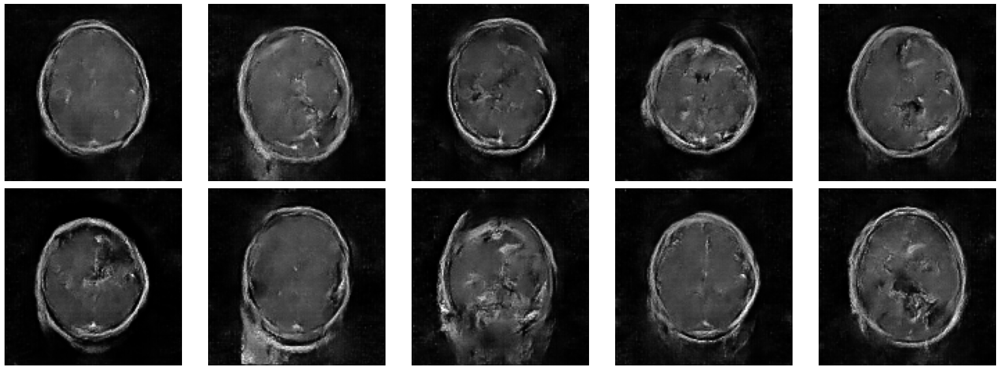

  0%|          | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 1/3750 [00:00<08:49,  7.08it/s]

1/1 [==============================] - 0s 32ms/step


  0%|          | 2/3750 [00:00<10:36,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 3/3750 [00:00<10:07,  6.16it/s]

1/1 [==============================] - 0s 29ms/step


  0%|          | 4/3750 [00:00<09:37,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 5/3750 [00:00<09:00,  6.93it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 6/3750 [00:00<08:38,  7.22it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 7/3750 [00:01<08:32,  7.30it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 8/3750 [00:01<09:10,  6.79it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 9/3750 [00:01<09:33,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 10/3750 [00:01<09:20,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 11/3750 [00:01<08:58,  6.94it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 12/3750 [00:01<09:38,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 13/3750 [00:01<09:17,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 14/3750 [00:02<09:07,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 15/3750 [00:02<09:01,  6.90it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 16/3750 [00:02<08:40,  7.18it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 17/3750 [00:02<09:18,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 18/3750 [00:02<09:24,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 19/3750 [00:02<09:23,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 20/3750 [00:02<09:30,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 21/3750 [00:03<09:52,  6.29it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 22/3750 [00:03<09:23,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 23/3750 [00:03<09:32,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 24/3750 [00:03<09:12,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 25/3750 [00:03<09:55,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 26/3750 [00:03<09:53,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 27/3750 [00:04<10:31,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 28/3750 [00:04<09:58,  6.22it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 29/3750 [00:04<10:22,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 30/3750 [00:04<10:33,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 31/3750 [00:04<10:03,  6.16it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 32/3750 [00:04<10:21,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 33/3750 [00:05<09:56,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 34/3750 [00:05<09:40,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 35/3750 [00:05<09:12,  6.73it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 36/3750 [00:05<08:57,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 37/3750 [00:05<09:01,  6.86it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 38/3750 [00:05<09:05,  6.80it/s]

1/1 [==============================] - 0s 34ms/step


  1%|          | 39/3750 [00:05<09:16,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 40/3750 [00:06<09:21,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 41/3750 [00:06<09:23,  6.59it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 42/3750 [00:06<09:29,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 43/3750 [00:06<09:26,  6.55it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 44/3750 [00:06<09:24,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 45/3750 [00:06<09:10,  6.73it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 46/3750 [00:07<09:17,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 47/3750 [00:07<09:22,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 48/3750 [00:07<09:18,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 49/3750 [00:07<09:01,  6.83it/s]

1/1 [==============================] - 0s 25ms/step


  1%|▏         | 50/3750 [00:07<08:56,  6.90it/s]

1/1 [==============================] - 0s 25ms/step


  1%|▏         | 51/3750 [00:07<09:00,  6.84it/s]

1/1 [==============================] - 0s 25ms/step


  1%|▏         | 52/3750 [00:07<09:45,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 53/3750 [00:08<10:11,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 54/3750 [00:08<09:57,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 55/3750 [00:08<09:46,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 56/3750 [00:08<09:38,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 57/3750 [00:08<09:26,  6.52it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 58/3750 [00:08<09:15,  6.65it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 59/3750 [00:09<09:15,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 60/3750 [00:09<09:20,  6.58it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 61/3750 [00:09<09:17,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 62/3750 [00:09<09:19,  6.59it/s]

1/1 [==============================] - 0s 33ms/step


  2%|▏         | 63/3750 [00:09<09:14,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 64/3750 [00:09<09:09,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 65/3750 [00:09<09:11,  6.69it/s]

1/1 [==============================] - 0s 39ms/step


  2%|▏         | 66/3750 [00:10<09:56,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 67/3750 [00:10<09:35,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 68/3750 [00:10<09:36,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 69/3750 [00:10<10:02,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 70/3750 [00:10<09:59,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 71/3750 [00:10<10:20,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 72/3750 [00:11<10:38,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 73/3750 [00:11<10:05,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 74/3750 [00:11<10:21,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 75/3750 [00:11<10:01,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 76/3750 [00:11<09:39,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 77/3750 [00:11<09:09,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 78/3750 [00:11<08:45,  6.98it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 79/3750 [00:12<08:35,  7.12it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 80/3750 [00:12<09:01,  6.78it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 81/3750 [00:12<08:58,  6.82it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 82/3750 [00:12<08:35,  7.11it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 83/3750 [00:12<09:28,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 84/3750 [00:12<09:06,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 85/3750 [00:13<09:01,  6.77it/s]

1/1 [==============================] - 0s 32ms/step


  2%|▏         | 86/3750 [00:13<09:00,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 87/3750 [00:13<08:39,  7.05it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 88/3750 [00:13<08:55,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 89/3750 [00:13<08:37,  7.07it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 90/3750 [00:13<08:54,  6.85it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 91/3750 [00:13<08:44,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 92/3750 [00:14<09:21,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 93/3750 [00:14<09:38,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 94/3750 [00:14<09:05,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 95/3750 [00:14<09:30,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 96/3750 [00:14<09:03,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 97/3750 [00:14<09:03,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 98/3750 [00:14<09:23,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 99/3750 [00:15<09:12,  6.61it/s]

1/1 [==============================] - 0s 35ms/step


  3%|▎         | 100/3750 [00:15<09:23,  6.48it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 101/3750 [00:15<09:26,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 102/3750 [00:15<09:16,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 103/3750 [00:15<08:58,  6.78it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 104/3750 [00:15<09:29,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 105/3750 [00:16<09:09,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 106/3750 [00:16<09:17,  6.54it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 107/3750 [00:16<09:02,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 108/3750 [00:16<08:58,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 109/3750 [00:16<08:37,  7.04it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 110/3750 [00:16<09:26,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 111/3750 [00:16<10:05,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 112/3750 [00:17<09:54,  6.12it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 113/3750 [00:17<09:25,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 114/3750 [00:17<09:29,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 115/3750 [00:17<09:22,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 116/3750 [00:17<09:28,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 117/3750 [00:17<09:08,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 118/3750 [00:18<09:01,  6.71it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 119/3750 [00:18<08:44,  6.92it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 120/3750 [00:18<08:29,  7.13it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 121/3750 [00:18<08:39,  6.98it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 122/3750 [00:18<08:35,  7.04it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 123/3750 [00:18<09:19,  6.48it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 124/3750 [00:18<09:10,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 125/3750 [00:19<08:57,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 126/3750 [00:19<08:52,  6.81it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 127/3750 [00:19<08:52,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 128/3750 [00:19<08:35,  7.02it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 129/3750 [00:19<08:20,  7.23it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 130/3750 [00:19<08:22,  7.20it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 131/3750 [00:19<08:28,  7.12it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▎         | 132/3750 [00:20<09:02,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 133/3750 [00:20<09:08,  6.59it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▎         | 134/3750 [00:20<09:02,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 135/3750 [00:20<09:11,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 136/3750 [00:20<09:54,  6.08it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▎         | 137/3750 [00:20<09:57,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▎         | 138/3750 [00:21<09:33,  6.29it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▎         | 139/3750 [00:21<09:31,  6.31it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▎         | 140/3750 [00:21<09:22,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 141/3750 [00:21<10:11,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 142/3750 [00:21<09:49,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 143/3750 [00:21<10:03,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 144/3750 [00:22<09:31,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 145/3750 [00:22<09:18,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 146/3750 [00:22<09:34,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 147/3750 [00:22<10:04,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 148/3750 [00:22<09:34,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 149/3750 [00:22<09:53,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 150/3750 [00:22<09:14,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 151/3750 [00:23<09:03,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 152/3750 [00:23<08:53,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 153/3750 [00:23<08:40,  6.91it/s]

1/1 [==============================] - 0s 35ms/step


  4%|▍         | 154/3750 [00:23<08:49,  6.80it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 155/3750 [00:23<09:00,  6.65it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 156/3750 [00:23<09:39,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 157/3750 [00:24<09:32,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 158/3750 [00:24<09:13,  6.49it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 159/3750 [00:24<09:43,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 160/3750 [00:24<10:04,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 161/3750 [00:24<10:11,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 162/3750 [00:24<09:58,  6.00it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 163/3750 [00:25<10:14,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 164/3750 [00:25<09:36,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 165/3750 [00:25<09:23,  6.36it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 166/3750 [00:25<09:04,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 167/3750 [00:25<09:23,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 168/3750 [00:25<09:00,  6.63it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▍         | 169/3750 [00:25<08:57,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 170/3750 [00:26<08:44,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 171/3750 [00:26<08:36,  6.94it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▍         | 172/3750 [00:26<09:10,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 173/3750 [00:26<08:58,  6.64it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▍         | 174/3750 [00:26<09:30,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 175/3750 [00:26<09:22,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 176/3750 [00:27<09:46,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 177/3750 [00:27<10:01,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▍         | 178/3750 [00:27<09:47,  6.08it/s]

1/1 [==============================] - 0s 30ms/step


  5%|▍         | 179/3750 [00:27<10:02,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 180/3750 [00:27<09:38,  6.17it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▍         | 181/3750 [00:27<09:53,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 182/3750 [00:28<10:17,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 183/3750 [00:28<09:57,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▍         | 184/3750 [00:28<09:40,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 185/3750 [00:28<09:42,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 186/3750 [00:28<09:46,  6.08it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▍         | 187/3750 [00:28<10:13,  5.81it/s]

1/1 [==============================] - 0s 33ms/step


  5%|▌         | 188/3750 [00:29<10:00,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 189/3750 [00:29<10:27,  5.67it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▌         | 190/3750 [00:29<10:12,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▌         | 191/3750 [00:29<10:18,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 192/3750 [00:29<10:06,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▌         | 193/3750 [00:29<10:00,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 194/3750 [00:30<10:14,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 195/3750 [00:30<09:57,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 196/3750 [00:30<10:06,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▌         | 197/3750 [00:30<09:57,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▌         | 198/3750 [00:30<10:14,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 199/3750 [00:30<09:45,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 200/3750 [00:31<09:50,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 201/3750 [00:31<10:01,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 202/3750 [00:31<10:21,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 203/3750 [00:31<09:46,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 204/3750 [00:31<10:09,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▌         | 205/3750 [00:31<09:30,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▌         | 206/3750 [00:32<09:58,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 207/3750 [00:32<09:32,  6.19it/s]

1/1 [==============================] - 0s 33ms/step


  6%|▌         | 208/3750 [00:32<10:21,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 209/3750 [00:32<10:24,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 210/3750 [00:32<10:05,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 211/3750 [00:32<10:19,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 212/3750 [00:33<09:59,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 213/3750 [00:33<09:47,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 214/3750 [00:33<09:26,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 215/3750 [00:33<09:08,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 216/3750 [00:33<09:45,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 217/3750 [00:33<09:42,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 218/3750 [00:34<09:17,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▌         | 219/3750 [00:34<08:59,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 220/3750 [00:34<09:31,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 221/3750 [00:34<09:34,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▌         | 222/3750 [00:34<10:01,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 223/3750 [00:34<09:44,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 224/3750 [00:35<09:47,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 225/3750 [00:35<09:08,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 226/3750 [00:35<08:53,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 227/3750 [00:35<08:27,  6.94it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 228/3750 [00:35<08:18,  7.06it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 229/3750 [00:35<08:14,  7.11it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 230/3750 [00:35<08:28,  6.92it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 231/3750 [00:36<08:36,  6.81it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 232/3750 [00:36<09:02,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 233/3750 [00:36<08:58,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▌         | 234/3750 [00:36<09:32,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▋         | 235/3750 [00:36<09:03,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▋         | 236/3750 [00:36<08:41,  6.73it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▋         | 237/3750 [00:36<08:35,  6.82it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▋         | 238/3750 [00:37<08:27,  6.92it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 239/3750 [00:37<08:49,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 240/3750 [00:37<08:29,  6.89it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▋         | 241/3750 [00:37<08:40,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 242/3750 [00:37<08:57,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▋         | 243/3750 [00:37<09:02,  6.47it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 244/3750 [00:38<09:14,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 245/3750 [00:38<09:18,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 246/3750 [00:38<09:01,  6.47it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 247/3750 [00:38<08:33,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 248/3750 [00:38<08:32,  6.84it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 249/3750 [00:38<08:31,  6.84it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 250/3750 [00:38<08:23,  6.95it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 251/3750 [00:39<08:35,  6.79it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 252/3750 [00:39<08:36,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 253/3750 [00:39<09:23,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 254/3750 [00:39<09:12,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 255/3750 [00:39<09:42,  6.00it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 256/3750 [00:39<09:19,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 257/3750 [00:40<09:41,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 258/3750 [00:40<09:17,  6.27it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 259/3750 [00:40<08:50,  6.58it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 260/3750 [00:40<08:35,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 261/3750 [00:40<09:02,  6.43it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 262/3750 [00:40<09:12,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 263/3750 [00:40<09:07,  6.36it/s]

1/1 [==============================] - 0s 36ms/step


  7%|▋         | 264/3750 [00:41<09:26,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 265/3750 [00:41<09:05,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 266/3750 [00:41<09:19,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 267/3750 [00:41<09:08,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 268/3750 [00:41<08:54,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 269/3750 [00:41<08:50,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 270/3750 [00:42<08:35,  6.75it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 271/3750 [00:42<08:57,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 272/3750 [00:42<09:31,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 273/3750 [00:42<09:04,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 274/3750 [00:42<09:26,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 275/3750 [00:42<08:58,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 276/3750 [00:43<08:46,  6.60it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 277/3750 [00:43<08:44,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 278/3750 [00:43<09:13,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 279/3750 [00:43<09:07,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 280/3750 [00:43<09:03,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 281/3750 [00:43<08:51,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 282/3750 [00:43<08:27,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 283/3750 [00:44<08:20,  6.93it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 284/3750 [00:44<08:15,  7.00it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 285/3750 [00:44<08:23,  6.88it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 286/3750 [00:44<08:57,  6.44it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 287/3750 [00:44<08:36,  6.71it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 288/3750 [00:44<08:45,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 289/3750 [00:44<08:41,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 290/3750 [00:45<08:27,  6.82it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 291/3750 [00:45<09:05,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 292/3750 [00:45<08:46,  6.56it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 293/3750 [00:45<08:36,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 294/3750 [00:45<08:44,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 295/3750 [00:45<09:12,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 296/3750 [00:46<08:43,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 297/3750 [00:46<08:39,  6.65it/s]

1/1 [==============================] - 0s 34ms/step


  8%|▊         | 298/3750 [00:46<09:14,  6.22it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 299/3750 [00:46<09:10,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 300/3750 [00:46<09:17,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 301/3750 [00:46<08:48,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 302/3750 [00:46<08:38,  6.65it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 303/3750 [00:47<08:42,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 304/3750 [00:47<09:11,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 305/3750 [00:47<08:56,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 306/3750 [00:47<08:37,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 307/3750 [00:47<08:26,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 308/3750 [00:47<08:58,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 309/3750 [00:48<08:33,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 310/3750 [00:48<08:22,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 311/3750 [00:48<08:15,  6.94it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 312/3750 [00:48<08:19,  6.88it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 313/3750 [00:48<08:46,  6.52it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 314/3750 [00:48<08:33,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 315/3750 [00:48<08:20,  6.87it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 316/3750 [00:49<08:49,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 317/3750 [00:49<09:16,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 318/3750 [00:49<09:00,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 319/3750 [00:49<08:39,  6.60it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 320/3750 [00:49<08:39,  6.60it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 321/3750 [00:49<09:17,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 322/3750 [00:50<08:56,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 323/3750 [00:50<08:51,  6.45it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▊         | 324/3750 [00:50<08:38,  6.60it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 325/3750 [00:50<08:56,  6.38it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▊         | 326/3750 [00:50<08:40,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 327/3750 [00:50<09:14,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▊         | 328/3750 [00:50<09:00,  6.33it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 329/3750 [00:51<09:16,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 330/3750 [00:51<09:57,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 331/3750 [00:51<09:23,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 332/3750 [00:51<09:47,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 333/3750 [00:51<09:52,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 334/3750 [00:52<09:35,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 335/3750 [00:52<09:20,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 336/3750 [00:52<09:07,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 337/3750 [00:52<08:40,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 338/3750 [00:52<08:34,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 339/3750 [00:52<08:30,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 340/3750 [00:52<08:43,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 341/3750 [00:53<08:41,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 342/3750 [00:53<08:38,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 343/3750 [00:53<08:35,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 344/3750 [00:53<08:25,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 345/3750 [00:53<08:57,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 346/3750 [00:53<08:48,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 347/3750 [00:53<08:27,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 348/3750 [00:54<08:02,  7.05it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 349/3750 [00:54<08:06,  6.98it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 350/3750 [00:54<08:18,  6.82it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 351/3750 [00:54<08:05,  7.00it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 352/3750 [00:54<09:05,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 353/3750 [00:54<08:47,  6.45it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 354/3750 [00:55<08:45,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 355/3750 [00:55<08:28,  6.67it/s]

1/1 [==============================] - 0s 40ms/step


  9%|▉         | 356/3750 [00:55<09:03,  6.24it/s]

1/1 [==============================] - 0s 28ms/step


 10%|▉         | 357/3750 [00:55<08:50,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 358/3750 [00:55<08:56,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 359/3750 [00:55<08:39,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 360/3750 [00:55<08:24,  6.72it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 361/3750 [00:56<08:38,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 362/3750 [00:56<08:42,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 363/3750 [00:56<08:28,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 364/3750 [00:56<08:01,  7.03it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 365/3750 [00:56<07:57,  7.08it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 366/3750 [00:56<08:14,  6.85it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 367/3750 [00:56<08:02,  7.01it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 368/3750 [00:57<08:01,  7.03it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 369/3750 [00:57<08:08,  6.93it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 370/3750 [00:57<08:45,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 371/3750 [00:57<08:24,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 372/3750 [00:57<08:31,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 373/3750 [00:57<08:20,  6.74it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 374/3750 [00:58<08:28,  6.63it/s]

1/1 [==============================] - 0s 27ms/step


 10%|█         | 375/3750 [00:58<08:11,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 376/3750 [00:58<08:09,  6.89it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 377/3750 [00:58<08:04,  6.96it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 378/3750 [00:58<08:05,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 379/3750 [00:58<08:08,  6.90it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 380/3750 [00:58<07:56,  7.07it/s]

1/1 [==============================] - 0s 27ms/step


 10%|█         | 381/3750 [00:59<07:51,  7.14it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 382/3750 [00:59<07:53,  7.11it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 383/3750 [00:59<07:49,  7.18it/s]

1/1 [==============================] - 0s 27ms/step


 10%|█         | 384/3750 [00:59<08:41,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 385/3750 [00:59<08:19,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 386/3750 [00:59<08:44,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 387/3750 [00:59<08:33,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 388/3750 [01:00<08:37,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 389/3750 [01:00<08:23,  6.67it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 390/3750 [01:00<08:22,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 391/3750 [01:00<08:14,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 392/3750 [01:00<08:24,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 393/3750 [01:00<08:18,  6.74it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 394/3750 [01:00<08:08,  6.87it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 395/3750 [01:01<08:37,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 396/3750 [01:01<08:29,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 397/3750 [01:01<08:54,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 398/3750 [01:01<09:11,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 399/3750 [01:01<09:05,  6.15it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 400/3750 [01:01<09:20,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 401/3750 [01:02<09:05,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 402/3750 [01:02<08:41,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 403/3750 [01:02<08:19,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 404/3750 [01:02<08:20,  6.69it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 405/3750 [01:02<08:51,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 406/3750 [01:02<08:52,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 407/3750 [01:03<08:48,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 408/3750 [01:03<08:22,  6.65it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 409/3750 [01:03<09:05,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 410/3750 [01:03<09:21,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 411/3750 [01:03<08:43,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 412/3750 [01:03<08:39,  6.42it/s]

1/1 [==============================] - 0s 37ms/step


 11%|█         | 413/3750 [01:03<08:45,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 414/3750 [01:04<09:20,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 415/3750 [01:04<08:56,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 416/3750 [01:04<08:53,  6.25it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 417/3750 [01:04<08:44,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 418/3750 [01:04<08:45,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 419/3750 [01:04<09:01,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 420/3750 [01:05<09:00,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 421/3750 [01:05<09:10,  6.05it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█▏        | 422/3750 [01:05<08:50,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 423/3750 [01:05<08:34,  6.46it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█▏        | 424/3750 [01:05<09:01,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 425/3750 [01:05<08:46,  6.31it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█▏        | 426/3750 [01:06<09:15,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 427/3750 [01:06<08:45,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 428/3750 [01:06<08:35,  6.44it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█▏        | 429/3750 [01:06<08:13,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 430/3750 [01:06<08:17,  6.68it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█▏        | 431/3750 [01:06<09:11,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 432/3750 [01:07<08:58,  6.17it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 433/3750 [01:07<08:30,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 434/3750 [01:07<08:27,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 435/3750 [01:07<09:02,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 436/3750 [01:07<09:28,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 437/3750 [01:07<09:55,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 438/3750 [01:08<09:18,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 439/3750 [01:08<09:28,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 440/3750 [01:08<10:13,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 441/3750 [01:08<09:41,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 442/3750 [01:08<10:23,  5.30it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 443/3750 [01:08<10:16,  5.36it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 444/3750 [01:09<09:46,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 445/3750 [01:09<09:19,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 446/3750 [01:09<09:56,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 447/3750 [01:09<09:37,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 448/3750 [01:09<09:37,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 449/3750 [01:10<09:52,  5.57it/s]

1/1 [==============================] - 0s 35ms/step


 12%|█▏        | 450/3750 [01:10<09:30,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 451/3750 [01:10<09:48,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 452/3750 [01:10<08:58,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 453/3750 [01:10<09:01,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 454/3750 [01:10<09:25,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 455/3750 [01:11<09:48,  5.60it/s]

1/1 [==============================] - 0s 41ms/step


 12%|█▏        | 456/3750 [01:11<10:01,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 457/3750 [01:11<09:35,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 458/3750 [01:11<09:44,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 459/3750 [01:11<09:18,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 460/3750 [01:11<09:24,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 461/3750 [01:12<09:01,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 462/3750 [01:12<08:49,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 463/3750 [01:12<09:04,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 464/3750 [01:12<09:02,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 465/3750 [01:12<08:41,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 466/3750 [01:12<08:35,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 467/3750 [01:13<08:23,  6.52it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 468/3750 [01:13<08:29,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 469/3750 [01:13<08:22,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 470/3750 [01:13<08:28,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 471/3750 [01:13<08:15,  6.62it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 472/3750 [01:13<08:48,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 473/3750 [01:13<08:53,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 474/3750 [01:14<09:00,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 475/3750 [01:14<08:36,  6.34it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 476/3750 [01:14<08:56,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 477/3750 [01:14<08:31,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 478/3750 [01:14<08:29,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 479/3750 [01:14<08:15,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 480/3750 [01:15<08:48,  6.18it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 481/3750 [01:15<08:31,  6.39it/s]

1/1 [==============================] - 0s 45ms/step


 13%|█▎        | 482/3750 [01:15<08:30,  6.40it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 483/3750 [01:15<08:04,  6.75it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 484/3750 [01:15<07:54,  6.88it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 485/3750 [01:15<08:11,  6.64it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 486/3750 [01:15<07:51,  6.93it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 487/3750 [01:16<07:34,  7.18it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 488/3750 [01:16<07:40,  7.08it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 489/3750 [01:16<07:38,  7.11it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 490/3750 [01:16<08:23,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 491/3750 [01:16<08:06,  6.70it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 492/3750 [01:16<07:59,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 493/3750 [01:16<08:22,  6.48it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 494/3750 [01:17<08:14,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 495/3750 [01:17<08:08,  6.67it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 496/3750 [01:17<08:38,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 497/3750 [01:17<08:16,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 498/3750 [01:17<08:06,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 499/3750 [01:17<07:59,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 500/3750 [01:18<08:20,  6.50it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 501/3750 [01:18<08:11,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 502/3750 [01:18<08:49,  6.13it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 503/3750 [01:18<08:47,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 504/3750 [01:18<09:18,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 505/3750 [01:18<09:13,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 506/3750 [01:19<08:47,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 507/3750 [01:19<08:27,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 508/3750 [01:19<08:28,  6.38it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▎        | 509/3750 [01:19<08:35,  6.28it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▎        | 510/3750 [01:19<08:14,  6.56it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▎        | 511/3750 [01:19<08:32,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 512/3750 [01:19<08:32,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 513/3750 [01:20<08:17,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 514/3750 [01:20<08:34,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 515/3750 [01:20<08:33,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 516/3750 [01:20<08:39,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 517/3750 [01:20<08:06,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 518/3750 [01:20<07:59,  6.74it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 519/3750 [01:21<08:09,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 520/3750 [01:21<07:54,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 521/3750 [01:21<07:45,  6.94it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 522/3750 [01:21<08:09,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 523/3750 [01:21<08:32,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 524/3750 [01:21<08:19,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 525/3750 [01:21<08:44,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 526/3750 [01:22<09:02,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 527/3750 [01:22<08:48,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 528/3750 [01:22<08:40,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 529/3750 [01:22<08:44,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 530/3750 [01:22<08:42,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 531/3750 [01:22<08:23,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 532/3750 [01:23<08:13,  6.52it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 533/3750 [01:23<08:05,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 534/3750 [01:23<07:59,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 535/3750 [01:23<08:03,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 536/3750 [01:23<08:10,  6.55it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 537/3750 [01:23<08:02,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 538/3750 [01:23<07:47,  6.86it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 539/3750 [01:24<07:43,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 540/3750 [01:24<08:24,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 541/3750 [01:24<08:06,  6.60it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 542/3750 [01:24<08:28,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 543/3750 [01:24<08:11,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 544/3750 [01:24<07:46,  6.88it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 545/3750 [01:25<07:44,  6.90it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 546/3750 [01:25<07:36,  7.02it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 547/3750 [01:25<07:32,  7.08it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 548/3750 [01:25<07:59,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 549/3750 [01:25<07:52,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 550/3750 [01:25<07:51,  6.78it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 551/3750 [01:25<07:51,  6.78it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 552/3750 [01:26<07:46,  6.85it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 553/3750 [01:26<07:39,  6.96it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 554/3750 [01:26<08:03,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 555/3750 [01:26<07:57,  6.70it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 556/3750 [01:26<07:54,  6.73it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 557/3750 [01:26<07:36,  6.99it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 558/3750 [01:26<07:32,  7.06it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 559/3750 [01:27<07:37,  6.98it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 560/3750 [01:27<07:35,  7.00it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 561/3750 [01:27<07:38,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 562/3750 [01:27<07:22,  7.21it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▌        | 563/3750 [01:27<08:05,  6.56it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▌        | 564/3750 [01:27<08:02,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 565/3750 [01:27<08:02,  6.60it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▌        | 566/3750 [01:28<08:39,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 567/3750 [01:28<08:14,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 568/3750 [01:28<07:59,  6.64it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▌        | 569/3750 [01:28<08:14,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 570/3750 [01:28<08:05,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 571/3750 [01:28<08:27,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 572/3750 [01:29<08:00,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 573/3750 [01:29<07:59,  6.63it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▌        | 574/3750 [01:29<08:06,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 575/3750 [01:29<07:48,  6.77it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 576/3750 [01:29<07:45,  6.82it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▌        | 577/3750 [01:29<08:22,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▌        | 578/3750 [01:30<08:50,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 579/3750 [01:30<08:26,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 580/3750 [01:30<08:18,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 581/3750 [01:30<07:59,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 582/3750 [01:30<07:55,  6.66it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 583/3750 [01:30<07:47,  6.77it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 584/3750 [01:30<08:32,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 585/3750 [01:31<08:12,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 586/3750 [01:31<07:52,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 587/3750 [01:31<08:08,  6.47it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 588/3750 [01:31<07:57,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 589/3750 [01:31<09:04,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 590/3750 [01:31<09:04,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 591/3750 [01:32<08:32,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 592/3750 [01:32<08:10,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 593/3750 [01:32<08:05,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 594/3750 [01:32<08:05,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 595/3750 [01:32<07:46,  6.76it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 596/3750 [01:32<07:33,  6.96it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 597/3750 [01:32<07:46,  6.76it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 598/3750 [01:33<07:42,  6.81it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 599/3750 [01:33<07:35,  6.92it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 600/3750 [01:33<07:54,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 601/3750 [01:33<08:31,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 602/3750 [01:33<08:17,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 603/3750 [01:33<08:04,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 604/3750 [01:34<08:01,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 605/3750 [01:34<07:44,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 606/3750 [01:34<07:36,  6.89it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 607/3750 [01:34<07:26,  7.04it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 608/3750 [01:34<08:09,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 609/3750 [01:34<08:38,  6.06it/s]

1/1 [==============================] - 0s 37ms/step


 16%|█▋        | 610/3750 [01:34<08:24,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 611/3750 [01:35<08:30,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 612/3750 [01:35<08:13,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 613/3750 [01:35<08:27,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 614/3750 [01:35<08:01,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 615/3750 [01:35<07:47,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 616/3750 [01:35<08:16,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 617/3750 [01:36<08:00,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 618/3750 [01:36<08:22,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 619/3750 [01:36<09:14,  5.64it/s]

1/1 [==============================] - 0s 36ms/step


 17%|█▋        | 620/3750 [01:36<09:24,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 621/3750 [01:36<08:57,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 622/3750 [01:36<08:57,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 623/3750 [01:37<09:18,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 624/3750 [01:37<09:02,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 625/3750 [01:37<08:34,  6.07it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 626/3750 [01:37<08:49,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 627/3750 [01:37<08:31,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 628/3750 [01:37<08:15,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 629/3750 [01:38<08:14,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 630/3750 [01:38<08:00,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 631/3750 [01:38<08:40,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 632/3750 [01:38<08:13,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 633/3750 [01:38<07:52,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 634/3750 [01:38<08:14,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 635/3750 [01:38<08:05,  6.42it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 636/3750 [01:39<07:49,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 637/3750 [01:39<08:09,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 638/3750 [01:39<08:00,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 639/3750 [01:39<07:53,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 640/3750 [01:39<08:10,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 641/3750 [01:39<08:53,  5.83it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 642/3750 [01:40<08:49,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 643/3750 [01:40<08:58,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 644/3750 [01:40<08:34,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 645/3750 [01:40<09:02,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 646/3750 [01:40<08:36,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 647/3750 [01:40<08:12,  6.30it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 648/3750 [01:41<08:27,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 649/3750 [01:41<08:35,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 650/3750 [01:41<08:18,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 651/3750 [01:41<08:13,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 652/3750 [01:41<08:29,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 653/3750 [01:41<08:11,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 654/3750 [01:42<08:33,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 655/3750 [01:42<08:38,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 656/3750 [01:42<08:53,  5.80it/s]

1/1 [==============================] - 0s 35ms/step


 18%|█▊        | 657/3750 [01:42<09:10,  5.62it/s]

1/1 [==============================] - 0s 33ms/step


 18%|█▊        | 658/3750 [01:42<09:52,  5.22it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 659/3750 [01:43<09:55,  5.19it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 660/3750 [01:43<09:16,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 661/3750 [01:43<08:48,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 662/3750 [01:43<08:34,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 663/3750 [01:43<08:25,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 664/3750 [01:43<08:47,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 665/3750 [01:44<08:47,  5.85it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 666/3750 [01:44<08:39,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 667/3750 [01:44<08:27,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 668/3750 [01:44<08:39,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 669/3750 [01:44<08:40,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 670/3750 [01:44<08:53,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 671/3750 [01:45<08:26,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 672/3750 [01:45<08:15,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 673/3750 [01:45<08:27,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 674/3750 [01:45<08:03,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 675/3750 [01:45<08:32,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 676/3750 [01:45<08:09,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 677/3750 [01:46<08:34,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 678/3750 [01:46<08:08,  6.29it/s]

1/1 [==============================] - 0s 33ms/step


 18%|█▊        | 679/3750 [01:46<08:04,  6.34it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 680/3750 [01:46<07:55,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 681/3750 [01:46<08:14,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 682/3750 [01:46<08:08,  6.28it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 683/3750 [01:46<07:52,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 684/3750 [01:47<07:41,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 685/3750 [01:47<07:21,  6.95it/s]

1/1 [==============================] - 0s 37ms/step


 18%|█▊        | 686/3750 [01:47<07:40,  6.65it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 687/3750 [01:47<07:34,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 688/3750 [01:47<07:18,  6.98it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 689/3750 [01:47<07:18,  6.98it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 690/3750 [01:47<07:15,  7.03it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 691/3750 [01:48<07:19,  6.96it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 692/3750 [01:48<07:40,  6.64it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 693/3750 [01:48<07:41,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 694/3750 [01:48<07:35,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 695/3750 [01:48<07:30,  6.78it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 696/3750 [01:48<07:32,  6.75it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 697/3750 [01:48<07:26,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 698/3750 [01:49<07:23,  6.88it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▊        | 699/3750 [01:49<07:24,  6.87it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▊        | 700/3750 [01:49<07:17,  6.97it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▊        | 701/3750 [01:49<07:09,  7.09it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 702/3750 [01:49<07:02,  7.21it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 703/3750 [01:49<07:01,  7.23it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 704/3750 [01:49<07:13,  7.03it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 705/3750 [01:50<07:45,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 706/3750 [01:50<07:23,  6.86it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 707/3750 [01:50<07:19,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 708/3750 [01:50<07:14,  7.00it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 709/3750 [01:50<07:11,  7.04it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 710/3750 [01:50<06:59,  7.24it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▉        | 711/3750 [01:50<07:23,  6.85it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 712/3750 [01:51<07:27,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 713/3750 [01:51<07:43,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 714/3750 [01:51<08:16,  6.11it/s]

1/1 [==============================] - 0s 35ms/step


 19%|█▉        | 715/3750 [01:51<07:59,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 716/3750 [01:51<07:48,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 717/3750 [01:51<07:44,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 718/3750 [01:52<07:34,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 719/3750 [01:52<07:54,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 720/3750 [01:52<07:43,  6.54it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 721/3750 [01:52<08:04,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 722/3750 [01:52<07:53,  6.39it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 723/3750 [01:52<08:29,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 724/3750 [01:53<08:18,  6.07it/s]

1/1 [==============================] - 0s 34ms/step


 19%|█▉        | 725/3750 [01:53<08:35,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 726/3750 [01:53<08:47,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 727/3750 [01:53<09:11,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 728/3750 [01:53<08:42,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 729/3750 [01:53<08:29,  5.93it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▉        | 730/3750 [01:54<08:39,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 731/3750 [01:54<08:42,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 732/3750 [01:54<08:25,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


 20%|█▉        | 733/3750 [01:54<08:21,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 734/3750 [01:54<08:36,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 735/3750 [01:54<08:34,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 736/3750 [01:55<08:03,  6.24it/s]

1/1 [==============================] - 0s 28ms/step


 20%|█▉        | 737/3750 [01:55<07:50,  6.40it/s]

1/1 [==============================] - 0s 30ms/step


 20%|█▉        | 738/3750 [01:55<08:15,  6.07it/s]

1/1 [==============================] - 0s 32ms/step


 20%|█▉        | 739/3750 [01:55<08:09,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 740/3750 [01:55<07:57,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 741/3750 [01:55<08:22,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 742/3750 [01:56<07:56,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 743/3750 [01:56<07:51,  6.37it/s]

1/1 [==============================] - 0s 27ms/step


 20%|█▉        | 744/3750 [01:56<08:27,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 745/3750 [01:56<08:40,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 746/3750 [01:56<08:44,  5.72it/s]

1/1 [==============================] - 0s 32ms/step


 20%|█▉        | 747/3750 [01:56<09:03,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 748/3750 [01:57<09:02,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 749/3750 [01:57<09:08,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 750/3750 [01:57<09:13,  5.42it/s]

1/1 [==============================] - 0s 33ms/step


 20%|██        | 751/3750 [01:57<08:55,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 752/3750 [01:57<08:30,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 753/3750 [01:58<08:13,  6.08it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 754/3750 [01:58<08:02,  6.20it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 755/3750 [01:58<08:38,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 756/3750 [01:58<08:12,  6.08it/s]

1/1 [==============================] - 0s 30ms/step


 20%|██        | 757/3750 [01:58<08:40,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 758/3750 [01:58<08:51,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 759/3750 [01:59<08:23,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 760/3750 [01:59<08:30,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 761/3750 [01:59<08:23,  5.93it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 762/3750 [01:59<08:44,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 763/3750 [01:59<08:30,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 764/3750 [01:59<08:18,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 765/3750 [02:00<08:02,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 766/3750 [02:00<07:54,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 767/3750 [02:00<08:10,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 768/3750 [02:00<07:48,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 769/3750 [02:00<07:34,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 770/3750 [02:00<08:46,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 771/3750 [02:01<08:22,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 772/3750 [02:01<08:00,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 773/3750 [02:01<07:46,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 774/3750 [02:01<07:44,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 775/3750 [02:01<07:37,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 776/3750 [02:01<07:50,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 777/3750 [02:01<07:41,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 778/3750 [02:02<07:37,  6.50it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 779/3750 [02:02<07:24,  6.68it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 780/3750 [02:02<07:21,  6.73it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 781/3750 [02:02<07:19,  6.75it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 782/3750 [02:02<07:10,  6.90it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 783/3750 [02:02<07:15,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 784/3750 [02:02<07:23,  6.69it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 785/3750 [02:03<07:20,  6.73it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 786/3750 [02:03<07:24,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 787/3750 [02:03<07:20,  6.73it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 788/3750 [02:03<07:43,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 789/3750 [02:03<07:22,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 790/3750 [02:03<07:11,  6.86it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 791/3750 [02:03<06:56,  7.10it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 792/3750 [02:04<07:10,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 793/3750 [02:04<07:43,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 794/3750 [02:04<07:40,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 795/3750 [02:04<08:15,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 796/3750 [02:04<08:00,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 797/3750 [02:04<07:52,  6.26it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██▏       | 798/3750 [02:05<07:32,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 799/3750 [02:05<07:20,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 800/3750 [02:05<08:01,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 801/3750 [02:05<08:32,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 802/3750 [02:05<08:09,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 803/3750 [02:05<07:57,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 804/3750 [02:06<07:47,  6.30it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██▏       | 805/3750 [02:06<07:43,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 806/3750 [02:06<07:42,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 807/3750 [02:06<08:09,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 808/3750 [02:06<07:49,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 809/3750 [02:06<07:57,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 810/3750 [02:07<07:44,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 811/3750 [02:07<07:37,  6.43it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 812/3750 [02:07<07:36,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 813/3750 [02:07<07:22,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 814/3750 [02:07<07:17,  6.71it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 815/3750 [02:07<07:42,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 816/3750 [02:07<07:24,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 817/3750 [02:08<07:15,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 818/3750 [02:08<07:00,  6.96it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 819/3750 [02:08<06:58,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 820/3750 [02:08<06:47,  7.19it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 821/3750 [02:08<07:21,  6.63it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 822/3750 [02:08<07:16,  6.71it/s]

1/1 [==============================] - 0s 34ms/step


 22%|██▏       | 823/3750 [02:08<07:15,  6.73it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 824/3750 [02:09<07:04,  6.89it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 825/3750 [02:09<07:00,  6.96it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 826/3750 [02:09<07:08,  6.82it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 827/3750 [02:09<07:00,  6.95it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 828/3750 [02:09<06:52,  7.08it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 829/3750 [02:09<07:21,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 830/3750 [02:09<07:10,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 831/3750 [02:10<07:02,  6.91it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 832/3750 [02:10<06:55,  7.03it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 833/3750 [02:10<07:05,  6.86it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 834/3750 [02:10<07:07,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 835/3750 [02:10<06:51,  7.08it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 836/3750 [02:10<06:44,  7.21it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 837/3750 [02:10<06:37,  7.32it/s]

1/1 [==============================] - 0s 42ms/step


 22%|██▏       | 838/3750 [02:11<07:04,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 839/3750 [02:11<07:24,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 840/3750 [02:11<07:16,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 841/3750 [02:11<07:06,  6.82it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 842/3750 [02:11<07:08,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 843/3750 [02:11<06:57,  6.97it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 844/3750 [02:12<07:21,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 845/3750 [02:12<07:11,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 846/3750 [02:12<07:45,  6.24it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 847/3750 [02:12<07:24,  6.52it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 848/3750 [02:12<07:31,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 849/3750 [02:12<07:27,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 850/3750 [02:12<07:12,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 851/3750 [02:13<07:38,  6.32it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 852/3750 [02:13<07:33,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 853/3750 [02:13<07:27,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 854/3750 [02:13<07:47,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 855/3750 [02:13<07:45,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 856/3750 [02:13<08:02,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 857/3750 [02:14<07:32,  6.39it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 858/3750 [02:14<07:24,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 859/3750 [02:14<07:19,  6.58it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 860/3750 [02:14<07:11,  6.70it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 861/3750 [02:14<07:43,  6.24it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 862/3750 [02:14<07:22,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 863/3750 [02:15<07:29,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 864/3750 [02:15<07:12,  6.68it/s]

1/1 [==============================] - 0s 33ms/step


 23%|██▎       | 865/3750 [02:15<07:45,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 866/3750 [02:15<07:30,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 867/3750 [02:15<07:49,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 868/3750 [02:15<07:21,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 869/3750 [02:15<07:06,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 870/3750 [02:16<06:57,  6.90it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 871/3750 [02:16<07:15,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 872/3750 [02:16<07:00,  6.84it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 873/3750 [02:16<07:05,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 874/3750 [02:16<07:27,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 875/3750 [02:16<07:26,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 876/3750 [02:17<07:47,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 877/3750 [02:17<07:29,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 878/3750 [02:17<08:03,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 879/3750 [02:17<07:39,  6.24it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 880/3750 [02:17<08:04,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 881/3750 [02:17<08:20,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 882/3750 [02:18<08:00,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 883/3750 [02:18<07:44,  6.17it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▎       | 884/3750 [02:18<07:28,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 885/3750 [02:18<07:36,  6.28it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▎       | 886/3750 [02:18<07:30,  6.36it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▎       | 887/3750 [02:18<07:56,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 888/3750 [02:18<07:38,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 889/3750 [02:19<07:27,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 890/3750 [02:19<07:48,  6.10it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 891/3750 [02:19<07:33,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 892/3750 [02:19<07:45,  6.15it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 893/3750 [02:19<07:37,  6.25it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 894/3750 [02:19<07:32,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 895/3750 [02:20<07:52,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 896/3750 [02:20<08:05,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 897/3750 [02:20<07:52,  6.03it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 898/3750 [02:20<08:06,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 899/3750 [02:20<08:06,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 900/3750 [02:20<08:20,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 901/3750 [02:21<07:56,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 902/3750 [02:21<08:05,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 903/3750 [02:21<08:31,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 904/3750 [02:21<08:02,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 905/3750 [02:21<08:02,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 906/3750 [02:21<07:33,  6.27it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 907/3750 [02:22<07:46,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 908/3750 [02:22<08:06,  5.84it/s]

1/1 [==============================] - 0s 34ms/step


 24%|██▍       | 909/3750 [02:22<08:00,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 910/3750 [02:22<07:34,  6.25it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 911/3750 [02:22<07:44,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 912/3750 [02:22<08:06,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 913/3750 [02:23<07:50,  6.03it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 914/3750 [02:23<07:53,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 915/3750 [02:23<07:42,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 916/3750 [02:23<07:26,  6.35it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 917/3750 [02:23<07:18,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 918/3750 [02:23<07:04,  6.68it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 919/3750 [02:24<06:52,  6.86it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▍       | 920/3750 [02:24<07:15,  6.50it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 921/3750 [02:24<07:10,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 922/3750 [02:24<07:02,  6.70it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 923/3750 [02:24<06:56,  6.79it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 924/3750 [02:24<06:55,  6.81it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 925/3750 [02:24<06:56,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 926/3750 [02:25<06:55,  6.80it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 927/3750 [02:25<06:53,  6.84it/s]

1/1 [==============================] - 0s 32ms/step


 25%|██▍       | 928/3750 [02:25<07:07,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 929/3750 [02:25<07:40,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 930/3750 [02:25<07:56,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 931/3750 [02:25<07:41,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 932/3750 [02:26<07:25,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 933/3750 [02:26<07:40,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 934/3750 [02:26<07:18,  6.43it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 935/3750 [02:26<07:06,  6.59it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 936/3750 [02:26<07:03,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 937/3750 [02:26<06:51,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 938/3750 [02:26<06:43,  6.97it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 939/3750 [02:27<07:15,  6.45it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 940/3750 [02:27<07:19,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 941/3750 [02:27<07:53,  5.93it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▌       | 942/3750 [02:27<07:44,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 943/3750 [02:27<07:46,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 944/3750 [02:27<07:52,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 945/3750 [02:28<07:34,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 946/3750 [02:28<07:12,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 947/3750 [02:28<07:39,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 948/3750 [02:28<07:54,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 949/3750 [02:28<07:58,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 950/3750 [02:28<07:47,  5.99it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 951/3750 [02:29<07:30,  6.21it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 952/3750 [02:29<07:18,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 953/3750 [02:29<07:43,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 954/3750 [02:29<07:31,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 955/3750 [02:29<07:55,  5.88it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▌       | 956/3750 [02:29<07:43,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 957/3750 [02:30<07:15,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 958/3750 [02:30<07:48,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 959/3750 [02:30<07:41,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 960/3750 [02:30<07:25,  6.26it/s]

1/1 [==============================] - 0s 33ms/step


 26%|██▌       | 961/3750 [02:30<07:19,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 962/3750 [02:30<07:36,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▌       | 963/3750 [02:31<07:12,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 964/3750 [02:31<07:24,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 965/3750 [02:31<07:17,  6.36it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 966/3750 [02:31<07:19,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 967/3750 [02:31<07:12,  6.44it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▌       | 968/3750 [02:31<07:13,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 969/3750 [02:32<07:30,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 970/3750 [02:32<07:38,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 971/3750 [02:32<07:14,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 972/3750 [02:32<07:06,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 973/3750 [02:32<06:59,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 974/3750 [02:32<07:34,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 975/3750 [02:32<07:29,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 976/3750 [02:33<07:53,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 977/3750 [02:33<07:59,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 978/3750 [02:33<07:37,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▌       | 979/3750 [02:33<07:21,  6.27it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 980/3750 [02:33<07:05,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 981/3750 [02:33<06:54,  6.68it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 982/3750 [02:34<06:45,  6.83it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 983/3750 [02:34<06:45,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 984/3750 [02:34<06:37,  6.96it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 985/3750 [02:34<06:39,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 986/3750 [02:34<06:28,  7.11it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 987/3750 [02:34<06:34,  7.00it/s]

1/1 [==============================] - 0s 33ms/step


 26%|██▋       | 988/3750 [02:34<06:49,  6.74it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▋       | 989/3750 [02:35<06:58,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 990/3750 [02:35<07:16,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 991/3750 [02:35<07:03,  6.51it/s]

1/1 [==============================] - 0s 32ms/step


 26%|██▋       | 992/3750 [02:35<07:04,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▋       | 993/3750 [02:35<06:57,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 994/3750 [02:35<06:52,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 995/3750 [02:35<06:49,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 996/3750 [02:36<07:13,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 997/3750 [02:36<06:53,  6.65it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 998/3750 [02:36<06:49,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 999/3750 [02:36<07:08,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1000/3750 [02:36<06:54,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1001/3750 [02:36<06:58,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1002/3750 [02:37<07:23,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1003/3750 [02:37<07:28,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1004/3750 [02:37<07:36,  6.01it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 1005/3750 [02:37<07:21,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1006/3750 [02:37<07:05,  6.44it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 1007/3750 [02:37<07:02,  6.49it/s]

1/1 [==============================] - 0s 34ms/step


 27%|██▋       | 1008/3750 [02:38<07:05,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1009/3750 [02:38<07:10,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1010/3750 [02:38<07:16,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1011/3750 [02:38<07:14,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1012/3750 [02:38<07:36,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1013/3750 [02:38<07:42,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1014/3750 [02:39<08:00,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1015/3750 [02:39<07:35,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1016/3750 [02:39<07:34,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1017/3750 [02:39<07:36,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1018/3750 [02:39<07:24,  6.15it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 1019/3750 [02:39<07:12,  6.32it/s]

1/1 [==============================] - 0s 49ms/step


 27%|██▋       | 1020/3750 [02:40<08:00,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1021/3750 [02:40<08:17,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1022/3750 [02:40<07:53,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1023/3750 [02:40<07:37,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1024/3750 [02:40<07:18,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1025/3750 [02:40<07:23,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1026/3750 [02:41<07:35,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1027/3750 [02:41<07:46,  5.84it/s]

1/1 [==============================] - 0s 35ms/step


 27%|██▋       | 1028/3750 [02:41<07:44,  5.85it/s]

1/1 [==============================] - 0s 32ms/step


 27%|██▋       | 1029/3750 [02:41<07:59,  5.67it/s]

1/1 [==============================] - 0s 44ms/step


 27%|██▋       | 1030/3750 [02:41<08:45,  5.17it/s]

1/1 [==============================] - 0s 48ms/step


 27%|██▋       | 1031/3750 [02:42<13:35,  3.33it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1032/3750 [02:42<11:39,  3.89it/s]

1/1 [==============================] - 0s 53ms/step


 28%|██▊       | 1033/3750 [02:42<10:42,  4.23it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1034/3750 [02:42<09:45,  4.64it/s]

1/1 [==============================] - 0s 35ms/step


 28%|██▊       | 1035/3750 [02:43<09:01,  5.02it/s]

1/1 [==============================] - 0s 36ms/step


 28%|██▊       | 1036/3750 [02:43<08:39,  5.22it/s]

1/1 [==============================] - 0s 48ms/step


 28%|██▊       | 1037/3750 [02:43<08:34,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 1038/3750 [02:43<08:28,  5.33it/s]

1/1 [==============================] - 0s 56ms/step


 28%|██▊       | 1039/3750 [02:43<09:07,  4.96it/s]

1/1 [==============================] - 0s 41ms/step


 28%|██▊       | 1040/3750 [02:44<08:59,  5.02it/s]

1/1 [==============================] - 0s 47ms/step


 28%|██▊       | 1041/3750 [02:44<08:47,  5.14it/s]

1/1 [==============================] - 0s 32ms/step


 28%|██▊       | 1042/3750 [02:44<08:19,  5.42it/s]

1/1 [==============================] - 0s 39ms/step


 28%|██▊       | 1043/3750 [02:44<08:29,  5.31it/s]

1/1 [==============================] - 0s 40ms/step


 28%|██▊       | 1044/3750 [02:44<08:39,  5.21it/s]

1/1 [==============================] - 0s 32ms/step


 28%|██▊       | 1045/3750 [02:44<08:43,  5.17it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 1046/3750 [02:45<09:09,  4.92it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 1047/3750 [02:45<08:52,  5.08it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 1048/3750 [02:45<08:57,  5.03it/s]

1/1 [==============================] - 0s 38ms/step


 28%|██▊       | 1049/3750 [02:45<08:43,  5.16it/s]

1/1 [==============================] - 0s 37ms/step


 28%|██▊       | 1050/3750 [02:45<09:04,  4.96it/s]

1/1 [==============================] - 0s 41ms/step


 28%|██▊       | 1051/3750 [02:46<08:47,  5.12it/s]

1/1 [==============================] - 0s 41ms/step


 28%|██▊       | 1052/3750 [02:46<08:52,  5.06it/s]

1/1 [==============================] - 0s 44ms/step


 28%|██▊       | 1053/3750 [02:46<09:05,  4.94it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1054/3750 [02:46<08:55,  5.03it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 1055/3750 [02:46<08:19,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1056/3750 [02:47<07:51,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1057/3750 [02:47<07:39,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 1058/3750 [02:47<07:52,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1059/3750 [02:47<08:05,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1060/3750 [02:47<08:10,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1061/3750 [02:47<08:15,  5.43it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 1062/3750 [02:48<07:49,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 1063/3750 [02:48<07:59,  5.61it/s]

1/1 [==============================] - 0s 36ms/step


 28%|██▊       | 1064/3750 [02:48<08:38,  5.18it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1065/3750 [02:48<08:13,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1066/3750 [02:48<07:52,  5.68it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 1067/3750 [02:49<07:38,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1068/3750 [02:49<07:55,  5.63it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▊       | 1069/3750 [02:49<07:32,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 1070/3750 [02:49<07:36,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 1071/3750 [02:49<08:15,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 1072/3750 [02:49<08:24,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 1073/3750 [02:50<07:55,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▊       | 1074/3750 [02:50<07:38,  5.84it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▊       | 1075/3750 [02:50<07:38,  5.84it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▊       | 1076/3750 [02:50<07:36,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 1077/3750 [02:50<07:18,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 1078/3750 [02:50<07:30,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1079/3750 [02:51<07:27,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1080/3750 [02:51<07:09,  6.21it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▉       | 1081/3750 [02:51<07:25,  5.99it/s]

1/1 [==============================] - 0s 35ms/step


 29%|██▉       | 1082/3750 [02:51<07:47,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▉       | 1083/3750 [02:51<07:48,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1084/3750 [02:51<07:17,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1085/3750 [02:52<07:02,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1086/3750 [02:52<07:12,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1087/3750 [02:52<07:35,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1088/3750 [02:52<07:47,  5.69it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 1089/3750 [02:52<07:27,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1090/3750 [02:52<07:13,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1091/3750 [02:53<07:33,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1092/3750 [02:53<07:32,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1093/3750 [02:53<07:51,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1094/3750 [02:53<07:31,  5.88it/s]

1/1 [==============================] - 0s 28ms/step


 29%|██▉       | 1095/3750 [02:53<07:52,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1096/3750 [02:53<07:30,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1097/3750 [02:54<07:09,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1098/3750 [02:54<07:22,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1099/3750 [02:54<07:39,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


 29%|██▉       | 1100/3750 [02:54<07:25,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


 29%|██▉       | 1101/3750 [02:54<08:02,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1102/3750 [02:55<07:40,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1103/3750 [02:55<07:27,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1104/3750 [02:55<07:06,  6.21it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▉       | 1105/3750 [02:55<07:18,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1106/3750 [02:55<07:04,  6.23it/s]

1/1 [==============================] - 0s 27ms/step


 30%|██▉       | 1107/3750 [02:55<07:15,  6.07it/s]

1/1 [==============================] - 0s 30ms/step


 30%|██▉       | 1108/3750 [02:55<07:04,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1109/3750 [02:56<06:50,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1110/3750 [02:56<07:10,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1111/3750 [02:56<07:00,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1112/3750 [02:56<06:54,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1113/3750 [02:56<06:35,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1114/3750 [02:56<06:25,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1115/3750 [02:57<06:50,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1116/3750 [02:57<06:45,  6.50it/s]

1/1 [==============================] - 0s 27ms/step


 30%|██▉       | 1117/3750 [02:57<06:50,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1118/3750 [02:57<06:41,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1119/3750 [02:57<06:46,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1120/3750 [02:57<07:27,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 30%|██▉       | 1121/3750 [02:58<07:17,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 30%|██▉       | 1122/3750 [02:58<07:11,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 30%|██▉       | 1123/3750 [02:58<07:11,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1124/3750 [02:58<07:06,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1125/3750 [02:58<07:22,  5.94it/s]

1/1 [==============================] - 0s 36ms/step


 30%|███       | 1126/3750 [02:58<07:12,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1127/3750 [02:59<07:26,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1128/3750 [02:59<07:45,  5.63it/s]

1/1 [==============================] - 0s 30ms/step


 30%|███       | 1129/3750 [02:59<07:47,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1130/3750 [02:59<07:31,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 1131/3750 [02:59<07:15,  6.02it/s]

1/1 [==============================] - 0s 37ms/step


 30%|███       | 1132/3750 [02:59<07:33,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 1133/3750 [03:00<07:12,  6.04it/s]

1/1 [==============================] - 0s 27ms/step


 30%|███       | 1134/3750 [03:00<07:25,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1135/3750 [03:00<07:12,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1136/3750 [03:00<07:22,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1137/3750 [03:00<07:08,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1138/3750 [03:00<07:41,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1139/3750 [03:01<07:25,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1140/3750 [03:01<07:22,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


 30%|███       | 1141/3750 [03:01<07:57,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1142/3750 [03:01<07:38,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1143/3750 [03:01<07:15,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1144/3750 [03:01<07:11,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1145/3750 [03:02<07:22,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1146/3750 [03:02<07:23,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1147/3750 [03:02<07:13,  6.01it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███       | 1148/3750 [03:02<07:11,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1149/3750 [03:02<07:28,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1150/3750 [03:02<07:27,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1151/3750 [03:03<07:46,  5.57it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███       | 1152/3750 [03:03<07:36,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1153/3750 [03:03<07:20,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1154/3750 [03:03<07:13,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1155/3750 [03:03<07:12,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1156/3750 [03:03<07:07,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1157/3750 [03:04<06:51,  6.30it/s]

1/1 [==============================] - 0s 29ms/step


 31%|███       | 1158/3750 [03:04<07:23,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1159/3750 [03:04<07:29,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1160/3750 [03:04<07:42,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1161/3750 [03:04<07:19,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1162/3750 [03:05<07:28,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1163/3750 [03:05<07:50,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1164/3750 [03:05<07:51,  5.48it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 1165/3750 [03:05<07:51,  5.48it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 1166/3750 [03:05<07:33,  5.69it/s]

1/1 [==============================] - 0s 33ms/step


 31%|███       | 1167/3750 [03:05<07:17,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1168/3750 [03:06<07:00,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1169/3750 [03:06<06:58,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1170/3750 [03:06<06:55,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1171/3750 [03:06<07:23,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1172/3750 [03:06<07:30,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1173/3750 [03:06<07:01,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███▏      | 1174/3750 [03:07<06:46,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1175/3750 [03:07<06:47,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1176/3750 [03:07<06:43,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1177/3750 [03:07<06:46,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1178/3750 [03:07<06:33,  6.53it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███▏      | 1179/3750 [03:07<06:33,  6.53it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███▏      | 1180/3750 [03:07<06:27,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1181/3750 [03:08<06:58,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1182/3750 [03:08<06:52,  6.22it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1183/3750 [03:08<07:27,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1184/3750 [03:08<07:04,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1185/3750 [03:08<06:49,  6.27it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1186/3750 [03:08<06:42,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1187/3750 [03:09<06:34,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1188/3750 [03:09<06:38,  6.43it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1189/3750 [03:09<06:37,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1190/3750 [03:09<06:37,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1191/3750 [03:09<06:33,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1192/3750 [03:09<06:25,  6.63it/s]

1/1 [==============================] - 0s 32ms/step


 32%|███▏      | 1193/3750 [03:10<06:44,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1194/3750 [03:10<06:58,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1195/3750 [03:10<06:45,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1196/3750 [03:10<06:29,  6.55it/s]

1/1 [==============================] - 0s 34ms/step


 32%|███▏      | 1197/3750 [03:10<06:36,  6.44it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1198/3750 [03:10<06:41,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1199/3750 [03:10<06:31,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1200/3750 [03:11<06:24,  6.63it/s]

1/1 [==============================] - 0s 32ms/step


 32%|███▏      | 1201/3750 [03:11<06:35,  6.45it/s]

1/1 [==============================] - 0s 30ms/step


 32%|███▏      | 1202/3750 [03:11<06:18,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1203/3750 [03:11<06:23,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1204/3750 [03:11<06:34,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1205/3750 [03:11<06:58,  6.08it/s]

1/1 [==============================] - 0s 32ms/step


 32%|███▏      | 1206/3750 [03:12<06:43,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1207/3750 [03:12<06:54,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1208/3750 [03:12<06:39,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1209/3750 [03:12<06:22,  6.64it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1210/3750 [03:12<06:39,  6.35it/s]

1/1 [==============================] - 0s 30ms/step


 32%|███▏      | 1211/3750 [03:12<06:36,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1212/3750 [03:12<06:38,  6.38it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1213/3750 [03:13<06:34,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1214/3750 [03:13<07:15,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1215/3750 [03:13<07:01,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1216/3750 [03:13<06:49,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1217/3750 [03:13<06:31,  6.47it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 1218/3750 [03:13<06:23,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1219/3750 [03:14<06:22,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1220/3750 [03:14<06:18,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1221/3750 [03:14<06:12,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1222/3750 [03:14<06:25,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1223/3750 [03:14<06:21,  6.62it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1224/3750 [03:14<06:44,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1225/3750 [03:14<06:35,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1226/3750 [03:15<06:23,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1227/3750 [03:15<06:35,  6.38it/s]

1/1 [==============================] - 0s 31ms/step


 33%|███▎      | 1228/3750 [03:15<06:35,  6.37it/s]

1/1 [==============================] - 0s 31ms/step


 33%|███▎      | 1229/3750 [03:15<07:03,  5.95it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 1230/3750 [03:15<07:05,  5.93it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1231/3750 [03:16<07:21,  5.71it/s]

1/1 [==============================] - 0s 30ms/step


 33%|███▎      | 1232/3750 [03:16<07:04,  5.94it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1233/3750 [03:16<06:47,  6.18it/s]

1/1 [==============================] - 0s 32ms/step


 33%|███▎      | 1234/3750 [03:16<06:41,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1235/3750 [03:16<06:32,  6.41it/s]

1/1 [==============================] - 0s 31ms/step


 33%|███▎      | 1236/3750 [03:16<07:01,  5.97it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1237/3750 [03:16<07:06,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1238/3750 [03:17<07:24,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1239/3750 [03:17<07:08,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1240/3750 [03:17<07:02,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1241/3750 [03:17<06:57,  6.01it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 1242/3750 [03:17<07:23,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1243/3750 [03:18<07:03,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1244/3750 [03:18<07:18,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 1245/3750 [03:18<07:30,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1246/3750 [03:18<07:17,  5.72it/s]

1/1 [==============================] - 0s 51ms/step


 33%|███▎      | 1247/3750 [03:18<07:45,  5.37it/s]

1/1 [==============================] - 0s 33ms/step


 33%|███▎      | 1248/3750 [03:18<07:36,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1249/3750 [03:19<07:11,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1250/3750 [03:19<07:15,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1251/3750 [03:19<07:31,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1252/3750 [03:19<07:48,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1253/3750 [03:19<07:52,  5.29it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1254/3750 [03:20<07:26,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1255/3750 [03:20<07:13,  5.76it/s]

1/1 [==============================] - 0s 30ms/step


 33%|███▎      | 1256/3750 [03:20<07:04,  5.87it/s]

1/1 [==============================] - 0s 73ms/step


 34%|███▎      | 1257/3750 [03:20<08:17,  5.01it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 1258/3750 [03:20<08:09,  5.09it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 1259/3750 [03:20<07:46,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1260/3750 [03:21<07:22,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1261/3750 [03:21<07:10,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1262/3750 [03:21<07:33,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1263/3750 [03:21<07:13,  5.74it/s]

1/1 [==============================] - 0s 32ms/step


 34%|███▎      | 1264/3750 [03:21<07:04,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1265/3750 [03:21<07:22,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1266/3750 [03:22<07:10,  5.77it/s]

1/1 [==============================] - 0s 34ms/step


 34%|███▍      | 1267/3750 [03:22<06:50,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1268/3750 [03:22<06:43,  6.15it/s]

1/1 [==============================] - 0s 47ms/step


 34%|███▍      | 1269/3750 [03:22<07:24,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1270/3750 [03:22<07:06,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1271/3750 [03:22<06:52,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1272/3750 [03:23<07:06,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1273/3750 [03:23<06:56,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1274/3750 [03:23<07:08,  5.78it/s]

1/1 [==============================] - 0s 36ms/step


 34%|███▍      | 1275/3750 [03:23<06:55,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1276/3750 [03:23<06:33,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1277/3750 [03:23<06:18,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1278/3750 [03:24<06:21,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1279/3750 [03:24<06:16,  6.56it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1280/3750 [03:24<06:15,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1281/3750 [03:24<06:13,  6.61it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1282/3750 [03:24<06:20,  6.49it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1283/3750 [03:24<06:19,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1284/3750 [03:25<06:13,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1285/3750 [03:25<06:34,  6.24it/s]

1/1 [==============================] - 0s 34ms/step


 34%|███▍      | 1286/3750 [03:25<06:46,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1287/3750 [03:25<06:39,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1288/3750 [03:25<06:34,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1289/3750 [03:25<06:30,  6.30it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1290/3750 [03:26<07:04,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1291/3750 [03:26<07:17,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1292/3750 [03:26<06:59,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1293/3750 [03:26<06:52,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1294/3750 [03:26<06:54,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1295/3750 [03:26<07:15,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▍      | 1296/3750 [03:27<07:13,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1297/3750 [03:27<06:56,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▍      | 1298/3750 [03:27<07:11,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1299/3750 [03:27<06:52,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 1300/3750 [03:27<06:37,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1301/3750 [03:27<06:34,  6.21it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▍      | 1302/3750 [03:28<06:18,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1303/3750 [03:28<06:26,  6.34it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▍      | 1304/3750 [03:28<06:32,  6.23it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 1305/3750 [03:28<06:33,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▍      | 1306/3750 [03:28<06:31,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1307/3750 [03:28<06:57,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 1308/3750 [03:29<06:59,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1309/3750 [03:29<07:00,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1310/3750 [03:29<07:14,  5.61it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▍      | 1311/3750 [03:29<07:24,  5.48it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▍      | 1312/3750 [03:29<07:33,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1313/3750 [03:29<07:31,  5.40it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▌      | 1314/3750 [03:30<07:52,  5.16it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1315/3750 [03:30<07:20,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1316/3750 [03:30<07:11,  5.64it/s]

1/1 [==============================] - 0s 37ms/step


 35%|███▌      | 1317/3750 [03:30<07:21,  5.51it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▌      | 1318/3750 [03:30<07:10,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1319/3750 [03:31<07:12,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1320/3750 [03:31<07:26,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▌      | 1321/3750 [03:31<07:00,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1322/3750 [03:31<06:48,  5.95it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▌      | 1323/3750 [03:31<06:54,  5.86it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1324/3750 [03:31<07:19,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1325/3750 [03:32<07:07,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1326/3750 [03:32<06:55,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1327/3750 [03:32<07:02,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1328/3750 [03:32<06:53,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 1329/3750 [03:32<07:05,  5.69it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1330/3750 [03:32<06:53,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1331/3750 [03:33<07:10,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1332/3750 [03:33<07:21,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1333/3750 [03:33<07:04,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1334/3750 [03:33<06:50,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1335/3750 [03:33<07:00,  5.75it/s]

1/1 [==============================] - 0s 34ms/step


 36%|███▌      | 1336/3750 [03:34<06:44,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1337/3750 [03:34<06:52,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1338/3750 [03:34<06:38,  6.05it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1339/3750 [03:34<06:28,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1340/3750 [03:34<06:10,  6.51it/s]

1/1 [==============================] - 0s 37ms/step


 36%|███▌      | 1341/3750 [03:34<06:13,  6.45it/s]

1/1 [==============================] - 0s 36ms/step


 36%|███▌      | 1342/3750 [03:34<06:43,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1343/3750 [03:35<06:36,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1344/3750 [03:35<07:02,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1345/3750 [03:35<06:42,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1346/3750 [03:35<06:28,  6.18it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1347/3750 [03:35<06:23,  6.26it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1348/3750 [03:35<06:14,  6.42it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1349/3750 [03:36<06:11,  6.47it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1350/3750 [03:36<05:55,  6.75it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1351/3750 [03:36<06:08,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1352/3750 [03:36<06:06,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1353/3750 [03:36<05:55,  6.75it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1354/3750 [03:36<05:51,  6.82it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1355/3750 [03:36<05:57,  6.70it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1356/3750 [03:37<05:57,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1357/3750 [03:37<05:44,  6.94it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▌      | 1358/3750 [03:37<06:21,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1359/3750 [03:37<06:03,  6.58it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▋      | 1360/3750 [03:37<05:57,  6.68it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▋      | 1361/3750 [03:37<05:58,  6.66it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▋      | 1362/3750 [03:38<06:19,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1363/3750 [03:38<06:08,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▋      | 1364/3750 [03:38<06:30,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▋      | 1365/3750 [03:38<07:04,  5.62it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▋      | 1366/3750 [03:38<06:52,  5.79it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▋      | 1367/3750 [03:38<06:43,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▋      | 1368/3750 [03:39<06:50,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1369/3750 [03:39<06:34,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1370/3750 [03:39<06:17,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1371/3750 [03:39<06:13,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1372/3750 [03:39<06:27,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1373/3750 [03:39<06:18,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1374/3750 [03:40<07:08,  5.55it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1375/3750 [03:40<06:54,  5.74it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1376/3750 [03:40<06:46,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1377/3750 [03:40<06:28,  6.11it/s]

1/1 [==============================] - 0s 39ms/step


 37%|███▋      | 1378/3750 [03:40<06:48,  5.81it/s]

1/1 [==============================] - 0s 35ms/step


 37%|███▋      | 1379/3750 [03:40<06:38,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1380/3750 [03:41<06:30,  6.07it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1381/3750 [03:41<06:30,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1382/3750 [03:41<06:17,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1383/3750 [03:41<06:10,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1384/3750 [03:41<06:13,  6.33it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1385/3750 [03:41<06:21,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1386/3750 [03:42<06:20,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1387/3750 [03:42<06:12,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1388/3750 [03:42<06:07,  6.42it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1389/3750 [03:42<06:04,  6.48it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1390/3750 [03:42<06:00,  6.55it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1391/3750 [03:42<06:03,  6.50it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1392/3750 [03:42<06:00,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1393/3750 [03:43<06:03,  6.48it/s]

1/1 [==============================] - 0s 36ms/step


 37%|███▋      | 1394/3750 [03:43<06:16,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1395/3750 [03:43<06:22,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1396/3750 [03:43<06:28,  6.05it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1397/3750 [03:43<06:23,  6.14it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1398/3750 [03:43<06:32,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1399/3750 [03:44<06:16,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1400/3750 [03:44<06:20,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1401/3750 [03:44<06:06,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1402/3750 [03:44<06:01,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1403/3750 [03:44<05:51,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1404/3750 [03:44<05:51,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1405/3750 [03:45<06:02,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1406/3750 [03:45<06:00,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1407/3750 [03:45<06:10,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1408/3750 [03:45<06:08,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1409/3750 [03:45<06:01,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1410/3750 [03:45<06:09,  6.33it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1411/3750 [03:45<06:15,  6.23it/s]

1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 1412/3750 [03:46<06:40,  5.84it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1413/3750 [03:46<06:19,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1414/3750 [03:46<06:41,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1415/3750 [03:46<06:39,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1416/3750 [03:46<06:56,  5.61it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1417/3750 [03:47<07:09,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1418/3750 [03:47<07:06,  5.46it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1419/3750 [03:47<07:12,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1420/3750 [03:47<07:02,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1421/3750 [03:47<07:09,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1422/3750 [03:47<07:03,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1423/3750 [03:48<06:49,  5.68it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1424/3750 [03:48<07:08,  5.43it/s]

1/1 [==============================] - 0s 37ms/step


 38%|███▊      | 1425/3750 [03:48<07:17,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1426/3750 [03:48<07:04,  5.47it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1427/3750 [03:48<07:14,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1428/3750 [03:49<07:48,  4.95it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1429/3750 [03:49<07:26,  5.20it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1430/3750 [03:49<07:29,  5.16it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1431/3750 [03:49<07:09,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1432/3750 [03:49<07:17,  5.29it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1433/3750 [03:50<06:58,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1434/3750 [03:50<06:58,  5.53it/s]

1/1 [==============================] - 0s 36ms/step


 38%|███▊      | 1435/3750 [03:50<06:44,  5.73it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1436/3750 [03:50<06:47,  5.68it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1437/3750 [03:50<06:57,  5.54it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1438/3750 [03:50<07:08,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1439/3750 [03:51<07:15,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1440/3750 [03:51<07:01,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1441/3750 [03:51<06:39,  5.78it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1442/3750 [03:51<07:03,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1443/3750 [03:51<07:03,  5.45it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▊      | 1444/3750 [03:52<07:02,  5.45it/s]

1/1 [==============================] - 0s 36ms/step


 39%|███▊      | 1445/3750 [03:52<06:45,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▊      | 1446/3750 [03:52<06:46,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▊      | 1447/3750 [03:52<07:05,  5.41it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▊      | 1448/3750 [03:52<07:04,  5.43it/s]

1/1 [==============================] - 0s 35ms/step


 39%|███▊      | 1449/3750 [03:52<07:11,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1450/3750 [03:53<06:54,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▊      | 1451/3750 [03:53<06:41,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▊      | 1452/3750 [03:53<06:49,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1453/3750 [03:53<07:13,  5.30it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1454/3750 [03:53<07:22,  5.19it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1455/3750 [03:54<06:54,  5.54it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1456/3750 [03:54<06:32,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1457/3750 [03:54<06:19,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1458/3750 [03:54<06:29,  5.89it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▉      | 1459/3750 [03:54<06:54,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1460/3750 [03:54<06:29,  5.89it/s]

1/1 [==============================] - 0s 33ms/step


 39%|███▉      | 1461/3750 [03:55<06:18,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1462/3750 [03:55<06:30,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1463/3750 [03:55<06:34,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1464/3750 [03:55<06:24,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1465/3750 [03:55<06:12,  6.13it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1466/3750 [03:55<06:33,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1467/3750 [03:56<06:31,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1468/3750 [03:56<06:26,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1469/3750 [03:56<06:39,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1470/3750 [03:56<06:24,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1471/3750 [03:56<06:14,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1472/3750 [03:56<06:14,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1473/3750 [03:57<06:26,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1474/3750 [03:57<07:08,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1475/3750 [03:57<06:49,  5.56it/s]

1/1 [==============================] - 0s 37ms/step


 39%|███▉      | 1476/3750 [03:57<06:43,  5.64it/s]

1/1 [==============================] - 0s 34ms/step


 39%|███▉      | 1477/3750 [03:57<06:57,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1478/3750 [03:57<06:41,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1479/3750 [03:58<06:38,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1480/3750 [03:58<06:48,  5.56it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1481/3750 [03:58<06:51,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 1482/3750 [03:58<06:43,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1483/3750 [03:58<06:52,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1484/3750 [03:59<06:57,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1485/3750 [03:59<06:39,  5.67it/s]

1/1 [==============================] - 0s 31ms/step


 40%|███▉      | 1486/3750 [03:59<06:42,  5.63it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1487/3750 [03:59<06:33,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 1488/3750 [03:59<06:21,  5.93it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1489/3750 [03:59<06:35,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1490/3750 [04:00<06:48,  5.54it/s]

1/1 [==============================] - 0s 33ms/step


 40%|███▉      | 1491/3750 [04:00<06:29,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


 40%|███▉      | 1492/3750 [04:00<06:31,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1493/3750 [04:00<06:39,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1494/3750 [04:00<06:28,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1495/3750 [04:00<06:16,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1496/3750 [04:01<06:07,  6.14it/s]

1/1 [==============================] - 0s 33ms/step


 40%|███▉      | 1497/3750 [04:01<06:01,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1498/3750 [04:01<06:15,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1499/3750 [04:01<06:11,  6.06it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1500/3750 [04:01<06:04,  6.18it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 1501/3750 [04:01<06:20,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1502/3750 [04:02<06:36,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1503/3750 [04:02<06:17,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1504/3750 [04:02<06:41,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1505/3750 [04:02<06:44,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1506/3750 [04:02<06:16,  5.95it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1507/3750 [04:02<06:07,  6.10it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1508/3750 [04:03<06:19,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 40%|████      | 1509/3750 [04:03<06:00,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1510/3750 [04:03<05:50,  6.38it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1511/3750 [04:03<05:46,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1512/3750 [04:03<05:39,  6.60it/s]

1/1 [==============================] - 0s 39ms/step


 40%|████      | 1513/3750 [04:03<06:23,  5.83it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1514/3750 [04:04<06:26,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1515/3750 [04:04<06:05,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1516/3750 [04:04<05:48,  6.41it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1517/3750 [04:04<05:44,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1518/3750 [04:04<05:55,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1519/3750 [04:04<05:48,  6.40it/s]

1/1 [==============================] - 0s 33ms/step


 41%|████      | 1520/3750 [04:05<05:47,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1521/3750 [04:05<05:37,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1522/3750 [04:05<05:34,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1523/3750 [04:05<05:27,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1524/3750 [04:05<05:41,  6.52it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1525/3750 [04:05<05:28,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1526/3750 [04:05<05:23,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1527/3750 [04:06<05:14,  7.06it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1528/3750 [04:06<05:26,  6.80it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1529/3750 [04:06<05:34,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1530/3750 [04:06<05:28,  6.77it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1531/3750 [04:06<05:19,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1532/3750 [04:06<05:16,  7.01it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1533/3750 [04:06<05:25,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1534/3750 [04:07<05:23,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1535/3750 [04:07<05:55,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1536/3750 [04:07<05:38,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1537/3750 [04:07<05:31,  6.67it/s]

1/1 [==============================] - 0s 33ms/step


 41%|████      | 1538/3750 [04:07<05:34,  6.61it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1539/3750 [04:07<05:33,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1540/3750 [04:08<05:53,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1541/3750 [04:08<05:50,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1542/3750 [04:08<05:53,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1543/3750 [04:08<05:43,  6.43it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 1544/3750 [04:08<05:32,  6.64it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 1545/3750 [04:08<05:50,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1546/3750 [04:08<05:39,  6.50it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████▏     | 1547/3750 [04:09<05:57,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1548/3750 [04:09<05:52,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1549/3750 [04:09<05:46,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 1550/3750 [04:09<05:48,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1551/3750 [04:09<06:03,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1552/3750 [04:09<06:00,  6.09it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████▏     | 1553/3750 [04:10<05:58,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1554/3750 [04:10<05:52,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1555/3750 [04:10<06:10,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1556/3750 [04:10<06:02,  6.05it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1557/3750 [04:10<05:47,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1558/3750 [04:10<05:41,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1559/3750 [04:11<05:45,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1560/3750 [04:11<06:01,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1561/3750 [04:11<05:44,  6.35it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1562/3750 [04:11<05:49,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1563/3750 [04:11<05:44,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1564/3750 [04:11<05:43,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1565/3750 [04:11<05:36,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1566/3750 [04:12<05:38,  6.45it/s]

1/1 [==============================] - 0s 38ms/step


 42%|████▏     | 1567/3750 [04:12<05:41,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1568/3750 [04:12<05:45,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1569/3750 [04:12<05:39,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1570/3750 [04:12<05:44,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1571/3750 [04:12<05:56,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1572/3750 [04:13<05:46,  6.28it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1573/3750 [04:13<06:04,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1574/3750 [04:13<05:56,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1575/3750 [04:13<05:40,  6.38it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1576/3750 [04:13<05:59,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1577/3750 [04:13<05:45,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1578/3750 [04:14<05:35,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1579/3750 [04:14<05:36,  6.45it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1580/3750 [04:14<05:58,  6.06it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1581/3750 [04:14<05:50,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1582/3750 [04:14<05:49,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1583/3750 [04:14<05:35,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1584/3750 [04:15<05:39,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1585/3750 [04:15<05:46,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1586/3750 [04:15<05:56,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1587/3750 [04:15<06:05,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1588/3750 [04:15<05:49,  6.18it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1589/3750 [04:15<05:42,  6.32it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1590/3750 [04:15<05:28,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1591/3750 [04:16<05:22,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1592/3750 [04:16<05:34,  6.44it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1593/3750 [04:16<05:37,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1594/3750 [04:16<05:40,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1595/3750 [04:16<05:38,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1596/3750 [04:16<05:29,  6.53it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1597/3750 [04:17<05:26,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1598/3750 [04:17<05:44,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1599/3750 [04:17<05:48,  6.18it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1600/3750 [04:17<05:40,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1601/3750 [04:17<05:24,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1602/3750 [04:17<05:18,  6.74it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1603/3750 [04:18<05:45,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1604/3750 [04:18<05:36,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1605/3750 [04:18<05:33,  6.44it/s]

1/1 [==============================] - 0s 35ms/step


 43%|████▎     | 1606/3750 [04:18<06:15,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1607/3750 [04:18<05:58,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1608/3750 [04:18<05:39,  6.31it/s]

1/1 [==============================] - 0s 34ms/step


 43%|████▎     | 1609/3750 [04:18<05:45,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1610/3750 [04:19<05:47,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1611/3750 [04:19<05:39,  6.30it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1612/3750 [04:19<05:28,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1613/3750 [04:19<05:51,  6.09it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1614/3750 [04:19<06:01,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1615/3750 [04:19<05:55,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1616/3750 [04:20<05:40,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1617/3750 [04:20<05:33,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1618/3750 [04:20<05:21,  6.63it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1619/3750 [04:20<05:40,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1620/3750 [04:20<05:24,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1621/3750 [04:20<05:23,  6.57it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1622/3750 [04:21<05:24,  6.56it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1623/3750 [04:21<05:54,  6.00it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1624/3750 [04:21<06:04,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1625/3750 [04:21<05:54,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1626/3750 [04:21<06:08,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1627/3750 [04:21<06:08,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1628/3750 [04:22<05:54,  5.98it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1629/3750 [04:22<05:42,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1630/3750 [04:22<05:56,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1631/3750 [04:22<05:43,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1632/3750 [04:22<05:33,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▎     | 1633/3750 [04:22<05:32,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1634/3750 [04:23<05:51,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1635/3750 [04:23<05:33,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1636/3750 [04:23<05:44,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▎     | 1637/3750 [04:23<05:54,  5.95it/s]

1/1 [==============================] - 0s 34ms/step


 44%|████▎     | 1638/3750 [04:23<05:53,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1639/3750 [04:23<05:34,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1640/3750 [04:24<05:35,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1641/3750 [04:24<05:26,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1642/3750 [04:24<05:46,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1643/3750 [04:24<05:32,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1644/3750 [04:24<05:32,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1645/3750 [04:24<05:40,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1646/3750 [04:24<05:25,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1647/3750 [04:25<05:18,  6.60it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▍     | 1648/3750 [04:25<05:12,  6.73it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1649/3750 [04:25<05:01,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1650/3750 [04:25<05:03,  6.92it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1651/3750 [04:25<05:07,  6.82it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1652/3750 [04:25<05:11,  6.73it/s]

1/1 [==============================] - 0s 38ms/step


 44%|████▍     | 1653/3750 [04:25<05:20,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1654/3750 [04:26<05:13,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1655/3750 [04:26<05:12,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1656/3750 [04:26<05:27,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1657/3750 [04:26<05:44,  6.08it/s]

1/1 [==============================] - 0s 42ms/step


 44%|████▍     | 1658/3750 [04:26<05:43,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1659/3750 [04:26<05:39,  6.16it/s]

1/1 [==============================] - 0s 32ms/step


 44%|████▍     | 1660/3750 [04:27<05:33,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1661/3750 [04:27<05:28,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1662/3750 [04:27<05:43,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1663/3750 [04:27<05:34,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1664/3750 [04:27<05:22,  6.47it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▍     | 1665/3750 [04:27<05:23,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1666/3750 [04:28<05:41,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1667/3750 [04:28<05:25,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1668/3750 [04:28<05:21,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1669/3750 [04:28<05:31,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1670/3750 [04:28<05:48,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1671/3750 [04:28<05:39,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1672/3750 [04:29<05:29,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1673/3750 [04:29<05:32,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1674/3750 [04:29<05:27,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1675/3750 [04:29<05:23,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1676/3750 [04:29<05:11,  6.65it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1677/3750 [04:29<05:10,  6.67it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1678/3750 [04:29<05:30,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1679/3750 [04:30<05:17,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1680/3750 [04:30<05:09,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1681/3750 [04:30<05:13,  6.59it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1682/3750 [04:30<05:13,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1683/3750 [04:30<05:12,  6.61it/s]

1/1 [==============================] - 0s 32ms/step


 45%|████▍     | 1684/3750 [04:30<05:14,  6.56it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1685/3750 [04:30<05:09,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1686/3750 [04:31<05:01,  6.84it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1687/3750 [04:31<05:06,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1688/3750 [04:31<05:01,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1689/3750 [04:31<05:03,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1690/3750 [04:31<05:21,  6.40it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▌     | 1691/3750 [04:31<05:21,  6.41it/s]

1/1 [==============================] - 0s 34ms/step


 45%|████▌     | 1692/3750 [04:32<05:39,  6.07it/s]

1/1 [==============================] - 0s 32ms/step


 45%|████▌     | 1693/3750 [04:32<05:36,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1694/3750 [04:32<05:50,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1695/3750 [04:32<05:41,  6.01it/s]

1/1 [==============================] - 0s 33ms/step


 45%|████▌     | 1696/3750 [04:32<06:02,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1697/3750 [04:32<05:44,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1698/3750 [04:33<05:36,  6.11it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1699/3750 [04:33<05:29,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1700/3750 [04:33<05:47,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1701/3750 [04:33<05:59,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1702/3750 [04:33<05:45,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1703/3750 [04:33<05:42,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1704/3750 [04:34<05:33,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1705/3750 [04:34<05:40,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1706/3750 [04:34<05:53,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1707/3750 [04:34<05:45,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1708/3750 [04:34<05:32,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1709/3750 [04:34<05:51,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1710/3750 [04:35<05:45,  5.90it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1711/3750 [04:35<05:35,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1712/3750 [04:35<05:16,  6.44it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1713/3750 [04:35<05:13,  6.50it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1714/3750 [04:35<05:12,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1715/3750 [04:35<05:11,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1716/3750 [04:36<05:06,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1717/3750 [04:36<05:05,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1718/3750 [04:36<05:04,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1719/3750 [04:36<05:22,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1720/3750 [04:36<05:27,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1721/3750 [04:36<05:31,  6.12it/s]

1/1 [==============================] - 0s 33ms/step


 46%|████▌     | 1722/3750 [04:37<05:47,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1723/3750 [04:37<05:28,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1724/3750 [04:37<05:19,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1725/3750 [04:37<05:16,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1726/3750 [04:37<05:31,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1727/3750 [04:37<05:30,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1728/3750 [04:37<05:18,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1729/3750 [04:38<05:14,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1730/3750 [04:38<05:35,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1731/3750 [04:38<05:29,  6.13it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1732/3750 [04:38<05:48,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1733/3750 [04:38<05:35,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1734/3750 [04:38<05:53,  5.71it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▋     | 1735/3750 [04:39<05:42,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 1736/3750 [04:39<05:32,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1737/3750 [04:39<05:25,  6.18it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▋     | 1738/3750 [04:39<05:37,  5.96it/s]

1/1 [==============================] - 0s 38ms/step


 46%|████▋     | 1739/3750 [04:39<05:31,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1740/3750 [04:39<05:19,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1741/3750 [04:40<05:39,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1742/3750 [04:40<05:36,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1743/3750 [04:40<05:22,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1744/3750 [04:40<05:35,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1745/3750 [04:40<05:30,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1746/3750 [04:40<05:23,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1747/3750 [04:41<05:17,  6.32it/s]

1/1 [==============================] - 0s 31ms/step


 47%|████▋     | 1748/3750 [04:41<05:15,  6.34it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1749/3750 [04:41<05:10,  6.44it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1750/3750 [04:41<04:59,  6.67it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1751/3750 [04:41<05:26,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 1752/3750 [04:41<05:37,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1753/3750 [04:42<05:33,  5.98it/s]

1/1 [==============================] - 0s 32ms/step


 47%|████▋     | 1754/3750 [04:42<05:20,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1755/3750 [04:42<05:28,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1756/3750 [04:42<05:22,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1757/3750 [04:42<05:30,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1758/3750 [04:42<05:25,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1759/3750 [04:43<05:14,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1760/3750 [04:43<05:07,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1761/3750 [04:43<05:18,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1762/3750 [04:43<05:16,  6.27it/s]

1/1 [==============================] - 0s 33ms/step


 47%|████▋     | 1763/3750 [04:43<05:04,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1764/3750 [04:43<05:07,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1765/3750 [04:43<04:55,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1766/3750 [04:44<05:19,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1767/3750 [04:44<05:35,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1768/3750 [04:44<05:19,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1769/3750 [04:44<05:09,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1770/3750 [04:44<05:08,  6.43it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1771/3750 [04:44<05:08,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1772/3750 [04:45<05:04,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1773/3750 [04:45<04:54,  6.72it/s]

1/1 [==============================] - 0s 34ms/step


 47%|████▋     | 1774/3750 [04:45<04:53,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1775/3750 [04:45<04:56,  6.66it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1776/3750 [04:45<04:51,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1777/3750 [04:45<04:48,  6.83it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1778/3750 [04:45<05:10,  6.35it/s]

1/1 [==============================] - 0s 34ms/step


 47%|████▋     | 1779/3750 [04:46<05:07,  6.42it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1780/3750 [04:46<05:04,  6.48it/s]

1/1 [==============================] - 0s 33ms/step


 47%|████▋     | 1781/3750 [04:46<05:21,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1782/3750 [04:46<05:15,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1783/3750 [04:46<05:13,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1784/3750 [04:46<05:07,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1785/3750 [04:47<04:56,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1786/3750 [04:47<04:53,  6.70it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1787/3750 [04:47<04:45,  6.88it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1788/3750 [04:47<04:59,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1789/3750 [04:47<05:01,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1790/3750 [04:47<05:13,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1791/3750 [04:47<05:04,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1792/3750 [04:48<05:23,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1793/3750 [04:48<05:27,  5.98it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1794/3750 [04:48<05:18,  6.14it/s]

1/1 [==============================] - 0s 34ms/step


 48%|████▊     | 1795/3750 [04:48<05:12,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1796/3750 [04:48<05:01,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1797/3750 [04:48<04:55,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1798/3750 [04:49<04:56,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1799/3750 [04:49<05:09,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1800/3750 [04:49<05:24,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1801/3750 [04:49<05:15,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1802/3750 [04:49<06:00,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1803/3750 [04:49<05:47,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1804/3750 [04:50<05:56,  5.46it/s]

1/1 [==============================] - 0s 40ms/step


 48%|████▊     | 1805/3750 [04:50<05:59,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1806/3750 [04:50<05:37,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1807/3750 [04:50<05:32,  5.85it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1808/3750 [04:50<05:42,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1809/3750 [04:51<05:54,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1810/3750 [04:51<05:34,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1811/3750 [04:51<05:17,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1812/3750 [04:51<05:46,  5.59it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1813/3750 [04:51<05:49,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1814/3750 [04:51<05:51,  5.50it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1815/3750 [04:52<05:33,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1816/3750 [04:52<05:19,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1817/3750 [04:52<05:11,  6.21it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1818/3750 [04:52<05:07,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1819/3750 [04:52<05:01,  6.40it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▊     | 1820/3750 [04:52<04:52,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1821/3750 [04:53<05:08,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▊     | 1822/3750 [04:53<04:59,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1823/3750 [04:53<05:00,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1824/3750 [04:53<04:56,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1825/3750 [04:53<05:13,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1826/3750 [04:53<05:14,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1827/3750 [04:53<05:08,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1828/3750 [04:54<05:05,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1829/3750 [04:54<05:25,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1830/3750 [04:54<05:16,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1831/3750 [04:54<05:03,  6.31it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1832/3750 [04:54<05:12,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1833/3750 [04:54<05:07,  6.24it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1834/3750 [04:55<04:57,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1835/3750 [04:55<05:11,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1836/3750 [04:55<05:04,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1837/3750 [04:55<05:02,  6.33it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1838/3750 [04:55<05:14,  6.08it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1839/3750 [04:55<05:27,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1840/3750 [04:56<05:33,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1841/3750 [04:56<05:37,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1842/3750 [04:56<05:16,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1843/3750 [04:56<05:09,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1844/3750 [04:56<05:08,  6.17it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1845/3750 [04:56<05:12,  6.09it/s]

1/1 [==============================] - 0s 40ms/step


 49%|████▉     | 1846/3750 [04:57<05:10,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1847/3750 [04:57<05:05,  6.23it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1848/3750 [04:57<04:56,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1849/3750 [04:57<04:53,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1850/3750 [04:57<04:58,  6.37it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1851/3750 [04:57<05:15,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1852/3750 [04:58<05:09,  6.13it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1853/3750 [04:58<05:03,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1854/3750 [04:58<04:59,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1855/3750 [04:58<05:15,  6.01it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1856/3750 [04:58<05:11,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1857/3750 [04:58<05:19,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1858/3750 [04:59<05:01,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1859/3750 [04:59<05:17,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1860/3750 [04:59<05:06,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1861/3750 [04:59<04:54,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1862/3750 [04:59<04:57,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1863/3750 [04:59<05:16,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1864/3750 [05:00<05:44,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1865/3750 [05:00<06:00,  5.22it/s]

1/1 [==============================] - 0s 27ms/step


 50%|████▉     | 1866/3750 [05:00<05:37,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1867/3750 [05:00<05:44,  5.47it/s]

1/1 [==============================] - 0s 42ms/step


 50%|████▉     | 1868/3750 [05:00<06:14,  5.02it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1869/3750 [05:01<05:41,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1870/3750 [05:01<05:27,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1871/3750 [05:01<05:34,  5.62it/s]

1/1 [==============================] - 0s 28ms/step


 50%|████▉     | 1872/3750 [05:01<05:32,  5.64it/s]

1/1 [==============================] - 0s 35ms/step


 50%|████▉     | 1873/3750 [05:01<05:23,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1874/3750 [05:01<05:07,  6.09it/s]

1/1 [==============================] - 0s 32ms/step


 50%|█████     | 1875/3750 [05:01<05:08,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1876/3750 [05:02<04:59,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1877/3750 [05:02<04:52,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1878/3750 [05:02<04:53,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1879/3750 [05:02<04:44,  6.59it/s]

1/1 [==============================] - 0s 29ms/step


 50%|█████     | 1880/3750 [05:02<04:39,  6.70it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1881/3750 [05:02<04:45,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1882/3750 [05:03<04:51,  6.42it/s]

1/1 [==============================] - 0s 32ms/step


 50%|█████     | 1883/3750 [05:03<04:51,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1884/3750 [05:03<05:05,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1885/3750 [05:03<05:04,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1886/3750 [05:03<04:50,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1887/3750 [05:03<04:46,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1888/3750 [05:04<05:02,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1889/3750 [05:04<04:45,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1890/3750 [05:04<04:47,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1891/3750 [05:04<05:00,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1892/3750 [05:04<04:47,  6.46it/s]

1/1 [==============================] - 0s 34ms/step


 50%|█████     | 1893/3750 [05:04<04:52,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1894/3750 [05:04<04:50,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1895/3750 [05:05<05:13,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1896/3750 [05:05<05:01,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1897/3750 [05:05<05:03,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1898/3750 [05:05<04:56,  6.25it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████     | 1899/3750 [05:05<05:01,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1900/3750 [05:05<04:52,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1901/3750 [05:06<04:45,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1902/3750 [05:06<04:43,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1903/3750 [05:06<04:44,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1904/3750 [05:06<05:06,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1905/3750 [05:06<05:11,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1906/3750 [05:06<05:10,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1907/3750 [05:07<05:00,  6.13it/s]

1/1 [==============================] - 0s 35ms/step


 51%|█████     | 1908/3750 [05:07<04:59,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1909/3750 [05:07<04:51,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████     | 1910/3750 [05:07<04:45,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1911/3750 [05:07<04:44,  6.47it/s]

1/1 [==============================] - 0s 31ms/step


 51%|█████     | 1912/3750 [05:07<04:57,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1913/3750 [05:08<04:44,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1914/3750 [05:08<04:37,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1915/3750 [05:08<04:43,  6.48it/s]

1/1 [==============================] - 0s 33ms/step


 51%|█████     | 1916/3750 [05:08<04:45,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1917/3750 [05:08<04:56,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1918/3750 [05:08<04:55,  6.21it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1919/3750 [05:08<05:04,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1920/3750 [05:09<05:04,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1921/3750 [05:09<04:56,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1922/3750 [05:09<04:49,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 1923/3750 [05:09<04:41,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████▏    | 1924/3750 [05:09<05:00,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 1925/3750 [05:09<05:01,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1926/3750 [05:10<05:17,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1927/3750 [05:10<05:00,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1928/3750 [05:10<04:50,  6.27it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████▏    | 1929/3750 [05:10<04:46,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1930/3750 [05:10<04:43,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1931/3750 [05:10<04:37,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1932/3750 [05:11<04:31,  6.69it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1933/3750 [05:11<04:27,  6.79it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1934/3750 [05:11<04:25,  6.84it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1935/3750 [05:11<04:40,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1936/3750 [05:11<04:36,  6.57it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1937/3750 [05:11<04:29,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1938/3750 [05:11<04:47,  6.30it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1939/3750 [05:12<04:38,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1940/3750 [05:12<04:29,  6.73it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1941/3750 [05:12<04:27,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1942/3750 [05:12<04:24,  6.84it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1943/3750 [05:12<04:25,  6.80it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1944/3750 [05:12<04:16,  7.04it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1945/3750 [05:12<04:45,  6.33it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1946/3750 [05:13<04:36,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1947/3750 [05:13<04:32,  6.61it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1948/3750 [05:13<04:28,  6.72it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1949/3750 [05:13<04:37,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1950/3750 [05:13<04:57,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1951/3750 [05:13<04:41,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1952/3750 [05:14<04:33,  6.57it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1953/3750 [05:14<04:22,  6.85it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1954/3750 [05:14<04:28,  6.69it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1955/3750 [05:14<04:34,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1956/3750 [05:14<04:54,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1957/3750 [05:14<04:46,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1958/3750 [05:15<04:56,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1959/3750 [05:15<04:46,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1960/3750 [05:15<04:35,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1961/3750 [05:15<04:28,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1962/3750 [05:15<04:26,  6.72it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1963/3750 [05:15<04:19,  6.89it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1964/3750 [05:15<04:15,  6.99it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1965/3750 [05:16<04:31,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1966/3750 [05:16<04:35,  6.47it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1967/3750 [05:16<04:26,  6.68it/s]

1/1 [==============================] - 0s 36ms/step


 52%|█████▏    | 1968/3750 [05:16<04:47,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1969/3750 [05:16<04:35,  6.47it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1970/3750 [05:16<04:34,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1971/3750 [05:16<04:30,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1972/3750 [05:17<04:23,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1973/3750 [05:17<04:16,  6.94it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1974/3750 [05:17<04:18,  6.87it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1975/3750 [05:17<04:21,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1976/3750 [05:17<04:30,  6.56it/s]

1/1 [==============================] - 0s 33ms/step


 53%|█████▎    | 1977/3750 [05:17<04:27,  6.63it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1978/3750 [05:18<04:32,  6.49it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1979/3750 [05:18<04:26,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1980/3750 [05:18<04:16,  6.89it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1981/3750 [05:18<04:13,  6.99it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1982/3750 [05:18<04:18,  6.85it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1983/3750 [05:18<04:21,  6.75it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 1984/3750 [05:18<04:19,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1985/3750 [05:19<04:14,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1986/3750 [05:19<04:34,  6.43it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1987/3750 [05:19<04:30,  6.52it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1988/3750 [05:19<04:32,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1989/3750 [05:19<04:29,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1990/3750 [05:19<04:25,  6.63it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 1991/3750 [05:20<04:46,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1992/3750 [05:20<05:04,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1993/3750 [05:20<04:49,  6.08it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1994/3750 [05:20<04:33,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1995/3750 [05:20<04:18,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1996/3750 [05:20<04:23,  6.65it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1997/3750 [05:20<04:23,  6.65it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1998/3750 [05:21<04:25,  6.60it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1999/3750 [05:21<04:25,  6.59it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 2000/3750 [05:21<04:19,  6.73it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 2001/3750 [05:21<04:25,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 2002/3750 [05:21<04:17,  6.79it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 2003/3750 [05:21<04:36,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 2004/3750 [05:21<04:31,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 2005/3750 [05:22<04:31,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 2006/3750 [05:22<04:25,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 2007/3750 [05:22<04:33,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 2008/3750 [05:22<04:27,  6.52it/s]

1/1 [==============================] - 0s 37ms/step


 54%|█████▎    | 2009/3750 [05:22<04:54,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▎    | 2010/3750 [05:22<04:48,  6.03it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▎    | 2011/3750 [05:23<04:38,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▎    | 2012/3750 [05:23<04:24,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▎    | 2013/3750 [05:23<04:18,  6.73it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▎    | 2014/3750 [05:23<04:25,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▎    | 2015/3750 [05:23<04:48,  6.01it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 2016/3750 [05:23<04:39,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2017/3750 [05:24<04:42,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2018/3750 [05:24<04:34,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2019/3750 [05:24<04:28,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2020/3750 [05:24<04:44,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2021/3750 [05:24<04:49,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2022/3750 [05:24<04:41,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 2023/3750 [05:25<04:38,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 2024/3750 [05:25<04:25,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2025/3750 [05:25<04:44,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 2026/3750 [05:25<04:52,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2027/3750 [05:25<04:47,  6.00it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 2028/3750 [05:25<04:40,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2029/3750 [05:26<04:45,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2030/3750 [05:26<04:36,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2031/3750 [05:26<04:34,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2032/3750 [05:26<04:23,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2033/3750 [05:26<04:18,  6.63it/s]

1/1 [==============================] - 0s 32ms/step


 54%|█████▍    | 2034/3750 [05:26<04:21,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2035/3750 [05:26<04:38,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2036/3750 [05:27<04:38,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 2037/3750 [05:27<04:54,  5.81it/s]

1/1 [==============================] - 0s 32ms/step


 54%|█████▍    | 2038/3750 [05:27<05:05,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2039/3750 [05:27<04:52,  5.84it/s]

1/1 [==============================] - 0s 36ms/step


 54%|█████▍    | 2040/3750 [05:27<04:50,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2041/3750 [05:28<05:03,  5.63it/s]

1/1 [==============================] - 0s 30ms/step


 54%|█████▍    | 2042/3750 [05:28<05:11,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 2043/3750 [05:28<04:52,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▍    | 2044/3750 [05:28<05:23,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2045/3750 [05:28<05:11,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2046/3750 [05:28<04:57,  5.72it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▍    | 2047/3750 [05:29<04:49,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2048/3750 [05:29<05:00,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 2049/3750 [05:29<04:52,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2050/3750 [05:29<04:56,  5.73it/s]

1/1 [==============================] - 0s 34ms/step


 55%|█████▍    | 2051/3750 [05:29<04:53,  5.79it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▍    | 2052/3750 [05:29<04:44,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 2053/3750 [05:30<04:38,  6.10it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 2054/3750 [05:30<04:35,  6.15it/s]

1/1 [==============================] - 0s 32ms/step


 55%|█████▍    | 2055/3750 [05:30<04:53,  5.77it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▍    | 2056/3750 [05:30<04:46,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 2057/3750 [05:30<04:56,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2058/3750 [05:30<05:02,  5.59it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 2059/3750 [05:31<05:10,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 2060/3750 [05:31<04:53,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 2061/3750 [05:31<05:05,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2062/3750 [05:31<04:56,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 2063/3750 [05:31<04:49,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2064/3750 [05:32<04:52,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 2065/3750 [05:32<04:43,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 2066/3750 [05:32<04:36,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 2067/3750 [05:32<05:10,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2068/3750 [05:32<04:57,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2069/3750 [05:33<07:37,  3.67it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 2070/3750 [05:33<06:43,  4.16it/s]

1/1 [==============================] - 0s 35ms/step


 55%|█████▌    | 2071/3750 [05:33<06:02,  4.63it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2072/3750 [05:33<05:46,  4.84it/s]

1/1 [==============================] - 0s 34ms/step


 55%|█████▌    | 2073/3750 [05:33<05:15,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 2074/3750 [05:34<04:52,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2075/3750 [05:34<04:44,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 2076/3750 [05:34<05:13,  5.34it/s]

1/1 [==============================] - 0s 35ms/step


 55%|█████▌    | 2077/3750 [05:34<04:53,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2078/3750 [05:34<05:04,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2079/3750 [05:34<04:51,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2080/3750 [05:35<04:51,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2081/3750 [05:35<04:39,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2082/3750 [05:35<04:33,  6.09it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 2083/3750 [05:35<04:22,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2084/3750 [05:35<04:21,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2085/3750 [05:35<04:17,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2086/3750 [05:35<04:13,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 2087/3750 [05:36<04:24,  6.29it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 2088/3750 [05:36<04:29,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2089/3750 [05:36<04:43,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2090/3750 [05:36<04:35,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2091/3750 [05:36<04:48,  5.74it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 2092/3750 [05:37<04:33,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2093/3750 [05:37<04:40,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 2094/3750 [05:37<04:59,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2095/3750 [05:37<04:48,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2096/3750 [05:37<04:38,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2097/3750 [05:37<04:49,  5.71it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2098/3750 [05:38<04:58,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2099/3750 [05:38<04:54,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2100/3750 [05:38<04:51,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2101/3750 [05:38<04:40,  5.89it/s]

1/1 [==============================] - 0s 39ms/step


 56%|█████▌    | 2102/3750 [05:38<05:01,  5.46it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 2103/3750 [05:38<04:54,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2104/3750 [05:39<04:36,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 2105/3750 [05:39<04:29,  6.10it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2106/3750 [05:39<04:30,  6.08it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 2107/3750 [05:39<04:19,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2108/3750 [05:39<04:25,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2109/3750 [05:39<04:24,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 2110/3750 [05:40<04:36,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 2111/3750 [05:40<04:25,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 2112/3750 [05:40<04:43,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 2113/3750 [05:40<04:31,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 2114/3750 [05:40<04:26,  6.14it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▋    | 2115/3750 [05:40<04:20,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 2116/3750 [05:41<04:29,  6.06it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▋    | 2117/3750 [05:41<04:17,  6.35it/s]

1/1 [==============================] - 0s 32ms/step


 56%|█████▋    | 2118/3750 [05:41<04:15,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2119/3750 [05:41<04:12,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2120/3750 [05:41<04:23,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2121/3750 [05:41<04:19,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2122/3750 [05:42<04:09,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2123/3750 [05:42<04:13,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2124/3750 [05:42<04:26,  6.10it/s]

1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 2125/3750 [05:42<04:23,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2126/3750 [05:42<04:15,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2127/3750 [05:42<04:12,  6.43it/s]

1/1 [==============================] - 0s 33ms/step


 57%|█████▋    | 2128/3750 [05:42<04:13,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2129/3750 [05:43<04:10,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2130/3750 [05:43<04:21,  6.19it/s]

1/1 [==============================] - 0s 36ms/step


 57%|█████▋    | 2131/3750 [05:43<04:12,  6.40it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 2132/3750 [05:43<04:11,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2133/3750 [05:43<04:34,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2134/3750 [05:43<04:31,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2135/3750 [05:44<04:38,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2136/3750 [05:44<04:44,  5.66it/s]

1/1 [==============================] - 0s 38ms/step


 57%|█████▋    | 2137/3750 [05:44<04:52,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2138/3750 [05:44<04:45,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2139/3750 [05:44<04:46,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2140/3750 [05:45<04:29,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2141/3750 [05:45<04:40,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2142/3750 [05:45<04:31,  5.92it/s]

1/1 [==============================] - 0s 34ms/step


 57%|█████▋    | 2143/3750 [05:45<04:28,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2144/3750 [05:45<04:38,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2145/3750 [05:45<04:47,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2146/3750 [05:46<04:36,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 2147/3750 [05:46<04:53,  5.46it/s]

1/1 [==============================] - 0s 31ms/step


 57%|█████▋    | 2148/3750 [05:46<04:41,  5.70it/s]

1/1 [==============================] - 0s 30ms/step


 57%|█████▋    | 2149/3750 [05:46<04:34,  5.83it/s]

1/1 [==============================] - 0s 30ms/step


 57%|█████▋    | 2150/3750 [05:46<04:28,  5.96it/s]

1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 2151/3750 [05:46<04:23,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2152/3750 [05:47<04:16,  6.24it/s]

1/1 [==============================] - 0s 31ms/step


 57%|█████▋    | 2153/3750 [05:47<04:17,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2154/3750 [05:47<04:35,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2155/3750 [05:47<04:55,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2156/3750 [05:47<04:58,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2157/3750 [05:47<04:43,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2158/3750 [05:48<04:30,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 2159/3750 [05:48<04:20,  6.11it/s]

1/1 [==============================] - 0s 40ms/step


 58%|█████▊    | 2160/3750 [05:48<04:27,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2161/3750 [05:48<04:12,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2162/3750 [05:48<04:23,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2163/3750 [05:48<04:22,  6.05it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2164/3750 [05:49<04:10,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2165/3750 [05:49<04:11,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2166/3750 [05:49<04:07,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2167/3750 [05:49<03:54,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2168/3750 [05:49<04:14,  6.22it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 2169/3750 [05:49<04:01,  6.56it/s]

1/1 [==============================] - 0s 40ms/step


 58%|█████▊    | 2170/3750 [05:50<04:06,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2171/3750 [05:50<04:07,  6.37it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 2172/3750 [05:50<04:13,  6.22it/s]

1/1 [==============================] - 0s 40ms/step


 58%|█████▊    | 2173/3750 [05:50<04:15,  6.17it/s]

1/1 [==============================] - 0s 37ms/step


 58%|█████▊    | 2174/3750 [05:50<04:28,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2175/3750 [05:50<04:23,  5.97it/s]

1/1 [==============================] - 0s 32ms/step


 58%|█████▊    | 2176/3750 [05:51<04:16,  6.13it/s]

1/1 [==============================] - 0s 38ms/step


 58%|█████▊    | 2177/3750 [05:51<04:13,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2178/3750 [05:51<04:03,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2179/3750 [05:51<04:02,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2180/3750 [05:51<04:02,  6.47it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 2181/3750 [05:51<04:05,  6.38it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 2182/3750 [05:51<04:03,  6.43it/s]

1/1 [==============================] - 0s 36ms/step


 58%|█████▊    | 2183/3750 [05:52<04:01,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2184/3750 [05:52<03:58,  6.57it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2185/3750 [05:52<04:03,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2186/3750 [05:52<04:14,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2187/3750 [05:52<04:16,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2188/3750 [05:52<04:25,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2189/3750 [05:53<04:11,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2190/3750 [05:53<03:59,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2191/3750 [05:53<04:01,  6.47it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2192/3750 [05:53<03:51,  6.72it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 2193/3750 [05:53<04:08,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▊    | 2194/3750 [05:53<04:03,  6.39it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▊    | 2195/3750 [05:53<03:59,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2196/3750 [05:54<04:17,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▊    | 2197/3750 [05:54<04:10,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2198/3750 [05:54<04:02,  6.40it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▊    | 2199/3750 [05:54<04:00,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▊    | 2200/3750 [05:54<03:58,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2201/3750 [05:54<03:49,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2202/3750 [05:55<03:44,  6.90it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▊    | 2203/3750 [05:55<03:42,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2204/3750 [05:55<04:02,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2205/3750 [05:55<03:53,  6.62it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 2206/3750 [05:55<03:47,  6.78it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 2207/3750 [05:55<04:03,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2208/3750 [05:55<03:55,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2209/3750 [05:56<03:51,  6.65it/s]

1/1 [==============================] - 0s 35ms/step


 59%|█████▉    | 2210/3750 [05:56<03:50,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2211/3750 [05:56<03:47,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2212/3750 [05:56<03:40,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2213/3750 [05:56<03:39,  7.01it/s]

1/1 [==============================] - 0s 36ms/step


 59%|█████▉    | 2214/3750 [05:56<03:59,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 2215/3750 [05:56<03:48,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2216/3750 [05:57<03:59,  6.40it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 2217/3750 [05:57<03:53,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2218/3750 [05:57<03:51,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2219/3750 [05:57<04:01,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 2220/3750 [05:57<03:59,  6.38it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▉    | 2221/3750 [05:57<04:05,  6.23it/s]

1/1 [==============================] - 0s 38ms/step


 59%|█████▉    | 2222/3750 [05:58<04:09,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2223/3750 [05:58<04:03,  6.26it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 2224/3750 [05:58<04:13,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2225/3750 [05:58<04:04,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2226/3750 [05:58<04:12,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 2227/3750 [05:58<04:11,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2228/3750 [05:59<04:00,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 2229/3750 [05:59<03:56,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2230/3750 [05:59<04:08,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2231/3750 [05:59<04:04,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 2232/3750 [05:59<04:11,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 2233/3750 [05:59<04:17,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 2234/3750 [06:00<04:12,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 2235/3750 [06:00<03:59,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2236/3750 [06:00<03:49,  6.61it/s]

1/1 [==============================] - 0s 31ms/step


 60%|█████▉    | 2237/3750 [06:00<04:12,  6.00it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 2238/3750 [06:00<04:01,  6.27it/s]

1/1 [==============================] - 0s 36ms/step


 60%|█████▉    | 2239/3750 [06:00<03:57,  6.36it/s]

1/1 [==============================] - 0s 37ms/step


 60%|█████▉    | 2240/3750 [06:01<04:00,  6.28it/s]

1/1 [==============================] - 0s 32ms/step


 60%|█████▉    | 2241/3750 [06:01<04:04,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2242/3750 [06:01<04:04,  6.16it/s]

1/1 [==============================] - 0s 30ms/step


 60%|█████▉    | 2243/3750 [06:01<04:19,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2244/3750 [06:01<04:14,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 2245/3750 [06:01<04:11,  5.99it/s]

1/1 [==============================] - 0s 32ms/step


 60%|█████▉    | 2246/3750 [06:02<04:07,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 2247/3750 [06:02<04:00,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 2248/3750 [06:02<04:02,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 2249/3750 [06:02<03:57,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2250/3750 [06:02<04:00,  6.25it/s]

1/1 [==============================] - 0s 31ms/step


 60%|██████    | 2251/3750 [06:02<03:57,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2252/3750 [06:02<03:58,  6.27it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2253/3750 [06:03<03:56,  6.32it/s]

1/1 [==============================] - 0s 32ms/step


 60%|██████    | 2254/3750 [06:03<03:51,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2255/3750 [06:03<03:45,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2256/3750 [06:03<03:46,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2257/3750 [06:03<04:03,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2258/3750 [06:03<04:00,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2259/3750 [06:04<04:01,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2260/3750 [06:04<04:21,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2261/3750 [06:04<04:14,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2262/3750 [06:04<04:10,  5.94it/s]

1/1 [==============================] - 0s 34ms/step


 60%|██████    | 2263/3750 [06:04<04:21,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2264/3750 [06:04<04:26,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2265/3750 [06:05<04:27,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2266/3750 [06:05<04:26,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2267/3750 [06:05<04:14,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2268/3750 [06:05<04:18,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2269/3750 [06:05<04:05,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2270/3750 [06:05<03:59,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2271/3750 [06:06<04:09,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2272/3750 [06:06<03:59,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2273/3750 [06:06<03:47,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2274/3750 [06:06<04:03,  6.06it/s]

1/1 [==============================] - 0s 43ms/step


 61%|██████    | 2275/3750 [06:06<04:00,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2276/3750 [06:06<03:50,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2277/3750 [06:07<03:44,  6.57it/s]

1/1 [==============================] - 0s 38ms/step


 61%|██████    | 2278/3750 [06:07<03:39,  6.71it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2279/3750 [06:07<03:37,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2280/3750 [06:07<03:43,  6.57it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2281/3750 [06:07<03:49,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2282/3750 [06:07<03:59,  6.13it/s]

1/1 [==============================] - 0s 40ms/step


 61%|██████    | 2283/3750 [06:08<04:13,  5.79it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████    | 2284/3750 [06:08<04:01,  6.06it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2285/3750 [06:08<03:54,  6.24it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2286/3750 [06:08<03:47,  6.42it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2287/3750 [06:08<03:40,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2288/3750 [06:08<03:41,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2289/3750 [06:08<03:40,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2290/3750 [06:09<03:38,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2291/3750 [06:09<03:43,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2292/3750 [06:09<03:41,  6.59it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2293/3750 [06:09<03:45,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2294/3750 [06:09<03:45,  6.44it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████    | 2295/3750 [06:09<03:44,  6.49it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2296/3750 [06:10<03:42,  6.53it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 2297/3750 [06:10<03:33,  6.81it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2298/3750 [06:10<03:46,  6.41it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████▏   | 2299/3750 [06:10<03:48,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 2300/3750 [06:10<03:38,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2301/3750 [06:10<03:57,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2302/3750 [06:10<03:54,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████▏   | 2303/3750 [06:11<03:52,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2304/3750 [06:11<03:52,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2305/3750 [06:11<03:46,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2306/3750 [06:11<03:40,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2307/3750 [06:11<03:38,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2308/3750 [06:11<03:35,  6.69it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2309/3750 [06:12<03:36,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2310/3750 [06:12<03:31,  6.82it/s]

1/1 [==============================] - 0s 34ms/step


 62%|██████▏   | 2311/3750 [06:12<03:40,  6.54it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2312/3750 [06:12<03:35,  6.66it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2313/3750 [06:12<03:31,  6.79it/s]

1/1 [==============================] - 0s 36ms/step


 62%|██████▏   | 2314/3750 [06:12<03:30,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2315/3750 [06:12<03:46,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2316/3750 [06:13<03:44,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2317/3750 [06:13<03:51,  6.20it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2318/3750 [06:13<04:03,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2319/3750 [06:13<03:57,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2320/3750 [06:13<03:49,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2321/3750 [06:13<03:43,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2322/3750 [06:14<03:43,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2323/3750 [06:14<03:41,  6.45it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2324/3750 [06:14<03:36,  6.58it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2325/3750 [06:14<03:34,  6.64it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2326/3750 [06:14<03:27,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2327/3750 [06:14<03:30,  6.77it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2328/3750 [06:14<03:31,  6.72it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2329/3750 [06:15<03:32,  6.68it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2330/3750 [06:15<03:41,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2331/3750 [06:15<03:53,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2332/3750 [06:15<03:54,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2333/3750 [06:15<03:41,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2334/3750 [06:15<03:41,  6.39it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2335/3750 [06:16<03:40,  6.42it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2336/3750 [06:16<03:29,  6.76it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2337/3750 [06:16<03:23,  6.95it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2338/3750 [06:16<03:24,  6.90it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2339/3750 [06:16<03:37,  6.50it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2340/3750 [06:16<03:38,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2341/3750 [06:16<03:34,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2342/3750 [06:17<03:46,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2343/3750 [06:17<03:42,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2344/3750 [06:17<03:52,  6.06it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2345/3750 [06:17<03:46,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2346/3750 [06:17<03:32,  6.61it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2347/3750 [06:17<03:27,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2348/3750 [06:18<03:20,  6.98it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2349/3750 [06:18<03:37,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2350/3750 [06:18<03:43,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2351/3750 [06:18<03:41,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2352/3750 [06:18<03:39,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2353/3750 [06:18<03:42,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2354/3750 [06:19<03:31,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2355/3750 [06:19<03:39,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2356/3750 [06:19<03:39,  6.36it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2357/3750 [06:19<03:36,  6.45it/s]

1/1 [==============================] - 0s 39ms/step


 63%|██████▎   | 2358/3750 [06:19<03:53,  5.97it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2359/3750 [06:19<03:47,  6.11it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2360/3750 [06:19<03:41,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2361/3750 [06:20<03:31,  6.57it/s]

1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 2362/3750 [06:20<03:29,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2363/3750 [06:20<03:33,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2364/3750 [06:20<03:34,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2365/3750 [06:20<03:27,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2366/3750 [06:20<03:22,  6.82it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2367/3750 [06:21<03:39,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2368/3750 [06:21<03:34,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2369/3750 [06:21<03:49,  6.01it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 2370/3750 [06:21<03:41,  6.24it/s]

1/1 [==============================] - 0s 42ms/step


 63%|██████▎   | 2371/3750 [06:21<03:43,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2372/3750 [06:21<03:52,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2373/3750 [06:22<03:46,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2374/3750 [06:22<03:34,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2375/3750 [06:22<03:30,  6.54it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2376/3750 [06:22<03:26,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2377/3750 [06:22<03:26,  6.64it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2378/3750 [06:22<03:24,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2379/3750 [06:22<03:25,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2380/3750 [06:23<03:18,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2381/3750 [06:23<03:26,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2382/3750 [06:23<03:19,  6.86it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▎   | 2383/3750 [06:23<03:26,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2384/3750 [06:23<03:27,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▎   | 2385/3750 [06:23<03:44,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▎   | 2386/3750 [06:24<03:39,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2387/3750 [06:24<03:25,  6.62it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▎   | 2388/3750 [06:24<03:26,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2389/3750 [06:24<03:23,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2390/3750 [06:24<03:25,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2391/3750 [06:24<03:24,  6.65it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2392/3750 [06:24<03:34,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2393/3750 [06:25<03:39,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2394/3750 [06:25<03:53,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2395/3750 [06:25<03:43,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2396/3750 [06:25<03:49,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2397/3750 [06:25<03:51,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2398/3750 [06:25<03:58,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2399/3750 [06:26<03:49,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2400/3750 [06:26<03:48,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2401/3750 [06:26<03:45,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2402/3750 [06:26<03:39,  6.13it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2403/3750 [06:26<03:35,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2404/3750 [06:26<03:55,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2405/3750 [06:27<03:46,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2406/3750 [06:27<03:40,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2407/3750 [06:27<03:47,  5.89it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2408/3750 [06:27<03:39,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2409/3750 [06:27<03:49,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2410/3750 [06:27<03:42,  6.02it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2411/3750 [06:28<03:33,  6.26it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2412/3750 [06:28<03:40,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2413/3750 [06:28<03:53,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2414/3750 [06:28<03:38,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2415/3750 [06:28<03:43,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2416/3750 [06:28<03:42,  6.00it/s]

1/1 [==============================] - 0s 39ms/step


 64%|██████▍   | 2417/3750 [06:29<03:35,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2418/3750 [06:29<03:34,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2419/3750 [06:29<03:30,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2420/3750 [06:29<03:38,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2421/3750 [06:29<03:29,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2422/3750 [06:29<03:25,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2423/3750 [06:30<03:21,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2424/3750 [06:30<03:19,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2425/3750 [06:30<03:22,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2426/3750 [06:30<03:32,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2427/3750 [06:30<03:36,  6.12it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▍   | 2428/3750 [06:30<03:43,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2429/3750 [06:31<03:50,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2430/3750 [06:31<03:41,  5.95it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▍   | 2431/3750 [06:31<03:46,  5.84it/s]

1/1 [==============================] - 0s 32ms/step


 65%|██████▍   | 2432/3750 [06:31<03:50,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2433/3750 [06:31<03:50,  5.71it/s]

1/1 [==============================] - 0s 34ms/step


 65%|██████▍   | 2434/3750 [06:31<04:02,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2435/3750 [06:32<03:50,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2436/3750 [06:32<03:46,  5.79it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2437/3750 [06:32<03:41,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2438/3750 [06:32<03:54,  5.59it/s]

1/1 [==============================] - 0s 42ms/step


 65%|██████▌   | 2439/3750 [06:32<03:45,  5.82it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2440/3750 [06:32<03:49,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2441/3750 [06:33<03:48,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2442/3750 [06:33<03:49,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2443/3750 [06:33<03:39,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2444/3750 [06:33<03:39,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2445/3750 [06:33<03:33,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2446/3750 [06:33<03:29,  6.22it/s]

1/1 [==============================] - 0s 32ms/step


 65%|██████▌   | 2447/3750 [06:34<03:26,  6.30it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2448/3750 [06:34<03:19,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2449/3750 [06:34<03:22,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2450/3750 [06:34<03:31,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2451/3750 [06:34<03:25,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2452/3750 [06:34<03:17,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2453/3750 [06:35<03:23,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2454/3750 [06:35<03:25,  6.30it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2455/3750 [06:35<03:22,  6.39it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2456/3750 [06:35<03:18,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2457/3750 [06:35<03:18,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2458/3750 [06:35<03:19,  6.49it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2459/3750 [06:35<03:31,  6.10it/s]

1/1 [==============================] - 0s 36ms/step


 66%|██████▌   | 2460/3750 [06:36<03:31,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2461/3750 [06:36<03:28,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2462/3750 [06:36<03:39,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2463/3750 [06:36<03:44,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2464/3750 [06:36<03:42,  5.79it/s]

1/1 [==============================] - 0s 39ms/step


 66%|██████▌   | 2465/3750 [06:37<03:42,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2466/3750 [06:37<03:36,  5.93it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2467/3750 [06:37<03:42,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2468/3750 [06:37<03:26,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2469/3750 [06:37<03:21,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2470/3750 [06:37<03:24,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2471/3750 [06:37<03:25,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2472/3750 [06:38<03:23,  6.27it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2473/3750 [06:38<03:20,  6.37it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2474/3750 [06:38<03:23,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2475/3750 [06:38<03:30,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2476/3750 [06:38<03:32,  6.00it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2477/3750 [06:38<03:32,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2478/3750 [06:39<03:43,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2479/3750 [06:39<03:41,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2480/3750 [06:39<03:42,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2481/3750 [06:39<03:37,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2482/3750 [06:39<03:31,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2483/3750 [06:39<03:26,  6.12it/s]

1/1 [==============================] - 0s 40ms/step


 66%|██████▌   | 2484/3750 [06:40<03:44,  5.64it/s]

1/1 [==============================] - 0s 49ms/step


 66%|██████▋   | 2485/3750 [06:40<04:03,  5.19it/s]

1/1 [==============================] - 0s 40ms/step


 66%|██████▋   | 2486/3750 [06:40<03:59,  5.27it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▋   | 2487/3750 [06:40<04:00,  5.25it/s]

1/1 [==============================] - 0s 39ms/step


 66%|██████▋   | 2488/3750 [06:40<04:02,  5.20it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▋   | 2489/3750 [06:41<03:57,  5.31it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▋   | 2490/3750 [06:41<04:12,  4.99it/s]

1/1 [==============================] - 0s 43ms/step


 66%|██████▋   | 2491/3750 [06:41<04:21,  4.81it/s]

1/1 [==============================] - 0s 41ms/step


 66%|██████▋   | 2492/3750 [06:41<04:15,  4.92it/s]

1/1 [==============================] - 0s 50ms/step


 66%|██████▋   | 2493/3750 [06:42<04:26,  4.72it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2494/3750 [06:42<04:29,  4.66it/s]

1/1 [==============================] - 0s 53ms/step


 67%|██████▋   | 2495/3750 [06:42<04:47,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2496/3750 [06:42<04:40,  4.47it/s]

1/1 [==============================] - 0s 47ms/step


 67%|██████▋   | 2497/3750 [06:43<04:54,  4.26it/s]

1/1 [==============================] - 0s 38ms/step


 67%|██████▋   | 2498/3750 [06:43<04:45,  4.39it/s]

1/1 [==============================] - 0s 38ms/step


 67%|██████▋   | 2499/3750 [06:43<04:41,  4.44it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2500/3750 [06:43<04:37,  4.51it/s]

1/1 [==============================] - 0s 57ms/step


 67%|██████▋   | 2501/3750 [06:43<04:44,  4.38it/s]

1/1 [==============================] - 0s 33ms/step


 67%|██████▋   | 2502/3750 [06:44<04:39,  4.47it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2503/3750 [06:44<04:42,  4.41it/s]

1/1 [==============================] - 0s 46ms/step


 67%|██████▋   | 2504/3750 [06:44<04:53,  4.24it/s]

1/1 [==============================] - 0s 34ms/step


 67%|██████▋   | 2505/3750 [06:44<04:41,  4.42it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2506/3750 [06:44<04:22,  4.74it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2507/3750 [06:45<04:12,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2508/3750 [06:45<04:11,  4.95it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2509/3750 [06:45<04:03,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2510/3750 [06:45<03:49,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2511/3750 [06:45<03:51,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2512/3750 [06:46<03:43,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2513/3750 [06:46<03:41,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2514/3750 [06:46<03:42,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2515/3750 [06:46<03:45,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2516/3750 [06:46<03:46,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2517/3750 [06:46<03:47,  5.41it/s]

1/1 [==============================] - 0s 34ms/step


 67%|██████▋   | 2518/3750 [06:47<03:36,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2519/3750 [06:47<03:36,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2520/3750 [06:47<03:30,  5.83it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2521/3750 [06:47<03:27,  5.91it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2522/3750 [06:47<03:27,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2523/3750 [06:48<03:37,  5.64it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2524/3750 [06:48<03:45,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2525/3750 [06:48<03:48,  5.36it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2526/3750 [06:48<03:35,  5.67it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2527/3750 [06:48<03:30,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2528/3750 [06:48<03:17,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2529/3750 [06:49<03:16,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2530/3750 [06:49<03:24,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2531/3750 [06:49<03:17,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2532/3750 [06:49<03:12,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2533/3750 [06:49<03:12,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2534/3750 [06:49<03:12,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2535/3750 [06:49<03:11,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2536/3750 [06:50<03:18,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2537/3750 [06:50<03:17,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2538/3750 [06:50<03:17,  6.13it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2539/3750 [06:50<03:17,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2540/3750 [06:50<03:12,  6.29it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2541/3750 [06:50<03:18,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2542/3750 [06:51<03:29,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2543/3750 [06:51<03:29,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2544/3750 [06:51<03:22,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2545/3750 [06:51<03:14,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2546/3750 [06:51<03:07,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2547/3750 [06:51<03:05,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2548/3750 [06:52<03:08,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2549/3750 [06:52<03:00,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2550/3750 [06:52<03:15,  6.14it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2551/3750 [06:52<03:12,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2552/3750 [06:52<03:07,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2553/3750 [06:52<03:03,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2554/3750 [06:53<03:18,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2555/3750 [06:53<03:08,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2556/3750 [06:53<03:07,  6.38it/s]

1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 2557/3750 [06:53<03:20,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2558/3750 [06:53<03:09,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2559/3750 [06:53<03:09,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2560/3750 [06:54<03:16,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2561/3750 [06:54<03:04,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2562/3750 [06:54<03:10,  6.22it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2563/3750 [06:54<03:07,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2564/3750 [06:54<03:02,  6.48it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2565/3750 [06:54<03:07,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2566/3750 [06:54<03:10,  6.22it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2567/3750 [06:55<03:06,  6.35it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2568/3750 [06:55<03:14,  6.09it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▊   | 2569/3750 [06:55<03:09,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2570/3750 [06:55<03:04,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2571/3750 [06:55<03:06,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2572/3750 [06:55<03:04,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2573/3750 [06:56<03:02,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2574/3750 [06:56<03:03,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2575/3750 [06:56<03:13,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▊   | 2576/3750 [06:56<03:25,  5.71it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▊   | 2577/3750 [06:56<03:18,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2578/3750 [06:56<03:16,  5.96it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2579/3750 [06:57<03:10,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2580/3750 [06:57<03:17,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2581/3750 [06:57<03:04,  6.32it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 2582/3750 [06:57<02:55,  6.66it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2583/3750 [06:57<03:08,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2584/3750 [06:57<03:16,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2585/3750 [06:58<03:19,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2586/3750 [06:58<03:10,  6.11it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2587/3750 [06:58<03:15,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2588/3750 [06:58<03:10,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2589/3750 [06:58<03:01,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2590/3750 [06:58<03:00,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2591/3750 [06:58<02:56,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2592/3750 [06:59<03:06,  6.21it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 2593/3750 [06:59<03:19,  5.80it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2594/3750 [06:59<03:13,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2595/3750 [06:59<03:04,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2596/3750 [06:59<03:05,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2597/3750 [06:59<03:10,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2598/3750 [07:00<03:02,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2599/3750 [07:00<02:57,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2600/3750 [07:00<03:09,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2601/3750 [07:00<03:02,  6.29it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 2602/3750 [07:00<02:55,  6.53it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2603/3750 [07:00<03:06,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2604/3750 [07:01<03:03,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2605/3750 [07:01<03:03,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2606/3750 [07:01<03:19,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2607/3750 [07:01<03:29,  5.47it/s]

1/1 [==============================] - 0s 37ms/step


 70%|██████▉   | 2608/3750 [07:01<03:33,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 70%|██████▉   | 2609/3750 [07:02<03:42,  5.13it/s]

1/1 [==============================] - 0s 33ms/step


 70%|██████▉   | 2610/3750 [07:02<03:40,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2611/3750 [07:02<03:23,  5.60it/s]

1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 2612/3750 [07:02<03:10,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 2613/3750 [07:02<03:07,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2614/3750 [07:02<02:59,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2615/3750 [07:02<02:52,  6.57it/s]

1/1 [==============================] - 0s 34ms/step


 70%|██████▉   | 2616/3750 [07:03<02:54,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 2617/3750 [07:03<02:56,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 2618/3750 [07:03<02:55,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2619/3750 [07:03<02:46,  6.77it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2620/3750 [07:03<02:54,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2621/3750 [07:03<02:50,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2622/3750 [07:04<02:50,  6.62it/s]

1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 2623/3750 [07:04<02:50,  6.59it/s]

1/1 [==============================] - 0s 26ms/step


 70%|██████▉   | 2624/3750 [07:04<02:46,  6.76it/s]

1/1 [==============================] - 0s 29ms/step


 70%|███████   | 2625/3750 [07:04<02:44,  6.84it/s]

1/1 [==============================] - 0s 35ms/step


 70%|███████   | 2626/3750 [07:04<02:44,  6.85it/s]

1/1 [==============================] - 0s 37ms/step


 70%|███████   | 2627/3750 [07:04<02:46,  6.73it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2628/3750 [07:04<02:47,  6.68it/s]

1/1 [==============================] - 0s 27ms/step


 70%|███████   | 2629/3750 [07:05<02:48,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2630/3750 [07:05<02:59,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2631/3750 [07:05<02:55,  6.37it/s]

1/1 [==============================] - 0s 29ms/step


 70%|███████   | 2632/3750 [07:05<03:02,  6.13it/s]

1/1 [==============================] - 0s 43ms/step


 70%|███████   | 2633/3750 [07:05<03:11,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2634/3750 [07:05<03:05,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2635/3750 [07:06<03:00,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2636/3750 [07:06<02:53,  6.41it/s]

1/1 [==============================] - 0s 34ms/step


 70%|███████   | 2637/3750 [07:06<03:03,  6.08it/s]

1/1 [==============================] - 0s 33ms/step


 70%|███████   | 2638/3750 [07:06<03:04,  6.04it/s]

1/1 [==============================] - 0s 30ms/step


 70%|███████   | 2639/3750 [07:06<03:02,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2640/3750 [07:06<03:00,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2641/3750 [07:07<03:06,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2642/3750 [07:07<03:10,  5.81it/s]

1/1 [==============================] - 0s 37ms/step


 70%|███████   | 2643/3750 [07:07<03:20,  5.52it/s]

1/1 [==============================] - 0s 32ms/step


 71%|███████   | 2644/3750 [07:07<03:18,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2645/3750 [07:07<03:07,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2646/3750 [07:07<03:00,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2647/3750 [07:08<03:07,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2648/3750 [07:08<03:15,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2649/3750 [07:08<03:24,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2650/3750 [07:08<03:18,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2651/3750 [07:08<03:08,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2652/3750 [07:09<03:01,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2653/3750 [07:09<03:21,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2654/3750 [07:09<03:10,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2655/3750 [07:09<03:17,  5.54it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2656/3750 [07:09<03:21,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2657/3750 [07:09<03:28,  5.24it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2658/3750 [07:10<03:31,  5.16it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2659/3750 [07:10<03:38,  4.99it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████   | 2660/3750 [07:10<03:39,  4.96it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2661/3750 [07:10<03:26,  5.27it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2662/3750 [07:10<03:16,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2663/3750 [07:11<03:20,  5.43it/s]

1/1 [==============================] - 0s 37ms/step


 71%|███████   | 2664/3750 [07:11<03:17,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2665/3750 [07:11<03:12,  5.63it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2666/3750 [07:11<03:16,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2667/3750 [07:11<03:19,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2668/3750 [07:12<03:17,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2669/3750 [07:12<03:22,  5.33it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2670/3750 [07:12<03:23,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2671/3750 [07:12<03:14,  5.54it/s]

1/1 [==============================] - 0s 31ms/step


 71%|███████▏  | 2672/3750 [07:12<03:12,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2673/3750 [07:12<03:06,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2674/3750 [07:13<03:00,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2675/3750 [07:13<03:10,  5.65it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████▏  | 2676/3750 [07:13<03:16,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2677/3750 [07:13<03:20,  5.36it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████▏  | 2678/3750 [07:13<03:11,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2679/3750 [07:13<03:00,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2680/3750 [07:14<03:01,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2681/3750 [07:14<02:55,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2682/3750 [07:14<02:49,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2683/3750 [07:14<02:44,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2684/3750 [07:14<02:38,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2685/3750 [07:14<02:38,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2686/3750 [07:15<02:41,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2687/3750 [07:15<02:41,  6.59it/s]

1/1 [==============================] - 0s 32ms/step


 72%|███████▏  | 2688/3750 [07:15<02:42,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2689/3750 [07:15<02:42,  6.52it/s]

1/1 [==============================] - 0s 32ms/step


 72%|███████▏  | 2690/3750 [07:15<02:58,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2691/3750 [07:15<02:50,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2692/3750 [07:15<02:47,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2693/3750 [07:16<02:41,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2694/3750 [07:16<02:34,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2695/3750 [07:16<02:32,  6.94it/s]

1/1 [==============================] - 0s 35ms/step


 72%|███████▏  | 2696/3750 [07:16<02:30,  7.01it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2697/3750 [07:16<02:39,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2698/3750 [07:16<02:38,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2699/3750 [07:16<02:39,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2700/3750 [07:17<02:42,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2701/3750 [07:17<02:37,  6.65it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2702/3750 [07:17<02:51,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2703/3750 [07:17<02:51,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2704/3750 [07:17<02:49,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2705/3750 [07:17<02:53,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2706/3750 [07:18<02:47,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2707/3750 [07:18<02:40,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2708/3750 [07:18<02:37,  6.60it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2709/3750 [07:18<02:39,  6.53it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2710/3750 [07:18<02:44,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2711/3750 [07:18<02:45,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2712/3750 [07:19<02:40,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2713/3750 [07:19<02:39,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2714/3750 [07:19<02:45,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2715/3750 [07:19<02:35,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2716/3750 [07:19<02:43,  6.32it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2717/3750 [07:19<02:45,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2718/3750 [07:19<02:41,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2719/3750 [07:20<02:50,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2720/3750 [07:20<02:42,  6.34it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2721/3750 [07:20<02:39,  6.45it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2722/3750 [07:20<02:38,  6.50it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2723/3750 [07:20<02:36,  6.55it/s]

1/1 [==============================] - 0s 35ms/step


 73%|███████▎  | 2724/3750 [07:20<02:44,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2725/3750 [07:21<02:50,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2726/3750 [07:21<02:43,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2727/3750 [07:21<02:33,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2728/3750 [07:21<02:25,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2729/3750 [07:21<02:24,  7.08it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2730/3750 [07:21<02:27,  6.93it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2731/3750 [07:21<02:25,  7.02it/s]

1/1 [==============================] - 0s 36ms/step


 73%|███████▎  | 2732/3750 [07:22<02:23,  7.08it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2733/3750 [07:22<02:23,  7.11it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2734/3750 [07:22<02:26,  6.93it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2735/3750 [07:22<02:34,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2736/3750 [07:22<02:32,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2737/3750 [07:22<02:31,  6.67it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2738/3750 [07:23<02:34,  6.56it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2739/3750 [07:23<02:29,  6.76it/s]

1/1 [==============================] - 0s 36ms/step


 73%|███████▎  | 2740/3750 [07:23<02:34,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2741/3750 [07:23<02:33,  6.58it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2742/3750 [07:23<02:37,  6.41it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2743/3750 [07:23<02:35,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2744/3750 [07:23<02:41,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2745/3750 [07:24<02:38,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2746/3750 [07:24<02:45,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2747/3750 [07:24<02:37,  6.35it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2748/3750 [07:24<02:36,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2749/3750 [07:24<02:38,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2750/3750 [07:24<02:41,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2751/3750 [07:25<02:41,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2752/3750 [07:25<02:37,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2753/3750 [07:25<02:34,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2754/3750 [07:25<02:32,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2755/3750 [07:25<02:28,  6.71it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2756/3750 [07:25<02:40,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▎  | 2757/3750 [07:26<02:38,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2758/3750 [07:26<02:35,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2759/3750 [07:26<02:33,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2760/3750 [07:26<02:30,  6.56it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▎  | 2761/3750 [07:26<02:29,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2762/3750 [07:26<02:27,  6.70it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2763/3750 [07:26<02:29,  6.62it/s]

1/1 [==============================] - 0s 38ms/step


 74%|███████▎  | 2764/3750 [07:27<02:30,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2765/3750 [07:27<02:32,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2766/3750 [07:27<02:31,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2767/3750 [07:27<02:29,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2768/3750 [07:27<02:39,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2769/3750 [07:27<02:44,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2770/3750 [07:28<02:43,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2771/3750 [07:28<02:50,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2772/3750 [07:28<02:55,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2773/3750 [07:28<02:44,  5.94it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2774/3750 [07:28<02:36,  6.25it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2775/3750 [07:28<02:32,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2776/3750 [07:29<02:31,  6.44it/s]

1/1 [==============================] - 0s 40ms/step


 74%|███████▍  | 2777/3750 [07:29<02:46,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2778/3750 [07:29<02:40,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2779/3750 [07:29<02:47,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2780/3750 [07:29<02:50,  5.69it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2781/3750 [07:29<02:48,  5.76it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2782/3750 [07:30<02:38,  6.11it/s]

1/1 [==============================] - 0s 33ms/step


 74%|███████▍  | 2783/3750 [07:30<02:47,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2784/3750 [07:30<02:41,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2785/3750 [07:30<02:35,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2786/3750 [07:30<02:32,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2787/3750 [07:30<02:38,  6.08it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2788/3750 [07:31<02:28,  6.49it/s]

1/1 [==============================] - 0s 37ms/step


 74%|███████▍  | 2789/3750 [07:31<02:37,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2790/3750 [07:31<02:31,  6.35it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2791/3750 [07:31<02:29,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2792/3750 [07:31<02:28,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2793/3750 [07:31<02:27,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2794/3750 [07:31<02:22,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2795/3750 [07:32<02:31,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▍  | 2796/3750 [07:32<02:29,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 2797/3750 [07:32<02:24,  6.60it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▍  | 2798/3750 [07:32<02:34,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2799/3750 [07:32<02:35,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 2800/3750 [07:32<02:45,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2801/3750 [07:33<02:35,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2802/3750 [07:33<02:29,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2803/3750 [07:33<02:35,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2804/3750 [07:33<02:39,  5.91it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2805/3750 [07:33<02:35,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2806/3750 [07:33<02:28,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2807/3750 [07:34<02:27,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2808/3750 [07:34<02:25,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2809/3750 [07:34<02:37,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2810/3750 [07:34<02:31,  6.22it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2811/3750 [07:34<02:29,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2812/3750 [07:34<02:31,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2813/3750 [07:35<02:35,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▌  | 2814/3750 [07:35<02:33,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2815/3750 [07:35<02:43,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2816/3750 [07:35<02:44,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2817/3750 [07:35<02:38,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2818/3750 [07:35<02:44,  5.66it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▌  | 2819/3750 [07:36<02:38,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▌  | 2820/3750 [07:36<02:40,  5.81it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 2821/3750 [07:36<02:44,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2822/3750 [07:36<02:40,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2823/3750 [07:36<02:36,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2824/3750 [07:36<02:42,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2825/3750 [07:37<02:33,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2826/3750 [07:37<02:36,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▌  | 2827/3750 [07:37<02:38,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2828/3750 [07:37<02:38,  5.81it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▌  | 2829/3750 [07:37<02:31,  6.07it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▌  | 2830/3750 [07:37<02:34,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2831/3750 [07:38<02:31,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2832/3750 [07:38<02:28,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2833/3750 [07:38<02:24,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2834/3750 [07:38<02:24,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2835/3750 [07:38<02:19,  6.56it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2836/3750 [07:38<02:16,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2837/3750 [07:39<02:18,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2838/3750 [07:39<02:21,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2839/3750 [07:39<02:16,  6.65it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2840/3750 [07:39<02:25,  6.26it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▌  | 2841/3750 [07:39<02:28,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2842/3750 [07:39<02:31,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2843/3750 [07:40<02:35,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2844/3750 [07:40<02:25,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2845/3750 [07:40<02:24,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2846/3750 [07:40<02:19,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2847/3750 [07:40<02:18,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2848/3750 [07:40<02:22,  6.33it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2849/3750 [07:40<02:19,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2850/3750 [07:41<02:25,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2851/3750 [07:41<02:22,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2852/3750 [07:41<02:18,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2853/3750 [07:41<02:21,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2854/3750 [07:41<02:15,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2855/3750 [07:41<02:14,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2856/3750 [07:42<02:14,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2857/3750 [07:42<02:10,  6.86it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2858/3750 [07:42<02:11,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2859/3750 [07:42<02:10,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2860/3750 [07:42<02:09,  6.86it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2861/3750 [07:42<02:11,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2862/3750 [07:42<02:14,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2863/3750 [07:43<02:11,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2864/3750 [07:43<02:12,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2865/3750 [07:43<02:21,  6.27it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▋  | 2866/3750 [07:43<02:15,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2867/3750 [07:43<02:13,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2868/3750 [07:43<02:11,  6.73it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2869/3750 [07:43<02:20,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2870/3750 [07:44<02:17,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2871/3750 [07:44<02:23,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2872/3750 [07:44<02:21,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2873/3750 [07:44<02:22,  6.15it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2874/3750 [07:44<02:15,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2875/3750 [07:44<02:16,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2876/3750 [07:45<02:14,  6.51it/s]

1/1 [==============================] - 0s 30ms/step


 77%|███████▋  | 2877/3750 [07:45<02:10,  6.71it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2878/3750 [07:45<02:05,  6.93it/s]

1/1 [==============================] - 0s 33ms/step


 77%|███████▋  | 2879/3750 [07:45<02:14,  6.47it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2880/3750 [07:45<02:13,  6.52it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2881/3750 [07:45<02:15,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2882/3750 [07:45<02:12,  6.56it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2883/3750 [07:46<02:08,  6.74it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2884/3750 [07:46<02:15,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2885/3750 [07:46<02:09,  6.68it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2886/3750 [07:46<02:09,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2887/3750 [07:46<02:13,  6.44it/s]

1/1 [==============================] - 0s 45ms/step


 77%|███████▋  | 2888/3750 [07:46<02:15,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2889/3750 [07:47<02:09,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2890/3750 [07:47<02:16,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2891/3750 [07:47<02:14,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2892/3750 [07:47<02:14,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2893/3750 [07:47<02:12,  6.48it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2894/3750 [07:47<02:09,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2895/3750 [07:47<02:06,  6.74it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2896/3750 [07:48<02:10,  6.52it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2897/3750 [07:48<02:07,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2898/3750 [07:48<02:06,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2899/3750 [07:48<02:06,  6.74it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2900/3750 [07:48<02:07,  6.67it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2901/3750 [07:48<02:17,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2902/3750 [07:49<02:23,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2903/3750 [07:49<02:26,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2904/3750 [07:49<02:20,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2905/3750 [07:49<02:17,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2906/3750 [07:49<02:16,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2907/3750 [07:49<02:16,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2908/3750 [07:50<02:17,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2909/3750 [07:50<02:15,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2910/3750 [07:50<02:12,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2911/3750 [07:50<02:10,  6.45it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2912/3750 [07:50<02:11,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2913/3750 [07:50<02:12,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2914/3750 [07:51<02:19,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2915/3750 [07:51<02:16,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2916/3750 [07:51<02:20,  5.93it/s]

1/1 [==============================] - 0s 35ms/step


 78%|███████▊  | 2917/3750 [07:51<02:15,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2918/3750 [07:51<02:14,  6.18it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2919/3750 [07:51<02:23,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2920/3750 [07:52<02:17,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2921/3750 [07:52<02:20,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2922/3750 [07:52<02:21,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2923/3750 [07:52<02:15,  6.10it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2924/3750 [07:52<02:12,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2925/3750 [07:52<02:19,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2926/3750 [07:53<02:18,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2927/3750 [07:53<02:23,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 2928/3750 [07:53<02:27,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2929/3750 [07:53<02:22,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2930/3750 [07:53<02:20,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2931/3750 [07:53<02:21,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2932/3750 [07:54<02:17,  5.94it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 2933/3750 [07:54<02:18,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2934/3750 [07:54<02:23,  5.69it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2935/3750 [07:54<02:17,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2936/3750 [07:54<02:12,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2937/3750 [07:54<02:09,  6.29it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2938/3750 [07:55<02:10,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2939/3750 [07:55<02:10,  6.20it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2940/3750 [07:55<02:20,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2941/3750 [07:55<02:16,  5.93it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2942/3750 [07:55<02:17,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2943/3750 [07:55<02:20,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2944/3750 [07:56<02:22,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▊  | 2945/3750 [07:56<02:15,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2946/3750 [07:56<02:20,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2947/3750 [07:56<02:22,  5.63it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▊  | 2948/3750 [07:56<02:21,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▊  | 2949/3750 [07:56<02:16,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▊  | 2950/3750 [07:57<02:15,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▊  | 2951/3750 [07:57<02:23,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▊  | 2952/3750 [07:57<02:31,  5.28it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2953/3750 [07:57<02:35,  5.12it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2954/3750 [07:57<02:26,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2955/3750 [07:58<02:21,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2956/3750 [07:58<02:19,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2957/3750 [07:58<02:24,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2958/3750 [07:58<02:13,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2959/3750 [07:58<02:19,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2960/3750 [07:58<02:23,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2961/3750 [07:59<02:18,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2962/3750 [07:59<02:13,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2963/3750 [07:59<02:16,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2964/3750 [07:59<02:11,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2965/3750 [07:59<02:19,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2966/3750 [07:59<02:12,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2967/3750 [08:00<02:08,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2968/3750 [08:00<02:15,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2969/3750 [08:00<02:16,  5.73it/s]

1/1 [==============================] - 0s 35ms/step


 79%|███████▉  | 2970/3750 [08:00<02:22,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2971/3750 [08:00<02:18,  5.62it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▉  | 2972/3750 [08:01<02:10,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2973/3750 [08:01<02:17,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2974/3750 [08:01<02:18,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2975/3750 [08:01<02:12,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2976/3750 [08:01<02:17,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2977/3750 [08:01<02:10,  5.95it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▉  | 2978/3750 [08:02<02:04,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2979/3750 [08:02<02:08,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2980/3750 [08:02<02:05,  6.14it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2981/3750 [08:02<02:13,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2982/3750 [08:02<02:04,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2983/3750 [08:02<02:00,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2984/3750 [08:03<01:59,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2985/3750 [08:03<02:02,  6.25it/s]

1/1 [==============================] - 0s 39ms/step


 80%|███████▉  | 2986/3750 [08:03<02:00,  6.32it/s]

1/1 [==============================] - 0s 30ms/step


 80%|███████▉  | 2987/3750 [08:03<01:59,  6.36it/s]

1/1 [==============================] - 0s 33ms/step


 80%|███████▉  | 2988/3750 [08:03<02:03,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2989/3750 [08:03<02:01,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2990/3750 [08:03<02:03,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2991/3750 [08:04<01:59,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2992/3750 [08:04<01:54,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2993/3750 [08:04<01:51,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2994/3750 [08:04<01:51,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2995/3750 [08:04<01:54,  6.58it/s]

1/1 [==============================] - 0s 27ms/step


 80%|███████▉  | 2996/3750 [08:04<02:02,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2997/3750 [08:05<01:58,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2998/3750 [08:05<01:53,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2999/3750 [08:05<01:55,  6.49it/s]

1/1 [==============================] - 0s 27ms/step


 80%|████████  | 3000/3750 [08:05<01:54,  6.55it/s]

1/1 [==============================] - 0s 34ms/step


 80%|████████  | 3001/3750 [08:05<01:55,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 3002/3750 [08:05<02:01,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 3003/3750 [08:05<02:01,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3004/3750 [08:06<02:00,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3005/3750 [08:06<01:59,  6.26it/s]

1/1 [==============================] - 0s 33ms/step


 80%|████████  | 3006/3750 [08:06<02:10,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 3007/3750 [08:06<02:16,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 3008/3750 [08:06<02:07,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 3009/3750 [08:07<02:04,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 3010/3750 [08:07<01:59,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 3011/3750 [08:07<02:07,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 3012/3750 [08:07<02:07,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 3013/3750 [08:07<02:02,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 3014/3750 [08:07<01:58,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 3015/3750 [08:07<01:55,  6.37it/s]

1/1 [==============================] - 0s 44ms/step


 80%|████████  | 3016/3750 [08:08<01:57,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 3017/3750 [08:08<01:55,  6.35it/s]

1/1 [==============================] - 0s 34ms/step


 80%|████████  | 3018/3750 [08:08<02:02,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 3019/3750 [08:08<02:02,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3020/3750 [08:08<02:01,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3021/3750 [08:08<02:01,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3022/3750 [08:09<01:57,  6.20it/s]

1/1 [==============================] - 0s 35ms/step


 81%|████████  | 3023/3750 [08:09<01:59,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3024/3750 [08:09<01:56,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3025/3750 [08:09<01:54,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3026/3750 [08:09<01:54,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3027/3750 [08:09<01:53,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3028/3750 [08:10<01:48,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3029/3750 [08:10<01:52,  6.38it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 3030/3750 [08:10<01:58,  6.07it/s]

1/1 [==============================] - 0s 38ms/step


 81%|████████  | 3031/3750 [08:10<01:58,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3032/3750 [08:10<01:52,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3033/3750 [08:10<01:56,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3034/3750 [08:11<01:52,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3035/3750 [08:11<01:47,  6.63it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 3036/3750 [08:11<01:56,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3037/3750 [08:11<01:52,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3038/3750 [08:11<01:49,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 3039/3750 [08:11<01:47,  6.62it/s]

1/1 [==============================] - 0s 29ms/step


 81%|████████  | 3040/3750 [08:12<01:58,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3041/3750 [08:12<01:56,  6.07it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 3042/3750 [08:12<02:01,  5.85it/s]

1/1 [==============================] - 0s 34ms/step


 81%|████████  | 3043/3750 [08:12<02:01,  5.83it/s]

1/1 [==============================] - 0s 34ms/step


 81%|████████  | 3044/3750 [08:12<02:06,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3045/3750 [08:12<02:04,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3046/3750 [08:13<01:58,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 3047/3750 [08:13<02:03,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 3048/3750 [08:13<02:13,  5.26it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 3049/3750 [08:13<02:08,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 3050/3750 [08:13<02:12,  5.29it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 3051/3750 [08:13<02:04,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3052/3750 [08:14<02:05,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 3053/3750 [08:14<01:59,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 3054/3750 [08:14<01:56,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████▏ | 3055/3750 [08:14<01:53,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 3056/3750 [08:14<01:52,  6.18it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 3057/3750 [08:15<02:04,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3058/3750 [08:15<02:01,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3059/3750 [08:15<02:01,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 3060/3750 [08:15<02:02,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3061/3750 [08:15<01:59,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 3062/3750 [08:15<01:52,  6.11it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 3063/3750 [08:16<01:54,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3064/3750 [08:16<01:52,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3065/3750 [08:16<01:49,  6.24it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 3066/3750 [08:16<01:47,  6.35it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 3067/3750 [08:16<01:52,  6.07it/s]

1/1 [==============================] - 0s 32ms/step


 82%|████████▏ | 3068/3750 [08:16<01:51,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3069/3750 [08:16<01:48,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3070/3750 [08:17<01:45,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3071/3750 [08:17<01:45,  6.44it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 3072/3750 [08:17<01:45,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3073/3750 [08:17<01:46,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3074/3750 [08:17<01:44,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3075/3750 [08:17<01:45,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3076/3750 [08:18<01:42,  6.55it/s]

1/1 [==============================] - 0s 32ms/step


 82%|████████▏ | 3077/3750 [08:18<01:42,  6.58it/s]

1/1 [==============================] - 0s 39ms/step


 82%|████████▏ | 3078/3750 [08:18<01:45,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3079/3750 [08:18<01:46,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3080/3750 [08:18<01:50,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3081/3750 [08:18<01:47,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3082/3750 [08:19<01:48,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3083/3750 [08:19<01:45,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3084/3750 [08:19<01:43,  6.43it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 3085/3750 [08:19<01:42,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3086/3750 [08:19<01:42,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3087/3750 [08:19<01:37,  6.78it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 3088/3750 [08:19<01:45,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3089/3750 [08:20<01:49,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3090/3750 [08:20<01:53,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3091/3750 [08:20<01:52,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3092/3750 [08:20<01:50,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3093/3750 [08:20<01:46,  6.17it/s]

1/1 [==============================] - 0s 39ms/step


 83%|████████▎ | 3094/3750 [08:20<01:52,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 3095/3750 [08:21<01:56,  5.60it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 3096/3750 [08:21<01:53,  5.75it/s]

1/1 [==============================] - 0s 35ms/step


 83%|████████▎ | 3097/3750 [08:21<02:54,  3.75it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3098/3750 [08:22<02:39,  4.10it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3099/3750 [08:22<02:29,  4.36it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3100/3750 [08:22<02:12,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3101/3750 [08:22<02:07,  5.10it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3102/3750 [08:22<02:00,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3103/3750 [08:22<01:55,  5.60it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 3104/3750 [08:23<02:03,  5.24it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 3105/3750 [08:23<01:57,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3106/3750 [08:23<01:55,  5.58it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 3107/3750 [08:23<01:56,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3108/3750 [08:23<01:53,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3109/3750 [08:23<01:50,  5.79it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 3110/3750 [08:24<01:46,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3111/3750 [08:24<01:50,  5.81it/s]

1/1 [==============================] - 0s 52ms/step


 83%|████████▎ | 3112/3750 [08:24<01:53,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3113/3750 [08:24<01:49,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3114/3750 [08:24<01:49,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3115/3750 [08:24<01:43,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3116/3750 [08:25<01:42,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3117/3750 [08:25<01:41,  6.25it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 3118/3750 [08:25<01:39,  6.38it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 3119/3750 [08:25<01:41,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3120/3750 [08:25<01:47,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3121/3750 [08:25<01:50,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3122/3750 [08:26<01:45,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3123/3750 [08:26<01:41,  6.16it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 3124/3750 [08:26<01:41,  6.20it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 3125/3750 [08:26<01:39,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3126/3750 [08:26<01:41,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3127/3750 [08:26<01:39,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3128/3750 [08:27<01:37,  6.41it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 3129/3750 [08:27<01:36,  6.45it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 3130/3750 [08:27<01:39,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3131/3750 [08:27<01:39,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3132/3750 [08:27<01:44,  5.90it/s]

1/1 [==============================] - 0s 35ms/step


 84%|████████▎ | 3133/3750 [08:27<01:39,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 3134/3750 [08:28<01:42,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▎ | 3135/3750 [08:28<01:40,  6.12it/s]

1/1 [==============================] - 0s 37ms/step


 84%|████████▎ | 3136/3750 [08:28<01:41,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3137/3750 [08:28<01:41,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3138/3750 [08:28<01:40,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3139/3750 [08:28<01:36,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 3140/3750 [08:28<01:34,  6.46it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 3141/3750 [08:29<01:32,  6.57it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 3142/3750 [08:29<01:33,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3143/3750 [08:29<01:33,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3144/3750 [08:29<01:30,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3145/3750 [08:29<01:31,  6.62it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 3146/3750 [08:29<01:40,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3147/3750 [08:30<01:37,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3148/3750 [08:30<01:35,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3149/3750 [08:30<01:39,  6.03it/s]

1/1 [==============================] - 0s 37ms/step


 84%|████████▍ | 3150/3750 [08:30<01:36,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 3151/3750 [08:30<01:32,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3152/3750 [08:30<01:31,  6.53it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 3153/3750 [08:30<01:31,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3154/3750 [08:31<01:30,  6.56it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 3155/3750 [08:31<01:35,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3156/3750 [08:31<01:34,  6.27it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 3157/3750 [08:31<01:33,  6.31it/s]

1/1 [==============================] - 0s 36ms/step


 84%|████████▍ | 3158/3750 [08:31<01:39,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3159/3750 [08:31<01:37,  6.05it/s]

1/1 [==============================] - 0s 33ms/step


 84%|████████▍ | 3160/3750 [08:32<01:35,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 3161/3750 [08:32<01:37,  6.05it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 3162/3750 [08:32<01:45,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3163/3750 [08:32<01:37,  6.00it/s]

1/1 [==============================] - 0s 35ms/step


 84%|████████▍ | 3164/3750 [08:32<01:34,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3165/3750 [08:32<01:36,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3166/3750 [08:33<01:33,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3167/3750 [08:33<01:33,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3168/3750 [08:33<01:30,  6.46it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▍ | 3169/3750 [08:33<01:30,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3170/3750 [08:33<01:30,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3171/3750 [08:33<01:28,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▍ | 3172/3750 [08:34<01:29,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3173/3750 [08:34<01:30,  6.41it/s]

1/1 [==============================] - 0s 39ms/step


 85%|████████▍ | 3174/3750 [08:34<01:36,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3175/3750 [08:34<01:31,  6.28it/s]

1/1 [==============================] - 0s 34ms/step


 85%|████████▍ | 3176/3750 [08:34<01:29,  6.40it/s]

1/1 [==============================] - 0s 34ms/step


 85%|████████▍ | 3177/3750 [08:34<01:28,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3178/3750 [08:34<01:25,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3179/3750 [08:35<01:30,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3180/3750 [08:35<01:27,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 3181/3750 [08:35<01:27,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3182/3750 [08:35<01:26,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3183/3750 [08:35<01:27,  6.49it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 3184/3750 [08:35<01:34,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3185/3750 [08:36<01:31,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3186/3750 [08:36<01:36,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3187/3750 [08:36<01:38,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3188/3750 [08:36<01:38,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 3189/3750 [08:36<01:36,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3190/3750 [08:36<01:32,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3191/3750 [08:37<01:28,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3192/3750 [08:37<01:25,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3193/3750 [08:37<01:26,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 3194/3750 [08:37<01:32,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 3195/3750 [08:37<01:28,  6.25it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 3196/3750 [08:37<01:31,  6.04it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▌ | 3197/3750 [08:38<01:32,  5.98it/s]

1/1 [==============================] - 0s 37ms/step


 85%|████████▌ | 3198/3750 [08:38<01:35,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 3199/3750 [08:38<01:33,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3200/3750 [08:38<01:35,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3201/3750 [08:38<01:30,  6.08it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 3202/3750 [08:38<01:26,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3203/3750 [08:39<01:23,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 3204/3750 [08:39<01:24,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3205/3750 [08:39<01:25,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3206/3750 [08:39<01:22,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3207/3750 [08:39<01:28,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3208/3750 [08:39<01:26,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3209/3750 [08:40<01:23,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3210/3750 [08:40<01:22,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3211/3750 [08:40<01:26,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3212/3750 [08:40<01:22,  6.50it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 3213/3750 [08:40<01:25,  6.28it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 3214/3750 [08:40<01:35,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3215/3750 [08:41<01:29,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3216/3750 [08:41<01:28,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3217/3750 [08:41<01:27,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3218/3750 [08:41<01:29,  5.92it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 3219/3750 [08:41<01:28,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3220/3750 [08:41<01:25,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 3221/3750 [08:41<01:22,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3222/3750 [08:42<01:21,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3223/3750 [08:42<01:23,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3224/3750 [08:42<01:23,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3225/3750 [08:42<01:25,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3226/3750 [08:42<01:23,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3227/3750 [08:42<01:25,  6.12it/s]

1/1 [==============================] - 0s 40ms/step


 86%|████████▌ | 3228/3750 [08:43<01:27,  5.99it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 3229/3750 [08:43<01:22,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3230/3750 [08:43<01:28,  5.90it/s]

1/1 [==============================] - 0s 34ms/step


 86%|████████▌ | 3231/3750 [08:43<01:28,  5.84it/s]

1/1 [==============================] - 0s 34ms/step


 86%|████████▌ | 3232/3750 [08:43<01:26,  5.96it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 3233/3750 [08:44<01:35,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 3234/3750 [08:44<01:35,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 3235/3750 [08:44<01:30,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 3236/3750 [08:44<01:27,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 3237/3750 [08:44<01:29,  5.71it/s]

1/1 [==============================] - 0s 36ms/step


 86%|████████▋ | 3238/3750 [08:44<01:28,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 3239/3750 [08:45<01:23,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 3240/3750 [08:45<01:28,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 3241/3750 [08:45<01:24,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▋ | 3242/3750 [08:45<01:22,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 3243/3750 [08:45<01:19,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3244/3750 [08:45<01:18,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3245/3750 [08:45<01:22,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3246/3750 [08:46<01:19,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3247/3750 [08:46<01:20,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3248/3750 [08:46<01:19,  6.29it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 3249/3750 [08:46<01:18,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3250/3750 [08:46<01:15,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3251/3750 [08:46<01:21,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 3252/3750 [08:47<01:20,  6.22it/s]

1/1 [==============================] - 0s 39ms/step


 87%|████████▋ | 3253/3750 [08:47<01:21,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3254/3750 [08:47<01:21,  6.10it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 3255/3750 [08:47<01:23,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 3256/3750 [08:47<01:20,  6.15it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 3257/3750 [08:47<01:20,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3258/3750 [08:48<01:22,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3259/3750 [08:48<01:18,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3260/3750 [08:48<01:17,  6.36it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 3261/3750 [08:48<01:19,  6.15it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 3262/3750 [08:48<01:18,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3263/3750 [08:48<01:18,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3264/3750 [08:49<01:16,  6.35it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 3265/3750 [08:49<01:18,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3266/3750 [08:49<01:18,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3267/3750 [08:49<01:18,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3268/3750 [08:49<01:17,  6.22it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 3269/3750 [08:49<01:20,  6.01it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 3270/3750 [08:50<01:20,  5.95it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 3271/3750 [08:50<01:25,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3272/3750 [08:50<01:27,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3273/3750 [08:50<01:20,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3274/3750 [08:50<01:18,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3275/3750 [08:50<01:14,  6.41it/s]

1/1 [==============================] - 0s 34ms/step


 87%|████████▋ | 3276/3750 [08:51<01:18,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3277/3750 [08:51<01:15,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3278/3750 [08:51<01:17,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3279/3750 [08:51<01:14,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3280/3750 [08:51<01:17,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3281/3750 [08:51<01:19,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3282/3750 [08:52<01:17,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3283/3750 [08:52<01:18,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3284/3750 [08:52<01:15,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3285/3750 [08:52<01:19,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3286/3750 [08:52<01:15,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3287/3750 [08:52<01:14,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3288/3750 [08:52<01:12,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3289/3750 [08:53<01:13,  6.28it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 3290/3750 [08:53<01:17,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3291/3750 [08:53<01:14,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3292/3750 [08:53<01:10,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3293/3750 [08:53<01:13,  6.22it/s]

1/1 [==============================] - 0s 36ms/step


 88%|████████▊ | 3294/3750 [08:53<01:10,  6.44it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 3295/3750 [08:54<01:09,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3296/3750 [08:54<01:07,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3297/3750 [08:54<01:08,  6.58it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 3298/3750 [08:54<01:09,  6.53it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 3299/3750 [08:54<01:08,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3300/3750 [08:54<01:12,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3301/3750 [08:55<01:17,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 3302/3750 [08:55<01:18,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3303/3750 [08:55<01:17,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3304/3750 [08:55<01:13,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3305/3750 [08:55<01:12,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3306/3750 [08:55<01:09,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3307/3750 [08:56<01:08,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3308/3750 [08:56<01:06,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3309/3750 [08:56<01:11,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3310/3750 [08:56<01:13,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 3311/3750 [08:56<01:14,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3312/3750 [08:56<01:10,  6.18it/s]

1/1 [==============================] - 0s 34ms/step


 88%|████████▊ | 3313/3750 [08:57<01:08,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 3314/3750 [08:57<01:09,  6.27it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 3315/3750 [08:57<01:12,  6.02it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 3316/3750 [08:57<01:09,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 3317/3750 [08:57<01:07,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3318/3750 [08:57<01:07,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 3319/3750 [08:57<01:12,  5.97it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▊ | 3320/3750 [08:58<01:11,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3321/3750 [08:58<01:14,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▊ | 3322/3750 [08:58<01:12,  5.94it/s]

1/1 [==============================] - 0s 35ms/step


 89%|████████▊ | 3323/3750 [08:58<01:10,  6.06it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▊ | 3324/3750 [08:58<01:09,  6.14it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▊ | 3325/3750 [08:59<01:14,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 3326/3750 [08:59<01:11,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3327/3750 [08:59<01:08,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 3328/3750 [08:59<01:10,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 3329/3750 [08:59<01:09,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3330/3750 [08:59<01:09,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3331/3750 [08:59<01:06,  6.27it/s]

1/1 [==============================] - 0s 39ms/step


 89%|████████▉ | 3332/3750 [09:00<01:06,  6.27it/s]

1/1 [==============================] - 0s 40ms/step


 89%|████████▉ | 3333/3750 [09:00<01:07,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 3334/3750 [09:00<01:05,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3335/3750 [09:00<01:07,  6.18it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 3336/3750 [09:00<01:05,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3337/3750 [09:00<01:03,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3338/3750 [09:01<01:05,  6.27it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 3339/3750 [09:01<01:05,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3340/3750 [09:01<01:07,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3341/3750 [09:01<01:08,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3342/3750 [09:01<01:09,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3343/3750 [09:01<01:12,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3344/3750 [09:02<01:13,  5.52it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 3345/3750 [09:02<01:07,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3346/3750 [09:02<01:06,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3347/3750 [09:02<01:02,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3348/3750 [09:02<01:00,  6.59it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 3349/3750 [09:02<00:59,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3350/3750 [09:03<01:00,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3351/3750 [09:03<00:58,  6.77it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 3352/3750 [09:03<00:58,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3353/3750 [09:03<00:57,  6.87it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 3354/3750 [09:03<01:00,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3355/3750 [09:03<00:57,  6.84it/s]

1/1 [==============================] - 0s 36ms/step


 89%|████████▉ | 3356/3750 [09:03<00:56,  6.92it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 3357/3750 [09:04<00:55,  7.11it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3358/3750 [09:04<00:57,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3359/3750 [09:04<00:55,  7.04it/s]

1/1 [==============================] - 0s 33ms/step


 90%|████████▉ | 3360/3750 [09:04<00:56,  6.90it/s]

1/1 [==============================] - 0s 39ms/step


 90%|████████▉ | 3361/3750 [09:04<00:57,  6.73it/s]

1/1 [==============================] - 0s 34ms/step


 90%|████████▉ | 3362/3750 [09:04<01:03,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3363/3750 [09:04<01:03,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3364/3750 [09:05<01:01,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 3365/3750 [09:05<01:01,  6.22it/s]

1/1 [==============================] - 0s 35ms/step


 90%|████████▉ | 3366/3750 [09:05<01:02,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 3367/3750 [09:05<01:04,  5.97it/s]

1/1 [==============================] - 0s 34ms/step


 90%|████████▉ | 3368/3750 [09:05<01:03,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3369/3750 [09:05<01:05,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3370/3750 [09:06<01:06,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 90%|████████▉ | 3371/3750 [09:06<01:08,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3372/3750 [09:06<01:04,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3373/3750 [09:06<01:06,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3374/3750 [09:06<01:04,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3375/3750 [09:07<01:04,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3376/3750 [09:07<01:02,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3377/3750 [09:07<00:59,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3378/3750 [09:07<00:56,  6.58it/s]

1/1 [==============================] - 0s 34ms/step


 90%|█████████ | 3379/3750 [09:07<00:56,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3380/3750 [09:07<00:59,  6.21it/s]

1/1 [==============================] - 0s 31ms/step


 90%|█████████ | 3381/3750 [09:07<01:00,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3382/3750 [09:08<00:59,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 3383/3750 [09:08<01:00,  6.08it/s]

1/1 [==============================] - 0s 31ms/step


 90%|█████████ | 3384/3750 [09:08<01:06,  5.52it/s]

1/1 [==============================] - 0s 33ms/step


 90%|█████████ | 3385/3750 [09:08<01:05,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3386/3750 [09:08<01:07,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3387/3750 [09:09<01:03,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3388/3750 [09:09<01:04,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3389/3750 [09:09<01:02,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 3390/3750 [09:09<01:02,  5.72it/s]

1/1 [==============================] - 0s 40ms/step


 90%|█████████ | 3391/3750 [09:09<01:01,  5.82it/s]

1/1 [==============================] - 0s 31ms/step


 90%|█████████ | 3392/3750 [09:09<01:00,  5.96it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3393/3750 [09:10<00:57,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3394/3750 [09:10<01:00,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3395/3750 [09:10<00:57,  6.23it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3396/3750 [09:10<00:55,  6.34it/s]

1/1 [==============================] - 0s 36ms/step


 91%|█████████ | 3397/3750 [09:10<00:56,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3398/3750 [09:10<00:55,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3399/3750 [09:11<01:01,  5.75it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3400/3750 [09:11<00:57,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3401/3750 [09:11<00:59,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3402/3750 [09:11<00:57,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3403/3750 [09:11<01:00,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3404/3750 [09:11<00:59,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3405/3750 [09:12<00:57,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3406/3750 [09:12<00:58,  5.88it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3407/3750 [09:12<00:59,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3408/3750 [09:12<01:00,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3409/3750 [09:12<01:01,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3410/3750 [09:12<00:58,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3411/3750 [09:13<00:59,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3412/3750 [09:13<00:56,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3413/3750 [09:13<00:53,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3414/3750 [09:13<00:52,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3415/3750 [09:13<00:51,  6.56it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3416/3750 [09:13<00:52,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3417/3750 [09:14<00:50,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3418/3750 [09:14<00:52,  6.37it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3419/3750 [09:14<00:54,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3420/3750 [09:14<00:53,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3421/3750 [09:14<00:51,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3422/3750 [09:14<00:49,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3423/3750 [09:14<00:49,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3424/3750 [09:15<00:54,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████▏| 3425/3750 [09:15<00:54,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3426/3750 [09:15<00:51,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3427/3750 [09:15<00:49,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3428/3750 [09:15<00:48,  6.59it/s]

1/1 [==============================] - 0s 31ms/step


 91%|█████████▏| 3429/3750 [09:15<00:52,  6.07it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████▏| 3430/3750 [09:16<00:50,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3431/3750 [09:16<00:51,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3432/3750 [09:16<00:50,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3433/3750 [09:16<00:47,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3434/3750 [09:16<00:50,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3435/3750 [09:16<00:49,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3436/3750 [09:17<00:47,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3437/3750 [09:17<00:50,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3438/3750 [09:17<00:48,  6.46it/s]

1/1 [==============================] - 0s 39ms/step


 92%|█████████▏| 3439/3750 [09:17<00:46,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3440/3750 [09:17<00:45,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3441/3750 [09:17<00:44,  6.92it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3442/3750 [09:17<00:46,  6.69it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3443/3750 [09:18<00:46,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3444/3750 [09:18<00:49,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3445/3750 [09:18<00:54,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3446/3750 [09:18<00:51,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3447/3750 [09:18<00:47,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3448/3750 [09:18<00:46,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3449/3750 [09:19<00:49,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3450/3750 [09:19<00:51,  5.83it/s]

1/1 [==============================] - 0s 36ms/step


 92%|█████████▏| 3451/3750 [09:19<00:51,  5.83it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3452/3750 [09:19<00:50,  5.89it/s]

1/1 [==============================] - 0s 34ms/step


 92%|█████████▏| 3453/3750 [09:19<00:48,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3454/3750 [09:19<00:48,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3455/3750 [09:20<00:47,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3456/3750 [09:20<00:49,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3457/3750 [09:20<00:47,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3458/3750 [09:20<00:47,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3459/3750 [09:20<00:47,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3460/3750 [09:20<00:47,  6.06it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3461/3750 [09:21<00:49,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3462/3750 [09:21<00:48,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3463/3750 [09:21<00:46,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3464/3750 [09:21<00:47,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3465/3750 [09:21<00:46,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3466/3750 [09:21<00:44,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3467/3750 [09:22<00:44,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3468/3750 [09:22<00:44,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3469/3750 [09:22<00:43,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3470/3750 [09:22<00:42,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3471/3750 [09:22<00:40,  6.81it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3472/3750 [09:22<00:41,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3473/3750 [09:22<00:42,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3474/3750 [09:23<00:43,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3475/3750 [09:23<00:43,  6.31it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 3476/3750 [09:23<00:44,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3477/3750 [09:23<00:47,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3478/3750 [09:23<00:46,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3479/3750 [09:23<00:42,  6.32it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3480/3750 [09:24<00:41,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3481/3750 [09:24<00:41,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3482/3750 [09:24<00:39,  6.79it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3483/3750 [09:24<00:38,  6.94it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3484/3750 [09:24<00:41,  6.45it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 3485/3750 [09:24<00:41,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3486/3750 [09:25<00:41,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3487/3750 [09:25<00:40,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3488/3750 [09:25<00:40,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3489/3750 [09:25<00:39,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3490/3750 [09:25<00:38,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3491/3750 [09:25<00:39,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3492/3750 [09:25<00:38,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3493/3750 [09:26<00:38,  6.74it/s]

1/1 [==============================] - 0s 36ms/step


 93%|█████████▎| 3494/3750 [09:26<00:38,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3495/3750 [09:26<00:38,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3496/3750 [09:26<00:39,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3497/3750 [09:26<00:40,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3498/3750 [09:26<00:39,  6.38it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3499/3750 [09:27<00:41,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3500/3750 [09:27<00:40,  6.23it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 3501/3750 [09:27<00:39,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3502/3750 [09:27<00:39,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3503/3750 [09:27<00:39,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3504/3750 [09:27<00:39,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3505/3750 [09:27<00:38,  6.40it/s]

1/1 [==============================] - 0s 37ms/step


 93%|█████████▎| 3506/3750 [09:28<00:39,  6.26it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▎| 3507/3750 [09:28<00:40,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▎| 3508/3750 [09:28<00:37,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3509/3750 [09:28<00:37,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3510/3750 [09:28<00:34,  6.86it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▎| 3511/3750 [09:28<00:34,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3512/3750 [09:29<00:36,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3513/3750 [09:29<00:36,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3514/3750 [09:29<00:38,  6.15it/s]

1/1 [==============================] - 0s 37ms/step


 94%|█████████▎| 3515/3750 [09:29<00:38,  6.12it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 3516/3750 [09:29<00:37,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3517/3750 [09:29<00:36,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3518/3750 [09:29<00:36,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3519/3750 [09:30<00:35,  6.47it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 3520/3750 [09:30<00:35,  6.43it/s]

1/1 [==============================] - 0s 36ms/step


 94%|█████████▍| 3521/3750 [09:30<00:39,  5.76it/s]

1/1 [==============================] - 0s 32ms/step


 94%|█████████▍| 3522/3750 [09:30<00:40,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3523/3750 [09:30<00:42,  5.32it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3524/3750 [09:31<00:39,  5.68it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▍| 3525/3750 [09:31<00:38,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 3526/3750 [09:31<00:36,  6.10it/s]

1/1 [==============================] - 0s 34ms/step


 94%|█████████▍| 3527/3750 [09:31<00:38,  5.74it/s]

1/1 [==============================] - 0s 32ms/step


 94%|█████████▍| 3528/3750 [09:31<00:38,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3529/3750 [09:31<00:35,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3530/3750 [09:32<00:36,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3531/3750 [09:32<00:35,  6.09it/s]

1/1 [==============================] - 0s 49ms/step


 94%|█████████▍| 3532/3750 [09:32<00:36,  5.97it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 3533/3750 [09:32<00:37,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3534/3750 [09:32<00:35,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3535/3750 [09:32<00:35,  6.05it/s]

1/1 [==============================] - 0s 42ms/step


 94%|█████████▍| 3536/3750 [09:33<00:35,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3537/3750 [09:33<00:34,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3538/3750 [09:33<00:33,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3539/3750 [09:33<00:34,  6.20it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 3540/3750 [09:33<00:33,  6.24it/s]

1/1 [==============================] - 0s 32ms/step


 94%|█████████▍| 3541/3750 [09:33<00:34,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3542/3750 [09:34<00:37,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3543/3750 [09:34<00:38,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 3544/3750 [09:34<00:37,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3545/3750 [09:34<00:36,  5.61it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 3546/3750 [09:34<00:36,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 3547/3750 [09:34<00:35,  5.71it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 3548/3750 [09:35<00:35,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3549/3750 [09:35<00:35,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3550/3750 [09:35<00:33,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 3551/3750 [09:35<00:35,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3552/3750 [09:35<00:35,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3553/3750 [09:36<00:35,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3554/3750 [09:36<00:33,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3555/3750 [09:36<00:32,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 3556/3750 [09:36<00:31,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3557/3750 [09:36<00:30,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3558/3750 [09:36<00:30,  6.32it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 3559/3750 [09:36<00:31,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3560/3750 [09:37<00:30,  6.24it/s]

1/1 [==============================] - 0s 42ms/step


 95%|█████████▍| 3561/3750 [09:37<00:33,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3562/3750 [09:37<00:33,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3563/3750 [09:37<00:34,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3564/3750 [09:37<00:32,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3565/3750 [09:37<00:29,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3566/3750 [09:38<00:29,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3567/3750 [09:38<00:28,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3568/3750 [09:38<00:27,  6.73it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3569/3750 [09:38<00:28,  6.44it/s]

1/1 [==============================] - 0s 33ms/step


 95%|█████████▌| 3570/3750 [09:38<00:28,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3571/3750 [09:38<00:28,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3572/3750 [09:39<00:27,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3573/3750 [09:39<00:27,  6.47it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▌| 3574/3750 [09:39<00:27,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3575/3750 [09:39<00:27,  6.29it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▌| 3576/3750 [09:39<00:28,  6.10it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▌| 3577/3750 [09:39<00:30,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3578/3750 [09:40<00:27,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▌| 3579/3750 [09:40<00:26,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3580/3750 [09:40<00:27,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3581/3750 [09:40<00:27,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3582/3750 [09:40<00:25,  6.55it/s]

1/1 [==============================] - 0s 38ms/step


 96%|█████████▌| 3583/3750 [09:40<00:28,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3584/3750 [09:41<00:29,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3585/3750 [09:41<00:27,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3586/3750 [09:41<00:26,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3587/3750 [09:41<00:25,  6.43it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3588/3750 [09:41<00:24,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3589/3750 [09:41<00:24,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3590/3750 [09:41<00:24,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3591/3750 [09:42<00:23,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3592/3750 [09:42<00:24,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3593/3750 [09:42<00:23,  6.65it/s]

1/1 [==============================] - 0s 44ms/step


 96%|█████████▌| 3594/3750 [09:42<00:24,  6.38it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▌| 3595/3750 [09:42<00:23,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3596/3750 [09:42<00:23,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3597/3750 [09:43<00:23,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3598/3750 [09:43<00:23,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3599/3750 [09:43<00:24,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3600/3750 [09:43<00:22,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3601/3750 [09:43<00:23,  6.46it/s]

1/1 [==============================] - 0s 34ms/step


 96%|█████████▌| 3602/3750 [09:43<00:23,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3603/3750 [09:43<00:22,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3604/3750 [09:44<00:23,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3605/3750 [09:44<00:23,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3606/3750 [09:44<00:24,  5.88it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3607/3750 [09:44<00:25,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3608/3750 [09:44<00:24,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3609/3750 [09:45<00:24,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▋| 3610/3750 [09:45<00:24,  5.74it/s]

1/1 [==============================] - 0s 34ms/step


 96%|█████████▋| 3611/3750 [09:45<00:25,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3612/3750 [09:45<00:25,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▋| 3613/3750 [09:45<00:24,  5.58it/s]

1/1 [==============================] - 0s 34ms/step


 96%|█████████▋| 3614/3750 [09:45<00:23,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3615/3750 [09:46<00:24,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▋| 3616/3750 [09:46<00:23,  5.76it/s]

1/1 [==============================] - 0s 40ms/step


 96%|█████████▋| 3617/3750 [09:46<00:22,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3618/3750 [09:46<00:21,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3619/3750 [09:46<00:21,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3620/3750 [09:46<00:20,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3621/3750 [09:47<00:20,  6.28it/s]

1/1 [==============================] - 0s 34ms/step


 97%|█████████▋| 3622/3750 [09:47<00:21,  5.96it/s]

1/1 [==============================] - 0s 45ms/step


 97%|█████████▋| 3623/3750 [09:47<00:20,  6.12it/s]

1/1 [==============================] - 0s 34ms/step


 97%|█████████▋| 3624/3750 [09:47<00:20,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3625/3750 [09:47<00:20,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3626/3750 [09:47<00:20,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3627/3750 [09:48<00:20,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3628/3750 [09:48<00:20,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3629/3750 [09:48<00:21,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3630/3750 [09:48<00:20,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3631/3750 [09:48<00:19,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3632/3750 [09:48<00:20,  5.85it/s]

1/1 [==============================] - 0s 42ms/step


 97%|█████████▋| 3633/3750 [09:49<00:20,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3634/3750 [09:49<00:19,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3635/3750 [09:49<00:20,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3636/3750 [09:49<00:19,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3637/3750 [09:49<00:19,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3638/3750 [09:49<00:20,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3639/3750 [09:50<00:20,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3640/3750 [09:50<00:19,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3641/3750 [09:50<00:17,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3642/3750 [09:50<00:17,  6.25it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3643/3750 [09:50<00:17,  5.97it/s]

1/1 [==============================] - 0s 38ms/step


 97%|█████████▋| 3644/3750 [09:50<00:17,  5.94it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3645/3750 [09:51<00:18,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3646/3750 [09:51<00:18,  5.57it/s]

1/1 [==============================] - 0s 35ms/step


 97%|█████████▋| 3647/3750 [09:51<00:18,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3648/3750 [09:51<00:17,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3649/3750 [09:51<00:16,  6.04it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3650/3750 [09:52<00:16,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3651/3750 [09:52<00:15,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3652/3750 [09:52<00:15,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3653/3750 [09:52<00:15,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3654/3750 [09:52<00:16,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3655/3750 [09:52<00:15,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3656/3750 [09:52<00:14,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3657/3750 [09:53<00:14,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3658/3750 [09:53<00:13,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3659/3750 [09:53<00:13,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3660/3750 [09:53<00:13,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3661/3750 [09:53<00:13,  6.67it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3662/3750 [09:53<00:13,  6.34it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3663/3750 [09:54<00:13,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3664/3750 [09:54<00:13,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3665/3750 [09:54<00:13,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3666/3750 [09:54<00:14,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3667/3750 [09:54<00:13,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3668/3750 [09:54<00:12,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3669/3750 [09:55<00:12,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3670/3750 [09:55<00:12,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3671/3750 [09:55<00:12,  6.10it/s]

1/1 [==============================] - 0s 36ms/step


 98%|█████████▊| 3672/3750 [09:55<00:13,  5.97it/s]

1/1 [==============================] - 0s 34ms/step


 98%|█████████▊| 3673/3750 [09:55<00:12,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3674/3750 [09:55<00:11,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3675/3750 [09:55<00:11,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3676/3750 [09:56<00:11,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3677/3750 [09:56<00:11,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3678/3750 [09:56<00:11,  6.46it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3679/3750 [09:56<00:10,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3680/3750 [09:56<00:10,  6.57it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3681/3750 [09:56<00:11,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3682/3750 [09:57<00:10,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3683/3750 [09:57<00:11,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3684/3750 [09:57<00:11,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3685/3750 [09:57<00:11,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3686/3750 [09:57<00:10,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3687/3750 [09:57<00:10,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3688/3750 [09:58<00:09,  6.20it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3689/3750 [09:58<00:09,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3690/3750 [09:58<00:09,  6.55it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3691/3750 [09:58<00:08,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3692/3750 [09:58<00:08,  6.72it/s]

1/1 [==============================] - 0s 35ms/step


 98%|█████████▊| 3693/3750 [09:58<00:08,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3694/3750 [09:58<00:08,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3695/3750 [09:59<00:08,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3696/3750 [09:59<00:08,  6.75it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▊| 3697/3750 [09:59<00:08,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3698/3750 [09:59<00:08,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3699/3750 [09:59<00:07,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3700/3750 [09:59<00:07,  6.36it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▊| 3701/3750 [10:00<00:08,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3702/3750 [10:00<00:07,  6.23it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▊| 3703/3750 [10:00<00:07,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3704/3750 [10:00<00:07,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3705/3750 [10:00<00:07,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3706/3750 [10:00<00:06,  6.30it/s]

1/1 [==============================] - 0s 35ms/step


 99%|█████████▉| 3707/3750 [10:01<00:06,  6.21it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3708/3750 [10:01<00:06,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3709/3750 [10:01<00:06,  6.37it/s]

1/1 [==============================] - 0s 37ms/step


 99%|█████████▉| 3710/3750 [10:01<00:06,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3711/3750 [10:01<00:06,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3712/3750 [10:01<00:06,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3713/3750 [10:01<00:06,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3714/3750 [10:02<00:05,  6.24it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3715/3750 [10:02<00:05,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3716/3750 [10:02<00:05,  6.43it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3717/3750 [10:02<00:05,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3718/3750 [10:02<00:04,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3719/3750 [10:02<00:04,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3720/3750 [10:03<00:04,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3721/3750 [10:03<00:04,  6.45it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3722/3750 [10:03<00:04,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3723/3750 [10:03<00:04,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3724/3750 [10:03<00:04,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3725/3750 [10:03<00:03,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3726/3750 [10:04<00:03,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3727/3750 [10:04<00:03,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3728/3750 [10:04<00:03,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3729/3750 [10:04<00:03,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3730/3750 [10:04<00:03,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3731/3750 [10:04<00:03,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3732/3750 [10:05<00:03,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3733/3750 [10:05<00:02,  6.11it/s]

1/1 [==============================] - 0s 28ms/step


100%|█████████▉| 3734/3750 [10:05<00:02,  6.27it/s]

1/1 [==============================] - 0s 27ms/step


100%|█████████▉| 3735/3750 [10:05<00:02,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


100%|█████████▉| 3736/3750 [10:05<00:02,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3737/3750 [10:05<00:01,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3738/3750 [10:05<00:01,  6.44it/s]

1/1 [==============================] - 0s 33ms/step


100%|█████████▉| 3739/3750 [10:06<00:01,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3740/3750 [10:06<00:01,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3741/3750 [10:06<00:01,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3742/3750 [10:06<00:01,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3743/3750 [10:06<00:01,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3744/3750 [10:06<00:00,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3745/3750 [10:07<00:00,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3746/3750 [10:07<00:00,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3747/3750 [10:07<00:00,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3748/3750 [10:07<00:00,  6.82it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3749/3750 [10:07<00:00,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


100%|██████████| 3750/3750 [10:07<00:00,  6.17it/s]


EPOCH: 2 Generator Loss: 5.9752 Discriminator Loss: 0.0042
1/1 [==============================] - 0s 24ms/step


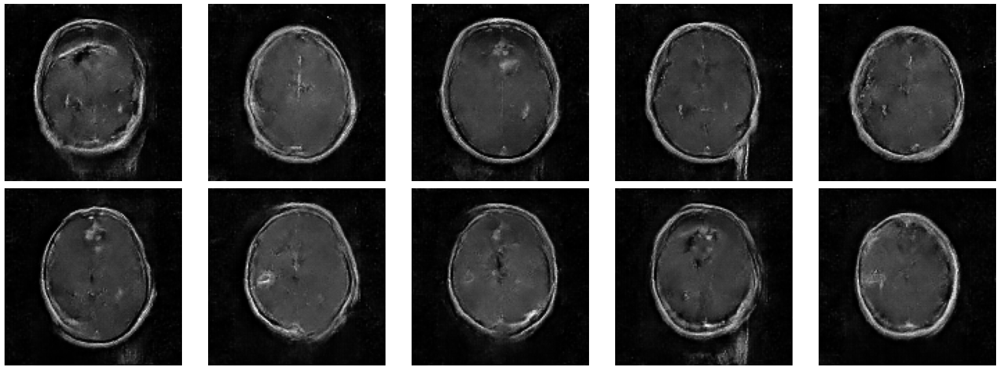

  0%|          | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 1/3750 [00:00<13:16,  4.71it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 2/3750 [00:00<11:43,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 3/3750 [00:00<11:52,  5.26it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 4/3750 [00:00<11:34,  5.39it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 5/3750 [00:00<11:13,  5.56it/s]

1/1 [==============================] - 0s 37ms/step


  0%|          | 6/3750 [00:01<10:47,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 7/3750 [00:01<10:56,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 8/3750 [00:01<10:20,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 9/3750 [00:01<10:44,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 10/3750 [00:01<11:04,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 11/3750 [00:01<10:59,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 12/3750 [00:02<11:11,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 13/3750 [00:02<10:34,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 14/3750 [00:02<10:56,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 15/3750 [00:02<10:17,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 16/3750 [00:02<09:57,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 17/3750 [00:02<10:09,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 18/3750 [00:03<09:52,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 19/3750 [00:03<09:36,  6.47it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 20/3750 [00:03<09:31,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 21/3750 [00:03<09:28,  6.56it/s]

1/1 [==============================] - 0s 35ms/step


  1%|          | 22/3750 [00:03<09:50,  6.32it/s]

1/1 [==============================] - 0s 30ms/step


  1%|          | 23/3750 [00:03<10:18,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 24/3750 [00:04<10:29,  5.92it/s]

1/1 [==============================] - 0s 33ms/step


  1%|          | 25/3750 [00:04<10:02,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 26/3750 [00:04<09:49,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 27/3750 [00:04<09:39,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 28/3750 [00:04<09:35,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 29/3750 [00:04<09:12,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 30/3750 [00:04<09:14,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 31/3750 [00:05<09:00,  6.88it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 32/3750 [00:05<08:50,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 33/3750 [00:05<09:19,  6.65it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 34/3750 [00:05<09:28,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 35/3750 [00:05<09:16,  6.67it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 36/3750 [00:05<09:26,  6.56it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 37/3750 [00:06<10:09,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 38/3750 [00:06<10:00,  6.18it/s]

1/1 [==============================] - 0s 30ms/step


  1%|          | 39/3750 [00:06<09:50,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 40/3750 [00:06<09:40,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 41/3750 [00:06<09:25,  6.56it/s]

1/1 [==============================] - 0s 35ms/step


  1%|          | 42/3750 [00:06<09:23,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 43/3750 [00:06<09:40,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 44/3750 [00:07<09:28,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 45/3750 [00:07<09:23,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 46/3750 [00:07<09:31,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 47/3750 [00:07<09:05,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 48/3750 [00:07<09:39,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 49/3750 [00:07<10:16,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 50/3750 [00:08<09:52,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 51/3750 [00:08<09:48,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 52/3750 [00:08<09:24,  6.55it/s]

1/1 [==============================] - 0s 29ms/step


  1%|▏         | 53/3750 [00:08<09:08,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 54/3750 [00:08<09:40,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 55/3750 [00:08<09:27,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 56/3750 [00:08<08:55,  6.90it/s]

1/1 [==============================] - 0s 34ms/step


  2%|▏         | 57/3750 [00:09<09:43,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 58/3750 [00:09<09:19,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 59/3750 [00:09<09:27,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 60/3750 [00:09<09:39,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 61/3750 [00:09<10:11,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 62/3750 [00:09<09:59,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 63/3750 [00:10<09:31,  6.45it/s]

1/1 [==============================] - 0s 39ms/step


  2%|▏         | 64/3750 [00:10<09:29,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 65/3750 [00:10<10:08,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 66/3750 [00:10<09:39,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 67/3750 [00:10<09:35,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 68/3750 [00:10<09:24,  6.53it/s]

1/1 [==============================] - 0s 35ms/step


  2%|▏         | 69/3750 [00:10<09:17,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 70/3750 [00:11<09:40,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 71/3750 [00:11<09:27,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 72/3750 [00:11<09:18,  6.58it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 73/3750 [00:11<09:12,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 74/3750 [00:11<09:07,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 75/3750 [00:11<09:00,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 76/3750 [00:12<09:20,  6.56it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 77/3750 [00:12<09:22,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 78/3750 [00:12<09:52,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 79/3750 [00:12<10:12,  6.00it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 80/3750 [00:12<10:29,  5.83it/s]

1/1 [==============================] - 0s 36ms/step


  2%|▏         | 81/3750 [00:12<10:38,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 82/3750 [00:13<09:47,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 83/3750 [00:13<09:33,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 84/3750 [00:13<09:52,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 85/3750 [00:13<09:31,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 86/3750 [00:13<09:29,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 87/3750 [00:13<09:38,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 88/3750 [00:14<09:34,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 89/3750 [00:14<09:08,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 90/3750 [00:14<08:46,  6.95it/s]

1/1 [==============================] - 0s 33ms/step


  2%|▏         | 91/3750 [00:14<09:10,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 92/3750 [00:14<09:17,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 93/3750 [00:14<09:59,  6.10it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 94/3750 [00:14<09:41,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 95/3750 [00:15<09:33,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 96/3750 [00:15<09:06,  6.68it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 97/3750 [00:15<09:48,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 98/3750 [00:15<09:17,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 99/3750 [00:15<09:19,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 100/3750 [00:15<09:14,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 101/3750 [00:15<08:50,  6.88it/s]

1/1 [==============================] - 0s 35ms/step


  3%|▎         | 102/3750 [00:16<08:58,  6.77it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 103/3750 [00:16<09:38,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 104/3750 [00:16<09:18,  6.53it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 105/3750 [00:16<09:10,  6.63it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 106/3750 [00:16<09:12,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 107/3750 [00:16<09:39,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 108/3750 [00:17<09:53,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 109/3750 [00:17<09:49,  6.17it/s]

1/1 [==============================] - 0s 34ms/step


  3%|▎         | 110/3750 [00:17<10:20,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 111/3750 [00:17<09:57,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 112/3750 [00:17<09:36,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 113/3750 [00:17<09:13,  6.57it/s]

1/1 [==============================] - 0s 32ms/step


  3%|▎         | 114/3750 [00:18<08:57,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 115/3750 [00:18<09:29,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 116/3750 [00:18<09:52,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 117/3750 [00:18<09:45,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 118/3750 [00:18<10:05,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 119/3750 [00:18<09:38,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 120/3750 [00:18<09:13,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 121/3750 [00:19<09:06,  6.64it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 122/3750 [00:19<09:32,  6.33it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 123/3750 [00:19<09:58,  6.06it/s]

1/1 [==============================] - 0s 36ms/step


  3%|▎         | 124/3750 [00:19<10:28,  5.77it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 125/3750 [00:19<10:16,  5.88it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 126/3750 [00:20<10:13,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 127/3750 [00:20<09:46,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 128/3750 [00:20<10:21,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 129/3750 [00:20<10:24,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 130/3750 [00:20<10:00,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 131/3750 [00:20<10:16,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 132/3750 [00:21<10:13,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 133/3750 [00:21<10:23,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 134/3750 [00:21<09:50,  6.12it/s]

1/1 [==============================] - 0s 33ms/step


  4%|▎         | 135/3750 [00:21<10:18,  5.84it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▎         | 136/3750 [00:21<09:55,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 137/3750 [00:21<09:36,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 138/3750 [00:22<10:02,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 139/3750 [00:22<09:37,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 140/3750 [00:22<09:21,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 141/3750 [00:22<09:55,  6.06it/s]

1/1 [==============================] - 0s 33ms/step


  4%|▍         | 142/3750 [00:22<10:35,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 143/3750 [00:22<09:59,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 144/3750 [00:23<10:14,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 145/3750 [00:23<09:42,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 146/3750 [00:23<09:23,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 147/3750 [00:23<09:06,  6.59it/s]

1/1 [==============================] - 0s 35ms/step


  4%|▍         | 148/3750 [00:23<09:01,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 149/3750 [00:23<08:50,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 150/3750 [00:23<09:12,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 151/3750 [00:24<09:46,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 152/3750 [00:24<09:22,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 153/3750 [00:24<09:05,  6.59it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 154/3750 [00:24<09:35,  6.25it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▍         | 155/3750 [00:24<09:23,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 156/3750 [00:24<09:57,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 157/3750 [00:25<09:26,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 158/3750 [00:25<09:04,  6.59it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 159/3750 [00:25<09:11,  6.51it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 160/3750 [00:25<09:22,  6.39it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 161/3750 [00:25<09:06,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 162/3750 [00:25<09:08,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 163/3750 [00:25<09:13,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 164/3750 [00:26<09:30,  6.28it/s]

1/1 [==============================] - 0s 38ms/step


  4%|▍         | 165/3750 [00:26<09:32,  6.26it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▍         | 166/3750 [00:26<09:15,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 167/3750 [00:26<09:00,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 168/3750 [00:26<09:48,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 169/3750 [00:26<09:08,  6.53it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▍         | 170/3750 [00:27<09:32,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 171/3750 [00:27<09:29,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 172/3750 [00:27<09:33,  6.24it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▍         | 173/3750 [00:27<09:41,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 174/3750 [00:27<09:38,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 175/3750 [00:27<09:49,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 176/3750 [00:28<09:28,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 177/3750 [00:28<09:28,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 178/3750 [00:28<09:18,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 179/3750 [00:28<09:10,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▍         | 180/3750 [00:28<09:10,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 181/3750 [00:28<09:01,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 182/3750 [00:28<08:42,  6.82it/s]

1/1 [==============================] - 0s 35ms/step


  5%|▍         | 183/3750 [00:29<09:14,  6.44it/s]

1/1 [==============================] - 0s 36ms/step


  5%|▍         | 184/3750 [00:29<09:15,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 185/3750 [00:29<09:08,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▍         | 186/3750 [00:29<08:49,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 187/3750 [00:29<08:46,  6.77it/s]

1/1 [==============================] - 0s 30ms/step


  5%|▌         | 188/3750 [00:29<09:15,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▌         | 189/3750 [00:30<09:18,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 190/3750 [00:30<09:44,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 191/3750 [00:30<09:39,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 192/3750 [00:30<09:15,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 193/3750 [00:30<08:58,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 194/3750 [00:30<09:24,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 195/3750 [00:30<09:49,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 196/3750 [00:31<09:49,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 197/3750 [00:31<09:21,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 198/3750 [00:31<09:07,  6.49it/s]

1/1 [==============================] - 0s 33ms/step


  5%|▌         | 199/3750 [00:31<09:32,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 200/3750 [00:31<09:55,  5.96it/s]

1/1 [==============================] - 0s 33ms/step


  5%|▌         | 201/3750 [00:31<09:38,  6.13it/s]

1/1 [==============================] - 0s 52ms/step


  5%|▌         | 202/3750 [00:32<09:57,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 203/3750 [00:32<09:52,  5.99it/s]

1/1 [==============================] - 0s 51ms/step


  5%|▌         | 204/3750 [00:32<10:59,  5.37it/s]

1/1 [==============================] - 0s 38ms/step


  5%|▌         | 205/3750 [00:32<10:55,  5.41it/s]

1/1 [==============================] - 0s 44ms/step


  5%|▌         | 206/3750 [00:32<10:38,  5.55it/s]

1/1 [==============================] - 0s 39ms/step


  6%|▌         | 207/3750 [00:33<11:37,  5.08it/s]

1/1 [==============================] - 0s 37ms/step


  6%|▌         | 208/3750 [00:33<11:15,  5.24it/s]

1/1 [==============================] - 0s 45ms/step


  6%|▌         | 209/3750 [00:33<11:17,  5.23it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▌         | 210/3750 [00:33<11:59,  4.92it/s]

1/1 [==============================] - 0s 46ms/step


  6%|▌         | 211/3750 [00:33<12:51,  4.58it/s]

1/1 [==============================] - 0s 36ms/step


  6%|▌         | 212/3750 [00:34<13:06,  4.50it/s]

1/1 [==============================] - 0s 36ms/step


  6%|▌         | 213/3750 [00:34<12:29,  4.72it/s]

1/1 [==============================] - 0s 45ms/step


  6%|▌         | 214/3750 [00:34<12:29,  4.72it/s]

1/1 [==============================] - 0s 53ms/step


  6%|▌         | 215/3750 [00:34<12:30,  4.71it/s]

1/1 [==============================] - 0s 41ms/step


  6%|▌         | 216/3750 [00:35<12:20,  4.77it/s]

1/1 [==============================] - 0s 35ms/step


  6%|▌         | 217/3750 [00:35<12:02,  4.89it/s]

1/1 [==============================] - 0s 34ms/step


  6%|▌         | 218/3750 [00:35<11:35,  5.08it/s]

1/1 [==============================] - 0s 47ms/step


  6%|▌         | 219/3750 [00:35<11:45,  5.00it/s]

1/1 [==============================] - 0s 56ms/step


  6%|▌         | 220/3750 [00:35<11:49,  4.97it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 221/3750 [00:35<11:08,  5.28it/s]

1/1 [==============================] - 0s 51ms/step


  6%|▌         | 222/3750 [00:36<11:49,  4.98it/s]

1/1 [==============================] - 0s 51ms/step


  6%|▌         | 223/3750 [00:36<11:48,  4.98it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 224/3750 [00:36<11:46,  4.99it/s]

1/1 [==============================] - 0s 35ms/step


  6%|▌         | 225/3750 [00:37<18:31,  3.17it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 226/3750 [00:37<15:41,  3.74it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 227/3750 [00:37<13:32,  4.33it/s]

1/1 [==============================] - 0s 35ms/step


  6%|▌         | 228/3750 [00:37<12:20,  4.76it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 229/3750 [00:37<12:02,  4.87it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▌         | 230/3750 [00:38<11:33,  5.08it/s]

1/1 [==============================] - 0s 36ms/step


  6%|▌         | 231/3750 [00:38<11:01,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 232/3750 [00:38<11:05,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 233/3750 [00:38<11:02,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 234/3750 [00:38<10:26,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 235/3750 [00:38<09:54,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 236/3750 [00:38<09:21,  6.26it/s]

1/1 [==============================] - 0s 36ms/step


  6%|▋         | 237/3750 [00:39<09:02,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▋         | 238/3750 [00:39<08:48,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 239/3750 [00:39<08:49,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 240/3750 [00:39<08:38,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 241/3750 [00:39<08:48,  6.63it/s]

1/1 [==============================] - 0s 37ms/step


  6%|▋         | 242/3750 [00:39<09:34,  6.11it/s]

1/1 [==============================] - 0s 37ms/step


  6%|▋         | 243/3750 [00:40<09:21,  6.24it/s]

1/1 [==============================] - 0s 35ms/step


  7%|▋         | 244/3750 [00:40<09:39,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 245/3750 [00:40<09:30,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 246/3750 [00:40<09:17,  6.28it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 247/3750 [00:40<09:37,  6.07it/s]

1/1 [==============================] - 0s 34ms/step


  7%|▋         | 248/3750 [00:40<09:34,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 249/3750 [00:41<09:44,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 250/3750 [00:41<09:49,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 251/3750 [00:41<09:28,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 252/3750 [00:41<09:26,  6.17it/s]

1/1 [==============================] - 0s 37ms/step


  7%|▋         | 253/3750 [00:41<09:24,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 254/3750 [00:41<09:19,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 255/3750 [00:42<09:09,  6.37it/s]

1/1 [==============================] - 0s 34ms/step


  7%|▋         | 256/3750 [00:42<09:51,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 257/3750 [00:42<09:36,  6.06it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 258/3750 [00:42<09:58,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 259/3750 [00:42<09:24,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 260/3750 [00:42<08:52,  6.55it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 261/3750 [00:42<08:50,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 262/3750 [00:43<09:23,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 263/3750 [00:43<09:09,  6.35it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 264/3750 [00:43<09:30,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 265/3750 [00:43<09:20,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 266/3750 [00:43<09:27,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 267/3750 [00:43<09:19,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 268/3750 [00:44<09:03,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 269/3750 [00:44<09:02,  6.42it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 270/3750 [00:44<09:26,  6.14it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 271/3750 [00:44<09:03,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 272/3750 [00:44<08:47,  6.59it/s]

1/1 [==============================] - 0s 31ms/step


  7%|▋         | 273/3750 [00:44<09:05,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 274/3750 [00:45<09:07,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 275/3750 [00:45<09:52,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 276/3750 [00:45<09:39,  6.00it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 277/3750 [00:45<09:42,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 278/3750 [00:45<09:28,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 279/3750 [00:45<09:14,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 280/3750 [00:46<08:54,  6.49it/s]

1/1 [==============================] - 0s 34ms/step


  7%|▋         | 281/3750 [00:46<09:03,  6.38it/s]

1/1 [==============================] - 0s 41ms/step


  8%|▊         | 282/3750 [00:46<09:06,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 283/3750 [00:46<09:27,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 284/3750 [00:46<08:55,  6.48it/s]

1/1 [==============================] - 0s 37ms/step


  8%|▊         | 285/3750 [00:46<09:02,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 286/3750 [00:46<08:54,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 287/3750 [00:47<08:24,  6.87it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 288/3750 [00:47<08:08,  7.08it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 289/3750 [00:47<08:44,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 290/3750 [00:47<08:41,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 291/3750 [00:47<08:35,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 292/3750 [00:47<08:23,  6.87it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 293/3750 [00:47<08:23,  6.86it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 294/3750 [00:48<08:18,  6.93it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 295/3750 [00:48<08:11,  7.03it/s]

1/1 [==============================] - 0s 35ms/step


  8%|▊         | 296/3750 [00:48<08:58,  6.42it/s]

1/1 [==============================] - 0s 33ms/step


  8%|▊         | 297/3750 [00:48<09:32,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 298/3750 [00:48<09:00,  6.38it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 299/3750 [00:48<09:02,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 300/3750 [00:49<08:49,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 301/3750 [00:49<08:28,  6.79it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 302/3750 [00:49<08:48,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 303/3750 [00:49<08:46,  6.55it/s]

1/1 [==============================] - 0s 36ms/step


  8%|▊         | 304/3750 [00:49<08:49,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 305/3750 [00:49<08:33,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 306/3750 [00:49<08:53,  6.46it/s]

1/1 [==============================] - 0s 33ms/step


  8%|▊         | 307/3750 [00:50<08:59,  6.38it/s]

1/1 [==============================] - 0s 50ms/step


  8%|▊         | 308/3750 [00:50<09:10,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 309/3750 [00:50<09:23,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 310/3750 [00:50<09:08,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 311/3750 [00:50<08:40,  6.61it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 312/3750 [00:50<08:25,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 313/3750 [00:51<09:17,  6.16it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 314/3750 [00:51<09:07,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 315/3750 [00:51<09:24,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 316/3750 [00:51<09:11,  6.23it/s]

1/1 [==============================] - 0s 33ms/step


  8%|▊         | 317/3750 [00:51<09:52,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 318/3750 [00:51<09:49,  5.82it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▊         | 319/3750 [00:52<09:33,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 320/3750 [00:52<09:02,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 321/3750 [00:52<08:44,  6.54it/s]

1/1 [==============================] - 0s 31ms/step


  9%|▊         | 322/3750 [00:52<08:40,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 323/3750 [00:52<09:05,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 324/3750 [00:52<09:00,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 325/3750 [00:53<08:43,  6.55it/s]

1/1 [==============================] - 0s 32ms/step


  9%|▊         | 326/3750 [00:53<08:53,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 327/3750 [00:53<08:41,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 328/3750 [00:53<08:42,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 329/3750 [00:53<08:25,  6.77it/s]

1/1 [==============================] - 0s 31ms/step


  9%|▉         | 330/3750 [00:53<08:30,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 331/3750 [00:53<08:53,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 332/3750 [00:54<08:33,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 333/3750 [00:54<08:49,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 334/3750 [00:54<08:57,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 335/3750 [00:54<08:50,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 336/3750 [00:54<08:58,  6.34it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 337/3750 [00:54<09:20,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 338/3750 [00:55<09:07,  6.23it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 339/3750 [00:55<09:21,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 340/3750 [00:55<08:52,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 341/3750 [00:55<08:28,  6.70it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▉         | 342/3750 [00:55<08:24,  6.75it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 343/3750 [00:55<08:52,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 344/3750 [00:55<09:00,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 345/3750 [00:56<08:56,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 346/3750 [00:56<09:12,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 347/3750 [00:56<08:51,  6.40it/s]

1/1 [==============================] - 0s 44ms/step


  9%|▉         | 348/3750 [00:56<09:03,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 349/3750 [00:56<08:49,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 350/3750 [00:56<08:22,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 351/3750 [00:57<08:41,  6.51it/s]

1/1 [==============================] - 0s 35ms/step


  9%|▉         | 352/3750 [00:57<09:22,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 353/3750 [00:57<08:58,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 354/3750 [00:57<08:48,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 355/3750 [00:57<08:24,  6.73it/s]

1/1 [==============================] - 0s 42ms/step


  9%|▉         | 356/3750 [00:57<09:04,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 357/3750 [00:58<09:40,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 358/3750 [00:58<09:16,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 359/3750 [00:58<09:35,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 360/3750 [00:58<09:13,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 361/3750 [00:58<09:46,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 362/3750 [00:58<09:22,  6.03it/s]

1/1 [==============================] - 0s 27ms/step


 10%|▉         | 363/3750 [00:59<09:21,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 364/3750 [00:59<09:51,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 365/3750 [00:59<09:57,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 366/3750 [00:59<09:40,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 367/3750 [00:59<09:18,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 368/3750 [00:59<09:05,  6.20it/s]

1/1 [==============================] - 0s 31ms/step


 10%|▉         | 369/3750 [01:00<08:55,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 370/3750 [01:00<09:18,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 371/3750 [01:00<09:15,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 372/3750 [01:00<09:07,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 373/3750 [01:00<09:12,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 374/3750 [01:00<08:57,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 375/3750 [01:01<08:56,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 376/3750 [01:01<08:56,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 377/3750 [01:01<08:38,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 378/3750 [01:01<09:07,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 379/3750 [01:01<09:35,  5.86it/s]

1/1 [==============================] - 0s 38ms/step


 10%|█         | 380/3750 [01:01<09:34,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 381/3750 [01:02<09:43,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 382/3750 [01:02<09:27,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 383/3750 [01:02<08:58,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 384/3750 [01:02<08:43,  6.43it/s]

1/1 [==============================] - 0s 29ms/step


 10%|█         | 385/3750 [01:02<09:24,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 386/3750 [01:02<09:47,  5.72it/s]

1/1 [==============================] - 0s 37ms/step


 10%|█         | 387/3750 [01:03<10:09,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 388/3750 [01:03<10:12,  5.49it/s]

1/1 [==============================] - 0s 34ms/step


 10%|█         | 389/3750 [01:03<10:29,  5.34it/s]

1/1 [==============================] - 0s 32ms/step


 10%|█         | 390/3750 [01:03<10:10,  5.50it/s]

1/1 [==============================] - 0s 36ms/step


 10%|█         | 391/3750 [01:03<10:12,  5.49it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 392/3750 [01:03<09:58,  5.61it/s]

1/1 [==============================] - 0s 29ms/step


 10%|█         | 393/3750 [01:04<09:29,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 394/3750 [01:04<09:39,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 395/3750 [01:04<09:27,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 396/3750 [01:04<09:07,  6.13it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 397/3750 [01:04<09:06,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 398/3750 [01:04<08:33,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 399/3750 [01:05<08:19,  6.71it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 400/3750 [01:05<08:05,  6.90it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 401/3750 [01:05<08:13,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 402/3750 [01:05<08:10,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 403/3750 [01:05<08:47,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 404/3750 [01:05<08:31,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 405/3750 [01:05<08:27,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 406/3750 [01:06<08:32,  6.53it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 407/3750 [01:06<08:48,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 408/3750 [01:06<09:03,  6.15it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 409/3750 [01:06<09:26,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 410/3750 [01:06<08:53,  6.26it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 411/3750 [01:06<08:37,  6.46it/s]

1/1 [==============================] - 0s 34ms/step


 11%|█         | 412/3750 [01:07<08:33,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 413/3750 [01:07<09:07,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 414/3750 [01:07<08:37,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 415/3750 [01:07<08:40,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 416/3750 [01:07<08:44,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 417/3750 [01:07<08:33,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 418/3750 [01:08<08:54,  6.23it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 419/3750 [01:08<08:46,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 420/3750 [01:08<08:43,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 421/3750 [01:08<09:09,  6.06it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█▏        | 422/3750 [01:08<08:55,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 423/3750 [01:08<09:17,  5.96it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█▏        | 424/3750 [01:08<08:56,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 425/3750 [01:09<08:38,  6.42it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█▏        | 426/3750 [01:09<09:23,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 427/3750 [01:09<09:29,  5.83it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█▏        | 428/3750 [01:09<08:58,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█▏        | 429/3750 [01:09<08:42,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 430/3750 [01:09<08:14,  6.71it/s]

1/1 [==============================] - 0s 33ms/step


 11%|█▏        | 431/3750 [01:10<08:20,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 432/3750 [01:10<08:21,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 433/3750 [01:10<08:33,  6.45it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 434/3750 [01:10<09:11,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 435/3750 [01:10<08:53,  6.22it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 436/3750 [01:10<08:53,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 437/3750 [01:11<09:03,  6.10it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 438/3750 [01:11<08:58,  6.15it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 439/3750 [01:11<08:51,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 440/3750 [01:11<08:54,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 441/3750 [01:11<08:56,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 442/3750 [01:11<08:37,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 443/3750 [01:12<09:12,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 444/3750 [01:12<08:51,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 445/3750 [01:12<08:42,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 446/3750 [01:12<08:29,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 447/3750 [01:12<08:22,  6.57it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 448/3750 [01:12<08:13,  6.69it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 449/3750 [01:12<08:03,  6.83it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 450/3750 [01:13<08:13,  6.69it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 451/3750 [01:13<08:17,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 452/3750 [01:13<08:36,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 453/3750 [01:13<08:24,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 454/3750 [01:13<08:28,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 455/3750 [01:13<08:22,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 456/3750 [01:14<08:26,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 457/3750 [01:14<08:36,  6.38it/s]

1/1 [==============================] - 0s 34ms/step


 12%|█▏        | 458/3750 [01:14<08:38,  6.35it/s]

1/1 [==============================] - 0s 36ms/step


 12%|█▏        | 459/3750 [01:14<08:40,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 460/3750 [01:14<08:47,  6.24it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 461/3750 [01:14<08:32,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 462/3750 [01:14<08:17,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 463/3750 [01:15<08:54,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 464/3750 [01:15<08:22,  6.54it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 465/3750 [01:15<08:48,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 466/3750 [01:15<08:37,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 467/3750 [01:15<08:28,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 468/3750 [01:15<08:40,  6.31it/s]

1/1 [==============================] - 0s 34ms/step


 13%|█▎        | 469/3750 [01:16<08:32,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 470/3750 [01:16<08:36,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 471/3750 [01:16<08:30,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 472/3750 [01:16<08:47,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 473/3750 [01:16<08:39,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 474/3750 [01:16<08:38,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 475/3750 [01:17<08:24,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 476/3750 [01:17<08:16,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 477/3750 [01:17<08:36,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 478/3750 [01:17<08:32,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 479/3750 [01:17<09:07,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 480/3750 [01:17<08:43,  6.25it/s]

1/1 [==============================] - 0s 39ms/step


 13%|█▎        | 481/3750 [01:17<08:44,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 482/3750 [01:18<09:15,  5.88it/s]

1/1 [==============================] - 0s 46ms/step


 13%|█▎        | 483/3750 [01:18<09:20,  5.83it/s]

1/1 [==============================] - 0s 36ms/step


 13%|█▎        | 484/3750 [01:18<09:17,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 485/3750 [01:18<08:55,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 486/3750 [01:18<08:50,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 487/3750 [01:18<08:45,  6.20it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 488/3750 [01:19<08:39,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 489/3750 [01:19<08:34,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 490/3750 [01:19<08:39,  6.27it/s]

1/1 [==============================] - 0s 34ms/step


 13%|█▎        | 491/3750 [01:19<08:44,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 492/3750 [01:19<08:43,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 493/3750 [01:19<09:06,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 494/3750 [01:20<08:53,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 495/3750 [01:20<08:17,  6.54it/s]

1/1 [==============================] - 0s 36ms/step


 13%|█▎        | 496/3750 [01:20<08:44,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 497/3750 [01:20<09:22,  5.79it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 498/3750 [01:20<09:57,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 499/3750 [01:20<09:37,  5.63it/s]

1/1 [==============================] - 0s 39ms/step


 13%|█▎        | 500/3750 [01:21<10:03,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 501/3750 [01:21<09:35,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 502/3750 [01:21<09:10,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 503/3750 [01:21<08:48,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 504/3750 [01:21<08:56,  6.05it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 505/3750 [01:21<09:08,  5.92it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 506/3750 [01:22<08:51,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 507/3750 [01:22<08:35,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 508/3750 [01:22<08:44,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 509/3750 [01:22<08:46,  6.15it/s]

1/1 [==============================] - 0s 42ms/step


 14%|█▎        | 510/3750 [01:22<08:49,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▎        | 511/3750 [01:22<08:40,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 512/3750 [01:23<08:28,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 513/3750 [01:23<08:23,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 514/3750 [01:23<08:50,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 515/3750 [01:23<09:04,  5.94it/s]

1/1 [==============================] - 0s 38ms/step


 14%|█▍        | 516/3750 [01:23<09:09,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 517/3750 [01:23<09:29,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 518/3750 [01:24<09:18,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 519/3750 [01:24<09:00,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 520/3750 [01:24<08:38,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 521/3750 [01:24<09:08,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 522/3750 [01:24<08:53,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 523/3750 [01:24<09:29,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 524/3750 [01:25<09:05,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 525/3750 [01:25<09:01,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 526/3750 [01:25<08:59,  5.97it/s]

1/1 [==============================] - 0s 33ms/step


 14%|█▍        | 527/3750 [01:25<09:07,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 528/3750 [01:25<08:52,  6.05it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 529/3750 [01:25<08:59,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 530/3750 [01:26<09:09,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 531/3750 [01:26<08:50,  6.07it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 532/3750 [01:26<09:30,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 533/3750 [01:26<08:55,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 534/3750 [01:26<08:42,  6.15it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▍        | 535/3750 [01:27<09:17,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 536/3750 [01:27<08:44,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 537/3750 [01:27<09:05,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 538/3750 [01:27<09:04,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 539/3750 [01:27<09:17,  5.76it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▍        | 540/3750 [01:27<09:32,  5.61it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▍        | 541/3750 [01:28<09:48,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 542/3750 [01:28<09:43,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 543/3750 [01:28<09:21,  5.71it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 544/3750 [01:28<09:16,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 545/3750 [01:28<08:43,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 546/3750 [01:28<09:00,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 547/3750 [01:29<09:23,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 548/3750 [01:29<09:39,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 549/3750 [01:29<09:49,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 550/3750 [01:29<09:11,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 551/3750 [01:29<08:45,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 552/3750 [01:29<08:38,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 553/3750 [01:30<08:29,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 554/3750 [01:30<08:58,  5.94it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▍        | 555/3750 [01:30<08:40,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 556/3750 [01:30<08:29,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 557/3750 [01:30<08:12,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 558/3750 [01:30<08:22,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 559/3750 [01:31<08:19,  6.39it/s]

1/1 [==============================] - 0s 46ms/step


 15%|█▍        | 560/3750 [01:31<09:07,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 561/3750 [01:31<09:11,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 562/3750 [01:31<08:54,  5.96it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 563/3750 [01:31<08:37,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 564/3750 [01:31<08:28,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 565/3750 [01:32<08:24,  6.31it/s]

1/1 [==============================] - 0s 36ms/step


 15%|█▌        | 566/3750 [01:32<09:05,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 567/3750 [01:32<08:52,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 568/3750 [01:32<08:22,  6.33it/s]

1/1 [==============================] - 0s 34ms/step


 15%|█▌        | 569/3750 [01:32<08:47,  6.03it/s]

1/1 [==============================] - 0s 35ms/step


 15%|█▌        | 570/3750 [01:32<08:53,  5.96it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 571/3750 [01:33<09:03,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 572/3750 [01:33<09:13,  5.74it/s]

1/1 [==============================] - 0s 33ms/step


 15%|█▌        | 573/3750 [01:33<10:01,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 574/3750 [01:33<09:55,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 575/3750 [01:33<09:20,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 576/3750 [01:33<08:42,  6.08it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▌        | 577/3750 [01:34<09:07,  5.80it/s]

1/1 [==============================] - 0s 34ms/step


 15%|█▌        | 578/3750 [01:34<09:47,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 579/3750 [01:34<09:46,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 580/3750 [01:34<09:23,  5.63it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▌        | 581/3750 [01:34<09:20,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 582/3750 [01:35<08:56,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 583/3750 [01:35<09:09,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 584/3750 [01:35<08:53,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 585/3750 [01:35<08:53,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 586/3750 [01:35<08:47,  6.00it/s]

1/1 [==============================] - 0s 34ms/step


 16%|█▌        | 587/3750 [01:35<08:46,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 588/3750 [01:36<09:24,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 589/3750 [01:36<08:46,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 590/3750 [01:36<08:54,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 591/3750 [01:36<08:43,  6.03it/s]

1/1 [==============================] - 0s 34ms/step


 16%|█▌        | 592/3750 [01:36<08:40,  6.06it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 593/3750 [01:36<08:28,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 594/3750 [01:36<08:17,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 595/3750 [01:37<08:10,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 596/3750 [01:37<08:03,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 597/3750 [01:37<08:21,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 598/3750 [01:37<08:43,  6.02it/s]

1/1 [==============================] - 0s 39ms/step


 16%|█▌        | 599/3750 [01:37<09:08,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 600/3750 [01:37<08:46,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 601/3750 [01:38<08:28,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 602/3750 [01:38<08:23,  6.25it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▌        | 603/3750 [01:38<08:27,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 604/3750 [01:38<08:10,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 605/3750 [01:38<08:48,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 606/3750 [01:38<08:47,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 607/3750 [01:39<08:59,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 608/3750 [01:39<09:10,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 609/3750 [01:39<09:27,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 610/3750 [01:39<09:29,  5.51it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▋        | 611/3750 [01:39<09:27,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 612/3750 [01:40<09:09,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 613/3750 [01:40<08:55,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▋        | 614/3750 [01:40<09:39,  5.41it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 615/3750 [01:40<09:21,  5.58it/s]

1/1 [==============================] - 0s 48ms/step


 16%|█▋        | 616/3750 [01:40<09:56,  5.26it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▋        | 617/3750 [01:40<09:45,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 618/3750 [01:41<09:19,  5.60it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 619/3750 [01:41<08:56,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 620/3750 [01:41<08:51,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 621/3750 [01:41<08:50,  5.90it/s]

1/1 [==============================] - 0s 41ms/step


 17%|█▋        | 622/3750 [01:41<09:04,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 623/3750 [01:42<09:21,  5.57it/s]

1/1 [==============================] - 0s 34ms/step


 17%|█▋        | 624/3750 [01:42<09:29,  5.49it/s]

1/1 [==============================] - 0s 40ms/step


 17%|█▋        | 625/3750 [01:42<09:35,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 626/3750 [01:42<09:06,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 627/3750 [01:42<08:38,  6.02it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 628/3750 [01:42<08:34,  6.07it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 629/3750 [01:43<08:28,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 630/3750 [01:43<08:17,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 631/3750 [01:43<08:13,  6.33it/s]

1/1 [==============================] - 0s 33ms/step


 17%|█▋        | 632/3750 [01:43<08:39,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 633/3750 [01:43<08:16,  6.28it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 634/3750 [01:43<08:16,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 635/3750 [01:43<08:01,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 636/3750 [01:44<07:44,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 637/3750 [01:44<08:03,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 638/3750 [01:44<08:02,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 639/3750 [01:44<08:09,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 640/3750 [01:44<08:07,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 641/3750 [01:44<07:57,  6.51it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 642/3750 [01:45<08:07,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 643/3750 [01:45<08:20,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 644/3750 [01:45<08:05,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 645/3750 [01:45<07:53,  6.55it/s]

1/1 [==============================] - 0s 45ms/step


 17%|█▋        | 646/3750 [01:45<08:06,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 647/3750 [01:45<08:10,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 648/3750 [01:45<07:55,  6.53it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 649/3750 [01:46<07:48,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 650/3750 [01:46<08:26,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 651/3750 [01:46<08:16,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 652/3750 [01:46<08:02,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 653/3750 [01:46<08:03,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 654/3750 [01:46<08:06,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 655/3750 [01:47<08:02,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 656/3750 [01:47<07:54,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 657/3750 [01:47<07:46,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 658/3750 [01:47<07:46,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 659/3750 [01:47<07:39,  6.73it/s]

1/1 [==============================] - 0s 42ms/step


 18%|█▊        | 660/3750 [01:47<07:41,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 661/3750 [01:47<07:38,  6.74it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 662/3750 [01:48<07:21,  7.00it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 663/3750 [01:48<07:28,  6.88it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 664/3750 [01:48<08:06,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 665/3750 [01:48<08:38,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 666/3750 [01:48<08:13,  6.25it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 667/3750 [01:48<08:06,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 668/3750 [01:49<08:23,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 669/3750 [01:49<08:09,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 670/3750 [01:49<08:16,  6.20it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 671/3750 [01:49<08:37,  5.95it/s]

1/1 [==============================] - 0s 33ms/step


 18%|█▊        | 672/3750 [01:49<08:18,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 673/3750 [01:49<08:43,  5.88it/s]

1/1 [==============================] - 0s 34ms/step


 18%|█▊        | 674/3750 [01:50<09:07,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 675/3750 [01:50<08:33,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 676/3750 [01:50<08:16,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 677/3750 [01:50<08:15,  6.20it/s]

1/1 [==============================] - 0s 34ms/step


 18%|█▊        | 678/3750 [01:50<08:08,  6.29it/s]

1/1 [==============================] - 0s 38ms/step


 18%|█▊        | 679/3750 [01:50<08:37,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 680/3750 [01:51<08:17,  6.17it/s]

1/1 [==============================] - 0s 32ms/step


 18%|█▊        | 681/3750 [01:51<08:36,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 682/3750 [01:51<08:27,  6.05it/s]

1/1 [==============================] - 0s 41ms/step


 18%|█▊        | 683/3750 [01:51<08:55,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 684/3750 [01:51<09:02,  5.65it/s]

1/1 [==============================] - 0s 38ms/step


 18%|█▊        | 685/3750 [01:51<09:10,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 686/3750 [01:52<08:53,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 687/3750 [01:52<09:07,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 688/3750 [01:52<08:43,  5.85it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 689/3750 [01:52<08:50,  5.77it/s]

1/1 [==============================] - 0s 45ms/step


 18%|█▊        | 690/3750 [01:52<09:32,  5.34it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 691/3750 [01:53<09:40,  5.27it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 692/3750 [01:53<09:08,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 693/3750 [01:53<08:43,  5.84it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▊        | 694/3750 [01:53<09:11,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 695/3750 [01:53<08:53,  5.72it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▊        | 696/3750 [01:53<08:44,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▊        | 697/3750 [01:54<08:43,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 698/3750 [01:54<08:21,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 699/3750 [01:54<08:50,  5.75it/s]

1/1 [==============================] - 0s 37ms/step


 19%|█▊        | 700/3750 [01:54<09:06,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 701/3750 [01:54<08:48,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▊        | 702/3750 [01:54<09:27,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 703/3750 [01:55<08:43,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 704/3750 [01:55<09:06,  5.58it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 705/3750 [01:55<08:45,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 706/3750 [01:55<08:39,  5.86it/s]

1/1 [==============================] - 0s 37ms/step


 19%|█▉        | 707/3750 [01:55<09:01,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 708/3750 [01:55<08:35,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 709/3750 [01:56<08:30,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 710/3750 [01:56<08:54,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 711/3750 [01:56<08:30,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 712/3750 [01:56<08:37,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 713/3750 [01:56<08:30,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 714/3750 [01:56<08:22,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 715/3750 [01:57<08:07,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 716/3750 [01:57<07:48,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 717/3750 [01:57<07:51,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 718/3750 [01:57<07:43,  6.55it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 719/3750 [01:57<07:22,  6.85it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 720/3750 [01:57<07:15,  6.95it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 721/3750 [01:57<07:18,  6.91it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 722/3750 [01:58<07:29,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 723/3750 [01:58<07:04,  7.13it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 724/3750 [01:58<07:45,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 725/3750 [01:58<07:46,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 726/3750 [01:58<07:41,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 727/3750 [01:58<07:30,  6.72it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 728/3750 [01:59<07:18,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 729/3750 [01:59<07:05,  7.11it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 730/3750 [01:59<07:13,  6.96it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 731/3750 [01:59<07:42,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 732/3750 [01:59<08:14,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 733/3750 [01:59<07:52,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 734/3750 [01:59<07:54,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 735/3750 [02:00<07:47,  6.45it/s]

1/1 [==============================] - 0s 30ms/step


 20%|█▉        | 736/3750 [02:00<08:29,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 737/3750 [02:00<08:41,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 20%|█▉        | 738/3750 [02:00<08:22,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 739/3750 [02:00<08:02,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 740/3750 [02:00<07:36,  6.60it/s]

1/1 [==============================] - 0s 28ms/step


 20%|█▉        | 741/3750 [02:01<07:32,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 742/3750 [02:01<07:20,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 743/3750 [02:01<07:20,  6.83it/s]

1/1 [==============================] - 0s 30ms/step


 20%|█▉        | 744/3750 [02:01<07:28,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 745/3750 [02:01<07:19,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 746/3750 [02:01<07:34,  6.61it/s]

1/1 [==============================] - 0s 34ms/step


 20%|█▉        | 747/3750 [02:01<07:34,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 748/3750 [02:02<07:24,  6.75it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 749/3750 [02:02<07:22,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 750/3750 [02:02<07:09,  6.99it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 751/3750 [02:02<07:08,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 752/3750 [02:02<07:28,  6.69it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 753/3750 [02:02<08:14,  6.06it/s]

1/1 [==============================] - 0s 30ms/step


 20%|██        | 754/3750 [02:03<08:27,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 755/3750 [02:03<07:58,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 756/3750 [02:03<07:42,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 757/3750 [02:03<07:34,  6.58it/s]

1/1 [==============================] - 0s 32ms/step


 20%|██        | 758/3750 [02:03<08:20,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 759/3750 [02:03<07:58,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 760/3750 [02:04<08:08,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 761/3750 [02:04<07:50,  6.36it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 762/3750 [02:04<07:47,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 763/3750 [02:04<07:42,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 764/3750 [02:04<07:32,  6.60it/s]

1/1 [==============================] - 0s 53ms/step


 20%|██        | 765/3750 [02:04<07:50,  6.34it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 766/3750 [02:04<08:14,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 767/3750 [02:05<08:12,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 768/3750 [02:05<07:54,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 769/3750 [02:05<07:49,  6.35it/s]

1/1 [==============================] - 0s 37ms/step


 21%|██        | 770/3750 [02:05<08:25,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 771/3750 [02:05<08:37,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 772/3750 [02:06<08:38,  5.74it/s]

1/1 [==============================] - 0s 35ms/step


 21%|██        | 773/3750 [02:06<08:36,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 774/3750 [02:06<08:06,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 775/3750 [02:06<08:05,  6.13it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██        | 776/3750 [02:06<07:54,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 777/3750 [02:06<07:46,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 778/3750 [02:06<08:10,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 779/3750 [02:07<08:15,  6.00it/s]

1/1 [==============================] - 0s 37ms/step


 21%|██        | 780/3750 [02:07<08:42,  5.69it/s]

1/1 [==============================] - 0s 34ms/step


 21%|██        | 781/3750 [02:07<08:22,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 782/3750 [02:07<08:10,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 783/3750 [02:07<07:55,  6.24it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 784/3750 [02:07<07:45,  6.38it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 785/3750 [02:08<08:11,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 786/3750 [02:08<07:56,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 787/3750 [02:08<07:55,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 788/3750 [02:08<07:49,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 789/3750 [02:08<07:55,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 790/3750 [02:08<07:36,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 791/3750 [02:09<07:33,  6.52it/s]

1/1 [==============================] - 0s 34ms/step


 21%|██        | 792/3750 [02:09<08:05,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 793/3750 [02:09<08:32,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 794/3750 [02:09<09:07,  5.40it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 795/3750 [02:09<08:39,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 796/3750 [02:09<08:57,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 797/3750 [02:10<08:57,  5.50it/s]

1/1 [==============================] - 0s 38ms/step


 21%|██▏       | 798/3750 [02:10<08:35,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 799/3750 [02:10<08:52,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 800/3750 [02:10<08:20,  5.89it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██▏       | 801/3750 [02:10<07:59,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 802/3750 [02:10<07:48,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 803/3750 [02:11<07:44,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██▏       | 804/3750 [02:11<08:20,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 805/3750 [02:11<08:00,  6.13it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██▏       | 806/3750 [02:11<07:38,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 807/3750 [02:11<07:31,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 808/3750 [02:11<07:23,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 809/3750 [02:12<07:36,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 810/3750 [02:12<07:13,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 811/3750 [02:12<07:15,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 812/3750 [02:12<07:12,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 813/3750 [02:12<07:15,  6.74it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 814/3750 [02:12<07:26,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 815/3750 [02:12<07:10,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 816/3750 [02:13<06:56,  7.05it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 817/3750 [02:13<06:44,  7.25it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 818/3750 [02:13<07:11,  6.79it/s]

1/1 [==============================] - 0s 32ms/step


 22%|██▏       | 819/3750 [02:13<07:13,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 820/3750 [02:13<07:17,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 821/3750 [02:13<07:25,  6.57it/s]

1/1 [==============================] - 0s 34ms/step


 22%|██▏       | 822/3750 [02:13<07:37,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 823/3750 [02:14<07:20,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 824/3750 [02:14<07:03,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 825/3750 [02:14<07:37,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 826/3750 [02:14<07:21,  6.63it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 827/3750 [02:14<07:23,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 828/3750 [02:14<07:14,  6.72it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 829/3750 [02:15<07:19,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 830/3750 [02:15<08:03,  6.04it/s]

1/1 [==============================] - 0s 32ms/step


 22%|██▏       | 831/3750 [02:15<07:53,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 832/3750 [02:15<07:34,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 833/3750 [02:15<07:33,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 834/3750 [02:15<07:46,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 835/3750 [02:16<07:38,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 836/3750 [02:16<07:30,  6.47it/s]

1/1 [==============================] - 0s 38ms/step


 22%|██▏       | 837/3750 [02:16<08:14,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 838/3750 [02:16<07:46,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 839/3750 [02:16<07:29,  6.47it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 840/3750 [02:16<07:21,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 841/3750 [02:16<07:08,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 842/3750 [02:17<07:00,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 843/3750 [02:17<06:48,  7.11it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 844/3750 [02:17<06:44,  7.19it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 845/3750 [02:17<06:48,  7.11it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 846/3750 [02:17<06:29,  7.46it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 847/3750 [02:17<06:33,  7.37it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 848/3750 [02:17<06:56,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 849/3750 [02:18<07:04,  6.84it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 850/3750 [02:18<07:09,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 851/3750 [02:18<07:10,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 852/3750 [02:18<07:34,  6.38it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 853/3750 [02:18<07:41,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 854/3750 [02:18<07:33,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 855/3750 [02:19<08:12,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 856/3750 [02:19<08:25,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 857/3750 [02:19<08:01,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 858/3750 [02:19<07:40,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 859/3750 [02:19<08:00,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 860/3750 [02:19<07:55,  6.08it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 861/3750 [02:19<07:40,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 862/3750 [02:20<08:06,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 863/3750 [02:20<07:45,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 864/3750 [02:20<07:26,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 865/3750 [02:20<07:22,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 866/3750 [02:20<07:53,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 867/3750 [02:20<07:48,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 868/3750 [02:21<07:29,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 869/3750 [02:21<07:21,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 870/3750 [02:21<07:06,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 871/3750 [02:21<07:34,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 872/3750 [02:21<07:20,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 873/3750 [02:21<07:53,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 874/3750 [02:22<07:29,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 875/3750 [02:22<07:23,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 876/3750 [02:22<07:15,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 877/3750 [02:22<07:12,  6.64it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 878/3750 [02:22<07:12,  6.63it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 879/3750 [02:22<07:10,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 880/3750 [02:22<06:58,  6.85it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 881/3750 [02:23<06:58,  6.86it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 882/3750 [02:23<06:52,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 883/3750 [02:23<07:14,  6.59it/s]

1/1 [==============================] - 0s 50ms/step


 24%|██▎       | 884/3750 [02:23<07:23,  6.47it/s]

1/1 [==============================] - 0s 39ms/step


 24%|██▎       | 885/3750 [02:23<07:38,  6.25it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▎       | 886/3750 [02:23<07:44,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 887/3750 [02:24<08:17,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 888/3750 [02:24<07:48,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▎       | 889/3750 [02:24<08:06,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 890/3750 [02:24<07:47,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 891/3750 [02:24<07:44,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 892/3750 [02:24<07:51,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 893/3750 [02:25<07:25,  6.41it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 894/3750 [02:25<07:27,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 895/3750 [02:25<07:28,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 896/3750 [02:25<07:18,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 897/3750 [02:25<07:08,  6.66it/s]

1/1 [==============================] - 0s 41ms/step


 24%|██▍       | 898/3750 [02:25<07:18,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 899/3750 [02:25<06:57,  6.83it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 900/3750 [02:26<06:53,  6.89it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 901/3750 [02:26<06:54,  6.87it/s]

1/1 [==============================] - 0s 39ms/step


 24%|██▍       | 902/3750 [02:26<07:14,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 903/3750 [02:26<06:59,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 904/3750 [02:26<07:01,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 905/3750 [02:26<07:30,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 906/3750 [02:27<07:32,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 907/3750 [02:27<07:13,  6.56it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 908/3750 [02:27<07:06,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 909/3750 [02:27<07:13,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 910/3750 [02:27<07:19,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 911/3750 [02:27<07:15,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 912/3750 [02:27<07:08,  6.62it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 913/3750 [02:28<07:16,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 914/3750 [02:28<07:15,  6.51it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 915/3750 [02:28<07:20,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 916/3750 [02:28<07:21,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 917/3750 [02:28<07:47,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 918/3750 [02:28<07:26,  6.34it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 919/3750 [02:29<07:31,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 920/3750 [02:29<07:23,  6.38it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▍       | 921/3750 [02:29<07:25,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 922/3750 [02:29<07:18,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 923/3750 [02:29<07:45,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 924/3750 [02:29<07:34,  6.21it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 925/3750 [02:29<07:29,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 926/3750 [02:30<08:00,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 927/3750 [02:30<07:49,  6.01it/s]

1/1 [==============================] - 0s 36ms/step


 25%|██▍       | 928/3750 [02:30<07:42,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 929/3750 [02:30<07:28,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 930/3750 [02:30<07:23,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 931/3750 [02:30<07:17,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 932/3750 [02:31<07:12,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 933/3750 [02:31<07:01,  6.68it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 934/3750 [02:31<06:57,  6.75it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 935/3750 [02:31<07:33,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 936/3750 [02:31<07:40,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 937/3750 [02:31<08:04,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 938/3750 [02:32<08:24,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 939/3750 [02:32<07:48,  6.00it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▌       | 940/3750 [02:32<08:29,  5.51it/s]

1/1 [==============================] - 0s 35ms/step


 25%|██▌       | 941/3750 [02:32<08:15,  5.67it/s]

1/1 [==============================] - 0s 35ms/step


 25%|██▌       | 942/3750 [02:32<08:36,  5.43it/s]

1/1 [==============================] - 0s 33ms/step


 25%|██▌       | 943/3750 [02:32<08:15,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 944/3750 [02:33<07:51,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 945/3750 [02:33<07:40,  6.09it/s]

1/1 [==============================] - 0s 32ms/step


 25%|██▌       | 946/3750 [02:33<07:47,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 947/3750 [02:33<08:02,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 948/3750 [02:33<07:44,  6.04it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▌       | 949/3750 [02:34<08:14,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 950/3750 [02:34<07:43,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 951/3750 [02:34<07:36,  6.13it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 952/3750 [02:34<07:55,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 953/3750 [02:34<07:20,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 954/3750 [02:34<07:13,  6.45it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 955/3750 [02:34<06:52,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 956/3750 [02:35<06:55,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 957/3750 [02:35<06:48,  6.84it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 958/3750 [02:35<06:31,  7.12it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 959/3750 [02:35<06:33,  7.10it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 960/3750 [02:35<06:37,  7.01it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 961/3750 [02:35<06:40,  6.97it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 962/3750 [02:35<06:43,  6.91it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 963/3750 [02:36<06:50,  6.78it/s]

1/1 [==============================] - 0s 32ms/step


 26%|██▌       | 964/3750 [02:36<06:54,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 965/3750 [02:36<06:44,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 966/3750 [02:36<06:50,  6.79it/s]

1/1 [==============================] - 0s 33ms/step


 26%|██▌       | 967/3750 [02:36<06:58,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 968/3750 [02:36<06:47,  6.82it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 969/3750 [02:36<07:18,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 970/3750 [02:37<07:06,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 971/3750 [02:37<06:49,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 972/3750 [02:37<06:41,  6.93it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 973/3750 [02:37<07:02,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 974/3750 [02:37<06:46,  6.82it/s]

1/1 [==============================] - 0s 36ms/step


 26%|██▌       | 975/3750 [02:37<06:53,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 976/3750 [02:37<06:46,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 977/3750 [02:38<06:44,  6.85it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 978/3750 [02:38<06:39,  6.94it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 979/3750 [02:38<06:47,  6.80it/s]

1/1 [==============================] - 0s 35ms/step


 26%|██▌       | 980/3750 [02:38<06:53,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 981/3750 [02:38<06:54,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 982/3750 [02:38<06:44,  6.85it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 983/3750 [02:39<06:47,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 984/3750 [02:39<06:41,  6.89it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▋       | 985/3750 [02:39<06:44,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 986/3750 [02:39<06:45,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 987/3750 [02:39<07:08,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▋       | 988/3750 [02:39<06:52,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 989/3750 [02:39<06:41,  6.88it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▋       | 990/3750 [02:40<06:56,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 991/3750 [02:40<06:41,  6.88it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▋       | 992/3750 [02:40<07:01,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 993/3750 [02:40<06:57,  6.60it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 994/3750 [02:40<06:49,  6.73it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 995/3750 [02:40<06:49,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 996/3750 [02:40<06:52,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 997/3750 [02:41<07:00,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 998/3750 [02:41<06:54,  6.64it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 999/3750 [02:41<06:41,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1000/3750 [02:41<06:28,  7.08it/s]

1/1 [==============================] - 0s 44ms/step


 27%|██▋       | 1001/3750 [02:41<06:45,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1002/3750 [02:41<06:51,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1003/3750 [02:41<06:44,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1004/3750 [02:42<07:20,  6.23it/s]

1/1 [==============================] - 0s 40ms/step


 27%|██▋       | 1005/3750 [02:42<07:48,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1006/3750 [02:42<07:22,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1007/3750 [02:42<07:00,  6.52it/s]

1/1 [==============================] - 0s 35ms/step


 27%|██▋       | 1008/3750 [02:42<07:05,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1009/3750 [02:42<07:23,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1010/3750 [02:43<07:09,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1011/3750 [02:43<07:20,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1012/3750 [02:43<07:40,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 1013/3750 [02:43<07:34,  6.02it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 1014/3750 [02:43<07:55,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1015/3750 [02:43<07:32,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1016/3750 [02:44<07:14,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1017/3750 [02:44<07:18,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1018/3750 [02:44<07:44,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1019/3750 [02:44<07:25,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1020/3750 [02:44<07:15,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1021/3750 [02:44<07:19,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1022/3750 [02:45<07:37,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1023/3750 [02:45<07:13,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1024/3750 [02:45<07:08,  6.36it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 1025/3750 [02:45<07:06,  6.39it/s]

1/1 [==============================] - 0s 48ms/step


 27%|██▋       | 1026/3750 [02:45<07:17,  6.23it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 1027/3750 [02:45<07:11,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1028/3750 [02:46<07:05,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1029/3750 [02:46<07:00,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1030/3750 [02:46<07:04,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1031/3750 [02:46<06:48,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1032/3750 [02:46<06:38,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1033/3750 [02:46<06:38,  6.82it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 1034/3750 [02:46<06:50,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1035/3750 [02:47<06:39,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1036/3750 [02:47<06:41,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1037/3750 [02:47<07:01,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1038/3750 [02:47<07:05,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1039/3750 [02:47<07:10,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1040/3750 [02:47<07:30,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1041/3750 [02:48<07:19,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1042/3750 [02:48<07:13,  6.24it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 1043/3750 [02:48<07:14,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1044/3750 [02:48<07:32,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1045/3750 [02:48<07:35,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1046/3750 [02:48<07:39,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1047/3750 [02:49<07:20,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1048/3750 [02:49<07:13,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1049/3750 [02:49<06:55,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1050/3750 [02:49<06:48,  6.61it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 1051/3750 [02:49<06:36,  6.81it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1052/3750 [02:49<06:51,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1053/3750 [02:49<06:43,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1054/3750 [02:50<06:44,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1055/3750 [02:50<06:43,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1056/3750 [02:50<07:02,  6.38it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 1057/3750 [02:50<07:01,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 1058/3750 [02:50<07:26,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1059/3750 [02:50<07:11,  6.24it/s]

1/1 [==============================] - 0s 32ms/step


 28%|██▊       | 1060/3750 [02:51<07:05,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1061/3750 [02:51<06:59,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1062/3750 [02:51<06:52,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1063/3750 [02:51<06:46,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1064/3750 [02:51<06:40,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1065/3750 [02:51<06:31,  6.86it/s]

1/1 [==============================] - 0s 37ms/step


 28%|██▊       | 1066/3750 [02:51<06:34,  6.80it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1067/3750 [02:52<06:45,  6.62it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 1068/3750 [02:52<06:32,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 1069/3750 [02:52<06:27,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 1070/3750 [02:52<06:18,  7.08it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▊       | 1071/3750 [02:52<06:24,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 1072/3750 [02:52<06:28,  6.90it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 1073/3750 [02:52<06:18,  7.07it/s]

1/1 [==============================] - 0s 36ms/step


 29%|██▊       | 1074/3750 [02:53<06:56,  6.43it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▊       | 1075/3750 [02:53<07:02,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 1076/3750 [02:53<06:47,  6.56it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▊       | 1077/3750 [02:53<06:42,  6.64it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▊       | 1078/3750 [02:53<06:27,  6.90it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1079/3750 [02:53<06:32,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 1080/3750 [02:54<06:41,  6.65it/s]

1/1 [==============================] - 0s 35ms/step


 29%|██▉       | 1081/3750 [02:54<06:36,  6.73it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 1082/3750 [02:54<06:25,  6.93it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▉       | 1083/3750 [02:54<06:27,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1084/3750 [02:54<06:20,  7.00it/s]

1/1 [==============================] - 0s 28ms/step


 29%|██▉       | 1085/3750 [02:54<06:18,  7.04it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1086/3750 [02:54<06:22,  6.97it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 1087/3750 [02:55<06:30,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1088/3750 [02:55<06:50,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 1089/3750 [02:55<06:40,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1090/3750 [02:55<06:32,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1091/3750 [02:55<06:30,  6.81it/s]

1/1 [==============================] - 0s 33ms/step


 29%|██▉       | 1092/3750 [02:55<06:31,  6.79it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1093/3750 [02:55<06:22,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1094/3750 [02:56<06:21,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1095/3750 [02:56<06:14,  7.08it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1096/3750 [02:56<06:17,  7.02it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1097/3750 [02:56<06:27,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1098/3750 [02:56<06:28,  6.83it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▉       | 1099/3750 [02:56<06:35,  6.71it/s]

1/1 [==============================] - 0s 37ms/step


 29%|██▉       | 1100/3750 [02:56<07:24,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1101/3750 [02:57<07:01,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1102/3750 [02:57<06:56,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1103/3750 [02:57<06:47,  6.50it/s]

1/1 [==============================] - 0s 37ms/step


 29%|██▉       | 1104/3750 [02:57<06:51,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1105/3750 [02:57<06:46,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1106/3750 [02:57<06:43,  6.55it/s]

1/1 [==============================] - 0s 28ms/step


 30%|██▉       | 1107/3750 [02:58<06:34,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1108/3750 [02:58<06:31,  6.75it/s]

1/1 [==============================] - 0s 37ms/step


 30%|██▉       | 1109/3750 [02:58<07:21,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1110/3750 [02:58<06:55,  6.35it/s]

1/1 [==============================] - 0s 36ms/step


 30%|██▉       | 1111/3750 [02:58<06:54,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1112/3750 [02:58<06:34,  6.69it/s]

1/1 [==============================] - 0s 26ms/step


 30%|██▉       | 1113/3750 [02:58<06:50,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1114/3750 [02:59<06:48,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1115/3750 [02:59<06:53,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1116/3750 [02:59<06:57,  6.31it/s]

1/1 [==============================] - 0s 36ms/step


 30%|██▉       | 1117/3750 [02:59<06:50,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1118/3750 [02:59<06:54,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1119/3750 [02:59<06:54,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1120/3750 [03:00<06:46,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 30%|██▉       | 1121/3750 [03:00<06:41,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1122/3750 [03:00<06:37,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1123/3750 [03:00<06:43,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1124/3750 [03:00<07:07,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1125/3750 [03:00<06:55,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1126/3750 [03:01<06:42,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1127/3750 [03:01<07:07,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1128/3750 [03:01<07:00,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1129/3750 [03:01<06:41,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1130/3750 [03:01<06:40,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1131/3750 [03:01<06:47,  6.42it/s]

1/1 [==============================] - 0s 30ms/step


 30%|███       | 1132/3750 [03:01<07:06,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1133/3750 [03:02<07:03,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1134/3750 [03:02<06:59,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1135/3750 [03:02<07:00,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 1136/3750 [03:02<06:56,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1137/3750 [03:02<07:21,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1138/3750 [03:02<07:18,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1139/3750 [03:03<07:05,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1140/3750 [03:03<06:56,  6.26it/s]

1/1 [==============================] - 0s 42ms/step


 30%|███       | 1141/3750 [03:03<07:07,  6.10it/s]

1/1 [==============================] - 0s 27ms/step


 30%|███       | 1142/3750 [03:03<06:51,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1143/3750 [03:03<06:49,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1144/3750 [03:03<06:29,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1145/3750 [03:04<06:39,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1146/3750 [03:04<06:27,  6.73it/s]

1/1 [==============================] - 0s 39ms/step


 31%|███       | 1147/3750 [03:04<06:34,  6.59it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1148/3750 [03:04<06:46,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1149/3750 [03:04<07:15,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1150/3750 [03:04<07:00,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1151/3750 [03:04<06:32,  6.62it/s]

1/1 [==============================] - 0s 38ms/step


 31%|███       | 1152/3750 [03:05<06:33,  6.61it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███       | 1153/3750 [03:05<06:19,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1154/3750 [03:05<06:17,  6.88it/s]

1/1 [==============================] - 0s 32ms/step


 31%|███       | 1155/3750 [03:05<06:18,  6.85it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1156/3750 [03:05<06:51,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1157/3750 [03:05<06:55,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1158/3750 [03:06<06:51,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1159/3750 [03:06<06:24,  6.74it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1160/3750 [03:06<06:14,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1161/3750 [03:06<06:19,  6.82it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███       | 1162/3750 [03:06<06:27,  6.67it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1163/3750 [03:06<06:25,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1164/3750 [03:06<06:12,  6.94it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███       | 1165/3750 [03:07<06:15,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1166/3750 [03:07<06:24,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1167/3750 [03:07<06:07,  7.03it/s]

1/1 [==============================] - 0s 36ms/step


 31%|███       | 1168/3750 [03:07<06:26,  6.69it/s]

1/1 [==============================] - 0s 34ms/step


 31%|███       | 1169/3750 [03:07<06:38,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1170/3750 [03:07<07:02,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1171/3750 [03:08<07:19,  5.86it/s]

1/1 [==============================] - 0s 31ms/step


 31%|███▏      | 1172/3750 [03:08<07:01,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1173/3750 [03:08<06:53,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1174/3750 [03:08<06:38,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1175/3750 [03:08<06:55,  6.19it/s]

1/1 [==============================] - 0s 34ms/step


 31%|███▏      | 1176/3750 [03:08<07:00,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1177/3750 [03:08<06:45,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1178/3750 [03:09<06:51,  6.24it/s]

1/1 [==============================] - 0s 32ms/step


 31%|███▏      | 1179/3750 [03:09<06:43,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1180/3750 [03:09<06:27,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1181/3750 [03:09<06:35,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1182/3750 [03:09<06:39,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1183/3750 [03:09<06:33,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1184/3750 [03:10<06:51,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1185/3750 [03:10<07:07,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1186/3750 [03:10<07:21,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1187/3750 [03:10<06:56,  6.15it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 1188/3750 [03:10<07:05,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1189/3750 [03:10<06:55,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1190/3750 [03:11<06:48,  6.27it/s]

1/1 [==============================] - 0s 32ms/step


 32%|███▏      | 1191/3750 [03:11<06:48,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1192/3750 [03:11<06:32,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1193/3750 [03:11<06:42,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1194/3750 [03:11<07:24,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1195/3750 [03:11<07:17,  5.84it/s]

1/1 [==============================] - 0s 35ms/step


 32%|███▏      | 1196/3750 [03:12<07:26,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1197/3750 [03:12<07:26,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1198/3750 [03:12<07:10,  5.93it/s]

1/1 [==============================] - 0s 30ms/step


 32%|███▏      | 1199/3750 [03:12<07:49,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1200/3750 [03:12<08:01,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1201/3750 [03:12<07:42,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1202/3750 [03:13<07:13,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1203/3750 [03:13<07:27,  5.69it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1204/3750 [03:13<07:16,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1205/3750 [03:13<07:01,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1206/3750 [03:13<07:11,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1207/3750 [03:13<07:12,  5.88it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1208/3750 [03:14<06:51,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1209/3750 [03:14<06:39,  6.36it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1210/3750 [03:14<06:45,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1211/3750 [03:14<06:40,  6.34it/s]

1/1 [==============================] - 0s 30ms/step


 32%|███▏      | 1212/3750 [03:14<07:04,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1213/3750 [03:14<06:55,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1214/3750 [03:15<07:04,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1215/3750 [03:15<06:56,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1216/3750 [03:15<06:36,  6.40it/s]

1/1 [==============================] - 0s 31ms/step


 32%|███▏      | 1217/3750 [03:15<07:22,  5.73it/s]

1/1 [==============================] - 0s 44ms/step


 32%|███▏      | 1218/3750 [03:15<07:29,  5.64it/s]

1/1 [==============================] - 0s 33ms/step


 33%|███▎      | 1219/3750 [03:15<07:11,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1220/3750 [03:16<07:08,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1221/3750 [03:16<07:00,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1222/3750 [03:16<07:03,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1223/3750 [03:16<06:48,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1224/3750 [03:16<06:40,  6.31it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1225/3750 [03:16<07:05,  5.93it/s]

1/1 [==============================] - 0s 31ms/step


 33%|███▎      | 1226/3750 [03:17<06:58,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1227/3750 [03:17<06:38,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1228/3750 [03:17<06:31,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1229/3750 [03:17<06:28,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1230/3750 [03:17<06:49,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1231/3750 [03:17<06:32,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1232/3750 [03:18<06:48,  6.16it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1233/3750 [03:18<06:48,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1234/3750 [03:18<06:54,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1235/3750 [03:18<06:37,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1236/3750 [03:18<06:35,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1237/3750 [03:18<06:37,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1238/3750 [03:19<06:53,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1239/3750 [03:19<06:42,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1240/3750 [03:19<06:52,  6.08it/s]

1/1 [==============================] - 0s 35ms/step


 33%|███▎      | 1241/3750 [03:19<06:58,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1242/3750 [03:19<06:39,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1243/3750 [03:19<06:43,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1244/3750 [03:19<06:40,  6.25it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1245/3750 [03:20<06:29,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1246/3750 [03:20<06:14,  6.68it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1247/3750 [03:20<06:18,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1248/3750 [03:20<06:11,  6.74it/s]

1/1 [==============================] - 0s 36ms/step


 33%|███▎      | 1249/3750 [03:20<06:10,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1250/3750 [03:20<06:12,  6.71it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1251/3750 [03:21<06:14,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1252/3750 [03:21<06:06,  6.82it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1253/3750 [03:21<06:13,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1254/3750 [03:21<06:14,  6.67it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1255/3750 [03:21<06:13,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1256/3750 [03:21<06:09,  6.76it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 1257/3750 [03:21<06:27,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1258/3750 [03:22<06:22,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1259/3750 [03:22<06:23,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1260/3750 [03:22<06:31,  6.36it/s]

1/1 [==============================] - 0s 38ms/step


 34%|███▎      | 1261/3750 [03:22<06:59,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1262/3750 [03:22<06:50,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1263/3750 [03:22<06:40,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1264/3750 [03:23<06:20,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1265/3750 [03:23<06:39,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1266/3750 [03:23<06:27,  6.41it/s]

1/1 [==============================] - 0s 34ms/step


 34%|███▍      | 1267/3750 [03:23<06:32,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1268/3750 [03:23<06:55,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1269/3750 [03:23<06:46,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1270/3750 [03:24<06:35,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1271/3750 [03:24<06:32,  6.32it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1272/3750 [03:24<06:45,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1273/3750 [03:24<06:44,  6.12it/s]

1/1 [==============================] - 0s 33ms/step


 34%|███▍      | 1274/3750 [03:24<06:58,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1275/3750 [03:24<07:06,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1276/3750 [03:25<06:41,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1277/3750 [03:25<06:47,  6.07it/s]

1/1 [==============================] - 0s 33ms/step


 34%|███▍      | 1278/3750 [03:25<07:07,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1279/3750 [03:25<07:14,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1280/3750 [03:25<06:44,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1281/3750 [03:25<07:09,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1282/3750 [03:26<07:05,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1283/3750 [03:26<06:56,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1284/3750 [03:26<07:04,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1285/3750 [03:26<07:19,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1286/3750 [03:26<07:23,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1287/3750 [03:26<07:16,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1288/3750 [03:27<07:45,  5.29it/s]

1/1 [==============================] - 0s 57ms/step


 34%|███▍      | 1289/3750 [03:27<07:40,  5.34it/s]

1/1 [==============================] - 0s 40ms/step


 34%|███▍      | 1290/3750 [03:27<07:48,  5.25it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1291/3750 [03:27<07:22,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1292/3750 [03:27<07:34,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1293/3750 [03:28<07:09,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 1294/3750 [03:28<07:20,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1295/3750 [03:28<07:29,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1296/3750 [03:28<07:16,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1297/3750 [03:28<07:08,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1298/3750 [03:28<06:46,  6.03it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▍      | 1299/3750 [03:29<07:31,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1300/3750 [03:29<07:36,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1301/3750 [03:29<07:16,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1302/3750 [03:29<07:19,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1303/3750 [03:29<07:01,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1304/3750 [03:29<06:54,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1305/3750 [03:30<06:28,  6.29it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▍      | 1306/3750 [03:30<06:56,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1307/3750 [03:30<07:09,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1308/3750 [03:30<07:19,  5.56it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 1309/3750 [03:30<06:56,  5.86it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▍      | 1310/3750 [03:31<07:06,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1311/3750 [03:31<06:51,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1312/3750 [03:31<06:38,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1313/3750 [03:31<06:26,  6.30it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▌      | 1314/3750 [03:31<06:50,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1315/3750 [03:31<06:37,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1316/3750 [03:31<06:14,  6.50it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1317/3750 [03:32<06:27,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1318/3750 [03:32<06:15,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1319/3750 [03:32<06:27,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1320/3750 [03:32<06:17,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1321/3750 [03:32<06:05,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1322/3750 [03:32<06:03,  6.67it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1323/3750 [03:33<06:36,  6.12it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1324/3750 [03:33<06:43,  6.01it/s]

1/1 [==============================] - 0s 40ms/step


 35%|███▌      | 1325/3750 [03:33<10:31,  3.84it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1326/3750 [03:33<09:08,  4.42it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1327/3750 [03:34<08:40,  4.66it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1328/3750 [03:34<07:53,  5.12it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1329/3750 [03:34<07:24,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1330/3750 [03:34<07:29,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1331/3750 [03:34<07:07,  5.66it/s]

1/1 [==============================] - 0s 36ms/step


 36%|███▌      | 1332/3750 [03:34<06:58,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1333/3750 [03:35<07:10,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1334/3750 [03:35<07:17,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1335/3750 [03:35<07:01,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1336/3750 [03:35<07:05,  5.67it/s]

1/1 [==============================] - 0s 34ms/step


 36%|███▌      | 1337/3750 [03:35<06:56,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1338/3750 [03:35<06:40,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1339/3750 [03:36<06:30,  6.18it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1340/3750 [03:36<07:05,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1341/3750 [03:36<06:38,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1342/3750 [03:36<06:26,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1343/3750 [03:36<06:14,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1344/3750 [03:36<06:04,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1345/3750 [03:36<06:00,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1346/3750 [03:37<05:47,  6.91it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1347/3750 [03:37<06:13,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1348/3750 [03:37<06:11,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1349/3750 [03:37<06:26,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1350/3750 [03:37<06:11,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1351/3750 [03:37<06:01,  6.64it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1352/3750 [03:38<05:55,  6.74it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1353/3750 [03:38<06:02,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1354/3750 [03:38<06:02,  6.61it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1355/3750 [03:38<06:07,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1356/3750 [03:38<06:05,  6.54it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1357/3750 [03:38<06:11,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1358/3750 [03:38<06:10,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1359/3750 [03:39<06:06,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1360/3750 [03:39<06:03,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1361/3750 [03:39<06:18,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▋      | 1362/3750 [03:39<06:07,  6.50it/s]

1/1 [==============================] - 0s 42ms/step


 36%|███▋      | 1363/3750 [03:39<06:23,  6.22it/s]

1/1 [==============================] - 0s 35ms/step


 36%|███▋      | 1364/3750 [03:40<07:10,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1365/3750 [03:40<07:14,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1366/3750 [03:40<07:10,  5.54it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▋      | 1367/3750 [03:40<06:53,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1368/3750 [03:40<06:27,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1369/3750 [03:40<06:23,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1370/3750 [03:40<06:08,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1371/3750 [03:41<06:23,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1372/3750 [03:41<06:21,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1373/3750 [03:41<06:11,  6.40it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1374/3750 [03:41<06:25,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1375/3750 [03:41<06:17,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1376/3750 [03:41<06:13,  6.35it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1377/3750 [03:42<06:13,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1378/3750 [03:42<06:19,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1379/3750 [03:42<06:21,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1380/3750 [03:42<06:13,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1381/3750 [03:42<06:00,  6.56it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1382/3750 [03:42<05:59,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1383/3750 [03:43<05:57,  6.62it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1384/3750 [03:43<06:16,  6.29it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1385/3750 [03:43<06:08,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1386/3750 [03:43<05:58,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1387/3750 [03:43<06:19,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1388/3750 [03:43<06:05,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1389/3750 [03:43<06:25,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1390/3750 [03:44<06:16,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1391/3750 [03:44<06:04,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1392/3750 [03:44<06:18,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1393/3750 [03:44<06:16,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1394/3750 [03:44<06:38,  5.92it/s]

1/1 [==============================] - 0s 38ms/step


 37%|███▋      | 1395/3750 [03:44<06:39,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1396/3750 [03:45<06:33,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1397/3750 [03:45<06:38,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1398/3750 [03:45<06:48,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1399/3750 [03:45<06:25,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1400/3750 [03:45<06:36,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1401/3750 [03:45<06:20,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1402/3750 [03:46<06:42,  5.83it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1403/3750 [03:46<07:12,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1404/3750 [03:46<06:42,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1405/3750 [03:46<06:26,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1406/3750 [03:46<06:22,  6.13it/s]

1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 1407/3750 [03:46<06:33,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1408/3750 [03:47<06:47,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1409/3750 [03:47<06:30,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1410/3750 [03:47<06:50,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1411/3750 [03:47<06:33,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1412/3750 [03:47<06:47,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1413/3750 [03:48<06:22,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1414/3750 [03:48<06:15,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1415/3750 [03:48<06:09,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1416/3750 [03:48<05:59,  6.50it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1417/3750 [03:48<05:59,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1418/3750 [03:48<06:01,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1419/3750 [03:48<05:50,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1420/3750 [03:49<05:49,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1421/3750 [03:49<05:34,  6.96it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1422/3750 [03:49<05:41,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1423/3750 [03:49<05:33,  6.98it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1424/3750 [03:49<05:34,  6.96it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1425/3750 [03:49<05:35,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1426/3750 [03:49<05:32,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1427/3750 [03:50<05:38,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1428/3750 [03:50<05:59,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1429/3750 [03:50<06:07,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1430/3750 [03:50<06:02,  6.40it/s]

1/1 [==============================] - 0s 36ms/step


 38%|███▊      | 1431/3750 [03:50<06:01,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1432/3750 [03:50<06:19,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1433/3750 [03:51<05:55,  6.52it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1434/3750 [03:51<06:25,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1435/3750 [03:51<06:41,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1436/3750 [03:51<06:18,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1437/3750 [03:51<06:02,  6.39it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1438/3750 [03:51<06:00,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1439/3750 [03:51<05:46,  6.66it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1440/3750 [03:52<05:37,  6.85it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1441/3750 [03:52<05:39,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1442/3750 [03:52<05:25,  7.10it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1443/3750 [03:52<05:32,  6.95it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▊      | 1444/3750 [03:52<05:19,  7.21it/s]

1/1 [==============================] - 0s 32ms/step


 39%|███▊      | 1445/3750 [03:52<05:52,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1446/3750 [03:52<05:41,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1447/3750 [03:53<05:29,  6.99it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1448/3750 [03:53<05:54,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1449/3750 [03:53<05:51,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1450/3750 [03:53<05:38,  6.79it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1451/3750 [03:53<05:37,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1452/3750 [03:53<05:32,  6.92it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1453/3750 [03:54<05:26,  7.03it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1454/3750 [03:54<05:30,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1455/3750 [03:54<05:53,  6.48it/s]

1/1 [==============================] - 0s 38ms/step


 39%|███▉      | 1456/3750 [03:54<05:54,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1457/3750 [03:54<05:42,  6.69it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1458/3750 [03:54<05:39,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1459/3750 [03:54<06:01,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1460/3750 [03:55<05:54,  6.46it/s]

1/1 [==============================] - 0s 39ms/step


 39%|███▉      | 1461/3750 [03:55<05:58,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1462/3750 [03:55<06:09,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1463/3750 [03:55<06:02,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1464/3750 [03:55<05:38,  6.75it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1465/3750 [03:55<05:42,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1466/3750 [03:55<05:24,  7.05it/s]

1/1 [==============================] - 0s 34ms/step


 39%|███▉      | 1467/3750 [03:56<05:24,  7.03it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1468/3750 [03:56<05:24,  7.03it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1469/3750 [03:56<05:26,  6.98it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1470/3750 [03:56<05:37,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1471/3750 [03:56<05:44,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1472/3750 [03:56<05:33,  6.84it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1473/3750 [03:57<05:31,  6.88it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1474/3750 [03:57<05:33,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1475/3750 [03:57<05:38,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1476/3750 [03:57<06:10,  6.13it/s]

1/1 [==============================] - 0s 37ms/step


 39%|███▉      | 1477/3750 [03:57<06:03,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1478/3750 [03:57<05:53,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1479/3750 [03:58<06:22,  5.94it/s]

1/1 [==============================] - 0s 33ms/step


 39%|███▉      | 1480/3750 [03:58<06:07,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1481/3750 [03:58<05:52,  6.43it/s]

1/1 [==============================] - 0s 27ms/step


 40%|███▉      | 1482/3750 [03:58<06:16,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1483/3750 [03:58<05:58,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1484/3750 [03:58<05:43,  6.59it/s]

1/1 [==============================] - 0s 31ms/step


 40%|███▉      | 1485/3750 [03:58<05:42,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1486/3750 [03:59<05:47,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1487/3750 [03:59<05:48,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1488/3750 [03:59<05:48,  6.49it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1489/3750 [03:59<06:16,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1490/3750 [03:59<05:59,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1491/3750 [03:59<06:05,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1492/3750 [04:00<06:02,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1493/3750 [04:00<06:27,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1494/3750 [04:00<06:15,  6.01it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1495/3750 [04:00<06:04,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 1496/3750 [04:00<06:24,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


 40%|███▉      | 1497/3750 [04:00<06:36,  5.68it/s]

1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 1498/3750 [04:01<06:46,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1499/3750 [04:01<06:45,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1500/3750 [04:01<06:29,  5.77it/s]

1/1 [==============================] - 0s 34ms/step


 40%|████      | 1501/3750 [04:01<06:41,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1502/3750 [04:01<06:24,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1503/3750 [04:01<06:22,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1504/3750 [04:02<06:12,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1505/3750 [04:02<06:36,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


 40%|████      | 1506/3750 [04:02<06:40,  5.60it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1507/3750 [04:02<06:34,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1508/3750 [04:02<06:38,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1509/3750 [04:03<06:20,  5.89it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1510/3750 [04:03<06:31,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1511/3750 [04:03<06:11,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1512/3750 [04:03<06:18,  5.91it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1513/3750 [04:03<06:13,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1514/3750 [04:03<05:58,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1515/3750 [04:03<05:51,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1516/3750 [04:04<06:06,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1517/3750 [04:04<05:54,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1518/3750 [04:04<05:48,  6.40it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1519/3750 [04:04<06:10,  6.02it/s]

1/1 [==============================] - 0s 38ms/step


 41%|████      | 1520/3750 [04:04<06:01,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1521/3750 [04:04<05:52,  6.32it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1522/3750 [04:05<05:43,  6.48it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 1523/3750 [04:05<05:31,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1524/3750 [04:05<05:32,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1525/3750 [04:05<05:36,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1526/3750 [04:05<05:31,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1527/3750 [04:05<06:07,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1528/3750 [04:05<05:40,  6.52it/s]

1/1 [==============================] - 0s 36ms/step


 41%|████      | 1529/3750 [04:06<05:42,  6.49it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1530/3750 [04:06<05:42,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1531/3750 [04:06<05:40,  6.52it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1532/3750 [04:06<05:56,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1533/3750 [04:06<05:54,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1534/3750 [04:06<05:47,  6.37it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 1535/3750 [04:07<06:03,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1536/3750 [04:07<06:00,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1537/3750 [04:07<06:14,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1538/3750 [04:07<06:02,  6.11it/s]

1/1 [==============================] - 0s 34ms/step


 41%|████      | 1539/3750 [04:07<06:46,  5.43it/s]

1/1 [==============================] - 0s 39ms/step


 41%|████      | 1540/3750 [04:08<06:37,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1541/3750 [04:08<06:25,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1542/3750 [04:08<06:36,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1543/3750 [04:08<06:12,  5.93it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1544/3750 [04:08<06:32,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1545/3750 [04:08<06:24,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1546/3750 [04:09<06:12,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 1547/3750 [04:09<06:19,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████▏     | 1548/3750 [04:09<06:03,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 1549/3750 [04:09<05:59,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1550/3750 [04:09<05:54,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1551/3750 [04:09<05:51,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1552/3750 [04:09<05:47,  6.33it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████▏     | 1553/3750 [04:10<05:53,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1554/3750 [04:10<05:42,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████▏     | 1555/3750 [04:10<05:36,  6.52it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████▏     | 1556/3750 [04:10<05:32,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1557/3750 [04:10<06:04,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1558/3750 [04:10<06:19,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1559/3750 [04:11<05:58,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1560/3750 [04:11<05:51,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1561/3750 [04:11<06:06,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1562/3750 [04:11<06:01,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1563/3750 [04:11<05:43,  6.37it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1564/3750 [04:11<05:45,  6.33it/s]

1/1 [==============================] - 0s 37ms/step


 42%|████▏     | 1565/3750 [04:12<05:47,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1566/3750 [04:12<06:10,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1567/3750 [04:12<05:52,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1568/3750 [04:12<06:04,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1569/3750 [04:12<06:19,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1570/3750 [04:12<06:01,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1571/3750 [04:13<06:17,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1572/3750 [04:13<06:28,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1573/3750 [04:13<06:09,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1574/3750 [04:13<06:02,  6.00it/s]

1/1 [==============================] - 0s 41ms/step


 42%|████▏     | 1575/3750 [04:13<06:23,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1576/3750 [04:13<06:09,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1577/3750 [04:14<06:10,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1578/3750 [04:14<06:01,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1579/3750 [04:14<05:52,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1580/3750 [04:14<06:13,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1581/3750 [04:14<06:00,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1582/3750 [04:14<06:02,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1583/3750 [04:15<06:20,  5.69it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1584/3750 [04:15<06:30,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1585/3750 [04:15<06:08,  5.88it/s]

1/1 [==============================] - 0s 39ms/step


 42%|████▏     | 1586/3750 [04:15<06:07,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1587/3750 [04:15<05:58,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1588/3750 [04:16<05:58,  6.04it/s]

1/1 [==============================] - 0s 54ms/step


 42%|████▏     | 1589/3750 [04:16<06:31,  5.52it/s]

1/1 [==============================] - 0s 36ms/step


 42%|████▏     | 1590/3750 [04:16<06:51,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1591/3750 [04:16<06:55,  5.20it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1592/3750 [04:16<06:52,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1593/3750 [04:16<06:26,  5.58it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1594/3750 [04:17<06:13,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1595/3750 [04:17<05:53,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1596/3750 [04:17<06:03,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1597/3750 [04:17<06:13,  5.76it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1598/3750 [04:17<06:05,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1599/3750 [04:17<05:55,  6.05it/s]

1/1 [==============================] - 0s 34ms/step


 43%|████▎     | 1600/3750 [04:18<05:51,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1601/3750 [04:18<05:39,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1602/3750 [04:18<05:30,  6.51it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1603/3750 [04:18<05:30,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1604/3750 [04:18<05:19,  6.72it/s]

1/1 [==============================] - 0s 33ms/step


 43%|████▎     | 1605/3750 [04:18<05:26,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1606/3750 [04:19<05:32,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1607/3750 [04:19<05:43,  6.24it/s]

1/1 [==============================] - 0s 35ms/step


 43%|████▎     | 1608/3750 [04:19<06:05,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1609/3750 [04:19<05:54,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1610/3750 [04:19<05:58,  5.97it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1611/3750 [04:19<05:52,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1612/3750 [04:20<05:39,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1613/3750 [04:20<05:35,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1614/3750 [04:20<05:53,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1615/3750 [04:20<05:50,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1616/3750 [04:20<05:35,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1617/3750 [04:20<05:30,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1618/3750 [04:20<05:43,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1619/3750 [04:21<05:24,  6.57it/s]

1/1 [==============================] - 0s 36ms/step


 43%|████▎     | 1620/3750 [04:21<05:57,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1621/3750 [04:21<05:44,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1622/3750 [04:21<05:28,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1623/3750 [04:21<05:29,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1624/3750 [04:21<05:29,  6.45it/s]

1/1 [==============================] - 0s 35ms/step


 43%|████▎     | 1625/3750 [04:22<05:34,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1626/3750 [04:22<05:30,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1627/3750 [04:22<05:24,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1628/3750 [04:22<05:33,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1629/3750 [04:22<05:21,  6.60it/s]

1/1 [==============================] - 0s 38ms/step


 43%|████▎     | 1630/3750 [04:22<05:53,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1631/3750 [04:23<05:44,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1632/3750 [04:23<05:36,  6.29it/s]

1/1 [==============================] - 0s 50ms/step


 44%|████▎     | 1633/3750 [04:23<06:15,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▎     | 1634/3750 [04:23<06:00,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1635/3750 [04:23<06:11,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1636/3750 [04:23<05:54,  5.96it/s]

1/1 [==============================] - 0s 37ms/step


 44%|████▎     | 1637/3750 [04:24<05:53,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1638/3750 [04:24<05:59,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1639/3750 [04:24<06:02,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▎     | 1640/3750 [04:24<05:43,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1641/3750 [04:24<05:34,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1642/3750 [04:24<05:32,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1643/3750 [04:25<05:30,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1644/3750 [04:25<05:29,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1645/3750 [04:25<05:48,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1646/3750 [04:25<05:42,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1647/3750 [04:25<05:25,  6.46it/s]

1/1 [==============================] - 0s 36ms/step


 44%|████▍     | 1648/3750 [04:25<05:45,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1649/3750 [04:26<06:04,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1650/3750 [04:26<05:41,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1651/3750 [04:26<05:27,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1652/3750 [04:26<05:25,  6.44it/s]

1/1 [==============================] - 0s 37ms/step


 44%|████▍     | 1653/3750 [04:26<05:25,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1654/3750 [04:26<05:21,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1655/3750 [04:26<05:13,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1656/3750 [04:27<05:14,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1657/3750 [04:27<05:10,  6.74it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1658/3750 [04:27<05:11,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1659/3750 [04:27<05:32,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1660/3750 [04:27<05:17,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1661/3750 [04:27<05:09,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1662/3750 [04:27<05:14,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1663/3750 [04:28<05:14,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1664/3750 [04:28<05:09,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1665/3750 [04:28<05:24,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1666/3750 [04:28<05:39,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1667/3750 [04:28<05:31,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1668/3750 [04:28<05:27,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1669/3750 [04:29<05:33,  6.25it/s]

1/1 [==============================] - 0s 37ms/step


 45%|████▍     | 1670/3750 [04:29<05:51,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1671/3750 [04:29<05:49,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1672/3750 [04:29<05:26,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1673/3750 [04:29<05:38,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1674/3750 [04:29<05:41,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1675/3750 [04:30<05:45,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1676/3750 [04:30<05:45,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1677/3750 [04:30<05:36,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1678/3750 [04:30<06:02,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1679/3750 [04:30<05:44,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1680/3750 [04:30<05:36,  6.16it/s]

1/1 [==============================] - 0s 34ms/step


 45%|████▍     | 1681/3750 [04:31<05:33,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1682/3750 [04:31<05:17,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1683/3750 [04:31<05:17,  6.50it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▍     | 1684/3750 [04:31<05:23,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1685/3750 [04:31<05:28,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1686/3750 [04:31<05:23,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1687/3750 [04:32<05:37,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1688/3750 [04:32<05:32,  6.21it/s]

1/1 [==============================] - 0s 35ms/step


 45%|████▌     | 1689/3750 [04:32<05:27,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1690/3750 [04:32<05:18,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1691/3750 [04:32<05:16,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1692/3750 [04:32<05:14,  6.55it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1693/3750 [04:32<05:03,  6.77it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1694/3750 [04:33<05:30,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1695/3750 [04:33<05:16,  6.49it/s]

1/1 [==============================] - 0s 36ms/step


 45%|████▌     | 1696/3750 [04:33<05:14,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1697/3750 [04:33<05:12,  6.57it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▌     | 1698/3750 [04:33<05:27,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1699/3750 [04:33<05:15,  6.49it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1700/3750 [04:34<05:31,  6.18it/s]

1/1 [==============================] - 0s 40ms/step


 45%|████▌     | 1701/3750 [04:34<06:01,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▌     | 1702/3750 [04:34<05:37,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1703/3750 [04:34<05:32,  6.16it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▌     | 1704/3750 [04:34<05:26,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1705/3750 [04:34<05:13,  6.53it/s]

1/1 [==============================] - 0s 35ms/step


 45%|████▌     | 1706/3750 [04:35<05:22,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1707/3750 [04:35<05:11,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1708/3750 [04:35<05:10,  6.57it/s]

1/1 [==============================] - 0s 34ms/step


 46%|████▌     | 1709/3750 [04:35<05:11,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1710/3750 [04:35<05:40,  5.99it/s]

1/1 [==============================] - 0s 36ms/step


 46%|████▌     | 1711/3750 [04:35<05:35,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1712/3750 [04:35<05:43,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1713/3750 [04:36<05:39,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1714/3750 [04:36<05:33,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1715/3750 [04:36<05:29,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1716/3750 [04:36<05:23,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1717/3750 [04:36<05:15,  6.45it/s]

1/1 [==============================] - 0s 47ms/step


 46%|████▌     | 1718/3750 [04:36<05:23,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1719/3750 [04:37<05:22,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1720/3750 [04:37<05:12,  6.50it/s]

1/1 [==============================] - 0s 44ms/step


 46%|████▌     | 1721/3750 [04:37<05:20,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1722/3750 [04:37<05:14,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1723/3750 [04:37<05:05,  6.63it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1724/3750 [04:37<05:07,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1725/3750 [04:38<05:32,  6.09it/s]

1/1 [==============================] - 0s 38ms/step


 46%|████▌     | 1726/3750 [04:38<06:01,  5.60it/s]

1/1 [==============================] - 0s 37ms/step


 46%|████▌     | 1727/3750 [04:38<05:54,  5.71it/s]

1/1 [==============================] - 0s 36ms/step


 46%|████▌     | 1728/3750 [04:38<06:12,  5.43it/s]

1/1 [==============================] - 0s 53ms/step


 46%|████▌     | 1729/3750 [04:38<06:13,  5.41it/s]

1/1 [==============================] - 0s 36ms/step


 46%|████▌     | 1730/3750 [04:38<06:14,  5.39it/s]

1/1 [==============================] - 0s 35ms/step


 46%|████▌     | 1731/3750 [04:39<06:15,  5.38it/s]

1/1 [==============================] - 0s 38ms/step


 46%|████▌     | 1732/3750 [04:39<06:14,  5.39it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1733/3750 [04:39<06:15,  5.38it/s]

1/1 [==============================] - 0s 56ms/step


 46%|████▌     | 1734/3750 [04:39<06:26,  5.21it/s]

1/1 [==============================] - 0s 37ms/step


 46%|████▋     | 1735/3750 [04:39<06:42,  5.01it/s]

1/1 [==============================] - 0s 38ms/step


 46%|████▋     | 1736/3750 [04:40<06:34,  5.10it/s]

1/1 [==============================] - 0s 52ms/step


 46%|████▋     | 1737/3750 [04:40<06:42,  5.00it/s]

1/1 [==============================] - 0s 48ms/step


 46%|████▋     | 1738/3750 [04:40<06:41,  5.01it/s]

1/1 [==============================] - 0s 33ms/step


 46%|████▋     | 1739/3750 [04:40<07:07,  4.71it/s]

1/1 [==============================] - 0s 32ms/step


 46%|████▋     | 1740/3750 [04:41<07:08,  4.69it/s]

1/1 [==============================] - 0s 49ms/step


 46%|████▋     | 1741/3750 [04:41<07:09,  4.68it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1742/3750 [04:41<06:46,  4.94it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▋     | 1743/3750 [04:41<06:32,  5.12it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1744/3750 [04:41<06:24,  5.21it/s]

1/1 [==============================] - 0s 54ms/step


 47%|████▋     | 1745/3750 [04:42<07:10,  4.66it/s]

1/1 [==============================] - 0s 41ms/step


 47%|████▋     | 1746/3750 [04:42<07:15,  4.61it/s]

1/1 [==============================] - 0s 36ms/step


 47%|████▋     | 1747/3750 [04:42<07:29,  4.45it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1748/3750 [04:42<07:15,  4.60it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1749/3750 [04:42<07:01,  4.75it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1750/3750 [04:43<06:30,  5.12it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1751/3750 [04:43<06:14,  5.34it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1752/3750 [04:43<06:14,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1753/3750 [04:43<06:17,  5.28it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1754/3750 [04:43<06:00,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1755/3750 [04:43<05:46,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1756/3750 [04:44<06:05,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1757/3750 [04:44<05:59,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1758/3750 [04:44<05:37,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1759/3750 [04:44<05:30,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1760/3750 [04:44<05:16,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1761/3750 [04:44<05:08,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1762/3750 [04:45<04:58,  6.65it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1763/3750 [04:45<04:51,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1764/3750 [04:45<04:50,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1765/3750 [04:45<04:49,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1766/3750 [04:45<04:55,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1767/3750 [04:45<05:20,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1768/3750 [04:45<05:11,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1769/3750 [04:46<04:59,  6.61it/s]

1/1 [==============================] - 0s 33ms/step


 47%|████▋     | 1770/3750 [04:46<04:58,  6.64it/s]

1/1 [==============================] - 0s 47ms/step


 47%|████▋     | 1771/3750 [04:46<05:47,  5.69it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 1772/3750 [04:46<05:59,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1773/3750 [04:46<06:04,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1774/3750 [04:47<05:51,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1775/3750 [04:47<05:32,  5.93it/s]

1/1 [==============================] - 0s 41ms/step


 47%|████▋     | 1776/3750 [04:47<05:34,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1777/3750 [04:47<05:46,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1778/3750 [04:47<05:44,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1779/3750 [04:47<05:53,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1780/3750 [04:48<06:03,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1781/3750 [04:48<05:46,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1782/3750 [04:48<05:40,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1783/3750 [04:48<05:29,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1784/3750 [04:48<05:23,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1785/3750 [04:48<05:38,  5.81it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1786/3750 [04:49<05:36,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1787/3750 [04:49<05:47,  5.65it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1788/3750 [04:49<05:39,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1789/3750 [04:49<05:32,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1790/3750 [04:49<05:19,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1791/3750 [04:49<05:17,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1792/3750 [04:50<05:41,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1793/3750 [04:50<05:56,  5.49it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1794/3750 [04:50<05:59,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1795/3750 [04:50<06:02,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1796/3750 [04:50<05:37,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1797/3750 [04:50<05:22,  6.05it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1798/3750 [04:51<05:19,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1799/3750 [04:51<05:26,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1800/3750 [04:51<05:14,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1801/3750 [04:51<05:23,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1802/3750 [04:51<05:14,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1803/3750 [04:51<05:11,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1804/3750 [04:52<05:26,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1805/3750 [04:52<05:15,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1806/3750 [04:52<05:01,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1807/3750 [04:52<05:21,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1808/3750 [04:52<05:08,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1809/3750 [04:52<05:24,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1810/3750 [04:53<05:14,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1811/3750 [04:53<05:09,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1812/3750 [04:53<05:00,  6.45it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1813/3750 [04:53<04:51,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1814/3750 [04:53<04:42,  6.86it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1815/3750 [04:53<04:55,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1816/3750 [04:54<05:13,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1817/3750 [04:54<05:05,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1818/3750 [04:54<04:58,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1819/3750 [04:54<04:53,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1820/3750 [04:54<04:57,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1821/3750 [04:54<05:11,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1822/3750 [04:54<05:02,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1823/3750 [04:55<04:49,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1824/3750 [04:55<04:45,  6.73it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1825/3750 [04:55<04:33,  7.03it/s]

1/1 [==============================] - 0s 52ms/step


 49%|████▊     | 1826/3750 [04:55<04:43,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1827/3750 [04:55<04:39,  6.89it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▊     | 1828/3750 [04:55<04:40,  6.86it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1829/3750 [04:56<05:09,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1830/3750 [04:56<04:59,  6.41it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▉     | 1831/3750 [04:56<04:59,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1832/3750 [04:56<05:20,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1833/3750 [04:56<05:11,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1834/3750 [04:56<04:56,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1835/3750 [04:56<04:57,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1836/3750 [04:57<04:51,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1837/3750 [04:57<04:44,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1838/3750 [04:57<04:41,  6.80it/s]

1/1 [==============================] - 0s 43ms/step


 49%|████▉     | 1839/3750 [04:57<05:19,  5.98it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1840/3750 [04:57<05:17,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1841/3750 [04:57<05:10,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1842/3750 [04:58<05:02,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1843/3750 [04:58<04:56,  6.44it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1844/3750 [04:58<05:02,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1845/3750 [04:58<05:16,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1846/3750 [04:58<05:02,  6.30it/s]

1/1 [==============================] - 0s 33ms/step


 49%|████▉     | 1847/3750 [04:58<04:56,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1848/3750 [04:58<04:49,  6.56it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1849/3750 [04:59<05:01,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1850/3750 [04:59<05:17,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1851/3750 [04:59<05:03,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1852/3750 [04:59<04:50,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1853/3750 [04:59<05:11,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1854/3750 [04:59<05:03,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1855/3750 [05:00<05:18,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1856/3750 [05:00<05:29,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 50%|████▉     | 1857/3750 [05:00<05:23,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1858/3750 [05:00<05:04,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 50%|████▉     | 1859/3750 [05:00<05:19,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1860/3750 [05:01<05:32,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1861/3750 [05:01<05:23,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


 50%|████▉     | 1862/3750 [05:01<05:15,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1863/3750 [05:01<05:23,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1864/3750 [05:01<05:11,  6.05it/s]

1/1 [==============================] - 0s 32ms/step


 50%|████▉     | 1865/3750 [05:01<05:04,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1866/3750 [05:01<04:49,  6.50it/s]

1/1 [==============================] - 0s 31ms/step


 50%|████▉     | 1867/3750 [05:02<05:07,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1868/3750 [05:02<05:01,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1869/3750 [05:02<05:05,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1870/3750 [05:02<04:54,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 50%|████▉     | 1871/3750 [05:02<05:23,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1872/3750 [05:02<05:05,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1873/3750 [05:03<05:03,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1874/3750 [05:03<04:51,  6.43it/s]

1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1875/3750 [05:03<04:45,  6.57it/s]

1/1 [==============================] - 0s 34ms/step


 50%|█████     | 1876/3750 [05:03<04:47,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1877/3750 [05:03<04:40,  6.67it/s]

1/1 [==============================] - 0s 39ms/step


 50%|█████     | 1878/3750 [05:03<04:54,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1879/3750 [05:04<04:48,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1880/3750 [05:04<05:07,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1881/3750 [05:04<04:58,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1882/3750 [05:04<04:44,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1883/3750 [05:04<04:56,  6.30it/s]

1/1 [==============================] - 0s 49ms/step


 50%|█████     | 1884/3750 [05:04<05:11,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1885/3750 [05:04<04:47,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1886/3750 [05:05<04:36,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1887/3750 [05:05<04:36,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1888/3750 [05:05<04:25,  7.02it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1889/3750 [05:05<04:42,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1890/3750 [05:05<05:00,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1891/3750 [05:05<04:53,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1892/3750 [05:06<04:47,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1893/3750 [05:06<04:48,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1894/3750 [05:06<05:06,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1895/3750 [05:06<04:54,  6.29it/s]

1/1 [==============================] - 0s 32ms/step


 51%|█████     | 1896/3750 [05:06<05:01,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1897/3750 [05:06<05:15,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1898/3750 [05:07<05:16,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1899/3750 [05:07<04:57,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1900/3750 [05:07<05:06,  6.03it/s]

1/1 [==============================] - 0s 34ms/step


 51%|█████     | 1901/3750 [05:07<04:57,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1902/3750 [05:07<04:46,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1903/3750 [05:07<05:12,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1904/3750 [05:08<05:08,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1905/3750 [05:08<04:58,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1906/3750 [05:08<05:19,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1907/3750 [05:08<05:07,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1908/3750 [05:08<05:03,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1909/3750 [05:08<04:57,  6.18it/s]

1/1 [==============================] - 0s 33ms/step


 51%|█████     | 1910/3750 [05:09<05:13,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1911/3750 [05:09<05:04,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1912/3750 [05:09<04:56,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1913/3750 [05:09<04:52,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1914/3750 [05:09<04:40,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1915/3750 [05:09<04:35,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1916/3750 [05:09<05:03,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1917/3750 [05:10<04:53,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1918/3750 [05:10<04:45,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1919/3750 [05:10<04:41,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1920/3750 [05:10<04:35,  6.64it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1921/3750 [05:10<04:32,  6.72it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1922/3750 [05:10<04:58,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1923/3750 [05:11<05:08,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1924/3750 [05:11<05:02,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1925/3750 [05:11<04:56,  6.16it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████▏    | 1926/3750 [05:11<05:03,  6.02it/s]

1/1 [==============================] - 0s 48ms/step


 51%|█████▏    | 1927/3750 [05:11<05:09,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1928/3750 [05:11<05:29,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1929/3750 [05:12<05:14,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 1930/3750 [05:12<04:57,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1931/3750 [05:12<04:48,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1932/3750 [05:12<04:36,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1933/3750 [05:12<04:41,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1934/3750 [05:12<05:03,  5.99it/s]

1/1 [==============================] - 0s 32ms/step


 52%|█████▏    | 1935/3750 [05:13<04:54,  6.17it/s]

1/1 [==============================] - 0s 35ms/step


 52%|█████▏    | 1936/3750 [05:13<04:47,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1937/3750 [05:13<04:39,  6.50it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1938/3750 [05:13<04:29,  6.73it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1939/3750 [05:13<04:21,  6.93it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1940/3750 [05:13<04:16,  7.06it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1941/3750 [05:13<04:17,  7.03it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1942/3750 [05:14<04:15,  7.07it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1943/3750 [05:14<04:16,  7.04it/s]

1/1 [==============================] - 0s 35ms/step


 52%|█████▏    | 1944/3750 [05:14<04:48,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1945/3750 [05:14<04:39,  6.45it/s]

1/1 [==============================] - 0s 35ms/step


 52%|█████▏    | 1946/3750 [05:14<04:54,  6.13it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1947/3750 [05:14<04:43,  6.36it/s]

1/1 [==============================] - 0s 40ms/step


 52%|█████▏    | 1948/3750 [05:15<04:46,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1949/3750 [05:15<04:44,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1950/3750 [05:15<04:42,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1951/3750 [05:15<04:48,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1952/3750 [05:15<04:37,  6.47it/s]

1/1 [==============================] - 0s 45ms/step


 52%|█████▏    | 1953/3750 [05:15<04:42,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1954/3750 [05:15<04:36,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1955/3750 [05:16<04:38,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1956/3750 [05:16<04:29,  6.66it/s]

1/1 [==============================] - 0s 42ms/step


 52%|█████▏    | 1957/3750 [05:16<04:39,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1958/3750 [05:16<04:53,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1959/3750 [05:16<04:57,  6.02it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1960/3750 [05:16<04:53,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1961/3750 [05:17<04:43,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1962/3750 [05:17<04:33,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1963/3750 [05:17<04:27,  6.67it/s]

1/1 [==============================] - 0s 34ms/step


 52%|█████▏    | 1964/3750 [05:17<04:25,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1965/3750 [05:17<04:29,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1966/3750 [05:17<04:27,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1967/3750 [05:17<04:30,  6.59it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1968/3750 [05:18<04:29,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1969/3750 [05:18<04:37,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1970/3750 [05:18<04:29,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1971/3750 [05:18<04:35,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1972/3750 [05:18<04:59,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1973/3750 [05:18<04:39,  6.35it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1974/3750 [05:19<04:29,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1975/3750 [05:19<04:22,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1976/3750 [05:19<04:41,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1977/3750 [05:19<04:31,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1978/3750 [05:19<04:34,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1979/3750 [05:19<04:58,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1980/3750 [05:20<04:48,  6.13it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1981/3750 [05:20<04:42,  6.26it/s]

1/1 [==============================] - 0s 34ms/step


 53%|█████▎    | 1982/3750 [05:20<05:05,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1983/3750 [05:20<04:53,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1984/3750 [05:20<04:47,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1985/3750 [05:20<04:44,  6.20it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1986/3750 [05:20<04:40,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1987/3750 [05:21<04:46,  6.16it/s]

1/1 [==============================] - 0s 36ms/step


 53%|█████▎    | 1988/3750 [05:21<04:47,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1989/3750 [05:21<04:42,  6.23it/s]

1/1 [==============================] - 0s 33ms/step


 53%|█████▎    | 1990/3750 [05:21<04:46,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1991/3750 [05:21<04:40,  6.28it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1992/3750 [05:21<04:37,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1993/3750 [05:22<04:38,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1994/3750 [05:22<04:34,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1995/3750 [05:22<04:40,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1996/3750 [05:22<04:38,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1997/3750 [05:22<04:33,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1998/3750 [05:22<04:34,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1999/3750 [05:23<04:35,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 2000/3750 [05:23<04:29,  6.48it/s]

1/1 [==============================] - 0s 33ms/step


 53%|█████▎    | 2001/3750 [05:23<04:44,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 2002/3750 [05:23<05:05,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 2003/3750 [05:23<04:49,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 2004/3750 [05:23<05:11,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 2005/3750 [05:24<05:01,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 2006/3750 [05:24<04:46,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2007/3750 [05:24<04:40,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2008/3750 [05:24<04:35,  6.33it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▎    | 2009/3750 [05:24<04:28,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▎    | 2010/3750 [05:24<04:30,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2011/3750 [05:25<04:25,  6.55it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▎    | 2012/3750 [05:25<04:23,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▎    | 2013/3750 [05:25<04:22,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▎    | 2014/3750 [05:25<04:55,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2015/3750 [05:25<05:00,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2016/3750 [05:25<05:08,  5.62it/s]

1/1 [==============================] - 0s 34ms/step


 54%|█████▍    | 2017/3750 [05:26<04:56,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2018/3750 [05:26<04:48,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2019/3750 [05:26<05:01,  5.74it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 2020/3750 [05:26<05:16,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2021/3750 [05:26<05:00,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2022/3750 [05:26<05:07,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2023/3750 [05:27<04:51,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 2024/3750 [05:27<04:55,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2025/3750 [05:27<04:51,  5.93it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 2026/3750 [05:27<04:58,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2027/3750 [05:27<04:40,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2028/3750 [05:27<04:40,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2029/3750 [05:28<04:36,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2030/3750 [05:28<04:35,  6.24it/s]

1/1 [==============================] - 0s 30ms/step


 54%|█████▍    | 2031/3750 [05:28<04:30,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2032/3750 [05:28<04:28,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2033/3750 [05:28<04:41,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2034/3750 [05:28<04:33,  6.27it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 2035/3750 [05:29<04:47,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2036/3750 [05:29<04:43,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2037/3750 [05:29<04:35,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2038/3750 [05:29<04:28,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2039/3750 [05:29<04:25,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2040/3750 [05:29<04:42,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 2041/3750 [05:29<04:28,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2042/3750 [05:30<04:23,  6.48it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 2043/3750 [05:30<04:20,  6.55it/s]

1/1 [==============================] - 0s 36ms/step


 55%|█████▍    | 2044/3750 [05:30<04:28,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2045/3750 [05:30<04:15,  6.68it/s]

1/1 [==============================] - 0s 44ms/step


 55%|█████▍    | 2046/3750 [05:30<04:20,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2047/3750 [05:30<04:13,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2048/3750 [05:31<04:32,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2049/3750 [05:31<04:37,  6.13it/s]

1/1 [==============================] - 0s 35ms/step


 55%|█████▍    | 2050/3750 [05:31<04:52,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2051/3750 [05:31<04:41,  6.03it/s]

1/1 [==============================] - 0s 32ms/step


 55%|█████▍    | 2052/3750 [05:31<04:46,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2053/3750 [05:31<04:36,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2054/3750 [05:32<04:45,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2055/3750 [05:32<04:38,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2056/3750 [05:32<04:32,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2057/3750 [05:32<04:29,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2058/3750 [05:32<04:21,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2059/3750 [05:32<04:21,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 2060/3750 [05:32<04:14,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2061/3750 [05:33<04:12,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2062/3750 [05:33<04:14,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2063/3750 [05:33<04:13,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 2064/3750 [05:33<04:18,  6.51it/s]

1/1 [==============================] - 0s 33ms/step


 55%|█████▌    | 2065/3750 [05:33<04:33,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 2066/3750 [05:33<04:28,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2067/3750 [05:34<04:27,  6.29it/s]

1/1 [==============================] - 0s 34ms/step


 55%|█████▌    | 2068/3750 [05:34<04:44,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2069/3750 [05:34<04:35,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2070/3750 [05:34<04:24,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2071/3750 [05:34<04:17,  6.52it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▌    | 2072/3750 [05:34<04:10,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2073/3750 [05:34<04:05,  6.84it/s]

1/1 [==============================] - 0s 33ms/step


 55%|█████▌    | 2074/3750 [05:35<04:26,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2075/3750 [05:35<04:21,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2076/3750 [05:35<04:14,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2077/3750 [05:35<04:17,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2078/3750 [05:35<04:09,  6.69it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▌    | 2079/3750 [05:35<04:02,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2080/3750 [05:36<04:00,  6.95it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2081/3750 [05:36<04:15,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2082/3750 [05:36<04:21,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2083/3750 [05:36<04:17,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2084/3750 [05:36<04:17,  6.47it/s]

1/1 [==============================] - 0s 33ms/step


 56%|█████▌    | 2085/3750 [05:36<04:12,  6.60it/s]

1/1 [==============================] - 0s 34ms/step


 56%|█████▌    | 2086/3750 [05:36<04:08,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2087/3750 [05:37<04:09,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2088/3750 [05:37<04:09,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2089/3750 [05:37<04:13,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2090/3750 [05:37<04:12,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2091/3750 [05:37<04:11,  6.61it/s]

1/1 [==============================] - 0s 32ms/step


 56%|█████▌    | 2092/3750 [05:37<04:14,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2093/3750 [05:38<04:10,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2094/3750 [05:38<04:11,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2095/3750 [05:38<04:00,  6.89it/s]

1/1 [==============================] - 0s 34ms/step


 56%|█████▌    | 2096/3750 [05:38<04:09,  6.62it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2097/3750 [05:38<04:39,  5.92it/s]

1/1 [==============================] - 0s 37ms/step


 56%|█████▌    | 2098/3750 [05:38<04:40,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2099/3750 [05:39<04:23,  6.27it/s]

1/1 [==============================] - 0s 32ms/step


 56%|█████▌    | 2100/3750 [05:39<04:26,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 2101/3750 [05:39<04:22,  6.27it/s]

1/1 [==============================] - 0s 38ms/step


 56%|█████▌    | 2102/3750 [05:39<04:29,  6.11it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 2103/3750 [05:39<04:25,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2104/3750 [05:39<04:23,  6.25it/s]

1/1 [==============================] - 0s 38ms/step


 56%|█████▌    | 2105/3750 [05:39<04:20,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2106/3750 [05:40<04:21,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2107/3750 [05:40<04:09,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 2108/3750 [05:40<04:25,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2109/3750 [05:40<04:37,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▋    | 2110/3750 [05:40<04:23,  6.23it/s]

1/1 [==============================] - 0s 34ms/step


 56%|█████▋    | 2111/3750 [05:40<04:38,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 2112/3750 [05:41<04:31,  6.03it/s]

1/1 [==============================] - 0s 38ms/step


 56%|█████▋    | 2113/3750 [05:41<04:33,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 2114/3750 [05:41<04:22,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 2115/3750 [05:41<04:41,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 2116/3750 [05:41<04:27,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 2117/3750 [05:41<04:26,  6.13it/s]

1/1 [==============================] - 0s 41ms/step


 56%|█████▋    | 2118/3750 [05:42<04:44,  5.73it/s]

1/1 [==============================] - 0s 35ms/step


 57%|█████▋    | 2119/3750 [05:42<04:50,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2120/3750 [05:42<04:49,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2121/3750 [05:42<04:33,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2122/3750 [05:42<04:35,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2123/3750 [05:42<04:31,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2124/3750 [05:43<04:26,  6.09it/s]

1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 2125/3750 [05:43<04:13,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2126/3750 [05:43<04:29,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2127/3750 [05:43<04:22,  6.19it/s]

1/1 [==============================] - 0s 36ms/step


 57%|█████▋    | 2128/3750 [05:43<04:20,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2129/3750 [05:43<04:18,  6.26it/s]

1/1 [==============================] - 0s 34ms/step


 57%|█████▋    | 2130/3750 [05:44<04:17,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2131/3750 [05:44<04:04,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2132/3750 [05:44<03:58,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2133/3750 [05:44<03:52,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2134/3750 [05:44<03:50,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2135/3750 [05:44<03:45,  7.16it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2136/3750 [05:44<03:51,  6.98it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2137/3750 [05:45<03:47,  7.08it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2138/3750 [05:45<03:52,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2139/3750 [05:45<04:10,  6.44it/s]

1/1 [==============================] - 0s 32ms/step


 57%|█████▋    | 2140/3750 [05:45<04:06,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2141/3750 [05:45<03:58,  6.76it/s]

1/1 [==============================] - 0s 38ms/step


 57%|█████▋    | 2142/3750 [05:45<04:02,  6.63it/s]

1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 2143/3750 [05:45<03:56,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2144/3750 [05:46<04:05,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2145/3750 [05:46<04:00,  6.66it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2146/3750 [05:46<03:56,  6.78it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2147/3750 [05:46<04:15,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2148/3750 [05:46<04:13,  6.33it/s]

1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 2149/3750 [05:46<04:09,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2150/3750 [05:47<03:56,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2151/3750 [05:47<04:12,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2152/3750 [05:47<04:05,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2153/3750 [05:47<04:15,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2154/3750 [05:47<04:13,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2155/3750 [05:47<04:29,  5.92it/s]

1/1 [==============================] - 0s 39ms/step


 57%|█████▋    | 2156/3750 [05:48<04:21,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2157/3750 [05:48<04:27,  5.96it/s]

1/1 [==============================] - 0s 33ms/step


 58%|█████▊    | 2158/3750 [05:48<04:36,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2159/3750 [05:48<04:20,  6.10it/s]

1/1 [==============================] - 0s 33ms/step


 58%|█████▊    | 2160/3750 [05:48<04:16,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2161/3750 [05:48<04:05,  6.48it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 2162/3750 [05:49<04:11,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2163/3750 [05:49<04:08,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2164/3750 [05:49<04:06,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2165/3750 [05:49<04:03,  6.52it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2166/3750 [05:49<04:21,  6.06it/s]

1/1 [==============================] - 0s 35ms/step


 58%|█████▊    | 2167/3750 [05:49<04:11,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2168/3750 [05:49<04:02,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2169/3750 [05:50<03:57,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2170/3750 [05:50<03:47,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2171/3750 [05:50<03:51,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2172/3750 [05:50<03:45,  6.99it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2173/3750 [05:50<03:47,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2174/3750 [05:50<03:48,  6.91it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 2175/3750 [05:50<03:54,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2176/3750 [05:51<03:54,  6.71it/s]

1/1 [==============================] - 0s 34ms/step


 58%|█████▊    | 2177/3750 [05:51<03:58,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2178/3750 [05:51<04:07,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2179/3750 [05:51<04:14,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2180/3750 [05:51<04:23,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 2181/3750 [05:51<04:32,  5.77it/s]

1/1 [==============================] - 0s 35ms/step


 58%|█████▊    | 2182/3750 [05:52<04:47,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2183/3750 [05:52<04:37,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2184/3750 [05:52<04:15,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2185/3750 [05:52<03:58,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2186/3750 [05:52<03:49,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2187/3750 [05:52<04:09,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2188/3750 [05:53<03:58,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2189/3750 [05:53<03:57,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2190/3750 [05:53<04:09,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2191/3750 [05:53<04:04,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2192/3750 [05:53<03:54,  6.63it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 2193/3750 [05:53<04:06,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 2194/3750 [05:53<03:54,  6.62it/s]

1/1 [==============================] - 0s 36ms/step


 59%|█████▊    | 2195/3750 [05:54<04:18,  6.03it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▊    | 2196/3750 [05:54<04:09,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▊    | 2197/3750 [05:54<03:58,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2198/3750 [05:54<03:57,  6.53it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▊    | 2199/3750 [05:54<03:56,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2200/3750 [05:54<03:57,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2201/3750 [05:55<03:55,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2202/3750 [05:55<03:52,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2203/3750 [05:55<03:54,  6.61it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 2204/3750 [05:55<04:06,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2205/3750 [05:55<03:58,  6.47it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 2206/3750 [05:55<03:59,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2207/3750 [05:56<03:58,  6.48it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 2208/3750 [05:56<03:59,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2209/3750 [05:56<03:52,  6.64it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 2210/3750 [05:56<03:58,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2211/3750 [05:56<03:49,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2212/3750 [05:56<03:48,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2213/3750 [05:56<04:02,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2214/3750 [05:57<03:58,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2215/3750 [05:57<04:13,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2216/3750 [05:57<04:12,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 2217/3750 [05:57<03:59,  6.41it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▉    | 2218/3750 [05:57<04:07,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2219/3750 [05:57<04:17,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2220/3750 [05:58<04:10,  6.10it/s]

1/1 [==============================] - 0s 35ms/step


 59%|█████▉    | 2221/3750 [05:58<04:21,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2222/3750 [05:58<04:14,  6.01it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▉    | 2223/3750 [05:58<04:13,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2224/3750 [05:58<04:05,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 2225/3750 [05:58<04:24,  5.76it/s]

1/1 [==============================] - 0s 35ms/step


 59%|█████▉    | 2226/3750 [05:59<04:26,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2227/3750 [05:59<04:18,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2228/3750 [05:59<04:07,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2229/3750 [05:59<04:17,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2230/3750 [05:59<04:09,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2231/3750 [05:59<04:04,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2232/3750 [06:00<03:52,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 2233/3750 [06:00<03:49,  6.62it/s]

1/1 [==============================] - 0s 30ms/step


 60%|█████▉    | 2234/3750 [06:00<03:45,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2235/3750 [06:00<03:53,  6.48it/s]

1/1 [==============================] - 0s 32ms/step


 60%|█████▉    | 2236/3750 [06:00<03:51,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2237/3750 [06:00<03:51,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2238/3750 [06:01<04:09,  6.05it/s]

1/1 [==============================] - 0s 37ms/step


 60%|█████▉    | 2239/3750 [06:01<04:16,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2240/3750 [06:01<04:02,  6.23it/s]

1/1 [==============================] - 0s 35ms/step


 60%|█████▉    | 2241/3750 [06:01<04:12,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2242/3750 [06:01<04:03,  6.20it/s]

1/1 [==============================] - 0s 31ms/step


 60%|█████▉    | 2243/3750 [06:01<03:58,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2244/3750 [06:01<04:08,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2245/3750 [06:02<03:52,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2246/3750 [06:02<03:43,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2247/3750 [06:02<03:45,  6.65it/s]

1/1 [==============================] - 0s 55ms/step


 60%|█████▉    | 2248/3750 [06:02<03:48,  6.57it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 2249/3750 [06:02<03:40,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2250/3750 [06:02<03:38,  6.88it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2251/3750 [06:03<04:00,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2252/3750 [06:03<03:47,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2253/3750 [06:03<03:38,  6.85it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2254/3750 [06:03<03:39,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2255/3750 [06:03<03:37,  6.89it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 2256/3750 [06:03<03:44,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2257/3750 [06:03<03:36,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2258/3750 [06:04<03:34,  6.96it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2259/3750 [06:04<03:41,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2260/3750 [06:04<03:37,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2261/3750 [06:04<03:43,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2262/3750 [06:04<03:40,  6.73it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 2263/3750 [06:04<03:48,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2264/3750 [06:04<03:42,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2265/3750 [06:05<03:31,  7.01it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2266/3750 [06:05<03:29,  7.08it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 2267/3750 [06:05<03:50,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2268/3750 [06:05<03:48,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2269/3750 [06:05<03:44,  6.59it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2270/3750 [06:05<03:59,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2271/3750 [06:06<03:54,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2272/3750 [06:06<03:51,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2273/3750 [06:06<03:41,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2274/3750 [06:06<03:40,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2275/3750 [06:06<03:46,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2276/3750 [06:06<03:54,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2277/3750 [06:06<03:46,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2278/3750 [06:07<03:53,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2279/3750 [06:07<03:43,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2280/3750 [06:07<03:47,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2281/3750 [06:07<04:04,  6.01it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2282/3750 [06:07<04:21,  5.62it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2283/3750 [06:07<04:01,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2284/3750 [06:08<04:07,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2285/3750 [06:08<03:59,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2286/3750 [06:08<03:50,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2287/3750 [06:08<03:45,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2288/3750 [06:08<03:53,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2289/3750 [06:08<03:49,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2290/3750 [06:09<03:40,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2291/3750 [06:09<03:38,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2292/3750 [06:09<03:40,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2293/3750 [06:09<03:30,  6.93it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2294/3750 [06:09<03:52,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2295/3750 [06:09<03:50,  6.32it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2296/3750 [06:09<03:50,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2297/3750 [06:10<03:46,  6.42it/s]

1/1 [==============================] - 0s 36ms/step


 61%|██████▏   | 2298/3750 [06:10<03:49,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████▏   | 2299/3750 [06:10<03:37,  6.66it/s]

1/1 [==============================] - 0s 37ms/step


 61%|██████▏   | 2300/3750 [06:10<03:37,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2301/3750 [06:10<03:34,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2302/3750 [06:10<03:39,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2303/3750 [06:10<03:35,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2304/3750 [06:11<03:35,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2305/3750 [06:11<03:32,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2306/3750 [06:11<03:38,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2307/3750 [06:11<03:37,  6.64it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2308/3750 [06:11<04:00,  6.01it/s]

1/1 [==============================] - 0s 34ms/step


 62%|██████▏   | 2309/3750 [06:11<03:54,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2310/3750 [06:12<03:51,  6.23it/s]

1/1 [==============================] - 0s 37ms/step


 62%|██████▏   | 2311/3750 [06:12<04:12,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2312/3750 [06:12<04:14,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2313/3750 [06:12<04:00,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2314/3750 [06:12<04:05,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2315/3750 [06:13<04:13,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2316/3750 [06:13<04:06,  5.81it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2317/3750 [06:13<03:59,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2318/3750 [06:13<03:59,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2319/3750 [06:13<04:09,  5.74it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2320/3750 [06:13<03:56,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2321/3750 [06:13<03:52,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2322/3750 [06:14<03:57,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2323/3750 [06:14<03:46,  6.29it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2324/3750 [06:14<03:42,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2325/3750 [06:14<03:34,  6.64it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2326/3750 [06:14<03:36,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2327/3750 [06:14<03:36,  6.58it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2328/3750 [06:15<03:34,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2329/3750 [06:15<03:32,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2330/3750 [06:15<03:35,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2331/3750 [06:15<03:30,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2332/3750 [06:15<03:22,  7.01it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2333/3750 [06:15<03:40,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2334/3750 [06:15<03:30,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2335/3750 [06:16<03:39,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2336/3750 [06:16<03:41,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2337/3750 [06:16<03:32,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2338/3750 [06:16<03:29,  6.75it/s]

1/1 [==============================] - 0s 35ms/step


 62%|██████▏   | 2339/3750 [06:16<03:35,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2340/3750 [06:16<03:38,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2341/3750 [06:17<03:36,  6.50it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2342/3750 [06:17<03:32,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2343/3750 [06:17<03:37,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2344/3750 [06:17<03:27,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2345/3750 [06:17<03:22,  6.95it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2346/3750 [06:17<03:25,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2347/3750 [06:17<03:24,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2348/3750 [06:18<03:18,  7.05it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2349/3750 [06:18<03:36,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2350/3750 [06:18<03:49,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2351/3750 [06:18<03:41,  6.31it/s]

1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 2352/3750 [06:18<03:41,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2353/3750 [06:18<03:33,  6.53it/s]

1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 2354/3750 [06:19<03:32,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2355/3750 [06:19<03:40,  6.32it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2356/3750 [06:19<03:58,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2357/3750 [06:19<04:05,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2358/3750 [06:19<04:08,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2359/3750 [06:19<03:56,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2360/3750 [06:20<04:02,  5.73it/s]

1/1 [==============================] - 0s 38ms/step


 63%|██████▎   | 2361/3750 [06:20<04:13,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2362/3750 [06:20<04:05,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2363/3750 [06:20<04:11,  5.52it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2364/3750 [06:20<04:26,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2365/3750 [06:21<04:20,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2366/3750 [06:21<04:06,  5.62it/s]

1/1 [==============================] - 0s 35ms/step


 63%|██████▎   | 2367/3750 [06:21<04:00,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2368/3750 [06:21<03:53,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2369/3750 [06:21<03:37,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2370/3750 [06:21<03:56,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2371/3750 [06:22<04:01,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2372/3750 [06:22<03:52,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2373/3750 [06:22<03:53,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2374/3750 [06:22<03:46,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2375/3750 [06:22<03:57,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2376/3750 [06:22<04:05,  5.59it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2377/3750 [06:23<04:00,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2378/3750 [06:23<03:47,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2379/3750 [06:23<03:56,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2380/3750 [06:23<03:56,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2381/3750 [06:23<03:42,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▎   | 2382/3750 [06:23<03:46,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2383/3750 [06:24<03:37,  6.29it/s]

1/1 [==============================] - 0s 35ms/step


 64%|██████▎   | 2384/3750 [06:24<03:51,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2385/3750 [06:24<03:50,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2386/3750 [06:24<03:36,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2387/3750 [06:24<03:34,  6.36it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▎   | 2388/3750 [06:24<03:35,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2389/3750 [06:24<03:33,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2390/3750 [06:25<03:32,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2391/3750 [06:25<03:25,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2392/3750 [06:25<03:21,  6.74it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2393/3750 [06:25<03:20,  6.77it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2394/3750 [06:25<03:24,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2395/3750 [06:25<03:23,  6.66it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2396/3750 [06:26<03:16,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2397/3750 [06:26<03:12,  7.03it/s]

1/1 [==============================] - 0s 34ms/step


 64%|██████▍   | 2398/3750 [06:26<03:25,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2399/3750 [06:26<03:18,  6.80it/s]

1/1 [==============================] - 0s 33ms/step


 64%|██████▍   | 2400/3750 [06:26<03:27,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2401/3750 [06:26<03:22,  6.65it/s]

1/1 [==============================] - 0s 33ms/step


 64%|██████▍   | 2402/3750 [06:26<03:40,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2403/3750 [06:27<03:48,  5.90it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2404/3750 [06:27<03:47,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2405/3750 [06:27<03:45,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2406/3750 [06:27<03:34,  6.26it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2407/3750 [06:27<03:36,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2408/3750 [06:27<03:33,  6.28it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2409/3750 [06:28<03:29,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2410/3750 [06:28<03:25,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2411/3750 [06:28<03:26,  6.49it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2412/3750 [06:28<03:34,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2413/3750 [06:28<03:41,  6.02it/s]

1/1 [==============================] - 0s 39ms/step


 64%|██████▍   | 2414/3750 [06:28<03:40,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2415/3750 [06:29<05:55,  3.76it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2416/3750 [06:29<05:22,  4.14it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2417/3750 [06:29<04:42,  4.72it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2418/3750 [06:29<04:23,  5.05it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2419/3750 [06:30<04:06,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2420/3750 [06:30<04:09,  5.32it/s]

1/1 [==============================] - 0s 45ms/step


 65%|██████▍   | 2421/3750 [06:30<04:10,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2422/3750 [06:30<03:58,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2423/3750 [06:30<03:51,  5.73it/s]

1/1 [==============================] - 0s 32ms/step


 65%|██████▍   | 2424/3750 [06:30<03:42,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2425/3750 [06:31<03:37,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2426/3750 [06:31<03:31,  6.26it/s]

1/1 [==============================] - 0s 32ms/step


 65%|██████▍   | 2427/3750 [06:31<03:40,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2428/3750 [06:31<03:29,  6.30it/s]

1/1 [==============================] - 0s 37ms/step


 65%|██████▍   | 2429/3750 [06:31<03:26,  6.40it/s]

1/1 [==============================] - 0s 46ms/step


 65%|██████▍   | 2430/3750 [06:31<03:30,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2431/3750 [06:32<03:30,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2432/3750 [06:32<03:28,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2433/3750 [06:32<03:33,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2434/3750 [06:32<03:31,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2435/3750 [06:32<03:40,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2436/3750 [06:32<03:33,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2437/3750 [06:32<03:24,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2438/3750 [06:33<03:35,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2439/3750 [06:33<03:45,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2440/3750 [06:33<03:39,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2441/3750 [06:33<03:45,  5.82it/s]

1/1 [==============================] - 0s 36ms/step


 65%|██████▌   | 2442/3750 [06:33<03:43,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2443/3750 [06:33<03:32,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2444/3750 [06:34<03:43,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2445/3750 [06:34<03:38,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2446/3750 [06:34<03:31,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2447/3750 [06:34<03:37,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2448/3750 [06:34<03:33,  6.09it/s]

1/1 [==============================] - 0s 32ms/step


 65%|██████▌   | 2449/3750 [06:34<03:33,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2450/3750 [06:35<03:30,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2451/3750 [06:35<03:25,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2452/3750 [06:35<03:31,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2453/3750 [06:35<03:29,  6.20it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2454/3750 [06:35<03:30,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2455/3750 [06:35<03:28,  6.22it/s]

1/1 [==============================] - 0s 38ms/step


 65%|██████▌   | 2456/3750 [06:36<03:34,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2457/3750 [06:36<03:22,  6.38it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2458/3750 [06:36<03:17,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2459/3750 [06:36<03:24,  6.32it/s]

1/1 [==============================] - 0s 34ms/step


 66%|██████▌   | 2460/3750 [06:36<03:38,  5.91it/s]

1/1 [==============================] - 0s 35ms/step


 66%|██████▌   | 2461/3750 [06:36<03:46,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2462/3750 [06:37<03:34,  6.00it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2463/3750 [06:37<03:32,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2464/3750 [06:37<03:28,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2465/3750 [06:37<03:23,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2466/3750 [06:37<03:22,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2467/3750 [06:37<03:20,  6.39it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2468/3750 [06:38<03:27,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2469/3750 [06:38<03:21,  6.34it/s]

1/1 [==============================] - 0s 37ms/step


 66%|██████▌   | 2470/3750 [06:38<03:23,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2471/3750 [06:38<03:24,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2472/3750 [06:38<03:37,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2473/3750 [06:38<03:44,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2474/3750 [06:39<03:42,  5.74it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2475/3750 [06:39<03:45,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2476/3750 [06:39<03:34,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2477/3750 [06:39<03:29,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2478/3750 [06:39<03:26,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2479/3750 [06:39<03:22,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2480/3750 [06:40<03:20,  6.32it/s]

1/1 [==============================] - 0s 34ms/step


 66%|██████▌   | 2481/3750 [06:40<03:22,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2482/3750 [06:40<03:20,  6.34it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2483/3750 [06:40<03:19,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2484/3750 [06:40<03:22,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▋   | 2485/3750 [06:40<03:19,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▋   | 2486/3750 [06:41<03:23,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▋   | 2487/3750 [06:41<03:26,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2488/3750 [06:41<03:26,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2489/3750 [06:41<03:22,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2490/3750 [06:41<03:15,  6.43it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▋   | 2491/3750 [06:41<03:18,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2492/3750 [06:41<03:16,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▋   | 2493/3750 [06:42<03:18,  6.34it/s]

1/1 [==============================] - 0s 32ms/step


 67%|██████▋   | 2494/3750 [06:42<03:39,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2495/3750 [06:42<03:36,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2496/3750 [06:42<03:42,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2497/3750 [06:42<03:29,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2498/3750 [06:42<03:21,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2499/3750 [06:43<03:18,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2500/3750 [06:43<03:13,  6.45it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2501/3750 [06:43<03:14,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2502/3750 [06:43<03:09,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2503/3750 [06:43<03:05,  6.70it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2504/3750 [06:43<03:04,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2505/3750 [06:44<03:04,  6.75it/s]

1/1 [==============================] - 0s 46ms/step


 67%|██████▋   | 2506/3750 [06:44<03:15,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2507/3750 [06:44<03:14,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2508/3750 [06:44<03:22,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2509/3750 [06:44<03:18,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2510/3750 [06:44<03:31,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2511/3750 [06:45<03:40,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2512/3750 [06:45<03:30,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2513/3750 [06:45<03:20,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2514/3750 [06:45<03:15,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2515/3750 [06:45<03:24,  6.05it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2516/3750 [06:45<03:17,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2517/3750 [06:45<03:08,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2518/3750 [06:46<03:18,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2519/3750 [06:46<03:12,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2520/3750 [06:46<03:13,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2521/3750 [06:46<03:04,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2522/3750 [06:46<03:00,  6.80it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2523/3750 [06:46<03:00,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2524/3750 [06:47<03:00,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2525/3750 [06:47<02:56,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2526/3750 [06:47<02:54,  7.00it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2527/3750 [06:47<02:58,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2528/3750 [06:47<02:55,  6.96it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2529/3750 [06:47<02:54,  7.00it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2530/3750 [06:47<02:50,  7.17it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2531/3750 [06:47<02:45,  7.35it/s]

1/1 [==============================] - 0s 37ms/step


 68%|██████▊   | 2532/3750 [06:48<02:56,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2533/3750 [06:48<02:59,  6.79it/s]

1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 2534/3750 [06:48<02:59,  6.76it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2535/3750 [06:48<02:56,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2536/3750 [06:48<02:53,  6.99it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2537/3750 [06:48<02:54,  6.94it/s]

1/1 [==============================] - 0s 35ms/step


 68%|██████▊   | 2538/3750 [06:49<03:22,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2539/3750 [06:49<03:13,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2540/3750 [06:49<03:05,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2541/3750 [06:49<03:05,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2542/3750 [06:49<03:02,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2543/3750 [06:49<03:02,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2544/3750 [06:49<02:55,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2545/3750 [06:50<02:55,  6.85it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2546/3750 [06:50<02:55,  6.85it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2547/3750 [06:50<03:06,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2548/3750 [06:50<03:01,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2549/3750 [06:50<02:54,  6.88it/s]

1/1 [==============================] - 0s 49ms/step


 68%|██████▊   | 2550/3750 [06:50<03:13,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2551/3750 [06:51<03:06,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2552/3750 [06:51<03:10,  6.28it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2553/3750 [06:51<03:07,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2554/3750 [06:51<02:57,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2555/3750 [06:51<03:00,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2556/3750 [06:51<03:12,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2557/3750 [06:52<03:23,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2558/3750 [06:52<03:30,  5.66it/s]

1/1 [==============================] - 0s 36ms/step


 68%|██████▊   | 2559/3750 [06:52<03:23,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2560/3750 [06:52<03:12,  6.17it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2561/3750 [06:52<03:25,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2562/3750 [06:52<03:20,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2563/3750 [06:53<03:18,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2564/3750 [06:53<03:10,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2565/3750 [06:53<03:05,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2566/3750 [06:53<03:00,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2567/3750 [06:53<03:01,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2568/3750 [06:53<03:02,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2569/3750 [06:53<02:58,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2570/3750 [06:54<03:00,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2571/3750 [06:54<03:01,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 2572/3750 [06:54<03:02,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2573/3750 [06:54<02:58,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2574/3750 [06:54<03:10,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 2575/3750 [06:54<03:00,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2576/3750 [06:55<03:01,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2577/3750 [06:55<02:58,  6.56it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 2578/3750 [06:55<03:10,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2579/3750 [06:55<03:05,  6.32it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▉   | 2580/3750 [06:55<02:59,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2581/3750 [06:55<03:01,  6.44it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2582/3750 [06:55<03:00,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2583/3750 [06:56<02:56,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2584/3750 [06:56<02:49,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2585/3750 [06:56<02:54,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2586/3750 [06:56<02:54,  6.66it/s]

1/1 [==============================] - 0s 37ms/step


 69%|██████▉   | 2587/3750 [06:56<03:02,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2588/3750 [06:56<03:03,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2589/3750 [06:57<02:58,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2590/3750 [06:57<02:53,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2591/3750 [06:57<02:55,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2592/3750 [06:57<03:00,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2593/3750 [06:57<03:15,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2594/3750 [06:57<03:03,  6.30it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 2595/3750 [06:58<03:12,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2596/3750 [06:58<03:08,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2597/3750 [06:58<03:00,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2598/3750 [06:58<02:57,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2599/3750 [06:58<02:57,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2600/3750 [06:58<02:55,  6.55it/s]

1/1 [==============================] - 0s 48ms/step


 69%|██████▉   | 2601/3750 [06:58<03:07,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2602/3750 [06:59<03:17,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2603/3750 [06:59<03:14,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2604/3750 [06:59<03:16,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2605/3750 [06:59<03:21,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2606/3750 [06:59<03:10,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2607/3750 [06:59<03:08,  6.06it/s]

1/1 [==============================] - 0s 35ms/step


 70%|██████▉   | 2608/3750 [07:00<03:12,  5.94it/s]

1/1 [==============================] - 0s 35ms/step


 70%|██████▉   | 2609/3750 [07:00<03:17,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 70%|██████▉   | 2610/3750 [07:00<03:08,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2611/3750 [07:00<03:11,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2612/3750 [07:00<03:01,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


 70%|██████▉   | 2613/3750 [07:00<02:58,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2614/3750 [07:01<02:51,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2615/3750 [07:01<02:51,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2616/3750 [07:01<02:50,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2617/3750 [07:01<02:54,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2618/3750 [07:01<02:47,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2619/3750 [07:01<02:50,  6.63it/s]

1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 2620/3750 [07:01<02:48,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2621/3750 [07:02<02:46,  6.79it/s]

1/1 [==============================] - 0s 47ms/step


 70%|██████▉   | 2622/3750 [07:02<02:54,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2623/3750 [07:02<02:50,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2624/3750 [07:02<02:45,  6.82it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2625/3750 [07:02<02:50,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2626/3750 [07:02<02:51,  6.55it/s]

1/1 [==============================] - 0s 31ms/step


 70%|███████   | 2627/3750 [07:03<02:51,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2628/3750 [07:03<02:52,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2629/3750 [07:03<03:03,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2630/3750 [07:03<03:10,  5.87it/s]

1/1 [==============================] - 0s 38ms/step


 70%|███████   | 2631/3750 [07:03<03:10,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2632/3750 [07:03<03:18,  5.63it/s]

1/1 [==============================] - 0s 33ms/step


 70%|███████   | 2633/3750 [07:04<03:27,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2634/3750 [07:04<03:22,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2635/3750 [07:04<03:14,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 70%|███████   | 2636/3750 [07:04<03:07,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2637/3750 [07:04<02:54,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2638/3750 [07:04<02:54,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2639/3750 [07:05<03:04,  6.02it/s]

1/1 [==============================] - 0s 34ms/step


 70%|███████   | 2640/3750 [07:05<03:19,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2641/3750 [07:05<03:11,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2642/3750 [07:05<03:08,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2643/3750 [07:05<02:56,  6.26it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2644/3750 [07:05<02:59,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2645/3750 [07:06<02:52,  6.42it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 2646/3750 [07:06<02:55,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2647/3750 [07:06<02:51,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2648/3750 [07:06<02:56,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2649/3750 [07:06<02:49,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2650/3750 [07:06<02:45,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2651/3750 [07:06<02:39,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2652/3750 [07:07<02:41,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2653/3750 [07:07<02:41,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2654/3750 [07:07<02:45,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2655/3750 [07:07<02:46,  6.59it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2656/3750 [07:07<02:44,  6.65it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2657/3750 [07:07<02:44,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2658/3750 [07:08<02:45,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2659/3750 [07:08<02:42,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2660/3750 [07:08<02:43,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2661/3750 [07:08<02:47,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2662/3750 [07:08<02:49,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2663/3750 [07:08<02:42,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2664/3750 [07:08<02:43,  6.66it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2665/3750 [07:09<02:39,  6.81it/s]

1/1 [==============================] - 0s 32ms/step


 71%|███████   | 2666/3750 [07:09<02:41,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2667/3750 [07:09<02:47,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2668/3750 [07:09<03:00,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2669/3750 [07:09<02:57,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2670/3750 [07:09<02:50,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2671/3750 [07:10<02:58,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████▏  | 2672/3750 [07:10<02:47,  6.43it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████▏  | 2673/3750 [07:10<02:50,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2674/3750 [07:10<02:42,  6.62it/s]

1/1 [==============================] - 0s 35ms/step


 71%|███████▏  | 2675/3750 [07:10<02:52,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████▏  | 2676/3750 [07:10<02:55,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████▏  | 2677/3750 [07:11<02:48,  6.36it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████▏  | 2678/3750 [07:11<02:57,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2679/3750 [07:11<02:58,  6.01it/s]

1/1 [==============================] - 0s 37ms/step


 71%|███████▏  | 2680/3750 [07:11<03:10,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████▏  | 2681/3750 [07:11<03:01,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2682/3750 [07:11<02:49,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2683/3750 [07:12<02:45,  6.45it/s]

1/1 [==============================] - 0s 34ms/step


 72%|███████▏  | 2684/3750 [07:12<02:53,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2685/3750 [07:12<02:58,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2686/3750 [07:12<02:53,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2687/3750 [07:12<02:45,  6.44it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2688/3750 [07:12<02:43,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2689/3750 [07:12<02:39,  6.67it/s]

1/1 [==============================] - 0s 36ms/step


 72%|███████▏  | 2690/3750 [07:13<02:45,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2691/3750 [07:13<02:52,  6.15it/s]

1/1 [==============================] - 0s 35ms/step


 72%|███████▏  | 2692/3750 [07:13<02:50,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2693/3750 [07:13<02:45,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2694/3750 [07:13<02:44,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2695/3750 [07:13<02:41,  6.52it/s]

1/1 [==============================] - 0s 35ms/step


 72%|███████▏  | 2696/3750 [07:14<02:52,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2697/3750 [07:14<02:44,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2698/3750 [07:14<02:56,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2699/3750 [07:14<02:49,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2700/3750 [07:14<02:40,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2701/3750 [07:14<02:36,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2702/3750 [07:15<02:48,  6.21it/s]

1/1 [==============================] - 0s 36ms/step


 72%|███████▏  | 2703/3750 [07:15<02:49,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2704/3750 [07:15<02:41,  6.46it/s]

1/1 [==============================] - 0s 32ms/step


 72%|███████▏  | 2705/3750 [07:15<02:43,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2706/3750 [07:15<02:40,  6.52it/s]

1/1 [==============================] - 0s 34ms/step


 72%|███████▏  | 2707/3750 [07:15<02:45,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2708/3750 [07:15<02:42,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2709/3750 [07:16<02:49,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2710/3750 [07:16<02:54,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2711/3750 [07:16<02:46,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2712/3750 [07:16<02:46,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2713/3750 [07:16<02:38,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2714/3750 [07:16<02:45,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2715/3750 [07:17<02:40,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2716/3750 [07:17<02:35,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2717/3750 [07:17<02:34,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2718/3750 [07:17<02:36,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2719/3750 [07:17<02:37,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2720/3750 [07:17<02:41,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2721/3750 [07:17<02:39,  6.47it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2722/3750 [07:18<02:38,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2723/3750 [07:18<02:33,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2724/3750 [07:18<02:44,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2725/3750 [07:18<02:48,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2726/3750 [07:18<02:38,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2727/3750 [07:18<02:47,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2728/3750 [07:19<02:53,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2729/3750 [07:19<02:45,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2730/3750 [07:19<02:37,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2731/3750 [07:19<02:30,  6.76it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2732/3750 [07:19<02:28,  6.85it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2733/3750 [07:19<02:23,  7.09it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2734/3750 [07:20<02:34,  6.56it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2735/3750 [07:20<02:31,  6.72it/s]

1/1 [==============================] - 0s 36ms/step


 73%|███████▎  | 2736/3750 [07:20<02:43,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2737/3750 [07:20<02:40,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2738/3750 [07:20<02:48,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2739/3750 [07:20<02:55,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2740/3750 [07:21<02:46,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2741/3750 [07:21<02:44,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2742/3750 [07:21<02:37,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2743/3750 [07:21<02:35,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2744/3750 [07:21<02:46,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2745/3750 [07:21<02:54,  5.74it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2746/3750 [07:22<02:55,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2747/3750 [07:22<02:57,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2748/3750 [07:22<02:46,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2749/3750 [07:22<02:50,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2750/3750 [07:22<02:45,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2751/3750 [07:22<02:53,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2752/3750 [07:23<02:45,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2753/3750 [07:23<02:36,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2754/3750 [07:23<02:34,  6.44it/s]

1/1 [==============================] - 0s 42ms/step


 73%|███████▎  | 2755/3750 [07:23<02:50,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2756/3750 [07:23<02:43,  6.07it/s]

1/1 [==============================] - 0s 35ms/step


 74%|███████▎  | 2757/3750 [07:23<02:44,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▎  | 2758/3750 [07:23<02:39,  6.22it/s]

1/1 [==============================] - 0s 50ms/step


 74%|███████▎  | 2759/3750 [07:24<02:43,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2760/3750 [07:24<02:45,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2761/3750 [07:24<02:40,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2762/3750 [07:24<02:40,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2763/3750 [07:24<02:50,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▎  | 2764/3750 [07:25<02:51,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2765/3750 [07:25<02:40,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2766/3750 [07:25<02:47,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2767/3750 [07:25<02:41,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2768/3750 [07:25<02:43,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2769/3750 [07:25<02:42,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2770/3750 [07:26<02:46,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2771/3750 [07:26<02:38,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2772/3750 [07:26<02:32,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2773/3750 [07:26<02:25,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2774/3750 [07:26<02:23,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2775/3750 [07:26<02:22,  6.85it/s]

1/1 [==============================] - 0s 50ms/step


 74%|███████▍  | 2776/3750 [07:26<02:28,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2777/3750 [07:27<02:26,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2778/3750 [07:27<02:27,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2779/3750 [07:27<02:24,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2780/3750 [07:27<02:28,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2781/3750 [07:27<02:26,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2782/3750 [07:27<02:24,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2783/3750 [07:27<02:23,  6.73it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2784/3750 [07:28<02:19,  6.93it/s]

1/1 [==============================] - 0s 54ms/step


 74%|███████▍  | 2785/3750 [07:28<02:26,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2786/3750 [07:28<02:27,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2787/3750 [07:28<02:22,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2788/3750 [07:28<02:23,  6.72it/s]

1/1 [==============================] - 0s 39ms/step


 74%|███████▍  | 2789/3750 [07:28<02:34,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2790/3750 [07:28<02:26,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2791/3750 [07:29<02:23,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2792/3750 [07:29<02:33,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2793/3750 [07:29<02:24,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2794/3750 [07:29<02:21,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2795/3750 [07:29<02:15,  7.04it/s]

1/1 [==============================] - 0s 35ms/step


 75%|███████▍  | 2796/3750 [07:29<02:19,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2797/3750 [07:30<02:16,  6.98it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 2798/3750 [07:30<02:24,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2799/3750 [07:30<02:18,  6.88it/s]

1/1 [==============================] - 0s 48ms/step


 75%|███████▍  | 2800/3750 [07:30<02:20,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2801/3750 [07:30<02:17,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2802/3750 [07:30<02:19,  6.77it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2803/3750 [07:30<02:22,  6.65it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2804/3750 [07:31<02:27,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2805/3750 [07:31<02:26,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2806/3750 [07:31<02:32,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2807/3750 [07:31<02:30,  6.26it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▍  | 2808/3750 [07:31<02:28,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2809/3750 [07:31<02:24,  6.50it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▍  | 2810/3750 [07:32<02:26,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 2811/3750 [07:32<02:26,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2812/3750 [07:32<02:24,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▌  | 2813/3750 [07:32<02:31,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2814/3750 [07:32<02:30,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2815/3750 [07:32<02:26,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2816/3750 [07:32<02:27,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2817/3750 [07:33<02:21,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2818/3750 [07:33<02:17,  6.79it/s]

1/1 [==============================] - 0s 48ms/step


 75%|███████▌  | 2819/3750 [07:33<02:22,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2820/3750 [07:33<02:21,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2821/3750 [07:33<02:21,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2822/3750 [07:33<02:20,  6.61it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▌  | 2823/3750 [07:34<02:30,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2824/3750 [07:34<02:28,  6.23it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▌  | 2825/3750 [07:34<02:29,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2826/3750 [07:34<02:29,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2827/3750 [07:34<02:24,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2828/3750 [07:34<02:21,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2829/3750 [07:34<02:20,  6.57it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▌  | 2830/3750 [07:35<02:22,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2831/3750 [07:35<02:28,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2832/3750 [07:35<02:33,  5.97it/s]

1/1 [==============================] - 0s 33ms/step


 76%|███████▌  | 2833/3750 [07:35<02:31,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2834/3750 [07:35<02:34,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2835/3750 [07:35<02:28,  6.18it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2836/3750 [07:36<02:26,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2837/3750 [07:36<02:18,  6.59it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2838/3750 [07:36<02:16,  6.70it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2839/3750 [07:36<02:16,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2840/3750 [07:36<02:19,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2841/3750 [07:36<02:29,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2842/3750 [07:37<02:34,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2843/3750 [07:37<02:38,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2844/3750 [07:37<02:28,  6.08it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▌  | 2845/3750 [07:37<02:25,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2846/3750 [07:37<02:21,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2847/3750 [07:37<02:19,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2848/3750 [07:38<02:12,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2849/3750 [07:38<02:07,  7.09it/s]

1/1 [==============================] - 0s 34ms/step


 76%|███████▌  | 2850/3750 [07:38<02:11,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2851/3750 [07:38<02:10,  6.87it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2852/3750 [07:38<02:16,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2853/3750 [07:38<02:15,  6.60it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2854/3750 [07:38<02:14,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2855/3750 [07:39<02:21,  6.31it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▌  | 2856/3750 [07:39<02:27,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2857/3750 [07:39<02:21,  6.29it/s]

1/1 [==============================] - 0s 37ms/step


 76%|███████▌  | 2858/3750 [07:39<02:30,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2859/3750 [07:39<02:26,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2860/3750 [07:39<02:27,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2861/3750 [07:40<02:18,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2862/3750 [07:40<02:23,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2863/3750 [07:40<02:20,  6.32it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▋  | 2864/3750 [07:40<02:24,  6.14it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▋  | 2865/3750 [07:40<02:23,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2866/3750 [07:40<02:18,  6.40it/s]

1/1 [==============================] - 0s 35ms/step


 76%|███████▋  | 2867/3750 [07:41<02:22,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2868/3750 [07:41<02:19,  6.31it/s]

1/1 [==============================] - 0s 36ms/step


 77%|███████▋  | 2869/3750 [07:41<02:19,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2870/3750 [07:41<02:17,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2871/3750 [07:41<02:27,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2872/3750 [07:41<02:23,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2873/3750 [07:41<02:23,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2874/3750 [07:42<02:26,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2875/3750 [07:42<02:21,  6.16it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2876/3750 [07:42<02:22,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2877/3750 [07:42<02:15,  6.43it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2878/3750 [07:42<02:22,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2879/3750 [07:42<02:20,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2880/3750 [07:43<02:14,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2881/3750 [07:43<02:05,  6.92it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2882/3750 [07:43<02:08,  6.78it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2883/3750 [07:43<02:03,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2884/3750 [07:43<02:03,  7.02it/s]

1/1 [==============================] - 0s 35ms/step


 77%|███████▋  | 2885/3750 [07:43<02:15,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2886/3750 [07:44<02:21,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2887/3750 [07:44<02:16,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2888/3750 [07:44<02:12,  6.49it/s]

1/1 [==============================] - 0s 33ms/step


 77%|███████▋  | 2889/3750 [07:44<02:23,  6.00it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2890/3750 [07:44<02:27,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2891/3750 [07:44<02:19,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2892/3750 [07:44<02:13,  6.41it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2893/3750 [07:45<02:17,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2894/3750 [07:45<02:22,  6.01it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2895/3750 [07:45<02:17,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2896/3750 [07:45<02:11,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2897/3750 [07:45<02:11,  6.48it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2898/3750 [07:45<02:07,  6.66it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2899/3750 [07:46<02:10,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2900/3750 [07:46<02:09,  6.58it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2901/3750 [07:46<02:06,  6.71it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2902/3750 [07:46<02:06,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2903/3750 [07:46<02:06,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2904/3750 [07:46<02:07,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2905/3750 [07:46<02:09,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2906/3750 [07:47<02:02,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2907/3750 [07:47<02:04,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2908/3750 [07:47<02:07,  6.58it/s]

1/1 [==============================] - 0s 33ms/step


 78%|███████▊  | 2909/3750 [07:47<02:04,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2910/3750 [07:47<02:01,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2911/3750 [07:47<01:58,  7.11it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2912/3750 [07:47<02:01,  6.89it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2913/3750 [07:48<02:06,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2914/3750 [07:48<02:06,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2915/3750 [07:48<02:01,  6.87it/s]

1/1 [==============================] - 0s 33ms/step


 78%|███████▊  | 2916/3750 [07:48<02:11,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2917/3750 [07:48<02:07,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2918/3750 [07:48<02:09,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2919/3750 [07:49<02:05,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2920/3750 [07:49<02:04,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2921/3750 [07:49<01:59,  6.91it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2922/3750 [07:49<02:00,  6.90it/s]

1/1 [==============================] - 0s 32ms/step


 78%|███████▊  | 2923/3750 [07:49<02:03,  6.72it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2924/3750 [07:49<02:02,  6.72it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2925/3750 [07:49<02:07,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2926/3750 [07:50<02:05,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2927/3750 [07:50<02:07,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2928/3750 [07:50<02:03,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2929/3750 [07:50<02:03,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2930/3750 [07:50<02:04,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2931/3750 [07:50<02:05,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2932/3750 [07:51<02:06,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2933/3750 [07:51<02:10,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2934/3750 [07:51<02:18,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2935/3750 [07:51<02:19,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2936/3750 [07:51<02:19,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2937/3750 [07:51<02:12,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2938/3750 [07:52<02:08,  6.30it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2939/3750 [07:52<02:08,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2940/3750 [07:52<02:04,  6.51it/s]

1/1 [==============================] - 0s 55ms/step


 78%|███████▊  | 2941/3750 [07:52<02:15,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2942/3750 [07:52<02:11,  6.14it/s]

1/1 [==============================] - 0s 36ms/step


 78%|███████▊  | 2943/3750 [07:52<02:23,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2944/3750 [07:53<02:21,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2945/3750 [07:53<02:16,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▊  | 2946/3750 [07:53<02:14,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2947/3750 [07:53<02:11,  6.11it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▊  | 2948/3750 [07:53<02:11,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2949/3750 [07:53<02:06,  6.31it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▊  | 2950/3750 [07:54<02:12,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2951/3750 [07:54<02:15,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▊  | 2952/3750 [07:54<02:11,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2953/3750 [07:54<02:06,  6.29it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2954/3750 [07:54<02:04,  6.37it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2955/3750 [07:54<02:00,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2956/3750 [07:54<01:56,  6.82it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2957/3750 [07:55<02:02,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2958/3750 [07:55<01:59,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2959/3750 [07:55<02:05,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2960/3750 [07:55<02:01,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2961/3750 [07:55<02:02,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2962/3750 [07:55<01:59,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2963/3750 [07:56<01:57,  6.72it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2964/3750 [07:56<01:57,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2965/3750 [07:56<01:58,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2966/3750 [07:56<01:55,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2967/3750 [07:56<01:57,  6.66it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2968/3750 [07:56<01:54,  6.83it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▉  | 2969/3750 [07:56<01:53,  6.89it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2970/3750 [07:57<01:50,  7.08it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2971/3750 [07:57<01:53,  6.88it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2972/3750 [07:57<01:48,  7.14it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2973/3750 [07:57<01:52,  6.92it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2974/3750 [07:57<01:54,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2975/3750 [07:57<01:53,  6.85it/s]

1/1 [==============================] - 0s 35ms/step


 79%|███████▉  | 2976/3750 [07:57<01:53,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2977/3750 [07:58<01:49,  7.06it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2978/3750 [07:58<01:48,  7.12it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2979/3750 [07:58<01:47,  7.18it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2980/3750 [07:58<01:45,  7.27it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2981/3750 [07:58<01:49,  7.05it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2982/3750 [07:58<01:47,  7.16it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2983/3750 [07:58<01:49,  7.01it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2984/3750 [07:59<01:47,  7.10it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2985/3750 [07:59<01:49,  7.00it/s]

1/1 [==============================] - 0s 36ms/step


 80%|███████▉  | 2986/3750 [07:59<01:54,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2987/3750 [07:59<01:51,  6.86it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2988/3750 [07:59<01:57,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2989/3750 [07:59<01:54,  6.62it/s]

1/1 [==============================] - 0s 32ms/step


 80%|███████▉  | 2990/3750 [07:59<02:01,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2991/3750 [08:00<01:57,  6.48it/s]

1/1 [==============================] - 0s 30ms/step


 80%|███████▉  | 2992/3750 [08:00<02:00,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2993/3750 [08:00<01:57,  6.43it/s]

1/1 [==============================] - 0s 34ms/step


 80%|███████▉  | 2994/3750 [08:00<01:59,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2995/3750 [08:00<01:56,  6.45it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2996/3750 [08:00<01:59,  6.30it/s]

1/1 [==============================] - 0s 38ms/step


 80%|███████▉  | 2997/3750 [08:01<02:05,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2998/3750 [08:01<02:00,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2999/3750 [08:01<01:54,  6.54it/s]

1/1 [==============================] - 0s 36ms/step


 80%|████████  | 3000/3750 [08:01<01:54,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3001/3750 [08:01<01:51,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3002/3750 [08:01<01:58,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3003/3750 [08:01<01:55,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 3004/3750 [08:02<01:54,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3005/3750 [08:02<01:54,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3006/3750 [08:02<01:53,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3007/3750 [08:02<01:50,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3008/3750 [08:02<01:49,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3009/3750 [08:02<01:49,  6.75it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 3010/3750 [08:03<01:48,  6.79it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 3011/3750 [08:03<01:53,  6.53it/s]

1/1 [==============================] - 0s 38ms/step


 80%|████████  | 3012/3750 [08:03<01:55,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3013/3750 [08:03<02:03,  5.96it/s]

1/1 [==============================] - 0s 36ms/step


 80%|████████  | 3014/3750 [08:03<02:07,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3015/3750 [08:03<02:04,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


 80%|████████  | 3016/3750 [08:04<01:59,  6.14it/s]

1/1 [==============================] - 0s 32ms/step


 80%|████████  | 3017/3750 [08:04<02:06,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3018/3750 [08:04<02:01,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3019/3750 [08:04<01:58,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3020/3750 [08:04<01:56,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3021/3750 [08:04<01:57,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3022/3750 [08:05<02:04,  5.86it/s]

1/1 [==============================] - 0s 33ms/step


 81%|████████  | 3023/3750 [08:05<02:08,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3024/3750 [08:05<02:09,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3025/3750 [08:05<02:04,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3026/3750 [08:05<02:02,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3027/3750 [08:05<01:57,  6.13it/s]

1/1 [==============================] - 0s 32ms/step


 81%|████████  | 3028/3750 [08:06<02:09,  5.58it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 3029/3750 [08:06<02:03,  5.86it/s]

1/1 [==============================] - 0s 38ms/step


 81%|████████  | 3030/3750 [08:06<02:04,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3031/3750 [08:06<01:58,  6.04it/s]

1/1 [==============================] - 0s 35ms/step


 81%|████████  | 3032/3750 [08:06<01:57,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3033/3750 [08:06<01:52,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3034/3750 [08:07<01:56,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 3035/3750 [08:07<01:52,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3036/3750 [08:07<01:57,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3037/3750 [08:07<01:52,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3038/3750 [08:07<01:59,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3039/3750 [08:07<01:52,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3040/3750 [08:08<01:50,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3041/3750 [08:08<01:48,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3042/3750 [08:08<01:47,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3043/3750 [08:08<01:51,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3044/3750 [08:08<01:51,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3045/3750 [08:08<01:52,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3046/3750 [08:08<01:52,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 3047/3750 [08:09<01:51,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 3048/3750 [08:09<01:50,  6.36it/s]

1/1 [==============================] - 0s 38ms/step


 81%|████████▏ | 3049/3750 [08:09<01:52,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 3050/3750 [08:09<02:01,  5.76it/s]

1/1 [==============================] - 0s 39ms/step


 81%|████████▏ | 3051/3750 [08:09<02:03,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 3052/3750 [08:09<01:59,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 3053/3750 [08:10<01:54,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3054/3750 [08:10<01:48,  6.43it/s]

1/1 [==============================] - 0s 40ms/step


 81%|████████▏ | 3055/3750 [08:10<01:57,  5.90it/s]

1/1 [==============================] - 0s 32ms/step


 81%|████████▏ | 3056/3750 [08:10<01:55,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3057/3750 [08:10<01:49,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 3058/3750 [08:10<01:53,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3059/3750 [08:11<01:50,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3060/3750 [08:11<01:47,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3061/3750 [08:11<01:50,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3062/3750 [08:11<01:48,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3063/3750 [08:11<01:48,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 3064/3750 [08:11<01:43,  6.60it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 3065/3750 [08:12<01:45,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 3066/3750 [08:12<01:43,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3067/3750 [08:12<01:51,  6.15it/s]

1/1 [==============================] - 0s 33ms/step


 82%|████████▏ | 3068/3750 [08:12<01:46,  6.39it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 3069/3750 [08:12<01:51,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3070/3750 [08:12<01:49,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3071/3750 [08:12<01:44,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3072/3750 [08:13<01:46,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3073/3750 [08:13<01:45,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3074/3750 [08:13<01:42,  6.62it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 3075/3750 [08:13<01:41,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3076/3750 [08:13<01:41,  6.62it/s]

1/1 [==============================] - 0s 37ms/step


 82%|████████▏ | 3077/3750 [08:13<01:43,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3078/3750 [08:14<01:41,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3079/3750 [08:14<01:40,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3080/3750 [08:14<01:38,  6.78it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 3081/3750 [08:14<01:38,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3082/3750 [08:14<01:37,  6.85it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 3083/3750 [08:14<01:38,  6.76it/s]

1/1 [==============================] - 0s 35ms/step


 82%|████████▏ | 3084/3750 [08:14<01:44,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3085/3750 [08:15<01:44,  6.39it/s]

1/1 [==============================] - 0s 30ms/step


 82%|████████▏ | 3086/3750 [08:15<01:47,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3087/3750 [08:15<01:45,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3088/3750 [08:15<01:48,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3089/3750 [08:15<01:43,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 3090/3750 [08:15<01:46,  6.17it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 3091/3750 [08:16<01:42,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3092/3750 [08:16<01:41,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3093/3750 [08:16<01:41,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3094/3750 [08:16<01:38,  6.66it/s]

1/1 [==============================] - 0s 32ms/step


 83%|████████▎ | 3095/3750 [08:16<01:42,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3096/3750 [08:16<01:46,  6.13it/s]

1/1 [==============================] - 0s 38ms/step


 83%|████████▎ | 3097/3750 [08:17<01:52,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 3098/3750 [08:17<01:46,  6.15it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 3099/3750 [08:17<01:52,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3100/3750 [08:17<01:56,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3101/3750 [08:17<02:03,  5.25it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 3102/3750 [08:17<01:56,  5.54it/s]

1/1 [==============================] - 0s 35ms/step


 83%|████████▎ | 3103/3750 [08:18<02:00,  5.38it/s]

1/1 [==============================] - 0s 38ms/step


 83%|████████▎ | 3104/3750 [08:18<01:56,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3105/3750 [08:18<01:59,  5.40it/s]

1/1 [==============================] - 0s 35ms/step


 83%|████████▎ | 3106/3750 [08:18<01:56,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3107/3750 [08:18<02:00,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3108/3750 [08:19<01:53,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3109/3750 [08:19<01:52,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3110/3750 [08:19<01:52,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3111/3750 [08:19<01:55,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3112/3750 [08:19<01:57,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3113/3750 [08:19<01:54,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3114/3750 [08:20<01:49,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3115/3750 [08:20<01:46,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3116/3750 [08:20<01:43,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3117/3750 [08:20<01:52,  5.63it/s]

1/1 [==============================] - 0s 32ms/step


 83%|████████▎ | 3118/3750 [08:20<01:47,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 3119/3750 [08:20<01:45,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3120/3750 [08:21<01:43,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3121/3750 [08:21<01:39,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 3122/3750 [08:21<01:38,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 3123/3750 [08:21<01:37,  6.44it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 3124/3750 [08:21<01:41,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3125/3750 [08:21<01:48,  5.77it/s]

1/1 [==============================] - 0s 40ms/step


 83%|████████▎ | 3126/3750 [08:22<01:44,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3127/3750 [08:22<01:41,  6.16it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 3128/3750 [08:22<01:45,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3129/3750 [08:22<01:42,  6.09it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 3130/3750 [08:22<01:44,  5.96it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 3131/3750 [08:22<01:43,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 3132/3750 [08:23<01:44,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 3133/3750 [08:23<01:40,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 3134/3750 [08:23<01:36,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 3135/3750 [08:23<01:36,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3136/3750 [08:23<01:37,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3137/3750 [08:23<01:43,  5.94it/s]

1/1 [==============================] - 0s 32ms/step


 84%|████████▎ | 3138/3750 [08:24<01:39,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 3139/3750 [08:24<01:36,  6.35it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▎ | 3140/3750 [08:24<01:35,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3141/3750 [08:24<01:33,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3142/3750 [08:24<01:31,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3143/3750 [08:24<01:39,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3144/3750 [08:24<01:36,  6.28it/s]

1/1 [==============================] - 0s 32ms/step


 84%|████████▍ | 3145/3750 [08:25<01:35,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3146/3750 [08:25<01:31,  6.63it/s]

1/1 [==============================] - 0s 36ms/step


 84%|████████▍ | 3147/3750 [08:25<01:34,  6.37it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 3148/3750 [08:25<01:34,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3149/3750 [08:25<01:28,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3150/3750 [08:25<01:37,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3151/3750 [08:26<01:34,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3152/3750 [08:26<01:39,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3153/3750 [08:26<01:34,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3154/3750 [08:26<01:33,  6.34it/s]

1/1 [==============================] - 0s 40ms/step


 84%|████████▍ | 3155/3750 [08:26<01:36,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3156/3750 [08:26<01:40,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3157/3750 [08:27<01:37,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3158/3750 [08:27<01:35,  6.22it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 3159/3750 [08:27<01:35,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3160/3750 [08:27<01:32,  6.39it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 3161/3750 [08:27<01:30,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3162/3750 [08:27<01:27,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3163/3750 [08:27<01:33,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3164/3750 [08:28<01:28,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3165/3750 [08:28<01:29,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3166/3750 [08:28<01:37,  6.00it/s]

1/1 [==============================] - 0s 33ms/step


 84%|████████▍ | 3167/3750 [08:28<01:38,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 3168/3750 [08:28<01:33,  6.20it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▍ | 3169/3750 [08:28<01:31,  6.38it/s]

1/1 [==============================] - 0s 31ms/step


 85%|████████▍ | 3170/3750 [08:29<01:30,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 3171/3750 [08:29<01:29,  6.46it/s]

1/1 [==============================] - 0s 31ms/step


 85%|████████▍ | 3172/3750 [08:29<01:27,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3173/3750 [08:29<01:34,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3174/3750 [08:29<01:35,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3175/3750 [08:29<01:31,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3176/3750 [08:30<01:27,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3177/3750 [08:30<01:24,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3178/3750 [08:30<01:26,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3179/3750 [08:30<01:28,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3180/3750 [08:30<01:34,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3181/3750 [08:30<01:31,  6.25it/s]

1/1 [==============================] - 0s 37ms/step


 85%|████████▍ | 3182/3750 [08:30<01:34,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3183/3750 [08:31<01:32,  6.13it/s]

1/1 [==============================] - 0s 34ms/step


 85%|████████▍ | 3184/3750 [08:31<01:32,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3185/3750 [08:31<01:30,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3186/3750 [08:31<01:36,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3187/3750 [08:31<01:29,  6.26it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 3188/3750 [08:31<01:27,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3189/3750 [08:32<01:31,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 3190/3750 [08:32<01:31,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3191/3750 [08:32<01:28,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3192/3750 [08:32<01:32,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3193/3750 [08:32<01:27,  6.35it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 3194/3750 [08:32<01:25,  6.48it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 3195/3750 [08:33<01:27,  6.32it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▌ | 3196/3750 [08:33<01:26,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3197/3750 [08:33<01:25,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3198/3750 [08:33<01:24,  6.55it/s]

1/1 [==============================] - 0s 35ms/step


 85%|████████▌ | 3199/3750 [08:33<01:27,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3200/3750 [08:33<01:22,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3201/3750 [08:33<01:18,  6.97it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3202/3750 [08:34<01:27,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3203/3750 [08:34<01:25,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3204/3750 [08:34<01:21,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3205/3750 [08:34<01:27,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3206/3750 [08:34<01:27,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3207/3750 [08:34<01:24,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3208/3750 [08:35<01:20,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3209/3750 [08:35<01:26,  6.26it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 3210/3750 [08:35<01:27,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3211/3750 [08:35<01:25,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3212/3750 [08:35<01:22,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3213/3750 [08:35<01:21,  6.61it/s]

1/1 [==============================] - 0s 37ms/step


 86%|████████▌ | 3214/3750 [08:36<01:27,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3215/3750 [08:36<01:24,  6.36it/s]

1/1 [==============================] - 0s 43ms/step


 86%|████████▌ | 3216/3750 [08:36<01:25,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3217/3750 [08:36<01:23,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3218/3750 [08:36<01:22,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 3219/3750 [08:36<01:26,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3220/3750 [08:36<01:22,  6.45it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 3221/3750 [08:37<01:23,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3222/3750 [08:37<01:20,  6.55it/s]

1/1 [==============================] - 0s 49ms/step


 86%|████████▌ | 3223/3750 [08:37<01:23,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3224/3750 [08:37<01:23,  6.30it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 3225/3750 [08:37<01:27,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3226/3750 [08:37<01:30,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 3227/3750 [08:38<01:26,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3228/3750 [08:38<01:24,  6.17it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 3229/3750 [08:38<01:28,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3230/3750 [08:38<01:27,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 3231/3750 [08:38<01:24,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 3232/3750 [08:38<01:22,  6.30it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 3233/3750 [08:39<01:32,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3234/3750 [08:39<01:27,  5.92it/s]

1/1 [==============================] - 0s 44ms/step


 86%|████████▋ | 3235/3750 [08:39<01:28,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▋ | 3236/3750 [08:39<01:24,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3237/3750 [08:39<01:22,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 3238/3750 [08:39<01:18,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3239/3750 [08:40<01:18,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 3240/3750 [08:40<01:25,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 3241/3750 [08:40<01:28,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 3242/3750 [08:40<01:24,  6.01it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▋ | 3243/3750 [08:40<01:23,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3244/3750 [08:40<01:27,  5.79it/s]

1/1 [==============================] - 0s 36ms/step


 87%|████████▋ | 3245/3750 [08:41<01:25,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3246/3750 [08:41<01:22,  6.10it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 3247/3750 [08:41<01:25,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3248/3750 [08:41<01:22,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3249/3750 [08:41<01:18,  6.41it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 3250/3750 [08:41<01:17,  6.45it/s]

1/1 [==============================] - 0s 41ms/step


 87%|████████▋ | 3251/3750 [08:42<01:18,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 3252/3750 [08:42<01:18,  6.34it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 3253/3750 [08:42<01:23,  5.98it/s]

1/1 [==============================] - 0s 35ms/step


 87%|████████▋ | 3254/3750 [08:42<01:22,  6.02it/s]

1/1 [==============================] - 0s 48ms/step


 87%|████████▋ | 3255/3750 [08:42<01:22,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3256/3750 [08:42<01:20,  6.11it/s]

1/1 [==============================] - 0s 36ms/step


 87%|████████▋ | 3257/3750 [08:43<01:19,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3258/3750 [08:43<01:18,  6.30it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 3259/3750 [08:43<01:23,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3260/3750 [08:43<01:20,  6.08it/s]

1/1 [==============================] - 0s 37ms/step


 87%|████████▋ | 3261/3750 [08:43<01:21,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3262/3750 [08:43<01:18,  6.24it/s]

1/1 [==============================] - 0s 38ms/step


 87%|████████▋ | 3263/3750 [08:44<01:17,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3264/3750 [08:44<01:14,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3265/3750 [08:44<01:14,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3266/3750 [08:44<01:19,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 3267/3750 [08:44<01:17,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3268/3750 [08:44<01:17,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3269/3750 [08:45<01:22,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 3270/3750 [08:45<01:19,  6.01it/s]

1/1 [==============================] - 0s 34ms/step


 87%|████████▋ | 3271/3750 [08:45<01:22,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3272/3750 [08:45<01:19,  6.03it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 3273/3750 [08:45<01:19,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3274/3750 [08:45<01:17,  6.11it/s]

1/1 [==============================] - 0s 35ms/step


 87%|████████▋ | 3275/3750 [08:46<01:22,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3276/3750 [08:46<01:17,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 3277/3750 [08:46<01:24,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3278/3750 [08:46<01:23,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3279/3750 [08:46<01:25,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3280/3750 [08:46<01:22,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3281/3750 [08:47<01:17,  6.03it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 3282/3750 [08:47<01:16,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3283/3750 [08:47<01:14,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3284/3750 [08:47<01:11,  6.54it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 3285/3750 [08:47<01:12,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3286/3750 [08:47<01:10,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3287/3750 [08:47<01:13,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3288/3750 [08:48<01:12,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3289/3750 [08:48<01:11,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3290/3750 [08:48<01:11,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3291/3750 [08:48<01:13,  6.26it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 3292/3750 [08:48<01:12,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3293/3750 [08:48<01:10,  6.44it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 3294/3750 [08:49<01:11,  6.41it/s]

1/1 [==============================] - 0s 34ms/step


 88%|████████▊ | 3295/3750 [08:49<01:10,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3296/3750 [08:49<01:08,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3297/3750 [08:49<01:09,  6.51it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 3298/3750 [08:49<01:13,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 3299/3750 [08:49<01:16,  5.87it/s]

1/1 [==============================] - 0s 44ms/step


 88%|████████▊ | 3300/3750 [08:50<01:19,  5.66it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 3301/3750 [08:50<01:19,  5.64it/s]

1/1 [==============================] - 0s 39ms/step


 88%|████████▊ | 3302/3750 [08:50<01:20,  5.57it/s]

1/1 [==============================] - 0s 50ms/step


 88%|████████▊ | 3303/3750 [08:50<01:22,  5.41it/s]

1/1 [==============================] - 0s 49ms/step


 88%|████████▊ | 3304/3750 [08:50<01:27,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3305/3750 [08:51<01:26,  5.12it/s]

1/1 [==============================] - 0s 37ms/step


 88%|████████▊ | 3306/3750 [08:51<01:24,  5.24it/s]

1/1 [==============================] - 0s 35ms/step


 88%|████████▊ | 3307/3750 [08:51<01:28,  5.01it/s]

1/1 [==============================] - 0s 47ms/step


 88%|████████▊ | 3308/3750 [08:51<01:28,  4.97it/s]

1/1 [==============================] - 0s 49ms/step


 88%|████████▊ | 3309/3750 [08:51<01:33,  4.72it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 3310/3750 [08:52<01:33,  4.72it/s]

1/1 [==============================] - 0s 51ms/step


 88%|████████▊ | 3311/3750 [08:52<01:36,  4.54it/s]

1/1 [==============================] - 0s 37ms/step


 88%|████████▊ | 3312/3750 [08:52<01:31,  4.77it/s]

1/1 [==============================] - 0s 36ms/step


 88%|████████▊ | 3313/3750 [08:52<01:36,  4.54it/s]

1/1 [==============================] - 0s 35ms/step


 88%|████████▊ | 3314/3750 [08:53<01:40,  4.35it/s]

1/1 [==============================] - 0s 33ms/step


 88%|████████▊ | 3315/3750 [08:53<01:40,  4.32it/s]

1/1 [==============================] - 0s 50ms/step


 88%|████████▊ | 3316/3750 [08:53<01:42,  4.22it/s]

1/1 [==============================] - 0s 54ms/step


 88%|████████▊ | 3317/3750 [08:53<01:39,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 3318/3750 [08:53<01:34,  4.59it/s]

1/1 [==============================] - 0s 51ms/step


 89%|████████▊ | 3319/3750 [08:54<01:33,  4.62it/s]

1/1 [==============================] - 0s 56ms/step


 89%|████████▊ | 3320/3750 [08:54<01:35,  4.48it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3321/3750 [08:54<01:28,  4.84it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3322/3750 [08:54<01:24,  5.07it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 3323/3750 [08:54<01:25,  5.02it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▊ | 3324/3750 [08:55<01:24,  5.04it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3325/3750 [08:55<01:23,  5.12it/s]

1/1 [==============================] - 0s 48ms/step


 89%|████████▊ | 3326/3750 [08:55<01:22,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3327/3750 [08:55<01:23,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3328/3750 [08:55<01:21,  5.21it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 3329/3750 [08:56<01:25,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3330/3750 [08:56<01:23,  5.06it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3331/3750 [08:56<01:20,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3332/3750 [08:56<01:15,  5.57it/s]

1/1 [==============================] - 0s 45ms/step


 89%|████████▉ | 3333/3750 [08:56<01:15,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3334/3750 [08:56<01:15,  5.48it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 3335/3750 [08:57<01:12,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3336/3750 [08:57<01:08,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3337/3750 [08:57<01:08,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3338/3750 [08:57<01:05,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3339/3750 [08:57<01:04,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3340/3750 [08:57<01:04,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3341/3750 [08:58<01:05,  6.26it/s]

1/1 [==============================] - 0s 40ms/step


 89%|████████▉ | 3342/3750 [08:58<01:11,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3343/3750 [08:58<01:12,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3344/3750 [08:58<01:08,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 3345/3750 [08:58<01:12,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3346/3750 [08:58<01:08,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3347/3750 [08:59<01:13,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3348/3750 [08:59<01:09,  5.79it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▉ | 3349/3750 [08:59<01:12,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3350/3750 [08:59<01:09,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3351/3750 [08:59<01:06,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 3352/3750 [09:00<01:04,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3353/3750 [09:00<01:01,  6.42it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 3354/3750 [09:00<01:01,  6.43it/s]

1/1 [==============================] - 0s 37ms/step


 89%|████████▉ | 3355/3750 [09:00<01:02,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3356/3750 [09:00<01:00,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3357/3750 [09:00<01:01,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3358/3750 [09:00<01:06,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3359/3750 [09:01<01:04,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3360/3750 [09:01<01:02,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3361/3750 [09:01<01:02,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 3362/3750 [09:01<01:01,  6.34it/s]

1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 3363/3750 [09:01<00:59,  6.48it/s]

1/1 [==============================] - 0s 35ms/step


 90%|████████▉ | 3364/3750 [09:01<00:59,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3365/3750 [09:02<01:03,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 3366/3750 [09:02<01:02,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3367/3750 [09:02<01:06,  5.73it/s]

1/1 [==============================] - 0s 35ms/step


 90%|████████▉ | 3368/3750 [09:02<01:03,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3369/3750 [09:02<00:58,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3370/3750 [09:02<01:01,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3371/3750 [09:03<00:58,  6.52it/s]

1/1 [==============================] - 0s 27ms/step


 90%|████████▉ | 3372/3750 [09:03<00:58,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3373/3750 [09:03<00:58,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3374/3750 [09:03<00:56,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 3375/3750 [09:03<00:57,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3376/3750 [09:03<00:56,  6.63it/s]

1/1 [==============================] - 0s 40ms/step


 90%|█████████ | 3377/3750 [09:03<00:56,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3378/3750 [09:04<00:55,  6.76it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3379/3750 [09:04<00:58,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3380/3750 [09:04<00:57,  6.43it/s]

1/1 [==============================] - 0s 35ms/step


 90%|█████████ | 3381/3750 [09:04<00:58,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 3382/3750 [09:04<00:57,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3383/3750 [09:04<01:00,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3384/3750 [09:05<00:56,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3385/3750 [09:05<00:55,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3386/3750 [09:05<00:54,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3387/3750 [09:05<00:53,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3388/3750 [09:05<00:55,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3389/3750 [09:05<00:54,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3390/3750 [09:05<00:53,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3391/3750 [09:06<00:52,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3392/3750 [09:06<00:56,  6.28it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3393/3750 [09:06<00:55,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3394/3750 [09:06<00:54,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3395/3750 [09:06<00:52,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3396/3750 [09:06<00:53,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3397/3750 [09:06<00:50,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3398/3750 [09:07<00:54,  6.47it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3399/3750 [09:07<00:56,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3400/3750 [09:07<00:54,  6.39it/s]

1/1 [==============================] - 0s 41ms/step


 91%|█████████ | 3401/3750 [09:07<00:57,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3402/3750 [09:07<00:56,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3403/3750 [09:07<00:53,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3404/3750 [09:08<00:52,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3405/3750 [09:08<00:51,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3406/3750 [09:08<00:50,  6.85it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3407/3750 [09:08<00:54,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3408/3750 [09:08<00:53,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3409/3750 [09:08<00:53,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3410/3750 [09:09<00:53,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3411/3750 [09:09<00:56,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3412/3750 [09:09<00:59,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3413/3750 [09:09<00:55,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3414/3750 [09:09<00:54,  6.20it/s]

1/1 [==============================] - 0s 35ms/step


 91%|█████████ | 3415/3750 [09:09<00:53,  6.24it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3416/3750 [09:10<00:53,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3417/3750 [09:10<00:51,  6.50it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3418/3750 [09:10<00:52,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3419/3750 [09:10<00:51,  6.45it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3420/3750 [09:10<00:54,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3421/3750 [09:10<00:52,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3422/3750 [09:10<00:50,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3423/3750 [09:11<00:50,  6.44it/s]

1/1 [==============================] - 0s 41ms/step


 91%|█████████▏| 3424/3750 [09:11<00:52,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████▏| 3425/3750 [09:11<00:49,  6.52it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████▏| 3426/3750 [09:11<00:52,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3427/3750 [09:11<00:50,  6.43it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████▏| 3428/3750 [09:11<00:53,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████▏| 3429/3750 [09:12<00:51,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3430/3750 [09:12<00:50,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████▏| 3431/3750 [09:12<00:52,  6.04it/s]

1/1 [==============================] - 0s 33ms/step


 92%|█████████▏| 3432/3750 [09:12<00:56,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3433/3750 [09:12<00:52,  5.99it/s]

1/1 [==============================] - 0s 41ms/step


 92%|█████████▏| 3434/3750 [09:12<00:52,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3435/3750 [09:13<00:50,  6.20it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3436/3750 [09:13<00:52,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3437/3750 [09:13<00:55,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3438/3750 [09:13<00:54,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3439/3750 [09:13<00:57,  5.38it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3440/3750 [09:13<00:55,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3441/3750 [09:14<00:55,  5.58it/s]

1/1 [==============================] - 0s 33ms/step


 92%|█████████▏| 3442/3750 [09:14<00:53,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3443/3750 [09:14<00:53,  5.76it/s]

1/1 [==============================] - 0s 53ms/step


 92%|█████████▏| 3444/3750 [09:15<01:29,  3.43it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3445/3750 [09:15<01:16,  4.01it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3446/3750 [09:15<01:06,  4.54it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3447/3750 [09:15<01:03,  4.75it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3448/3750 [09:15<00:59,  5.10it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3449/3750 [09:15<00:57,  5.25it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3450/3750 [09:16<00:59,  5.08it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3451/3750 [09:16<00:54,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3452/3750 [09:16<00:55,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3453/3750 [09:16<00:54,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3454/3750 [09:16<00:52,  5.62it/s]

1/1 [==============================] - 0s 41ms/step


 92%|█████████▏| 3455/3750 [09:17<00:54,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3456/3750 [09:17<00:51,  5.68it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3457/3750 [09:17<00:53,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3458/3750 [09:17<00:51,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3459/3750 [09:17<00:50,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3460/3750 [09:17<00:47,  6.08it/s]

1/1 [==============================] - 0s 36ms/step


 92%|█████████▏| 3461/3750 [09:18<00:53,  5.38it/s]

1/1 [==============================] - 0s 35ms/step


 92%|█████████▏| 3462/3750 [09:18<00:51,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3463/3750 [09:18<00:48,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3464/3750 [09:18<00:48,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3465/3750 [09:18<00:45,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3466/3750 [09:18<00:45,  6.30it/s]

1/1 [==============================] - 0s 34ms/step


 92%|█████████▏| 3467/3750 [09:19<00:49,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3468/3750 [09:19<00:46,  6.00it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3469/3750 [09:19<00:47,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3470/3750 [09:19<00:45,  6.15it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3471/3750 [09:19<00:45,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3472/3750 [09:19<00:43,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3473/3750 [09:19<00:43,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3474/3750 [09:20<00:41,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3475/3750 [09:20<00:40,  6.79it/s]

1/1 [==============================] - 0s 34ms/step


 93%|█████████▎| 3476/3750 [09:20<00:41,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3477/3750 [09:20<00:39,  6.86it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3478/3750 [09:20<00:39,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3479/3750 [09:20<00:39,  6.90it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3480/3750 [09:20<00:39,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3481/3750 [09:21<00:39,  6.89it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3482/3750 [09:21<00:39,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3483/3750 [09:21<00:40,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3484/3750 [09:21<00:39,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3485/3750 [09:21<00:39,  6.77it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3486/3750 [09:21<00:39,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3487/3750 [09:22<00:39,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3488/3750 [09:22<00:42,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3489/3750 [09:22<00:41,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3490/3750 [09:22<00:39,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3491/3750 [09:22<00:37,  6.83it/s]

1/1 [==============================] - 0s 34ms/step


 93%|█████████▎| 3492/3750 [09:22<00:40,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3493/3750 [09:22<00:39,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3494/3750 [09:23<00:38,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3495/3750 [09:23<00:37,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3496/3750 [09:23<00:36,  6.90it/s]

1/1 [==============================] - 0s 36ms/step


 93%|█████████▎| 3497/3750 [09:23<00:37,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3498/3750 [09:23<00:36,  6.82it/s]

1/1 [==============================] - 0s 38ms/step


 93%|█████████▎| 3499/3750 [09:23<00:37,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3500/3750 [09:24<00:37,  6.73it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3501/3750 [09:24<00:36,  6.78it/s]

1/1 [==============================] - 0s 34ms/step


 93%|█████████▎| 3502/3750 [09:24<00:38,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3503/3750 [09:24<00:37,  6.64it/s]

1/1 [==============================] - 0s 36ms/step


 93%|█████████▎| 3504/3750 [09:24<00:37,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3505/3750 [09:24<00:37,  6.62it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3506/3750 [09:24<00:36,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▎| 3507/3750 [09:25<00:39,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▎| 3508/3750 [09:25<00:37,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3509/3750 [09:25<00:37,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3510/3750 [09:25<00:36,  6.61it/s]

1/1 [==============================] - 0s 38ms/step


 94%|█████████▎| 3511/3750 [09:25<00:36,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▎| 3512/3750 [09:25<00:36,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3513/3750 [09:25<00:35,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▎| 3514/3750 [09:26<00:34,  6.89it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▎| 3515/3750 [09:26<00:34,  6.80it/s]

1/1 [==============================] - 0s 34ms/step


 94%|█████████▍| 3516/3750 [09:26<00:35,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3517/3750 [09:26<00:34,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3518/3750 [09:26<00:34,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3519/3750 [09:26<00:35,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3520/3750 [09:27<00:35,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3521/3750 [09:27<00:37,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3522/3750 [09:27<00:36,  6.17it/s]

1/1 [==============================] - 0s 43ms/step


 94%|█████████▍| 3523/3750 [09:27<00:41,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3524/3750 [09:27<00:41,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3525/3750 [09:27<00:39,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3526/3750 [09:28<00:40,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3527/3750 [09:28<00:38,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3528/3750 [09:28<00:39,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3529/3750 [09:28<00:36,  6.04it/s]

1/1 [==============================] - 0s 42ms/step


 94%|█████████▍| 3530/3750 [09:28<00:36,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3531/3750 [09:28<00:35,  6.21it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3532/3750 [09:29<00:36,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3533/3750 [09:29<00:37,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3534/3750 [09:29<00:35,  6.08it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 3535/3750 [09:29<00:34,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3536/3750 [09:29<00:34,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3537/3750 [09:29<00:33,  6.35it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3538/3750 [09:30<00:32,  6.57it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3539/3750 [09:30<00:31,  6.61it/s]

1/1 [==============================] - 0s 36ms/step


 94%|█████████▍| 3540/3750 [09:30<00:33,  6.20it/s]

1/1 [==============================] - 0s 51ms/step


 94%|█████████▍| 3541/3750 [09:30<00:37,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3542/3750 [09:30<00:34,  5.96it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 3543/3750 [09:30<00:33,  6.10it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 3544/3750 [09:31<00:32,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3545/3750 [09:31<00:34,  5.92it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▍| 3546/3750 [09:31<00:33,  6.05it/s]

1/1 [==============================] - 0s 38ms/step


 95%|█████████▍| 3547/3750 [09:31<00:34,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3548/3750 [09:31<00:32,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3549/3750 [09:31<00:31,  6.34it/s]

1/1 [==============================] - 0s 36ms/step


 95%|█████████▍| 3550/3750 [09:32<00:30,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3551/3750 [09:32<00:29,  6.82it/s]

1/1 [==============================] - 0s 33ms/step


 95%|█████████▍| 3552/3750 [09:32<00:29,  6.79it/s]

1/1 [==============================] - 0s 35ms/step


 95%|█████████▍| 3553/3750 [09:32<00:30,  6.49it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▍| 3554/3750 [09:32<00:29,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3555/3750 [09:32<00:29,  6.65it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 3556/3750 [09:32<00:30,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3557/3750 [09:33<00:29,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3558/3750 [09:33<00:29,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3559/3750 [09:33<00:29,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3560/3750 [09:33<00:29,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3561/3750 [09:33<00:28,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3562/3750 [09:33<00:28,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3563/3750 [09:33<00:28,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3564/3750 [09:34<00:28,  6.48it/s]

1/1 [==============================] - 0s 39ms/step


 95%|█████████▌| 3565/3750 [09:34<00:28,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3566/3750 [09:34<00:29,  6.18it/s]

1/1 [==============================] - 0s 36ms/step


 95%|█████████▌| 3567/3750 [09:34<00:29,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3568/3750 [09:34<00:30,  5.98it/s]

1/1 [==============================] - 0s 39ms/step


 95%|█████████▌| 3569/3750 [09:35<00:30,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3570/3750 [09:35<00:31,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3571/3750 [09:35<00:30,  5.88it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3572/3750 [09:35<00:28,  6.18it/s]

1/1 [==============================] - 0s 35ms/step


 95%|█████████▌| 3573/3750 [09:35<00:32,  5.45it/s]

1/1 [==============================] - 0s 38ms/step


 95%|█████████▌| 3574/3750 [09:35<00:31,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3575/3750 [09:36<00:29,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3576/3750 [09:36<00:29,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3577/3750 [09:36<00:27,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3578/3750 [09:36<00:27,  6.37it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▌| 3579/3750 [09:36<00:27,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3580/3750 [09:36<00:27,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3581/3750 [09:36<00:25,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3582/3750 [09:37<00:24,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3583/3750 [09:37<00:25,  6.51it/s]

1/1 [==============================] - 0s 41ms/step


 96%|█████████▌| 3584/3750 [09:37<00:26,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3585/3750 [09:37<00:26,  6.26it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▌| 3586/3750 [09:37<00:26,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3587/3750 [09:37<00:25,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3588/3750 [09:38<00:24,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3589/3750 [09:38<00:25,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3590/3750 [09:38<00:24,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3591/3750 [09:38<00:25,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3592/3750 [09:38<00:24,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3593/3750 [09:38<00:24,  6.50it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3594/3750 [09:39<00:24,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3595/3750 [09:39<00:25,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3596/3750 [09:39<00:26,  5.75it/s]

1/1 [==============================] - 0s 33ms/step


 96%|█████████▌| 3597/3750 [09:39<00:26,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3598/3750 [09:39<00:26,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3599/3750 [09:39<00:26,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3600/3750 [09:40<00:25,  5.92it/s]

1/1 [==============================] - 0s 35ms/step


 96%|█████████▌| 3601/3750 [09:40<00:26,  5.61it/s]

1/1 [==============================] - 0s 34ms/step


 96%|█████████▌| 3602/3750 [09:40<00:26,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3603/3750 [09:40<00:24,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3604/3750 [09:40<00:24,  6.05it/s]

1/1 [==============================] - 0s 39ms/step


 96%|█████████▌| 3605/3750 [09:40<00:23,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3606/3750 [09:41<00:24,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3607/3750 [09:41<00:23,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3608/3750 [09:41<00:23,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3609/3750 [09:41<00:22,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▋| 3610/3750 [09:41<00:21,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3611/3750 [09:41<00:21,  6.37it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▋| 3612/3750 [09:42<00:20,  6.65it/s]

1/1 [==============================] - 0s 37ms/step


 96%|█████████▋| 3613/3750 [09:42<00:21,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3614/3750 [09:42<00:21,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3615/3750 [09:42<00:21,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3616/3750 [09:42<00:21,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3617/3750 [09:42<00:22,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3618/3750 [09:42<00:20,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3619/3750 [09:43<00:20,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3620/3750 [09:43<00:19,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3621/3750 [09:43<00:19,  6.77it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3622/3750 [09:43<00:19,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3623/3750 [09:43<00:19,  6.48it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3624/3750 [09:43<00:19,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3625/3750 [09:44<00:19,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3626/3750 [09:44<00:19,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3627/3750 [09:44<00:19,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3628/3750 [09:44<00:20,  5.82it/s]

1/1 [==============================] - 0s 33ms/step


 97%|█████████▋| 3629/3750 [09:44<00:19,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3630/3750 [09:44<00:18,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3631/3750 [09:45<00:18,  6.37it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 3632/3750 [09:45<00:19,  6.19it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3633/3750 [09:45<00:18,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3634/3750 [09:45<00:17,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3635/3750 [09:45<00:17,  6.74it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 3636/3750 [09:45<00:16,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3637/3750 [09:45<00:17,  6.62it/s]

1/1 [==============================] - 0s 35ms/step


 97%|█████████▋| 3638/3750 [09:46<00:18,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3639/3750 [09:46<00:17,  6.47it/s]

1/1 [==============================] - 0s 37ms/step


 97%|█████████▋| 3640/3750 [09:46<00:18,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3641/3750 [09:46<00:17,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3642/3750 [09:46<00:16,  6.45it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3643/3750 [09:46<00:16,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3644/3750 [09:46<00:15,  6.88it/s]

1/1 [==============================] - 0s 46ms/step


 97%|█████████▋| 3645/3750 [09:47<00:16,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3646/3750 [09:47<00:15,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3647/3750 [09:47<00:15,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3648/3750 [09:47<00:14,  6.86it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3649/3750 [09:47<00:15,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3650/3750 [09:47<00:15,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3651/3750 [09:48<00:15,  6.21it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3652/3750 [09:48<00:15,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3653/3750 [09:48<00:14,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3654/3750 [09:48<00:14,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3655/3750 [09:48<00:13,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3656/3750 [09:48<00:14,  6.47it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3657/3750 [09:48<00:13,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3658/3750 [09:49<00:13,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3659/3750 [09:49<00:13,  6.78it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3660/3750 [09:49<00:13,  6.68it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3661/3750 [09:49<00:14,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3662/3750 [09:49<00:13,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3663/3750 [09:49<00:13,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3664/3750 [09:50<00:13,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3665/3750 [09:50<00:13,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3666/3750 [09:50<00:12,  6.53it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3667/3750 [09:50<00:12,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3668/3750 [09:50<00:13,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3669/3750 [09:50<00:13,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3670/3750 [09:51<00:12,  6.29it/s]

1/1 [==============================] - 0s 34ms/step


 98%|█████████▊| 3671/3750 [09:51<00:13,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3672/3750 [09:51<00:12,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3673/3750 [09:51<00:12,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3674/3750 [09:51<00:12,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3675/3750 [09:51<00:12,  6.21it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3676/3750 [09:52<00:11,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3677/3750 [09:52<00:11,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3678/3750 [09:52<00:11,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3679/3750 [09:52<00:10,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3680/3750 [09:52<00:10,  6.62it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3681/3750 [09:52<00:10,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3682/3750 [09:52<00:10,  6.61it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3683/3750 [09:53<00:10,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3684/3750 [09:53<00:11,  5.93it/s]

1/1 [==============================] - 0s 36ms/step


 98%|█████████▊| 3685/3750 [09:53<00:10,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3686/3750 [09:53<00:11,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3687/3750 [09:53<00:10,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3688/3750 [09:53<00:09,  6.28it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3689/3750 [09:54<00:09,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3690/3750 [09:54<00:09,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3691/3750 [09:54<00:08,  6.66it/s]

1/1 [==============================] - 0s 43ms/step


 98%|█████████▊| 3692/3750 [09:54<00:09,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3693/3750 [09:54<00:08,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3694/3750 [09:54<00:08,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3695/3750 [09:54<00:07,  7.05it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▊| 3696/3750 [09:55<00:07,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3697/3750 [09:55<00:07,  7.04it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3698/3750 [09:55<00:07,  7.23it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3699/3750 [09:55<00:07,  7.01it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3700/3750 [09:55<00:07,  7.03it/s]

1/1 [==============================] - 0s 52ms/step


 99%|█████████▊| 3701/3750 [09:55<00:07,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3702/3750 [09:56<00:07,  6.53it/s]

1/1 [==============================] - 0s 39ms/step


 99%|█████████▊| 3703/3750 [09:56<00:07,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3704/3750 [09:56<00:07,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3705/3750 [09:56<00:06,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3706/3750 [09:56<00:06,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3707/3750 [09:56<00:06,  6.82it/s]

1/1 [==============================] - 0s 35ms/step


 99%|█████████▉| 3708/3750 [09:56<00:06,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3709/3750 [09:57<00:06,  6.74it/s]

1/1 [==============================] - 0s 38ms/step


 99%|█████████▉| 3710/3750 [09:57<00:06,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3711/3750 [09:57<00:05,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3712/3750 [09:57<00:05,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3713/3750 [09:57<00:05,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3714/3750 [09:57<00:05,  7.01it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3715/3750 [09:57<00:05,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3716/3750 [09:58<00:04,  7.05it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3717/3750 [09:58<00:04,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3718/3750 [09:58<00:04,  6.81it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3719/3750 [09:58<00:04,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3720/3750 [09:58<00:04,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3721/3750 [09:58<00:04,  6.73it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 3722/3750 [09:59<00:04,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3723/3750 [09:59<00:04,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3724/3750 [09:59<00:04,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3725/3750 [09:59<00:04,  6.12it/s]

1/1 [==============================] - 0s 34ms/step


 99%|█████████▉| 3726/3750 [09:59<00:04,  5.40it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3727/3750 [09:59<00:04,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3728/3750 [10:00<00:03,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 3729/3750 [10:00<00:03,  6.13it/s]

1/1 [==============================] - 0s 34ms/step


 99%|█████████▉| 3730/3750 [10:00<00:03,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3731/3750 [10:00<00:03,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3732/3750 [10:00<00:03,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3733/3750 [10:00<00:02,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3734/3750 [10:01<00:02,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3735/3750 [10:01<00:02,  6.23it/s]

1/1 [==============================] - 0s 32ms/step


100%|█████████▉| 3736/3750 [10:01<00:02,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3737/3750 [10:01<00:02,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3738/3750 [10:01<00:01,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3739/3750 [10:01<00:01,  6.61it/s]

1/1 [==============================] - 0s 26ms/step


100%|█████████▉| 3740/3750 [10:01<00:01,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3741/3750 [10:02<00:01,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3742/3750 [10:02<00:01,  6.92it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3743/3750 [10:02<00:00,  7.03it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3744/3750 [10:02<00:00,  6.97it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3745/3750 [10:02<00:00,  7.12it/s]

1/1 [==============================] - 0s 52ms/step


100%|█████████▉| 3746/3750 [10:02<00:00,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3747/3750 [10:02<00:00,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3748/3750 [10:03<00:00,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3749/3750 [10:03<00:00,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


100%|██████████| 3750/3750 [10:03<00:00,  6.21it/s]


EPOCH: 3 Generator Loss: 7.9886 Discriminator Loss: 0.0067
1/1 [==============================] - 0s 23ms/step


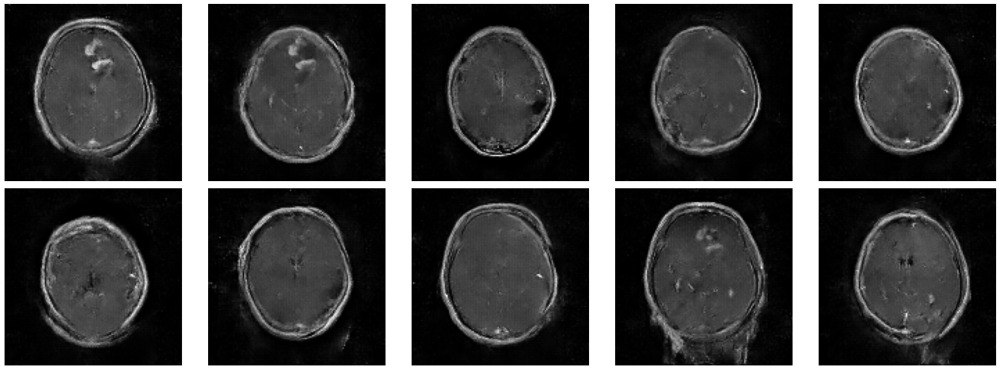

  0%|          | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 1/3750 [00:00<11:10,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 2/3750 [00:00<11:48,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 3/3750 [00:00<11:09,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 4/3750 [00:00<10:27,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 5/3750 [00:00<10:57,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 6/3750 [00:01<10:09,  6.14it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 7/3750 [00:01<09:58,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 8/3750 [00:01<09:33,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 9/3750 [00:01<09:11,  6.78it/s]

1/1 [==============================] - 0s 33ms/step


  0%|          | 10/3750 [00:01<09:27,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 11/3750 [00:01<09:33,  6.51it/s]

1/1 [==============================] - 0s 37ms/step


  0%|          | 12/3750 [00:01<09:47,  6.37it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 13/3750 [00:02<09:58,  6.24it/s]

1/1 [==============================] - 0s 29ms/step


  0%|          | 14/3750 [00:02<09:42,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 15/3750 [00:02<09:19,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 16/3750 [00:02<09:04,  6.85it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 17/3750 [00:02<09:13,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 18/3750 [00:02<09:06,  6.83it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 19/3750 [00:02<09:01,  6.89it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 20/3750 [00:03<08:44,  7.12it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 21/3750 [00:03<08:37,  7.20it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 22/3750 [00:03<08:56,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 23/3750 [00:03<08:42,  7.14it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 24/3750 [00:03<08:27,  7.35it/s]

1/1 [==============================] - 0s 33ms/step


  1%|          | 25/3750 [00:03<08:29,  7.31it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 26/3750 [00:03<08:31,  7.28it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 27/3750 [00:04<08:43,  7.12it/s]

1/1 [==============================] - 0s 37ms/step


  1%|          | 28/3750 [00:04<09:24,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 29/3750 [00:04<09:06,  6.81it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 30/3750 [00:04<09:07,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 31/3750 [00:04<09:22,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 32/3750 [00:04<09:08,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 33/3750 [00:04<09:07,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 34/3750 [00:05<09:07,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 35/3750 [00:05<09:35,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 36/3750 [00:05<09:46,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 37/3750 [00:05<09:26,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 38/3750 [00:05<09:11,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 39/3750 [00:05<09:14,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 40/3750 [00:06<10:09,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 41/3750 [00:06<09:55,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 42/3750 [00:06<10:18,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 43/3750 [00:06<10:14,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 44/3750 [00:06<09:54,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 45/3750 [00:06<10:15,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 46/3750 [00:07<09:56,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 47/3750 [00:07<09:45,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 48/3750 [00:07<09:32,  6.46it/s]

1/1 [==============================] - 0s 30ms/step


  1%|▏         | 49/3750 [00:07<09:14,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 50/3750 [00:07<09:02,  6.82it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 51/3750 [00:07<09:15,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 52/3750 [00:07<09:13,  6.68it/s]

1/1 [==============================] - 0s 32ms/step


  1%|▏         | 53/3750 [00:08<10:05,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 54/3750 [00:08<10:31,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 55/3750 [00:08<10:01,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 56/3750 [00:08<09:39,  6.37it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 57/3750 [00:08<09:38,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 58/3750 [00:08<10:05,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 59/3750 [00:09<09:48,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 60/3750 [00:09<09:39,  6.37it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 61/3750 [00:09<09:25,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 62/3750 [00:09<09:25,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 63/3750 [00:09<09:34,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 64/3750 [00:09<09:07,  6.73it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 65/3750 [00:09<08:59,  6.83it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 66/3750 [00:10<09:51,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 67/3750 [00:10<09:46,  6.28it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 68/3750 [00:10<09:29,  6.47it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 69/3750 [00:10<10:37,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 70/3750 [00:10<10:04,  6.09it/s]

1/1 [==============================] - 0s 33ms/step


  2%|▏         | 71/3750 [00:11<10:33,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 72/3750 [00:11<10:05,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 73/3750 [00:11<09:58,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 74/3750 [00:11<10:14,  5.98it/s]

1/1 [==============================] - 0s 41ms/step


  2%|▏         | 75/3750 [00:11<11:27,  5.34it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 76/3750 [00:11<10:52,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 77/3750 [00:12<10:48,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 78/3750 [00:12<10:21,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 79/3750 [00:12<10:00,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 80/3750 [00:12<09:34,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 81/3750 [00:12<09:28,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 82/3750 [00:12<09:41,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 83/3750 [00:12<09:21,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 84/3750 [00:13<09:16,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 85/3750 [00:13<09:17,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 86/3750 [00:13<09:29,  6.43it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 87/3750 [00:13<10:18,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 88/3750 [00:13<10:51,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 89/3750 [00:14<11:03,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 90/3750 [00:14<11:09,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 91/3750 [00:14<10:23,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 92/3750 [00:14<10:26,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 93/3750 [00:14<10:21,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 94/3750 [00:14<10:02,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 95/3750 [00:14<09:46,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 96/3750 [00:15<09:44,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 97/3750 [00:15<09:44,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 98/3750 [00:15<09:26,  6.45it/s]

1/1 [==============================] - 0s 34ms/step


  3%|▎         | 99/3750 [00:15<10:05,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 100/3750 [00:15<09:35,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 101/3750 [00:15<10:06,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 102/3750 [00:16<09:53,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 103/3750 [00:16<09:53,  6.15it/s]

1/1 [==============================] - 0s 33ms/step


  3%|▎         | 104/3750 [00:16<09:47,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 105/3750 [00:16<10:03,  6.04it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 106/3750 [00:16<10:35,  5.74it/s]

1/1 [==============================] - 0s 38ms/step


  3%|▎         | 107/3750 [00:16<10:21,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 108/3750 [00:17<09:42,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 109/3750 [00:17<09:42,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 110/3750 [00:17<09:38,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 111/3750 [00:17<10:12,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 112/3750 [00:17<11:06,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 113/3750 [00:17<10:37,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 114/3750 [00:18<10:02,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 115/3750 [00:18<10:13,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 116/3750 [00:18<10:05,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 117/3750 [00:18<09:41,  6.25it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 118/3750 [00:18<09:32,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 119/3750 [00:18<09:22,  6.45it/s]

1/1 [==============================] - 0s 33ms/step


  3%|▎         | 120/3750 [00:19<09:56,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 121/3750 [00:19<09:26,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 122/3750 [00:19<09:13,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 123/3750 [00:19<09:24,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 124/3750 [00:19<09:34,  6.31it/s]

1/1 [==============================] - 0s 44ms/step


  3%|▎         | 125/3750 [00:19<09:51,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 126/3750 [00:20<09:32,  6.33it/s]

1/1 [==============================] - 0s 65ms/step


  3%|▎         | 127/3750 [00:20<10:36,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 128/3750 [00:20<10:30,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 129/3750 [00:20<10:11,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 130/3750 [00:20<09:50,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 131/3750 [00:20<09:36,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 132/3750 [00:21<09:36,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 133/3750 [00:21<09:35,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 134/3750 [00:21<09:23,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 135/3750 [00:21<08:59,  6.70it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▎         | 136/3750 [00:21<09:29,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 137/3750 [00:21<09:15,  6.51it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▎         | 138/3750 [00:21<09:41,  6.22it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▎         | 139/3750 [00:22<09:29,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 140/3750 [00:22<09:10,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 141/3750 [00:22<09:30,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 142/3750 [00:22<09:17,  6.47it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▍         | 143/3750 [00:22<09:21,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 144/3750 [00:22<09:07,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 145/3750 [00:23<09:00,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 146/3750 [00:23<08:46,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 147/3750 [00:23<08:32,  7.03it/s]

1/1 [==============================] - 0s 35ms/step


  4%|▍         | 148/3750 [00:23<09:19,  6.43it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▍         | 149/3750 [00:23<09:00,  6.66it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▍         | 150/3750 [00:23<09:35,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 151/3750 [00:23<09:20,  6.42it/s]

1/1 [==============================] - 0s 33ms/step


  4%|▍         | 152/3750 [00:24<09:11,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 153/3750 [00:24<09:02,  6.64it/s]

1/1 [==============================] - 0s 32ms/step


  4%|▍         | 154/3750 [00:24<09:12,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 155/3750 [00:24<09:50,  6.09it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 156/3750 [00:24<10:09,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 157/3750 [00:24<10:30,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 158/3750 [00:25<10:23,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 159/3750 [00:25<09:50,  6.08it/s]

1/1 [==============================] - 0s 43ms/step


  4%|▍         | 160/3750 [00:25<10:02,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 161/3750 [00:25<10:35,  5.65it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 162/3750 [00:25<10:22,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 163/3750 [00:25<09:50,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 164/3750 [00:26<09:48,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 165/3750 [00:26<10:00,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 166/3750 [00:26<09:47,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 167/3750 [00:26<09:48,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 168/3750 [00:26<09:57,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 169/3750 [00:26<09:32,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 170/3750 [00:27<09:18,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 171/3750 [00:27<09:31,  6.27it/s]

1/1 [==============================] - 0s 42ms/step


  5%|▍         | 172/3750 [00:27<09:31,  6.26it/s]

1/1 [==============================] - 0s 53ms/step


  5%|▍         | 173/3750 [00:27<10:52,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 174/3750 [00:27<10:17,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 175/3750 [00:27<09:41,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 176/3750 [00:28<09:14,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 177/3750 [00:28<09:07,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 178/3750 [00:28<09:09,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 179/3750 [00:28<09:05,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 180/3750 [00:28<09:10,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 181/3750 [00:28<09:32,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 182/3750 [00:29<09:12,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 183/3750 [00:29<09:04,  6.55it/s]

1/1 [==============================] - 0s 30ms/step


  5%|▍         | 184/3750 [00:29<09:53,  6.01it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▍         | 185/3750 [00:29<09:25,  6.30it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▍         | 186/3750 [00:29<09:22,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 187/3750 [00:29<09:14,  6.42it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▌         | 188/3750 [00:29<09:09,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 189/3750 [00:30<09:18,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 190/3750 [00:30<09:04,  6.54it/s]

1/1 [==============================] - 0s 37ms/step


  5%|▌         | 191/3750 [00:30<09:14,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 192/3750 [00:30<09:38,  6.15it/s]

1/1 [==============================] - 0s 35ms/step


  5%|▌         | 193/3750 [00:30<09:29,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 194/3750 [00:30<09:22,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 195/3750 [00:31<08:56,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 196/3750 [00:31<08:55,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 197/3750 [00:31<08:49,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 198/3750 [00:31<09:39,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 199/3750 [00:31<09:26,  6.27it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▌         | 200/3750 [00:31<09:38,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 201/3750 [00:32<09:48,  6.03it/s]

1/1 [==============================] - 0s 50ms/step


  5%|▌         | 202/3750 [00:32<10:03,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▌         | 203/3750 [00:32<09:36,  6.15it/s]

1/1 [==============================] - 0s 45ms/step


  5%|▌         | 204/3750 [00:32<09:46,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 205/3750 [00:32<09:14,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 206/3750 [00:32<09:23,  6.28it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▌         | 207/3750 [00:32<09:27,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 208/3750 [00:33<08:56,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 209/3750 [00:33<08:41,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 210/3750 [00:33<08:15,  7.15it/s]

1/1 [==============================] - 0s 35ms/step


  6%|▌         | 211/3750 [00:33<08:26,  6.98it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 212/3750 [00:33<08:39,  6.81it/s]

1/1 [==============================] - 0s 29ms/step


  6%|▌         | 213/3750 [00:33<09:13,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 214/3750 [00:34<09:12,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 215/3750 [00:34<08:57,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 216/3750 [00:34<08:36,  6.84it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▌         | 217/3750 [00:34<08:39,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 218/3750 [00:34<08:47,  6.70it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 219/3750 [00:34<08:51,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 220/3750 [00:34<08:28,  6.94it/s]

1/1 [==============================] - 0s 43ms/step


  6%|▌         | 221/3750 [00:35<09:39,  6.09it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 222/3750 [00:35<09:23,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 223/3750 [00:35<09:09,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 224/3750 [00:35<08:41,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 225/3750 [00:35<09:05,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 226/3750 [00:35<08:49,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 227/3750 [00:35<08:52,  6.62it/s]

1/1 [==============================] - 0s 33ms/step


  6%|▌         | 228/3750 [00:36<08:52,  6.61it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 229/3750 [00:36<09:06,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 230/3750 [00:36<08:47,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 231/3750 [00:36<08:25,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 232/3750 [00:36<08:14,  7.12it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▌         | 233/3750 [00:36<08:20,  7.03it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 234/3750 [00:36<08:17,  7.07it/s]

1/1 [==============================] - 0s 43ms/step


  6%|▋         | 235/3750 [00:37<08:56,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▋         | 236/3750 [00:37<08:51,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▋         | 237/3750 [00:37<08:52,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 238/3750 [00:37<08:48,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▋         | 239/3750 [00:37<08:36,  6.80it/s]

1/1 [==============================] - 0s 29ms/step


  6%|▋         | 240/3750 [00:37<08:31,  6.87it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 241/3750 [00:38<08:13,  7.11it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 242/3750 [00:38<08:02,  7.28it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▋         | 243/3750 [00:38<08:05,  7.22it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 244/3750 [00:38<08:13,  7.11it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 245/3750 [00:38<08:13,  7.11it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 246/3750 [00:38<08:12,  7.12it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 247/3750 [00:38<08:14,  7.08it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 248/3750 [00:39<08:11,  7.12it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 249/3750 [00:39<08:22,  6.96it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 250/3750 [00:39<08:22,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 251/3750 [00:39<08:24,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 252/3750 [00:39<08:15,  7.05it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 253/3750 [00:39<08:13,  7.09it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 254/3750 [00:39<08:37,  6.76it/s]

1/1 [==============================] - 0s 50ms/step


  7%|▋         | 255/3750 [00:40<09:46,  5.95it/s]

1/1 [==============================] - 0s 31ms/step


  7%|▋         | 256/3750 [00:40<09:22,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 257/3750 [00:40<09:01,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 258/3750 [00:40<08:49,  6.60it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 259/3750 [00:40<08:50,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 260/3750 [00:40<08:35,  6.77it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 261/3750 [00:40<08:46,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 262/3750 [00:41<08:51,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 263/3750 [00:41<08:44,  6.64it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 264/3750 [00:41<08:56,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 265/3750 [00:41<08:48,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 266/3750 [00:41<09:00,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 267/3750 [00:41<08:33,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 268/3750 [00:42<08:18,  6.99it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 269/3750 [00:42<08:05,  7.18it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 270/3750 [00:42<08:09,  7.11it/s]

1/1 [==============================] - 0s 31ms/step


  7%|▋         | 271/3750 [00:42<08:45,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 272/3750 [00:42<08:42,  6.66it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 273/3750 [00:42<08:44,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 274/3750 [00:42<08:53,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 275/3750 [00:43<08:35,  6.73it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 276/3750 [00:43<08:31,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 277/3750 [00:43<08:20,  6.93it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 278/3750 [00:43<08:18,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 279/3750 [00:43<08:14,  7.02it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 280/3750 [00:43<07:59,  7.24it/s]

1/1 [==============================] - 0s 38ms/step


  7%|▋         | 281/3750 [00:43<08:27,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 282/3750 [00:44<08:22,  6.90it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 283/3750 [00:44<08:24,  6.87it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 284/3750 [00:44<08:23,  6.89it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 285/3750 [00:44<08:09,  7.07it/s]

1/1 [==============================] - 0s 50ms/step


  8%|▊         | 286/3750 [00:44<09:33,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 287/3750 [00:44<09:40,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 288/3750 [00:45<09:23,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 289/3750 [00:45<09:06,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 290/3750 [00:45<08:59,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 291/3750 [00:45<08:40,  6.65it/s]

1/1 [==============================] - 0s 46ms/step


  8%|▊         | 292/3750 [00:45<09:27,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 293/3750 [00:45<09:26,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 294/3750 [00:45<09:13,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 295/3750 [00:46<09:06,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 296/3750 [00:46<09:14,  6.23it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 297/3750 [00:46<09:09,  6.29it/s]

1/1 [==============================] - 0s 36ms/step


  8%|▊         | 298/3750 [00:46<09:29,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 299/3750 [00:46<09:49,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 300/3750 [00:46<09:21,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 301/3750 [00:47<09:31,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 302/3750 [00:47<09:16,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 303/3750 [00:47<08:58,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 304/3750 [00:47<08:48,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 305/3750 [00:47<09:03,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 306/3750 [00:47<08:54,  6.45it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 307/3750 [00:48<08:51,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 308/3750 [00:48<08:45,  6.55it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 309/3750 [00:48<08:26,  6.79it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 310/3750 [00:48<08:20,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 311/3750 [00:48<08:15,  6.94it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 312/3750 [00:48<08:18,  6.89it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 313/3750 [00:48<08:23,  6.82it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 314/3750 [00:49<08:14,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 315/3750 [00:49<08:19,  6.87it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 316/3750 [00:49<08:29,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 317/3750 [00:49<08:29,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 318/3750 [00:49<08:24,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 319/3750 [00:49<08:16,  6.92it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▊         | 320/3750 [00:49<09:12,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 321/3750 [00:50<09:26,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 322/3750 [00:50<08:57,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 323/3750 [00:50<09:01,  6.33it/s]

1/1 [==============================] - 0s 35ms/step


  9%|▊         | 324/3750 [00:50<09:11,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 325/3750 [00:50<09:07,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 326/3750 [00:50<09:02,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 327/3750 [00:51<08:28,  6.73it/s]

1/1 [==============================] - 0s 33ms/step


  9%|▊         | 328/3750 [00:51<09:23,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 329/3750 [00:51<09:14,  6.17it/s]

1/1 [==============================] - 0s 47ms/step


  9%|▉         | 330/3750 [00:51<09:21,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 331/3750 [00:51<08:52,  6.42it/s]

1/1 [==============================] - 0s 45ms/step


  9%|▉         | 332/3750 [00:51<09:39,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 333/3750 [00:52<09:10,  6.20it/s]

1/1 [==============================] - 0s 37ms/step


  9%|▉         | 334/3750 [00:52<09:17,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 335/3750 [00:52<08:39,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 336/3750 [00:52<08:33,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 337/3750 [00:52<08:22,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 338/3750 [00:52<08:19,  6.83it/s]

1/1 [==============================] - 0s 50ms/step


  9%|▉         | 339/3750 [00:52<08:46,  6.48it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 340/3750 [00:53<08:43,  6.51it/s]

1/1 [==============================] - 0s 40ms/step


  9%|▉         | 341/3750 [00:53<08:58,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 342/3750 [00:53<08:54,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 343/3750 [00:53<08:51,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 344/3750 [00:53<08:39,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 345/3750 [00:53<08:25,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 346/3750 [00:54<08:23,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 347/3750 [00:54<08:25,  6.74it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 348/3750 [00:54<08:59,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 349/3750 [00:54<08:42,  6.50it/s]

1/1 [==============================] - 0s 35ms/step


  9%|▉         | 350/3750 [00:54<08:42,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 351/3750 [00:54<08:22,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 352/3750 [00:54<08:48,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 353/3750 [00:55<08:16,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 354/3750 [00:55<08:06,  6.98it/s]

1/1 [==============================] - 0s 33ms/step


  9%|▉         | 355/3750 [00:55<08:30,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 356/3750 [00:55<08:23,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 357/3750 [00:55<08:52,  6.37it/s]

1/1 [==============================] - 0s 28ms/step


 10%|▉         | 358/3750 [00:55<08:52,  6.37it/s]

1/1 [==============================] - 0s 29ms/step


 10%|▉         | 359/3750 [00:56<08:40,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 360/3750 [00:56<08:33,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 361/3750 [00:56<08:13,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 362/3750 [00:56<08:48,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 363/3750 [00:56<08:33,  6.59it/s]

1/1 [==============================] - 0s 35ms/step


 10%|▉         | 364/3750 [00:56<08:34,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 365/3750 [00:56<08:26,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 366/3750 [00:57<08:14,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 367/3750 [00:57<08:18,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 368/3750 [00:57<08:22,  6.73it/s]

1/1 [==============================] - 0s 36ms/step


 10%|▉         | 369/3750 [00:57<08:35,  6.56it/s]

1/1 [==============================] - 0s 27ms/step


 10%|▉         | 370/3750 [00:57<08:38,  6.52it/s]

1/1 [==============================] - 0s 32ms/step


 10%|▉         | 371/3750 [00:57<08:40,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 372/3750 [00:57<09:11,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 373/3750 [00:58<08:47,  6.40it/s]

1/1 [==============================] - 0s 45ms/step


 10%|▉         | 374/3750 [00:58<09:12,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 375/3750 [00:58<09:33,  5.88it/s]

1/1 [==============================] - 0s 37ms/step


 10%|█         | 376/3750 [00:58<09:34,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 377/3750 [00:58<09:35,  5.86it/s]

1/1 [==============================] - 0s 46ms/step


 10%|█         | 378/3750 [00:59<09:31,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 379/3750 [00:59<09:49,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 380/3750 [00:59<09:32,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 381/3750 [00:59<09:41,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 382/3750 [00:59<09:22,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 383/3750 [00:59<09:21,  6.00it/s]

1/1 [==============================] - 0s 48ms/step


 10%|█         | 384/3750 [01:00<10:00,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 385/3750 [01:00<09:16,  6.05it/s]

1/1 [==============================] - 0s 27ms/step


 10%|█         | 386/3750 [01:00<09:05,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 387/3750 [01:00<08:49,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 388/3750 [01:00<08:55,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 389/3750 [01:00<08:43,  6.42it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 390/3750 [01:00<08:30,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 391/3750 [01:01<08:35,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 392/3750 [01:01<08:23,  6.67it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 393/3750 [01:01<08:09,  6.86it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 394/3750 [01:01<08:56,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 395/3750 [01:01<08:45,  6.38it/s]

1/1 [==============================] - 0s 33ms/step


 11%|█         | 396/3750 [01:01<09:27,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 397/3750 [01:02<09:11,  6.08it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 398/3750 [01:02<08:45,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 399/3750 [01:02<08:27,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 400/3750 [01:02<09:00,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 401/3750 [01:02<08:44,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 402/3750 [01:02<09:23,  5.94it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 403/3750 [01:03<09:10,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 404/3750 [01:03<08:40,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 405/3750 [01:03<08:10,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 406/3750 [01:03<08:24,  6.63it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 407/3750 [01:03<09:18,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 408/3750 [01:03<09:09,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 409/3750 [01:03<09:00,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 410/3750 [01:04<08:48,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 411/3750 [01:04<08:30,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 412/3750 [01:04<08:11,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 413/3750 [01:04<08:01,  6.92it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 414/3750 [01:04<07:52,  7.06it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 415/3750 [01:04<07:39,  7.26it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 416/3750 [01:04<07:45,  7.16it/s]

1/1 [==============================] - 0s 35ms/step


 11%|█         | 417/3750 [01:05<09:18,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 418/3750 [01:05<08:55,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 419/3750 [01:05<08:53,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 420/3750 [01:05<08:24,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 421/3750 [01:05<08:56,  6.21it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█▏        | 422/3750 [01:05<08:28,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 423/3750 [01:06<08:09,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 424/3750 [01:06<08:10,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 425/3750 [01:06<07:45,  7.14it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 426/3750 [01:06<08:14,  6.72it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 427/3750 [01:06<07:58,  6.94it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 428/3750 [01:06<08:06,  6.83it/s]

1/1 [==============================] - 0s 36ms/step


 11%|█▏        | 429/3750 [01:06<08:43,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 430/3750 [01:07<09:00,  6.14it/s]

1/1 [==============================] - 0s 53ms/step


 11%|█▏        | 431/3750 [01:07<09:50,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 432/3750 [01:07<09:15,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 433/3750 [01:07<09:10,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 434/3750 [01:07<08:39,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 435/3750 [01:07<08:08,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 436/3750 [01:08<08:08,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 437/3750 [01:08<08:40,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 438/3750 [01:08<08:16,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 439/3750 [01:08<08:54,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 440/3750 [01:08<09:18,  5.93it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 441/3750 [01:08<09:03,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 442/3750 [01:09<08:41,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 443/3750 [01:09<08:59,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 444/3750 [01:09<08:44,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 445/3750 [01:09<08:33,  6.44it/s]

1/1 [==============================] - 0s 37ms/step


 12%|█▏        | 446/3750 [01:09<08:32,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 447/3750 [01:09<08:09,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 448/3750 [01:09<08:03,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 449/3750 [01:10<08:04,  6.81it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 450/3750 [01:10<08:09,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 451/3750 [01:10<08:13,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 452/3750 [01:10<07:55,  6.94it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 453/3750 [01:10<07:53,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 454/3750 [01:10<07:57,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 455/3750 [01:10<07:47,  7.04it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 456/3750 [01:11<07:45,  7.07it/s]

1/1 [==============================] - 0s 54ms/step


 12%|█▏        | 457/3750 [01:11<08:20,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 458/3750 [01:11<08:07,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 459/3750 [01:11<08:08,  6.74it/s]

1/1 [==============================] - 0s 45ms/step


 12%|█▏        | 460/3750 [01:11<08:40,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 461/3750 [01:11<08:14,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 462/3750 [01:12<08:12,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 463/3750 [01:12<07:59,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 464/3750 [01:12<08:24,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 465/3750 [01:12<08:20,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 466/3750 [01:12<08:31,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 467/3750 [01:12<08:32,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 468/3750 [01:12<08:13,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 469/3750 [01:13<08:54,  6.14it/s]

1/1 [==============================] - 0s 35ms/step


 13%|█▎        | 470/3750 [01:13<09:06,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 471/3750 [01:13<08:34,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 472/3750 [01:13<08:30,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 473/3750 [01:13<08:27,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 474/3750 [01:13<08:18,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 475/3750 [01:14<08:05,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 476/3750 [01:14<08:01,  6.79it/s]

1/1 [==============================] - 0s 34ms/step


 13%|█▎        | 477/3750 [01:14<08:09,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 478/3750 [01:14<07:54,  6.89it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 479/3750 [01:14<07:48,  6.98it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 480/3750 [01:14<07:52,  6.92it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 481/3750 [01:14<07:43,  7.05it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 482/3750 [01:15<07:56,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 483/3750 [01:15<07:49,  6.96it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 484/3750 [01:15<07:33,  7.20it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 485/3750 [01:15<07:59,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 486/3750 [01:15<07:47,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 487/3750 [01:15<07:46,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 488/3750 [01:15<07:49,  6.95it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 489/3750 [01:16<07:40,  7.08it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 490/3750 [01:16<07:44,  7.02it/s]

1/1 [==============================] - 0s 46ms/step


 13%|█▎        | 491/3750 [01:16<08:47,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 492/3750 [01:16<08:30,  6.38it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 493/3750 [01:16<08:18,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 494/3750 [01:16<08:07,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 495/3750 [01:16<08:06,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 496/3750 [01:17<08:10,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 497/3750 [01:17<07:57,  6.81it/s]

1/1 [==============================] - 0s 36ms/step


 13%|█▎        | 498/3750 [01:17<08:46,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 499/3750 [01:17<08:31,  6.36it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 500/3750 [01:17<08:58,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 501/3750 [01:17<08:41,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 502/3750 [01:18<08:31,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 503/3750 [01:18<08:18,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 504/3750 [01:18<08:20,  6.48it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 505/3750 [01:18<08:31,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 506/3750 [01:18<08:07,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 507/3750 [01:18<08:01,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 508/3750 [01:19<08:29,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▎        | 509/3750 [01:19<08:19,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 510/3750 [01:19<08:49,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 511/3750 [01:19<08:58,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 512/3750 [01:19<08:33,  6.30it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▎        | 513/3750 [01:19<08:29,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 514/3750 [01:19<08:09,  6.61it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▎        | 515/3750 [01:20<08:12,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 516/3750 [01:20<08:05,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 517/3750 [01:20<08:11,  6.58it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 518/3750 [01:20<08:38,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 519/3750 [01:20<08:20,  6.46it/s]

1/1 [==============================] - 0s 43ms/step


 14%|█▍        | 520/3750 [01:20<09:01,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 521/3750 [01:21<08:34,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 522/3750 [01:21<08:18,  6.48it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 523/3750 [01:21<08:06,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 524/3750 [01:21<08:07,  6.61it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 525/3750 [01:21<08:08,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 526/3750 [01:21<08:07,  6.61it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 527/3750 [01:21<08:07,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 528/3750 [01:22<08:10,  6.57it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 529/3750 [01:22<07:52,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 530/3750 [01:22<07:56,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 531/3750 [01:22<07:39,  7.00it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 532/3750 [01:22<07:32,  7.12it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▍        | 533/3750 [01:22<07:46,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 534/3750 [01:22<07:33,  7.08it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 535/3750 [01:23<08:17,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 536/3750 [01:23<07:53,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 537/3750 [01:23<07:43,  6.93it/s]

1/1 [==============================] - 0s 47ms/step


 14%|█▍        | 538/3750 [01:23<08:31,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 539/3750 [01:23<08:23,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 540/3750 [01:23<08:03,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 541/3750 [01:24<08:04,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 542/3750 [01:24<07:48,  6.85it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 543/3750 [01:24<07:27,  7.17it/s]

1/1 [==============================] - 0s 42ms/step


 15%|█▍        | 544/3750 [01:24<08:00,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 545/3750 [01:24<07:42,  6.92it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 546/3750 [01:24<07:35,  7.04it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 547/3750 [01:24<07:42,  6.93it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 548/3750 [01:25<07:42,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 549/3750 [01:25<07:32,  7.07it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▍        | 550/3750 [01:25<07:48,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 551/3750 [01:25<07:39,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 552/3750 [01:25<12:43,  4.19it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▍        | 553/3750 [01:26<11:27,  4.65it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 554/3750 [01:26<10:22,  5.14it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 555/3750 [01:26<09:34,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 556/3750 [01:26<09:22,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 557/3750 [01:26<09:05,  5.86it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 558/3750 [01:26<08:41,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 559/3750 [01:26<08:14,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 560/3750 [01:27<08:02,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 561/3750 [01:27<08:02,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 562/3750 [01:27<08:18,  6.40it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▌        | 563/3750 [01:27<08:25,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 564/3750 [01:27<08:09,  6.50it/s]

1/1 [==============================] - 0s 40ms/step


 15%|█▌        | 565/3750 [01:27<08:42,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 566/3750 [01:28<08:10,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 567/3750 [01:28<08:07,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 568/3750 [01:28<08:02,  6.59it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 569/3750 [01:28<07:49,  6.78it/s]

1/1 [==============================] - 0s 47ms/step


 15%|█▌        | 570/3750 [01:28<08:06,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 571/3750 [01:28<08:10,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 572/3750 [01:28<07:47,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 573/3750 [01:29<07:58,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 574/3750 [01:29<07:56,  6.67it/s]

1/1 [==============================] - 0s 34ms/step


 15%|█▌        | 575/3750 [01:29<08:39,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 576/3750 [01:29<08:15,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 577/3750 [01:29<08:10,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 578/3750 [01:29<08:03,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 579/3750 [01:30<08:10,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 580/3750 [01:30<08:02,  6.57it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 581/3750 [01:30<08:44,  6.04it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 582/3750 [01:30<08:49,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 583/3750 [01:30<08:31,  6.19it/s]

1/1 [==============================] - 0s 38ms/step


 16%|█▌        | 584/3750 [01:30<08:33,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 585/3750 [01:31<08:35,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 586/3750 [01:31<08:08,  6.47it/s]

1/1 [==============================] - 0s 47ms/step


 16%|█▌        | 587/3750 [01:31<08:59,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 588/3750 [01:31<08:23,  6.27it/s]

1/1 [==============================] - 0s 46ms/step


 16%|█▌        | 589/3750 [01:31<08:37,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 590/3750 [01:31<08:28,  6.22it/s]

1/1 [==============================] - 0s 35ms/step


 16%|█▌        | 591/3750 [01:32<08:35,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 592/3750 [01:32<08:41,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 593/3750 [01:32<08:23,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 594/3750 [01:32<08:03,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 595/3750 [01:32<07:57,  6.61it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▌        | 596/3750 [01:32<08:37,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 597/3750 [01:32<08:30,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 598/3750 [01:33<08:22,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 599/3750 [01:33<08:04,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 600/3750 [01:33<07:59,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 601/3750 [01:33<08:21,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 602/3750 [01:33<08:00,  6.56it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 603/3750 [01:33<07:56,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 604/3750 [01:34<07:56,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 605/3750 [01:34<07:34,  6.91it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 606/3750 [01:34<07:31,  6.97it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 607/3750 [01:34<07:27,  7.03it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 608/3750 [01:34<08:02,  6.52it/s]

1/1 [==============================] - 0s 39ms/step


 16%|█▌        | 609/3750 [01:34<08:50,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 610/3750 [01:34<08:20,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 611/3750 [01:35<08:15,  6.33it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▋        | 612/3750 [01:35<08:04,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 613/3750 [01:35<07:59,  6.54it/s]

1/1 [==============================] - 0s 32ms/step


 16%|█▋        | 614/3750 [01:35<08:19,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 615/3750 [01:35<08:07,  6.43it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▋        | 616/3750 [01:35<08:26,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 617/3750 [01:36<08:09,  6.40it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▋        | 618/3750 [01:36<07:58,  6.55it/s]

1/1 [==============================] - 0s 37ms/step


 17%|█▋        | 619/3750 [01:36<08:18,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 620/3750 [01:36<08:14,  6.32it/s]

1/1 [==============================] - 0s 56ms/step


 17%|█▋        | 621/3750 [01:36<08:40,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 622/3750 [01:36<08:08,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 623/3750 [01:37<08:13,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 624/3750 [01:37<08:08,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 625/3750 [01:37<08:14,  6.32it/s]

1/1 [==============================] - 0s 49ms/step


 17%|█▋        | 626/3750 [01:37<08:49,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 627/3750 [01:37<08:23,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 628/3750 [01:37<08:16,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 629/3750 [01:37<08:08,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 630/3750 [01:38<08:02,  6.47it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 631/3750 [01:38<08:14,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 632/3750 [01:38<07:53,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 633/3750 [01:38<07:42,  6.74it/s]

1/1 [==============================] - 0s 34ms/step


 17%|█▋        | 634/3750 [01:38<08:28,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 635/3750 [01:38<08:12,  6.33it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 636/3750 [01:39<08:31,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 637/3750 [01:39<08:04,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 638/3750 [01:39<08:31,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 639/3750 [01:39<08:24,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 640/3750 [01:39<08:25,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 641/3750 [01:39<09:13,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 642/3750 [01:40<08:41,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 643/3750 [01:40<08:27,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 644/3750 [01:40<08:14,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 645/3750 [01:40<08:21,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 646/3750 [01:40<08:02,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 647/3750 [01:40<07:48,  6.63it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 648/3750 [01:40<07:55,  6.53it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 649/3750 [01:41<07:58,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 650/3750 [01:41<07:57,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 651/3750 [01:41<08:03,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 652/3750 [01:41<08:02,  6.42it/s]

1/1 [==============================] - 0s 45ms/step


 17%|█▋        | 653/3750 [01:41<08:50,  5.83it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 654/3750 [01:41<08:35,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 655/3750 [01:42<08:21,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 656/3750 [01:42<08:07,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 657/3750 [01:42<08:06,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 658/3750 [01:42<07:38,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 659/3750 [01:42<07:21,  7.00it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 660/3750 [01:42<07:18,  7.05it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 661/3750 [01:42<07:02,  7.32it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 662/3750 [01:43<07:16,  7.08it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 663/3750 [01:43<07:20,  7.00it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 664/3750 [01:43<07:13,  7.11it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 665/3750 [01:43<07:53,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 666/3750 [01:43<07:24,  6.93it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 667/3750 [01:43<07:05,  7.24it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 668/3750 [01:43<07:15,  7.07it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 669/3750 [01:44<07:08,  7.19it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 670/3750 [01:44<07:18,  7.03it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 671/3750 [01:44<07:20,  6.99it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 672/3750 [01:44<07:25,  6.90it/s]

1/1 [==============================] - 0s 46ms/step


 18%|█▊        | 673/3750 [01:44<08:01,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 674/3750 [01:44<07:49,  6.55it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 675/3750 [01:45<08:24,  6.09it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 676/3750 [01:45<08:02,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 677/3750 [01:45<07:44,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 678/3750 [01:45<08:30,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 679/3750 [01:45<08:03,  6.35it/s]

1/1 [==============================] - 0s 32ms/step


 18%|█▊        | 680/3750 [01:45<08:06,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 681/3750 [01:45<07:34,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 682/3750 [01:46<07:29,  6.83it/s]

1/1 [==============================] - 0s 32ms/step


 18%|█▊        | 683/3750 [01:46<07:48,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 684/3750 [01:46<07:40,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 685/3750 [01:46<07:39,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 686/3750 [01:46<07:31,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 687/3750 [01:46<07:35,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 688/3750 [01:47<07:32,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 689/3750 [01:47<07:55,  6.43it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 690/3750 [01:47<07:53,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 691/3750 [01:47<07:47,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 692/3750 [01:47<07:42,  6.61it/s]

1/1 [==============================] - 0s 34ms/step


 18%|█▊        | 693/3750 [01:47<08:16,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 694/3750 [01:47<08:10,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 695/3750 [01:48<07:58,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 696/3750 [01:48<08:27,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 697/3750 [01:48<08:30,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 698/3750 [01:48<08:53,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 699/3750 [01:48<08:20,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 700/3750 [01:48<07:56,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 701/3750 [01:49<08:25,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 702/3750 [01:49<08:21,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 703/3750 [01:49<08:14,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 704/3750 [01:49<08:12,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 705/3750 [01:49<07:52,  6.45it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▉        | 706/3750 [01:49<07:51,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 707/3750 [01:50<07:48,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 708/3750 [01:50<07:45,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 709/3750 [01:50<07:47,  6.50it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 710/3750 [01:50<07:41,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 711/3750 [01:50<07:41,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 712/3750 [01:50<08:03,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 713/3750 [01:51<07:57,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 714/3750 [01:51<08:31,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 715/3750 [01:51<08:15,  6.12it/s]

1/1 [==============================] - 0s 42ms/step


 19%|█▉        | 716/3750 [01:51<08:43,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 717/3750 [01:51<08:27,  5.98it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 718/3750 [01:51<08:38,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 719/3750 [01:52<08:11,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 720/3750 [01:52<07:50,  6.44it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 721/3750 [01:52<08:37,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 722/3750 [01:52<08:17,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 723/3750 [01:52<08:36,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 724/3750 [01:52<08:16,  6.10it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 725/3750 [01:53<08:22,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 726/3750 [01:53<08:08,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 727/3750 [01:53<07:52,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 728/3750 [01:53<07:36,  6.62it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 729/3750 [01:53<07:31,  6.68it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 730/3750 [01:53<07:47,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 731/3750 [01:53<07:43,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 732/3750 [01:54<08:10,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 733/3750 [01:54<07:53,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 734/3750 [01:54<07:59,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 735/3750 [01:54<07:55,  6.34it/s]

1/1 [==============================] - 0s 27ms/step


 20%|█▉        | 736/3750 [01:54<07:47,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 737/3750 [01:54<07:39,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 738/3750 [01:54<07:19,  6.86it/s]

1/1 [==============================] - 0s 29ms/step


 20%|█▉        | 739/3750 [01:55<07:25,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 740/3750 [01:55<07:30,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 741/3750 [01:55<07:29,  6.69it/s]

1/1 [==============================] - 0s 31ms/step


 20%|█▉        | 742/3750 [01:55<07:40,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 743/3750 [01:55<07:36,  6.58it/s]

1/1 [==============================] - 0s 33ms/step


 20%|█▉        | 744/3750 [01:55<07:47,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 745/3750 [01:56<07:28,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 746/3750 [01:56<07:19,  6.84it/s]

1/1 [==============================] - 0s 36ms/step


 20%|█▉        | 747/3750 [01:56<07:32,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 748/3750 [01:56<07:17,  6.87it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 749/3750 [01:56<07:22,  6.79it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 750/3750 [01:56<07:11,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 751/3750 [01:56<07:19,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 752/3750 [01:57<07:20,  6.81it/s]

1/1 [==============================] - 0s 31ms/step


 20%|██        | 753/3750 [01:57<07:29,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 754/3750 [01:57<07:19,  6.82it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 755/3750 [01:57<07:42,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 756/3750 [01:57<07:29,  6.66it/s]

1/1 [==============================] - 0s 51ms/step


 20%|██        | 757/3750 [01:57<08:22,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 758/3750 [01:58<07:43,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 759/3750 [01:58<07:44,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 760/3750 [01:58<07:51,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 761/3750 [01:58<08:12,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 762/3750 [01:58<08:10,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 763/3750 [01:58<07:48,  6.37it/s]

1/1 [==============================] - 0s 35ms/step


 20%|██        | 764/3750 [01:59<08:33,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 765/3750 [01:59<09:01,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 766/3750 [01:59<08:57,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 767/3750 [01:59<08:28,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 768/3750 [01:59<08:25,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 769/3750 [01:59<08:07,  6.12it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 770/3750 [02:00<08:39,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 771/3750 [02:00<08:05,  6.14it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 772/3750 [02:00<07:54,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 773/3750 [02:00<07:35,  6.53it/s]

1/1 [==============================] - 0s 34ms/step


 21%|██        | 774/3750 [02:00<07:40,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 775/3750 [02:00<07:25,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 776/3750 [02:00<07:20,  6.76it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 777/3750 [02:01<07:35,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 778/3750 [02:01<07:28,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 779/3750 [02:01<07:13,  6.85it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 780/3750 [02:01<07:53,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 781/3750 [02:01<07:40,  6.45it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 782/3750 [02:01<07:38,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 783/3750 [02:02<07:43,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 784/3750 [02:02<07:39,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 785/3750 [02:02<07:35,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 786/3750 [02:02<07:25,  6.66it/s]

1/1 [==============================] - 0s 35ms/step


 21%|██        | 787/3750 [02:02<07:28,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 788/3750 [02:02<07:22,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 789/3750 [02:02<07:02,  7.01it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 790/3750 [02:03<07:50,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 791/3750 [02:03<07:48,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 792/3750 [02:03<07:22,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 793/3750 [02:03<07:13,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 794/3750 [02:03<07:06,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 795/3750 [02:03<07:45,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 796/3750 [02:04<07:37,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 797/3750 [02:04<07:29,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 798/3750 [02:04<07:15,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 799/3750 [02:04<07:23,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 800/3750 [02:04<07:19,  6.71it/s]

1/1 [==============================] - 0s 31ms/step


 21%|██▏       | 801/3750 [02:04<07:06,  6.91it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 802/3750 [02:04<06:59,  7.03it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 803/3750 [02:05<06:58,  7.05it/s]

1/1 [==============================] - 0s 36ms/step


 21%|██▏       | 804/3750 [02:05<07:16,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 805/3750 [02:05<07:11,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 806/3750 [02:05<07:20,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 807/3750 [02:05<07:11,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 808/3750 [02:05<07:07,  6.89it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 809/3750 [02:05<06:54,  7.09it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 810/3750 [02:06<07:28,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 811/3750 [02:06<07:29,  6.54it/s]

1/1 [==============================] - 0s 33ms/step


 22%|██▏       | 812/3750 [02:06<08:02,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 813/3750 [02:06<07:51,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 814/3750 [02:06<07:39,  6.39it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 815/3750 [02:06<07:40,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 816/3750 [02:07<07:39,  6.38it/s]

1/1 [==============================] - 0s 41ms/step


 22%|██▏       | 817/3750 [02:07<07:52,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 818/3750 [02:07<07:31,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 819/3750 [02:07<07:38,  6.39it/s]

1/1 [==============================] - 0s 32ms/step


 22%|██▏       | 820/3750 [02:07<07:28,  6.54it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 821/3750 [02:07<07:15,  6.73it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 822/3750 [02:07<07:48,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 823/3750 [02:08<07:27,  6.55it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 824/3750 [02:08<07:56,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 825/3750 [02:08<07:37,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 826/3750 [02:08<07:15,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 827/3750 [02:08<07:15,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 828/3750 [02:08<07:11,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 829/3750 [02:08<07:00,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 830/3750 [02:09<07:03,  6.90it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 831/3750 [02:09<07:31,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 832/3750 [02:09<07:10,  6.78it/s]

1/1 [==============================] - 0s 52ms/step


 22%|██▏       | 833/3750 [02:09<07:47,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 834/3750 [02:09<07:48,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 835/3750 [02:09<08:04,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 836/3750 [02:10<07:57,  6.10it/s]

1/1 [==============================] - 0s 41ms/step


 22%|██▏       | 837/3750 [02:10<07:58,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 838/3750 [02:10<07:41,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 839/3750 [02:10<07:50,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 840/3750 [02:10<08:15,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 841/3750 [02:10<07:49,  6.20it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 842/3750 [02:11<08:00,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 843/3750 [02:11<07:46,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 844/3750 [02:11<07:43,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 845/3750 [02:11<08:05,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 846/3750 [02:11<08:06,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 847/3750 [02:11<07:41,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 848/3750 [02:12<08:01,  6.02it/s]

1/1 [==============================] - 0s 38ms/step


 23%|██▎       | 849/3750 [02:12<07:52,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 850/3750 [02:12<07:30,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 851/3750 [02:12<07:19,  6.60it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 852/3750 [02:12<07:28,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 853/3750 [02:12<07:15,  6.65it/s]

1/1 [==============================] - 0s 51ms/step


 23%|██▎       | 854/3750 [02:13<07:59,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 855/3750 [02:13<07:33,  6.38it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 856/3750 [02:13<07:27,  6.47it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 857/3750 [02:13<07:25,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 858/3750 [02:13<07:08,  6.75it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 859/3750 [02:13<07:24,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 860/3750 [02:13<07:22,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 861/3750 [02:14<07:18,  6.59it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 862/3750 [02:14<07:10,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 863/3750 [02:14<07:04,  6.81it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 864/3750 [02:14<07:10,  6.70it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 865/3750 [02:14<07:24,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 866/3750 [02:14<07:42,  6.23it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 867/3750 [02:15<07:57,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 868/3750 [02:15<07:50,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 869/3750 [02:15<08:02,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 870/3750 [02:15<08:12,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 871/3750 [02:15<07:51,  6.11it/s]

1/1 [==============================] - 0s 39ms/step


 23%|██▎       | 872/3750 [02:15<07:57,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 873/3750 [02:16<07:44,  6.19it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 874/3750 [02:16<07:40,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 875/3750 [02:16<07:28,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 876/3750 [02:16<07:25,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 877/3750 [02:16<07:22,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 878/3750 [02:16<07:21,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 879/3750 [02:16<07:20,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 880/3750 [02:17<07:03,  6.78it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 881/3750 [02:17<07:11,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 882/3750 [02:17<06:52,  6.96it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▎       | 883/3750 [02:17<06:45,  7.08it/s]

1/1 [==============================] - 0s 36ms/step


 24%|██▎       | 884/3750 [02:17<07:10,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 885/3750 [02:17<07:39,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 886/3750 [02:17<07:36,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 887/3750 [02:18<07:28,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 888/3750 [02:18<07:09,  6.67it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▎       | 889/3750 [02:18<07:10,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 890/3750 [02:18<07:09,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 891/3750 [02:18<06:55,  6.88it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 892/3750 [02:18<07:18,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 893/3750 [02:19<07:21,  6.48it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 894/3750 [02:19<07:35,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 895/3750 [02:19<07:16,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 896/3750 [02:19<07:44,  6.15it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 897/3750 [02:19<08:13,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 898/3750 [02:19<08:11,  5.80it/s]

1/1 [==============================] - 0s 34ms/step


 24%|██▍       | 899/3750 [02:20<08:22,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 900/3750 [02:20<07:55,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 901/3750 [02:20<07:30,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 902/3750 [02:20<07:29,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 903/3750 [02:20<07:48,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 904/3750 [02:20<07:30,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 905/3750 [02:21<07:22,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 906/3750 [02:21<07:21,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 907/3750 [02:21<07:48,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 908/3750 [02:21<07:36,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 909/3750 [02:21<07:29,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 910/3750 [02:21<07:55,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 911/3750 [02:22<08:21,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 912/3750 [02:22<07:48,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 913/3750 [02:22<08:01,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 914/3750 [02:22<08:17,  5.70it/s]

1/1 [==============================] - 0s 39ms/step


 24%|██▍       | 915/3750 [02:22<08:10,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 916/3750 [02:22<07:43,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 917/3750 [02:23<07:48,  6.05it/s]

1/1 [==============================] - 0s 36ms/step


 24%|██▍       | 918/3750 [02:23<07:39,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 919/3750 [02:23<07:16,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 920/3750 [02:23<07:39,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 921/3750 [02:23<07:17,  6.47it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▍       | 922/3750 [02:23<07:13,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 923/3750 [02:23<07:26,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 924/3750 [02:24<07:06,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 925/3750 [02:24<07:00,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 926/3750 [02:24<07:19,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 927/3750 [02:24<07:13,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 928/3750 [02:24<07:19,  6.43it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 929/3750 [02:24<07:54,  5.95it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▍       | 930/3750 [02:25<07:40,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 931/3750 [02:25<07:59,  5.88it/s]

1/1 [==============================] - 0s 33ms/step


 25%|██▍       | 932/3750 [02:25<07:48,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 933/3750 [02:25<08:05,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 934/3750 [02:25<08:24,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 935/3750 [02:25<08:02,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 936/3750 [02:26<07:40,  6.11it/s]

1/1 [==============================] - 0s 35ms/step


 25%|██▍       | 937/3750 [02:26<08:05,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 938/3750 [02:26<07:46,  6.02it/s]

1/1 [==============================] - 0s 51ms/step


 25%|██▌       | 939/3750 [02:26<08:31,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 940/3750 [02:26<08:03,  5.81it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▌       | 941/3750 [02:26<07:59,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 942/3750 [02:27<07:41,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 943/3750 [02:27<07:21,  6.35it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▌       | 944/3750 [02:27<07:44,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 945/3750 [02:27<08:19,  5.61it/s]

1/1 [==============================] - 0s 49ms/step


 25%|██▌       | 946/3750 [02:27<08:14,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 947/3750 [02:27<07:51,  5.95it/s]

1/1 [==============================] - 0s 35ms/step


 25%|██▌       | 948/3750 [02:28<07:40,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 949/3750 [02:28<07:27,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 950/3750 [02:28<07:18,  6.38it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▌       | 951/3750 [02:28<07:55,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 952/3750 [02:28<07:30,  6.21it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▌       | 953/3750 [02:28<07:54,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 954/3750 [02:29<07:34,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 955/3750 [02:29<07:11,  6.47it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▌       | 956/3750 [02:29<07:14,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 957/3750 [02:29<06:58,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 958/3750 [02:29<07:23,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 959/3750 [02:29<07:09,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 960/3750 [02:29<07:03,  6.59it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▌       | 961/3750 [02:30<07:08,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 962/3750 [02:30<06:54,  6.72it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 963/3750 [02:30<07:05,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 964/3750 [02:30<06:48,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 965/3750 [02:30<06:47,  6.83it/s]

1/1 [==============================] - 0s 35ms/step


 26%|██▌       | 966/3750 [02:30<06:52,  6.75it/s]

1/1 [==============================] - 0s 33ms/step


 26%|██▌       | 967/3750 [02:31<06:44,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 968/3750 [02:31<07:02,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 969/3750 [02:31<06:52,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 970/3750 [02:31<06:36,  7.02it/s]

1/1 [==============================] - 0s 33ms/step


 26%|██▌       | 971/3750 [02:31<06:50,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 972/3750 [02:31<06:46,  6.84it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 973/3750 [02:31<06:55,  6.68it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 974/3750 [02:32<07:12,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 975/3750 [02:32<06:57,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 976/3750 [02:32<06:50,  6.75it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 977/3750 [02:32<07:23,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 978/3750 [02:32<07:07,  6.49it/s]

1/1 [==============================] - 0s 47ms/step


 26%|██▌       | 979/3750 [02:32<07:59,  5.78it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 980/3750 [02:33<07:45,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 981/3750 [02:33<07:29,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 982/3750 [02:33<07:27,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 983/3750 [02:33<07:05,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 984/3750 [02:33<07:03,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 985/3750 [02:33<06:56,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 986/3750 [02:33<06:50,  6.73it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▋       | 987/3750 [02:34<06:53,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 988/3750 [02:34<06:37,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 989/3750 [02:34<06:42,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 990/3750 [02:34<06:51,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▋       | 991/3750 [02:34<07:03,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▋       | 992/3750 [02:34<07:11,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 993/3750 [02:35<07:03,  6.50it/s]

1/1 [==============================] - 0s 32ms/step


 27%|██▋       | 994/3750 [02:35<07:13,  6.35it/s]

1/1 [==============================] - 0s 52ms/step


 27%|██▋       | 995/3750 [02:35<07:20,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 996/3750 [02:35<07:07,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 997/3750 [02:35<07:00,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 998/3750 [02:35<06:51,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 999/3750 [02:35<07:29,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1000/3750 [02:36<07:15,  6.31it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 1001/3750 [02:36<06:58,  6.57it/s]

1/1 [==============================] - 0s 31ms/step


 27%|██▋       | 1002/3750 [02:36<06:57,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1003/3750 [02:36<06:46,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1004/3750 [02:36<06:42,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1005/3750 [02:36<06:38,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1006/3750 [02:36<06:40,  6.85it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1007/3750 [02:37<06:38,  6.88it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 1008/3750 [02:37<06:39,  6.86it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1009/3750 [02:37<06:46,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1010/3750 [02:37<06:44,  6.77it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1011/3750 [02:37<06:59,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1012/3750 [02:37<06:51,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1013/3750 [02:38<06:34,  6.94it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1014/3750 [02:38<06:36,  6.90it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1015/3750 [02:38<06:33,  6.94it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1016/3750 [02:38<07:03,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1017/3750 [02:38<07:32,  6.04it/s]

1/1 [==============================] - 0s 39ms/step


 27%|██▋       | 1018/3750 [02:38<07:55,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1019/3750 [02:39<07:25,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 1020/3750 [02:39<07:21,  6.18it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 1021/3750 [02:39<07:43,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1022/3750 [02:39<07:20,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1023/3750 [02:39<07:07,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1024/3750 [02:39<07:02,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1025/3750 [02:39<07:01,  6.46it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 1026/3750 [02:40<07:25,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1027/3750 [02:40<07:00,  6.47it/s]

1/1 [==============================] - 0s 31ms/step


 27%|██▋       | 1028/3750 [02:40<07:36,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1029/3750 [02:40<07:11,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 1030/3750 [02:40<07:06,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1031/3750 [02:40<06:58,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1032/3750 [02:41<07:05,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1033/3750 [02:41<06:59,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1034/3750 [02:41<07:17,  6.20it/s]

1/1 [==============================] - 0s 34ms/step


 28%|██▊       | 1035/3750 [02:41<07:09,  6.33it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 1036/3750 [02:41<07:04,  6.39it/s]

1/1 [==============================] - 0s 32ms/step


 28%|██▊       | 1037/3750 [02:41<07:20,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1038/3750 [02:42<07:05,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1039/3750 [02:42<06:58,  6.48it/s]

1/1 [==============================] - 0s 60ms/step


 28%|██▊       | 1040/3750 [02:42<08:00,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1041/3750 [02:42<07:37,  5.92it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 1042/3750 [02:42<07:18,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1043/3750 [02:42<07:10,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1044/3750 [02:42<07:02,  6.40it/s]

1/1 [==============================] - 0s 34ms/step


 28%|██▊       | 1045/3750 [02:43<07:14,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1046/3750 [02:43<07:05,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 1047/3750 [02:43<07:27,  6.04it/s]

1/1 [==============================] - 0s 41ms/step


 28%|██▊       | 1048/3750 [02:43<07:27,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1049/3750 [02:43<07:09,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1050/3750 [02:43<07:14,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1051/3750 [02:44<07:25,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1052/3750 [02:44<07:09,  6.28it/s]

1/1 [==============================] - 0s 35ms/step


 28%|██▊       | 1053/3750 [02:44<07:16,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1054/3750 [02:44<06:52,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1055/3750 [02:44<06:54,  6.50it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 1056/3750 [02:44<06:59,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1057/3750 [02:45<07:21,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1058/3750 [02:45<07:13,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1059/3750 [02:45<07:09,  6.27it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 1060/3750 [02:45<07:04,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1061/3750 [02:45<07:15,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1062/3750 [02:45<07:00,  6.39it/s]

1/1 [==============================] - 0s 40ms/step


 28%|██▊       | 1063/3750 [02:46<07:35,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1064/3750 [02:46<07:27,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1065/3750 [02:46<07:05,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1066/3750 [02:46<06:59,  6.40it/s]

1/1 [==============================] - 0s 36ms/step


 28%|██▊       | 1067/3750 [02:46<07:03,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1068/3750 [02:46<06:53,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 1069/3750 [02:46<06:48,  6.56it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▊       | 1070/3750 [02:47<06:54,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 1071/3750 [02:47<06:43,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 1072/3750 [02:47<06:48,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 1073/3750 [02:47<07:13,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 1074/3750 [02:47<06:45,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 1075/3750 [02:47<07:08,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 1076/3750 [02:48<06:43,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 1077/3750 [02:48<06:34,  6.77it/s]

1/1 [==============================] - 0s 33ms/step


 29%|██▊       | 1078/3750 [02:48<06:34,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 1079/3750 [02:48<06:32,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1080/3750 [02:48<06:23,  6.97it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 1081/3750 [02:48<06:56,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1082/3750 [02:48<06:50,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1083/3750 [02:49<06:43,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1084/3750 [02:49<06:46,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1085/3750 [02:49<06:27,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1086/3750 [02:49<06:18,  7.03it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 1087/3750 [02:49<06:19,  7.02it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1088/3750 [02:49<06:19,  7.02it/s]

1/1 [==============================] - 0s 34ms/step


 29%|██▉       | 1089/3750 [02:49<06:45,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1090/3750 [02:50<06:42,  6.60it/s]

1/1 [==============================] - 0s 52ms/step


 29%|██▉       | 1091/3750 [02:50<07:07,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 1092/3750 [02:50<06:56,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1093/3750 [02:50<06:51,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 1094/3750 [02:50<06:48,  6.50it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▉       | 1095/3750 [02:50<07:08,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1096/3750 [02:51<07:12,  6.14it/s]

1/1 [==============================] - 0s 28ms/step


 29%|██▉       | 1097/3750 [02:51<06:59,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1098/3750 [02:51<06:52,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1099/3750 [02:51<07:00,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1100/3750 [02:51<06:49,  6.47it/s]

1/1 [==============================] - 0s 37ms/step


 29%|██▉       | 1101/3750 [02:51<07:19,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 1102/3750 [02:52<06:50,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1103/3750 [02:52<06:44,  6.55it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 1104/3750 [02:52<06:30,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1105/3750 [02:52<06:54,  6.38it/s]

1/1 [==============================] - 0s 35ms/step


 29%|██▉       | 1106/3750 [02:52<07:04,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1107/3750 [02:52<06:52,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1108/3750 [02:52<06:36,  6.67it/s]

1/1 [==============================] - 0s 31ms/step


 30%|██▉       | 1109/3750 [02:53<06:36,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1110/3750 [02:53<06:19,  6.95it/s]

1/1 [==============================] - 0s 28ms/step


 30%|██▉       | 1111/3750 [02:53<06:17,  6.99it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1112/3750 [02:53<06:11,  7.11it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1113/3750 [02:53<06:21,  6.91it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1114/3750 [02:53<06:22,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1115/3750 [02:53<06:21,  6.91it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1116/3750 [02:54<06:20,  6.92it/s]

1/1 [==============================] - 0s 38ms/step


 30%|██▉       | 1117/3750 [02:54<06:53,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1118/3750 [02:54<06:36,  6.64it/s]

1/1 [==============================] - 0s 35ms/step


 30%|██▉       | 1119/3750 [02:54<06:32,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1120/3750 [02:54<06:19,  6.93it/s]

1/1 [==============================] - 0s 33ms/step


 30%|██▉       | 1121/3750 [02:54<06:21,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1122/3750 [02:54<06:10,  7.10it/s]

1/1 [==============================] - 0s 27ms/step


 30%|██▉       | 1123/3750 [02:55<06:21,  6.89it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1124/3750 [02:55<06:41,  6.54it/s]

1/1 [==============================] - 0s 30ms/step


 30%|███       | 1125/3750 [02:55<06:49,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1126/3750 [02:55<06:45,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1127/3750 [02:55<06:53,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1128/3750 [02:55<07:05,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1129/3750 [02:56<06:40,  6.54it/s]

1/1 [==============================] - 0s 33ms/step


 30%|███       | 1130/3750 [02:56<07:03,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1131/3750 [02:56<06:41,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1132/3750 [02:56<06:37,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1133/3750 [02:56<06:59,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1134/3750 [02:56<06:49,  6.40it/s]

1/1 [==============================] - 0s 27ms/step


 30%|███       | 1135/3750 [02:57<06:45,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1136/3750 [02:57<06:44,  6.47it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 1137/3750 [02:57<06:41,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1138/3750 [02:57<06:36,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1139/3750 [02:57<07:01,  6.19it/s]

1/1 [==============================] - 0s 31ms/step


 30%|███       | 1140/3750 [02:57<06:49,  6.38it/s]

1/1 [==============================] - 0s 39ms/step


 30%|███       | 1141/3750 [02:57<06:36,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1142/3750 [02:58<06:31,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1143/3750 [02:58<06:29,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1144/3750 [02:58<06:24,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1145/3750 [02:58<06:09,  7.05it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1146/3750 [02:58<06:02,  7.19it/s]

1/1 [==============================] - 0s 36ms/step


 31%|███       | 1147/3750 [02:58<06:19,  6.86it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1148/3750 [02:58<06:45,  6.42it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███       | 1149/3750 [02:59<06:41,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1150/3750 [02:59<06:31,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1151/3750 [02:59<06:10,  7.01it/s]

1/1 [==============================] - 0s 31ms/step


 31%|███       | 1152/3750 [02:59<06:15,  6.91it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1153/3750 [02:59<06:10,  7.01it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1154/3750 [02:59<06:12,  6.97it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1155/3750 [02:59<06:01,  7.18it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1156/3750 [03:00<05:56,  7.27it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1157/3750 [03:00<05:48,  7.43it/s]

1/1 [==============================] - 0s 48ms/step


 31%|███       | 1158/3750 [03:00<06:42,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1159/3750 [03:00<07:06,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1160/3750 [03:00<06:49,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1161/3750 [03:00<06:35,  6.54it/s]

1/1 [==============================] - 0s 31ms/step


 31%|███       | 1162/3750 [03:01<06:56,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1163/3750 [03:01<06:40,  6.46it/s]

1/1 [==============================] - 0s 35ms/step


 31%|███       | 1164/3750 [03:01<06:41,  6.44it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1165/3750 [03:01<06:33,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1166/3750 [03:01<06:28,  6.65it/s]

1/1 [==============================] - 0s 51ms/step


 31%|███       | 1167/3750 [03:01<07:25,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1168/3750 [03:02<07:39,  5.62it/s]

1/1 [==============================] - 0s 53ms/step


 31%|███       | 1169/3750 [03:02<07:44,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1170/3750 [03:02<07:11,  5.97it/s]

1/1 [==============================] - 0s 33ms/step


 31%|███       | 1171/3750 [03:02<07:38,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███▏      | 1172/3750 [03:02<07:14,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1173/3750 [03:02<07:02,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1174/3750 [03:03<07:15,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1175/3750 [03:03<06:53,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1176/3750 [03:03<06:47,  6.32it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███▏      | 1177/3750 [03:03<06:41,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1178/3750 [03:03<06:32,  6.56it/s]

1/1 [==============================] - 0s 44ms/step


 31%|███▏      | 1179/3750 [03:03<07:03,  6.07it/s]

1/1 [==============================] - 0s 62ms/step


 31%|███▏      | 1180/3750 [03:04<07:31,  5.69it/s]

1/1 [==============================] - 0s 50ms/step


 31%|███▏      | 1181/3750 [03:04<07:56,  5.39it/s]

1/1 [==============================] - 0s 46ms/step


 32%|███▏      | 1182/3750 [03:04<08:03,  5.32it/s]

1/1 [==============================] - 0s 37ms/step


 32%|███▏      | 1183/3750 [03:04<08:16,  5.17it/s]

1/1 [==============================] - 0s 31ms/step


 32%|███▏      | 1184/3750 [03:04<07:44,  5.53it/s]

1/1 [==============================] - 0s 49ms/step


 32%|███▏      | 1185/3750 [03:05<07:46,  5.50it/s]

1/1 [==============================] - 0s 37ms/step


 32%|███▏      | 1186/3750 [03:05<07:52,  5.43it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1187/3750 [03:05<07:54,  5.40it/s]

1/1 [==============================] - 0s 46ms/step


 32%|███▏      | 1188/3750 [03:05<08:03,  5.30it/s]

1/1 [==============================] - 0s 52ms/step


 32%|███▏      | 1189/3750 [03:05<08:14,  5.18it/s]

1/1 [==============================] - 0s 52ms/step


 32%|███▏      | 1190/3750 [03:05<08:22,  5.09it/s]

1/1 [==============================] - 0s 53ms/step


 32%|███▏      | 1191/3750 [03:06<08:25,  5.06it/s]

1/1 [==============================] - 0s 55ms/step


 32%|███▏      | 1192/3750 [03:06<08:30,  5.01it/s]

1/1 [==============================] - 0s 51ms/step


 32%|███▏      | 1193/3750 [03:06<08:33,  4.98it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1194/3750 [03:06<08:09,  5.22it/s]

1/1 [==============================] - 0s 45ms/step


 32%|███▏      | 1195/3750 [03:06<08:22,  5.09it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 1196/3750 [03:07<08:10,  5.20it/s]

1/1 [==============================] - 0s 37ms/step


 32%|███▏      | 1197/3750 [03:07<08:33,  4.97it/s]

1/1 [==============================] - 0s 49ms/step


 32%|███▏      | 1198/3750 [03:07<08:44,  4.87it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1199/3750 [03:07<08:23,  5.06it/s]

1/1 [==============================] - 0s 31ms/step


 32%|███▏      | 1200/3750 [03:07<08:12,  5.17it/s]

1/1 [==============================] - 0s 30ms/step


 32%|███▏      | 1201/3750 [03:08<08:01,  5.29it/s]

1/1 [==============================] - 0s 31ms/step


 32%|███▏      | 1202/3750 [03:08<08:26,  5.03it/s]

1/1 [==============================] - 0s 48ms/step


 32%|███▏      | 1203/3750 [03:08<09:05,  4.67it/s]

1/1 [==============================] - 0s 31ms/step


 32%|███▏      | 1204/3750 [03:08<08:54,  4.76it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1205/3750 [03:09<08:49,  4.81it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1206/3750 [03:09<08:41,  4.88it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 1207/3750 [03:09<08:51,  4.78it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1208/3750 [03:09<08:24,  5.04it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1209/3750 [03:09<08:18,  5.10it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1210/3750 [03:09<08:06,  5.22it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1211/3750 [03:10<08:14,  5.13it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1212/3750 [03:10<08:15,  5.12it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1213/3750 [03:10<08:10,  5.17it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1214/3750 [03:10<08:33,  4.94it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1215/3750 [03:10<08:02,  5.25it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1216/3750 [03:11<08:08,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1217/3750 [03:11<07:41,  5.49it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1218/3750 [03:11<07:39,  5.51it/s]

1/1 [==============================] - 0s 30ms/step


 33%|███▎      | 1219/3750 [03:11<07:28,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1220/3750 [03:11<07:51,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1221/3750 [03:12<07:31,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1222/3750 [03:12<07:03,  5.97it/s]

1/1 [==============================] - 0s 30ms/step


 33%|███▎      | 1223/3750 [03:12<06:53,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1224/3750 [03:12<07:16,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1225/3750 [03:12<07:09,  5.89it/s]

1/1 [==============================] - 0s 33ms/step


 33%|███▎      | 1226/3750 [03:12<07:18,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1227/3750 [03:13<07:17,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1228/3750 [03:13<06:54,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1229/3750 [03:13<06:40,  6.30it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 1230/3750 [03:13<06:48,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1231/3750 [03:13<06:37,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1232/3750 [03:13<06:46,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1233/3750 [03:13<06:30,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1234/3750 [03:14<06:51,  6.11it/s]

1/1 [==============================] - 0s 51ms/step


 33%|███▎      | 1235/3750 [03:14<07:15,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1236/3750 [03:14<06:58,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1237/3750 [03:14<07:15,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1238/3750 [03:14<06:57,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1239/3750 [03:14<06:47,  6.16it/s]

1/1 [==============================] - 0s 49ms/step


 33%|███▎      | 1240/3750 [03:15<06:58,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1241/3750 [03:15<06:43,  6.22it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1242/3750 [03:15<06:34,  6.35it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1243/3750 [03:15<06:19,  6.61it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 1244/3750 [03:15<06:19,  6.61it/s]

1/1 [==============================] - 0s 51ms/step


 33%|███▎      | 1245/3750 [03:15<06:50,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1246/3750 [03:16<06:40,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1247/3750 [03:16<06:31,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1248/3750 [03:16<06:23,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1249/3750 [03:16<06:22,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1250/3750 [03:16<06:36,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1251/3750 [03:16<07:01,  5.93it/s]

1/1 [==============================] - 0s 46ms/step


 33%|███▎      | 1252/3750 [03:17<07:29,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1253/3750 [03:17<07:05,  5.86it/s]

1/1 [==============================] - 0s 39ms/step


 33%|███▎      | 1254/3750 [03:17<07:34,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1255/3750 [03:17<07:09,  5.81it/s]

1/1 [==============================] - 0s 54ms/step


 33%|███▎      | 1256/3750 [03:17<07:49,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1257/3750 [03:17<07:27,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1258/3750 [03:18<07:02,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1259/3750 [03:18<06:54,  6.01it/s]

1/1 [==============================] - 0s 39ms/step


 34%|███▎      | 1260/3750 [03:18<07:15,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1261/3750 [03:18<07:27,  5.56it/s]

1/1 [==============================] - 0s 37ms/step


 34%|███▎      | 1262/3750 [03:18<07:17,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1263/3750 [03:18<06:49,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1264/3750 [03:19<06:49,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1265/3750 [03:19<06:33,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1266/3750 [03:19<06:23,  6.47it/s]

1/1 [==============================] - 0s 33ms/step


 34%|███▍      | 1267/3750 [03:19<06:20,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1268/3750 [03:19<06:11,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1269/3750 [03:19<06:10,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1270/3750 [03:20<06:36,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1271/3750 [03:20<06:28,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1272/3750 [03:20<06:17,  6.56it/s]

1/1 [==============================] - 0s 48ms/step


 34%|███▍      | 1273/3750 [03:20<06:34,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1274/3750 [03:20<06:20,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1275/3750 [03:20<06:28,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1276/3750 [03:21<06:50,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1277/3750 [03:21<06:30,  6.33it/s]

1/1 [==============================] - 0s 53ms/step


 34%|███▍      | 1278/3750 [03:21<07:10,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1279/3750 [03:21<06:48,  6.05it/s]

1/1 [==============================] - 0s 61ms/step


 34%|███▍      | 1280/3750 [03:21<07:04,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1281/3750 [03:21<07:14,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1282/3750 [03:22<06:58,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1283/3750 [03:22<06:41,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1284/3750 [03:22<06:32,  6.28it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1285/3750 [03:22<06:56,  5.92it/s]

1/1 [==============================] - 0s 32ms/step


 34%|███▍      | 1286/3750 [03:22<06:41,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1287/3750 [03:22<06:31,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1288/3750 [03:22<06:27,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1289/3750 [03:23<06:24,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1290/3750 [03:23<06:08,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1291/3750 [03:23<06:14,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1292/3750 [03:23<06:13,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1293/3750 [03:23<06:24,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1294/3750 [03:23<06:06,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1295/3750 [03:24<06:16,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1296/3750 [03:24<06:19,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1297/3750 [03:24<06:00,  6.81it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1298/3750 [03:24<06:01,  6.78it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▍      | 1299/3750 [03:24<06:04,  6.72it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1300/3750 [03:24<06:06,  6.69it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▍      | 1301/3750 [03:24<06:37,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1302/3750 [03:25<06:16,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1303/3750 [03:25<06:14,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1304/3750 [03:25<06:09,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1305/3750 [03:25<06:00,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1306/3750 [03:25<06:08,  6.63it/s]

1/1 [==============================] - 0s 37ms/step


 35%|███▍      | 1307/3750 [03:25<06:15,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1308/3750 [03:26<06:11,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1309/3750 [03:26<06:11,  6.57it/s]

1/1 [==============================] - 0s 48ms/step


 35%|███▍      | 1310/3750 [03:26<06:24,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1311/3750 [03:26<06:26,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1312/3750 [03:26<06:26,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1313/3750 [03:26<06:21,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1314/3750 [03:26<06:17,  6.45it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▌      | 1315/3750 [03:27<06:41,  6.06it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 1316/3750 [03:27<06:34,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1317/3750 [03:27<06:31,  6.22it/s]

1/1 [==============================] - 0s 37ms/step


 35%|███▌      | 1318/3750 [03:27<06:29,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1319/3750 [03:27<06:19,  6.41it/s]

1/1 [==============================] - 0s 37ms/step


 35%|███▌      | 1320/3750 [03:27<06:25,  6.31it/s]

1/1 [==============================] - 0s 38ms/step


 35%|███▌      | 1321/3750 [03:28<06:24,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1322/3750 [03:28<06:15,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1323/3750 [03:28<06:03,  6.67it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1324/3750 [03:28<06:07,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1325/3750 [03:28<05:59,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1326/3750 [03:28<06:27,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1327/3750 [03:29<06:15,  6.45it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▌      | 1328/3750 [03:29<06:43,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1329/3750 [03:29<06:35,  6.12it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▌      | 1330/3750 [03:29<06:33,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1331/3750 [03:29<06:17,  6.41it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1332/3750 [03:29<05:59,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1333/3750 [03:29<06:01,  6.68it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1334/3750 [03:30<06:12,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1335/3750 [03:30<05:50,  6.89it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1336/3750 [03:30<06:19,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1337/3750 [03:30<06:02,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1338/3750 [03:30<06:08,  6.55it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1339/3750 [03:30<06:11,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1340/3750 [03:31<06:05,  6.59it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1341/3750 [03:31<06:04,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1342/3750 [03:31<06:00,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1343/3750 [03:31<05:50,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1344/3750 [03:31<05:59,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1345/3750 [03:31<06:03,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1346/3750 [03:31<05:59,  6.69it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1347/3750 [03:32<06:15,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1348/3750 [03:32<06:08,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1349/3750 [03:32<05:52,  6.81it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1350/3750 [03:32<06:02,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1351/3750 [03:32<05:49,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1352/3750 [03:32<06:00,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1353/3750 [03:32<06:06,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1354/3750 [03:33<06:05,  6.56it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1355/3750 [03:33<06:10,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1356/3750 [03:33<06:10,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1357/3750 [03:33<06:12,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1358/3750 [03:33<06:16,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1359/3750 [03:33<06:08,  6.50it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▋      | 1360/3750 [03:34<06:13,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1361/3750 [03:34<06:39,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1362/3750 [03:34<06:39,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1363/3750 [03:34<06:25,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1364/3750 [03:34<06:20,  6.27it/s]

1/1 [==============================] - 0s 40ms/step


 36%|███▋      | 1365/3750 [03:34<06:45,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1366/3750 [03:35<06:56,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▋      | 1367/3750 [03:35<06:39,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1368/3750 [03:35<06:23,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1369/3750 [03:35<06:08,  6.46it/s]

1/1 [==============================] - 0s 35ms/step


 37%|███▋      | 1370/3750 [03:35<06:26,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1371/3750 [03:35<06:18,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1372/3750 [03:36<06:21,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1373/3750 [03:36<06:32,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1374/3750 [03:36<06:20,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1375/3750 [03:36<06:34,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1376/3750 [03:36<06:29,  6.09it/s]

1/1 [==============================] - 0s 37ms/step


 37%|███▋      | 1377/3750 [03:36<07:06,  5.57it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1378/3750 [03:37<06:42,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1379/3750 [03:37<06:48,  5.80it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1380/3750 [03:37<07:10,  5.51it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1381/3750 [03:37<07:01,  5.62it/s]

1/1 [==============================] - 0s 42ms/step


 37%|███▋      | 1382/3750 [03:37<07:28,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1383/3750 [03:37<07:10,  5.50it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1384/3750 [03:38<07:35,  5.19it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1385/3750 [03:38<07:20,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1386/3750 [03:38<07:28,  5.27it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1387/3750 [03:38<08:19,  4.73it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1388/3750 [03:38<07:42,  5.11it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1389/3750 [03:39<07:49,  5.03it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1390/3750 [03:39<07:19,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1391/3750 [03:39<07:21,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1392/3750 [03:39<07:10,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1393/3750 [03:39<06:57,  5.65it/s]

1/1 [==============================] - 0s 54ms/step


 37%|███▋      | 1394/3750 [03:40<07:30,  5.23it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1395/3750 [03:40<07:35,  5.17it/s]

1/1 [==============================] - 0s 53ms/step


 37%|███▋      | 1396/3750 [03:40<07:29,  5.24it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1397/3750 [03:40<07:14,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1398/3750 [03:40<07:01,  5.58it/s]

1/1 [==============================] - 0s 49ms/step


 37%|███▋      | 1399/3750 [03:41<07:22,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1400/3750 [03:41<07:19,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1401/3750 [03:41<07:17,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1402/3750 [03:41<06:56,  5.64it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1403/3750 [03:41<07:10,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1404/3750 [03:41<07:32,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1405/3750 [03:42<07:01,  5.57it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1406/3750 [03:42<06:50,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1407/3750 [03:42<06:35,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1408/3750 [03:42<06:44,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1409/3750 [03:42<06:26,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1410/3750 [03:42<06:40,  5.85it/s]

1/1 [==============================] - 0s 39ms/step


 38%|███▊      | 1411/3750 [03:43<06:32,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1412/3750 [03:43<06:17,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1413/3750 [03:43<06:34,  5.92it/s]

1/1 [==============================] - 0s 38ms/step


 38%|███▊      | 1414/3750 [03:43<06:39,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1415/3750 [03:43<06:25,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1416/3750 [03:43<06:42,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1417/3750 [03:44<06:28,  6.01it/s]

1/1 [==============================] - 0s 36ms/step


 38%|███▊      | 1418/3750 [03:44<06:24,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1419/3750 [03:44<06:12,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1420/3750 [03:44<06:15,  6.20it/s]

1/1 [==============================] - 0s 47ms/step


 38%|███▊      | 1421/3750 [03:44<06:26,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1422/3750 [03:44<06:17,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1423/3750 [03:45<06:13,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1424/3750 [03:45<06:18,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1425/3750 [03:45<06:08,  6.32it/s]

1/1 [==============================] - 0s 37ms/step


 38%|███▊      | 1426/3750 [03:45<06:19,  6.13it/s]

1/1 [==============================] - 0s 37ms/step


 38%|███▊      | 1427/3750 [03:45<06:29,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1428/3750 [03:45<06:21,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1429/3750 [03:46<06:16,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1430/3750 [03:46<06:01,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1431/3750 [03:46<06:00,  6.43it/s]

1/1 [==============================] - 0s 37ms/step


 38%|███▊      | 1432/3750 [03:46<06:11,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1433/3750 [03:46<06:04,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1434/3750 [03:46<06:09,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1435/3750 [03:46<05:56,  6.49it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1436/3750 [03:47<05:51,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1437/3750 [03:47<05:38,  6.84it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1438/3750 [03:47<05:52,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1439/3750 [03:47<05:44,  6.71it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1440/3750 [03:47<05:52,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1441/3750 [03:47<06:01,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1442/3750 [03:48<05:53,  6.53it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1443/3750 [03:48<05:53,  6.53it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▊      | 1444/3750 [03:48<05:46,  6.65it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1445/3750 [03:48<05:39,  6.78it/s]

1/1 [==============================] - 0s 37ms/step


 39%|███▊      | 1446/3750 [03:48<05:41,  6.75it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1447/3750 [03:48<05:50,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1448/3750 [03:48<05:50,  6.56it/s]

1/1 [==============================] - 0s 33ms/step


 39%|███▊      | 1449/3750 [03:49<06:16,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1450/3750 [03:49<05:58,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1451/3750 [03:49<06:02,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1452/3750 [03:49<05:51,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1453/3750 [03:49<05:43,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1454/3750 [03:49<05:35,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1455/3750 [03:50<05:31,  6.93it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1456/3750 [03:50<05:39,  6.75it/s]

1/1 [==============================] - 0s 40ms/step


 39%|███▉      | 1457/3750 [03:50<05:53,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1458/3750 [03:50<05:48,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1459/3750 [03:50<05:34,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1460/3750 [03:50<05:54,  6.46it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1461/3750 [03:50<05:45,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1462/3750 [03:51<05:36,  6.80it/s]

1/1 [==============================] - 0s 41ms/step


 39%|███▉      | 1463/3750 [03:51<06:11,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1464/3750 [03:51<06:02,  6.30it/s]

1/1 [==============================] - 0s 32ms/step


 39%|███▉      | 1465/3750 [03:51<06:10,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1466/3750 [03:51<06:01,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1467/3750 [03:51<05:48,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1468/3750 [03:52<05:35,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1469/3750 [03:52<05:55,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1470/3750 [03:52<05:53,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1471/3750 [03:52<05:48,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1472/3750 [03:52<05:34,  6.81it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1473/3750 [03:52<05:45,  6.58it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1474/3750 [03:52<05:44,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1475/3750 [03:53<05:34,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1476/3750 [03:53<05:22,  7.06it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1477/3750 [03:53<05:33,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1478/3750 [03:53<05:48,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1479/3750 [03:53<05:53,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1480/3750 [03:53<05:39,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1481/3750 [03:54<06:20,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1482/3750 [03:54<06:07,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1483/3750 [03:54<05:40,  6.65it/s]

1/1 [==============================] - 0s 43ms/step


 40%|███▉      | 1484/3750 [03:54<05:53,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 1485/3750 [03:54<05:44,  6.57it/s]

1/1 [==============================] - 0s 27ms/step


 40%|███▉      | 1486/3750 [03:54<05:46,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1487/3750 [03:54<05:49,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1488/3750 [03:55<05:59,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1489/3750 [03:55<05:57,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1490/3750 [03:55<05:43,  6.57it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1491/3750 [03:55<05:32,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1492/3750 [03:55<05:28,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1493/3750 [03:55<05:29,  6.84it/s]

1/1 [==============================] - 0s 34ms/step


 40%|███▉      | 1494/3750 [03:55<05:34,  6.75it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1495/3750 [03:56<05:34,  6.75it/s]

1/1 [==============================] - 0s 27ms/step


 40%|███▉      | 1496/3750 [03:56<05:24,  6.95it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1497/3750 [03:56<05:29,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1498/3750 [03:56<05:17,  7.10it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1499/3750 [03:56<05:21,  7.00it/s]

1/1 [==============================] - 0s 27ms/step


 40%|████      | 1500/3750 [03:56<05:25,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1501/3750 [03:56<05:25,  6.92it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1502/3750 [03:57<05:25,  6.92it/s]

1/1 [==============================] - 0s 43ms/step


 40%|████      | 1503/3750 [03:57<05:46,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1504/3750 [03:57<05:40,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1505/3750 [03:57<05:37,  6.66it/s]

1/1 [==============================] - 0s 44ms/step


 40%|████      | 1506/3750 [03:57<05:48,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1507/3750 [03:57<05:32,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1508/3750 [03:58<05:29,  6.81it/s]

1/1 [==============================] - 0s 34ms/step


 40%|████      | 1509/3750 [03:58<05:37,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1510/3750 [03:58<05:39,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1511/3750 [03:58<05:27,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1512/3750 [03:58<05:27,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1513/3750 [03:58<05:20,  6.99it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1514/3750 [03:58<05:48,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1515/3750 [03:59<05:36,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1516/3750 [03:59<05:28,  6.80it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1517/3750 [03:59<05:37,  6.61it/s]

1/1 [==============================] - 0s 27ms/step


 40%|████      | 1518/3750 [03:59<05:33,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1519/3750 [03:59<05:23,  6.90it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1520/3750 [03:59<05:34,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1521/3750 [03:59<05:35,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1522/3750 [04:00<05:35,  6.64it/s]

1/1 [==============================] - 0s 34ms/step


 41%|████      | 1523/3750 [04:00<06:09,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1524/3750 [04:00<05:53,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1525/3750 [04:00<05:47,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1526/3750 [04:00<05:31,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1527/3750 [04:00<05:15,  7.04it/s]

1/1 [==============================] - 0s 34ms/step


 41%|████      | 1528/3750 [04:01<05:28,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1529/3750 [04:01<05:24,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1530/3750 [04:01<05:16,  7.01it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████      | 1531/3750 [04:01<05:15,  7.04it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1532/3750 [04:01<05:16,  7.00it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1533/3750 [04:01<05:10,  7.13it/s]

1/1 [==============================] - 0s 47ms/step


 41%|████      | 1534/3750 [04:01<05:44,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1535/3750 [04:02<05:31,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1536/3750 [04:02<05:35,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1537/3750 [04:02<05:55,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1538/3750 [04:02<05:27,  6.76it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 1539/3750 [04:02<05:51,  6.30it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1540/3750 [04:02<05:45,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1541/3750 [04:02<05:31,  6.65it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1542/3750 [04:03<05:27,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1543/3750 [04:03<05:25,  6.79it/s]

1/1 [==============================] - 0s 40ms/step


 41%|████      | 1544/3750 [04:03<05:36,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1545/3750 [04:03<05:25,  6.77it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1546/3750 [04:03<05:09,  7.11it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████▏     | 1547/3750 [04:03<05:37,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1548/3750 [04:04<05:28,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1549/3750 [04:04<05:26,  6.73it/s]

1/1 [==============================] - 0s 35ms/step


 41%|████▏     | 1550/3750 [04:04<05:39,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 1551/3750 [04:04<05:44,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1552/3750 [04:04<05:39,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1553/3750 [04:04<05:33,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 1554/3750 [04:04<05:30,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1555/3750 [04:05<05:31,  6.62it/s]

1/1 [==============================] - 0s 54ms/step


 41%|████▏     | 1556/3750 [04:05<05:57,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1557/3750 [04:05<05:44,  6.37it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1558/3750 [04:05<05:56,  6.15it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1559/3750 [04:05<05:42,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1560/3750 [04:05<05:39,  6.45it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1561/3750 [04:06<05:46,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1562/3750 [04:06<05:42,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1563/3750 [04:06<05:34,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1564/3750 [04:06<05:24,  6.73it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1565/3750 [04:06<05:30,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1566/3750 [04:06<05:31,  6.58it/s]

1/1 [==============================] - 0s 41ms/step


 42%|████▏     | 1567/3750 [04:06<05:41,  6.39it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1568/3750 [04:07<05:35,  6.50it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1569/3750 [04:07<05:35,  6.49it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1570/3750 [04:07<05:52,  6.18it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1571/3750 [04:07<06:07,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1572/3750 [04:07<06:20,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1573/3750 [04:07<06:00,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1574/3750 [04:08<05:48,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1575/3750 [04:08<05:39,  6.40it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1576/3750 [04:08<05:50,  6.20it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1577/3750 [04:08<05:49,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1578/3750 [04:08<05:37,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1579/3750 [04:08<06:08,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1580/3750 [04:09<06:15,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1581/3750 [04:09<05:52,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1582/3750 [04:09<05:44,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1583/3750 [04:09<05:38,  6.40it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1584/3750 [04:09<05:48,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1585/3750 [04:09<05:44,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1586/3750 [04:10<05:42,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1587/3750 [04:10<05:43,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1588/3750 [04:10<05:40,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1589/3750 [04:10<05:58,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1590/3750 [04:10<05:41,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1591/3750 [04:10<05:47,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1592/3750 [04:11<05:50,  6.16it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1593/3750 [04:11<05:44,  6.26it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1594/3750 [04:11<06:14,  5.76it/s]

1/1 [==============================] - 0s 41ms/step


 43%|████▎     | 1595/3750 [04:11<06:48,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1596/3750 [04:11<06:37,  5.42it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1597/3750 [04:11<06:41,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1598/3750 [04:12<06:18,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1599/3750 [04:12<06:04,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1600/3750 [04:12<06:02,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1601/3750 [04:12<05:56,  6.03it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1602/3750 [04:12<06:19,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1603/3750 [04:12<06:06,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1604/3750 [04:13<05:58,  5.98it/s]

1/1 [==============================] - 0s 35ms/step


 43%|████▎     | 1605/3750 [04:13<06:12,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1606/3750 [04:13<05:59,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1607/3750 [04:13<06:19,  5.64it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1608/3750 [04:13<06:43,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1609/3750 [04:14<06:37,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1610/3750 [04:14<06:21,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1611/3750 [04:14<06:16,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1612/3750 [04:14<06:26,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1613/3750 [04:14<06:22,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1614/3750 [04:14<06:34,  5.42it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1615/3750 [04:15<06:49,  5.22it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1616/3750 [04:15<06:32,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1617/3750 [04:15<06:21,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1618/3750 [04:15<06:16,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1619/3750 [04:15<06:13,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1620/3750 [04:16<06:05,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1621/3750 [04:16<06:19,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1622/3750 [04:16<09:57,  3.56it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1623/3750 [04:16<09:00,  3.94it/s]

1/1 [==============================] - 0s 38ms/step


 43%|████▎     | 1624/3750 [04:17<08:34,  4.13it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1625/3750 [04:17<08:10,  4.33it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1626/3750 [04:17<07:36,  4.65it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1627/3750 [04:17<07:36,  4.65it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1628/3750 [04:17<07:13,  4.90it/s]

1/1 [==============================] - 0s 35ms/step


 43%|████▎     | 1629/3750 [04:18<07:30,  4.71it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1630/3750 [04:18<07:22,  4.79it/s]

1/1 [==============================] - 0s 45ms/step


 43%|████▎     | 1631/3750 [04:18<07:11,  4.91it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1632/3750 [04:18<06:53,  5.13it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▎     | 1633/3750 [04:18<07:00,  5.04it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1634/3750 [04:19<07:02,  5.01it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▎     | 1635/3750 [04:19<07:03,  4.99it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▎     | 1636/3750 [04:19<07:03,  4.99it/s]

1/1 [==============================] - 0s 34ms/step


 44%|████▎     | 1637/3750 [04:19<06:51,  5.13it/s]

1/1 [==============================] - 0s 31ms/step


 44%|████▎     | 1638/3750 [04:19<06:33,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1639/3750 [04:20<06:09,  5.71it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▎     | 1640/3750 [04:20<05:58,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1641/3750 [04:20<05:46,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1642/3750 [04:20<05:37,  6.25it/s]

1/1 [==============================] - 0s 34ms/step


 44%|████▍     | 1643/3750 [04:20<05:47,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1644/3750 [04:20<05:54,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1645/3750 [04:20<05:42,  6.15it/s]

1/1 [==============================] - 0s 34ms/step


 44%|████▍     | 1646/3750 [04:21<06:05,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1647/3750 [04:21<05:47,  6.06it/s]

1/1 [==============================] - 0s 49ms/step


 44%|████▍     | 1648/3750 [04:21<06:02,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1649/3750 [04:21<06:10,  5.68it/s]

1/1 [==============================] - 0s 48ms/step


 44%|████▍     | 1650/3750 [04:21<06:41,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1651/3750 [04:22<06:15,  5.59it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1652/3750 [04:22<05:52,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1653/3750 [04:22<05:44,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1654/3750 [04:22<05:34,  6.27it/s]

1/1 [==============================] - 0s 34ms/step


 44%|████▍     | 1655/3750 [04:22<05:38,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1656/3750 [04:22<05:29,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1657/3750 [04:22<05:22,  6.49it/s]

1/1 [==============================] - 0s 57ms/step


 44%|████▍     | 1658/3750 [04:23<05:42,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1659/3750 [04:23<05:22,  6.49it/s]

1/1 [==============================] - 0s 32ms/step


 44%|████▍     | 1660/3750 [04:23<05:16,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1661/3750 [04:23<05:11,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1662/3750 [04:23<05:32,  6.27it/s]

1/1 [==============================] - 0s 42ms/step


 44%|████▍     | 1663/3750 [04:23<05:52,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1664/3750 [04:24<05:36,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1665/3750 [04:24<05:34,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1666/3750 [04:24<05:24,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1667/3750 [04:24<05:18,  6.54it/s]

1/1 [==============================] - 0s 47ms/step


 44%|████▍     | 1668/3750 [04:24<06:03,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1669/3750 [04:24<05:41,  6.09it/s]

1/1 [==============================] - 0s 34ms/step


 45%|████▍     | 1670/3750 [04:25<05:37,  6.17it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▍     | 1671/3750 [04:25<05:25,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1672/3750 [04:25<05:19,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1673/3750 [04:25<05:18,  6.52it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1674/3750 [04:25<05:11,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1675/3750 [04:25<05:15,  6.58it/s]

1/1 [==============================] - 0s 40ms/step


 45%|████▍     | 1676/3750 [04:25<05:24,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1677/3750 [04:26<05:10,  6.67it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1678/3750 [04:26<05:05,  6.79it/s]

1/1 [==============================] - 0s 31ms/step


 45%|████▍     | 1679/3750 [04:26<05:05,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1680/3750 [04:26<04:53,  7.05it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1681/3750 [04:26<04:59,  6.91it/s]

1/1 [==============================] - 0s 42ms/step


 45%|████▍     | 1682/3750 [04:26<05:09,  6.68it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1683/3750 [04:26<04:56,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1684/3750 [04:27<04:47,  7.19it/s]

1/1 [==============================] - 0s 46ms/step


 45%|████▍     | 1685/3750 [04:27<05:03,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1686/3750 [04:27<05:02,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1687/3750 [04:27<05:01,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1688/3750 [04:27<05:08,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1689/3750 [04:27<05:04,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1690/3750 [04:27<04:54,  6.99it/s]

1/1 [==============================] - 0s 49ms/step


 45%|████▌     | 1691/3750 [04:28<05:19,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1692/3750 [04:28<05:12,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1693/3750 [04:28<05:13,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1694/3750 [04:28<05:05,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1695/3750 [04:28<05:09,  6.64it/s]

1/1 [==============================] - 0s 37ms/step


 45%|████▌     | 1696/3750 [04:28<05:12,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1697/3750 [04:29<05:14,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1698/3750 [04:29<05:31,  6.19it/s]

1/1 [==============================] - 0s 34ms/step


 45%|████▌     | 1699/3750 [04:29<05:38,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1700/3750 [04:29<05:26,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1701/3750 [04:29<05:24,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1702/3750 [04:29<05:47,  5.89it/s]

1/1 [==============================] - 0s 34ms/step


 45%|████▌     | 1703/3750 [04:30<05:36,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1704/3750 [04:30<05:28,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1705/3750 [04:30<05:23,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1706/3750 [04:30<05:36,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1707/3750 [04:30<05:27,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1708/3750 [04:30<05:17,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1709/3750 [04:31<05:27,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1710/3750 [04:31<05:23,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1711/3750 [04:31<05:33,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1712/3750 [04:31<05:36,  6.06it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1713/3750 [04:31<05:29,  6.18it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1714/3750 [04:31<05:23,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1715/3750 [04:32<05:42,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1716/3750 [04:32<05:46,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1717/3750 [04:32<05:41,  5.95it/s]

1/1 [==============================] - 0s 34ms/step


 46%|████▌     | 1718/3750 [04:32<05:49,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1719/3750 [04:32<05:44,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1720/3750 [04:32<05:30,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1721/3750 [04:33<05:29,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1722/3750 [04:33<05:40,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1723/3750 [04:33<05:17,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1724/3750 [04:33<05:05,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1725/3750 [04:33<05:26,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1726/3750 [04:33<05:20,  6.32it/s]

1/1 [==============================] - 0s 37ms/step


 46%|████▌     | 1727/3750 [04:33<05:33,  6.07it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1728/3750 [04:34<05:25,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1729/3750 [04:34<05:18,  6.35it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1730/3750 [04:34<05:37,  5.99it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1731/3750 [04:34<05:32,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1732/3750 [04:34<05:29,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1733/3750 [04:34<05:27,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1734/3750 [04:35<05:15,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1735/3750 [04:35<05:18,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1736/3750 [04:35<05:09,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1737/3750 [04:35<05:05,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1738/3750 [04:35<05:12,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1739/3750 [04:35<05:00,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1740/3750 [04:35<04:46,  7.03it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1741/3750 [04:36<04:53,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1742/3750 [04:36<05:25,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1743/3750 [04:36<05:24,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1744/3750 [04:36<05:09,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1745/3750 [04:36<05:05,  6.56it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 1746/3750 [04:36<05:10,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1747/3750 [04:37<05:32,  6.02it/s]

1/1 [==============================] - 0s 35ms/step


 47%|████▋     | 1748/3750 [04:37<05:27,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1749/3750 [04:37<05:49,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1750/3750 [04:37<05:40,  5.87it/s]

1/1 [==============================] - 0s 38ms/step


 47%|████▋     | 1751/3750 [04:37<05:46,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1752/3750 [04:37<05:36,  5.94it/s]

1/1 [==============================] - 0s 36ms/step


 47%|████▋     | 1753/3750 [04:38<05:30,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1754/3750 [04:38<05:21,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1755/3750 [04:38<05:41,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1756/3750 [04:38<05:26,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1757/3750 [04:38<05:16,  6.30it/s]

1/1 [==============================] - 0s 39ms/step


 47%|████▋     | 1758/3750 [04:38<05:30,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1759/3750 [04:39<05:13,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1760/3750 [04:39<05:08,  6.45it/s]

1/1 [==============================] - 0s 34ms/step


 47%|████▋     | 1761/3750 [04:39<05:12,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1762/3750 [04:39<05:06,  6.49it/s]

1/1 [==============================] - 0s 37ms/step


 47%|████▋     | 1763/3750 [04:39<05:25,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1764/3750 [04:39<05:12,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1765/3750 [04:40<05:06,  6.47it/s]

1/1 [==============================] - 0s 36ms/step


 47%|████▋     | 1766/3750 [04:40<05:07,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1767/3750 [04:40<05:03,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1768/3750 [04:40<05:17,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1769/3750 [04:40<05:11,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1770/3750 [04:40<05:03,  6.52it/s]

1/1 [==============================] - 0s 31ms/step


 47%|████▋     | 1771/3750 [04:40<05:00,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1772/3750 [04:41<05:00,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1773/3750 [04:41<04:57,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1774/3750 [04:41<05:06,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1775/3750 [04:41<04:58,  6.61it/s]

1/1 [==============================] - 0s 41ms/step


 47%|████▋     | 1776/3750 [04:41<05:01,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1777/3750 [04:41<04:52,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1778/3750 [04:41<04:43,  6.96it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1779/3750 [04:42<04:39,  7.06it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1780/3750 [04:42<04:48,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1781/3750 [04:42<04:47,  6.85it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1782/3750 [04:42<04:53,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1783/3750 [04:42<05:07,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1784/3750 [04:42<05:03,  6.48it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1785/3750 [04:43<05:03,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1786/3750 [04:43<04:57,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1787/3750 [04:43<05:00,  6.53it/s]

1/1 [==============================] - 0s 43ms/step


 48%|████▊     | 1788/3750 [04:43<05:17,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1789/3750 [04:43<05:29,  5.95it/s]

1/1 [==============================] - 0s 40ms/step


 48%|████▊     | 1790/3750 [04:43<05:29,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1791/3750 [04:44<05:18,  6.15it/s]

1/1 [==============================] - 0s 36ms/step


 48%|████▊     | 1792/3750 [04:44<05:17,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1793/3750 [04:44<05:34,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1794/3750 [04:44<05:36,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1795/3750 [04:44<05:23,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1796/3750 [04:44<05:20,  6.10it/s]

1/1 [==============================] - 0s 35ms/step


 48%|████▊     | 1797/3750 [04:45<05:14,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1798/3750 [04:45<04:58,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1799/3750 [04:45<05:02,  6.45it/s]

1/1 [==============================] - 0s 38ms/step


 48%|████▊     | 1800/3750 [04:45<05:10,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1801/3750 [04:45<05:10,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1802/3750 [04:45<05:12,  6.23it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1803/3750 [04:46<05:44,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1804/3750 [04:46<05:27,  5.94it/s]

1/1 [==============================] - 0s 34ms/step


 48%|████▊     | 1805/3750 [04:46<05:37,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1806/3750 [04:46<05:48,  5.58it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1807/3750 [04:46<05:34,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1808/3750 [04:46<05:49,  5.56it/s]

1/1 [==============================] - 0s 40ms/step


 48%|████▊     | 1809/3750 [04:47<06:13,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1810/3750 [04:47<05:44,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1811/3750 [04:47<05:34,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1812/3750 [04:47<05:15,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1813/3750 [04:47<05:07,  6.30it/s]

1/1 [==============================] - 0s 38ms/step


 48%|████▊     | 1814/3750 [04:47<05:18,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1815/3750 [04:48<05:01,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1816/3750 [04:48<05:20,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1817/3750 [04:48<05:04,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1818/3750 [04:48<04:55,  6.54it/s]

1/1 [==============================] - 0s 36ms/step


 49%|████▊     | 1819/3750 [04:48<05:21,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1820/3750 [04:48<05:12,  6.17it/s]

1/1 [==============================] - 0s 35ms/step


 49%|████▊     | 1821/3750 [04:49<05:19,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1822/3750 [04:49<05:01,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1823/3750 [04:49<04:43,  6.79it/s]

1/1 [==============================] - 0s 52ms/step


 49%|████▊     | 1824/3750 [04:49<05:09,  6.23it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▊     | 1825/3750 [04:49<04:57,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1826/3750 [04:49<04:48,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1827/3750 [04:49<04:42,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1828/3750 [04:50<04:36,  6.94it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1829/3750 [04:50<04:35,  6.98it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▉     | 1830/3750 [04:50<04:57,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1831/3750 [04:50<04:48,  6.65it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▉     | 1832/3750 [04:50<05:06,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1833/3750 [04:50<05:03,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1834/3750 [04:51<04:57,  6.45it/s]

1/1 [==============================] - 0s 50ms/step


 49%|████▉     | 1835/3750 [04:51<05:04,  6.29it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1836/3750 [04:51<05:10,  6.16it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1837/3750 [04:51<05:07,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1838/3750 [04:51<04:51,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1839/3750 [04:51<04:42,  6.77it/s]

1/1 [==============================] - 0s 46ms/step


 49%|████▉     | 1840/3750 [04:51<05:18,  6.00it/s]

1/1 [==============================] - 0s 37ms/step


 49%|████▉     | 1841/3750 [04:52<05:16,  6.03it/s]

1/1 [==============================] - 0s 33ms/step


 49%|████▉     | 1842/3750 [04:52<05:14,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1843/3750 [04:52<04:57,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1844/3750 [04:52<05:02,  6.29it/s]

1/1 [==============================] - 0s 43ms/step


 49%|████▉     | 1845/3750 [04:52<05:43,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1846/3750 [04:53<05:47,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1847/3750 [04:53<05:54,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1848/3750 [04:53<05:37,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1849/3750 [04:53<05:24,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1850/3750 [04:53<05:32,  5.71it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1851/3750 [04:53<05:47,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1852/3750 [04:54<05:18,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1853/3750 [04:54<05:35,  5.65it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1854/3750 [04:54<05:11,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1855/3750 [04:54<04:57,  6.36it/s]

1/1 [==============================] - 0s 39ms/step


 49%|████▉     | 1856/3750 [04:54<05:21,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1857/3750 [04:54<05:03,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1858/3750 [04:55<05:10,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1859/3750 [04:55<04:51,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1860/3750 [04:55<04:46,  6.60it/s]

1/1 [==============================] - 0s 36ms/step


 50%|████▉     | 1861/3750 [04:55<04:45,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1862/3750 [04:55<04:39,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1863/3750 [04:55<04:59,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1864/3750 [04:55<04:53,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1865/3750 [04:56<04:50,  6.50it/s]

1/1 [==============================] - 0s 34ms/step


 50%|████▉     | 1866/3750 [04:56<05:02,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1867/3750 [04:56<04:47,  6.55it/s]

1/1 [==============================] - 0s 27ms/step


 50%|████▉     | 1868/3750 [04:56<04:39,  6.75it/s]

1/1 [==============================] - 0s 35ms/step


 50%|████▉     | 1869/3750 [04:56<04:41,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1870/3750 [04:56<04:32,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1871/3750 [04:56<04:35,  6.83it/s]

1/1 [==============================] - 0s 41ms/step


 50%|████▉     | 1872/3750 [04:57<05:12,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1873/3750 [04:57<05:09,  6.07it/s]

1/1 [==============================] - 0s 46ms/step


 50%|████▉     | 1874/3750 [04:57<05:20,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1875/3750 [04:57<05:12,  6.01it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1876/3750 [04:57<05:27,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1877/3750 [04:58<05:04,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1878/3750 [04:58<05:17,  5.90it/s]

1/1 [==============================] - 0s 33ms/step


 50%|█████     | 1879/3750 [04:58<05:04,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1880/3750 [04:58<04:55,  6.33it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1881/3750 [04:58<05:08,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1882/3750 [04:58<05:00,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1883/3750 [04:58<04:45,  6.53it/s]

1/1 [==============================] - 0s 47ms/step


 50%|█████     | 1884/3750 [04:59<04:57,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1885/3750 [04:59<05:10,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1886/3750 [04:59<05:03,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1887/3750 [04:59<05:16,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1888/3750 [04:59<05:25,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1889/3750 [04:59<05:11,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1890/3750 [05:00<05:11,  5.97it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1891/3750 [05:00<04:56,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1892/3750 [05:00<04:52,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1893/3750 [05:00<04:44,  6.53it/s]

1/1 [==============================] - 0s 36ms/step


 51%|█████     | 1894/3750 [05:00<04:49,  6.41it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1895/3750 [05:00<05:13,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1896/3750 [05:01<05:04,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1897/3750 [05:01<04:54,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1898/3750 [05:01<04:50,  6.38it/s]

1/1 [==============================] - 0s 35ms/step


 51%|█████     | 1899/3750 [05:01<05:22,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1900/3750 [05:01<05:17,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1901/3750 [05:01<05:07,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1902/3750 [05:02<04:57,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1903/3750 [05:02<04:49,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1904/3750 [05:02<04:43,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1905/3750 [05:02<04:59,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1906/3750 [05:02<04:57,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1907/3750 [05:02<04:47,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1908/3750 [05:03<04:31,  6.77it/s]

1/1 [==============================] - 0s 37ms/step


 51%|█████     | 1909/3750 [05:03<04:33,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1910/3750 [05:03<04:27,  6.87it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1911/3750 [05:03<04:25,  6.94it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1912/3750 [05:03<04:20,  7.05it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1913/3750 [05:03<04:20,  7.06it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1914/3750 [05:03<04:40,  6.54it/s]

1/1 [==============================] - 0s 34ms/step


 51%|█████     | 1915/3750 [05:04<04:39,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1916/3750 [05:04<04:32,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1917/3750 [05:04<04:25,  6.91it/s]

1/1 [==============================] - 0s 50ms/step


 51%|█████     | 1918/3750 [05:04<04:45,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1919/3750 [05:04<04:36,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1920/3750 [05:04<04:41,  6.49it/s]

1/1 [==============================] - 0s 44ms/step


 51%|█████     | 1921/3750 [05:04<04:51,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 1922/3750 [05:05<04:57,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1923/3750 [05:05<04:48,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1924/3750 [05:05<04:57,  6.13it/s]

1/1 [==============================] - 0s 35ms/step


 51%|█████▏    | 1925/3750 [05:05<05:15,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1926/3750 [05:05<05:10,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1927/3750 [05:05<05:03,  6.01it/s]

1/1 [==============================] - 0s 49ms/step


 51%|█████▏    | 1928/3750 [05:06<05:28,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1929/3750 [05:06<05:16,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 1930/3750 [05:06<05:07,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████▏    | 1931/3750 [05:06<04:59,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1932/3750 [05:06<05:02,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1933/3750 [05:06<04:46,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1934/3750 [05:07<04:33,  6.64it/s]

1/1 [==============================] - 0s 38ms/step


 52%|█████▏    | 1935/3750 [05:07<04:44,  6.37it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1936/3750 [05:07<04:47,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1937/3750 [05:07<04:47,  6.31it/s]

1/1 [==============================] - 0s 35ms/step


 52%|█████▏    | 1938/3750 [05:07<04:48,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1939/3750 [05:07<04:37,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1940/3750 [05:08<04:55,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1941/3750 [05:08<04:40,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1942/3750 [05:08<04:55,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1943/3750 [05:08<05:17,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1944/3750 [05:08<05:31,  5.45it/s]

1/1 [==============================] - 0s 30ms/step


 52%|█████▏    | 1945/3750 [05:09<05:54,  5.10it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1946/3750 [05:09<05:34,  5.40it/s]

1/1 [==============================] - 0s 30ms/step


 52%|█████▏    | 1947/3750 [05:09<05:28,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1948/3750 [05:09<05:06,  5.88it/s]

1/1 [==============================] - 0s 30ms/step


 52%|█████▏    | 1949/3750 [05:09<05:21,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1950/3750 [05:09<05:17,  5.66it/s]

1/1 [==============================] - 0s 33ms/step


 52%|█████▏    | 1951/3750 [05:10<05:16,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1952/3750 [05:10<05:27,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1953/3750 [05:10<05:12,  5.76it/s]

1/1 [==============================] - 0s 32ms/step


 52%|█████▏    | 1954/3750 [05:10<05:13,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1955/3750 [05:10<05:01,  5.94it/s]

1/1 [==============================] - 0s 50ms/step


 52%|█████▏    | 1956/3750 [05:10<05:12,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1957/3750 [05:11<05:01,  5.95it/s]

1/1 [==============================] - 0s 34ms/step


 52%|█████▏    | 1958/3750 [05:11<04:58,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1959/3750 [05:11<04:46,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1960/3750 [05:11<04:46,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1961/3750 [05:11<04:42,  6.33it/s]

1/1 [==============================] - 0s 34ms/step


 52%|█████▏    | 1962/3750 [05:11<04:57,  6.02it/s]

1/1 [==============================] - 0s 32ms/step


 52%|█████▏    | 1963/3750 [05:12<04:53,  6.10it/s]

1/1 [==============================] - 0s 52ms/step


 52%|█████▏    | 1964/3750 [05:12<05:16,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1965/3750 [05:12<05:02,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1966/3750 [05:12<04:52,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1967/3750 [05:12<05:11,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1968/3750 [05:12<05:25,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1969/3750 [05:13<05:14,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1970/3750 [05:13<05:07,  5.78it/s]

1/1 [==============================] - 0s 37ms/step


 53%|█████▎    | 1971/3750 [05:13<05:04,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1972/3750 [05:13<04:53,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1973/3750 [05:13<05:07,  5.79it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1974/3750 [05:13<04:58,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1975/3750 [05:14<04:38,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1976/3750 [05:14<04:56,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1977/3750 [05:14<05:08,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1978/3750 [05:14<04:59,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1979/3750 [05:14<05:11,  5.68it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1980/3750 [05:14<04:55,  5.99it/s]

1/1 [==============================] - 0s 48ms/step


 53%|█████▎    | 1981/3750 [05:15<05:28,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1982/3750 [05:15<05:10,  5.69it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1983/3750 [05:15<04:59,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1984/3750 [05:15<04:43,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1985/3750 [05:15<04:39,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1986/3750 [05:15<04:50,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1987/3750 [05:16<04:45,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1988/3750 [05:16<04:35,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1989/3750 [05:16<04:47,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1990/3750 [05:16<04:38,  6.32it/s]

1/1 [==============================] - 0s 54ms/step


 53%|█████▎    | 1991/3750 [05:16<04:52,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1992/3750 [05:16<04:36,  6.37it/s]

1/1 [==============================] - 0s 35ms/step


 53%|█████▎    | 1993/3750 [05:17<04:46,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1994/3750 [05:17<04:41,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1995/3750 [05:17<04:33,  6.42it/s]

1/1 [==============================] - 0s 54ms/step


 53%|█████▎    | 1996/3750 [05:17<04:46,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1997/3750 [05:17<04:38,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1998/3750 [05:17<04:30,  6.48it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 1999/3750 [05:18<04:32,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 2000/3750 [05:18<04:32,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 2001/3750 [05:18<04:22,  6.67it/s]

1/1 [==============================] - 0s 40ms/step


 53%|█████▎    | 2002/3750 [05:18<04:49,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 2003/3750 [05:18<04:57,  5.88it/s]

1/1 [==============================] - 0s 52ms/step


 53%|█████▎    | 2004/3750 [05:18<05:23,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 2005/3750 [05:19<05:02,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 2006/3750 [05:19<04:50,  6.00it/s]

1/1 [==============================] - 0s 46ms/step


 54%|█████▎    | 2007/3750 [05:19<04:56,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 2008/3750 [05:19<04:44,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2009/3750 [05:19<04:40,  6.20it/s]

1/1 [==============================] - 0s 32ms/step


 54%|█████▎    | 2010/3750 [05:19<04:43,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2011/3750 [05:19<04:31,  6.41it/s]

1/1 [==============================] - 0s 32ms/step


 54%|█████▎    | 2012/3750 [05:20<04:46,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 2013/3750 [05:20<04:37,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 2014/3750 [05:20<04:19,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▎    | 2015/3750 [05:20<04:13,  6.85it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 2016/3750 [05:20<04:43,  6.11it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 2017/3750 [05:20<04:41,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 2018/3750 [05:21<04:33,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2019/3750 [05:21<04:26,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 2020/3750 [05:21<04:12,  6.85it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▍    | 2021/3750 [05:21<04:16,  6.75it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 2022/3750 [05:21<04:33,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2023/3750 [05:21<04:32,  6.35it/s]

1/1 [==============================] - 0s 43ms/step


 54%|█████▍    | 2024/3750 [05:22<04:33,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2025/3750 [05:22<04:26,  6.48it/s]

1/1 [==============================] - 0s 30ms/step


 54%|█████▍    | 2026/3750 [05:22<04:14,  6.78it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 2027/3750 [05:22<04:04,  7.04it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2028/3750 [05:22<04:05,  7.03it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 2029/3750 [05:22<03:59,  7.19it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▍    | 2030/3750 [05:22<04:22,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2031/3750 [05:23<04:19,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2032/3750 [05:23<04:14,  6.75it/s]

1/1 [==============================] - 0s 33ms/step


 54%|█████▍    | 2033/3750 [05:23<04:13,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2034/3750 [05:23<04:07,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2035/3750 [05:23<04:23,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2036/3750 [05:23<04:15,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2037/3750 [05:23<04:33,  6.26it/s]

1/1 [==============================] - 0s 37ms/step


 54%|█████▍    | 2038/3750 [05:24<04:39,  6.12it/s]

1/1 [==============================] - 0s 33ms/step


 54%|█████▍    | 2039/3750 [05:24<04:26,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2040/3750 [05:24<04:32,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2041/3750 [05:24<04:27,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 2042/3750 [05:24<04:16,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 2043/3750 [05:24<04:14,  6.72it/s]

1/1 [==============================] - 0s 49ms/step


 55%|█████▍    | 2044/3750 [05:25<04:31,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2045/3750 [05:25<04:17,  6.62it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▍    | 2046/3750 [05:25<04:13,  6.73it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▍    | 2047/3750 [05:25<04:36,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2048/3750 [05:25<04:30,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2049/3750 [05:25<04:28,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2050/3750 [05:25<04:15,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2051/3750 [05:26<04:22,  6.46it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▍    | 2052/3750 [05:26<04:17,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 2053/3750 [05:26<04:36,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2054/3750 [05:26<04:24,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2055/3750 [05:26<04:35,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2056/3750 [05:26<04:26,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2057/3750 [05:27<04:20,  6.51it/s]

1/1 [==============================] - 0s 52ms/step


 55%|█████▍    | 2058/3750 [05:27<04:25,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2059/3750 [05:27<04:41,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2060/3750 [05:27<04:31,  6.23it/s]

1/1 [==============================] - 0s 32ms/step


 55%|█████▍    | 2061/3750 [05:27<04:37,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2062/3750 [05:27<04:24,  6.38it/s]

1/1 [==============================] - 0s 33ms/step


 55%|█████▌    | 2063/3750 [05:28<04:18,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2064/3750 [05:28<04:17,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 2065/3750 [05:28<04:15,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 2066/3750 [05:28<04:30,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2067/3750 [05:28<04:19,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2068/3750 [05:28<04:07,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 2069/3750 [05:28<04:11,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2070/3750 [05:29<04:05,  6.85it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2071/3750 [05:29<03:55,  7.14it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2072/3750 [05:29<04:08,  6.76it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 2073/3750 [05:29<04:12,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2074/3750 [05:29<04:11,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2075/3750 [05:29<04:08,  6.73it/s]

1/1 [==============================] - 0s 39ms/step


 55%|█████▌    | 2076/3750 [05:30<04:36,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2077/3750 [05:30<04:30,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 2078/3750 [05:30<04:25,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2079/3750 [05:30<04:18,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 2080/3750 [05:30<04:16,  6.52it/s]

1/1 [==============================] - 0s 49ms/step


 55%|█████▌    | 2081/3750 [05:30<04:30,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2082/3750 [05:30<04:19,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2083/3750 [05:31<04:19,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2084/3750 [05:31<04:23,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 2085/3750 [05:31<04:19,  6.41it/s]

1/1 [==============================] - 0s 33ms/step


 56%|█████▌    | 2086/3750 [05:31<04:22,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2087/3750 [05:31<04:39,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2088/3750 [05:31<04:50,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2089/3750 [05:32<04:37,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2090/3750 [05:32<04:48,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2091/3750 [05:32<04:53,  5.64it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2092/3750 [05:32<04:45,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2093/3750 [05:32<04:46,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2094/3750 [05:33<04:52,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 2095/3750 [05:33<04:41,  5.88it/s]

1/1 [==============================] - 0s 33ms/step


 56%|█████▌    | 2096/3750 [05:33<04:31,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2097/3750 [05:33<04:17,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2098/3750 [05:33<04:15,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2099/3750 [05:33<04:20,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2100/3750 [05:33<04:11,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2101/3750 [05:34<04:14,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2102/3750 [05:34<04:23,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2103/3750 [05:34<04:12,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2104/3750 [05:34<04:04,  6.74it/s]

1/1 [==============================] - 0s 49ms/step


 56%|█████▌    | 2105/3750 [05:34<04:19,  6.34it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2106/3750 [05:34<04:37,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2107/3750 [05:35<04:26,  6.17it/s]

1/1 [==============================] - 0s 36ms/step


 56%|█████▌    | 2108/3750 [05:35<04:32,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2109/3750 [05:35<04:14,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 2110/3750 [05:35<04:09,  6.58it/s]

1/1 [==============================] - 0s 35ms/step


 56%|█████▋    | 2111/3750 [05:35<04:11,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 2112/3750 [05:35<04:07,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▋    | 2113/3750 [05:35<04:15,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 2114/3750 [05:36<04:08,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 2115/3750 [05:36<04:08,  6.59it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▋    | 2116/3750 [05:36<04:14,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 2117/3750 [05:36<04:13,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▋    | 2118/3750 [05:36<04:11,  6.49it/s]

1/1 [==============================] - 0s 32ms/step


 57%|█████▋    | 2119/3750 [05:36<04:24,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2120/3750 [05:37<04:36,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2121/3750 [05:37<04:29,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2122/3750 [05:37<04:24,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2123/3750 [05:37<04:14,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 2124/3750 [05:37<04:19,  6.27it/s]

1/1 [==============================] - 0s 37ms/step


 57%|█████▋    | 2125/3750 [05:37<04:32,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2126/3750 [05:38<04:20,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2127/3750 [05:38<04:38,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2128/3750 [05:38<04:45,  5.69it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 2129/3750 [05:38<04:38,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2130/3750 [05:38<04:50,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2131/3750 [05:38<04:39,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2132/3750 [05:39<04:29,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2133/3750 [05:39<04:23,  6.14it/s]

1/1 [==============================] - 0s 32ms/step


 57%|█████▋    | 2134/3750 [05:39<04:16,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2135/3750 [05:39<04:06,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2136/3750 [05:39<04:02,  6.65it/s]

1/1 [==============================] - 0s 43ms/step


 57%|█████▋    | 2137/3750 [05:39<04:33,  5.90it/s]

1/1 [==============================] - 0s 33ms/step


 57%|█████▋    | 2138/3750 [05:40<04:22,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2139/3750 [05:40<04:28,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2140/3750 [05:40<04:19,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2141/3750 [05:40<04:03,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2142/3750 [05:40<03:59,  6.72it/s]

1/1 [==============================] - 0s 44ms/step


 57%|█████▋    | 2143/3750 [05:40<04:15,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2144/3750 [05:40<04:07,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2145/3750 [05:41<03:55,  6.82it/s]

1/1 [==============================] - 0s 34ms/step


 57%|█████▋    | 2146/3750 [05:41<04:08,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2147/3750 [05:41<04:00,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2148/3750 [05:41<04:00,  6.67it/s]

1/1 [==============================] - 0s 46ms/step


 57%|█████▋    | 2149/3750 [05:41<04:25,  6.04it/s]

1/1 [==============================] - 0s 30ms/step


 57%|█████▋    | 2150/3750 [05:41<04:44,  5.63it/s]

1/1 [==============================] - 0s 37ms/step


 57%|█████▋    | 2151/3750 [05:42<04:55,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2152/3750 [05:42<04:39,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2153/3750 [05:42<04:26,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2154/3750 [05:42<04:41,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2155/3750 [05:42<04:30,  5.91it/s]

1/1 [==============================] - 0s 42ms/step


 57%|█████▋    | 2156/3750 [05:42<04:31,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2157/3750 [05:43<04:23,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2158/3750 [05:43<04:19,  6.14it/s]

1/1 [==============================] - 0s 43ms/step


 58%|█████▊    | 2159/3750 [05:43<04:19,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2160/3750 [05:43<04:08,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2161/3750 [05:43<04:02,  6.56it/s]

1/1 [==============================] - 0s 34ms/step


 58%|█████▊    | 2162/3750 [05:43<04:04,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2163/3750 [05:44<03:55,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2164/3750 [05:44<03:53,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2165/3750 [05:44<04:11,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2166/3750 [05:44<04:16,  6.18it/s]

1/1 [==============================] - 0s 35ms/step


 58%|█████▊    | 2167/3750 [05:44<04:08,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2168/3750 [05:44<04:21,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2169/3750 [05:44<04:04,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2170/3750 [05:45<04:01,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 2171/3750 [05:45<04:10,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2172/3750 [05:45<04:07,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2173/3750 [05:45<04:04,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2174/3750 [05:45<04:06,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2175/3750 [05:45<03:58,  6.61it/s]

1/1 [==============================] - 0s 35ms/step


 58%|█████▊    | 2176/3750 [05:46<04:08,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2177/3750 [05:46<04:05,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2178/3750 [05:46<04:01,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2179/3750 [05:46<04:10,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2180/3750 [05:46<04:26,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2181/3750 [05:46<04:21,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2182/3750 [05:47<04:17,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2183/3750 [05:47<04:25,  5.91it/s]

1/1 [==============================] - 0s 35ms/step


 58%|█████▊    | 2184/3750 [05:47<04:22,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2185/3750 [05:47<04:14,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2186/3750 [05:47<04:10,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2187/3750 [05:47<04:04,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2188/3750 [05:48<03:55,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2189/3750 [05:48<04:06,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2190/3750 [05:48<04:02,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2191/3750 [05:48<04:03,  6.39it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 2192/3750 [05:48<04:06,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2193/3750 [05:48<04:00,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 2194/3750 [05:48<03:56,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2195/3750 [05:49<03:54,  6.64it/s]

1/1 [==============================] - 0s 34ms/step


 59%|█████▊    | 2196/3750 [05:49<03:54,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 2197/3750 [05:49<03:44,  6.92it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2198/3750 [05:49<03:56,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2199/3750 [05:49<04:09,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▊    | 2200/3750 [05:49<04:06,  6.30it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▊    | 2201/3750 [05:50<04:02,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2202/3750 [05:50<03:51,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2203/3750 [05:50<03:47,  6.81it/s]

1/1 [==============================] - 0s 46ms/step


 59%|█████▉    | 2204/3750 [05:50<04:18,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2205/3750 [05:50<04:07,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2206/3750 [05:50<04:10,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2207/3750 [05:50<04:03,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 2208/3750 [05:51<03:49,  6.72it/s]

1/1 [==============================] - 0s 38ms/step


 59%|█████▉    | 2209/3750 [05:51<03:52,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2210/3750 [05:51<03:46,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2211/3750 [05:51<03:39,  7.00it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2212/3750 [05:51<03:40,  6.96it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 2213/3750 [05:51<03:37,  7.06it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 2214/3750 [05:51<03:36,  7.09it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2215/3750 [05:52<03:40,  6.96it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2216/3750 [05:52<03:34,  7.16it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2217/3750 [05:52<03:34,  7.13it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2218/3750 [05:52<03:48,  6.70it/s]

1/1 [==============================] - 0s 35ms/step


 59%|█████▉    | 2219/3750 [05:52<04:09,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2220/3750 [05:52<03:53,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2221/3750 [05:53<04:04,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2222/3750 [05:53<03:59,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2223/3750 [05:53<03:50,  6.61it/s]

1/1 [==============================] - 0s 34ms/step


 59%|█████▉    | 2224/3750 [05:53<04:05,  6.23it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 2225/3750 [05:53<04:02,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2226/3750 [05:53<04:08,  6.12it/s]

1/1 [==============================] - 0s 50ms/step


 59%|█████▉    | 2227/3750 [05:54<04:11,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2228/3750 [05:54<04:21,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 2229/3750 [05:54<04:06,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2230/3750 [05:54<03:58,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2231/3750 [05:54<03:54,  6.48it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 2232/3750 [05:54<03:51,  6.56it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 2233/3750 [05:54<03:44,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2234/3750 [05:55<03:31,  7.15it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2235/3750 [05:55<03:36,  7.00it/s]

1/1 [==============================] - 0s 48ms/step


 60%|█████▉    | 2236/3750 [05:55<03:52,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2237/3750 [05:55<03:49,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2238/3750 [05:55<03:47,  6.64it/s]

1/1 [==============================] - 0s 59ms/step


 60%|█████▉    | 2239/3750 [05:55<04:02,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2240/3750 [05:55<03:54,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 2241/3750 [05:56<03:53,  6.46it/s]

1/1 [==============================] - 0s 36ms/step


 60%|█████▉    | 2242/3750 [05:56<03:59,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2243/3750 [05:56<03:56,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2244/3750 [05:56<03:52,  6.49it/s]

1/1 [==============================] - 0s 50ms/step


 60%|█████▉    | 2245/3750 [05:56<04:00,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2246/3750 [05:56<03:44,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2247/3750 [05:57<03:59,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2248/3750 [05:57<04:01,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 2249/3750 [05:57<03:51,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2250/3750 [05:57<03:46,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2251/3750 [05:57<04:07,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2252/3750 [05:57<03:56,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2253/3750 [05:58<03:54,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2254/3750 [05:58<03:51,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2255/3750 [05:58<03:46,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2256/3750 [05:58<03:45,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2257/3750 [05:58<03:37,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2258/3750 [05:58<03:36,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2259/3750 [05:58<03:34,  6.94it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2260/3750 [05:59<03:33,  6.99it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2261/3750 [05:59<03:31,  7.03it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2262/3750 [05:59<03:38,  6.80it/s]

1/1 [==============================] - 0s 28ms/step


 60%|██████    | 2263/3750 [05:59<03:40,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2264/3750 [05:59<03:40,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2265/3750 [05:59<03:40,  6.74it/s]

1/1 [==============================] - 0s 29ms/step


 60%|██████    | 2266/3750 [05:59<03:41,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2267/3750 [06:00<03:49,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2268/3750 [06:00<03:47,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2269/3750 [06:00<03:39,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2270/3750 [06:00<03:35,  6.86it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2271/3750 [06:00<03:38,  6.77it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2272/3750 [06:00<03:37,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2273/3750 [06:00<03:44,  6.59it/s]

1/1 [==============================] - 0s 46ms/step


 61%|██████    | 2274/3750 [06:01<03:58,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2275/3750 [06:01<03:48,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2276/3750 [06:01<03:48,  6.46it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████    | 2277/3750 [06:01<03:44,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2278/3750 [06:01<03:56,  6.24it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2279/3750 [06:01<03:48,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2280/3750 [06:02<03:57,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2281/3750 [06:02<04:00,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2282/3750 [06:02<04:04,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2283/3750 [06:02<03:55,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2284/3750 [06:02<04:04,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2285/3750 [06:02<03:52,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2286/3750 [06:03<03:52,  6.30it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2287/3750 [06:03<03:44,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2288/3750 [06:03<03:34,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2289/3750 [06:03<03:35,  6.79it/s]

1/1 [==============================] - 0s 46ms/step


 61%|██████    | 2290/3750 [06:03<03:49,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2291/3750 [06:03<03:48,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2292/3750 [06:03<03:44,  6.50it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2293/3750 [06:04<03:55,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2294/3750 [06:04<03:50,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2295/3750 [06:04<04:02,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2296/3750 [06:04<03:58,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2297/3750 [06:04<03:54,  6.20it/s]

1/1 [==============================] - 0s 38ms/step


 61%|██████▏   | 2298/3750 [06:04<03:55,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 2299/3750 [06:05<03:54,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2300/3750 [06:05<03:42,  6.52it/s]

1/1 [==============================] - 0s 46ms/step


 61%|██████▏   | 2301/3750 [06:05<03:50,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2302/3750 [06:05<03:40,  6.56it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████▏   | 2303/3750 [06:05<03:58,  6.07it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████▏   | 2304/3750 [06:05<03:57,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2305/3750 [06:06<04:07,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2306/3750 [06:06<04:07,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2307/3750 [06:06<04:01,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2308/3750 [06:06<03:52,  6.21it/s]

1/1 [==============================] - 0s 52ms/step


 62%|██████▏   | 2309/3750 [06:06<03:56,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2310/3750 [06:06<03:52,  6.19it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2311/3750 [06:07<03:55,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2312/3750 [06:07<03:49,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2313/3750 [06:07<03:45,  6.38it/s]

1/1 [==============================] - 0s 49ms/step


 62%|██████▏   | 2314/3750 [06:07<03:56,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2315/3750 [06:07<03:46,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2316/3750 [06:07<03:53,  6.14it/s]

1/1 [==============================] - 0s 39ms/step


 62%|██████▏   | 2317/3750 [06:08<03:53,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2318/3750 [06:08<03:57,  6.03it/s]

1/1 [==============================] - 0s 37ms/step


 62%|██████▏   | 2319/3750 [06:08<04:01,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2320/3750 [06:08<04:06,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2321/3750 [06:08<03:56,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2322/3750 [06:08<04:08,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2323/3750 [06:09<03:59,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2324/3750 [06:09<03:51,  6.17it/s]

1/1 [==============================] - 0s 52ms/step


 62%|██████▏   | 2325/3750 [06:09<04:00,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2326/3750 [06:09<04:08,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2327/3750 [06:09<04:10,  5.68it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2328/3750 [06:09<04:03,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2329/3750 [06:10<04:09,  5.70it/s]

1/1 [==============================] - 0s 35ms/step


 62%|██████▏   | 2330/3750 [06:10<04:15,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2331/3750 [06:10<04:14,  5.57it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2332/3750 [06:10<04:07,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2333/3750 [06:10<04:07,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2334/3750 [06:10<03:57,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2335/3750 [06:11<04:05,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2336/3750 [06:11<03:55,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2337/3750 [06:11<03:48,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2338/3750 [06:11<03:43,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2339/3750 [06:11<03:42,  6.33it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2340/3750 [06:11<03:56,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2341/3750 [06:12<04:00,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2342/3750 [06:12<04:03,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2343/3750 [06:12<03:54,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2344/3750 [06:12<03:53,  6.02it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2345/3750 [06:12<04:13,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2346/3750 [06:13<03:59,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2347/3750 [06:13<03:59,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2348/3750 [06:13<03:56,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2349/3750 [06:13<03:44,  6.23it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2350/3750 [06:13<03:44,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2351/3750 [06:13<03:42,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2352/3750 [06:13<03:40,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2353/3750 [06:14<03:42,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2354/3750 [06:14<03:55,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2355/3750 [06:14<04:05,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2356/3750 [06:14<04:07,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2357/3750 [06:14<03:54,  5.93it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 2358/3750 [06:14<03:53,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2359/3750 [06:15<03:42,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2360/3750 [06:15<03:31,  6.56it/s]

1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 2361/3750 [06:15<03:35,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2362/3750 [06:15<03:24,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2363/3750 [06:15<03:38,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2364/3750 [06:15<03:49,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2365/3750 [06:16<03:45,  6.15it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2366/3750 [06:16<03:48,  6.06it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2367/3750 [06:16<03:38,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2368/3750 [06:16<03:32,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2369/3750 [06:16<03:21,  6.85it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2370/3750 [06:16<03:22,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2371/3750 [06:16<03:10,  7.23it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2372/3750 [06:17<03:14,  7.09it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2373/3750 [06:17<03:25,  6.70it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2374/3750 [06:17<03:19,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2375/3750 [06:17<03:24,  6.74it/s]

1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 2376/3750 [06:17<03:32,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2377/3750 [06:17<03:30,  6.52it/s]

1/1 [==============================] - 0s 49ms/step


 63%|██████▎   | 2378/3750 [06:18<03:36,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2379/3750 [06:18<03:27,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2380/3750 [06:18<03:15,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2381/3750 [06:18<03:29,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2382/3750 [06:18<03:25,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2383/3750 [06:18<03:23,  6.72it/s]

1/1 [==============================] - 0s 32ms/step


 64%|██████▎   | 2384/3750 [06:18<03:39,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2385/3750 [06:19<03:34,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2386/3750 [06:19<03:34,  6.34it/s]

1/1 [==============================] - 0s 50ms/step


 64%|██████▎   | 2387/3750 [06:19<03:43,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2388/3750 [06:19<03:35,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2389/3750 [06:19<03:36,  6.28it/s]

1/1 [==============================] - 0s 41ms/step


 64%|██████▎   | 2390/3750 [06:19<03:39,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2391/3750 [06:20<03:26,  6.58it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2392/3750 [06:20<03:32,  6.39it/s]

1/1 [==============================] - 0s 46ms/step


 64%|██████▍   | 2393/3750 [06:20<03:38,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2394/3750 [06:20<03:33,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2395/3750 [06:20<03:32,  6.37it/s]

1/1 [==============================] - 0s 40ms/step


 64%|██████▍   | 2396/3750 [06:20<03:50,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2397/3750 [06:21<03:40,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2398/3750 [06:21<03:37,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2399/3750 [06:21<03:33,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2400/3750 [06:21<03:29,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2401/3750 [06:21<03:31,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2402/3750 [06:21<03:26,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2403/3750 [06:21<03:21,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2404/3750 [06:22<03:17,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2405/3750 [06:22<03:22,  6.63it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2406/3750 [06:22<03:27,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2407/3750 [06:22<03:23,  6.62it/s]

1/1 [==============================] - 0s 34ms/step


 64%|██████▍   | 2408/3750 [06:22<03:44,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2409/3750 [06:22<03:55,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2410/3750 [06:23<03:58,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2411/3750 [06:23<03:47,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2412/3750 [06:23<03:38,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2413/3750 [06:23<03:29,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2414/3750 [06:23<03:17,  6.77it/s]

1/1 [==============================] - 0s 42ms/step


 64%|██████▍   | 2415/3750 [06:23<03:46,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2416/3750 [06:24<03:34,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2417/3750 [06:24<03:32,  6.27it/s]

1/1 [==============================] - 0s 36ms/step


 64%|██████▍   | 2418/3750 [06:24<03:49,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2419/3750 [06:24<03:32,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2420/3750 [06:24<03:35,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2421/3750 [06:24<03:29,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2422/3750 [06:25<03:38,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2423/3750 [06:25<03:34,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2424/3750 [06:25<03:37,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2425/3750 [06:25<03:42,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2426/3750 [06:25<03:32,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2427/3750 [06:25<03:19,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2428/3750 [06:25<03:26,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2429/3750 [06:26<03:35,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2430/3750 [06:26<03:26,  6.38it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2431/3750 [06:26<03:21,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2432/3750 [06:26<03:19,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2433/3750 [06:26<03:15,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2434/3750 [06:26<03:13,  6.79it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2435/3750 [06:27<03:12,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2436/3750 [06:27<03:11,  6.87it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2437/3750 [06:27<03:12,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2438/3750 [06:27<03:17,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2439/3750 [06:27<03:11,  6.86it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2440/3750 [06:27<03:17,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2441/3750 [06:27<03:17,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2442/3750 [06:28<03:32,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2443/3750 [06:28<03:26,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2444/3750 [06:28<03:38,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2445/3750 [06:28<03:35,  6.07it/s]

1/1 [==============================] - 0s 57ms/step


 65%|██████▌   | 2446/3750 [06:28<03:43,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2447/3750 [06:28<03:31,  6.17it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2448/3750 [06:29<03:31,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2449/3750 [06:29<03:24,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2450/3750 [06:29<03:16,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2451/3750 [06:29<03:23,  6.38it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2452/3750 [06:29<03:21,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2453/3750 [06:29<03:25,  6.31it/s]

1/1 [==============================] - 0s 53ms/step


 65%|██████▌   | 2454/3750 [06:30<03:37,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2455/3750 [06:30<03:41,  5.86it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2456/3750 [06:30<03:46,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2457/3750 [06:30<03:35,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2458/3750 [06:30<03:27,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2459/3750 [06:30<03:22,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2460/3750 [06:31<03:21,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2461/3750 [06:31<03:34,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2462/3750 [06:31<03:21,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2463/3750 [06:31<03:17,  6.53it/s]

1/1 [==============================] - 0s 38ms/step


 66%|██████▌   | 2464/3750 [06:31<03:22,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2465/3750 [06:31<03:20,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2466/3750 [06:31<03:16,  6.53it/s]

1/1 [==============================] - 0s 50ms/step


 66%|██████▌   | 2467/3750 [06:32<03:27,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2468/3750 [06:32<03:23,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2469/3750 [06:32<03:31,  6.05it/s]

1/1 [==============================] - 0s 34ms/step


 66%|██████▌   | 2470/3750 [06:32<03:21,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2471/3750 [06:32<03:11,  6.68it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▌   | 2472/3750 [06:32<03:20,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2473/3750 [06:33<03:18,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2474/3750 [06:33<03:11,  6.66it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2475/3750 [06:33<03:11,  6.67it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2476/3750 [06:33<03:04,  6.89it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2477/3750 [06:33<03:09,  6.72it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2478/3750 [06:33<03:10,  6.68it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2479/3750 [06:33<03:18,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2480/3750 [06:34<03:12,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2481/3750 [06:34<03:11,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2482/3750 [06:34<03:08,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2483/3750 [06:34<03:08,  6.72it/s]

1/1 [==============================] - 0s 37ms/step


 66%|██████▌   | 2484/3750 [06:34<03:06,  6.79it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▋   | 2485/3750 [06:34<03:10,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2486/3750 [06:34<03:06,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2487/3750 [06:35<03:07,  6.73it/s]

1/1 [==============================] - 0s 34ms/step


 66%|██████▋   | 2488/3750 [06:35<03:26,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2489/3750 [06:35<03:18,  6.35it/s]

1/1 [==============================] - 0s 53ms/step


 66%|██████▋   | 2490/3750 [06:35<03:34,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2491/3750 [06:35<03:25,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2492/3750 [06:35<03:25,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▋   | 2493/3750 [06:36<03:39,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2494/3750 [06:36<03:41,  5.66it/s]

1/1 [==============================] - 0s 38ms/step


 67%|██████▋   | 2495/3750 [06:36<03:38,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2496/3750 [06:36<03:35,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2497/3750 [06:36<03:33,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2498/3750 [06:37<03:27,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2499/3750 [06:37<03:19,  6.26it/s]

1/1 [==============================] - 0s 35ms/step


 67%|██████▋   | 2500/3750 [06:37<03:19,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2501/3750 [06:37<03:17,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2502/3750 [06:37<03:16,  6.36it/s]

1/1 [==============================] - 0s 41ms/step


 67%|██████▋   | 2503/3750 [06:37<03:20,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2504/3750 [06:37<03:11,  6.50it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2505/3750 [06:38<03:23,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2506/3750 [06:38<03:14,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2507/3750 [06:38<03:09,  6.57it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2508/3750 [06:38<03:07,  6.63it/s]

1/1 [==============================] - 0s 38ms/step


 67%|██████▋   | 2509/3750 [06:38<03:28,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2510/3750 [06:38<03:19,  6.23it/s]

1/1 [==============================] - 0s 33ms/step


 67%|██████▋   | 2511/3750 [06:39<03:25,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2512/3750 [06:39<03:34,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2513/3750 [06:39<03:27,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2514/3750 [06:39<03:22,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2515/3750 [06:39<03:08,  6.56it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2516/3750 [06:39<03:11,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2517/3750 [06:40<03:26,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2518/3750 [06:40<03:16,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2519/3750 [06:40<03:08,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2520/3750 [06:40<03:06,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2521/3750 [06:40<02:56,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2522/3750 [06:40<02:55,  7.01it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2523/3750 [06:40<03:05,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2524/3750 [06:41<02:56,  6.94it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2525/3750 [06:41<02:55,  6.98it/s]

1/1 [==============================] - 0s 47ms/step


 67%|██████▋   | 2526/3750 [06:41<03:18,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2527/3750 [06:41<03:14,  6.29it/s]

1/1 [==============================] - 0s 45ms/step


 67%|██████▋   | 2528/3750 [06:41<03:28,  5.85it/s]

1/1 [==============================] - 0s 32ms/step


 67%|██████▋   | 2529/3750 [06:41<03:34,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2530/3750 [06:42<03:25,  5.94it/s]

1/1 [==============================] - 0s 40ms/step


 67%|██████▋   | 2531/3750 [06:42<03:28,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2532/3750 [06:42<03:23,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2533/3750 [06:42<03:25,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2534/3750 [06:42<03:29,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2535/3750 [06:42<03:16,  6.17it/s]

1/1 [==============================] - 0s 46ms/step


 68%|██████▊   | 2536/3750 [06:43<03:33,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2537/3750 [06:43<03:22,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2538/3750 [06:43<03:22,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2539/3750 [06:43<03:19,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2540/3750 [06:43<03:18,  6.08it/s]

1/1 [==============================] - 0s 46ms/step


 68%|██████▊   | 2541/3750 [06:43<03:24,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2542/3750 [06:44<03:16,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2543/3750 [06:44<03:13,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2544/3750 [06:44<03:08,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2545/3750 [06:44<03:03,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2546/3750 [06:44<03:03,  6.56it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2547/3750 [06:44<03:10,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2548/3750 [06:45<03:06,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2549/3750 [06:45<03:02,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2550/3750 [06:45<03:01,  6.61it/s]

1/1 [==============================] - 0s 47ms/step


 68%|██████▊   | 2551/3750 [06:45<03:08,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2552/3750 [06:45<03:14,  6.15it/s]

1/1 [==============================] - 0s 41ms/step


 68%|██████▊   | 2553/3750 [06:45<03:23,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2554/3750 [06:45<03:12,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2555/3750 [06:46<03:06,  6.41it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2556/3750 [06:46<03:00,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2557/3750 [06:46<02:58,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2558/3750 [06:46<02:57,  6.71it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2559/3750 [06:46<03:01,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2560/3750 [06:46<03:09,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2561/3750 [06:47<03:00,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2562/3750 [06:47<02:54,  6.79it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2563/3750 [06:47<02:51,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2564/3750 [06:47<02:46,  7.12it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2565/3750 [06:47<02:47,  7.06it/s]

1/1 [==============================] - 0s 48ms/step


 68%|██████▊   | 2566/3750 [06:47<02:59,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2567/3750 [06:47<02:51,  6.92it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2568/3750 [06:48<02:56,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2569/3750 [06:48<02:56,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2570/3750 [06:48<02:48,  6.99it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2571/3750 [06:48<02:42,  7.27it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▊   | 2572/3750 [06:48<02:55,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2573/3750 [06:48<03:09,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2574/3750 [06:48<03:03,  6.40it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▊   | 2575/3750 [06:49<03:04,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2576/3750 [06:49<02:59,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2577/3750 [06:49<02:54,  6.71it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▊   | 2578/3750 [06:49<02:53,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2579/3750 [06:49<03:00,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2580/3750 [06:49<02:56,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2581/3750 [06:49<02:50,  6.85it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▉   | 2582/3750 [06:50<02:51,  6.80it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2583/3750 [06:50<02:49,  6.87it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2584/3750 [06:50<03:01,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2585/3750 [06:50<02:52,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2586/3750 [06:50<02:46,  7.00it/s]

1/1 [==============================] - 0s 39ms/step


 69%|██████▉   | 2587/3750 [06:50<02:57,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2588/3750 [06:51<02:51,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2589/3750 [06:51<03:02,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2590/3750 [06:51<03:00,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2591/3750 [06:51<03:00,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2592/3750 [06:51<02:54,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2593/3750 [06:51<02:56,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2594/3750 [06:51<02:46,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2595/3750 [06:52<02:47,  6.90it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2596/3750 [06:52<02:50,  6.78it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▉   | 2597/3750 [06:52<02:47,  6.87it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2598/3750 [06:52<02:46,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2599/3750 [06:52<02:47,  6.87it/s]

1/1 [==============================] - 0s 35ms/step


 69%|██████▉   | 2600/3750 [06:52<02:50,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2601/3750 [06:52<02:47,  6.85it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2602/3750 [06:53<02:50,  6.74it/s]

1/1 [==============================] - 0s 38ms/step


 69%|██████▉   | 2603/3750 [06:53<02:58,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2604/3750 [06:53<02:51,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2605/3750 [06:53<02:50,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2606/3750 [06:53<02:47,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2607/3750 [06:53<02:46,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2608/3750 [06:54<02:42,  7.03it/s]

1/1 [==============================] - 0s 45ms/step


 70%|██████▉   | 2609/3750 [06:54<02:53,  6.57it/s]

1/1 [==============================] - 0s 28ms/step


 70%|██████▉   | 2610/3750 [06:54<02:54,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2611/3750 [06:54<02:49,  6.71it/s]

1/1 [==============================] - 0s 36ms/step


 70%|██████▉   | 2612/3750 [06:54<02:52,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2613/3750 [06:54<02:46,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2614/3750 [06:54<02:37,  7.20it/s]

1/1 [==============================] - 0s 37ms/step


 70%|██████▉   | 2615/3750 [06:55<02:43,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2616/3750 [06:55<02:48,  6.71it/s]

1/1 [==============================] - 0s 41ms/step


 70%|██████▉   | 2617/3750 [06:55<02:48,  6.72it/s]

1/1 [==============================] - 0s 34ms/step


 70%|██████▉   | 2618/3750 [06:55<02:47,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2619/3750 [06:55<02:47,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2620/3750 [06:55<02:51,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2621/3750 [06:55<02:49,  6.67it/s]

1/1 [==============================] - 0s 31ms/step


 70%|██████▉   | 2622/3750 [06:56<02:49,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2623/3750 [06:56<02:40,  7.01it/s]

1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 2624/3750 [06:56<02:41,  6.98it/s]

1/1 [==============================] - 0s 33ms/step


 70%|███████   | 2625/3750 [06:56<02:49,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2626/3750 [06:56<02:42,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2627/3750 [06:56<02:38,  7.09it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2628/3750 [06:56<02:45,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2629/3750 [06:57<02:47,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2630/3750 [06:57<02:55,  6.37it/s]

1/1 [==============================] - 0s 35ms/step


 70%|███████   | 2631/3750 [06:57<02:55,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2632/3750 [06:57<02:43,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2633/3750 [06:57<02:45,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2634/3750 [06:57<02:49,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2635/3750 [06:58<02:42,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2636/3750 [06:58<02:39,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2637/3750 [06:58<02:39,  6.99it/s]

1/1 [==============================] - 0s 37ms/step


 70%|███████   | 2638/3750 [06:58<02:43,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2639/3750 [06:58<02:41,  6.87it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2640/3750 [06:58<02:46,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2641/3750 [06:58<02:45,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2642/3750 [06:59<02:43,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2643/3750 [06:59<02:40,  6.89it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2644/3750 [06:59<02:39,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2645/3750 [06:59<02:35,  7.12it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████   | 2646/3750 [06:59<02:39,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2647/3750 [06:59<02:39,  6.93it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2648/3750 [06:59<02:31,  7.27it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2649/3750 [07:00<02:31,  7.27it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2650/3750 [07:00<02:39,  6.91it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2651/3750 [07:00<02:32,  7.19it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2652/3750 [07:00<02:33,  7.17it/s]

1/1 [==============================] - 0s 36ms/step


 71%|███████   | 2653/3750 [07:00<02:42,  6.75it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2654/3750 [07:00<02:37,  6.94it/s]

1/1 [==============================] - 0s 35ms/step


 71%|███████   | 2655/3750 [07:00<02:53,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2656/3750 [07:01<02:46,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2657/3750 [07:01<02:42,  6.72it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2658/3750 [07:01<02:43,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2659/3750 [07:01<02:40,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2660/3750 [07:01<02:37,  6.92it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████   | 2661/3750 [07:01<02:36,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2662/3750 [07:01<02:39,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2663/3750 [07:02<02:33,  7.08it/s]

1/1 [==============================] - 0s 36ms/step


 71%|███████   | 2664/3750 [07:02<02:46,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2665/3750 [07:02<02:44,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2666/3750 [07:02<02:41,  6.71it/s]

1/1 [==============================] - 0s 36ms/step


 71%|███████   | 2667/3750 [07:02<02:40,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2668/3750 [07:02<02:37,  6.85it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2669/3750 [07:02<02:29,  7.23it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2670/3750 [07:03<02:33,  7.04it/s]

1/1 [==============================] - 0s 36ms/step


 71%|███████   | 2671/3750 [07:03<02:38,  6.79it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████▏  | 2672/3750 [07:03<02:48,  6.41it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████▏  | 2673/3750 [07:03<02:59,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2674/3750 [07:03<02:49,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████▏  | 2675/3750 [07:03<02:45,  6.51it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████▏  | 2676/3750 [07:04<02:55,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2677/3750 [07:04<02:50,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2678/3750 [07:04<02:55,  6.09it/s]

1/1 [==============================] - 0s 39ms/step


 71%|███████▏  | 2679/3750 [07:04<02:55,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2680/3750 [07:04<02:55,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2681/3750 [07:04<02:46,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2682/3750 [07:05<02:45,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2683/3750 [07:05<02:47,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2684/3750 [07:05<02:55,  6.07it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2685/3750 [07:05<02:48,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2686/3750 [07:05<02:42,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2687/3750 [07:05<02:45,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2688/3750 [07:05<02:48,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2689/3750 [07:06<02:53,  6.11it/s]

1/1 [==============================] - 0s 58ms/step


 72%|███████▏  | 2690/3750 [07:06<03:17,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2691/3750 [07:06<03:04,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2692/3750 [07:06<02:59,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2693/3750 [07:06<03:01,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2694/3750 [07:07<03:05,  5.68it/s]

1/1 [==============================] - 0s 45ms/step


 72%|███████▏  | 2695/3750 [07:07<03:05,  5.68it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2696/3750 [07:07<02:58,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2697/3750 [07:07<02:50,  6.17it/s]

1/1 [==============================] - 0s 43ms/step


 72%|███████▏  | 2698/3750 [07:07<02:53,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2699/3750 [07:07<02:48,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2700/3750 [07:08<02:45,  6.35it/s]

1/1 [==============================] - 0s 53ms/step


 72%|███████▏  | 2701/3750 [07:08<03:04,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2702/3750 [07:08<04:32,  3.85it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2703/3750 [07:08<03:57,  4.41it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2704/3750 [07:08<03:32,  4.92it/s]

1/1 [==============================] - 0s 47ms/step


 72%|███████▏  | 2705/3750 [07:09<03:24,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2706/3750 [07:09<03:08,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2707/3750 [07:09<02:54,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2708/3750 [07:09<02:48,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2709/3750 [07:09<02:51,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2710/3750 [07:09<02:57,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2711/3750 [07:10<02:52,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2712/3750 [07:10<02:49,  6.14it/s]

1/1 [==============================] - 0s 31ms/step


 72%|███████▏  | 2713/3750 [07:10<02:48,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2714/3750 [07:10<02:44,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2715/3750 [07:10<02:39,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2716/3750 [07:10<02:50,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2717/3750 [07:11<02:44,  6.30it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2718/3750 [07:11<02:36,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2719/3750 [07:11<02:37,  6.56it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2720/3750 [07:11<02:34,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2721/3750 [07:11<02:32,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2722/3750 [07:11<02:28,  6.92it/s]

1/1 [==============================] - 0s 52ms/step


 73%|███████▎  | 2723/3750 [07:11<02:46,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2724/3750 [07:12<02:40,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2725/3750 [07:12<02:36,  6.56it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2726/3750 [07:12<02:33,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2727/3750 [07:12<02:28,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2728/3750 [07:12<02:28,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2729/3750 [07:12<02:39,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2730/3750 [07:13<02:44,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2731/3750 [07:13<02:35,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2732/3750 [07:13<02:35,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2733/3750 [07:13<02:31,  6.72it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2734/3750 [07:13<02:27,  6.91it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2735/3750 [07:13<02:20,  7.21it/s]

1/1 [==============================] - 0s 34ms/step


 73%|███████▎  | 2736/3750 [07:13<02:23,  7.08it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2737/3750 [07:14<02:36,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2738/3750 [07:14<02:32,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2739/3750 [07:14<02:25,  6.96it/s]

1/1 [==============================] - 0s 36ms/step


 73%|███████▎  | 2740/3750 [07:14<02:43,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2741/3750 [07:14<02:37,  6.40it/s]

1/1 [==============================] - 0s 53ms/step


 73%|███████▎  | 2742/3750 [07:14<02:46,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2743/3750 [07:15<02:44,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2744/3750 [07:15<02:35,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2745/3750 [07:15<02:33,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2746/3750 [07:15<02:24,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2747/3750 [07:15<02:23,  7.01it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2748/3750 [07:15<02:21,  7.06it/s]

1/1 [==============================] - 0s 33ms/step


 73%|███████▎  | 2749/3750 [07:15<02:23,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2750/3750 [07:15<02:18,  7.23it/s]

1/1 [==============================] - 0s 37ms/step


 73%|███████▎  | 2751/3750 [07:16<02:21,  7.08it/s]

1/1 [==============================] - 0s 40ms/step


 73%|███████▎  | 2752/3750 [07:16<02:26,  6.80it/s]

1/1 [==============================] - 0s 35ms/step


 73%|███████▎  | 2753/3750 [07:16<02:25,  6.87it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2754/3750 [07:16<02:19,  7.12it/s]

1/1 [==============================] - 0s 57ms/step


 73%|███████▎  | 2755/3750 [07:16<02:37,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2756/3750 [07:16<02:32,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2757/3750 [07:17<02:31,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2758/3750 [07:17<02:27,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2759/3750 [07:17<02:21,  7.02it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2760/3750 [07:17<02:24,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2761/3750 [07:17<02:25,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2762/3750 [07:17<02:25,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2763/3750 [07:17<02:32,  6.45it/s]

1/1 [==============================] - 0s 35ms/step


 74%|███████▎  | 2764/3750 [07:18<02:34,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2765/3750 [07:18<02:34,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2766/3750 [07:18<02:30,  6.56it/s]

1/1 [==============================] - 0s 34ms/step


 74%|███████▍  | 2767/3750 [07:18<02:43,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2768/3750 [07:18<02:38,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2769/3750 [07:18<02:33,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2770/3750 [07:19<02:30,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2771/3750 [07:19<02:33,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2772/3750 [07:19<02:44,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2773/3750 [07:19<02:52,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2774/3750 [07:19<02:43,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2775/3750 [07:19<02:42,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2776/3750 [07:20<02:33,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2777/3750 [07:20<02:30,  6.48it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2778/3750 [07:20<02:28,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2779/3750 [07:20<02:49,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2780/3750 [07:20<02:43,  5.92it/s]

1/1 [==============================] - 0s 36ms/step


 74%|███████▍  | 2781/3750 [07:20<02:59,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2782/3750 [07:21<02:55,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2783/3750 [07:21<02:45,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2784/3750 [07:21<02:43,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2785/3750 [07:21<02:36,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2786/3750 [07:21<02:34,  6.22it/s]

1/1 [==============================] - 0s 35ms/step


 74%|███████▍  | 2787/3750 [07:21<02:40,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2788/3750 [07:22<02:47,  5.74it/s]

1/1 [==============================] - 0s 52ms/step


 74%|███████▍  | 2789/3750 [07:22<02:53,  5.53it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 2790/3750 [07:22<02:51,  5.60it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2791/3750 [07:22<02:51,  5.61it/s]

1/1 [==============================] - 0s 51ms/step


 74%|███████▍  | 2792/3750 [07:22<02:53,  5.53it/s]

1/1 [==============================] - 0s 51ms/step


 74%|███████▍  | 2793/3750 [07:23<03:03,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2794/3750 [07:23<03:03,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2795/3750 [07:23<03:02,  5.22it/s]

1/1 [==============================] - 0s 34ms/step


 75%|███████▍  | 2796/3750 [07:23<02:58,  5.35it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▍  | 2797/3750 [07:23<02:53,  5.51it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2798/3750 [07:23<02:48,  5.65it/s]

1/1 [==============================] - 0s 50ms/step


 75%|███████▍  | 2799/3750 [07:24<02:56,  5.39it/s]

1/1 [==============================] - 0s 51ms/step


 75%|███████▍  | 2800/3750 [07:24<03:01,  5.24it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▍  | 2801/3750 [07:24<02:57,  5.34it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▍  | 2802/3750 [07:24<02:53,  5.46it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▍  | 2803/3750 [07:24<02:59,  5.29it/s]

1/1 [==============================] - 0s 55ms/step


 75%|███████▍  | 2804/3750 [07:25<03:05,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2805/3750 [07:25<02:59,  5.27it/s]

1/1 [==============================] - 0s 52ms/step


 75%|███████▍  | 2806/3750 [07:25<03:01,  5.20it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▍  | 2807/3750 [07:25<02:58,  5.28it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2808/3750 [07:25<02:55,  5.38it/s]

1/1 [==============================] - 0s 35ms/step


 75%|███████▍  | 2809/3750 [07:26<02:51,  5.48it/s]

1/1 [==============================] - 0s 51ms/step


 75%|███████▍  | 2810/3750 [07:26<02:54,  5.38it/s]

1/1 [==============================] - 0s 45ms/step


 75%|███████▍  | 2811/3750 [07:26<03:12,  4.87it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2812/3750 [07:26<03:12,  4.86it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2813/3750 [07:26<02:59,  5.23it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▌  | 2814/3750 [07:26<02:47,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2815/3750 [07:27<02:40,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2816/3750 [07:27<02:36,  5.95it/s]

1/1 [==============================] - 0s 42ms/step


 75%|███████▌  | 2817/3750 [07:27<02:50,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2818/3750 [07:27<02:39,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2819/3750 [07:27<02:35,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2820/3750 [07:27<02:29,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2821/3750 [07:28<02:28,  6.27it/s]

1/1 [==============================] - 0s 36ms/step


 75%|███████▌  | 2822/3750 [07:28<02:37,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▌  | 2823/3750 [07:28<02:39,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2824/3750 [07:28<02:29,  6.20it/s]

1/1 [==============================] - 0s 48ms/step


 75%|███████▌  | 2825/3750 [07:28<02:37,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2826/3750 [07:28<02:29,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2827/3750 [07:29<02:34,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2828/3750 [07:29<02:32,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2829/3750 [07:29<02:25,  6.32it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▌  | 2830/3750 [07:29<02:25,  6.31it/s]

1/1 [==============================] - 0s 42ms/step


 75%|███████▌  | 2831/3750 [07:29<02:27,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2832/3750 [07:29<02:35,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2833/3750 [07:30<02:34,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2834/3750 [07:30<02:25,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2835/3750 [07:30<02:20,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2836/3750 [07:30<02:32,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2837/3750 [07:30<02:33,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2838/3750 [07:30<02:26,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2839/3750 [07:31<02:26,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2840/3750 [07:31<02:20,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2841/3750 [07:31<02:18,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2842/3750 [07:31<02:14,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2843/3750 [07:31<02:15,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2844/3750 [07:31<02:14,  6.72it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2845/3750 [07:31<02:10,  6.95it/s]

1/1 [==============================] - 0s 45ms/step


 76%|███████▌  | 2846/3750 [07:32<02:27,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2847/3750 [07:32<02:23,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2848/3750 [07:32<02:18,  6.51it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2849/3750 [07:32<02:13,  6.73it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2850/3750 [07:32<02:13,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2851/3750 [07:32<02:10,  6.87it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2852/3750 [07:33<02:14,  6.67it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2853/3750 [07:33<02:22,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2854/3750 [07:33<02:22,  6.30it/s]

1/1 [==============================] - 0s 33ms/step


 76%|███████▌  | 2855/3750 [07:33<02:30,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2856/3750 [07:33<02:25,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2857/3750 [07:33<02:16,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2858/3750 [07:33<02:17,  6.47it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2859/3750 [07:34<02:18,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2860/3750 [07:34<02:17,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2861/3750 [07:34<02:23,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2862/3750 [07:34<02:27,  6.02it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▋  | 2863/3750 [07:34<02:24,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 2864/3750 [07:34<02:23,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 2865/3750 [07:35<02:21,  6.26it/s]

1/1 [==============================] - 0s 36ms/step


 76%|███████▋  | 2866/3750 [07:35<02:27,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2867/3750 [07:35<02:21,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2868/3750 [07:35<02:20,  6.27it/s]

1/1 [==============================] - 0s 40ms/step


 77%|███████▋  | 2869/3750 [07:35<02:22,  6.17it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2870/3750 [07:35<02:31,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2871/3750 [07:36<02:36,  5.62it/s]

1/1 [==============================] - 0s 33ms/step


 77%|███████▋  | 2872/3750 [07:36<02:34,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2873/3750 [07:36<02:26,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2874/3750 [07:36<02:31,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2875/3750 [07:36<02:26,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2876/3750 [07:37<02:29,  5.84it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2877/3750 [07:37<02:26,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2878/3750 [07:37<02:22,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2879/3750 [07:37<02:31,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2880/3750 [07:37<02:30,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2881/3750 [07:37<02:22,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2882/3750 [07:37<02:14,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2883/3750 [07:38<02:09,  6.68it/s]

1/1 [==============================] - 0s 40ms/step


 77%|███████▋  | 2884/3750 [07:38<02:30,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2885/3750 [07:38<02:23,  6.04it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2886/3750 [07:38<02:33,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2887/3750 [07:38<02:26,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2888/3750 [07:38<02:22,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2889/3750 [07:39<02:28,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2890/3750 [07:39<02:33,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2891/3750 [07:39<02:26,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2892/3750 [07:39<02:27,  5.82it/s]

1/1 [==============================] - 0s 47ms/step


 77%|███████▋  | 2893/3750 [07:39<02:31,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2894/3750 [07:40<02:21,  6.06it/s]

1/1 [==============================] - 0s 30ms/step


 77%|███████▋  | 2895/3750 [07:40<02:18,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2896/3750 [07:40<02:13,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2897/3750 [07:40<02:09,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2898/3750 [07:40<02:09,  6.57it/s]

1/1 [==============================] - 0s 56ms/step


 77%|███████▋  | 2899/3750 [07:40<02:18,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2900/3750 [07:40<02:14,  6.30it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2901/3750 [07:41<02:11,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2902/3750 [07:41<02:08,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2903/3750 [07:41<02:03,  6.85it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2904/3750 [07:41<02:03,  6.83it/s]

1/1 [==============================] - 0s 36ms/step


 77%|███████▋  | 2905/3750 [07:41<02:07,  6.65it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2906/3750 [07:41<02:12,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2907/3750 [07:42<02:10,  6.46it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2908/3750 [07:42<02:08,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2909/3750 [07:42<02:03,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2910/3750 [07:42<02:02,  6.84it/s]

1/1 [==============================] - 0s 37ms/step


 78%|███████▊  | 2911/3750 [07:42<02:14,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2912/3750 [07:42<02:10,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2913/3750 [07:42<02:08,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2914/3750 [07:43<02:03,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2915/3750 [07:43<01:59,  6.99it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2916/3750 [07:43<02:02,  6.83it/s]

1/1 [==============================] - 0s 45ms/step


 78%|███████▊  | 2917/3750 [07:43<02:09,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2918/3750 [07:43<02:06,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2919/3750 [07:43<02:09,  6.39it/s]

1/1 [==============================] - 0s 50ms/step


 78%|███████▊  | 2920/3750 [07:44<02:15,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2921/3750 [07:44<02:11,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2922/3750 [07:44<02:15,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2923/3750 [07:44<02:14,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2924/3750 [07:44<02:11,  6.28it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 2925/3750 [07:44<02:18,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2926/3750 [07:44<02:11,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2927/3750 [07:45<02:08,  6.43it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 2928/3750 [07:45<02:08,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2929/3750 [07:45<02:05,  6.56it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 2930/3750 [07:45<02:03,  6.64it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2931/3750 [07:45<02:15,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2932/3750 [07:45<02:11,  6.24it/s]

1/1 [==============================] - 0s 32ms/step


 78%|███████▊  | 2933/3750 [07:46<02:16,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2934/3750 [07:46<02:20,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2935/3750 [07:46<02:14,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2936/3750 [07:46<02:21,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2937/3750 [07:46<02:18,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2938/3750 [07:46<02:11,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2939/3750 [07:47<02:09,  6.24it/s]

1/1 [==============================] - 0s 42ms/step


 78%|███████▊  | 2940/3750 [07:47<02:17,  5.88it/s]

1/1 [==============================] - 0s 33ms/step


 78%|███████▊  | 2941/3750 [07:47<02:23,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2942/3750 [07:47<02:13,  6.05it/s]

1/1 [==============================] - 0s 58ms/step


 78%|███████▊  | 2943/3750 [07:47<02:20,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2944/3750 [07:47<02:13,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2945/3750 [07:48<02:14,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2946/3750 [07:48<02:12,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2947/3750 [07:48<02:14,  5.95it/s]

1/1 [==============================] - 0s 36ms/step


 79%|███████▊  | 2948/3750 [07:48<02:13,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2949/3750 [07:48<02:06,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2950/3750 [07:48<02:01,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2951/3750 [07:49<01:58,  6.73it/s]

1/1 [==============================] - 0s 49ms/step


 79%|███████▊  | 2952/3750 [07:49<02:07,  6.25it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▊  | 2953/3750 [07:49<02:09,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2954/3750 [07:49<02:09,  6.15it/s]

1/1 [==============================] - 0s 50ms/step


 79%|███████▉  | 2955/3750 [07:49<02:23,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2956/3750 [07:49<02:13,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2957/3750 [07:50<02:09,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2958/3750 [07:50<02:04,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2959/3750 [07:50<01:59,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2960/3750 [07:50<01:55,  6.85it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2961/3750 [07:50<02:00,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2962/3750 [07:50<02:00,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2963/3750 [07:50<02:03,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2964/3750 [07:51<02:00,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2965/3750 [07:51<02:01,  6.46it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▉  | 2966/3750 [07:51<02:00,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2967/3750 [07:51<01:56,  6.72it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2968/3750 [07:51<01:52,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2969/3750 [07:51<01:53,  6.91it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▉  | 2970/3750 [07:52<02:00,  6.49it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2971/3750 [07:52<01:58,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2972/3750 [07:52<01:54,  6.80it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2973/3750 [07:52<01:55,  6.75it/s]

1/1 [==============================] - 0s 44ms/step


 79%|███████▉  | 2974/3750 [07:52<02:08,  6.04it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2975/3750 [07:52<02:15,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2976/3750 [07:53<02:12,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2977/3750 [07:53<02:17,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2978/3750 [07:53<02:18,  5.59it/s]

1/1 [==============================] - 0s 37ms/step


 79%|███████▉  | 2979/3750 [07:53<02:15,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2980/3750 [07:53<02:18,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2981/3750 [07:53<02:18,  5.56it/s]

1/1 [==============================] - 0s 46ms/step


 80%|███████▉  | 2982/3750 [07:54<02:19,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2983/3750 [07:54<02:10,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2984/3750 [07:54<02:05,  6.08it/s]

1/1 [==============================] - 0s 46ms/step


 80%|███████▉  | 2985/3750 [07:54<02:13,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2986/3750 [07:54<02:09,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2987/3750 [07:54<02:11,  5.82it/s]

1/1 [==============================] - 0s 53ms/step


 80%|███████▉  | 2988/3750 [07:55<02:15,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2989/3750 [07:55<02:08,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2990/3750 [07:55<02:02,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2991/3750 [07:55<02:07,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2992/3750 [07:55<02:03,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2993/3750 [07:55<02:05,  6.05it/s]

1/1 [==============================] - 0s 44ms/step


 80%|███████▉  | 2994/3750 [07:56<02:04,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2995/3750 [07:56<02:10,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2996/3750 [07:56<02:10,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2997/3750 [07:56<02:02,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2998/3750 [07:56<01:57,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2999/3750 [07:56<01:57,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3000/3750 [07:57<01:56,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3001/3750 [07:57<01:51,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 3002/3750 [07:57<01:46,  7.00it/s]

1/1 [==============================] - 0s 36ms/step


 80%|████████  | 3003/3750 [07:57<01:56,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3004/3750 [07:57<01:53,  6.57it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 3005/3750 [07:57<01:52,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 3006/3750 [07:57<02:00,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3007/3750 [07:58<02:06,  5.86it/s]

1/1 [==============================] - 0s 46ms/step


 80%|████████  | 3008/3750 [07:58<02:07,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3009/3750 [07:58<02:02,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3010/3750 [07:58<01:57,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3011/3750 [07:58<01:59,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 3012/3750 [07:58<01:55,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3013/3750 [07:59<01:53,  6.47it/s]

1/1 [==============================] - 0s 32ms/step


 80%|████████  | 3014/3750 [07:59<02:02,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3015/3750 [07:59<01:59,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3016/3750 [07:59<01:53,  6.46it/s]

1/1 [==============================] - 0s 31ms/step


 80%|████████  | 3017/3750 [07:59<01:52,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3018/3750 [07:59<01:50,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3019/3750 [08:00<01:49,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3020/3750 [08:00<01:56,  6.27it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 3021/3750 [08:00<01:57,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3022/3750 [08:00<01:52,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3023/3750 [08:00<01:52,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3024/3750 [08:00<01:54,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3025/3750 [08:00<01:52,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3026/3750 [08:01<02:00,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3027/3750 [08:01<02:08,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3028/3750 [08:01<02:03,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3029/3750 [08:01<02:04,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 3030/3750 [08:01<01:58,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3031/3750 [08:02<01:55,  6.22it/s]

1/1 [==============================] - 0s 38ms/step


 81%|████████  | 3032/3750 [08:02<01:55,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3033/3750 [08:02<01:51,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3034/3750 [08:02<01:48,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3035/3750 [08:02<01:47,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3036/3750 [08:02<01:57,  6.06it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 3037/3750 [08:02<01:56,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 3038/3750 [08:03<01:53,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3039/3750 [08:03<01:52,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3040/3750 [08:03<01:47,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3041/3750 [08:03<01:43,  6.86it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 3042/3750 [08:03<01:43,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3043/3750 [08:03<01:44,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3044/3750 [08:03<01:42,  6.87it/s]

1/1 [==============================] - 0s 29ms/step


 81%|████████  | 3045/3750 [08:04<01:52,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3046/3750 [08:04<01:49,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3047/3750 [08:04<01:47,  6.56it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 3048/3750 [08:04<01:51,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 3049/3750 [08:04<01:49,  6.43it/s]

1/1 [==============================] - 0s 35ms/step


 81%|████████▏ | 3050/3750 [08:04<01:45,  6.65it/s]

1/1 [==============================] - 0s 31ms/step


 81%|████████▏ | 3051/3750 [08:05<01:48,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 3052/3750 [08:05<01:54,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3053/3750 [08:05<01:48,  6.45it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 3054/3750 [08:05<01:54,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 3055/3750 [08:05<01:48,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 3056/3750 [08:05<01:48,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3057/3750 [08:06<01:45,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3058/3750 [08:06<01:41,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3059/3750 [08:06<01:40,  6.88it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3060/3750 [08:06<01:47,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3061/3750 [08:06<01:45,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3062/3750 [08:06<01:41,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3063/3750 [08:06<01:38,  6.99it/s]

1/1 [==============================] - 0s 32ms/step


 82%|████████▏ | 3064/3750 [08:07<01:40,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3065/3750 [08:07<01:49,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3066/3750 [08:07<01:52,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3067/3750 [08:07<01:47,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 3068/3750 [08:07<01:52,  6.06it/s]

1/1 [==============================] - 0s 54ms/step


 82%|████████▏ | 3069/3750 [08:07<01:56,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3070/3750 [08:08<02:00,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3071/3750 [08:08<01:52,  6.05it/s]

1/1 [==============================] - 0s 51ms/step


 82%|████████▏ | 3072/3750 [08:08<01:54,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3073/3750 [08:08<01:46,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3074/3750 [08:08<01:41,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3075/3750 [08:08<01:47,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3076/3750 [08:09<01:51,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3077/3750 [08:09<01:45,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3078/3750 [08:09<01:45,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3079/3750 [08:09<01:44,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3080/3750 [08:09<01:39,  6.76it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 3081/3750 [08:09<01:37,  6.87it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 3082/3750 [08:09<01:36,  6.91it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3083/3750 [08:10<01:43,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3084/3750 [08:10<01:48,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3085/3750 [08:10<01:45,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3086/3750 [08:10<01:40,  6.64it/s]

1/1 [==============================] - 0s 36ms/step


 82%|████████▏ | 3087/3750 [08:10<01:58,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3088/3750 [08:10<01:51,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3089/3750 [08:11<01:47,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3090/3750 [08:11<01:50,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3091/3750 [08:11<01:43,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3092/3750 [08:11<01:39,  6.59it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3093/3750 [08:11<01:39,  6.58it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 3094/3750 [08:11<01:38,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3095/3750 [08:11<01:38,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3096/3750 [08:12<01:35,  6.87it/s]

1/1 [==============================] - 0s 40ms/step


 83%|████████▎ | 3097/3750 [08:12<01:40,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3098/3750 [08:12<01:46,  6.14it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 3099/3750 [08:12<01:48,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3100/3750 [08:12<01:45,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3101/3750 [08:12<01:42,  6.32it/s]

1/1 [==============================] - 0s 36ms/step


 83%|████████▎ | 3102/3750 [08:13<01:45,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3103/3750 [08:13<01:52,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3104/3750 [08:13<01:46,  6.07it/s]

1/1 [==============================] - 0s 53ms/step


 83%|████████▎ | 3105/3750 [08:13<01:57,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3106/3750 [08:13<01:50,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3107/3750 [08:14<01:47,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3108/3750 [08:14<01:53,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3109/3750 [08:14<01:53,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3110/3750 [08:14<01:48,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3111/3750 [08:14<01:45,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3112/3750 [08:14<01:44,  6.13it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 3113/3750 [08:15<01:56,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3114/3750 [08:15<01:56,  5.44it/s]

1/1 [==============================] - 0s 34ms/step


 83%|████████▎ | 3115/3750 [08:15<01:55,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3116/3750 [08:15<01:55,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3117/3750 [08:15<01:50,  5.73it/s]

1/1 [==============================] - 0s 42ms/step


 83%|████████▎ | 3118/3750 [08:15<01:58,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 3119/3750 [08:16<01:51,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3120/3750 [08:16<01:47,  5.85it/s]

1/1 [==============================] - 0s 53ms/step


 83%|████████▎ | 3121/3750 [08:16<01:55,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3122/3750 [08:16<01:49,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3123/3750 [08:16<01:48,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3124/3750 [08:16<01:44,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3125/3750 [08:17<01:38,  6.37it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 3126/3750 [08:17<01:36,  6.47it/s]

1/1 [==============================] - 0s 34ms/step


 83%|████████▎ | 3127/3750 [08:17<01:41,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3128/3750 [08:17<01:38,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3129/3750 [08:17<01:41,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3130/3750 [08:17<01:44,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3131/3750 [08:18<01:41,  6.10it/s]

1/1 [==============================] - 0s 45ms/step


 84%|████████▎ | 3132/3750 [08:18<01:45,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 3133/3750 [08:18<01:40,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 3134/3750 [08:18<01:37,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 3135/3750 [08:18<01:34,  6.48it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▎ | 3136/3750 [08:18<01:33,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3137/3750 [08:19<01:35,  6.42it/s]

1/1 [==============================] - 0s 52ms/step


 84%|████████▎ | 3138/3750 [08:19<01:44,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▎ | 3139/3750 [08:19<01:47,  5.70it/s]

1/1 [==============================] - 0s 33ms/step


 84%|████████▎ | 3140/3750 [08:19<01:42,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3141/3750 [08:19<01:36,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3142/3750 [08:19<01:33,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3143/3750 [08:20<01:32,  6.59it/s]

1/1 [==============================] - 0s 54ms/step


 84%|████████▍ | 3144/3750 [08:20<01:36,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3145/3750 [08:20<01:33,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3146/3750 [08:20<01:37,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3147/3750 [08:20<01:36,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3148/3750 [08:20<01:33,  6.46it/s]

1/1 [==============================] - 0s 38ms/step


 84%|████████▍ | 3149/3750 [08:20<01:33,  6.44it/s]

1/1 [==============================] - 0s 35ms/step


 84%|████████▍ | 3150/3750 [08:21<01:36,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3151/3750 [08:21<01:33,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3152/3750 [08:21<01:33,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3153/3750 [08:21<01:31,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3154/3750 [08:21<01:32,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3155/3750 [08:21<01:31,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3156/3750 [08:22<01:29,  6.67it/s]

1/1 [==============================] - 0s 45ms/step


 84%|████████▍ | 3157/3750 [08:22<01:34,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3158/3750 [08:22<01:34,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3159/3750 [08:22<01:31,  6.45it/s]

1/1 [==============================] - 0s 58ms/step


 84%|████████▍ | 3160/3750 [08:22<01:40,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3161/3750 [08:22<01:36,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3162/3750 [08:23<01:35,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3163/3750 [08:23<01:39,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3164/3750 [08:23<01:41,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3165/3750 [08:23<01:42,  5.69it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 3166/3750 [08:23<01:40,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3167/3750 [08:23<01:37,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3168/3750 [08:24<01:37,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3169/3750 [08:24<01:34,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3170/3750 [08:24<01:32,  6.28it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▍ | 3171/3750 [08:24<01:37,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3172/3750 [08:24<01:37,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3173/3750 [08:24<01:33,  6.15it/s]

1/1 [==============================] - 0s 31ms/step


 85%|████████▍ | 3174/3750 [08:25<01:38,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3175/3750 [08:25<01:35,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3176/3750 [08:25<01:33,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3177/3750 [08:25<01:30,  6.32it/s]

1/1 [==============================] - 0s 35ms/step


 85%|████████▍ | 3178/3750 [08:25<01:28,  6.46it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 3179/3750 [08:25<01:27,  6.53it/s]

1/1 [==============================] - 0s 37ms/step


 85%|████████▍ | 3180/3750 [08:26<01:35,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3181/3750 [08:26<01:31,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3182/3750 [08:26<01:27,  6.46it/s]

1/1 [==============================] - 0s 31ms/step


 85%|████████▍ | 3183/3750 [08:26<01:34,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3184/3750 [08:26<01:30,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3185/3750 [08:26<01:31,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3186/3750 [08:26<01:27,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3187/3750 [08:27<01:26,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3188/3750 [08:27<01:29,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 3189/3750 [08:27<01:28,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3190/3750 [08:27<01:26,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3191/3750 [08:27<01:32,  6.05it/s]

1/1 [==============================] - 0s 36ms/step


 85%|████████▌ | 3192/3750 [08:27<01:37,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 3193/3750 [08:28<01:31,  6.11it/s]

1/1 [==============================] - 0s 35ms/step


 85%|████████▌ | 3194/3750 [08:28<01:30,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3195/3750 [08:28<01:27,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3196/3750 [08:28<01:25,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3197/3750 [08:28<01:23,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 3198/3750 [08:28<01:23,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3199/3750 [08:29<01:25,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3200/3750 [08:29<01:27,  6.31it/s]

1/1 [==============================] - 0s 36ms/step


 85%|████████▌ | 3201/3750 [08:29<01:29,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3202/3750 [08:29<01:27,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3203/3750 [08:29<01:25,  6.42it/s]

1/1 [==============================] - 0s 36ms/step


 85%|████████▌ | 3204/3750 [08:29<01:32,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3205/3750 [08:29<01:26,  6.27it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 3206/3750 [08:30<01:23,  6.52it/s]

1/1 [==============================] - 0s 35ms/step


 86%|████████▌ | 3207/3750 [08:30<01:26,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3208/3750 [08:30<01:23,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3209/3750 [08:30<01:22,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3210/3750 [08:30<01:23,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3211/3750 [08:30<01:22,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3212/3750 [08:31<01:18,  6.84it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3213/3750 [08:31<01:17,  6.97it/s]

1/1 [==============================] - 0s 44ms/step


 86%|████████▌ | 3214/3750 [08:31<01:18,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3215/3750 [08:31<01:17,  6.86it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3216/3750 [08:31<01:14,  7.17it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3217/3750 [08:31<01:19,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3218/3750 [08:31<01:17,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3219/3750 [08:32<01:17,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3220/3750 [08:32<01:17,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3221/3750 [08:32<01:19,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3222/3750 [08:32<01:16,  6.93it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3223/3750 [08:32<01:14,  7.07it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3224/3750 [08:32<01:15,  6.99it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3225/3750 [08:32<01:15,  6.96it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3226/3750 [08:33<01:15,  6.90it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3227/3750 [08:33<01:16,  6.83it/s]

1/1 [==============================] - 0s 48ms/step


 86%|████████▌ | 3228/3750 [08:33<01:18,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3229/3750 [08:33<01:15,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3230/3750 [08:33<01:14,  6.95it/s]

1/1 [==============================] - 0s 50ms/step


 86%|████████▌ | 3231/3750 [08:33<01:27,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3232/3750 [08:34<01:22,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3233/3750 [08:34<01:19,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3234/3750 [08:34<01:17,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3235/3750 [08:34<01:14,  6.94it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 3236/3750 [08:34<01:14,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 3237/3750 [08:34<01:14,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3238/3750 [08:34<01:16,  6.67it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▋ | 3239/3750 [08:35<01:18,  6.54it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 3240/3750 [08:35<01:20,  6.32it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 3241/3750 [08:35<01:21,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3242/3750 [08:35<01:18,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3243/3750 [08:35<01:18,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3244/3750 [08:35<01:18,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3245/3750 [08:35<01:17,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3246/3750 [08:36<01:15,  6.71it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 3247/3750 [08:36<01:21,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3248/3750 [08:36<01:18,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3249/3750 [08:36<01:21,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3250/3750 [08:36<01:30,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3251/3750 [08:37<01:31,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 3252/3750 [08:37<01:28,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3253/3750 [08:37<01:24,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3254/3750 [08:37<01:23,  5.92it/s]

1/1 [==============================] - 0s 48ms/step


 87%|████████▋ | 3255/3750 [08:37<01:31,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3256/3750 [08:37<01:32,  5.32it/s]

1/1 [==============================] - 0s 46ms/step


 87%|████████▋ | 3257/3750 [08:38<01:37,  5.07it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3258/3750 [08:38<01:37,  5.03it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3259/3750 [08:38<01:33,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3260/3750 [08:38<01:28,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 3261/3750 [08:38<01:29,  5.46it/s]

1/1 [==============================] - 0s 35ms/step


 87%|████████▋ | 3262/3750 [08:39<01:25,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3263/3750 [08:39<01:21,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3264/3750 [08:39<01:17,  6.25it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 3265/3750 [08:39<01:18,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3266/3750 [08:39<01:17,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3267/3750 [08:39<01:19,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3268/3750 [08:39<01:16,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3269/3750 [08:40<01:13,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3270/3750 [08:40<01:11,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3271/3750 [08:40<01:11,  6.71it/s]

1/1 [==============================] - 0s 51ms/step


 87%|████████▋ | 3272/3750 [08:40<01:22,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3273/3750 [08:40<01:18,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3274/3750 [08:40<01:17,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3275/3750 [08:41<01:13,  6.50it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 3276/3750 [08:41<01:12,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3277/3750 [08:41<01:10,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3278/3750 [08:41<01:16,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3279/3750 [08:41<01:11,  6.59it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 3280/3750 [08:41<01:09,  6.78it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 3281/3750 [08:41<01:11,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3282/3750 [08:42<01:10,  6.64it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 3283/3750 [08:42<01:11,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3284/3750 [08:42<01:15,  6.16it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 3285/3750 [08:42<01:19,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3286/3750 [08:42<01:20,  5.79it/s]

1/1 [==============================] - 0s 36ms/step


 88%|████████▊ | 3287/3750 [08:42<01:18,  5.88it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 3288/3750 [08:43<01:18,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 3289/3750 [08:43<01:18,  5.88it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 3290/3750 [08:43<01:18,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 3291/3750 [08:43<01:15,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3292/3750 [08:43<01:12,  6.28it/s]

1/1 [==============================] - 0s 39ms/step


 88%|████████▊ | 3293/3750 [08:43<01:12,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3294/3750 [08:44<01:10,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3295/3750 [08:44<01:09,  6.59it/s]

1/1 [==============================] - 0s 49ms/step


 88%|████████▊ | 3296/3750 [08:44<01:12,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3297/3750 [08:44<01:10,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3298/3750 [08:44<01:11,  6.33it/s]

1/1 [==============================] - 0s 39ms/step


 88%|████████▊ | 3299/3750 [08:44<01:16,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3300/3750 [08:45<01:12,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3301/3750 [08:45<01:13,  6.12it/s]

1/1 [==============================] - 0s 38ms/step


 88%|████████▊ | 3302/3750 [08:45<01:12,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3303/3750 [08:45<01:16,  5.88it/s]

1/1 [==============================] - 0s 40ms/step


 88%|████████▊ | 3304/3750 [08:45<01:16,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3305/3750 [08:45<01:12,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3306/3750 [08:46<01:09,  6.41it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 3307/3750 [08:46<01:12,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3308/3750 [08:46<01:09,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3309/3750 [08:46<01:11,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 3310/3750 [08:46<01:12,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3311/3750 [08:46<01:10,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3312/3750 [08:47<01:13,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3313/3750 [08:47<01:11,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3314/3750 [08:47<01:08,  6.37it/s]

1/1 [==============================] - 0s 45ms/step


 88%|████████▊ | 3315/3750 [08:47<01:13,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3316/3750 [08:47<01:09,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3317/3750 [08:47<01:05,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3318/3750 [08:47<01:08,  6.32it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▊ | 3319/3750 [08:48<01:12,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3320/3750 [08:48<01:08,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 3321/3750 [08:48<01:10,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 3322/3750 [08:48<01:09,  6.14it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▊ | 3323/3750 [08:48<01:07,  6.29it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▊ | 3324/3750 [08:48<01:09,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 3325/3750 [08:49<01:11,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 3326/3750 [08:49<01:09,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3327/3750 [08:49<01:07,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3328/3750 [08:49<01:06,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3329/3750 [08:49<01:05,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3330/3750 [08:49<01:05,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3331/3750 [08:50<01:02,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3332/3750 [08:50<01:01,  6.77it/s]

1/1 [==============================] - 0s 46ms/step


 89%|████████▉ | 3333/3750 [08:50<01:09,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3334/3750 [08:50<01:05,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3335/3750 [08:50<01:03,  6.49it/s]

1/1 [==============================] - 0s 50ms/step


 89%|████████▉ | 3336/3750 [08:50<01:11,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3337/3750 [08:51<01:05,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3338/3750 [08:51<01:03,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3339/3750 [08:51<01:03,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3340/3750 [08:51<00:58,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3341/3750 [08:51<00:57,  7.06it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3342/3750 [08:51<00:59,  6.85it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 3343/3750 [08:51<00:59,  6.81it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3344/3750 [08:52<00:58,  6.96it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3345/3750 [08:52<00:58,  6.89it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 3346/3750 [08:52<01:00,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3347/3750 [08:52<00:59,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3348/3750 [08:52<01:03,  6.32it/s]

1/1 [==============================] - 0s 38ms/step


 89%|████████▉ | 3349/3750 [08:52<01:06,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3350/3750 [08:52<01:01,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3351/3750 [08:53<00:58,  6.77it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 3352/3750 [08:53<01:03,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3353/3750 [08:53<01:07,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3354/3750 [08:53<01:05,  6.06it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 3355/3750 [08:53<01:03,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3356/3750 [08:53<01:01,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3357/3750 [08:54<01:05,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3358/3750 [08:54<01:04,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3359/3750 [08:54<01:01,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 3360/3750 [08:54<01:00,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3361/3750 [08:54<00:59,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3362/3750 [08:54<01:01,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3363/3750 [08:55<00:59,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3364/3750 [08:55<01:02,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3365/3750 [08:55<01:02,  6.20it/s]

1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 3366/3750 [08:55<01:04,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 3367/3750 [08:55<01:02,  6.14it/s]

1/1 [==============================] - 0s 32ms/step


 90%|████████▉ | 3368/3750 [08:55<01:07,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3369/3750 [08:56<01:04,  5.93it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 3370/3750 [08:56<01:01,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3371/3750 [08:56<00:58,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3372/3750 [08:56<00:56,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3373/3750 [08:56<00:57,  6.58it/s]

1/1 [==============================] - 0s 36ms/step


 90%|████████▉ | 3374/3750 [08:56<00:59,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3375/3750 [08:56<00:58,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3376/3750 [08:57<00:56,  6.60it/s]

1/1 [==============================] - 0s 49ms/step


 90%|█████████ | 3377/3750 [08:57<00:58,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3378/3750 [08:57<00:56,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3379/3750 [08:57<00:53,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3380/3750 [08:57<00:54,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3381/3750 [08:57<00:54,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3382/3750 [08:58<00:58,  6.32it/s]

1/1 [==============================] - 0s 36ms/step


 90%|█████████ | 3383/3750 [08:58<01:04,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3384/3750 [08:58<00:59,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3385/3750 [08:58<00:56,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3386/3750 [08:58<00:55,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3387/3750 [08:58<00:56,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 3388/3750 [08:58<00:55,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3389/3750 [08:59<00:54,  6.64it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3390/3750 [08:59<00:54,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3391/3750 [08:59<00:52,  6.81it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3392/3750 [08:59<00:51,  6.98it/s]

1/1 [==============================] - 0s 43ms/step


 90%|█████████ | 3393/3750 [08:59<00:55,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3394/3750 [08:59<00:53,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3395/3750 [09:00<00:50,  7.00it/s]

1/1 [==============================] - 0s 38ms/step


 91%|█████████ | 3396/3750 [09:00<00:55,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3397/3750 [09:00<00:52,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3398/3750 [09:00<00:51,  6.79it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3399/3750 [09:00<00:51,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3400/3750 [09:00<00:50,  6.93it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3401/3750 [09:00<00:50,  6.94it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3402/3750 [09:01<00:48,  7.23it/s]

1/1 [==============================] - 0s 35ms/step


 91%|█████████ | 3403/3750 [09:01<00:51,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3404/3750 [09:01<00:51,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3405/3750 [09:01<00:48,  7.12it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3406/3750 [09:01<00:47,  7.22it/s]

1/1 [==============================] - 0s 48ms/step


 91%|█████████ | 3407/3750 [09:01<00:51,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3408/3750 [09:01<00:52,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3409/3750 [09:02<00:50,  6.71it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3410/3750 [09:02<00:50,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3411/3750 [09:02<00:49,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3412/3750 [09:02<00:49,  6.87it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3413/3750 [09:02<00:50,  6.69it/s]

1/1 [==============================] - 0s 42ms/step


 91%|█████████ | 3414/3750 [09:02<00:52,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3415/3750 [09:02<00:50,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3416/3750 [09:03<00:50,  6.59it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 3417/3750 [09:03<00:51,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3418/3750 [09:03<00:49,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3419/3750 [09:03<00:49,  6.74it/s]

1/1 [==============================] - 0s 41ms/step


 91%|█████████ | 3420/3750 [09:03<00:53,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3421/3750 [09:03<00:51,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3422/3750 [09:04<00:50,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3423/3750 [09:04<00:49,  6.56it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████▏| 3424/3750 [09:04<00:50,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3425/3750 [09:04<00:48,  6.72it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████▏| 3426/3750 [09:04<00:51,  6.26it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████▏| 3427/3750 [09:04<00:51,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3428/3750 [09:05<00:51,  6.23it/s]

1/1 [==============================] - 0s 35ms/step


 91%|█████████▏| 3429/3750 [09:05<00:51,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3430/3750 [09:05<00:49,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3431/3750 [09:05<00:48,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3432/3750 [09:05<00:46,  6.87it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3433/3750 [09:05<00:46,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3434/3750 [09:05<00:46,  6.77it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3435/3750 [09:06<00:46,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3436/3750 [09:06<00:47,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3437/3750 [09:06<00:46,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3438/3750 [09:06<00:45,  6.86it/s]

1/1 [==============================] - 0s 36ms/step


 92%|█████████▏| 3439/3750 [09:06<00:50,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3440/3750 [09:06<00:47,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3441/3750 [09:06<00:46,  6.57it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3442/3750 [09:07<00:45,  6.72it/s]

1/1 [==============================] - 0s 34ms/step


 92%|█████████▏| 3443/3750 [09:07<00:45,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3444/3750 [09:07<00:43,  7.12it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3445/3750 [09:07<00:45,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3446/3750 [09:07<00:44,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3447/3750 [09:07<00:44,  6.82it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3448/3750 [09:08<00:47,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3449/3750 [09:08<00:44,  6.77it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3450/3750 [09:08<00:47,  6.31it/s]

1/1 [==============================] - 0s 39ms/step


 92%|█████████▏| 3451/3750 [09:08<00:51,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3452/3750 [09:08<00:49,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3453/3750 [09:08<00:47,  6.32it/s]

1/1 [==============================] - 0s 34ms/step


 92%|█████████▏| 3454/3750 [09:09<00:53,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3455/3750 [09:09<00:51,  5.75it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3456/3750 [09:09<00:51,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3457/3750 [09:09<00:48,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3458/3750 [09:09<00:47,  6.11it/s]

1/1 [==============================] - 0s 51ms/step


 92%|█████████▏| 3459/3750 [09:09<00:52,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3460/3750 [09:10<00:49,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3461/3750 [09:10<00:50,  5.67it/s]

1/1 [==============================] - 0s 34ms/step


 92%|█████████▏| 3462/3750 [09:10<00:53,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3463/3750 [09:10<00:49,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3464/3750 [09:10<00:46,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3465/3750 [09:10<00:46,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3466/3750 [09:11<00:44,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3467/3750 [09:11<00:42,  6.62it/s]

1/1 [==============================] - 0s 38ms/step


 92%|█████████▏| 3468/3750 [09:11<00:42,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3469/3750 [09:11<00:42,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3470/3750 [09:11<00:41,  6.70it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 3471/3750 [09:11<00:45,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3472/3750 [09:11<00:42,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3473/3750 [09:12<00:41,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3474/3750 [09:12<00:40,  6.77it/s]

1/1 [==============================] - 0s 39ms/step


 93%|█████████▎| 3475/3750 [09:12<00:42,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3476/3750 [09:12<00:41,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3477/3750 [09:12<00:41,  6.59it/s]

1/1 [==============================] - 0s 52ms/step


 93%|█████████▎| 3478/3750 [09:12<00:44,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3479/3750 [09:13<00:43,  6.29it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3480/3750 [09:13<00:42,  6.43it/s]

1/1 [==============================] - 0s 37ms/step


 93%|█████████▎| 3481/3750 [09:13<00:43,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3482/3750 [09:13<00:46,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3483/3750 [09:13<00:44,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3484/3750 [09:13<00:42,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3485/3750 [09:14<00:41,  6.39it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3486/3750 [09:14<00:41,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3487/3750 [09:14<00:40,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3488/3750 [09:14<00:40,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3489/3750 [09:14<00:39,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3490/3750 [09:14<00:39,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3491/3750 [09:14<00:38,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3492/3750 [09:15<00:38,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3493/3750 [09:15<00:38,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3494/3750 [09:15<00:37,  6.85it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3495/3750 [09:15<00:37,  6.89it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3496/3750 [09:15<00:37,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3497/3750 [09:15<00:37,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3498/3750 [09:15<00:36,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3499/3750 [09:16<00:40,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3500/3750 [09:16<00:41,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3501/3750 [09:16<00:39,  6.33it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3502/3750 [09:16<00:38,  6.49it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 3503/3750 [09:16<00:38,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3504/3750 [09:16<00:38,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3505/3750 [09:17<00:39,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3506/3750 [09:17<00:40,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3507/3750 [09:17<00:39,  6.21it/s]

1/1 [==============================] - 0s 33ms/step


 94%|█████████▎| 3508/3750 [09:17<00:38,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3509/3750 [09:17<00:36,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3510/3750 [09:17<00:35,  6.81it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▎| 3511/3750 [09:17<00:35,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3512/3750 [09:18<00:37,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3513/3750 [09:18<00:35,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3514/3750 [09:18<00:33,  7.07it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▎| 3515/3750 [09:18<00:33,  7.02it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3516/3750 [09:18<00:34,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3517/3750 [09:18<00:33,  6.87it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3518/3750 [09:18<00:33,  7.00it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3519/3750 [09:19<00:32,  7.19it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3520/3750 [09:19<00:33,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3521/3750 [09:19<00:32,  7.03it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3522/3750 [09:19<00:31,  7.14it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3523/3750 [09:19<00:34,  6.65it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3524/3750 [09:19<00:33,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3525/3750 [09:19<00:32,  7.02it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3526/3750 [09:20<00:32,  6.92it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3527/3750 [09:20<00:31,  6.98it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3528/3750 [09:20<00:33,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3529/3750 [09:20<00:33,  6.61it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3530/3750 [09:20<00:33,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3531/3750 [09:20<00:31,  6.86it/s]

1/1 [==============================] - 0s 33ms/step


 94%|█████████▍| 3532/3750 [09:21<00:31,  6.87it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3533/3750 [09:21<00:34,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3534/3750 [09:21<00:36,  5.94it/s]

1/1 [==============================] - 0s 47ms/step


 94%|█████████▍| 3535/3750 [09:21<00:37,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3536/3750 [09:21<00:35,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3537/3750 [09:21<00:34,  6.18it/s]

1/1 [==============================] - 0s 33ms/step


 94%|█████████▍| 3538/3750 [09:22<00:35,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3539/3750 [09:22<00:34,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3540/3750 [09:22<00:33,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3541/3750 [09:22<00:32,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3542/3750 [09:22<00:31,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3543/3750 [09:22<00:31,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3544/3750 [09:22<00:30,  6.71it/s]

1/1 [==============================] - 0s 42ms/step


 95%|█████████▍| 3545/3750 [09:23<00:31,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 3546/3750 [09:23<00:31,  6.51it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▍| 3547/3750 [09:23<00:31,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3548/3750 [09:23<00:31,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3549/3750 [09:23<00:30,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3550/3750 [09:23<00:32,  6.17it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▍| 3551/3750 [09:24<00:32,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3552/3750 [09:24<00:31,  6.30it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 3553/3750 [09:24<00:30,  6.37it/s]

1/1 [==============================] - 0s 33ms/step


 95%|█████████▍| 3554/3750 [09:24<00:32,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 3555/3750 [09:24<00:30,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3556/3750 [09:24<00:31,  6.16it/s]

1/1 [==============================] - 0s 50ms/step


 95%|█████████▍| 3557/3750 [09:25<00:33,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3558/3750 [09:25<00:30,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3559/3750 [09:25<00:29,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3560/3750 [09:25<00:29,  6.49it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 3561/3750 [09:25<00:29,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3562/3750 [09:25<00:28,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3563/3750 [09:25<00:27,  6.75it/s]

1/1 [==============================] - 0s 36ms/step


 95%|█████████▌| 3564/3750 [09:26<00:28,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3565/3750 [09:26<00:27,  6.68it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3566/3750 [09:26<00:26,  6.86it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3567/3750 [09:26<00:27,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3568/3750 [09:26<00:27,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3569/3750 [09:26<00:27,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3570/3750 [09:27<00:29,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3571/3750 [09:27<00:28,  6.24it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▌| 3572/3750 [09:27<00:30,  5.82it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3573/3750 [09:27<00:29,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▌| 3574/3750 [09:27<00:30,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3575/3750 [09:27<00:30,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3576/3750 [09:28<00:31,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3577/3750 [09:28<00:31,  5.52it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▌| 3578/3750 [09:28<00:31,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3579/3750 [09:28<00:28,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3580/3750 [09:28<00:27,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3581/3750 [09:28<00:27,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3582/3750 [09:29<00:27,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3583/3750 [09:29<00:26,  6.42it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3584/3750 [09:29<00:27,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3585/3750 [09:29<00:26,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3586/3750 [09:29<00:27,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3587/3750 [09:29<00:26,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3588/3750 [09:30<00:27,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3589/3750 [09:30<00:27,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3590/3750 [09:30<00:26,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3591/3750 [09:30<00:25,  6.29it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3592/3750 [09:30<00:25,  6.30it/s]

1/1 [==============================] - 0s 37ms/step


 96%|█████████▌| 3593/3750 [09:30<00:25,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3594/3750 [09:31<00:24,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3595/3750 [09:31<00:23,  6.47it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3596/3750 [09:31<00:25,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3597/3750 [09:31<00:24,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3598/3750 [09:31<00:23,  6.39it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3599/3750 [09:31<00:26,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3600/3750 [09:32<00:25,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3601/3750 [09:32<00:25,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3602/3750 [09:32<00:24,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3603/3750 [09:32<00:22,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3604/3750 [09:32<00:23,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3605/3750 [09:32<00:22,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3606/3750 [09:32<00:21,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3607/3750 [09:33<00:21,  6.73it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3608/3750 [09:33<00:23,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3609/3750 [09:33<00:22,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3610/3750 [09:33<00:21,  6.61it/s]

1/1 [==============================] - 0s 34ms/step


 96%|█████████▋| 3611/3750 [09:33<00:21,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3612/3750 [09:33<00:20,  6.74it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▋| 3613/3750 [09:34<00:22,  6.19it/s]

1/1 [==============================] - 0s 34ms/step


 96%|█████████▋| 3614/3750 [09:34<00:22,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3615/3750 [09:34<00:21,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3616/3750 [09:34<00:20,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3617/3750 [09:34<00:20,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3618/3750 [09:34<00:20,  6.56it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 3619/3750 [09:34<00:19,  6.58it/s]

1/1 [==============================] - 0s 36ms/step


 97%|█████████▋| 3620/3750 [09:35<00:19,  6.54it/s]

1/1 [==============================] - 0s 52ms/step


 97%|█████████▋| 3621/3750 [09:35<00:21,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3622/3750 [09:35<00:20,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3623/3750 [09:35<00:20,  6.18it/s]

1/1 [==============================] - 0s 58ms/step


 97%|█████████▋| 3624/3750 [09:35<00:21,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3625/3750 [09:36<00:20,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3626/3750 [09:36<00:19,  6.25it/s]

1/1 [==============================] - 0s 38ms/step


 97%|█████████▋| 3627/3750 [09:36<00:19,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3628/3750 [09:36<00:18,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3629/3750 [09:36<00:18,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3630/3750 [09:36<00:17,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3631/3750 [09:36<00:19,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3632/3750 [09:37<00:18,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3633/3750 [09:37<00:19,  6.06it/s]

1/1 [==============================] - 0s 35ms/step


 97%|█████████▋| 3634/3750 [09:37<00:19,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3635/3750 [09:37<00:18,  6.20it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3636/3750 [09:37<00:18,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3637/3750 [09:37<00:18,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3638/3750 [09:38<00:17,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3639/3750 [09:38<00:17,  6.32it/s]

1/1 [==============================] - 0s 51ms/step


 97%|█████████▋| 3640/3750 [09:38<00:18,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3641/3750 [09:38<00:16,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3642/3750 [09:38<00:15,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3643/3750 [09:38<00:17,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3644/3750 [09:39<00:16,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3645/3750 [09:39<00:16,  6.56it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3646/3750 [09:39<00:17,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3647/3750 [09:39<00:16,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3648/3750 [09:39<00:16,  6.34it/s]

1/1 [==============================] - 0s 35ms/step


 97%|█████████▋| 3649/3750 [09:39<00:17,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3650/3750 [09:40<00:16,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3651/3750 [09:40<00:15,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3652/3750 [09:40<00:15,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3653/3750 [09:40<00:15,  6.37it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3654/3750 [09:40<00:14,  6.56it/s]

1/1 [==============================] - 0s 33ms/step


 97%|█████████▋| 3655/3750 [09:40<00:15,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3656/3750 [09:40<00:14,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3657/3750 [09:41<00:13,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3658/3750 [09:41<00:13,  6.85it/s]

1/1 [==============================] - 0s 47ms/step


 98%|█████████▊| 3659/3750 [09:41<00:14,  6.45it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3660/3750 [09:41<00:13,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3661/3750 [09:41<00:13,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3662/3750 [09:41<00:13,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3663/3750 [09:41<00:12,  6.77it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3664/3750 [09:42<00:12,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3665/3750 [09:42<00:12,  6.76it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3666/3750 [09:42<00:12,  6.72it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3667/3750 [09:42<00:12,  6.73it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3668/3750 [09:42<00:11,  6.88it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3669/3750 [09:42<00:12,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3670/3750 [09:42<00:11,  6.87it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3671/3750 [09:43<00:11,  6.82it/s]

1/1 [==============================] - 0s 35ms/step


 98%|█████████▊| 3672/3750 [09:43<00:11,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3673/3750 [09:43<00:12,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3674/3750 [09:43<00:11,  6.34it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3675/3750 [09:43<00:12,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3676/3750 [09:43<00:12,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3677/3750 [09:44<00:11,  6.30it/s]

1/1 [==============================] - 0s 46ms/step


 98%|█████████▊| 3678/3750 [09:44<00:12,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3679/3750 [09:44<00:12,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3680/3750 [09:44<00:11,  6.04it/s]

1/1 [==============================] - 0s 48ms/step


 98%|█████████▊| 3681/3750 [09:44<00:12,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3682/3750 [09:45<00:11,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3683/3750 [09:45<00:10,  6.22it/s]

1/1 [==============================] - 0s 50ms/step


 98%|█████████▊| 3684/3750 [09:45<00:11,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3685/3750 [09:45<00:10,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3686/3750 [09:45<00:10,  6.37it/s]

1/1 [==============================] - 0s 38ms/step


 98%|█████████▊| 3687/3750 [09:45<00:10,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3688/3750 [09:45<00:09,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3689/3750 [09:46<00:09,  6.59it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3690/3750 [09:46<00:09,  6.48it/s]

1/1 [==============================] - 0s 43ms/step


 98%|█████████▊| 3691/3750 [09:46<00:09,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3692/3750 [09:46<00:08,  6.51it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3693/3750 [09:46<00:08,  6.66it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▊| 3694/3750 [09:46<00:08,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3695/3750 [09:47<00:08,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3696/3750 [09:47<00:08,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3697/3750 [09:47<00:08,  6.59it/s]

1/1 [==============================] - 0s 34ms/step


 99%|█████████▊| 3698/3750 [09:47<00:07,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3699/3750 [09:47<00:07,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3700/3750 [09:47<00:07,  6.55it/s]

1/1 [==============================] - 0s 41ms/step


 99%|█████████▊| 3701/3750 [09:47<00:07,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3702/3750 [09:48<00:07,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3703/3750 [09:48<00:06,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3704/3750 [09:48<00:06,  6.94it/s]

1/1 [==============================] - 0s 46ms/step


 99%|█████████▉| 3705/3750 [09:48<00:06,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3706/3750 [09:48<00:06,  6.71it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3707/3750 [09:48<00:06,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3708/3750 [09:48<00:06,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3709/3750 [09:49<00:05,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3710/3750 [09:49<00:05,  6.74it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3711/3750 [09:49<00:06,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3712/3750 [09:49<00:05,  6.53it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3713/3750 [09:49<00:05,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3714/3750 [09:49<00:05,  6.65it/s]

1/1 [==============================] - 0s 33ms/step


 99%|█████████▉| 3715/3750 [09:50<00:05,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3716/3750 [09:50<00:04,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3717/3750 [09:50<00:04,  7.07it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3718/3750 [09:50<00:04,  7.16it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3719/3750 [09:50<00:04,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3720/3750 [09:50<00:04,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3721/3750 [09:50<00:04,  6.60it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3722/3750 [09:51<00:04,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3723/3750 [09:51<00:04,  6.73it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3724/3750 [09:51<00:03,  6.77it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3725/3750 [09:51<00:03,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3726/3750 [09:51<00:03,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3727/3750 [09:51<00:03,  5.89it/s]

1/1 [==============================] - 0s 36ms/step


 99%|█████████▉| 3728/3750 [09:52<00:03,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3729/3750 [09:52<00:03,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3730/3750 [09:52<00:03,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3731/3750 [09:52<00:03,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3732/3750 [09:52<00:03,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3733/3750 [09:52<00:02,  5.85it/s]

1/1 [==============================] - 0s 30ms/step


100%|█████████▉| 3734/3750 [09:53<00:02,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3735/3750 [09:53<00:02,  5.76it/s]

1/1 [==============================] - 0s 58ms/step


100%|█████████▉| 3736/3750 [09:53<00:02,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3737/3750 [09:53<00:02,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3738/3750 [09:53<00:02,  5.65it/s]

1/1 [==============================] - 0s 51ms/step


100%|█████████▉| 3739/3750 [09:54<00:02,  5.22it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3740/3750 [09:54<00:01,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3741/3750 [09:54<00:01,  5.88it/s]

1/1 [==============================] - 0s 45ms/step


100%|█████████▉| 3742/3750 [09:54<00:01,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3743/3750 [09:54<00:01,  5.75it/s]

1/1 [==============================] - 0s 31ms/step


100%|█████████▉| 3744/3750 [09:54<00:01,  5.70it/s]

1/1 [==============================] - 0s 33ms/step


100%|█████████▉| 3745/3750 [09:55<00:00,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3746/3750 [09:55<00:00,  5.63it/s]

1/1 [==============================] - 0s 30ms/step


100%|█████████▉| 3747/3750 [09:55<00:00,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3748/3750 [09:55<00:00,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3749/3750 [09:55<00:00,  5.86it/s]

1/1 [==============================] - 0s 47ms/step


100%|██████████| 3750/3750 [09:56<00:00,  6.29it/s]

EPOCH: 4 Generator Loss: 6.8692 Discriminator Loss: 0.0007
1/1 [==============================] - 0s 28ms/step


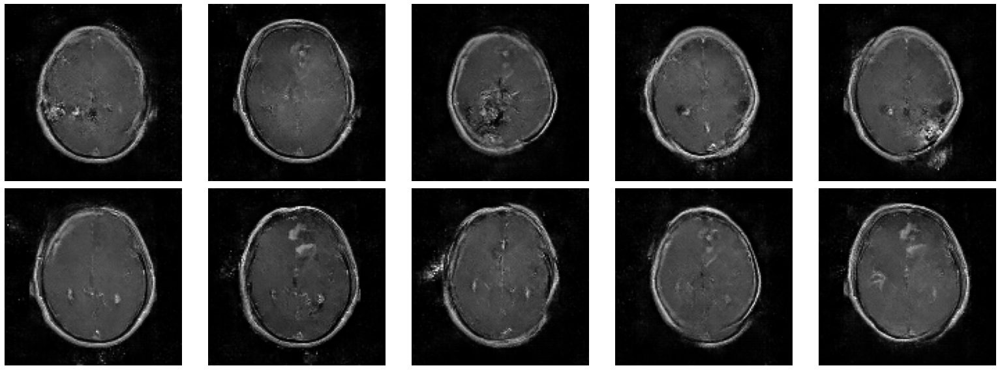

  0%|          | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 1/3750 [00:00<12:41,  4.93it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 2/3750 [00:00<12:00,  5.20it/s]

1/1 [==============================] - 0s 33ms/step


  0%|          | 3/3750 [00:00<13:43,  4.55it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 4/3750 [00:00<12:23,  5.04it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 5/3750 [00:00<11:33,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 6/3750 [00:01<10:55,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 7/3750 [00:01<11:08,  5.60it/s]

1/1 [==============================] - 0s 32ms/step


  0%|          | 8/3750 [00:01<11:12,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 9/3750 [00:01<10:39,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 10/3750 [00:01<10:47,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 11/3750 [00:02<11:03,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 12/3750 [00:02<10:56,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 13/3750 [00:02<10:31,  5.92it/s]

1/1 [==============================] - 0s 31ms/step


  0%|          | 14/3750 [00:02<10:59,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 15/3750 [00:02<10:38,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 16/3750 [00:02<10:10,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 17/3750 [00:02<09:53,  6.29it/s]

1/1 [==============================] - 0s 35ms/step


  0%|          | 18/3750 [00:03<09:52,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 19/3750 [00:03<09:33,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 20/3750 [00:03<09:47,  6.35it/s]

1/1 [==============================] - 0s 42ms/step


  1%|          | 21/3750 [00:03<10:27,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 22/3750 [00:03<09:49,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 23/3750 [00:03<09:32,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 24/3750 [00:04<09:29,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 25/3750 [00:04<09:17,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 26/3750 [00:04<09:52,  6.28it/s]

1/1 [==============================] - 0s 46ms/step


  1%|          | 27/3750 [00:04<10:11,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 28/3750 [00:04<10:03,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 29/3750 [00:04<09:40,  6.41it/s]

1/1 [==============================] - 0s 52ms/step


  1%|          | 30/3750 [00:05<10:22,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 31/3750 [00:05<09:44,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 32/3750 [00:05<09:14,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 33/3750 [00:05<09:46,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 34/3750 [00:05<09:38,  6.43it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 35/3750 [00:05<09:23,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 36/3750 [00:05<09:01,  6.85it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 37/3750 [00:06<09:08,  6.77it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 38/3750 [00:06<08:51,  6.98it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 39/3750 [00:06<08:53,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 40/3750 [00:06<08:59,  6.88it/s]

1/1 [==============================] - 0s 44ms/step


  1%|          | 41/3750 [00:06<10:00,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 42/3750 [00:06<10:23,  5.95it/s]

1/1 [==============================] - 0s 36ms/step


  1%|          | 43/3750 [00:07<10:24,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 44/3750 [00:07<10:42,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 45/3750 [00:07<10:18,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 46/3750 [00:07<10:08,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 47/3750 [00:07<10:36,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 48/3750 [00:07<10:42,  5.76it/s]

1/1 [==============================] - 0s 35ms/step


  1%|▏         | 49/3750 [00:08<10:41,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 50/3750 [00:08<10:42,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 51/3750 [00:08<10:25,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 52/3750 [00:08<10:43,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 53/3750 [00:08<11:02,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 54/3750 [00:08<10:27,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 55/3750 [00:09<10:07,  6.08it/s]

1/1 [==============================] - 0s 33ms/step


  1%|▏         | 56/3750 [00:09<10:47,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 57/3750 [00:09<10:57,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 58/3750 [00:09<10:55,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 59/3750 [00:09<10:17,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 60/3750 [00:10<10:52,  5.65it/s]

1/1 [==============================] - 0s 56ms/step


  2%|▏         | 61/3750 [00:10<11:09,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 62/3750 [00:10<10:34,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 63/3750 [00:10<10:57,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 64/3750 [00:10<10:11,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 65/3750 [00:10<10:32,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 66/3750 [00:11<09:55,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 67/3750 [00:11<09:43,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 68/3750 [00:11<09:06,  6.74it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 69/3750 [00:11<08:55,  6.88it/s]

1/1 [==============================] - 0s 35ms/step


  2%|▏         | 70/3750 [00:11<09:02,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 71/3750 [00:11<09:04,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 72/3750 [00:11<09:49,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 73/3750 [00:12<09:16,  6.60it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 74/3750 [00:12<09:36,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 75/3750 [00:12<09:25,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 76/3750 [00:12<09:27,  6.47it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 77/3750 [00:12<09:29,  6.45it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 78/3750 [00:12<09:05,  6.73it/s]

1/1 [==============================] - 0s 37ms/step


  2%|▏         | 79/3750 [00:12<09:04,  6.74it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 80/3750 [00:13<09:43,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 81/3750 [00:13<10:24,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 82/3750 [00:13<09:47,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 83/3750 [00:13<09:39,  6.32it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 84/3750 [00:13<09:18,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 85/3750 [00:13<09:19,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 86/3750 [00:14<09:02,  6.76it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 87/3750 [00:14<09:47,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 88/3750 [00:14<09:42,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 89/3750 [00:14<10:10,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 90/3750 [00:14<09:49,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 91/3750 [00:14<10:13,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 92/3750 [00:15<09:38,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 93/3750 [00:15<10:48,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 94/3750 [00:15<10:31,  5.79it/s]

1/1 [==============================] - 0s 37ms/step


  3%|▎         | 95/3750 [00:15<10:22,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 96/3750 [00:15<10:25,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 97/3750 [00:15<09:40,  6.30it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 98/3750 [00:16<09:26,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 99/3750 [00:16<09:18,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 100/3750 [00:16<08:59,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 101/3750 [00:16<09:18,  6.54it/s]

1/1 [==============================] - 0s 37ms/step


  3%|▎         | 102/3750 [00:16<09:32,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 103/3750 [00:16<09:08,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 104/3750 [00:16<08:53,  6.84it/s]

1/1 [==============================] - 0s 38ms/step


  3%|▎         | 105/3750 [00:17<09:08,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 106/3750 [00:17<08:59,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 107/3750 [00:17<08:52,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 108/3750 [00:17<08:52,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 109/3750 [00:17<08:55,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 110/3750 [00:17<08:47,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 111/3750 [00:17<08:40,  7.00it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 112/3750 [00:18<09:22,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 113/3750 [00:18<09:19,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 114/3750 [00:18<08:53,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 115/3750 [00:18<08:56,  6.78it/s]

1/1 [==============================] - 0s 45ms/step


  3%|▎         | 116/3750 [00:18<09:07,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 117/3750 [00:18<08:54,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 118/3750 [00:18<08:28,  7.14it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 119/3750 [00:19<08:45,  6.91it/s]

1/1 [==============================] - 0s 46ms/step


  3%|▎         | 120/3750 [00:19<09:18,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 121/3750 [00:19<09:14,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 122/3750 [00:19<09:17,  6.51it/s]

1/1 [==============================] - 0s 33ms/step


  3%|▎         | 123/3750 [00:19<09:16,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 124/3750 [00:19<09:17,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 125/3750 [00:20<08:55,  6.76it/s]

1/1 [==============================] - 0s 36ms/step


  3%|▎         | 126/3750 [00:20<08:59,  6.72it/s]

1/1 [==============================] - 0s 49ms/step


  3%|▎         | 127/3750 [00:20<10:04,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 128/3750 [00:20<09:39,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 129/3750 [00:20<09:15,  6.52it/s]

1/1 [==============================] - 0s 34ms/step


  3%|▎         | 130/3750 [00:20<10:02,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 131/3750 [00:21<09:32,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 132/3750 [00:21<09:27,  6.38it/s]

1/1 [==============================] - 0s 57ms/step


  4%|▎         | 133/3750 [00:21<10:38,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 134/3750 [00:21<10:26,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 135/3750 [00:21<09:59,  6.03it/s]

1/1 [==============================] - 0s 36ms/step


  4%|▎         | 136/3750 [00:21<09:59,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 137/3750 [00:22<09:25,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 138/3750 [00:22<10:07,  5.94it/s]

1/1 [==============================] - 0s 33ms/step


  4%|▎         | 139/3750 [00:22<10:24,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 140/3750 [00:22<09:37,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 141/3750 [00:22<09:07,  6.60it/s]

1/1 [==============================] - 0s 43ms/step


  4%|▍         | 142/3750 [00:22<10:11,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 143/3750 [00:23<10:25,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 144/3750 [00:23<10:07,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 145/3750 [00:23<09:41,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 146/3750 [00:23<09:27,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 147/3750 [00:23<09:02,  6.65it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▍         | 148/3750 [00:23<09:25,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 149/3750 [00:23<09:13,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 150/3750 [00:24<09:05,  6.60it/s]

1/1 [==============================] - 0s 32ms/step


  4%|▍         | 151/3750 [00:24<10:01,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 152/3750 [00:24<09:52,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 153/3750 [00:24<10:02,  5.97it/s]

1/1 [==============================] - 0s 41ms/step


  4%|▍         | 154/3750 [00:24<10:21,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 155/3750 [00:24<09:42,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 156/3750 [00:25<09:26,  6.34it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 157/3750 [00:25<09:20,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 158/3750 [00:25<09:05,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 159/3750 [00:25<08:43,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 160/3750 [00:25<08:31,  7.02it/s]

1/1 [==============================] - 0s 33ms/step


  4%|▍         | 161/3750 [00:25<08:59,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 162/3750 [00:26<09:07,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 163/3750 [00:26<08:53,  6.72it/s]

1/1 [==============================] - 0s 38ms/step


  4%|▍         | 164/3750 [00:26<08:58,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 165/3750 [00:26<09:37,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 166/3750 [00:26<09:23,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 167/3750 [00:26<09:30,  6.28it/s]

1/1 [==============================] - 0s 35ms/step


  4%|▍         | 168/3750 [00:26<09:51,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 169/3750 [00:27<10:21,  5.76it/s]

1/1 [==============================] - 0s 38ms/step


  5%|▍         | 170/3750 [00:27<10:53,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 171/3750 [00:27<10:08,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 172/3750 [00:27<10:35,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 173/3750 [00:27<10:46,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▍         | 174/3750 [00:28<10:24,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 175/3750 [00:28<10:02,  5.94it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▍         | 176/3750 [00:28<10:14,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 177/3750 [00:28<10:24,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 178/3750 [00:28<09:53,  6.02it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▍         | 179/3750 [00:28<09:49,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 180/3750 [00:29<09:48,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 181/3750 [00:29<09:24,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 182/3750 [00:29<10:16,  5.79it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▍         | 183/3750 [00:29<10:08,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 184/3750 [00:29<10:07,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 185/3750 [00:29<09:29,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▍         | 186/3750 [00:30<09:58,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 187/3750 [00:30<10:10,  5.84it/s]

1/1 [==============================] - 0s 37ms/step


  5%|▌         | 188/3750 [00:30<10:49,  5.48it/s]

1/1 [==============================] - 0s 34ms/step


  5%|▌         | 189/3750 [00:30<10:39,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 190/3750 [00:30<10:12,  5.81it/s]

1/1 [==============================] - 0s 43ms/step


  5%|▌         | 191/3750 [00:30<10:21,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 192/3750 [00:31<10:48,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 193/3750 [00:31<10:26,  5.68it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▌         | 194/3750 [00:31<10:07,  5.85it/s]

1/1 [==============================] - 0s 34ms/step


  5%|▌         | 195/3750 [00:31<09:37,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 196/3750 [00:31<09:43,  6.09it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▌         | 197/3750 [00:31<09:37,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 198/3750 [00:32<09:28,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 199/3750 [00:32<09:10,  6.45it/s]

1/1 [==============================] - 0s 36ms/step


  5%|▌         | 200/3750 [00:32<09:46,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 201/3750 [00:32<10:05,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 202/3750 [00:32<09:50,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 203/3750 [00:32<09:47,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 204/3750 [00:33<10:02,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 205/3750 [00:33<09:44,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 206/3750 [00:33<10:06,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▌         | 207/3750 [00:33<10:37,  5.56it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 208/3750 [00:33<10:52,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 209/3750 [00:34<10:57,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 210/3750 [00:34<10:44,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 211/3750 [00:34<10:46,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 212/3750 [00:34<10:22,  5.68it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 213/3750 [00:34<10:12,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 214/3750 [00:34<09:35,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▌         | 215/3750 [00:35<10:01,  5.88it/s]

1/1 [==============================] - 0s 52ms/step


  6%|▌         | 216/3750 [00:35<10:38,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 217/3750 [00:35<10:39,  5.52it/s]

1/1 [==============================] - 0s 53ms/step


  6%|▌         | 218/3750 [00:35<10:58,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▌         | 219/3750 [00:35<10:14,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 220/3750 [00:35<09:39,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 221/3750 [00:36<09:29,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 222/3750 [00:36<09:10,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 223/3750 [00:36<09:04,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 224/3750 [00:36<08:49,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 225/3750 [00:36<08:53,  6.61it/s]

1/1 [==============================] - 0s 34ms/step


  6%|▌         | 226/3750 [00:36<09:15,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 227/3750 [00:36<08:58,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 228/3750 [00:37<08:49,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 229/3750 [00:37<08:40,  6.77it/s]

1/1 [==============================] - 0s 34ms/step


  6%|▌         | 230/3750 [00:37<09:04,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 231/3750 [00:37<08:55,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 232/3750 [00:37<08:42,  6.74it/s]

1/1 [==============================] - 0s 40ms/step


  6%|▌         | 233/3750 [00:37<09:50,  5.95it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▌         | 234/3750 [00:38<09:15,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 235/3750 [00:38<09:19,  6.28it/s]

1/1 [==============================] - 0s 38ms/step


  6%|▋         | 236/3750 [00:38<09:18,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 237/3750 [00:38<09:17,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▋         | 238/3750 [00:38<08:51,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 239/3750 [00:38<08:57,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▋         | 240/3750 [00:38<09:00,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▋         | 241/3750 [00:39<08:32,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 242/3750 [00:39<08:20,  7.01it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▋         | 243/3750 [00:39<08:38,  6.76it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 244/3750 [00:39<08:35,  6.79it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 245/3750 [00:39<08:22,  6.97it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 246/3750 [00:39<08:28,  6.90it/s]

1/1 [==============================] - 0s 36ms/step


  7%|▋         | 247/3750 [00:40<08:41,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 248/3750 [00:40<08:33,  6.82it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 249/3750 [00:40<08:08,  7.16it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 250/3750 [00:40<08:25,  6.93it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 251/3750 [00:40<08:22,  6.96it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 252/3750 [00:40<08:10,  7.13it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 253/3750 [00:40<08:17,  7.02it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 254/3750 [00:40<08:20,  6.99it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 255/3750 [00:41<08:14,  7.07it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 256/3750 [00:41<08:25,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 257/3750 [00:41<08:22,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 258/3750 [00:41<08:16,  7.03it/s]

1/1 [==============================] - 0s 51ms/step


  7%|▋         | 259/3750 [00:41<08:52,  6.56it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 260/3750 [00:41<08:35,  6.77it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 261/3750 [00:42<08:46,  6.62it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 262/3750 [00:42<09:26,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 263/3750 [00:42<08:59,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 264/3750 [00:42<08:42,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 265/3750 [00:42<08:23,  6.92it/s]

1/1 [==============================] - 0s 39ms/step


  7%|▋         | 266/3750 [00:42<08:43,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 267/3750 [00:42<08:25,  6.89it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 268/3750 [00:43<08:55,  6.51it/s]

1/1 [==============================] - 0s 38ms/step


  7%|▋         | 269/3750 [00:43<08:59,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 270/3750 [00:43<08:22,  6.93it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 271/3750 [00:43<08:14,  7.03it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 272/3750 [00:43<08:44,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 273/3750 [00:43<08:41,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 274/3750 [00:43<08:35,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 275/3750 [00:44<08:24,  6.89it/s]

1/1 [==============================] - 0s 46ms/step


  7%|▋         | 276/3750 [00:44<10:15,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 277/3750 [00:44<09:40,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 278/3750 [00:44<09:20,  6.20it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 279/3750 [00:44<09:14,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 280/3750 [00:44<08:56,  6.47it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 281/3750 [00:45<08:48,  6.56it/s]

1/1 [==============================] - 0s 52ms/step


  8%|▊         | 282/3750 [00:45<09:49,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 283/3750 [00:45<09:26,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 284/3750 [00:45<09:05,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 285/3750 [00:45<09:23,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 286/3750 [00:45<09:08,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 287/3750 [00:46<08:56,  6.45it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 288/3750 [00:46<08:48,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 289/3750 [00:46<08:27,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 290/3750 [00:46<08:20,  6.91it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 291/3750 [00:46<08:16,  6.97it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 292/3750 [00:46<08:35,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 293/3750 [00:46<08:19,  6.92it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 294/3750 [00:47<08:19,  6.91it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 295/3750 [00:47<08:27,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 296/3750 [00:47<08:20,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 297/3750 [00:47<08:19,  6.91it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 298/3750 [00:47<09:05,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 299/3750 [00:47<08:31,  6.75it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 300/3750 [00:47<08:22,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 301/3750 [00:48<08:27,  6.79it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 302/3750 [00:48<09:07,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 303/3750 [00:48<09:35,  5.99it/s]

1/1 [==============================] - 0s 55ms/step


  8%|▊         | 304/3750 [00:48<10:01,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 305/3750 [00:48<09:34,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 306/3750 [00:48<09:07,  6.29it/s]

1/1 [==============================] - 0s 32ms/step


  8%|▊         | 307/3750 [00:49<09:03,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 308/3750 [00:49<09:07,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 309/3750 [00:49<08:51,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 310/3750 [00:49<08:41,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 311/3750 [00:49<09:15,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 312/3750 [00:49<08:57,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 313/3750 [00:50<08:49,  6.49it/s]

1/1 [==============================] - 0s 34ms/step


  8%|▊         | 314/3750 [00:50<09:39,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 315/3750 [00:50<09:14,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 316/3750 [00:50<08:52,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 317/3750 [00:50<08:49,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 318/3750 [00:50<09:20,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 319/3750 [00:51<08:54,  6.42it/s]

1/1 [==============================] - 0s 53ms/step


  9%|▊         | 320/3750 [00:51<09:25,  6.06it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▊         | 321/3750 [00:51<08:51,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 322/3750 [00:51<08:34,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 323/3750 [00:51<08:44,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 324/3750 [00:51<08:39,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 325/3750 [00:51<08:32,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 326/3750 [00:52<08:41,  6.56it/s]

1/1 [==============================] - 0s 52ms/step


  9%|▊         | 327/3750 [00:52<09:07,  6.25it/s]

1/1 [==============================] - 0s 32ms/step


  9%|▊         | 328/3750 [00:52<09:16,  6.15it/s]

1/1 [==============================] - 0s 31ms/step


  9%|▉         | 329/3750 [00:52<08:58,  6.36it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▉         | 330/3750 [00:52<08:55,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 331/3750 [00:52<08:50,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 332/3750 [00:53<08:51,  6.44it/s]

1/1 [==============================] - 0s 52ms/step


  9%|▉         | 333/3750 [00:53<09:59,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 334/3750 [00:53<09:33,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 335/3750 [00:53<09:15,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 336/3750 [00:53<08:58,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 337/3750 [00:53<08:38,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 338/3750 [00:53<08:23,  6.78it/s]

1/1 [==============================] - 0s 34ms/step


  9%|▉         | 339/3750 [00:54<08:36,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 340/3750 [00:54<08:49,  6.44it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 341/3750 [00:54<08:41,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 342/3750 [00:54<08:42,  6.52it/s]

1/1 [==============================] - 0s 31ms/step


  9%|▉         | 343/3750 [00:54<08:40,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 344/3750 [00:54<08:29,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 345/3750 [00:55<08:02,  7.06it/s]

1/1 [==============================] - 0s 36ms/step


  9%|▉         | 346/3750 [00:55<08:15,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 347/3750 [00:55<08:28,  6.69it/s]

1/1 [==============================] - 0s 32ms/step


  9%|▉         | 348/3750 [00:55<08:13,  6.90it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 349/3750 [00:55<08:20,  6.79it/s]

1/1 [==============================] - 0s 35ms/step


  9%|▉         | 350/3750 [00:55<08:25,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 351/3750 [00:55<08:15,  6.87it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 352/3750 [00:56<07:59,  7.08it/s]

1/1 [==============================] - 0s 37ms/step


  9%|▉         | 353/3750 [00:56<08:32,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 354/3750 [00:56<08:13,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 355/3750 [00:56<08:05,  7.00it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 356/3750 [00:56<08:04,  7.00it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 357/3750 [00:56<08:07,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 358/3750 [00:56<08:04,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 359/3750 [00:57<08:04,  7.00it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 360/3750 [00:57<08:23,  6.73it/s]

1/1 [==============================] - 0s 32ms/step


 10%|▉         | 361/3750 [00:57<08:31,  6.63it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 362/3750 [00:57<08:09,  6.93it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 363/3750 [00:57<08:15,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 364/3750 [00:57<07:54,  7.14it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 365/3750 [00:57<07:56,  7.11it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 366/3750 [00:58<08:12,  6.86it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 367/3750 [00:58<08:27,  6.67it/s]

1/1 [==============================] - 0s 43ms/step


 10%|▉         | 368/3750 [00:58<08:43,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 369/3750 [00:58<08:36,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 370/3750 [00:58<08:28,  6.64it/s]

1/1 [==============================] - 0s 36ms/step


 10%|▉         | 371/3750 [00:58<09:13,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 372/3750 [00:59<08:36,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 373/3750 [00:59<08:28,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 374/3750 [00:59<08:35,  6.55it/s]

1/1 [==============================] - 0s 31ms/step


 10%|█         | 375/3750 [00:59<08:34,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 376/3750 [00:59<08:35,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 377/3750 [00:59<08:45,  6.42it/s]

1/1 [==============================] - 0s 41ms/step


 10%|█         | 378/3750 [00:59<08:57,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 379/3750 [01:00<08:30,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 380/3750 [01:00<08:02,  6.98it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 381/3750 [01:00<08:12,  6.84it/s]

1/1 [==============================] - 0s 34ms/step


 10%|█         | 382/3750 [01:00<08:32,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 383/3750 [01:00<08:17,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 384/3750 [01:00<07:51,  7.13it/s]

1/1 [==============================] - 0s 38ms/step


 10%|█         | 385/3750 [01:00<08:39,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 386/3750 [01:01<08:29,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 387/3750 [01:01<08:18,  6.75it/s]

1/1 [==============================] - 0s 34ms/step


 10%|█         | 388/3750 [01:01<09:05,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 389/3750 [01:01<08:41,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 390/3750 [01:01<08:28,  6.60it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 391/3750 [01:01<08:14,  6.80it/s]

1/1 [==============================] - 0s 33ms/step


 10%|█         | 392/3750 [01:02<08:18,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 393/3750 [01:02<08:17,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 394/3750 [01:02<08:08,  6.87it/s]

1/1 [==============================] - 0s 36ms/step


 11%|█         | 395/3750 [01:02<08:37,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 396/3750 [01:02<08:28,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 397/3750 [01:02<08:53,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 398/3750 [01:02<08:39,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 399/3750 [01:03<08:19,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 400/3750 [01:03<08:16,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 401/3750 [01:03<08:17,  6.73it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 402/3750 [01:03<08:12,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 403/3750 [01:03<07:57,  7.01it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 404/3750 [01:03<08:03,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 405/3750 [01:04<09:11,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 406/3750 [01:04<08:42,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 407/3750 [01:04<08:25,  6.61it/s]

1/1 [==============================] - 0s 51ms/step


 11%|█         | 408/3750 [01:04<09:35,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 409/3750 [01:04<09:20,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 410/3750 [01:04<08:53,  6.26it/s]

1/1 [==============================] - 0s 48ms/step


 11%|█         | 411/3750 [01:05<09:28,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 412/3750 [01:05<09:47,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 413/3750 [01:05<09:20,  5.96it/s]

1/1 [==============================] - 0s 44ms/step


 11%|█         | 414/3750 [01:05<10:00,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 415/3750 [01:05<09:31,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 416/3750 [01:05<09:06,  6.10it/s]

1/1 [==============================] - 0s 35ms/step


 11%|█         | 417/3750 [01:06<10:02,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 418/3750 [01:06<09:32,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 419/3750 [01:06<09:25,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 420/3750 [01:06<09:13,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 421/3750 [01:06<08:58,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 422/3750 [01:06<08:53,  6.24it/s]

1/1 [==============================] - 0s 37ms/step


 11%|█▏        | 423/3750 [01:07<09:06,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 424/3750 [01:07<08:58,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 425/3750 [01:07<08:57,  6.19it/s]

1/1 [==============================] - 0s 38ms/step


 11%|█▏        | 426/3750 [01:07<09:43,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 427/3750 [01:07<09:16,  5.97it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█▏        | 428/3750 [01:07<08:55,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 429/3750 [01:08<09:16,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 430/3750 [01:08<08:57,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 431/3750 [01:08<09:02,  6.11it/s]

1/1 [==============================] - 0s 50ms/step


 12%|█▏        | 432/3750 [01:08<09:34,  5.77it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 433/3750 [01:08<09:20,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 434/3750 [01:08<09:13,  5.99it/s]

1/1 [==============================] - 0s 46ms/step


 12%|█▏        | 435/3750 [01:09<10:33,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 436/3750 [01:09<09:48,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 437/3750 [01:09<09:23,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 438/3750 [01:09<09:29,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 439/3750 [01:09<09:52,  5.59it/s]

1/1 [==============================] - 0s 44ms/step


 12%|█▏        | 440/3750 [01:10<10:11,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 441/3750 [01:10<10:03,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 442/3750 [01:10<09:24,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 443/3750 [01:10<08:59,  6.13it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 444/3750 [01:10<09:43,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 445/3750 [01:10<09:34,  5.75it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 446/3750 [01:10<09:17,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 447/3750 [01:11<09:33,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 448/3750 [01:11<09:11,  5.99it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 449/3750 [01:11<09:04,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 450/3750 [01:11<08:50,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 451/3750 [01:11<08:39,  6.35it/s]

1/1 [==============================] - 0s 37ms/step


 12%|█▏        | 452/3750 [01:11<08:48,  6.24it/s]

1/1 [==============================] - 0s 34ms/step


 12%|█▏        | 453/3750 [01:12<08:52,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 454/3750 [01:12<08:23,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 455/3750 [01:12<09:02,  6.07it/s]

1/1 [==============================] - 0s 47ms/step


 12%|█▏        | 456/3750 [01:12<09:30,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 457/3750 [01:12<08:59,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 458/3750 [01:12<08:45,  6.27it/s]

1/1 [==============================] - 0s 40ms/step


 12%|█▏        | 459/3750 [01:13<09:32,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 460/3750 [01:13<09:10,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 461/3750 [01:13<08:50,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 462/3750 [01:13<08:27,  6.48it/s]

1/1 [==============================] - 0s 34ms/step


 12%|█▏        | 463/3750 [01:13<08:58,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 464/3750 [01:13<08:35,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 465/3750 [01:14<08:18,  6.59it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 466/3750 [01:14<08:22,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 467/3750 [01:14<07:58,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 468/3750 [01:14<08:24,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 469/3750 [01:14<08:48,  6.21it/s]

1/1 [==============================] - 0s 46ms/step


 13%|█▎        | 470/3750 [01:14<09:01,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 471/3750 [01:15<08:42,  6.28it/s]

1/1 [==============================] - 0s 42ms/step


 13%|█▎        | 472/3750 [01:15<08:48,  6.21it/s]

1/1 [==============================] - 0s 35ms/step


 13%|█▎        | 473/3750 [01:15<09:20,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 474/3750 [01:15<09:00,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 475/3750 [01:15<08:38,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 476/3750 [01:15<08:28,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 477/3750 [01:15<08:21,  6.52it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 478/3750 [01:16<08:21,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 479/3750 [01:16<08:06,  6.73it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 480/3750 [01:16<08:10,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 481/3750 [01:16<07:52,  6.92it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 482/3750 [01:16<08:18,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 483/3750 [01:16<08:34,  6.36it/s]

1/1 [==============================] - 0s 35ms/step


 13%|█▎        | 484/3750 [01:17<08:32,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 485/3750 [01:17<08:26,  6.45it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 486/3750 [01:17<08:12,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 487/3750 [01:17<08:02,  6.76it/s]

1/1 [==============================] - 0s 48ms/step


 13%|█▎        | 488/3750 [01:17<08:38,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 489/3750 [01:17<08:25,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 490/3750 [01:17<08:13,  6.60it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 491/3750 [01:18<08:08,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 492/3750 [01:18<08:33,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 493/3750 [01:18<08:26,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 494/3750 [01:18<08:20,  6.51it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 495/3750 [01:18<08:19,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 496/3750 [01:18<08:08,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 497/3750 [01:18<08:08,  6.66it/s]

1/1 [==============================] - 0s 45ms/step


 13%|█▎        | 498/3750 [01:19<08:30,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 499/3750 [01:19<08:46,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 500/3750 [01:19<08:36,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 501/3750 [01:19<08:16,  6.54it/s]

1/1 [==============================] - 0s 51ms/step


 13%|█▎        | 502/3750 [01:19<09:12,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 503/3750 [01:20<09:14,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 504/3750 [01:20<09:03,  5.97it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 505/3750 [01:20<09:08,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 506/3750 [01:20<08:40,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 507/3750 [01:20<08:30,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▎        | 508/3750 [01:20<08:45,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 509/3750 [01:20<08:26,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▎        | 510/3750 [01:21<08:57,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 511/3750 [01:21<08:39,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 512/3750 [01:21<08:38,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 513/3750 [01:21<08:18,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 514/3750 [01:21<07:58,  6.76it/s]

1/1 [==============================] - 0s 39ms/step


 14%|█▎        | 515/3750 [01:21<08:30,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 516/3750 [01:22<08:04,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 517/3750 [01:22<08:01,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 518/3750 [01:22<07:50,  6.87it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▍        | 519/3750 [01:22<08:35,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 520/3750 [01:22<08:20,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 521/3750 [01:22<07:59,  6.73it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 522/3750 [01:22<08:34,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 523/3750 [01:23<08:10,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 524/3750 [01:23<08:03,  6.68it/s]

1/1 [==============================] - 0s 33ms/step


 14%|█▍        | 525/3750 [01:23<08:09,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 526/3750 [01:23<08:10,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 527/3750 [01:23<07:47,  6.90it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 528/3750 [01:23<07:29,  7.16it/s]

1/1 [==============================] - 0s 43ms/step


 14%|█▍        | 529/3750 [01:24<08:14,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 530/3750 [01:24<08:02,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 531/3750 [01:24<08:07,  6.60it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 532/3750 [01:24<08:01,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 533/3750 [01:24<08:01,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 534/3750 [01:24<07:43,  6.94it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 535/3750 [01:24<07:37,  7.03it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▍        | 536/3750 [01:25<07:56,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 537/3750 [01:25<07:59,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 538/3750 [01:25<07:55,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 539/3750 [01:25<08:12,  6.52it/s]

1/1 [==============================] - 0s 48ms/step


 14%|█▍        | 540/3750 [01:25<08:46,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 541/3750 [01:25<08:11,  6.53it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 542/3750 [01:25<07:43,  6.92it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 543/3750 [01:26<07:53,  6.77it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 544/3750 [01:26<07:52,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 545/3750 [01:26<07:58,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 546/3750 [01:26<07:55,  6.74it/s]

1/1 [==============================] - 0s 34ms/step


 15%|█▍        | 547/3750 [01:26<08:19,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 548/3750 [01:26<08:09,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 549/3750 [01:27<08:04,  6.60it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 550/3750 [01:27<07:57,  6.71it/s]

1/1 [==============================] - 0s 33ms/step


 15%|█▍        | 551/3750 [01:27<08:22,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 552/3750 [01:27<07:57,  6.70it/s]

1/1 [==============================] - 0s 35ms/step


 15%|█▍        | 553/3750 [01:27<07:51,  6.78it/s]

1/1 [==============================] - 0s 47ms/step


 15%|█▍        | 554/3750 [01:27<08:15,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 555/3750 [01:27<08:05,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 556/3750 [01:28<08:05,  6.58it/s]

1/1 [==============================] - 0s 59ms/step


 15%|█▍        | 557/3750 [01:28<08:42,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 558/3750 [01:28<08:19,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 559/3750 [01:28<08:43,  6.09it/s]

1/1 [==============================] - 0s 49ms/step


 15%|█▍        | 560/3750 [01:28<09:12,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 561/3750 [01:28<09:24,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 562/3750 [01:29<09:03,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 563/3750 [01:29<09:51,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 564/3750 [01:29<10:01,  5.29it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 565/3750 [01:29<09:35,  5.53it/s]

1/1 [==============================] - 0s 33ms/step


 15%|█▌        | 566/3750 [01:29<10:11,  5.21it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 567/3750 [01:30<09:40,  5.48it/s]

1/1 [==============================] - 0s 41ms/step


 15%|█▌        | 568/3750 [01:30<10:14,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 569/3750 [01:30<10:13,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 570/3750 [01:30<09:51,  5.38it/s]

1/1 [==============================] - 0s 35ms/step


 15%|█▌        | 571/3750 [01:30<09:27,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 572/3750 [01:30<09:30,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 573/3750 [01:31<09:08,  5.79it/s]

1/1 [==============================] - 0s 40ms/step


 15%|█▌        | 574/3750 [01:31<08:56,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 575/3750 [01:31<08:45,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 576/3750 [01:31<08:41,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 577/3750 [01:31<08:44,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 578/3750 [01:31<08:14,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 579/3750 [01:32<08:37,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 580/3750 [01:32<08:41,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 581/3750 [01:32<08:27,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 582/3750 [01:32<08:15,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 583/3750 [01:32<07:59,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 584/3750 [01:32<08:10,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 585/3750 [01:33<07:54,  6.67it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 586/3750 [01:33<08:40,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 587/3750 [01:33<08:33,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 588/3750 [01:33<08:15,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 589/3750 [01:33<08:03,  6.53it/s]

1/1 [==============================] - 0s 42ms/step


 16%|█▌        | 590/3750 [01:33<08:26,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 591/3750 [01:33<08:20,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 592/3750 [01:34<08:21,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 593/3750 [01:34<08:07,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 594/3750 [01:34<08:27,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 595/3750 [01:34<08:03,  6.52it/s]

1/1 [==============================] - 0s 32ms/step


 16%|█▌        | 596/3750 [01:34<08:12,  6.40it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▌        | 597/3750 [01:34<09:00,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 598/3750 [01:35<08:45,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 599/3750 [01:35<08:48,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 600/3750 [01:35<08:24,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 601/3750 [01:35<08:11,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 602/3750 [01:35<08:12,  6.39it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 603/3750 [01:35<08:19,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 604/3750 [01:36<07:52,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 605/3750 [01:36<08:25,  6.22it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 606/3750 [01:36<08:40,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 607/3750 [01:36<08:40,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 608/3750 [01:36<08:17,  6.32it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 609/3750 [01:36<08:13,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 610/3750 [01:37<07:56,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 611/3750 [01:37<08:13,  6.36it/s]

1/1 [==============================] - 0s 51ms/step


 16%|█▋        | 612/3750 [01:37<09:07,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 613/3750 [01:37<08:48,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 614/3750 [01:37<08:19,  6.28it/s]

1/1 [==============================] - 0s 35ms/step


 16%|█▋        | 615/3750 [01:37<09:16,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▋        | 616/3750 [01:38<09:01,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 617/3750 [01:38<09:10,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 618/3750 [01:38<08:47,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 619/3750 [01:38<08:31,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 620/3750 [01:38<08:35,  6.07it/s]

1/1 [==============================] - 0s 35ms/step


 17%|█▋        | 621/3750 [01:38<09:08,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 622/3750 [01:39<09:16,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 623/3750 [01:39<08:49,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 624/3750 [01:39<08:37,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 625/3750 [01:39<08:15,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 626/3750 [01:39<08:28,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 627/3750 [01:39<08:18,  6.26it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 628/3750 [01:40<08:13,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 629/3750 [01:40<08:03,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 630/3750 [01:40<07:53,  6.59it/s]

1/1 [==============================] - 0s 43ms/step


 17%|█▋        | 631/3750 [01:40<08:26,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 632/3750 [01:40<07:59,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 633/3750 [01:40<07:55,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 634/3750 [01:40<07:44,  6.71it/s]

1/1 [==============================] - 0s 33ms/step


 17%|█▋        | 635/3750 [01:41<08:20,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 636/3750 [01:41<07:59,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 637/3750 [01:41<07:41,  6.75it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 638/3750 [01:41<08:08,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 639/3750 [01:41<08:46,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 640/3750 [01:41<08:56,  5.80it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 641/3750 [01:42<08:45,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 642/3750 [01:42<08:17,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 643/3750 [01:42<08:55,  5.80it/s]

1/1 [==============================] - 0s 35ms/step


 17%|█▋        | 644/3750 [01:42<09:35,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 645/3750 [01:42<09:38,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 646/3750 [01:43<09:40,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 647/3750 [01:43<09:15,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 648/3750 [01:43<08:43,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 649/3750 [01:43<08:31,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 650/3750 [01:43<08:18,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 651/3750 [01:43<08:32,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 652/3750 [01:43<07:57,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 653/3750 [01:44<07:48,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 654/3750 [01:44<08:12,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 655/3750 [01:44<07:58,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 656/3750 [01:44<07:37,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 657/3750 [01:44<07:31,  6.85it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 658/3750 [01:44<08:25,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 659/3750 [01:45<08:06,  6.36it/s]

1/1 [==============================] - 0s 37ms/step


 18%|█▊        | 660/3750 [01:45<08:09,  6.32it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 661/3750 [01:45<08:15,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 662/3750 [01:45<07:42,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 663/3750 [01:45<07:40,  6.70it/s]

1/1 [==============================] - 0s 34ms/step


 18%|█▊        | 664/3750 [01:45<07:59,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 665/3750 [01:45<07:35,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 666/3750 [01:46<07:34,  6.79it/s]

1/1 [==============================] - 0s 46ms/step


 18%|█▊        | 667/3750 [01:46<07:50,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 668/3750 [01:46<07:39,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 669/3750 [01:46<07:22,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 670/3750 [01:46<08:06,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 671/3750 [01:46<07:39,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 672/3750 [01:46<07:17,  7.03it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 673/3750 [01:47<07:13,  7.11it/s]

1/1 [==============================] - 0s 48ms/step


 18%|█▊        | 674/3750 [01:47<08:26,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 675/3750 [01:47<08:27,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 676/3750 [01:47<08:06,  6.32it/s]

1/1 [==============================] - 0s 43ms/step


 18%|█▊        | 677/3750 [01:47<08:16,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 678/3750 [01:47<07:58,  6.41it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 679/3750 [01:48<07:45,  6.59it/s]

1/1 [==============================] - 0s 49ms/step


 18%|█▊        | 680/3750 [01:48<08:40,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 681/3750 [01:48<08:15,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 682/3750 [01:48<07:54,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 683/3750 [01:48<07:42,  6.63it/s]

1/1 [==============================] - 0s 48ms/step


 18%|█▊        | 684/3750 [01:48<07:56,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 685/3750 [01:49<07:43,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 686/3750 [01:49<07:26,  6.87it/s]

1/1 [==============================] - 0s 35ms/step


 18%|█▊        | 687/3750 [01:49<07:55,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 688/3750 [01:49<07:43,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 689/3750 [01:49<08:15,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 690/3750 [01:49<08:43,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 691/3750 [01:50<08:22,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 692/3750 [01:50<08:07,  6.28it/s]

1/1 [==============================] - 0s 33ms/step


 18%|█▊        | 693/3750 [01:50<07:55,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 694/3750 [01:50<07:29,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 695/3750 [01:50<07:26,  6.85it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 696/3750 [01:50<07:16,  7.00it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▊        | 697/3750 [01:50<07:41,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 698/3750 [01:51<07:31,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 699/3750 [01:51<07:27,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 700/3750 [01:51<07:29,  6.78it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▊        | 701/3750 [01:51<07:27,  6.82it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 702/3750 [01:51<07:33,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 703/3750 [01:51<08:00,  6.35it/s]

1/1 [==============================] - 0s 34ms/step


 19%|█▉        | 704/3750 [01:51<08:20,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 705/3750 [01:52<08:05,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 706/3750 [01:52<07:47,  6.51it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 707/3750 [01:52<07:46,  6.53it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 708/3750 [01:52<08:07,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 709/3750 [01:52<07:52,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 710/3750 [01:52<07:42,  6.57it/s]

1/1 [==============================] - 0s 49ms/step


 19%|█▉        | 711/3750 [01:53<08:02,  6.29it/s]

1/1 [==============================] - 0s 42ms/step


 19%|█▉        | 712/3750 [01:53<08:16,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 713/3750 [01:53<08:31,  5.94it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 714/3750 [01:53<08:21,  6.05it/s]

1/1 [==============================] - 0s 49ms/step


 19%|█▉        | 715/3750 [01:53<08:31,  5.93it/s]

1/1 [==============================] - 0s 48ms/step


 19%|█▉        | 716/3750 [01:53<08:44,  5.78it/s]

1/1 [==============================] - 0s 57ms/step


 19%|█▉        | 717/3750 [01:54<08:58,  5.63it/s]

1/1 [==============================] - 0s 50ms/step


 19%|█▉        | 718/3750 [01:54<09:42,  5.21it/s]

1/1 [==============================] - 0s 37ms/step


 19%|█▉        | 719/3750 [01:54<09:20,  5.40it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 720/3750 [01:54<09:22,  5.39it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 721/3750 [01:54<09:25,  5.36it/s]

1/1 [==============================] - 0s 51ms/step


 19%|█▉        | 722/3750 [01:55<10:11,  4.95it/s]

1/1 [==============================] - 0s 36ms/step


 19%|█▉        | 723/3750 [01:55<10:26,  4.83it/s]

1/1 [==============================] - 0s 36ms/step


 19%|█▉        | 724/3750 [01:55<10:20,  4.88it/s]

1/1 [==============================] - 0s 41ms/step


 19%|█▉        | 725/3750 [01:55<10:39,  4.73it/s]

1/1 [==============================] - 0s 43ms/step


 19%|█▉        | 726/3750 [01:56<10:58,  4.59it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 727/3750 [01:56<10:58,  4.59it/s]

1/1 [==============================] - 0s 51ms/step


 19%|█▉        | 728/3750 [01:56<10:42,  4.70it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 729/3750 [01:56<10:03,  5.00it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▉        | 730/3750 [01:56<09:42,  5.18it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▉        | 731/3750 [01:56<09:28,  5.31it/s]

1/1 [==============================] - 0s 37ms/step


 20%|█▉        | 732/3750 [01:57<10:04,  4.99it/s]

1/1 [==============================] - 0s 32ms/step


 20%|█▉        | 733/3750 [01:57<09:56,  5.06it/s]

1/1 [==============================] - 0s 54ms/step


 20%|█▉        | 734/3750 [01:57<10:14,  4.91it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 735/3750 [01:57<09:58,  5.03it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 736/3750 [01:57<09:18,  5.39it/s]

1/1 [==============================] - 0s 47ms/step


 20%|█▉        | 737/3750 [01:58<09:38,  5.21it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 738/3750 [01:58<08:56,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 739/3750 [01:58<08:50,  5.68it/s]

1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 740/3750 [01:58<09:14,  5.43it/s]

1/1 [==============================] - 0s 28ms/step


 20%|█▉        | 741/3750 [01:58<08:40,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 742/3750 [01:58<08:16,  6.05it/s]

1/1 [==============================] - 0s 57ms/step


 20%|█▉        | 743/3750 [01:59<09:14,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 744/3750 [01:59<08:46,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 745/3750 [01:59<08:48,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 746/3750 [01:59<08:55,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 747/3750 [01:59<08:34,  5.83it/s]

1/1 [==============================] - 0s 61ms/step


 20%|█▉        | 748/3750 [02:00<09:01,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 749/3750 [02:00<08:33,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 750/3750 [02:00<08:19,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 751/3750 [02:00<08:18,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 752/3750 [02:00<08:12,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 753/3750 [02:00<08:00,  6.24it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 754/3750 [02:01<08:14,  6.06it/s]

1/1 [==============================] - 0s 53ms/step


 20%|██        | 755/3750 [02:01<09:08,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 756/3750 [02:01<08:40,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 757/3750 [02:01<08:50,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 758/3750 [02:01<08:32,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 759/3750 [02:01<07:59,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 760/3750 [02:02<07:37,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 761/3750 [02:02<07:35,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 762/3750 [02:02<07:17,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 763/3750 [02:02<07:46,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 764/3750 [02:02<07:54,  6.29it/s]

1/1 [==============================] - 0s 31ms/step


 20%|██        | 765/3750 [02:02<08:27,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 766/3750 [02:02<08:02,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 767/3750 [02:03<08:27,  5.88it/s]

1/1 [==============================] - 0s 36ms/step


 20%|██        | 768/3750 [02:03<08:08,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 769/3750 [02:03<07:46,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 770/3750 [02:03<07:27,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 771/3750 [02:03<07:06,  6.98it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 772/3750 [02:03<07:17,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 773/3750 [02:04<07:22,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 774/3750 [02:04<07:07,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 775/3750 [02:04<06:58,  7.11it/s]

1/1 [==============================] - 0s 50ms/step


 21%|██        | 776/3750 [02:04<07:28,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 777/3750 [02:04<07:24,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 778/3750 [02:04<07:21,  6.74it/s]

1/1 [==============================] - 0s 32ms/step


 21%|██        | 779/3750 [02:04<07:25,  6.67it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 780/3750 [02:05<07:30,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 781/3750 [02:05<07:14,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 782/3750 [02:05<07:11,  6.88it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 783/3750 [02:05<07:37,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 784/3750 [02:05<07:39,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 785/3750 [02:05<07:27,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 786/3750 [02:05<07:39,  6.45it/s]

1/1 [==============================] - 0s 38ms/step


 21%|██        | 787/3750 [02:06<08:13,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 788/3750 [02:06<07:45,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 789/3750 [02:06<07:26,  6.63it/s]

1/1 [==============================] - 0s 42ms/step


 21%|██        | 790/3750 [02:06<07:55,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 791/3750 [02:06<08:06,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 792/3750 [02:06<07:57,  6.20it/s]

1/1 [==============================] - 0s 32ms/step


 21%|██        | 793/3750 [02:07<07:59,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 794/3750 [02:07<07:45,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 795/3750 [02:07<08:10,  6.02it/s]

1/1 [==============================] - 0s 43ms/step


 21%|██        | 796/3750 [02:07<08:32,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 797/3750 [02:07<08:15,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 798/3750 [02:07<07:53,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 799/3750 [02:08<07:54,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 800/3750 [02:08<07:38,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 801/3750 [02:08<07:32,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 802/3750 [02:08<07:08,  6.88it/s]

1/1 [==============================] - 0s 32ms/step


 21%|██▏       | 803/3750 [02:08<07:08,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 804/3750 [02:08<07:30,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 805/3750 [02:08<07:12,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 806/3750 [02:09<07:11,  6.83it/s]

1/1 [==============================] - 0s 32ms/step


 22%|██▏       | 807/3750 [02:09<07:23,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 808/3750 [02:09<07:13,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 809/3750 [02:09<07:03,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 810/3750 [02:09<07:05,  6.91it/s]

1/1 [==============================] - 0s 34ms/step


 22%|██▏       | 811/3750 [02:09<07:20,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 812/3750 [02:10<07:54,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 813/3750 [02:10<07:34,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 814/3750 [02:10<07:26,  6.58it/s]

1/1 [==============================] - 0s 54ms/step


 22%|██▏       | 815/3750 [02:10<08:24,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 816/3750 [02:10<07:52,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 817/3750 [02:10<07:40,  6.38it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 818/3750 [02:10<07:46,  6.28it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 819/3750 [02:11<07:34,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 820/3750 [02:11<07:22,  6.62it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 821/3750 [02:11<07:20,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 822/3750 [02:11<07:05,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 823/3750 [02:11<06:53,  7.07it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 824/3750 [02:11<06:55,  7.04it/s]

1/1 [==============================] - 0s 41ms/step


 22%|██▏       | 825/3750 [02:11<07:05,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 826/3750 [02:12<06:56,  7.02it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 827/3750 [02:12<06:49,  7.15it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 828/3750 [02:12<06:48,  7.15it/s]

1/1 [==============================] - 0s 35ms/step


 22%|██▏       | 829/3750 [02:12<07:00,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 830/3750 [02:12<07:02,  6.91it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 831/3750 [02:12<06:47,  7.16it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 832/3750 [02:12<06:54,  7.05it/s]

1/1 [==============================] - 0s 50ms/step


 22%|██▏       | 833/3750 [02:13<07:42,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 834/3750 [02:13<07:31,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 835/3750 [02:13<07:10,  6.77it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 836/3750 [02:13<07:08,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 837/3750 [02:13<07:35,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 838/3750 [02:13<07:11,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 839/3750 [02:14<07:07,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 840/3750 [02:14<07:07,  6.81it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 841/3750 [02:14<07:07,  6.80it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 842/3750 [02:14<07:07,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 843/3750 [02:14<07:17,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 844/3750 [02:14<07:15,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 845/3750 [02:14<06:48,  7.11it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 846/3750 [02:15<06:50,  7.07it/s]

1/1 [==============================] - 0s 43ms/step


 23%|██▎       | 847/3750 [02:15<07:26,  6.50it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 848/3750 [02:15<07:26,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 849/3750 [02:15<07:22,  6.56it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 850/3750 [02:15<07:18,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 851/3750 [02:15<07:08,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 852/3750 [02:15<06:48,  7.09it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 853/3750 [02:16<07:17,  6.62it/s]

1/1 [==============================] - 0s 49ms/step


 23%|██▎       | 854/3750 [02:16<07:44,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 855/3750 [02:16<07:28,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 856/3750 [02:16<07:19,  6.58it/s]

1/1 [==============================] - 0s 43ms/step


 23%|██▎       | 857/3750 [02:16<08:06,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 858/3750 [02:16<07:40,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 859/3750 [02:17<07:32,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 860/3750 [02:17<07:49,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 861/3750 [02:17<07:31,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 862/3750 [02:17<07:28,  6.44it/s]

1/1 [==============================] - 0s 58ms/step


 23%|██▎       | 863/3750 [02:17<07:50,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 864/3750 [02:17<07:39,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 865/3750 [02:18<07:59,  6.01it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 866/3750 [02:18<07:51,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 867/3750 [02:18<07:42,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 868/3750 [02:18<07:12,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 869/3750 [02:18<07:10,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 870/3750 [02:18<07:44,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 871/3750 [02:18<07:27,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 872/3750 [02:19<07:22,  6.50it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 873/3750 [02:19<07:46,  6.17it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 874/3750 [02:19<07:34,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 875/3750 [02:19<07:22,  6.50it/s]

1/1 [==============================] - 0s 46ms/step


 23%|██▎       | 876/3750 [02:19<07:33,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 877/3750 [02:19<07:52,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 878/3750 [02:20<07:37,  6.28it/s]

1/1 [==============================] - 0s 38ms/step


 23%|██▎       | 879/3750 [02:20<08:01,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 880/3750 [02:20<08:12,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 881/3750 [02:20<07:58,  5.99it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▎       | 882/3750 [02:20<07:57,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 883/3750 [02:20<07:39,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 884/3750 [02:21<07:56,  6.01it/s]

1/1 [==============================] - 0s 35ms/step


 24%|██▎       | 885/3750 [02:21<08:09,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▎       | 886/3750 [02:21<08:26,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 887/3750 [02:21<08:36,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 888/3750 [02:21<07:59,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 889/3750 [02:21<07:37,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 890/3750 [02:22<07:57,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 891/3750 [02:22<07:37,  6.26it/s]

1/1 [==============================] - 0s 44ms/step


 24%|██▍       | 892/3750 [02:22<07:50,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 893/3750 [02:22<07:33,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 894/3750 [02:22<07:22,  6.45it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 895/3750 [02:22<08:03,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 896/3750 [02:23<07:43,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 897/3750 [02:23<07:21,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 898/3750 [02:23<07:32,  6.31it/s]

1/1 [==============================] - 0s 35ms/step


 24%|██▍       | 899/3750 [02:23<07:31,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 900/3750 [02:23<07:26,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 901/3750 [02:23<07:23,  6.43it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 902/3750 [02:24<07:24,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 903/3750 [02:24<07:05,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 904/3750 [02:24<07:08,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 905/3750 [02:24<07:44,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 906/3750 [02:24<07:22,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 907/3750 [02:24<06:55,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 908/3750 [02:24<06:57,  6.80it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 909/3750 [02:25<07:05,  6.67it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 910/3750 [02:25<07:06,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 911/3750 [02:25<07:33,  6.26it/s]

1/1 [==============================] - 0s 34ms/step


 24%|██▍       | 912/3750 [02:25<07:30,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 913/3750 [02:25<07:36,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 914/3750 [02:25<07:49,  6.03it/s]

1/1 [==============================] - 0s 43ms/step


 24%|██▍       | 915/3750 [02:26<08:17,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 916/3750 [02:26<07:58,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 917/3750 [02:26<07:45,  6.08it/s]

1/1 [==============================] - 0s 43ms/step


 24%|██▍       | 918/3750 [02:26<07:53,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 919/3750 [02:26<07:23,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 920/3750 [02:26<07:38,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 921/3750 [02:27<07:20,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 922/3750 [02:27<07:06,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 923/3750 [02:27<07:06,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 924/3750 [02:27<07:00,  6.72it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▍       | 925/3750 [02:27<07:03,  6.68it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 926/3750 [02:27<06:58,  6.75it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 927/3750 [02:27<06:45,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 928/3750 [02:28<07:01,  6.70it/s]

1/1 [==============================] - 0s 64ms/step


 25%|██▍       | 929/3750 [02:28<07:59,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 930/3750 [02:28<07:37,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 931/3750 [02:28<07:07,  6.59it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▍       | 932/3750 [02:28<07:04,  6.65it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 933/3750 [02:28<07:33,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 934/3750 [02:29<07:11,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 935/3750 [02:29<07:26,  6.31it/s]

1/1 [==============================] - 0s 47ms/step


 25%|██▍       | 936/3750 [02:29<07:53,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 937/3750 [02:29<07:32,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 938/3750 [02:29<07:01,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 939/3750 [02:29<06:56,  6.74it/s]

1/1 [==============================] - 0s 44ms/step


 25%|██▌       | 940/3750 [02:29<07:24,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 941/3750 [02:30<07:07,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 942/3750 [02:30<07:00,  6.68it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▌       | 943/3750 [02:30<07:11,  6.51it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▌       | 944/3750 [02:30<07:52,  5.94it/s]

1/1 [==============================] - 0s 32ms/step


 25%|██▌       | 945/3750 [02:30<07:45,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 946/3750 [02:30<07:47,  6.00it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 947/3750 [02:31<07:37,  6.13it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 948/3750 [02:31<07:32,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 949/3750 [02:31<07:13,  6.46it/s]

1/1 [==============================] - 0s 52ms/step


 25%|██▌       | 950/3750 [02:31<07:36,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 951/3750 [02:31<07:55,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 952/3750 [02:31<07:47,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 953/3750 [02:32<07:23,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 954/3750 [02:32<07:23,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 955/3750 [02:32<07:10,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 956/3750 [02:32<06:52,  6.77it/s]

1/1 [==============================] - 0s 51ms/step


 26%|██▌       | 957/3750 [02:32<07:23,  6.30it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 958/3750 [02:32<07:10,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 959/3750 [02:32<07:01,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 960/3750 [02:33<06:49,  6.82it/s]

1/1 [==============================] - 0s 54ms/step


 26%|██▌       | 961/3750 [02:33<07:18,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 962/3750 [02:33<07:16,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 963/3750 [02:33<07:05,  6.55it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▌       | 964/3750 [02:33<07:03,  6.57it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 965/3750 [02:33<06:59,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 966/3750 [02:34<06:50,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 967/3750 [02:34<07:01,  6.60it/s]

1/1 [==============================] - 0s 35ms/step


 26%|██▌       | 968/3750 [02:34<07:09,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 969/3750 [02:34<07:35,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 970/3750 [02:34<07:23,  6.27it/s]

1/1 [==============================] - 0s 41ms/step


 26%|██▌       | 971/3750 [02:34<07:29,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 972/3750 [02:34<07:05,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 973/3750 [02:35<07:34,  6.11it/s]

1/1 [==============================] - 0s 38ms/step


 26%|██▌       | 974/3750 [02:35<07:37,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 975/3750 [02:35<07:13,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 976/3750 [02:35<07:32,  6.13it/s]

1/1 [==============================] - 0s 49ms/step


 26%|██▌       | 977/3750 [02:35<07:52,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 978/3750 [02:35<07:29,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 979/3750 [02:36<07:13,  6.39it/s]

1/1 [==============================] - 0s 32ms/step


 26%|██▌       | 980/3750 [02:36<07:13,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 981/3750 [02:36<06:59,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 982/3750 [02:36<07:17,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 983/3750 [02:36<07:09,  6.44it/s]

1/1 [==============================] - 0s 47ms/step


 26%|██▌       | 984/3750 [02:36<07:28,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 985/3750 [02:37<07:16,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 986/3750 [02:37<07:00,  6.57it/s]

1/1 [==============================] - 0s 54ms/step


 26%|██▋       | 987/3750 [02:37<07:27,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 988/3750 [02:37<11:30,  4.00it/s]

1/1 [==============================] - 0s 37ms/step


 26%|██▋       | 989/3750 [02:38<11:02,  4.17it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 990/3750 [02:38<09:51,  4.66it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 991/3750 [02:38<09:26,  4.87it/s]

1/1 [==============================] - 0s 32ms/step


 26%|██▋       | 992/3750 [02:38<08:52,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 993/3750 [02:38<08:11,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 994/3750 [02:38<08:15,  5.56it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 995/3750 [02:39<08:11,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 996/3750 [02:39<08:11,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 997/3750 [02:39<08:19,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 998/3750 [02:39<08:30,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 999/3750 [02:39<08:36,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1000/3750 [02:39<08:00,  5.73it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 1001/3750 [02:40<08:07,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1002/3750 [02:40<07:50,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 1003/3750 [02:40<08:06,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1004/3750 [02:40<07:41,  5.95it/s]

1/1 [==============================] - 0s 49ms/step


 27%|██▋       | 1005/3750 [02:40<08:17,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1006/3750 [02:41<07:46,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1007/3750 [02:41<07:50,  5.83it/s]

1/1 [==============================] - 0s 36ms/step


 27%|██▋       | 1008/3750 [02:41<07:43,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1009/3750 [02:41<08:08,  5.61it/s]

1/1 [==============================] - 0s 32ms/step


 27%|██▋       | 1010/3750 [02:41<07:57,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1011/3750 [02:41<07:43,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 1012/3750 [02:42<08:06,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1013/3750 [02:42<07:44,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 1014/3750 [02:42<08:12,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1015/3750 [02:42<07:48,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1016/3750 [02:42<07:30,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1017/3750 [02:42<07:24,  6.15it/s]

1/1 [==============================] - 0s 45ms/step


 27%|██▋       | 1018/3750 [02:43<07:45,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1019/3750 [02:43<07:27,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1020/3750 [02:43<07:36,  5.98it/s]

1/1 [==============================] - 0s 51ms/step


 27%|██▋       | 1021/3750 [02:43<07:51,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1022/3750 [02:43<07:22,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1023/3750 [02:43<07:35,  5.99it/s]

1/1 [==============================] - 0s 37ms/step


 27%|██▋       | 1024/3750 [02:44<07:47,  5.83it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 1025/3750 [02:44<08:09,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1026/3750 [02:44<07:42,  5.89it/s]

1/1 [==============================] - 0s 50ms/step


 27%|██▋       | 1027/3750 [02:44<08:40,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1028/3750 [02:44<08:02,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1029/3750 [02:44<07:35,  5.97it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 1030/3750 [02:45<07:47,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 1031/3750 [02:45<07:48,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1032/3750 [02:45<07:36,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1033/3750 [02:45<07:52,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1034/3750 [02:45<07:28,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1035/3750 [02:45<07:13,  6.27it/s]

1/1 [==============================] - 0s 34ms/step


 28%|██▊       | 1036/3750 [02:46<07:45,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1037/3750 [02:46<07:23,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1038/3750 [02:46<07:08,  6.32it/s]

1/1 [==============================] - 0s 50ms/step


 28%|██▊       | 1039/3750 [02:46<07:59,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1040/3750 [02:46<07:36,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1041/3750 [02:46<07:24,  6.09it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 1042/3750 [02:47<07:24,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1043/3750 [02:47<07:14,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1044/3750 [02:47<06:59,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1045/3750 [02:47<06:53,  6.54it/s]

1/1 [==============================] - 0s 48ms/step


 28%|██▊       | 1046/3750 [02:47<07:07,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1047/3750 [02:47<07:02,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1048/3750 [02:48<06:43,  6.69it/s]

1/1 [==============================] - 0s 46ms/step


 28%|██▊       | 1049/3750 [02:48<07:02,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1050/3750 [02:48<06:58,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1051/3750 [02:48<06:53,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1052/3750 [02:48<06:53,  6.52it/s]

1/1 [==============================] - 0s 46ms/step


 28%|██▊       | 1053/3750 [02:48<07:08,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1054/3750 [02:48<06:55,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1055/3750 [02:49<06:42,  6.70it/s]

1/1 [==============================] - 0s 37ms/step


 28%|██▊       | 1056/3750 [02:49<07:28,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1057/3750 [02:49<07:34,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1058/3750 [02:49<07:17,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1059/3750 [02:49<06:58,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1060/3750 [02:49<07:30,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1061/3750 [02:50<07:37,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1062/3750 [02:50<06:59,  6.41it/s]

1/1 [==============================] - 0s 35ms/step


 28%|██▊       | 1063/3750 [02:50<07:10,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1064/3750 [02:50<06:57,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1065/3750 [02:50<06:45,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1066/3750 [02:50<06:29,  6.89it/s]

1/1 [==============================] - 0s 49ms/step


 28%|██▊       | 1067/3750 [02:51<06:50,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1068/3750 [02:51<06:49,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 1069/3750 [02:51<06:51,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 1070/3750 [02:51<07:02,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 1071/3750 [02:51<06:49,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 1072/3750 [02:51<06:24,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 1073/3750 [02:51<06:22,  6.99it/s]

1/1 [==============================] - 0s 35ms/step


 29%|██▊       | 1074/3750 [02:52<07:02,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 1075/3750 [02:52<06:47,  6.57it/s]

1/1 [==============================] - 0s 42ms/step


 29%|██▊       | 1076/3750 [02:52<06:43,  6.63it/s]

1/1 [==============================] - 0s 28ms/step


 29%|██▊       | 1077/3750 [02:52<06:31,  6.83it/s]

1/1 [==============================] - 0s 36ms/step


 29%|██▊       | 1078/3750 [02:52<06:39,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1079/3750 [02:52<06:34,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 1080/3750 [02:53<06:55,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1081/3750 [02:53<07:01,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1082/3750 [02:53<06:51,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1083/3750 [02:53<06:35,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1084/3750 [02:53<06:27,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1085/3750 [02:53<07:22,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1086/3750 [02:53<07:12,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1087/3750 [02:54<07:20,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1088/3750 [02:54<07:17,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1089/3750 [02:54<07:27,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1090/3750 [02:54<07:12,  6.14it/s]

1/1 [==============================] - 0s 33ms/step


 29%|██▉       | 1091/3750 [02:54<07:09,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1092/3750 [02:54<06:55,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1093/3750 [02:55<06:37,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 1094/3750 [02:55<06:21,  6.97it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1095/3750 [02:55<06:27,  6.86it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 1096/3750 [02:55<06:26,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1097/3750 [02:55<06:17,  7.02it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1098/3750 [02:55<06:59,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1099/3750 [02:55<07:00,  6.30it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 1100/3750 [02:56<07:27,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1101/3750 [02:56<07:09,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1102/3750 [02:56<07:05,  6.22it/s]

1/1 [==============================] - 0s 51ms/step


 29%|██▉       | 1103/3750 [02:56<07:31,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1104/3750 [02:56<07:13,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1105/3750 [02:56<07:23,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1106/3750 [02:57<07:22,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1107/3750 [02:57<07:05,  6.21it/s]

1/1 [==============================] - 0s 35ms/step


 30%|██▉       | 1108/3750 [02:57<06:55,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1109/3750 [02:57<06:51,  6.42it/s]

1/1 [==============================] - 0s 39ms/step


 30%|██▉       | 1110/3750 [02:57<07:27,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1111/3750 [02:57<07:09,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1112/3750 [02:58<07:03,  6.24it/s]

1/1 [==============================] - 0s 38ms/step


 30%|██▉       | 1113/3750 [02:58<07:20,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1114/3750 [02:58<07:02,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1115/3750 [02:58<06:57,  6.31it/s]

1/1 [==============================] - 0s 28ms/step


 30%|██▉       | 1116/3750 [02:58<06:49,  6.44it/s]

1/1 [==============================] - 0s 34ms/step


 30%|██▉       | 1117/3750 [02:58<06:41,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1118/3750 [02:59<07:04,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1119/3750 [02:59<07:02,  6.23it/s]

1/1 [==============================] - 0s 52ms/step


 30%|██▉       | 1120/3750 [02:59<07:46,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1121/3750 [02:59<07:25,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1122/3750 [02:59<07:19,  5.98it/s]

1/1 [==============================] - 0s 32ms/step


 30%|██▉       | 1123/3750 [02:59<07:12,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1124/3750 [03:00<07:26,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1125/3750 [03:00<07:11,  6.08it/s]

1/1 [==============================] - 0s 52ms/step


 30%|███       | 1126/3750 [03:00<08:04,  5.42it/s]

1/1 [==============================] - 0s 27ms/step


 30%|███       | 1127/3750 [03:00<08:14,  5.31it/s]

1/1 [==============================] - 0s 53ms/step


 30%|███       | 1128/3750 [03:00<08:23,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1129/3750 [03:01<08:04,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1130/3750 [03:01<07:47,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 1131/3750 [03:01<07:40,  5.69it/s]

1/1 [==============================] - 0s 42ms/step


 30%|███       | 1132/3750 [03:01<08:09,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1133/3750 [03:01<07:42,  5.65it/s]

1/1 [==============================] - 0s 27ms/step


 30%|███       | 1134/3750 [03:01<07:38,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


 30%|███       | 1135/3750 [03:02<07:25,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1136/3750 [03:02<07:52,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1137/3750 [03:02<07:36,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1138/3750 [03:02<07:44,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1139/3750 [03:02<07:54,  5.51it/s]

1/1 [==============================] - 0s 41ms/step


 30%|███       | 1140/3750 [03:02<07:59,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1141/3750 [03:03<07:31,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1142/3750 [03:03<07:11,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1143/3750 [03:03<07:05,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1144/3750 [03:03<06:53,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1145/3750 [03:03<07:00,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1146/3750 [03:03<07:11,  6.04it/s]

1/1 [==============================] - 0s 40ms/step


 31%|███       | 1147/3750 [03:04<07:14,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1148/3750 [03:04<07:27,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1149/3750 [03:04<07:28,  5.80it/s]

1/1 [==============================] - 0s 33ms/step


 31%|███       | 1150/3750 [03:04<07:41,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1151/3750 [03:04<07:16,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1152/3750 [03:04<07:22,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███       | 1153/3750 [03:05<07:33,  5.73it/s]

1/1 [==============================] - 0s 33ms/step


 31%|███       | 1154/3750 [03:05<07:11,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1155/3750 [03:05<06:57,  6.21it/s]

1/1 [==============================] - 0s 35ms/step


 31%|███       | 1156/3750 [03:05<07:40,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1157/3750 [03:05<07:44,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1158/3750 [03:05<07:10,  6.02it/s]

1/1 [==============================] - 0s 32ms/step


 31%|███       | 1159/3750 [03:06<07:13,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1160/3750 [03:06<07:06,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1161/3750 [03:06<07:01,  6.14it/s]

1/1 [==============================] - 0s 71ms/step


 31%|███       | 1162/3750 [03:06<07:49,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1163/3750 [03:06<07:30,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1164/3750 [03:07<07:13,  5.97it/s]

1/1 [==============================] - 0s 34ms/step


 31%|███       | 1165/3750 [03:07<07:11,  5.99it/s]

1/1 [==============================] - 0s 29ms/step


 31%|███       | 1166/3750 [03:07<07:00,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1167/3750 [03:07<06:48,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1168/3750 [03:07<06:53,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1169/3750 [03:07<07:14,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1170/3750 [03:07<07:06,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1171/3750 [03:08<07:20,  5.86it/s]

1/1 [==============================] - 0s 29ms/step


 31%|███▏      | 1172/3750 [03:08<07:18,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1173/3750 [03:08<06:54,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 1174/3750 [03:08<06:39,  6.44it/s]

1/1 [==============================] - 0s 46ms/step


 31%|███▏      | 1175/3750 [03:08<07:21,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1176/3750 [03:08<07:13,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1177/3750 [03:09<07:41,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1178/3750 [03:09<07:15,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1179/3750 [03:09<07:33,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1180/3750 [03:09<07:22,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 1181/3750 [03:09<07:14,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1182/3750 [03:10<07:03,  6.07it/s]

1/1 [==============================] - 0s 34ms/step


 32%|███▏      | 1183/3750 [03:10<07:26,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1184/3750 [03:10<07:05,  6.03it/s]

1/1 [==============================] - 0s 37ms/step


 32%|███▏      | 1185/3750 [03:10<06:50,  6.24it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1186/3750 [03:10<06:57,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1187/3750 [03:10<06:47,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1188/3750 [03:10<06:49,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1189/3750 [03:11<07:25,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1190/3750 [03:11<07:09,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1191/3750 [03:11<07:10,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1192/3750 [03:11<07:05,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1193/3750 [03:11<06:46,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1194/3750 [03:11<06:27,  6.60it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1195/3750 [03:12<06:43,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1196/3750 [03:12<06:40,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1197/3750 [03:12<06:37,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1198/3750 [03:12<06:38,  6.40it/s]

1/1 [==============================] - 0s 42ms/step


 32%|███▏      | 1199/3750 [03:12<06:48,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1200/3750 [03:12<06:41,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1201/3750 [03:13<06:28,  6.57it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1202/3750 [03:13<06:27,  6.57it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1203/3750 [03:13<06:30,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1204/3750 [03:13<06:37,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1205/3750 [03:13<06:29,  6.54it/s]

1/1 [==============================] - 0s 35ms/step


 32%|███▏      | 1206/3750 [03:13<07:06,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1207/3750 [03:14<06:52,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1208/3750 [03:14<06:45,  6.26it/s]

1/1 [==============================] - 0s 40ms/step


 32%|███▏      | 1209/3750 [03:14<07:29,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1210/3750 [03:14<07:07,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1211/3750 [03:14<06:54,  6.12it/s]

1/1 [==============================] - 0s 45ms/step


 32%|███▏      | 1212/3750 [03:14<08:02,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1213/3750 [03:15<07:25,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1214/3750 [03:15<07:32,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1215/3750 [03:15<07:00,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1216/3750 [03:15<06:34,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1217/3750 [03:15<06:55,  6.09it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 1218/3750 [03:15<07:12,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1219/3750 [03:16<07:01,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1220/3750 [03:16<06:32,  6.45it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 1221/3750 [03:16<06:54,  6.10it/s]

1/1 [==============================] - 0s 43ms/step


 33%|███▎      | 1222/3750 [03:16<07:03,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1223/3750 [03:16<06:43,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1224/3750 [03:16<06:33,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1225/3750 [03:16<06:23,  6.59it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1226/3750 [03:17<06:01,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1227/3750 [03:17<06:15,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1228/3750 [03:17<06:09,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1229/3750 [03:17<06:24,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1230/3750 [03:17<06:10,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1231/3750 [03:17<06:05,  6.89it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1232/3750 [03:18<06:08,  6.84it/s]

1/1 [==============================] - 0s 32ms/step


 33%|███▎      | 1233/3750 [03:18<06:44,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1234/3750 [03:18<06:28,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1235/3750 [03:18<06:23,  6.56it/s]

1/1 [==============================] - 0s 35ms/step


 33%|███▎      | 1236/3750 [03:18<06:48,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1237/3750 [03:18<06:35,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1238/3750 [03:18<06:28,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1239/3750 [03:19<06:29,  6.45it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1240/3750 [03:19<06:25,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1241/3750 [03:19<06:19,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1242/3750 [03:19<05:57,  7.01it/s]

1/1 [==============================] - 0s 33ms/step


 33%|███▎      | 1243/3750 [03:19<06:29,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1244/3750 [03:19<06:21,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1245/3750 [03:20<06:18,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1246/3750 [03:20<06:26,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1247/3750 [03:20<06:19,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1248/3750 [03:20<06:08,  6.79it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1249/3750 [03:20<06:03,  6.88it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1250/3750 [03:20<06:01,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1251/3750 [03:20<06:14,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1252/3750 [03:21<06:06,  6.82it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1253/3750 [03:21<06:02,  6.89it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1254/3750 [03:21<05:52,  7.09it/s]

1/1 [==============================] - 0s 36ms/step


 33%|███▎      | 1255/3750 [03:21<06:29,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1256/3750 [03:21<06:20,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1257/3750 [03:21<06:41,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1258/3750 [03:21<06:33,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1259/3750 [03:22<06:17,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1260/3750 [03:22<06:16,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1261/3750 [03:22<06:22,  6.51it/s]

1/1 [==============================] - 0s 32ms/step


 34%|███▎      | 1262/3750 [03:22<06:53,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1263/3750 [03:22<06:34,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1264/3750 [03:22<06:34,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1265/3750 [03:23<06:30,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1266/3750 [03:23<07:00,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1267/3750 [03:23<07:15,  5.70it/s]

1/1 [==============================] - 0s 32ms/step


 34%|███▍      | 1268/3750 [03:23<07:20,  5.63it/s]

1/1 [==============================] - 0s 41ms/step


 34%|███▍      | 1269/3750 [03:23<07:35,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1270/3750 [03:24<07:21,  5.61it/s]

1/1 [==============================] - 0s 35ms/step


 34%|███▍      | 1271/3750 [03:24<07:10,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1272/3750 [03:24<07:07,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1273/3750 [03:24<06:50,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1274/3750 [03:24<07:13,  5.71it/s]

1/1 [==============================] - 0s 31ms/step


 34%|███▍      | 1275/3750 [03:24<07:22,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1276/3750 [03:25<07:11,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1277/3750 [03:25<06:51,  6.01it/s]

1/1 [==============================] - 0s 45ms/step


 34%|███▍      | 1278/3750 [03:25<06:49,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1279/3750 [03:25<06:36,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1280/3750 [03:25<06:21,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1281/3750 [03:25<06:15,  6.57it/s]

1/1 [==============================] - 0s 50ms/step


 34%|███▍      | 1282/3750 [03:26<07:02,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1283/3750 [03:26<06:38,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1284/3750 [03:26<06:46,  6.06it/s]

1/1 [==============================] - 0s 41ms/step


 34%|███▍      | 1285/3750 [03:26<06:48,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1286/3750 [03:26<06:28,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1287/3750 [03:26<06:21,  6.46it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1288/3750 [03:26<06:44,  6.09it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1289/3750 [03:27<07:12,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1290/3750 [03:27<06:54,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1291/3750 [03:27<06:56,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1292/3750 [03:27<06:48,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1293/3750 [03:27<06:51,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1294/3750 [03:27<06:45,  6.06it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▍      | 1295/3750 [03:28<06:44,  6.07it/s]

1/1 [==============================] - 0s 44ms/step


 35%|███▍      | 1296/3750 [03:28<06:57,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1297/3750 [03:28<07:19,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1298/3750 [03:28<07:37,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1299/3750 [03:28<07:15,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1300/3750 [03:29<06:48,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1301/3750 [03:29<06:29,  6.28it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▍      | 1302/3750 [03:29<06:37,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1303/3750 [03:29<06:43,  6.06it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▍      | 1304/3750 [03:29<06:24,  6.37it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▍      | 1305/3750 [03:29<06:26,  6.33it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▍      | 1306/3750 [03:29<06:27,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1307/3750 [03:30<06:19,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1308/3750 [03:30<06:07,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1309/3750 [03:30<05:52,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1310/3750 [03:30<05:44,  7.09it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▍      | 1311/3750 [03:30<06:16,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1312/3750 [03:30<06:02,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1313/3750 [03:30<06:09,  6.59it/s]

1/1 [==============================] - 0s 37ms/step


 35%|███▌      | 1314/3750 [03:31<06:16,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1315/3750 [03:31<06:11,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1316/3750 [03:31<06:04,  6.68it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1317/3750 [03:31<06:01,  6.74it/s]

1/1 [==============================] - 0s 40ms/step


 35%|███▌      | 1318/3750 [03:31<06:18,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1319/3750 [03:31<06:09,  6.58it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1320/3750 [03:32<06:43,  6.02it/s]

1/1 [==============================] - 0s 38ms/step


 35%|███▌      | 1321/3750 [03:32<06:59,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 1322/3750 [03:32<06:39,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1323/3750 [03:32<06:31,  6.21it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▌      | 1324/3750 [03:32<06:20,  6.38it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1325/3750 [03:32<06:37,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1326/3750 [03:33<06:15,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1327/3750 [03:33<06:13,  6.49it/s]

1/1 [==============================] - 0s 46ms/step


 35%|███▌      | 1328/3750 [03:33<06:55,  5.83it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 1329/3750 [03:33<07:01,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1330/3750 [03:33<06:40,  6.04it/s]

1/1 [==============================] - 0s 46ms/step


 35%|███▌      | 1331/3750 [03:33<06:40,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1332/3750 [03:34<06:55,  5.82it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1333/3750 [03:34<06:50,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1334/3750 [03:34<06:57,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1335/3750 [03:34<07:04,  5.69it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1336/3750 [03:34<06:44,  5.97it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1337/3750 [03:34<06:41,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1338/3750 [03:35<06:33,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1339/3750 [03:35<06:07,  6.56it/s]

1/1 [==============================] - 0s 44ms/step


 36%|███▌      | 1340/3750 [03:35<06:25,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1341/3750 [03:35<06:18,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1342/3750 [03:35<06:13,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1343/3750 [03:35<06:11,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1344/3750 [03:36<06:36,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1345/3750 [03:36<06:08,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1346/3750 [03:36<06:02,  6.63it/s]

1/1 [==============================] - 0s 37ms/step


 36%|███▌      | 1347/3750 [03:36<06:10,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1348/3750 [03:36<06:06,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1349/3750 [03:36<05:48,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1350/3750 [03:36<05:46,  6.92it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1351/3750 [03:37<05:36,  7.13it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1352/3750 [03:37<05:48,  6.89it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1353/3750 [03:37<06:02,  6.62it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1354/3750 [03:37<05:57,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1355/3750 [03:37<05:45,  6.92it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1356/3750 [03:37<06:09,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1357/3750 [03:37<06:06,  6.53it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1358/3750 [03:38<05:59,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1359/3750 [03:38<05:41,  7.00it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1360/3750 [03:38<05:46,  6.89it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1361/3750 [03:38<05:40,  7.01it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1362/3750 [03:38<05:36,  7.10it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1363/3750 [03:38<05:44,  6.94it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1364/3750 [03:38<05:48,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1365/3750 [03:39<06:16,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1366/3750 [03:39<05:52,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1367/3750 [03:39<05:35,  7.10it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1368/3750 [03:39<05:42,  6.95it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1369/3750 [03:39<05:34,  7.12it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1370/3750 [03:39<05:39,  7.01it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1371/3750 [03:39<05:31,  7.17it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1372/3750 [03:40<05:35,  7.09it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1373/3750 [03:40<05:39,  7.00it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1374/3750 [03:40<05:40,  6.98it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1375/3750 [03:40<05:34,  7.10it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1376/3750 [03:40<05:26,  7.26it/s]

1/1 [==============================] - 0s 49ms/step


 37%|███▋      | 1377/3750 [03:40<05:48,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1378/3750 [03:40<05:34,  7.08it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1379/3750 [03:41<05:39,  6.97it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1380/3750 [03:41<05:50,  6.77it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1381/3750 [03:41<05:44,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1382/3750 [03:41<05:54,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1383/3750 [03:41<05:48,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1384/3750 [03:41<05:54,  6.67it/s]

1/1 [==============================] - 0s 51ms/step


 37%|███▋      | 1385/3750 [03:42<06:20,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1386/3750 [03:42<06:03,  6.50it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1387/3750 [03:42<05:58,  6.59it/s]

1/1 [==============================] - 0s 48ms/step


 37%|███▋      | 1388/3750 [03:42<06:30,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1389/3750 [03:42<06:09,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1390/3750 [03:42<06:02,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1391/3750 [03:42<06:19,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1392/3750 [03:43<06:12,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1393/3750 [03:43<06:10,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1394/3750 [03:43<06:06,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1395/3750 [03:43<05:51,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1396/3750 [03:43<06:02,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1397/3750 [03:43<05:47,  6.77it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1398/3750 [03:44<05:43,  6.86it/s]

1/1 [==============================] - 0s 47ms/step


 37%|███▋      | 1399/3750 [03:44<06:17,  6.23it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1400/3750 [03:44<06:30,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1401/3750 [03:44<06:09,  6.36it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1402/3750 [03:44<06:26,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1403/3750 [03:44<06:16,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1404/3750 [03:44<06:02,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1405/3750 [03:45<05:44,  6.80it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1406/3750 [03:45<05:49,  6.70it/s]

1/1 [==============================] - 0s 34ms/step


 38%|███▊      | 1407/3750 [03:45<06:17,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1408/3750 [03:45<06:03,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1409/3750 [03:45<06:19,  6.17it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1410/3750 [03:45<06:20,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1411/3750 [03:46<06:11,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1412/3750 [03:46<06:01,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1413/3750 [03:46<06:00,  6.47it/s]

1/1 [==============================] - 0s 34ms/step


 38%|███▊      | 1414/3750 [03:46<06:11,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1415/3750 [03:46<06:12,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1416/3750 [03:46<06:02,  6.44it/s]

1/1 [==============================] - 0s 37ms/step


 38%|███▊      | 1417/3750 [03:47<06:05,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1418/3750 [03:47<05:59,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1419/3750 [03:47<05:48,  6.68it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1420/3750 [03:47<06:03,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1421/3750 [03:47<05:55,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1422/3750 [03:47<05:42,  6.80it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1423/3750 [03:47<05:42,  6.79it/s]

1/1 [==============================] - 0s 41ms/step


 38%|███▊      | 1424/3750 [03:48<05:58,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1425/3750 [03:48<05:53,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1426/3750 [03:48<05:43,  6.78it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1427/3750 [03:48<05:37,  6.88it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1428/3750 [03:48<05:43,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1429/3750 [03:48<05:32,  6.98it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1430/3750 [03:48<05:33,  6.95it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1431/3750 [03:49<05:22,  7.19it/s]

1/1 [==============================] - 0s 46ms/step


 38%|███▊      | 1432/3750 [03:49<05:44,  6.73it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1433/3750 [03:49<05:42,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1434/3750 [03:49<05:42,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1435/3750 [03:49<05:50,  6.60it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1436/3750 [03:49<05:51,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1437/3750 [03:49<05:35,  6.89it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1438/3750 [03:50<05:24,  7.12it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1439/3750 [03:50<05:11,  7.42it/s]

1/1 [==============================] - 0s 36ms/step


 38%|███▊      | 1440/3750 [03:50<05:25,  7.11it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1441/3750 [03:50<05:21,  7.18it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1442/3750 [03:50<05:10,  7.44it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1443/3750 [03:50<05:09,  7.45it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1444/3750 [03:50<05:23,  7.12it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1445/3750 [03:51<05:36,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1446/3750 [03:51<05:30,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1447/3750 [03:51<05:23,  7.12it/s]

1/1 [==============================] - 0s 42ms/step


 39%|███▊      | 1448/3750 [03:51<05:59,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▊      | 1449/3750 [03:51<05:40,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1450/3750 [03:51<05:32,  6.92it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1451/3750 [03:51<05:28,  6.99it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1452/3750 [03:52<05:48,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1453/3750 [03:52<05:47,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1454/3750 [03:52<05:41,  6.73it/s]

1/1 [==============================] - 0s 36ms/step


 39%|███▉      | 1455/3750 [03:52<06:21,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1456/3750 [03:52<05:54,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1457/3750 [03:52<05:52,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1458/3750 [03:53<05:53,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1459/3750 [03:53<06:03,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1460/3750 [03:53<05:52,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1461/3750 [03:53<05:41,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1462/3750 [03:53<05:37,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1463/3750 [03:53<05:45,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1464/3750 [03:53<05:45,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1465/3750 [03:54<05:48,  6.56it/s]

1/1 [==============================] - 0s 32ms/step


 39%|███▉      | 1466/3750 [03:54<05:58,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1467/3750 [03:54<05:42,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1468/3750 [03:54<05:41,  6.69it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1469/3750 [03:54<05:38,  6.75it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1470/3750 [03:54<05:42,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1471/3750 [03:55<05:43,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1472/3750 [03:55<05:39,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1473/3750 [03:55<05:48,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1474/3750 [03:55<05:48,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1475/3750 [03:55<05:36,  6.76it/s]

1/1 [==============================] - 0s 33ms/step


 39%|███▉      | 1476/3750 [03:55<05:32,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1477/3750 [03:55<05:30,  6.87it/s]

1/1 [==============================] - 0s 35ms/step


 39%|███▉      | 1478/3750 [03:56<05:34,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1479/3750 [03:56<05:35,  6.77it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1480/3750 [03:56<05:31,  6.84it/s]

1/1 [==============================] - 0s 35ms/step


 39%|███▉      | 1481/3750 [03:56<05:43,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1482/3750 [03:56<05:44,  6.58it/s]

1/1 [==============================] - 0s 37ms/step


 40%|███▉      | 1483/3750 [03:56<05:57,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1484/3750 [03:56<05:49,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1485/3750 [03:57<05:44,  6.57it/s]

1/1 [==============================] - 0s 32ms/step


 40%|███▉      | 1486/3750 [03:57<05:55,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1487/3750 [03:57<05:41,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1488/3750 [03:57<05:30,  6.83it/s]

1/1 [==============================] - 0s 33ms/step


 40%|███▉      | 1489/3750 [03:57<05:43,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1490/3750 [03:57<05:31,  6.82it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1491/3750 [03:58<05:32,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1492/3750 [03:58<05:36,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1493/3750 [03:58<05:30,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1494/3750 [03:58<05:27,  6.89it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1495/3750 [03:58<05:22,  6.99it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1496/3750 [03:58<05:25,  6.93it/s]

1/1 [==============================] - 0s 34ms/step


 40%|███▉      | 1497/3750 [03:58<05:50,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1498/3750 [03:59<05:34,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1499/3750 [03:59<05:31,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1500/3750 [03:59<05:35,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1501/3750 [03:59<05:29,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1502/3750 [03:59<05:30,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1503/3750 [03:59<05:21,  6.99it/s]

1/1 [==============================] - 0s 35ms/step


 40%|████      | 1504/3750 [03:59<05:41,  6.58it/s]

1/1 [==============================] - 0s 27ms/step


 40%|████      | 1505/3750 [04:00<06:09,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1506/3750 [04:00<05:52,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1507/3750 [04:00<06:06,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1508/3750 [04:00<05:55,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1509/3750 [04:00<05:47,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1510/3750 [04:00<05:41,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1511/3750 [04:01<05:31,  6.76it/s]

1/1 [==============================] - 0s 44ms/step


 40%|████      | 1512/3750 [04:01<05:49,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 40%|████      | 1513/3750 [04:01<05:56,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1514/3750 [04:01<06:20,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1515/3750 [04:01<06:15,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1516/3750 [04:01<06:26,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1517/3750 [04:02<06:05,  6.11it/s]

1/1 [==============================] - 0s 37ms/step


 40%|████      | 1518/3750 [04:02<05:53,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1519/3750 [04:02<05:46,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1520/3750 [04:02<06:08,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1521/3750 [04:02<05:57,  6.24it/s]

1/1 [==============================] - 0s 48ms/step


 41%|████      | 1522/3750 [04:02<06:08,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1523/3750 [04:03<06:00,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1524/3750 [04:03<05:52,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1525/3750 [04:03<05:42,  6.49it/s]

1/1 [==============================] - 0s 40ms/step


 41%|████      | 1526/3750 [04:03<05:54,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1527/3750 [04:03<05:55,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1528/3750 [04:03<05:49,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1529/3750 [04:03<06:01,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1530/3750 [04:04<05:45,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1531/3750 [04:04<05:45,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1532/3750 [04:04<05:34,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1533/3750 [04:04<05:42,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1534/3750 [04:04<05:34,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1535/3750 [04:04<05:23,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1536/3750 [04:04<05:12,  7.09it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1537/3750 [04:05<05:31,  6.67it/s]

1/1 [==============================] - 0s 35ms/step


 41%|████      | 1538/3750 [04:05<05:44,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1539/3750 [04:05<06:01,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1540/3750 [04:05<05:49,  6.33it/s]

1/1 [==============================] - 0s 33ms/step


 41%|████      | 1541/3750 [04:05<06:00,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1542/3750 [04:05<05:38,  6.53it/s]

1/1 [==============================] - 0s 33ms/step


 41%|████      | 1543/3750 [04:06<05:33,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1544/3750 [04:06<05:17,  6.95it/s]

1/1 [==============================] - 0s 39ms/step


 41%|████      | 1545/3750 [04:06<05:36,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1546/3750 [04:06<05:32,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1547/3750 [04:06<05:39,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1548/3750 [04:06<05:35,  6.56it/s]

1/1 [==============================] - 0s 43ms/step


 41%|████▏     | 1549/3750 [04:07<05:49,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████▏     | 1550/3750 [04:07<06:16,  5.85it/s]

1/1 [==============================] - 0s 35ms/step


 41%|████▏     | 1551/3750 [04:07<05:56,  6.17it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████▏     | 1552/3750 [04:07<06:05,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1553/3750 [04:07<06:19,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1554/3750 [04:07<05:57,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 1555/3750 [04:08<06:03,  6.05it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████▏     | 1556/3750 [04:08<05:59,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1557/3750 [04:08<06:13,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1558/3750 [04:08<06:05,  5.99it/s]

1/1 [==============================] - 0s 45ms/step


 42%|████▏     | 1559/3750 [04:08<06:15,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1560/3750 [04:08<05:58,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1561/3750 [04:09<05:38,  6.47it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1562/3750 [04:09<06:03,  6.03it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1563/3750 [04:09<05:51,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1564/3750 [04:09<05:27,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1565/3750 [04:09<05:25,  6.71it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1566/3750 [04:09<05:24,  6.73it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1567/3750 [04:09<05:31,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1568/3750 [04:10<05:24,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1569/3750 [04:10<05:22,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1570/3750 [04:10<05:16,  6.90it/s]

1/1 [==============================] - 0s 37ms/step


 42%|████▏     | 1571/3750 [04:10<05:18,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1572/3750 [04:10<05:03,  7.17it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1573/3750 [04:10<05:09,  7.04it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1574/3750 [04:10<05:34,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1575/3750 [04:11<05:29,  6.60it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1576/3750 [04:11<05:20,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1577/3750 [04:11<05:17,  6.85it/s]

1/1 [==============================] - 0s 47ms/step


 42%|████▏     | 1578/3750 [04:11<06:02,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1579/3750 [04:11<05:40,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1580/3750 [04:11<05:30,  6.57it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1581/3750 [04:12<05:38,  6.41it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1582/3750 [04:12<06:00,  6.01it/s]

1/1 [==============================] - 0s 40ms/step


 42%|████▏     | 1583/3750 [04:12<05:54,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1584/3750 [04:12<05:39,  6.38it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 1585/3750 [04:12<06:09,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1586/3750 [04:12<05:49,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1587/3750 [04:13<06:08,  5.87it/s]

1/1 [==============================] - 0s 60ms/step


 42%|████▏     | 1588/3750 [04:13<06:32,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1589/3750 [04:13<06:06,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1590/3750 [04:13<05:48,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1591/3750 [04:13<05:29,  6.54it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1592/3750 [04:13<05:55,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1593/3750 [04:14<05:44,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1594/3750 [04:14<05:58,  6.02it/s]

1/1 [==============================] - 0s 38ms/step


 43%|████▎     | 1595/3750 [04:14<05:58,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1596/3750 [04:14<05:45,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1597/3750 [04:14<05:56,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1598/3750 [04:14<05:58,  6.00it/s]

1/1 [==============================] - 0s 35ms/step


 43%|████▎     | 1599/3750 [04:15<06:19,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1600/3750 [04:15<06:03,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1601/3750 [04:15<05:44,  6.23it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1602/3750 [04:15<05:46,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1603/3750 [04:15<05:27,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1604/3750 [04:15<05:34,  6.42it/s]

1/1 [==============================] - 0s 32ms/step


 43%|████▎     | 1605/3750 [04:16<05:58,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1606/3750 [04:16<05:35,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1607/3750 [04:16<05:25,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1608/3750 [04:16<05:24,  6.60it/s]

1/1 [==============================] - 0s 36ms/step


 43%|████▎     | 1609/3750 [04:16<05:24,  6.59it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1610/3750 [04:16<05:31,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1611/3750 [04:16<05:19,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1612/3750 [04:17<05:14,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1613/3750 [04:17<05:30,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1614/3750 [04:17<05:48,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1615/3750 [04:17<05:34,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1616/3750 [04:17<05:33,  6.39it/s]

1/1 [==============================] - 0s 33ms/step


 43%|████▎     | 1617/3750 [04:17<05:59,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1618/3750 [04:18<06:06,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1619/3750 [04:18<06:15,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1620/3750 [04:18<06:24,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1621/3750 [04:18<06:17,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1622/3750 [04:18<06:09,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1623/3750 [04:18<05:53,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1624/3750 [04:19<05:37,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1625/3750 [04:19<05:38,  6.28it/s]

1/1 [==============================] - 0s 39ms/step


 43%|████▎     | 1626/3750 [04:19<05:49,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1627/3750 [04:19<06:02,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1628/3750 [04:19<06:16,  5.63it/s]

1/1 [==============================] - 0s 38ms/step


 43%|████▎     | 1629/3750 [04:19<06:14,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1630/3750 [04:20<05:52,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1631/3750 [04:20<06:04,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▎     | 1632/3750 [04:20<06:06,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▎     | 1633/3750 [04:20<06:07,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1634/3750 [04:20<05:47,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1635/3750 [04:20<05:35,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1636/3750 [04:21<05:35,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▎     | 1637/3750 [04:21<05:52,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1638/3750 [04:21<05:32,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1639/3750 [04:21<05:36,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1640/3750 [04:21<06:08,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1641/3750 [04:21<05:49,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1642/3750 [04:22<05:34,  6.31it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1643/3750 [04:22<05:36,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1644/3750 [04:22<05:34,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1645/3750 [04:22<05:27,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1646/3750 [04:22<05:42,  6.14it/s]

1/1 [==============================] - 0s 35ms/step


 44%|████▍     | 1647/3750 [04:22<05:51,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1648/3750 [04:23<05:35,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1649/3750 [04:23<05:41,  6.16it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▍     | 1650/3750 [04:23<05:48,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1651/3750 [04:23<05:58,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1652/3750 [04:23<05:43,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1653/3750 [04:23<05:54,  5.91it/s]

1/1 [==============================] - 0s 31ms/step


 44%|████▍     | 1654/3750 [04:24<05:44,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1655/3750 [04:24<05:52,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1656/3750 [04:24<06:04,  5.75it/s]

1/1 [==============================] - 0s 45ms/step


 44%|████▍     | 1657/3750 [04:24<06:32,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1658/3750 [04:24<06:15,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1659/3750 [04:24<05:52,  5.94it/s]

1/1 [==============================] - 0s 52ms/step


 44%|████▍     | 1660/3750 [04:25<06:19,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1661/3750 [04:25<06:00,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1662/3750 [04:25<05:53,  5.91it/s]

1/1 [==============================] - 0s 45ms/step


 44%|████▍     | 1663/3750 [04:25<05:56,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1664/3750 [04:25<06:12,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1665/3750 [04:25<06:01,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1666/3750 [04:26<06:01,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1667/3750 [04:26<05:41,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1668/3750 [04:26<05:57,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1669/3750 [04:26<05:55,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1670/3750 [04:26<05:44,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1671/3750 [04:26<05:43,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1672/3750 [04:27<05:36,  6.18it/s]

1/1 [==============================] - 0s 33ms/step


 45%|████▍     | 1673/3750 [04:27<05:36,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1674/3750 [04:27<05:50,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1675/3750 [04:27<05:37,  6.16it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▍     | 1676/3750 [04:27<05:43,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1677/3750 [04:27<05:30,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1678/3750 [04:28<05:22,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1679/3750 [04:28<05:29,  6.28it/s]

1/1 [==============================] - 0s 46ms/step


 45%|████▍     | 1680/3750 [04:28<05:57,  5.80it/s]

1/1 [==============================] - 0s 34ms/step


 45%|████▍     | 1681/3750 [04:28<05:34,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1682/3750 [04:28<05:09,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1683/3750 [04:28<05:07,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1684/3750 [04:29<05:12,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1685/3750 [04:29<04:59,  6.90it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1686/3750 [04:29<04:54,  7.00it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1687/3750 [04:29<04:54,  7.02it/s]

1/1 [==============================] - 0s 47ms/step


 45%|████▌     | 1688/3750 [04:29<05:33,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1689/3750 [04:29<05:15,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1690/3750 [04:29<05:09,  6.65it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1691/3750 [04:30<05:07,  6.69it/s]

1/1 [==============================] - 0s 46ms/step


 45%|████▌     | 1692/3750 [04:30<05:48,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1693/3750 [04:30<05:26,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1694/3750 [04:30<05:10,  6.62it/s]

1/1 [==============================] - 0s 47ms/step


 45%|████▌     | 1695/3750 [04:30<05:42,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1696/3750 [04:30<05:22,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1697/3750 [04:31<05:14,  6.53it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1698/3750 [04:31<05:12,  6.57it/s]

1/1 [==============================] - 0s 36ms/step


 45%|████▌     | 1699/3750 [04:31<05:38,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1700/3750 [04:31<05:31,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1701/3750 [04:31<05:19,  6.41it/s]

1/1 [==============================] - 0s 36ms/step


 45%|████▌     | 1702/3750 [04:31<05:31,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1703/3750 [04:31<05:07,  6.66it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▌     | 1704/3750 [04:32<05:08,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1705/3750 [04:32<05:09,  6.61it/s]

1/1 [==============================] - 0s 51ms/step


 45%|████▌     | 1706/3750 [04:32<05:34,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1707/3750 [04:32<05:20,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1708/3750 [04:32<05:05,  6.69it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1709/3750 [04:32<05:06,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1710/3750 [04:33<05:05,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1711/3750 [04:33<05:07,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1712/3750 [04:33<04:55,  6.89it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1713/3750 [04:33<05:16,  6.43it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1714/3750 [04:33<05:11,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1715/3750 [04:33<05:04,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1716/3750 [04:33<05:03,  6.71it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1717/3750 [04:34<05:20,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1718/3750 [04:34<05:02,  6.71it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1719/3750 [04:34<04:56,  6.85it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1720/3750 [04:34<04:56,  6.85it/s]

1/1 [==============================] - 0s 35ms/step


 46%|████▌     | 1721/3750 [04:34<05:19,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1722/3750 [04:34<05:11,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1723/3750 [04:35<05:11,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1724/3750 [04:35<05:04,  6.66it/s]

1/1 [==============================] - 0s 42ms/step


 46%|████▌     | 1725/3750 [04:35<05:14,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1726/3750 [04:35<05:07,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1727/3750 [04:35<05:04,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1728/3750 [04:35<05:08,  6.56it/s]

1/1 [==============================] - 0s 40ms/step


 46%|████▌     | 1729/3750 [04:35<05:21,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1730/3750 [04:36<05:10,  6.50it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1731/3750 [04:36<05:15,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1732/3750 [04:36<05:13,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1733/3750 [04:36<05:10,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1734/3750 [04:36<05:31,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1735/3750 [04:36<05:39,  5.94it/s]

1/1 [==============================] - 0s 32ms/step


 46%|████▋     | 1736/3750 [04:37<05:27,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1737/3750 [04:37<05:13,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1738/3750 [04:37<05:07,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1739/3750 [04:37<05:07,  6.54it/s]

1/1 [==============================] - 0s 36ms/step


 46%|████▋     | 1740/3750 [04:37<05:08,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1741/3750 [04:37<05:02,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1742/3750 [04:37<05:15,  6.36it/s]

1/1 [==============================] - 0s 37ms/step


 46%|████▋     | 1743/3750 [04:38<05:13,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1744/3750 [04:38<05:16,  6.33it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 1745/3750 [04:38<05:13,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1746/3750 [04:38<04:57,  6.74it/s]

1/1 [==============================] - 0s 43ms/step


 47%|████▋     | 1747/3750 [04:38<05:43,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1748/3750 [04:38<05:17,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1749/3750 [04:39<04:56,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1750/3750 [04:39<04:56,  6.74it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1751/3750 [04:39<05:16,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1752/3750 [04:39<05:05,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1753/3750 [04:39<05:15,  6.33it/s]

1/1 [==============================] - 0s 64ms/step


 47%|████▋     | 1754/3750 [04:39<05:40,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1755/3750 [04:40<05:41,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1756/3750 [04:40<05:45,  5.78it/s]

1/1 [==============================] - 0s 49ms/step


 47%|████▋     | 1757/3750 [04:40<06:00,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1758/3750 [04:40<05:31,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1759/3750 [04:40<05:21,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1760/3750 [04:40<05:23,  6.15it/s]

1/1 [==============================] - 0s 34ms/step


 47%|████▋     | 1761/3750 [04:41<05:29,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1762/3750 [04:41<05:13,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1763/3750 [04:41<05:02,  6.57it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1764/3750 [04:41<05:06,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1765/3750 [04:41<04:55,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1766/3750 [04:41<04:45,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1767/3750 [04:41<04:44,  6.96it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1768/3750 [04:42<05:10,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1769/3750 [04:42<05:06,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1770/3750 [04:42<04:58,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1771/3750 [04:42<04:52,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1772/3750 [04:42<04:53,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1773/3750 [04:42<04:51,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1774/3750 [04:42<04:45,  6.93it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1775/3750 [04:43<04:46,  6.89it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1776/3750 [04:43<05:00,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1777/3750 [04:43<04:53,  6.72it/s]

1/1 [==============================] - 0s 33ms/step


 47%|████▋     | 1778/3750 [04:43<04:57,  6.62it/s]

1/1 [==============================] - 0s 39ms/step


 47%|████▋     | 1779/3750 [04:43<05:04,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1780/3750 [04:43<04:54,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1781/3750 [04:44<04:45,  6.89it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1782/3750 [04:44<04:52,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1783/3750 [04:44<04:55,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1784/3750 [04:44<04:51,  6.74it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1785/3750 [04:44<04:47,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1786/3750 [04:44<04:47,  6.84it/s]

1/1 [==============================] - 0s 45ms/step


 48%|████▊     | 1787/3750 [04:44<05:09,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1788/3750 [04:45<05:23,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1789/3750 [04:45<05:06,  6.39it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1790/3750 [04:45<05:14,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1791/3750 [04:45<05:03,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1792/3750 [04:45<04:51,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1793/3750 [04:45<04:53,  6.66it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1794/3750 [04:46<05:17,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1795/3750 [04:46<05:25,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1796/3750 [04:46<05:30,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1797/3750 [04:46<05:25,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1798/3750 [04:46<05:15,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1799/3750 [04:46<05:08,  6.33it/s]

1/1 [==============================] - 0s 52ms/step


 48%|████▊     | 1800/3750 [04:47<05:32,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1801/3750 [04:47<05:05,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1802/3750 [04:47<04:45,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1803/3750 [04:47<04:39,  6.97it/s]

1/1 [==============================] - 0s 43ms/step


 48%|████▊     | 1804/3750 [04:47<04:53,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1805/3750 [04:47<04:52,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1806/3750 [04:47<04:49,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1807/3750 [04:48<04:46,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1808/3750 [04:48<04:34,  7.06it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1809/3750 [04:48<04:31,  7.16it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1810/3750 [04:48<04:31,  7.15it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1811/3750 [04:48<04:29,  7.19it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1812/3750 [04:48<04:39,  6.94it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1813/3750 [04:48<04:44,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1814/3750 [04:49<04:41,  6.87it/s]

1/1 [==============================] - 0s 51ms/step


 48%|████▊     | 1815/3750 [04:49<05:21,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1816/3750 [04:49<05:25,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1817/3750 [04:49<05:16,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1818/3750 [04:49<05:11,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1819/3750 [04:49<05:05,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▊     | 1820/3750 [04:50<05:21,  6.01it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▊     | 1821/3750 [04:50<05:32,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1822/3750 [04:50<05:11,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1823/3750 [04:50<05:27,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1824/3750 [04:50<05:24,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1825/3750 [04:50<05:30,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1826/3750 [04:51<05:18,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1827/3750 [04:51<05:09,  6.21it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▊     | 1828/3750 [04:51<05:06,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1829/3750 [04:51<04:45,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1830/3750 [04:51<04:35,  6.97it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1831/3750 [04:51<04:37,  6.91it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1832/3750 [04:51<04:40,  6.85it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1833/3750 [04:52<04:46,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1834/3750 [04:52<04:56,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1835/3750 [04:52<04:49,  6.63it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1836/3750 [04:52<05:12,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1837/3750 [04:52<04:58,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1838/3750 [04:52<05:08,  6.20it/s]

1/1 [==============================] - 0s 36ms/step


 49%|████▉     | 1839/3750 [04:53<04:56,  6.45it/s]

1/1 [==============================] - 0s 39ms/step


 49%|████▉     | 1840/3750 [04:53<05:14,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1841/3750 [04:53<05:01,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1842/3750 [04:53<04:51,  6.54it/s]

1/1 [==============================] - 0s 52ms/step


 49%|████▉     | 1843/3750 [04:53<05:23,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1844/3750 [04:53<05:23,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1845/3750 [04:54<05:06,  6.21it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1846/3750 [04:54<05:15,  6.03it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1847/3750 [04:54<05:05,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1848/3750 [04:54<05:17,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1849/3750 [04:54<05:08,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1850/3750 [04:54<05:15,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1851/3750 [04:55<05:05,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1852/3750 [04:55<04:50,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1853/3750 [04:55<04:47,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1854/3750 [04:55<04:47,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1855/3750 [04:55<04:42,  6.72it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1856/3750 [04:55<04:35,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1857/3750 [04:55<04:31,  6.98it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1858/3750 [04:56<04:30,  6.99it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1859/3750 [04:56<04:29,  7.02it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1860/3750 [04:56<04:31,  6.97it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1861/3750 [04:56<04:31,  6.95it/s]

1/1 [==============================] - 0s 31ms/step


 50%|████▉     | 1862/3750 [04:56<04:40,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1863/3750 [04:56<04:36,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1864/3750 [04:56<04:40,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1865/3750 [04:57<04:41,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1866/3750 [04:57<04:33,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1867/3750 [04:57<04:26,  7.08it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1868/3750 [04:57<04:29,  6.98it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1869/3750 [04:57<04:44,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1870/3750 [04:57<04:43,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1871/3750 [04:57<04:51,  6.44it/s]

1/1 [==============================] - 0s 36ms/step


 50%|████▉     | 1872/3750 [04:58<05:09,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1873/3750 [04:58<04:55,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1874/3750 [04:58<04:49,  6.47it/s]

1/1 [==============================] - 0s 32ms/step


 50%|█████     | 1875/3750 [04:58<04:53,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1876/3750 [04:58<04:48,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1877/3750 [04:58<04:46,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1878/3750 [04:59<04:35,  6.80it/s]

1/1 [==============================] - 0s 30ms/step


 50%|█████     | 1879/3750 [04:59<04:32,  6.86it/s]

1/1 [==============================] - 0s 33ms/step


 50%|█████     | 1880/3750 [04:59<04:48,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1881/3750 [04:59<04:39,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1882/3750 [04:59<04:33,  6.84it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1883/3750 [04:59<04:37,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1884/3750 [04:59<04:37,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1885/3750 [05:00<04:49,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1886/3750 [05:00<04:45,  6.53it/s]

1/1 [==============================] - 0s 35ms/step


 50%|█████     | 1887/3750 [05:00<04:44,  6.55it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1888/3750 [05:00<04:48,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1889/3750 [05:00<04:47,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1890/3750 [05:00<04:47,  6.47it/s]

1/1 [==============================] - 0s 50ms/step


 50%|█████     | 1891/3750 [05:01<05:00,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1892/3750 [05:01<04:48,  6.45it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1893/3750 [05:01<04:40,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1894/3750 [05:01<04:36,  6.72it/s]

1/1 [==============================] - 0s 54ms/step


 51%|█████     | 1895/3750 [05:01<05:04,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1896/3750 [05:01<04:54,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1897/3750 [05:01<04:49,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1898/3750 [05:02<04:43,  6.53it/s]

1/1 [==============================] - 0s 34ms/step


 51%|█████     | 1899/3750 [05:02<04:48,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1900/3750 [05:02<04:42,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1901/3750 [05:02<04:49,  6.38it/s]

1/1 [==============================] - 0s 48ms/step


 51%|█████     | 1902/3750 [05:02<05:01,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1903/3750 [05:02<04:47,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1904/3750 [05:03<04:48,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1905/3750 [05:03<04:43,  6.51it/s]

1/1 [==============================] - 0s 46ms/step


 51%|█████     | 1906/3750 [05:03<04:52,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1907/3750 [05:03<04:41,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1908/3750 [05:03<04:37,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1909/3750 [05:03<04:41,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1910/3750 [05:03<04:27,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1911/3750 [05:04<04:18,  7.12it/s]

1/1 [==============================] - 0s 31ms/step


 51%|█████     | 1912/3750 [05:04<04:39,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1913/3750 [05:04<04:26,  6.90it/s]

1/1 [==============================] - 0s 34ms/step


 51%|█████     | 1914/3750 [05:04<04:50,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1915/3750 [05:04<04:36,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1916/3750 [05:04<04:32,  6.72it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1917/3750 [05:04<04:30,  6.78it/s]

1/1 [==============================] - 0s 37ms/step


 51%|█████     | 1918/3750 [05:05<04:35,  6.64it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1919/3750 [05:05<04:31,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1920/3750 [05:05<04:26,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1921/3750 [05:05<04:39,  6.55it/s]

1/1 [==============================] - 0s 59ms/step


 51%|█████▏    | 1922/3750 [05:05<05:19,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1923/3750 [05:05<05:03,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 1924/3750 [05:06<05:03,  6.01it/s]

1/1 [==============================] - 0s 36ms/step


 51%|█████▏    | 1925/3750 [05:06<05:33,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1926/3750 [05:06<05:12,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1927/3750 [05:06<04:58,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1928/3750 [05:06<04:43,  6.43it/s]

1/1 [==============================] - 0s 45ms/step


 51%|█████▏    | 1929/3750 [05:06<05:02,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1930/3750 [05:07<05:10,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1931/3750 [05:07<05:15,  5.77it/s]

1/1 [==============================] - 0s 49ms/step


 52%|█████▏    | 1932/3750 [05:07<05:21,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1933/3750 [05:07<05:04,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1934/3750 [05:07<04:49,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1935/3750 [05:08<05:03,  5.97it/s]

1/1 [==============================] - 0s 48ms/step


 52%|█████▏    | 1936/3750 [05:08<05:11,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1937/3750 [05:08<05:17,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1938/3750 [05:08<05:05,  5.94it/s]

1/1 [==============================] - 0s 45ms/step


 52%|█████▏    | 1939/3750 [05:08<05:15,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1940/3750 [05:08<04:56,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1941/3750 [05:08<04:41,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1942/3750 [05:09<04:45,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1943/3750 [05:09<04:41,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1944/3750 [05:09<04:36,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1945/3750 [05:09<04:32,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1946/3750 [05:09<04:30,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1947/3750 [05:09<04:28,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1948/3750 [05:10<04:23,  6.85it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1949/3750 [05:10<04:32,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1950/3750 [05:10<04:31,  6.64it/s]

1/1 [==============================] - 0s 31ms/step


 52%|█████▏    | 1951/3750 [05:10<04:32,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1952/3750 [05:10<04:51,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1953/3750 [05:10<04:40,  6.40it/s]

1/1 [==============================] - 0s 42ms/step


 52%|█████▏    | 1954/3750 [05:11<05:02,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1955/3750 [05:11<05:14,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1956/3750 [05:11<04:55,  6.07it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1957/3750 [05:11<05:06,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1958/3750 [05:11<05:14,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1959/3750 [05:11<04:55,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1960/3750 [05:12<05:13,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1961/3750 [05:12<04:51,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1962/3750 [05:12<04:44,  6.29it/s]

1/1 [==============================] - 0s 31ms/step


 52%|█████▏    | 1963/3750 [05:12<04:39,  6.40it/s]

1/1 [==============================] - 0s 50ms/step


 52%|█████▏    | 1964/3750 [05:12<05:02,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1965/3750 [05:12<04:52,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1966/3750 [05:12<04:46,  6.23it/s]

1/1 [==============================] - 0s 36ms/step


 52%|█████▏    | 1967/3750 [05:13<04:51,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1968/3750 [05:13<04:42,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1969/3750 [05:13<05:03,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1970/3750 [05:13<04:46,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1971/3750 [05:13<04:45,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1972/3750 [05:13<04:26,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1973/3750 [05:14<04:21,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1974/3750 [05:14<04:22,  6.76it/s]

1/1 [==============================] - 0s 38ms/step


 53%|█████▎    | 1975/3750 [05:14<04:49,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1976/3750 [05:14<04:49,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1977/3750 [05:14<04:29,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1978/3750 [05:14<04:22,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1979/3750 [05:15<04:22,  6.75it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 1980/3750 [05:15<04:15,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1981/3750 [05:15<04:16,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1982/3750 [05:15<04:19,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1983/3750 [05:15<04:23,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1984/3750 [05:15<04:23,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1985/3750 [05:15<04:18,  6.82it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 1986/3750 [05:16<04:27,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1987/3750 [05:16<04:23,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1988/3750 [05:16<04:27,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1989/3750 [05:16<04:44,  6.19it/s]

1/1 [==============================] - 0s 32ms/step


 53%|█████▎    | 1990/3750 [05:16<04:45,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1991/3750 [05:16<04:35,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1992/3750 [05:16<04:27,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1993/3750 [05:17<04:17,  6.83it/s]

1/1 [==============================] - 0s 46ms/step


 53%|█████▎    | 1994/3750 [05:17<04:46,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1995/3750 [05:17<04:35,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1996/3750 [05:17<04:36,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1997/3750 [05:17<04:26,  6.57it/s]

1/1 [==============================] - 0s 45ms/step


 53%|█████▎    | 1998/3750 [05:17<04:41,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1999/3750 [05:18<04:32,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 2000/3750 [05:18<04:23,  6.63it/s]

1/1 [==============================] - 0s 33ms/step


 53%|█████▎    | 2001/3750 [05:18<04:25,  6.59it/s]

1/1 [==============================] - 0s 45ms/step


 53%|█████▎    | 2002/3750 [05:18<04:25,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 2003/3750 [05:18<04:15,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 2004/3750 [05:18<04:11,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 2005/3750 [05:18<04:13,  6.89it/s]

1/1 [==============================] - 0s 47ms/step


 53%|█████▎    | 2006/3750 [05:19<04:31,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2007/3750 [05:19<04:20,  6.69it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▎    | 2008/3750 [05:19<04:11,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2009/3750 [05:19<04:11,  6.92it/s]

1/1 [==============================] - 0s 35ms/step


 54%|█████▎    | 2010/3750 [05:19<04:27,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2011/3750 [05:19<04:10,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 2012/3750 [05:19<04:12,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2013/3750 [05:20<04:01,  7.18it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▎    | 2014/3750 [05:20<04:29,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 2015/3750 [05:20<04:26,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2016/3750 [05:20<04:47,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 2017/3750 [05:20<04:43,  6.10it/s]

1/1 [==============================] - 0s 48ms/step


 54%|█████▍    | 2018/3750 [05:21<05:11,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2019/3750 [05:21<04:54,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2020/3750 [05:21<04:37,  6.22it/s]

1/1 [==============================] - 0s 37ms/step


 54%|█████▍    | 2021/3750 [05:21<04:54,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2022/3750 [05:21<04:45,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2023/3750 [05:21<04:56,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2024/3750 [05:21<04:47,  6.00it/s]

1/1 [==============================] - 0s 46ms/step


 54%|█████▍    | 2025/3750 [05:22<04:53,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2026/3750 [05:22<05:02,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2027/3750 [05:22<04:55,  5.83it/s]

1/1 [==============================] - 0s 34ms/step


 54%|█████▍    | 2028/3750 [05:22<04:45,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2029/3750 [05:22<05:05,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2030/3750 [05:23<04:46,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2031/3750 [05:23<04:55,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 2032/3750 [05:23<05:00,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2033/3750 [05:23<04:48,  5.94it/s]

1/1 [==============================] - 0s 36ms/step


 54%|█████▍    | 2034/3750 [05:23<04:52,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 2035/3750 [05:23<04:55,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 2036/3750 [05:24<04:36,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 2037/3750 [05:24<04:29,  6.37it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 2038/3750 [05:24<04:36,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2039/3750 [05:24<04:25,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2040/3750 [05:24<04:36,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2041/3750 [05:24<04:29,  6.33it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 2042/3750 [05:24<04:42,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 2043/3750 [05:25<04:31,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2044/3750 [05:25<04:20,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2045/3750 [05:25<04:13,  6.72it/s]

1/1 [==============================] - 0s 33ms/step


 55%|█████▍    | 2046/3750 [05:25<04:39,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 2047/3750 [05:25<04:30,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2048/3750 [05:25<04:19,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2049/3750 [05:26<07:09,  3.96it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2050/3750 [05:26<06:17,  4.51it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2051/3750 [05:26<05:43,  4.94it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2052/3750 [05:26<05:28,  5.17it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 2053/3750 [05:27<04:59,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2054/3750 [05:27<04:45,  5.93it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 2055/3750 [05:27<04:37,  6.11it/s]

1/1 [==============================] - 0s 36ms/step


 55%|█████▍    | 2056/3750 [05:27<04:33,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2057/3750 [05:27<04:18,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2058/3750 [05:27<04:08,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2059/3750 [05:27<04:13,  6.68it/s]

1/1 [==============================] - 0s 42ms/step


 55%|█████▍    | 2060/3750 [05:28<04:24,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 2061/3750 [05:28<04:14,  6.63it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 2062/3750 [05:28<04:11,  6.72it/s]

1/1 [==============================] - 0s 38ms/step


 55%|█████▌    | 2063/3750 [05:28<04:28,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2064/3750 [05:28<04:09,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2065/3750 [05:28<04:26,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 2066/3750 [05:28<04:16,  6.57it/s]

1/1 [==============================] - 0s 47ms/step


 55%|█████▌    | 2067/3750 [05:29<04:38,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 2068/3750 [05:29<04:31,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2069/3750 [05:29<04:16,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2070/3750 [05:29<04:14,  6.60it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▌    | 2071/3750 [05:29<04:13,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2072/3750 [05:29<04:03,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 2073/3750 [05:30<04:02,  6.93it/s]

1/1 [==============================] - 0s 39ms/step


 55%|█████▌    | 2074/3750 [05:30<04:09,  6.72it/s]

1/1 [==============================] - 0s 46ms/step


 55%|█████▌    | 2075/3750 [05:30<04:39,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 2076/3750 [05:30<04:31,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2077/3750 [05:30<04:20,  6.43it/s]

1/1 [==============================] - 0s 37ms/step


 55%|█████▌    | 2078/3750 [05:30<04:41,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2079/3750 [05:31<04:27,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2080/3750 [05:31<04:21,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2081/3750 [05:31<04:20,  6.41it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 2082/3750 [05:31<04:24,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2083/3750 [05:31<04:20,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2084/3750 [05:31<04:19,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2085/3750 [05:31<04:30,  6.16it/s]

1/1 [==============================] - 0s 36ms/step


 56%|█████▌    | 2086/3750 [05:32<04:27,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 2087/3750 [05:32<04:25,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2088/3750 [05:32<04:26,  6.25it/s]

1/1 [==============================] - 0s 36ms/step


 56%|█████▌    | 2089/3750 [05:32<04:29,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2090/3750 [05:32<04:10,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2091/3750 [05:32<04:22,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2092/3750 [05:33<04:10,  6.61it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 2093/3750 [05:33<04:17,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2094/3750 [05:33<04:15,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2095/3750 [05:33<04:13,  6.52it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 2096/3750 [05:33<04:28,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2097/3750 [05:33<04:15,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2098/3750 [05:33<04:08,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2099/3750 [05:34<04:04,  6.76it/s]

1/1 [==============================] - 0s 34ms/step


 56%|█████▌    | 2100/3750 [05:34<04:17,  6.41it/s]

1/1 [==============================] - 0s 32ms/step


 56%|█████▌    | 2101/3750 [05:34<04:10,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 2102/3750 [05:34<04:04,  6.75it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 2103/3750 [05:34<04:01,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2104/3750 [05:34<03:56,  6.97it/s]

1/1 [==============================] - 0s 44ms/step


 56%|█████▌    | 2105/3750 [05:35<04:08,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2106/3750 [05:35<03:58,  6.89it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2107/3750 [05:35<03:48,  7.20it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 2108/3750 [05:35<03:50,  7.12it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 2109/3750 [05:35<03:53,  7.03it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 2110/3750 [05:35<03:52,  7.05it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 2111/3750 [05:35<03:47,  7.19it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 2112/3750 [05:35<03:51,  7.08it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 2113/3750 [05:36<03:52,  7.05it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 2114/3750 [05:36<03:46,  7.22it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▋    | 2115/3750 [05:36<03:49,  7.13it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 2116/3750 [05:36<03:46,  7.20it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 2117/3750 [05:36<03:49,  7.11it/s]

1/1 [==============================] - 0s 38ms/step


 56%|█████▋    | 2118/3750 [05:36<04:01,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2119/3750 [05:36<03:57,  6.86it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2120/3750 [05:37<03:55,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2121/3750 [05:37<03:49,  7.09it/s]

1/1 [==============================] - 0s 47ms/step


 57%|█████▋    | 2122/3750 [05:37<04:12,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2123/3750 [05:37<04:08,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2124/3750 [05:37<04:06,  6.60it/s]

1/1 [==============================] - 0s 37ms/step


 57%|█████▋    | 2125/3750 [05:37<04:23,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2126/3750 [05:38<04:13,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2127/3750 [05:38<04:04,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2128/3750 [05:38<03:58,  6.79it/s]

1/1 [==============================] - 0s 34ms/step


 57%|█████▋    | 2129/3750 [05:38<04:38,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2130/3750 [05:38<04:26,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2131/3750 [05:38<04:10,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2132/3750 [05:39<04:09,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 2133/3750 [05:39<04:19,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2134/3750 [05:39<04:06,  6.56it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2135/3750 [05:39<03:59,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2136/3750 [05:39<03:59,  6.73it/s]

1/1 [==============================] - 0s 47ms/step


 57%|█████▋    | 2137/3750 [05:39<04:11,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2138/3750 [05:39<04:01,  6.68it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 2139/3750 [05:40<04:11,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2140/3750 [05:40<04:11,  6.40it/s]

1/1 [==============================] - 0s 31ms/step


 57%|█████▋    | 2141/3750 [05:40<04:08,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2142/3750 [05:40<03:56,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2143/3750 [05:40<03:45,  7.14it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 2144/3750 [05:40<03:50,  6.98it/s]

1/1 [==============================] - 0s 46ms/step


 57%|█████▋    | 2145/3750 [05:41<04:16,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2146/3750 [05:41<04:22,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2147/3750 [05:41<04:32,  5.87it/s]

1/1 [==============================] - 0s 34ms/step


 57%|█████▋    | 2148/3750 [05:41<04:26,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2149/3750 [05:41<04:39,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2150/3750 [05:41<04:43,  5.65it/s]

1/1 [==============================] - 0s 38ms/step


 57%|█████▋    | 2151/3750 [05:42<04:32,  5.86it/s]

1/1 [==============================] - 0s 36ms/step


 57%|█████▋    | 2152/3750 [05:42<04:20,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2153/3750 [05:42<04:16,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2154/3750 [05:42<04:31,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2155/3750 [05:42<04:37,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2156/3750 [05:42<04:36,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2157/3750 [05:43<04:22,  6.08it/s]

1/1 [==============================] - 0s 33ms/step


 58%|█████▊    | 2158/3750 [05:43<04:25,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2159/3750 [05:43<04:18,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 2160/3750 [05:43<04:23,  6.04it/s]

1/1 [==============================] - 0s 35ms/step


 58%|█████▊    | 2161/3750 [05:43<04:20,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2162/3750 [05:43<04:06,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2163/3750 [05:43<03:56,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2164/3750 [05:44<04:07,  6.41it/s]

1/1 [==============================] - 0s 55ms/step


 58%|█████▊    | 2165/3750 [05:44<04:38,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2166/3750 [05:44<04:17,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2167/3750 [05:44<04:09,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2168/3750 [05:44<04:08,  6.37it/s]

1/1 [==============================] - 0s 51ms/step


 58%|█████▊    | 2169/3750 [05:44<04:16,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2170/3750 [05:45<04:29,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2171/3750 [05:45<04:15,  6.19it/s]

1/1 [==============================] - 0s 33ms/step


 58%|█████▊    | 2172/3750 [05:45<04:29,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2173/3750 [05:45<04:34,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2174/3750 [05:45<04:20,  6.05it/s]

1/1 [==============================] - 0s 34ms/step


 58%|█████▊    | 2175/3750 [05:45<04:20,  6.04it/s]

1/1 [==============================] - 0s 35ms/step


 58%|█████▊    | 2176/3750 [05:46<04:20,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2177/3750 [05:46<04:11,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2178/3750 [05:46<04:04,  6.44it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2179/3750 [05:46<04:08,  6.31it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 2180/3750 [05:46<04:02,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2181/3750 [05:46<04:13,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2182/3750 [05:47<04:01,  6.50it/s]

1/1 [==============================] - 0s 37ms/step


 58%|█████▊    | 2183/3750 [05:47<04:00,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2184/3750 [05:47<03:53,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2185/3750 [05:47<03:48,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2186/3750 [05:47<03:50,  6.79it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 2187/3750 [05:47<03:55,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2188/3750 [05:47<03:46,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2189/3750 [05:48<03:37,  7.18it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2190/3750 [05:48<04:00,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2191/3750 [05:48<04:08,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2192/3750 [05:48<04:01,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2193/3750 [05:48<03:46,  6.86it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▊    | 2194/3750 [05:48<03:41,  7.02it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 2195/3750 [05:48<03:39,  7.09it/s]

1/1 [==============================] - 0s 42ms/step


 59%|█████▊    | 2196/3750 [05:49<03:52,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2197/3750 [05:49<03:42,  6.99it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▊    | 2198/3750 [05:49<03:34,  7.23it/s]

1/1 [==============================] - 0s 45ms/step


 59%|█████▊    | 2199/3750 [05:49<04:07,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2200/3750 [05:49<03:57,  6.52it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▊    | 2201/3750 [05:49<03:46,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2202/3750 [05:50<03:46,  6.82it/s]

1/1 [==============================] - 0s 49ms/step


 59%|█████▊    | 2203/3750 [05:50<04:21,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2204/3750 [05:50<04:13,  6.10it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 2205/3750 [05:50<03:57,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2206/3750 [05:50<03:47,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2207/3750 [05:50<04:01,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2208/3750 [05:50<03:54,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2209/3750 [05:51<03:48,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2210/3750 [05:51<03:49,  6.72it/s]

1/1 [==============================] - 0s 60ms/step


 59%|█████▉    | 2211/3750 [05:51<04:06,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 2212/3750 [05:51<04:03,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2213/3750 [05:51<03:57,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2214/3750 [05:51<04:00,  6.39it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 2215/3750 [05:52<04:12,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2216/3750 [05:52<04:02,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2217/3750 [05:52<04:12,  6.08it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▉    | 2218/3750 [05:52<04:09,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2219/3750 [05:52<04:04,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2220/3750 [05:52<03:57,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 2221/3750 [05:52<03:45,  6.77it/s]

1/1 [==============================] - 0s 44ms/step


 59%|█████▉    | 2222/3750 [05:53<04:13,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2223/3750 [05:53<04:23,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2224/3750 [05:53<04:05,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2225/3750 [05:53<04:12,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2226/3750 [05:53<04:01,  6.32it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 2227/3750 [05:54<04:10,  6.09it/s]

1/1 [==============================] - 0s 34ms/step


 59%|█████▉    | 2228/3750 [05:54<04:11,  6.05it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 2229/3750 [05:54<04:07,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2230/3750 [05:54<04:17,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 2231/3750 [05:54<04:07,  6.13it/s]

1/1 [==============================] - 0s 33ms/step


 60%|█████▉    | 2232/3750 [05:54<04:08,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2233/3750 [05:54<03:52,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2234/3750 [05:55<03:43,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2235/3750 [05:55<03:42,  6.81it/s]

1/1 [==============================] - 0s 53ms/step


 60%|█████▉    | 2236/3750 [05:55<03:56,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2237/3750 [05:55<03:51,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2238/3750 [05:55<03:44,  6.74it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2239/3750 [05:55<03:39,  6.88it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 2240/3750 [05:56<03:44,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2241/3750 [05:56<03:45,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2242/3750 [05:56<03:33,  7.06it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2243/3750 [05:56<03:31,  7.12it/s]

1/1 [==============================] - 0s 32ms/step


 60%|█████▉    | 2244/3750 [05:56<03:58,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 2245/3750 [05:56<03:47,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2246/3750 [05:56<03:42,  6.75it/s]

1/1 [==============================] - 0s 31ms/step


 60%|█████▉    | 2247/3750 [05:57<03:43,  6.74it/s]

1/1 [==============================] - 0s 30ms/step


 60%|█████▉    | 2248/3750 [05:57<03:49,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2249/3750 [05:57<03:48,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2250/3750 [05:57<03:47,  6.60it/s]

1/1 [==============================] - 0s 28ms/step


 60%|██████    | 2251/3750 [05:57<04:04,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2252/3750 [05:57<03:59,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2253/3750 [05:58<03:54,  6.38it/s]

1/1 [==============================] - 0s 39ms/step


 60%|██████    | 2254/3750 [05:58<04:04,  6.13it/s]

1/1 [==============================] - 0s 37ms/step


 60%|██████    | 2255/3750 [05:58<04:03,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2256/3750 [05:58<03:50,  6.47it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 2257/3750 [05:58<04:09,  5.99it/s]

1/1 [==============================] - 0s 52ms/step


 60%|██████    | 2258/3750 [05:58<04:27,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2259/3750 [05:59<04:12,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2260/3750 [05:59<03:59,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2261/3750 [05:59<03:51,  6.43it/s]

1/1 [==============================] - 0s 38ms/step


 60%|██████    | 2262/3750 [05:59<03:51,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2263/3750 [05:59<03:48,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2264/3750 [05:59<03:40,  6.73it/s]

1/1 [==============================] - 0s 48ms/step


 60%|██████    | 2265/3750 [05:59<03:55,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2266/3750 [06:00<03:48,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2267/3750 [06:00<03:40,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2268/3750 [06:00<03:41,  6.70it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████    | 2269/3750 [06:00<03:46,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2270/3750 [06:00<03:50,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2271/3750 [06:00<03:43,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2272/3750 [06:00<03:41,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2273/3750 [06:01<03:41,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2274/3750 [06:01<03:50,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2275/3750 [06:01<03:44,  6.57it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████    | 2276/3750 [06:01<03:52,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2277/3750 [06:01<03:46,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2278/3750 [06:01<03:39,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2279/3750 [06:02<03:28,  7.04it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2280/3750 [06:02<03:48,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2281/3750 [06:02<03:42,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2282/3750 [06:02<03:38,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2283/3750 [06:02<03:43,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2284/3750 [06:02<03:40,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2285/3750 [06:02<03:38,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2286/3750 [06:03<03:40,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2287/3750 [06:03<03:28,  7.01it/s]

1/1 [==============================] - 0s 47ms/step


 61%|██████    | 2288/3750 [06:03<03:56,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2289/3750 [06:03<03:40,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2290/3750 [06:03<03:35,  6.77it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2291/3750 [06:03<03:36,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2292/3750 [06:04<03:46,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2293/3750 [06:04<03:34,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2294/3750 [06:04<03:31,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2295/3750 [06:04<03:24,  7.11it/s]

1/1 [==============================] - 0s 54ms/step


 61%|██████    | 2296/3750 [06:04<04:01,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2297/3750 [06:04<03:58,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2298/3750 [06:04<03:48,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2299/3750 [06:05<03:52,  6.24it/s]

1/1 [==============================] - 0s 45ms/step


 61%|██████▏   | 2300/3750 [06:05<03:55,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2301/3750 [06:05<03:45,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2302/3750 [06:05<04:02,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2303/3750 [06:05<03:59,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2304/3750 [06:05<03:54,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2305/3750 [06:06<03:40,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2306/3750 [06:06<03:31,  6.82it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2307/3750 [06:06<03:27,  6.96it/s]

1/1 [==============================] - 0s 50ms/step


 62%|██████▏   | 2308/3750 [06:06<03:53,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2309/3750 [06:06<03:39,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2310/3750 [06:06<03:32,  6.77it/s]

1/1 [==============================] - 0s 36ms/step


 62%|██████▏   | 2311/3750 [06:06<03:31,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2312/3750 [06:07<03:34,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2313/3750 [06:07<03:33,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2314/3750 [06:07<03:30,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2315/3750 [06:07<03:37,  6.60it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2316/3750 [06:07<03:44,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2317/3750 [06:07<03:36,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2318/3750 [06:07<03:25,  6.96it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2319/3750 [06:08<03:36,  6.60it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2320/3750 [06:08<03:33,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2321/3750 [06:08<03:29,  6.82it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2322/3750 [06:08<03:35,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2323/3750 [06:08<03:32,  6.73it/s]

1/1 [==============================] - 0s 46ms/step


 62%|██████▏   | 2324/3750 [06:08<03:41,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2325/3750 [06:09<03:29,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2326/3750 [06:09<03:28,  6.81it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2327/3750 [06:09<03:25,  6.93it/s]

1/1 [==============================] - 0s 34ms/step


 62%|██████▏   | 2328/3750 [06:09<03:29,  6.78it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2329/3750 [06:09<03:31,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2330/3750 [06:09<03:32,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2331/3750 [06:09<03:27,  6.85it/s]

1/1 [==============================] - 0s 36ms/step


 62%|██████▏   | 2332/3750 [06:10<03:36,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2333/3750 [06:10<03:31,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2334/3750 [06:10<03:24,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2335/3750 [06:10<03:23,  6.97it/s]

1/1 [==============================] - 0s 38ms/step


 62%|██████▏   | 2336/3750 [06:10<03:35,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2337/3750 [06:10<03:32,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2338/3750 [06:10<03:24,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2339/3750 [06:11<03:24,  6.91it/s]

1/1 [==============================] - 0s 38ms/step


 62%|██████▏   | 2340/3750 [06:11<03:47,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2341/3750 [06:11<03:35,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2342/3750 [06:11<03:30,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2343/3750 [06:11<03:34,  6.55it/s]

1/1 [==============================] - 0s 35ms/step


 63%|██████▎   | 2344/3750 [06:11<03:37,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2345/3750 [06:12<03:35,  6.52it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2346/3750 [06:12<03:34,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2347/3750 [06:12<03:39,  6.39it/s]

1/1 [==============================] - 0s 37ms/step


 63%|██████▎   | 2348/3750 [06:12<04:05,  5.72it/s]

1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 2349/3750 [06:12<04:13,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2350/3750 [06:12<03:56,  5.93it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2351/3750 [06:13<03:52,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2352/3750 [06:13<03:45,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2353/3750 [06:13<03:37,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2354/3750 [06:13<03:53,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2355/3750 [06:13<03:43,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2356/3750 [06:13<03:36,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2357/3750 [06:13<03:32,  6.57it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2358/3750 [06:14<03:35,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2359/3750 [06:14<03:35,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2360/3750 [06:14<03:29,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2361/3750 [06:14<03:29,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2362/3750 [06:14<03:54,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2363/3750 [06:14<03:48,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2364/3750 [06:15<03:38,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2365/3750 [06:15<03:36,  6.40it/s]

1/1 [==============================] - 0s 45ms/step


 63%|██████▎   | 2366/3750 [06:15<03:54,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2367/3750 [06:15<03:40,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2368/3750 [06:15<03:32,  6.51it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2369/3750 [06:15<03:39,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2370/3750 [06:16<03:48,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2371/3750 [06:16<03:41,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2372/3750 [06:16<03:43,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2373/3750 [06:16<03:38,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2374/3750 [06:16<03:48,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2375/3750 [06:16<03:42,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2376/3750 [06:17<03:27,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2377/3750 [06:17<03:35,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2378/3750 [06:17<03:28,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2379/3750 [06:17<03:18,  6.90it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2380/3750 [06:17<03:34,  6.39it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2381/3750 [06:17<03:36,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2382/3750 [06:17<03:47,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2383/3750 [06:18<03:43,  6.12it/s]

1/1 [==============================] - 0s 44ms/step


 64%|██████▎   | 2384/3750 [06:18<03:58,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2385/3750 [06:18<03:47,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2386/3750 [06:18<03:35,  6.34it/s]

1/1 [==============================] - 0s 35ms/step


 64%|██████▎   | 2387/3750 [06:18<03:45,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▎   | 2388/3750 [06:18<03:49,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2389/3750 [06:19<03:56,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2390/3750 [06:19<03:41,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2391/3750 [06:19<03:32,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2392/3750 [06:19<03:29,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2393/3750 [06:19<03:27,  6.55it/s]

1/1 [==============================] - 0s 50ms/step


 64%|██████▍   | 2394/3750 [06:19<03:41,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2395/3750 [06:20<03:29,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2396/3750 [06:20<03:21,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2397/3750 [06:20<03:23,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2398/3750 [06:20<03:44,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2399/3750 [06:20<03:26,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2400/3750 [06:20<03:25,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2401/3750 [06:20<03:18,  6.78it/s]

1/1 [==============================] - 0s 33ms/step


 64%|██████▍   | 2402/3750 [06:21<03:35,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2403/3750 [06:21<03:32,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2404/3750 [06:21<03:25,  6.55it/s]

1/1 [==============================] - 0s 39ms/step


 64%|██████▍   | 2405/3750 [06:21<03:38,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2406/3750 [06:21<03:36,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2407/3750 [06:21<03:23,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2408/3750 [06:22<03:12,  6.98it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2409/3750 [06:22<03:10,  7.05it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2410/3750 [06:22<03:11,  6.99it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2411/3750 [06:22<03:05,  7.21it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2412/3750 [06:22<03:02,  7.32it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2413/3750 [06:22<03:24,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2414/3750 [06:22<03:19,  6.70it/s]

1/1 [==============================] - 0s 33ms/step


 64%|██████▍   | 2415/3750 [06:23<03:38,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2416/3750 [06:23<03:34,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2417/3750 [06:23<03:28,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2418/3750 [06:23<03:17,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2419/3750 [06:23<03:10,  6.99it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2420/3750 [06:23<03:00,  7.37it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2421/3750 [06:23<03:03,  7.24it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▍   | 2422/3750 [06:24<03:18,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2423/3750 [06:24<03:19,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2424/3750 [06:24<03:11,  6.92it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2425/3750 [06:24<03:04,  7.16it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2426/3750 [06:24<03:17,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2427/3750 [06:24<03:12,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2428/3750 [06:25<03:28,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2429/3750 [06:25<03:29,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2430/3750 [06:25<03:30,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2431/3750 [06:25<03:21,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2432/3750 [06:25<03:12,  6.85it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2433/3750 [06:25<03:15,  6.73it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2434/3750 [06:25<03:09,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2435/3750 [06:26<03:05,  7.09it/s]

1/1 [==============================] - 0s 34ms/step


 65%|██████▍   | 2436/3750 [06:26<03:09,  6.95it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2437/3750 [06:26<03:07,  6.99it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2438/3750 [06:26<03:09,  6.94it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2439/3750 [06:26<03:12,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2440/3750 [06:26<03:12,  6.81it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2441/3750 [06:26<03:21,  6.49it/s]

1/1 [==============================] - 0s 57ms/step


 65%|██████▌   | 2442/3750 [06:27<03:37,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2443/3750 [06:27<03:29,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2444/3750 [06:27<03:35,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2445/3750 [06:27<03:40,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2446/3750 [06:27<03:26,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2447/3750 [06:27<03:23,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2448/3750 [06:28<03:19,  6.54it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2449/3750 [06:28<03:16,  6.62it/s]

1/1 [==============================] - 0s 33ms/step


 65%|██████▌   | 2450/3750 [06:28<03:15,  6.66it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2451/3750 [06:28<03:11,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2452/3750 [06:28<03:07,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2453/3750 [06:28<03:10,  6.82it/s]

1/1 [==============================] - 0s 51ms/step


 65%|██████▌   | 2454/3750 [06:29<03:37,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2455/3750 [06:29<03:39,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2456/3750 [06:29<03:27,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2457/3750 [06:29<03:22,  6.40it/s]

1/1 [==============================] - 0s 51ms/step


 66%|██████▌   | 2458/3750 [06:29<03:43,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2459/3750 [06:29<03:26,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2460/3750 [06:29<03:27,  6.21it/s]

1/1 [==============================] - 0s 48ms/step


 66%|██████▌   | 2461/3750 [06:30<03:38,  5.89it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▌   | 2462/3750 [06:30<03:47,  5.65it/s]

1/1 [==============================] - 0s 50ms/step


 66%|██████▌   | 2463/3750 [06:30<03:47,  5.66it/s]

1/1 [==============================] - 0s 48ms/step


 66%|██████▌   | 2464/3750 [06:30<03:49,  5.60it/s]

1/1 [==============================] - 0s 40ms/step


 66%|██████▌   | 2465/3750 [06:30<04:08,  5.17it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2466/3750 [06:31<03:57,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2467/3750 [06:31<03:45,  5.68it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2468/3750 [06:31<03:32,  6.02it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2469/3750 [06:31<03:28,  6.15it/s]

1/1 [==============================] - 0s 36ms/step


 66%|██████▌   | 2470/3750 [06:31<03:30,  6.07it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2471/3750 [06:31<03:25,  6.24it/s]

1/1 [==============================] - 0s 38ms/step


 66%|██████▌   | 2472/3750 [06:32<03:24,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2473/3750 [06:32<03:18,  6.44it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2474/3750 [06:32<03:26,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2475/3750 [06:32<03:40,  5.77it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▌   | 2476/3750 [06:32<03:36,  5.88it/s]

1/1 [==============================] - 0s 41ms/step


 66%|██████▌   | 2477/3750 [06:32<03:44,  5.66it/s]

1/1 [==============================] - 0s 44ms/step


 66%|██████▌   | 2478/3750 [06:33<03:48,  5.56it/s]

1/1 [==============================] - 0s 36ms/step


 66%|██████▌   | 2479/3750 [06:33<03:51,  5.49it/s]

1/1 [==============================] - 0s 48ms/step


 66%|██████▌   | 2480/3750 [06:33<03:51,  5.48it/s]

1/1 [==============================] - 0s 37ms/step


 66%|██████▌   | 2481/3750 [06:33<03:48,  5.57it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2482/3750 [06:33<03:36,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2483/3750 [06:33<03:31,  5.98it/s]

1/1 [==============================] - 0s 36ms/step


 66%|██████▌   | 2484/3750 [06:34<03:45,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2485/3750 [06:34<03:44,  5.65it/s]

1/1 [==============================] - 0s 44ms/step


 66%|██████▋   | 2486/3750 [06:34<03:48,  5.53it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▋   | 2487/3750 [06:34<03:48,  5.52it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▋   | 2488/3750 [06:34<03:53,  5.39it/s]

1/1 [==============================] - 0s 49ms/step


 66%|██████▋   | 2489/3750 [06:35<03:57,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2490/3750 [06:35<03:58,  5.28it/s]

1/1 [==============================] - 0s 48ms/step


 66%|██████▋   | 2491/3750 [06:35<03:58,  5.28it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2492/3750 [06:35<03:48,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2493/3750 [06:35<03:34,  5.86it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2494/3750 [06:35<03:25,  6.11it/s]

1/1 [==============================] - 0s 37ms/step


 67%|██████▋   | 2495/3750 [06:36<03:32,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2496/3750 [06:36<03:25,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2497/3750 [06:36<03:20,  6.26it/s]

1/1 [==============================] - 0s 32ms/step


 67%|██████▋   | 2498/3750 [06:36<03:29,  5.97it/s]

1/1 [==============================] - 0s 40ms/step


 67%|██████▋   | 2499/3750 [06:36<03:30,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2500/3750 [06:36<03:19,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2501/3750 [06:37<03:16,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2502/3750 [06:37<03:10,  6.56it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2503/3750 [06:37<03:12,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2504/3750 [06:37<03:08,  6.62it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2505/3750 [06:37<03:15,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2506/3750 [06:37<03:09,  6.55it/s]

1/1 [==============================] - 0s 42ms/step


 67%|██████▋   | 2507/3750 [06:38<03:34,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2508/3750 [06:38<03:35,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2509/3750 [06:38<03:44,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2510/3750 [06:38<03:36,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2511/3750 [06:38<03:30,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2512/3750 [06:38<03:27,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2513/3750 [06:39<03:26,  5.99it/s]

1/1 [==============================] - 0s 40ms/step


 67%|██████▋   | 2514/3750 [06:39<03:37,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2515/3750 [06:39<03:29,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2516/3750 [06:39<03:21,  6.12it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2517/3750 [06:39<03:25,  5.99it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2518/3750 [06:39<03:23,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2519/3750 [06:40<03:33,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2520/3750 [06:40<03:38,  5.62it/s]

1/1 [==============================] - 0s 36ms/step


 67%|██████▋   | 2521/3750 [06:40<03:41,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2522/3750 [06:40<03:27,  5.90it/s]

1/1 [==============================] - 0s 35ms/step


 67%|██████▋   | 2523/3750 [06:40<03:24,  5.99it/s]

1/1 [==============================] - 0s 38ms/step


 67%|██████▋   | 2524/3750 [06:40<03:30,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2525/3750 [06:41<03:24,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2526/3750 [06:41<03:31,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2527/3750 [06:41<03:23,  6.00it/s]

1/1 [==============================] - 0s 46ms/step


 67%|██████▋   | 2528/3750 [06:41<03:23,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2529/3750 [06:41<03:16,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2530/3750 [06:41<03:12,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2531/3750 [06:42<03:04,  6.60it/s]

1/1 [==============================] - 0s 35ms/step


 68%|██████▊   | 2532/3750 [06:42<03:07,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2533/3750 [06:42<03:10,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2534/3750 [06:42<03:04,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2535/3750 [06:42<03:17,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2536/3750 [06:42<03:21,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2537/3750 [06:43<03:15,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2538/3750 [06:43<03:13,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2539/3750 [06:43<03:13,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2540/3750 [06:43<03:03,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2541/3750 [06:43<03:00,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2542/3750 [06:43<02:58,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2543/3750 [06:43<03:00,  6.67it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2544/3750 [06:44<02:55,  6.86it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2545/3750 [06:44<03:07,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2546/3750 [06:44<03:09,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2547/3750 [06:44<03:12,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2548/3750 [06:44<03:04,  6.52it/s]

1/1 [==============================] - 0s 37ms/step


 68%|██████▊   | 2549/3750 [06:44<03:16,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2550/3750 [06:45<03:05,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2551/3750 [06:45<03:01,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2552/3750 [06:45<02:57,  6.74it/s]

1/1 [==============================] - 0s 41ms/step


 68%|██████▊   | 2553/3750 [06:45<03:10,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2554/3750 [06:45<03:08,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2555/3750 [06:45<03:01,  6.57it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2556/3750 [06:45<03:07,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2557/3750 [06:46<03:15,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2558/3750 [06:46<03:07,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2559/3750 [06:46<03:12,  6.17it/s]

1/1 [==============================] - 0s 48ms/step


 68%|██████▊   | 2560/3750 [06:46<03:19,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2561/3750 [06:46<03:13,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2562/3750 [06:46<03:08,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2563/3750 [06:47<03:00,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2564/3750 [06:47<02:56,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2565/3750 [06:47<02:50,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2566/3750 [06:47<02:50,  6.94it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2567/3750 [06:47<02:47,  7.07it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2568/3750 [06:47<02:59,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2569/3750 [06:47<02:57,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2570/3750 [06:48<02:53,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2571/3750 [06:48<03:06,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2572/3750 [06:48<03:04,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2573/3750 [06:48<03:01,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2574/3750 [06:48<02:56,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2575/3750 [06:48<02:56,  6.65it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▊   | 2576/3750 [06:49<02:58,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2577/3750 [06:49<02:58,  6.59it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 2578/3750 [06:49<02:57,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2579/3750 [06:49<02:53,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2580/3750 [06:49<02:53,  6.75it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2581/3750 [06:49<02:51,  6.81it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2582/3750 [06:49<03:00,  6.46it/s]

1/1 [==============================] - 0s 33ms/step


 69%|██████▉   | 2583/3750 [06:50<03:10,  6.13it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▉   | 2584/3750 [06:50<03:19,  5.83it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▉   | 2585/3750 [06:50<03:12,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2586/3750 [06:50<03:11,  6.07it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2587/3750 [06:50<03:12,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2588/3750 [06:50<03:00,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2589/3750 [06:51<02:54,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2590/3750 [06:51<03:04,  6.27it/s]

1/1 [==============================] - 0s 46ms/step


 69%|██████▉   | 2591/3750 [06:51<03:17,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2592/3750 [06:51<03:05,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2593/3750 [06:51<02:57,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2594/3750 [06:51<02:57,  6.53it/s]

1/1 [==============================] - 0s 38ms/step


 69%|██████▉   | 2595/3750 [06:52<02:58,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2596/3750 [06:52<02:58,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2597/3750 [06:52<02:51,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2598/3750 [06:52<02:45,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2599/3750 [06:52<02:48,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2600/3750 [06:52<02:47,  6.85it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2601/3750 [06:52<02:46,  6.89it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2602/3750 [06:53<02:40,  7.15it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▉   | 2603/3750 [06:53<02:40,  7.13it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2604/3750 [06:53<02:49,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2605/3750 [06:53<02:51,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2606/3750 [06:53<02:47,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2607/3750 [06:53<02:52,  6.64it/s]

1/1 [==============================] - 0s 36ms/step


 70%|██████▉   | 2608/3750 [06:53<02:52,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2609/3750 [06:54<02:50,  6.68it/s]

1/1 [==============================] - 0s 26ms/step


 70%|██████▉   | 2610/3750 [06:54<02:47,  6.83it/s]

1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 2611/3750 [06:54<02:40,  7.11it/s]

1/1 [==============================] - 0s 26ms/step


 70%|██████▉   | 2612/3750 [06:54<02:51,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2613/3750 [06:54<02:43,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2614/3750 [06:54<02:44,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2615/3750 [06:54<02:44,  6.91it/s]

1/1 [==============================] - 0s 33ms/step


 70%|██████▉   | 2616/3750 [06:55<03:01,  6.25it/s]

1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 2617/3750 [06:55<03:02,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2618/3750 [06:55<03:00,  6.28it/s]

1/1 [==============================] - 0s 44ms/step


 70%|██████▉   | 2619/3750 [06:55<03:08,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2620/3750 [06:55<03:00,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2621/3750 [06:55<02:49,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2622/3750 [06:56<02:45,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2623/3750 [06:56<02:44,  6.84it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2624/3750 [06:56<02:42,  6.92it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2625/3750 [06:56<02:39,  7.05it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2626/3750 [06:56<02:39,  7.04it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2627/3750 [06:56<02:46,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2628/3750 [06:56<02:36,  7.16it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2629/3750 [06:57<02:36,  7.17it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2630/3750 [06:57<02:31,  7.38it/s]

1/1 [==============================] - 0s 36ms/step


 70%|███████   | 2631/3750 [06:57<02:51,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2632/3750 [06:57<02:44,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2633/3750 [06:57<02:42,  6.87it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2634/3750 [06:57<02:41,  6.90it/s]

1/1 [==============================] - 0s 31ms/step


 70%|███████   | 2635/3750 [06:57<02:41,  6.91it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2636/3750 [06:58<02:53,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2637/3750 [06:58<02:49,  6.55it/s]

1/1 [==============================] - 0s 29ms/step


 70%|███████   | 2638/3750 [06:58<02:48,  6.62it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2639/3750 [06:58<02:47,  6.65it/s]

1/1 [==============================] - 0s 33ms/step


 70%|███████   | 2640/3750 [06:58<02:59,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2641/3750 [06:58<02:53,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2642/3750 [06:58<02:47,  6.61it/s]

1/1 [==============================] - 0s 51ms/step


 70%|███████   | 2643/3750 [06:59<03:07,  5.90it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2644/3750 [06:59<03:07,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2645/3750 [06:59<02:56,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2646/3750 [06:59<02:48,  6.56it/s]

1/1 [==============================] - 0s 46ms/step


 71%|███████   | 2647/3750 [06:59<03:06,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2648/3750 [07:00<03:01,  6.07it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 2649/3750 [07:00<03:00,  6.09it/s]

1/1 [==============================] - 0s 49ms/step


 71%|███████   | 2650/3750 [07:00<03:05,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2651/3750 [07:00<02:53,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2652/3750 [07:00<02:46,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2653/3750 [07:00<02:45,  6.63it/s]

1/1 [==============================] - 0s 46ms/step


 71%|███████   | 2654/3750 [07:00<02:54,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2655/3750 [07:01<02:47,  6.55it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2656/3750 [07:01<02:37,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2657/3750 [07:01<02:49,  6.47it/s]

1/1 [==============================] - 0s 35ms/step


 71%|███████   | 2658/3750 [07:01<02:52,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2659/3750 [07:01<02:44,  6.62it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2660/3750 [07:01<02:40,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2661/3750 [07:01<02:35,  6.99it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2662/3750 [07:02<02:36,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2663/3750 [07:02<02:45,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2664/3750 [07:02<02:42,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2665/3750 [07:02<02:35,  6.97it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████   | 2666/3750 [07:02<02:40,  6.76it/s]

1/1 [==============================] - 0s 36ms/step


 71%|███████   | 2667/3750 [07:02<02:51,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2668/3750 [07:03<02:43,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2669/3750 [07:03<02:35,  6.93it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2670/3750 [07:03<02:38,  6.83it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2671/3750 [07:03<02:31,  7.10it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2672/3750 [07:03<02:27,  7.30it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2673/3750 [07:03<02:28,  7.27it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2674/3750 [07:03<02:28,  7.24it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████▏  | 2675/3750 [07:04<02:36,  6.87it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2676/3750 [07:04<02:34,  6.93it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2677/3750 [07:04<02:35,  6.92it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2678/3750 [07:04<02:31,  7.08it/s]

1/1 [==============================] - 0s 55ms/step


 71%|███████▏  | 2679/3750 [07:04<02:41,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████▏  | 2680/3750 [07:04<02:34,  6.92it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████▏  | 2681/3750 [07:04<02:31,  7.05it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2682/3750 [07:04<02:28,  7.18it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2683/3750 [07:05<02:29,  7.15it/s]

1/1 [==============================] - 0s 44ms/step


 72%|███████▏  | 2684/3750 [07:05<02:38,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2685/3750 [07:05<02:31,  7.04it/s]

1/1 [==============================] - 0s 40ms/step


 72%|███████▏  | 2686/3750 [07:05<02:30,  7.05it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2687/3750 [07:05<02:32,  6.99it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2688/3750 [07:05<02:36,  6.80it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2689/3750 [07:06<02:34,  6.88it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2690/3750 [07:06<02:29,  7.10it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2691/3750 [07:06<02:34,  6.85it/s]

1/1 [==============================] - 0s 36ms/step


 72%|███████▏  | 2692/3750 [07:06<02:43,  6.48it/s]

1/1 [==============================] - 0s 33ms/step


 72%|███████▏  | 2693/3750 [07:06<02:41,  6.53it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2694/3750 [07:06<02:38,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2695/3750 [07:06<02:48,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2696/3750 [07:07<02:41,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2697/3750 [07:07<02:48,  6.23it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2698/3750 [07:07<02:44,  6.41it/s]

1/1 [==============================] - 0s 37ms/step


 72%|███████▏  | 2699/3750 [07:07<02:57,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2700/3750 [07:07<02:54,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2701/3750 [07:07<02:45,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2702/3750 [07:08<02:38,  6.62it/s]

1/1 [==============================] - 0s 36ms/step


 72%|███████▏  | 2703/3750 [07:08<02:53,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2704/3750 [07:08<02:44,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2705/3750 [07:08<02:49,  6.18it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2706/3750 [07:08<02:45,  6.32it/s]

1/1 [==============================] - 0s 50ms/step


 72%|███████▏  | 2707/3750 [07:08<03:06,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2708/3750 [07:09<02:55,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2709/3750 [07:09<02:51,  6.07it/s]

1/1 [==============================] - 0s 40ms/step


 72%|███████▏  | 2710/3750 [07:09<02:50,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2711/3750 [07:09<02:43,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2712/3750 [07:09<02:38,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2713/3750 [07:09<02:35,  6.68it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2714/3750 [07:09<02:40,  6.46it/s]

1/1 [==============================] - 0s 45ms/step


 72%|███████▏  | 2715/3750 [07:10<02:55,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2716/3750 [07:10<02:48,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2717/3750 [07:10<02:54,  5.92it/s]

1/1 [==============================] - 0s 37ms/step


 72%|███████▏  | 2718/3750 [07:10<02:54,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2719/3750 [07:10<02:49,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2720/3750 [07:10<02:40,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2721/3750 [07:11<02:35,  6.64it/s]

1/1 [==============================] - 0s 36ms/step


 73%|███████▎  | 2722/3750 [07:11<02:35,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2723/3750 [07:11<02:35,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2724/3750 [07:11<02:29,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2725/3750 [07:11<02:24,  7.10it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2726/3750 [07:11<02:37,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2727/3750 [07:12<02:45,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2728/3750 [07:12<02:39,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2729/3750 [07:12<02:39,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2730/3750 [07:12<02:33,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2731/3750 [07:12<02:32,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2732/3750 [07:12<02:40,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2733/3750 [07:12<02:37,  6.45it/s]

1/1 [==============================] - 0s 35ms/step


 73%|███████▎  | 2734/3750 [07:13<02:37,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2735/3750 [07:13<02:34,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2736/3750 [07:13<02:28,  6.83it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2737/3750 [07:13<02:25,  6.96it/s]

1/1 [==============================] - 0s 34ms/step


 73%|███████▎  | 2738/3750 [07:13<02:33,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2739/3750 [07:13<02:30,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2740/3750 [07:13<02:29,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2741/3750 [07:14<02:29,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2742/3750 [07:14<02:28,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2743/3750 [07:14<02:26,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2744/3750 [07:14<02:22,  7.06it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2745/3750 [07:14<02:23,  6.99it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2746/3750 [07:14<02:29,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2747/3750 [07:15<02:28,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2748/3750 [07:15<02:27,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2749/3750 [07:15<02:25,  6.87it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2750/3750 [07:15<02:28,  6.75it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2751/3750 [07:15<02:28,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2752/3750 [07:15<02:29,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2753/3750 [07:15<02:26,  6.80it/s]

1/1 [==============================] - 0s 43ms/step


 73%|███████▎  | 2754/3750 [07:16<02:41,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2755/3750 [07:16<02:36,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2756/3750 [07:16<02:33,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2757/3750 [07:16<02:31,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2758/3750 [07:16<02:41,  6.15it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▎  | 2759/3750 [07:16<02:38,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2760/3750 [07:17<02:46,  5.94it/s]

1/1 [==============================] - 0s 55ms/step


 74%|███████▎  | 2761/3750 [07:17<02:54,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2762/3750 [07:17<02:45,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2763/3750 [07:17<02:37,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2764/3750 [07:17<02:33,  6.44it/s]

1/1 [==============================] - 0s 34ms/step


 74%|███████▎  | 2765/3750 [07:17<02:36,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2766/3750 [07:18<02:34,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2767/3750 [07:18<02:40,  6.11it/s]

1/1 [==============================] - 0s 36ms/step


 74%|███████▍  | 2768/3750 [07:18<02:58,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2769/3750 [07:18<02:50,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2770/3750 [07:18<02:45,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2771/3750 [07:18<02:48,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2772/3750 [07:19<02:47,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2773/3750 [07:19<02:39,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2774/3750 [07:19<02:42,  6.01it/s]

1/1 [==============================] - 0s 35ms/step


 74%|███████▍  | 2775/3750 [07:19<02:43,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2776/3750 [07:19<02:35,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2777/3750 [07:19<02:34,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2778/3750 [07:20<02:39,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2779/3750 [07:20<02:37,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2780/3750 [07:20<02:31,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2781/3750 [07:20<02:27,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2782/3750 [07:20<02:27,  6.57it/s]

1/1 [==============================] - 0s 34ms/step


 74%|███████▍  | 2783/3750 [07:20<02:26,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2784/3750 [07:20<02:24,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2785/3750 [07:21<02:22,  6.77it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2786/3750 [07:21<02:18,  6.97it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2787/3750 [07:21<02:23,  6.72it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2788/3750 [07:21<02:25,  6.63it/s]

1/1 [==============================] - 0s 33ms/step


 74%|███████▍  | 2789/3750 [07:21<02:29,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2790/3750 [07:21<02:26,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2791/3750 [07:22<02:29,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2792/3750 [07:22<02:26,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2793/3750 [07:22<02:23,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2794/3750 [07:22<02:14,  7.09it/s]

1/1 [==============================] - 0s 35ms/step


 75%|███████▍  | 2795/3750 [07:22<02:31,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2796/3750 [07:22<02:37,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2797/3750 [07:22<02:34,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2798/3750 [07:23<02:30,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2799/3750 [07:23<02:36,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2800/3750 [07:23<02:30,  6.32it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▍  | 2801/3750 [07:23<02:25,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2802/3750 [07:23<02:24,  6.57it/s]

1/1 [==============================] - 0s 35ms/step


 75%|███████▍  | 2803/3750 [07:23<02:23,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2804/3750 [07:23<02:18,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2805/3750 [07:24<02:15,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2806/3750 [07:24<02:11,  7.16it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2807/3750 [07:24<02:18,  6.82it/s]

1/1 [==============================] - 0s 45ms/step


 75%|███████▍  | 2808/3750 [07:24<02:28,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2809/3750 [07:24<02:21,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2810/3750 [07:24<02:28,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2811/3750 [07:25<02:27,  6.38it/s]

1/1 [==============================] - 0s 42ms/step


 75%|███████▍  | 2812/3750 [07:25<02:36,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2813/3750 [07:25<02:30,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2814/3750 [07:25<02:36,  5.99it/s]

1/1 [==============================] - 0s 38ms/step


 75%|███████▌  | 2815/3750 [07:25<02:38,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2816/3750 [07:25<02:31,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2817/3750 [07:26<02:23,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2818/3750 [07:26<02:32,  6.13it/s]

1/1 [==============================] - 0s 41ms/step


 75%|███████▌  | 2819/3750 [07:26<02:36,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2820/3750 [07:26<02:30,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2821/3750 [07:26<02:34,  6.02it/s]

1/1 [==============================] - 0s 52ms/step


 75%|███████▌  | 2822/3750 [07:26<02:43,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2823/3750 [07:27<02:32,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2824/3750 [07:27<02:29,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2825/3750 [07:27<02:27,  6.28it/s]

1/1 [==============================] - 0s 41ms/step


 75%|███████▌  | 2826/3750 [07:27<02:30,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2827/3750 [07:27<02:20,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2828/3750 [07:27<02:18,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2829/3750 [07:27<02:22,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2830/3750 [07:28<02:31,  6.06it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 2831/3750 [07:28<02:27,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2832/3750 [07:28<02:28,  6.19it/s]

1/1 [==============================] - 0s 53ms/step


 76%|███████▌  | 2833/3750 [07:28<02:44,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2834/3750 [07:28<02:35,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2835/3750 [07:29<02:29,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2836/3750 [07:29<02:37,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2837/3750 [07:29<02:32,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2838/3750 [07:29<02:27,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2839/3750 [07:29<02:24,  6.31it/s]

1/1 [==============================] - 0s 53ms/step


 76%|███████▌  | 2840/3750 [07:29<02:43,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2841/3750 [07:30<02:33,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2842/3750 [07:30<02:30,  6.04it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▌  | 2843/3750 [07:30<02:33,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2844/3750 [07:30<02:26,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2845/3750 [07:30<02:24,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2846/3750 [07:30<02:27,  6.12it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2847/3750 [07:30<02:26,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2848/3750 [07:31<02:24,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2849/3750 [07:31<02:19,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2850/3750 [07:31<02:20,  6.42it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 2851/3750 [07:31<02:30,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2852/3750 [07:31<02:26,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2853/3750 [07:31<02:19,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2854/3750 [07:32<02:15,  6.60it/s]

1/1 [==============================] - 0s 42ms/step


 76%|███████▌  | 2855/3750 [07:32<02:27,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2856/3750 [07:32<02:32,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2857/3750 [07:32<02:29,  5.98it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▌  | 2858/3750 [07:32<02:32,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2859/3750 [07:32<02:38,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2860/3750 [07:33<02:32,  5.85it/s]

1/1 [==============================] - 0s 33ms/step


 76%|███████▋  | 2861/3750 [07:33<02:33,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2862/3750 [07:33<02:38,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2863/3750 [07:33<02:28,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2864/3750 [07:33<02:24,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2865/3750 [07:33<02:28,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2866/3750 [07:34<02:24,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2867/3750 [07:34<02:16,  6.47it/s]

1/1 [==============================] - 0s 31ms/step


 76%|███████▋  | 2868/3750 [07:34<02:27,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2869/3750 [07:34<02:21,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2870/3750 [07:34<02:23,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2871/3750 [07:34<02:19,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2872/3750 [07:35<02:22,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2873/3750 [07:35<02:17,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2874/3750 [07:35<02:09,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2875/3750 [07:35<02:06,  6.94it/s]

1/1 [==============================] - 0s 51ms/step


 77%|███████▋  | 2876/3750 [07:35<02:20,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2877/3750 [07:35<02:12,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2878/3750 [07:35<02:09,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2879/3750 [07:36<02:08,  6.78it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2880/3750 [07:36<02:04,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2881/3750 [07:36<02:04,  6.98it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2882/3750 [07:36<02:01,  7.16it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2883/3750 [07:36<01:59,  7.24it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2884/3750 [07:36<02:02,  7.08it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2885/3750 [07:36<02:08,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2886/3750 [07:37<02:08,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2887/3750 [07:37<02:04,  6.95it/s]

1/1 [==============================] - 0s 52ms/step


 77%|███████▋  | 2888/3750 [07:37<02:15,  6.38it/s]

1/1 [==============================] - 0s 32ms/step


 77%|███████▋  | 2889/3750 [07:37<02:15,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2890/3750 [07:37<02:11,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2891/3750 [07:37<02:10,  6.58it/s]

1/1 [==============================] - 0s 51ms/step


 77%|███████▋  | 2892/3750 [07:38<02:17,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2893/3750 [07:38<02:15,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2894/3750 [07:38<02:12,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2895/3750 [07:38<02:12,  6.44it/s]

1/1 [==============================] - 0s 38ms/step


 77%|███████▋  | 2896/3750 [07:38<02:17,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2897/3750 [07:38<02:17,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2898/3750 [07:39<02:12,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2899/3750 [07:39<02:10,  6.54it/s]

1/1 [==============================] - 0s 33ms/step


 77%|███████▋  | 2900/3750 [07:39<02:13,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2901/3750 [07:39<02:14,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2902/3750 [07:39<02:19,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2903/3750 [07:39<02:28,  5.70it/s]

1/1 [==============================] - 0s 39ms/step


 77%|███████▋  | 2904/3750 [07:40<02:23,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2905/3750 [07:40<02:16,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2906/3750 [07:40<02:10,  6.45it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2907/3750 [07:40<02:09,  6.52it/s]

1/1 [==============================] - 0s 46ms/step


 78%|███████▊  | 2908/3750 [07:40<02:14,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2909/3750 [07:40<02:10,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2910/3750 [07:40<02:19,  6.03it/s]

1/1 [==============================] - 0s 36ms/step


 78%|███████▊  | 2911/3750 [07:41<02:17,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2912/3750 [07:41<02:13,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2913/3750 [07:41<02:09,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2914/3750 [07:41<02:02,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2915/3750 [07:41<01:59,  6.96it/s]

1/1 [==============================] - 0s 32ms/step


 78%|███████▊  | 2916/3750 [07:41<02:02,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2917/3750 [07:41<02:01,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2918/3750 [07:42<02:00,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2919/3750 [07:42<02:01,  6.84it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2920/3750 [07:42<02:12,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2921/3750 [07:42<02:04,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2922/3750 [07:42<02:07,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2923/3750 [07:42<02:07,  6.51it/s]

1/1 [==============================] - 0s 43ms/step


 78%|███████▊  | 2924/3750 [07:43<02:17,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2925/3750 [07:43<02:18,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2926/3750 [07:43<02:19,  5.89it/s]

1/1 [==============================] - 0s 38ms/step


 78%|███████▊  | 2927/3750 [07:43<02:20,  5.88it/s]

1/1 [==============================] - 0s 33ms/step


 78%|███████▊  | 2928/3750 [07:43<02:15,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2929/3750 [07:43<02:14,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2930/3750 [07:44<02:10,  6.28it/s]

1/1 [==============================] - 0s 47ms/step


 78%|███████▊  | 2931/3750 [07:44<02:29,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2932/3750 [07:44<02:23,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2933/3750 [07:44<02:19,  5.86it/s]

1/1 [==============================] - 0s 34ms/step


 78%|███████▊  | 2934/3750 [07:44<02:17,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2935/3750 [07:44<02:12,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2936/3750 [07:45<02:08,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2937/3750 [07:45<02:05,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2938/3750 [07:45<02:06,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2939/3750 [07:45<02:14,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2940/3750 [07:45<02:20,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2941/3750 [07:45<02:15,  5.97it/s]

1/1 [==============================] - 0s 39ms/step


 78%|███████▊  | 2942/3750 [07:46<02:15,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2943/3750 [07:46<02:09,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2944/3750 [07:46<02:05,  6.43it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▊  | 2945/3750 [07:46<02:03,  6.53it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▊  | 2946/3750 [07:46<02:06,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2947/3750 [07:46<02:00,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2948/3750 [07:46<01:55,  6.92it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2949/3750 [07:47<01:55,  6.93it/s]

1/1 [==============================] - 0s 45ms/step


 79%|███████▊  | 2950/3750 [07:47<02:01,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2951/3750 [07:47<02:00,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2952/3750 [07:47<01:58,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2953/3750 [07:47<01:53,  7.00it/s]

1/1 [==============================] - 0s 45ms/step


 79%|███████▉  | 2954/3750 [07:47<02:03,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2955/3750 [07:48<02:02,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2956/3750 [07:48<01:57,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2957/3750 [07:48<01:55,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2958/3750 [07:48<01:52,  7.04it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2959/3750 [07:48<01:55,  6.84it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2960/3750 [07:48<01:57,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2961/3750 [07:48<01:54,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2962/3750 [07:49<01:56,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2963/3750 [07:49<02:00,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2964/3750 [07:49<02:01,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2965/3750 [07:49<01:58,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2966/3750 [07:49<01:59,  6.58it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▉  | 2967/3750 [07:49<02:01,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2968/3750 [07:50<02:08,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2969/3750 [07:50<02:03,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2970/3750 [07:50<01:59,  6.51it/s]

1/1 [==============================] - 0s 43ms/step


 79%|███████▉  | 2971/3750 [07:50<02:02,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2972/3750 [07:50<01:57,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2973/3750 [07:50<01:56,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2974/3750 [07:50<01:55,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2975/3750 [07:51<01:55,  6.73it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2976/3750 [07:51<02:01,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2977/3750 [07:51<01:55,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2978/3750 [07:51<01:53,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2979/3750 [07:51<01:53,  6.79it/s]

1/1 [==============================] - 0s 37ms/step


 79%|███████▉  | 2980/3750 [07:51<01:55,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2981/3750 [07:51<01:53,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2982/3750 [07:52<01:47,  7.17it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2983/3750 [07:52<01:50,  6.94it/s]

1/1 [==============================] - 0s 49ms/step


 80%|███████▉  | 2984/3750 [07:52<01:57,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2985/3750 [07:52<01:54,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2986/3750 [07:52<01:53,  6.73it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2987/3750 [07:52<01:51,  6.83it/s]

1/1 [==============================] - 0s 47ms/step


 80%|███████▉  | 2988/3750 [07:53<01:57,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2989/3750 [07:53<01:54,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2990/3750 [07:53<01:53,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2991/3750 [07:53<01:54,  6.62it/s]

1/1 [==============================] - 0s 39ms/step


 80%|███████▉  | 2992/3750 [07:53<01:57,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2993/3750 [07:53<01:55,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2994/3750 [07:53<01:51,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2995/3750 [07:54<01:53,  6.67it/s]

1/1 [==============================] - 0s 55ms/step


 80%|███████▉  | 2996/3750 [07:54<02:02,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2997/3750 [07:54<01:55,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2998/3750 [07:54<02:02,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2999/3750 [07:54<01:57,  6.38it/s]

1/1 [==============================] - 0s 36ms/step


 80%|████████  | 3000/3750 [07:54<02:00,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3001/3750 [07:55<01:55,  6.49it/s]

1/1 [==============================] - 0s 35ms/step


 80%|████████  | 3002/3750 [07:55<02:02,  6.10it/s]

1/1 [==============================] - 0s 37ms/step


 80%|████████  | 3003/3750 [07:55<02:01,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 3004/3750 [07:55<02:07,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3005/3750 [07:55<02:00,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3006/3750 [07:55<01:59,  6.25it/s]

1/1 [==============================] - 0s 47ms/step


 80%|████████  | 3007/3750 [07:56<02:03,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3008/3750 [07:56<02:05,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3009/3750 [07:56<02:02,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3010/3750 [07:56<01:59,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3011/3750 [07:56<01:54,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3012/3750 [07:56<01:58,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3013/3750 [07:57<02:04,  5.92it/s]

1/1 [==============================] - 0s 35ms/step


 80%|████████  | 3014/3750 [07:57<02:08,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3015/3750 [07:57<02:12,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3016/3750 [07:57<02:04,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3017/3750 [07:57<01:56,  6.28it/s]

1/1 [==============================] - 0s 39ms/step


 80%|████████  | 3018/3750 [07:57<01:58,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3019/3750 [07:57<01:53,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3020/3750 [07:58<01:48,  6.76it/s]

1/1 [==============================] - 0s 35ms/step


 81%|████████  | 3021/3750 [07:58<01:54,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3022/3750 [07:58<01:50,  6.56it/s]

1/1 [==============================] - 0s 51ms/step


 81%|████████  | 3023/3750 [07:58<01:54,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3024/3750 [07:58<01:52,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3025/3750 [07:58<01:47,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3026/3750 [07:59<01:49,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 3027/3750 [07:59<01:48,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3028/3750 [07:59<01:47,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3029/3750 [07:59<01:47,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3030/3750 [07:59<01:48,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3031/3750 [07:59<01:48,  6.61it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 3032/3750 [07:59<01:44,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3033/3750 [08:00<01:53,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3034/3750 [08:00<01:50,  6.50it/s]

1/1 [==============================] - 0s 35ms/step


 81%|████████  | 3035/3750 [08:00<01:51,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 3036/3750 [08:00<01:47,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3037/3750 [08:00<01:43,  6.86it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3038/3750 [08:00<01:40,  7.05it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3039/3750 [08:00<01:46,  6.68it/s]

1/1 [==============================] - 0s 50ms/step


 81%|████████  | 3040/3750 [08:01<01:53,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3041/3750 [08:01<01:59,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3042/3750 [08:01<01:56,  6.08it/s]

1/1 [==============================] - 0s 46ms/step


 81%|████████  | 3043/3750 [08:01<02:00,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3044/3750 [08:01<01:53,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3045/3750 [08:01<01:50,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3046/3750 [08:02<01:47,  6.56it/s]

1/1 [==============================] - 0s 44ms/step


 81%|████████▏ | 3047/3750 [08:02<01:53,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3048/3750 [08:02<01:50,  6.37it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████▏ | 3049/3750 [08:02<01:47,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3050/3750 [08:02<01:45,  6.65it/s]

1/1 [==============================] - 0s 38ms/step


 81%|████████▏ | 3051/3750 [08:02<01:46,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3052/3750 [08:03<01:44,  6.67it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 3053/3750 [08:03<01:42,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3054/3750 [08:03<01:39,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3055/3750 [08:03<01:47,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 3056/3750 [08:03<01:46,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3057/3750 [08:03<01:40,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3058/3750 [08:03<01:39,  6.98it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3059/3750 [08:04<01:38,  7.04it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3060/3750 [08:04<01:43,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3061/3750 [08:04<01:39,  6.89it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3062/3750 [08:04<01:37,  7.05it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3063/3750 [08:04<01:34,  7.30it/s]

1/1 [==============================] - 0s 32ms/step


 82%|████████▏ | 3064/3750 [08:04<01:44,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 3065/3750 [08:04<01:38,  6.94it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3066/3750 [08:05<01:37,  6.98it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3067/3750 [08:05<01:38,  6.94it/s]

1/1 [==============================] - 0s 32ms/step


 82%|████████▏ | 3068/3750 [08:05<01:47,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3069/3750 [08:05<01:44,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3070/3750 [08:05<01:40,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3071/3750 [08:05<01:37,  6.98it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3072/3750 [08:05<01:38,  6.91it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3073/3750 [08:06<01:36,  7.03it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3074/3750 [08:06<01:32,  7.34it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3075/3750 [08:06<01:31,  7.41it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3076/3750 [08:06<01:33,  7.17it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3077/3750 [08:06<01:39,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3078/3750 [08:06<01:41,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3079/3750 [08:06<01:39,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3080/3750 [08:07<01:37,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3081/3750 [08:07<01:35,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3082/3750 [08:07<01:36,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3083/3750 [08:07<01:35,  7.00it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3084/3750 [08:07<01:33,  7.15it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 3085/3750 [08:07<01:31,  7.23it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3086/3750 [08:07<01:32,  7.14it/s]

1/1 [==============================] - 0s 46ms/step


 82%|████████▏ | 3087/3750 [08:08<01:39,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3088/3750 [08:08<01:38,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3089/3750 [08:08<01:34,  6.97it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3090/3750 [08:08<01:34,  6.98it/s]

1/1 [==============================] - 0s 33ms/step


 82%|████████▏ | 3091/3750 [08:08<01:43,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3092/3750 [08:08<01:40,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3093/3750 [08:09<01:35,  6.86it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3094/3750 [08:09<01:35,  6.89it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3095/3750 [08:09<01:43,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3096/3750 [08:09<01:40,  6.49it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 3097/3750 [08:09<01:47,  6.10it/s]

1/1 [==============================] - 0s 45ms/step


 83%|████████▎ | 3098/3750 [08:09<01:55,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3099/3750 [08:10<01:49,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3100/3750 [08:10<01:46,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3101/3750 [08:10<01:48,  5.97it/s]

1/1 [==============================] - 0s 45ms/step


 83%|████████▎ | 3102/3750 [08:10<01:53,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3103/3750 [08:10<01:46,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3104/3750 [08:10<01:41,  6.33it/s]

1/1 [==============================] - 0s 34ms/step


 83%|████████▎ | 3105/3750 [08:10<01:40,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3106/3750 [08:11<01:36,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3107/3750 [08:11<01:43,  6.24it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 3108/3750 [08:11<02:41,  3.97it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3109/3750 [08:11<02:19,  4.60it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3110/3750 [08:12<02:05,  5.09it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 3111/3750 [08:12<01:57,  5.44it/s]

1/1 [==============================] - 0s 32ms/step


 83%|████████▎ | 3112/3750 [08:12<01:52,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3113/3750 [08:12<01:46,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3114/3750 [08:12<01:47,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3115/3750 [08:12<01:46,  5.93it/s]

1/1 [==============================] - 0s 35ms/step


 83%|████████▎ | 3116/3750 [08:13<01:44,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3117/3750 [08:13<01:50,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3118/3750 [08:13<01:44,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 3119/3750 [08:13<01:44,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3120/3750 [08:13<01:40,  6.30it/s]

1/1 [==============================] - 0s 33ms/step


 83%|████████▎ | 3121/3750 [08:13<01:43,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3122/3750 [08:13<01:39,  6.29it/s]

1/1 [==============================] - 0s 50ms/step


 83%|████████▎ | 3123/3750 [08:14<01:42,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3124/3750 [08:14<01:39,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3125/3750 [08:14<01:37,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 3126/3750 [08:14<01:33,  6.70it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 3127/3750 [08:14<01:32,  6.73it/s]

1/1 [==============================] - 0s 32ms/step


 83%|████████▎ | 3128/3750 [08:14<01:34,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3129/3750 [08:15<01:38,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3130/3750 [08:15<01:43,  6.01it/s]

1/1 [==============================] - 0s 38ms/step


 83%|████████▎ | 3131/3750 [08:15<01:42,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 3132/3750 [08:15<01:40,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 3133/3750 [08:15<01:36,  6.37it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▎ | 3134/3750 [08:15<01:34,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 3135/3750 [08:15<01:32,  6.66it/s]

1/1 [==============================] - 0s 50ms/step


 84%|████████▎ | 3136/3750 [08:16<01:45,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3137/3750 [08:16<01:48,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 3138/3750 [08:16<01:41,  6.04it/s]

1/1 [==============================] - 0s 47ms/step


 84%|████████▎ | 3139/3750 [08:16<01:56,  5.26it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 3140/3750 [08:16<01:47,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3141/3750 [08:17<01:47,  5.64it/s]

1/1 [==============================] - 0s 36ms/step


 84%|████████▍ | 3142/3750 [08:17<01:46,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3143/3750 [08:17<01:43,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3144/3750 [08:17<01:39,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3145/3750 [08:17<01:39,  6.09it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 3146/3750 [08:17<01:41,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3147/3750 [08:18<01:38,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3148/3750 [08:18<01:34,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3149/3750 [08:18<01:40,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3150/3750 [08:18<01:38,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3151/3750 [08:18<01:33,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3152/3750 [08:18<01:36,  6.22it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 3153/3750 [08:19<01:40,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3154/3750 [08:19<01:42,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3155/3750 [08:19<01:35,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3156/3750 [08:19<01:31,  6.50it/s]

1/1 [==============================] - 0s 35ms/step


 84%|████████▍ | 3157/3750 [08:19<01:32,  6.42it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 3158/3750 [08:19<01:35,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3159/3750 [08:20<01:31,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3160/3750 [08:20<01:36,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3161/3750 [08:20<01:36,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3162/3750 [08:20<01:31,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3163/3750 [08:20<01:34,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3164/3750 [08:20<01:32,  6.37it/s]

1/1 [==============================] - 0s 32ms/step


 84%|████████▍ | 3165/3750 [08:20<01:33,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3166/3750 [08:21<01:30,  6.43it/s]

1/1 [==============================] - 0s 32ms/step


 84%|████████▍ | 3167/3750 [08:21<01:31,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3168/3750 [08:21<01:29,  6.48it/s]

1/1 [==============================] - 0s 49ms/step


 85%|████████▍ | 3169/3750 [08:21<01:33,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3170/3750 [08:21<01:30,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3171/3750 [08:21<01:28,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3172/3750 [08:22<01:28,  6.52it/s]

1/1 [==============================] - 0s 43ms/step


 85%|████████▍ | 3173/3750 [08:22<01:36,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3174/3750 [08:22<01:31,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3175/3750 [08:22<01:28,  6.48it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▍ | 3176/3750 [08:22<01:28,  6.47it/s]

1/1 [==============================] - 0s 44ms/step


 85%|████████▍ | 3177/3750 [08:22<01:32,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3178/3750 [08:23<01:27,  6.51it/s]

1/1 [==============================] - 0s 35ms/step


 85%|████████▍ | 3179/3750 [08:23<01:27,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3180/3750 [08:23<01:24,  6.74it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 3181/3750 [08:23<01:28,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3182/3750 [08:23<01:26,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3183/3750 [08:23<01:28,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3184/3750 [08:23<01:26,  6.51it/s]

1/1 [==============================] - 0s 44ms/step


 85%|████████▍ | 3185/3750 [08:24<01:34,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 3186/3750 [08:24<01:31,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3187/3750 [08:24<01:35,  5.87it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▌ | 3188/3750 [08:24<01:34,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3189/3750 [08:24<01:30,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3190/3750 [08:24<01:27,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 3191/3750 [08:25<01:26,  6.46it/s]

1/1 [==============================] - 0s 40ms/step


 85%|████████▌ | 3192/3750 [08:25<01:33,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 3193/3750 [08:25<01:29,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3194/3750 [08:25<01:24,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3195/3750 [08:25<01:22,  6.69it/s]

1/1 [==============================] - 0s 45ms/step


 85%|████████▌ | 3196/3750 [08:25<01:30,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 3197/3750 [08:26<01:35,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3198/3750 [08:26<01:37,  5.66it/s]

1/1 [==============================] - 0s 37ms/step


 85%|████████▌ | 3199/3750 [08:26<01:36,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3200/3750 [08:26<01:31,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3201/3750 [08:26<01:28,  6.23it/s]

1/1 [==============================] - 0s 41ms/step


 85%|████████▌ | 3202/3750 [08:26<01:31,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3203/3750 [08:27<01:27,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3204/3750 [08:27<01:33,  5.85it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 3205/3750 [08:27<01:34,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3206/3750 [08:27<01:29,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3207/3750 [08:27<01:26,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3208/3750 [08:27<01:31,  5.94it/s]

1/1 [==============================] - 0s 36ms/step


 86%|████████▌ | 3209/3750 [08:28<01:31,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 3210/3750 [08:28<01:27,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3211/3750 [08:28<01:29,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3212/3750 [08:28<01:26,  6.19it/s]

1/1 [==============================] - 0s 37ms/step


 86%|████████▌ | 3213/3750 [08:28<01:33,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3214/3750 [08:28<01:26,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3215/3750 [08:29<01:24,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3216/3750 [08:29<01:19,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3217/3750 [08:29<01:23,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3218/3750 [08:29<01:20,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3219/3750 [08:29<01:18,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3220/3750 [08:29<01:18,  6.75it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 3221/3750 [08:29<01:16,  6.90it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3222/3750 [08:30<01:18,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3223/3750 [08:30<01:18,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3224/3750 [08:30<01:17,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3225/3750 [08:30<01:19,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3226/3750 [08:30<01:19,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3227/3750 [08:30<01:14,  6.99it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3228/3750 [08:30<01:17,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3229/3750 [08:31<01:13,  7.04it/s]

1/1 [==============================] - 0s 46ms/step


 86%|████████▌ | 3230/3750 [08:31<01:23,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3231/3750 [08:31<01:20,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3232/3750 [08:31<01:18,  6.59it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 3233/3750 [08:31<01:21,  6.35it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 3234/3750 [08:31<01:27,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3235/3750 [08:32<01:22,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 3236/3750 [08:32<01:20,  6.40it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▋ | 3237/3750 [08:32<01:25,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 3238/3750 [08:32<01:22,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 3239/3750 [08:32<01:17,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3240/3750 [08:32<01:16,  6.63it/s]

1/1 [==============================] - 0s 36ms/step


 86%|████████▋ | 3241/3750 [08:33<01:23,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3242/3750 [08:33<01:20,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 3243/3750 [08:33<01:18,  6.47it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 3244/3750 [08:33<01:17,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3245/3750 [08:33<01:17,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3246/3750 [08:33<01:16,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3247/3750 [08:33<01:15,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3248/3750 [08:34<01:15,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3249/3750 [08:34<01:17,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3250/3750 [08:34<01:14,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3251/3750 [08:34<01:12,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3252/3750 [08:34<01:11,  6.95it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3253/3750 [08:34<01:13,  6.80it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 3254/3750 [08:34<01:13,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3255/3750 [08:35<01:13,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3256/3750 [08:35<01:12,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3257/3750 [08:35<01:11,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3258/3750 [08:35<01:11,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3259/3750 [08:35<01:14,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3260/3750 [08:35<01:12,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3261/3750 [08:35<01:12,  6.78it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 3262/3750 [08:36<01:12,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3263/3750 [08:36<01:15,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3264/3750 [08:36<01:11,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3265/3750 [08:36<01:15,  6.39it/s]

1/1 [==============================] - 0s 34ms/step


 87%|████████▋ | 3266/3750 [08:36<01:15,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3267/3750 [08:36<01:12,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3268/3750 [08:37<01:08,  7.03it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3269/3750 [08:37<01:08,  6.99it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 3270/3750 [08:37<01:08,  6.97it/s]

1/1 [==============================] - 0s 48ms/step


 87%|████████▋ | 3271/3750 [08:37<01:13,  6.53it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 3272/3750 [08:37<01:11,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3273/3750 [08:37<01:12,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3274/3750 [08:37<01:11,  6.68it/s]

1/1 [==============================] - 0s 50ms/step


 87%|████████▋ | 3275/3750 [08:38<01:20,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3276/3750 [08:38<01:17,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3277/3750 [08:38<01:21,  5.83it/s]

1/1 [==============================] - 0s 37ms/step


 87%|████████▋ | 3278/3750 [08:38<01:19,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3279/3750 [08:38<01:23,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3280/3750 [08:39<01:20,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3281/3750 [08:39<01:14,  6.32it/s]

1/1 [==============================] - 0s 35ms/step


 88%|████████▊ | 3282/3750 [08:39<01:13,  6.39it/s]

1/1 [==============================] - 0s 44ms/step


 88%|████████▊ | 3283/3750 [08:39<01:14,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3284/3750 [08:39<01:13,  6.34it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 3285/3750 [08:39<01:16,  6.09it/s]

1/1 [==============================] - 0s 43ms/step


 88%|████████▊ | 3286/3750 [08:39<01:17,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3287/3750 [08:40<01:19,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3288/3750 [08:40<01:15,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3289/3750 [08:40<01:15,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 3290/3750 [08:40<01:20,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3291/3750 [08:40<01:14,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3292/3750 [08:40<01:11,  6.37it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 3293/3750 [08:41<01:20,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3294/3750 [08:41<01:14,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3295/3750 [08:41<01:11,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3296/3750 [08:41<01:09,  6.50it/s]

1/1 [==============================] - 0s 34ms/step


 88%|████████▊ | 3297/3750 [08:41<01:10,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3298/3750 [08:41<01:09,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3299/3750 [08:42<01:07,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3300/3750 [08:42<01:06,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3301/3750 [08:42<01:06,  6.79it/s]

1/1 [==============================] - 0s 48ms/step


 88%|████████▊ | 3302/3750 [08:42<01:09,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3303/3750 [08:42<01:09,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3304/3750 [08:42<01:06,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3305/3750 [08:42<01:03,  6.96it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 3306/3750 [08:43<01:09,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3307/3750 [08:43<01:08,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3308/3750 [08:43<01:03,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3309/3750 [08:43<01:05,  6.75it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 3310/3750 [08:43<01:03,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3311/3750 [08:43<01:00,  7.28it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 3312/3750 [08:43<00:57,  7.56it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3313/3750 [08:44<00:58,  7.46it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 3314/3750 [08:44<01:04,  6.78it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 3315/3750 [08:44<01:04,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3316/3750 [08:44<01:02,  6.94it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3317/3750 [08:44<01:02,  6.95it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3318/3750 [08:44<01:04,  6.73it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▊ | 3319/3750 [08:44<01:04,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 3320/3750 [08:45<01:03,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3321/3750 [08:45<01:06,  6.45it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▊ | 3322/3750 [08:45<01:06,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3323/3750 [08:45<01:04,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3324/3750 [08:45<01:03,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3325/3750 [08:45<01:01,  6.87it/s]

1/1 [==============================] - 0s 50ms/step


 89%|████████▊ | 3326/3750 [08:46<01:05,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 3327/3750 [08:46<01:03,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3328/3750 [08:46<01:01,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3329/3750 [08:46<01:00,  6.94it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 3330/3750 [08:46<01:04,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3331/3750 [08:46<01:03,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3332/3750 [08:46<01:05,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3333/3750 [08:47<01:04,  6.46it/s]

1/1 [==============================] - 0s 41ms/step


 89%|████████▉ | 3334/3750 [08:47<01:05,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3335/3750 [08:47<01:04,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3336/3750 [08:47<01:02,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3337/3750 [08:47<01:01,  6.73it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3338/3750 [08:47<01:04,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3339/3750 [08:48<01:02,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3340/3750 [08:48<01:06,  6.14it/s]

1/1 [==============================] - 0s 35ms/step


 89%|████████▉ | 3341/3750 [08:48<01:05,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3342/3750 [08:48<01:02,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3343/3750 [08:48<01:02,  6.48it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 3344/3750 [08:48<01:03,  6.40it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 3345/3750 [08:48<01:05,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3346/3750 [08:49<01:03,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3347/3750 [08:49<01:00,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3348/3750 [08:49<00:58,  6.89it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3349/3750 [08:49<00:57,  6.99it/s]

1/1 [==============================] - 0s 51ms/step


 89%|████████▉ | 3350/3750 [08:49<01:08,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3351/3750 [08:49<01:06,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3352/3750 [08:50<01:03,  6.29it/s]

1/1 [==============================] - 0s 47ms/step


 89%|████████▉ | 3353/3750 [08:50<01:05,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3354/3750 [08:50<01:03,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3355/3750 [08:50<01:01,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3356/3750 [08:50<01:00,  6.56it/s]

1/1 [==============================] - 0s 35ms/step


 90%|████████▉ | 3357/3750 [08:50<00:59,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3358/3750 [08:50<00:56,  6.92it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3359/3750 [08:51<00:56,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3360/3750 [08:51<01:00,  6.44it/s]

1/1 [==============================] - 0s 36ms/step


 90%|████████▉ | 3361/3750 [08:51<01:01,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3362/3750 [08:51<00:58,  6.65it/s]

1/1 [==============================] - 0s 30ms/step


 90%|████████▉ | 3363/3750 [08:51<00:58,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3364/3750 [08:51<00:56,  6.79it/s]

1/1 [==============================] - 0s 35ms/step


 90%|████████▉ | 3365/3750 [08:52<00:57,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3366/3750 [08:52<00:55,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3367/3750 [08:52<00:52,  7.24it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3368/3750 [08:52<00:51,  7.37it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3369/3750 [08:52<00:55,  6.88it/s]

1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 3370/3750 [08:52<00:58,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3371/3750 [08:52<00:56,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3372/3750 [08:53<00:55,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3373/3750 [08:53<00:55,  6.80it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3374/3750 [08:53<00:58,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3375/3750 [08:53<00:55,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3376/3750 [08:53<00:55,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3377/3750 [08:53<00:55,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3378/3750 [08:53<00:59,  6.26it/s]

1/1 [==============================] - 0s 27ms/step


 90%|█████████ | 3379/3750 [08:54<00:56,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3380/3750 [08:54<00:53,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3381/3750 [08:54<00:53,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3382/3750 [08:54<00:52,  7.06it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3383/3750 [08:54<00:51,  7.06it/s]

1/1 [==============================] - 0s 40ms/step


 90%|█████████ | 3384/3750 [08:54<00:57,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 3385/3750 [08:54<00:55,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3386/3750 [08:55<00:55,  6.50it/s]

1/1 [==============================] - 0s 45ms/step


 90%|█████████ | 3387/3750 [08:55<01:03,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3388/3750 [08:55<01:00,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3389/3750 [08:55<00:57,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3390/3750 [08:55<00:55,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3391/3750 [08:55<00:53,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3392/3750 [08:56<00:57,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3393/3750 [08:56<00:57,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3394/3750 [08:56<00:57,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3395/3750 [08:56<00:55,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3396/3750 [08:56<00:54,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3397/3750 [08:56<00:56,  6.21it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3398/3750 [08:57<00:58,  6.06it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3399/3750 [08:57<00:56,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3400/3750 [08:57<00:58,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3401/3750 [08:57<01:00,  5.75it/s]

1/1 [==============================] - 0s 44ms/step


 91%|█████████ | 3402/3750 [08:57<01:03,  5.52it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3403/3750 [08:57<00:59,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3404/3750 [08:58<00:57,  5.97it/s]

1/1 [==============================] - 0s 35ms/step


 91%|█████████ | 3405/3750 [08:58<01:00,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3406/3750 [08:58<01:01,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3407/3750 [08:58<00:57,  5.96it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████ | 3408/3750 [08:58<00:56,  6.08it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 3409/3750 [08:58<00:56,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3410/3750 [08:59<00:54,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3411/3750 [08:59<00:55,  6.08it/s]

1/1 [==============================] - 0s 43ms/step


 91%|█████████ | 3412/3750 [08:59<00:58,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3413/3750 [08:59<00:54,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3414/3750 [08:59<00:56,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3415/3750 [08:59<00:53,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3416/3750 [09:00<00:50,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3417/3750 [09:00<00:50,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3418/3750 [09:00<00:50,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3419/3750 [09:00<00:48,  6.87it/s]

1/1 [==============================] - 0s 52ms/step


 91%|█████████ | 3420/3750 [09:00<00:51,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3421/3750 [09:00<00:50,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3422/3750 [09:00<00:49,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3423/3750 [09:01<00:47,  6.95it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████▏| 3424/3750 [09:01<00:51,  6.34it/s]

1/1 [==============================] - 0s 35ms/step


 91%|█████████▏| 3425/3750 [09:01<00:52,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3426/3750 [09:01<00:48,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3427/3750 [09:01<00:46,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3428/3750 [09:01<00:46,  6.88it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████▏| 3429/3750 [09:02<00:49,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3430/3750 [09:02<00:48,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3431/3750 [09:02<00:47,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3432/3750 [09:02<00:46,  6.83it/s]

1/1 [==============================] - 0s 37ms/step


 92%|█████████▏| 3433/3750 [09:02<00:48,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3434/3750 [09:02<00:46,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3435/3750 [09:02<00:43,  7.25it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3436/3750 [09:03<00:43,  7.15it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3437/3750 [09:03<00:44,  7.00it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3438/3750 [09:03<00:42,  7.27it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3439/3750 [09:03<00:43,  7.15it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3440/3750 [09:03<00:43,  7.14it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3441/3750 [09:03<00:43,  7.08it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3442/3750 [09:03<00:45,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3443/3750 [09:04<00:44,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3444/3750 [09:04<00:43,  7.08it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3445/3750 [09:04<00:40,  7.44it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3446/3750 [09:04<00:46,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3447/3750 [09:04<00:44,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3448/3750 [09:04<00:42,  7.06it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3449/3750 [09:04<00:42,  7.07it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3450/3750 [09:05<00:43,  6.94it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3451/3750 [09:05<00:46,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3452/3750 [09:05<00:43,  6.80it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3453/3750 [09:05<00:41,  7.11it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3454/3750 [09:05<00:41,  7.16it/s]

1/1 [==============================] - 0s 34ms/step


 92%|█████████▏| 3455/3750 [09:05<00:45,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3456/3750 [09:05<00:43,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3457/3750 [09:06<00:41,  7.05it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3458/3750 [09:06<00:44,  6.62it/s]

1/1 [==============================] - 0s 34ms/step


 92%|█████████▏| 3459/3750 [09:06<00:43,  6.69it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3460/3750 [09:06<00:44,  6.59it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3461/3750 [09:06<00:45,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3462/3750 [09:06<00:44,  6.44it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3463/3750 [09:07<00:44,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3464/3750 [09:07<00:47,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3465/3750 [09:07<00:44,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3466/3750 [09:07<00:43,  6.58it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3467/3750 [09:07<00:42,  6.60it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3468/3750 [09:07<00:44,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3469/3750 [09:07<00:43,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3470/3750 [09:08<00:42,  6.58it/s]

1/1 [==============================] - 0s 40ms/step


 93%|█████████▎| 3471/3750 [09:08<00:46,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3472/3750 [09:08<00:44,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3473/3750 [09:08<00:42,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3474/3750 [09:08<00:45,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3475/3750 [09:08<00:44,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3476/3750 [09:09<00:42,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3477/3750 [09:09<00:40,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3478/3750 [09:09<00:43,  6.22it/s]

1/1 [==============================] - 0s 56ms/step


 93%|█████████▎| 3479/3750 [09:09<00:44,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3480/3750 [09:09<00:43,  6.25it/s]

1/1 [==============================] - 0s 38ms/step


 93%|█████████▎| 3481/3750 [09:09<00:41,  6.47it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3482/3750 [09:10<00:44,  6.05it/s]

1/1 [==============================] - 0s 41ms/step


 93%|█████████▎| 3483/3750 [09:10<00:46,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3484/3750 [09:10<00:44,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3485/3750 [09:10<00:43,  6.04it/s]

1/1 [==============================] - 0s 34ms/step


 93%|█████████▎| 3486/3750 [09:10<00:45,  5.77it/s]

1/1 [==============================] - 0s 42ms/step


 93%|█████████▎| 3487/3750 [09:10<00:44,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3488/3750 [09:11<00:43,  6.05it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 3489/3750 [09:11<00:42,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3490/3750 [09:11<00:45,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3491/3750 [09:11<00:43,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3492/3750 [09:11<00:41,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3493/3750 [09:11<00:44,  5.82it/s]

1/1 [==============================] - 0s 35ms/step


 93%|█████████▎| 3494/3750 [09:12<00:43,  5.86it/s]

1/1 [==============================] - 0s 34ms/step


 93%|█████████▎| 3495/3750 [09:12<00:42,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3496/3750 [09:12<00:43,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3497/3750 [09:12<00:43,  5.80it/s]

1/1 [==============================] - 0s 35ms/step


 93%|█████████▎| 3498/3750 [09:12<00:43,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3499/3750 [09:12<00:41,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3500/3750 [09:13<00:39,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3501/3750 [09:13<00:36,  6.75it/s]

1/1 [==============================] - 0s 37ms/step


 93%|█████████▎| 3502/3750 [09:13<00:38,  6.51it/s]

1/1 [==============================] - 0s 40ms/step


 93%|█████████▎| 3503/3750 [09:13<00:39,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3504/3750 [09:13<00:37,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3505/3750 [09:13<00:37,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3506/3750 [09:13<00:36,  6.64it/s]

1/1 [==============================] - 0s 33ms/step


 94%|█████████▎| 3507/3750 [09:14<00:37,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▎| 3508/3750 [09:14<00:36,  6.67it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▎| 3509/3750 [09:14<00:34,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3510/3750 [09:14<00:33,  7.20it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3511/3750 [09:14<00:33,  7.08it/s]

1/1 [==============================] - 0s 43ms/step


 94%|█████████▎| 3512/3750 [09:14<00:37,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3513/3750 [09:15<00:37,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3514/3750 [09:15<00:34,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3515/3750 [09:15<00:35,  6.66it/s]

1/1 [==============================] - 0s 49ms/step


 94%|█████████▍| 3516/3750 [09:15<00:36,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3517/3750 [09:15<00:36,  6.36it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 3518/3750 [09:15<00:35,  6.51it/s]

1/1 [==============================] - 0s 39ms/step


 94%|█████████▍| 3519/3750 [09:15<00:36,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3520/3750 [09:16<00:37,  6.16it/s]

1/1 [==============================] - 0s 32ms/step


 94%|█████████▍| 3521/3750 [09:16<00:40,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3522/3750 [09:16<00:37,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3523/3750 [09:16<00:36,  6.18it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 3524/3750 [09:16<00:35,  6.37it/s]

1/1 [==============================] - 0s 50ms/step


 94%|█████████▍| 3525/3750 [09:16<00:36,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3526/3750 [09:17<00:34,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3527/3750 [09:17<00:34,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3528/3750 [09:17<00:35,  6.29it/s]

1/1 [==============================] - 0s 56ms/step


 94%|█████████▍| 3529/3750 [09:17<00:38,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3530/3750 [09:17<00:36,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3531/3750 [09:17<00:34,  6.34it/s]

1/1 [==============================] - 0s 36ms/step


 94%|█████████▍| 3532/3750 [09:18<00:36,  6.00it/s]

1/1 [==============================] - 0s 40ms/step


 94%|█████████▍| 3533/3750 [09:18<00:38,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3534/3750 [09:18<00:36,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3535/3750 [09:18<00:37,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3536/3750 [09:18<00:37,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3537/3750 [09:18<00:36,  5.91it/s]

1/1 [==============================] - 0s 37ms/step


 94%|█████████▍| 3538/3750 [09:19<00:35,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3539/3750 [09:19<00:34,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3540/3750 [09:19<00:34,  6.16it/s]

1/1 [==============================] - 0s 50ms/step


 94%|█████████▍| 3541/3750 [09:19<00:37,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3542/3750 [09:19<00:38,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3543/3750 [09:19<00:35,  5.89it/s]

1/1 [==============================] - 0s 34ms/step


 95%|█████████▍| 3544/3750 [09:20<00:36,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3545/3750 [09:20<00:34,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 3546/3750 [09:20<00:34,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3547/3750 [09:20<00:32,  6.21it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 3548/3750 [09:20<00:32,  6.30it/s]

1/1 [==============================] - 0s 46ms/step


 95%|█████████▍| 3549/3750 [09:20<00:32,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3550/3750 [09:21<00:33,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 3551/3750 [09:21<00:33,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3552/3750 [09:21<00:32,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3553/3750 [09:21<00:32,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3554/3750 [09:21<00:31,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3555/3750 [09:21<00:32,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3556/3750 [09:22<00:30,  6.26it/s]

1/1 [==============================] - 0s 42ms/step


 95%|█████████▍| 3557/3750 [09:22<00:32,  5.94it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 3558/3750 [09:22<00:32,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3559/3750 [09:22<00:30,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3560/3750 [09:22<00:29,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3561/3750 [09:22<00:29,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3562/3750 [09:23<00:28,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3563/3750 [09:23<00:28,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3564/3750 [09:23<00:28,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3565/3750 [09:23<00:28,  6.52it/s]

1/1 [==============================] - 0s 46ms/step


 95%|█████████▌| 3566/3750 [09:23<00:29,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3567/3750 [09:23<00:28,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▌| 3568/3750 [09:23<00:27,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3569/3750 [09:24<00:26,  6.71it/s]

1/1 [==============================] - 0s 46ms/step


 95%|█████████▌| 3570/3750 [09:24<00:27,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3571/3750 [09:24<00:27,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3572/3750 [09:24<00:27,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3573/3750 [09:24<00:26,  6.59it/s]

1/1 [==============================] - 0s 46ms/step


 95%|█████████▌| 3574/3750 [09:24<00:28,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3575/3750 [09:25<00:30,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3576/3750 [09:25<00:30,  5.71it/s]

1/1 [==============================] - 0s 48ms/step


 95%|█████████▌| 3577/3750 [09:25<00:30,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3578/3750 [09:25<00:31,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3579/3750 [09:25<00:30,  5.61it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▌| 3580/3750 [09:26<00:32,  5.16it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3581/3750 [09:26<00:32,  5.26it/s]

1/1 [==============================] - 0s 40ms/step


 96%|█████████▌| 3582/3750 [09:26<00:33,  5.08it/s]

1/1 [==============================] - 0s 42ms/step


 96%|█████████▌| 3583/3750 [09:26<00:33,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3584/3750 [09:26<00:30,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3585/3750 [09:27<00:31,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3586/3750 [09:27<00:29,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3587/3750 [09:27<00:27,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3588/3750 [09:27<00:27,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3589/3750 [09:27<00:27,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3590/3750 [09:27<00:26,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3591/3750 [09:28<00:26,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3592/3750 [09:28<00:25,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3593/3750 [09:28<00:25,  6.23it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▌| 3594/3750 [09:28<00:26,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3595/3750 [09:28<00:25,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3596/3750 [09:28<00:24,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3597/3750 [09:28<00:23,  6.47it/s]

1/1 [==============================] - 0s 34ms/step


 96%|█████████▌| 3598/3750 [09:29<00:23,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3599/3750 [09:29<00:23,  6.56it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3600/3750 [09:29<00:22,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3601/3750 [09:29<00:24,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3602/3750 [09:29<00:24,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3603/3750 [09:29<00:22,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3604/3750 [09:30<00:22,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3605/3750 [09:30<00:22,  6.55it/s]

1/1 [==============================] - 0s 52ms/step


 96%|█████████▌| 3606/3750 [09:30<00:23,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3607/3750 [09:30<00:22,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3608/3750 [09:30<00:21,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3609/3750 [09:30<00:21,  6.63it/s]

1/1 [==============================] - 0s 43ms/step


 96%|█████████▋| 3610/3750 [09:30<00:21,  6.42it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▋| 3611/3750 [09:31<00:22,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▋| 3612/3750 [09:31<00:21,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3613/3750 [09:31<00:21,  6.45it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▋| 3614/3750 [09:31<00:20,  6.59it/s]

1/1 [==============================] - 0s 34ms/step


 96%|█████████▋| 3615/3750 [09:31<00:22,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3616/3750 [09:31<00:21,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3617/3750 [09:32<00:21,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3618/3750 [09:32<00:20,  6.42it/s]

1/1 [==============================] - 0s 49ms/step


 97%|█████████▋| 3619/3750 [09:32<00:22,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3620/3750 [09:32<00:21,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3621/3750 [09:32<00:20,  6.25it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3622/3750 [09:32<00:20,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3623/3750 [09:33<00:19,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3624/3750 [09:33<00:19,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3625/3750 [09:33<00:19,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3626/3750 [09:33<00:19,  6.26it/s]

1/1 [==============================] - 0s 33ms/step


 97%|█████████▋| 3627/3750 [09:33<00:20,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3628/3750 [09:33<00:19,  6.10it/s]

1/1 [==============================] - 0s 42ms/step


 97%|█████████▋| 3629/3750 [09:34<00:21,  5.68it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3630/3750 [09:34<00:20,  5.85it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 3631/3750 [09:34<00:20,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3632/3750 [09:34<00:19,  6.08it/s]

1/1 [==============================] - 0s 39ms/step


 97%|█████████▋| 3633/3750 [09:34<00:18,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3634/3750 [09:34<00:19,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3635/3750 [09:35<00:19,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3636/3750 [09:35<00:21,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3637/3750 [09:35<00:19,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 3638/3750 [09:35<00:19,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3639/3750 [09:35<00:19,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3640/3750 [09:35<00:19,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3641/3750 [09:36<00:18,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3642/3750 [09:36<00:19,  5.65it/s]

1/1 [==============================] - 0s 54ms/step


 97%|█████████▋| 3643/3750 [09:36<00:20,  5.10it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3644/3750 [09:36<00:19,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3645/3750 [09:36<00:18,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3646/3750 [09:37<00:18,  5.71it/s]

1/1 [==============================] - 0s 49ms/step


 97%|█████████▋| 3647/3750 [09:37<00:18,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3648/3750 [09:37<00:18,  5.42it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3649/3750 [09:37<00:19,  5.29it/s]

1/1 [==============================] - 0s 48ms/step


 97%|█████████▋| 3650/3750 [09:37<00:18,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3651/3750 [09:38<00:18,  5.42it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3652/3750 [09:38<00:17,  5.76it/s]

1/1 [==============================] - 0s 34ms/step


 97%|█████████▋| 3653/3750 [09:38<00:16,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3654/3750 [09:38<00:16,  5.86it/s]

1/1 [==============================] - 0s 40ms/step


 97%|█████████▋| 3655/3750 [09:38<00:16,  5.59it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3656/3750 [09:38<00:16,  5.56it/s]

1/1 [==============================] - 0s 37ms/step


 98%|█████████▊| 3657/3750 [09:39<00:16,  5.69it/s]

1/1 [==============================] - 0s 36ms/step


 98%|█████████▊| 3658/3750 [09:39<00:15,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3659/3750 [09:39<00:15,  6.02it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3660/3750 [09:39<00:15,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3661/3750 [09:39<00:15,  5.91it/s]

1/1 [==============================] - 0s 42ms/step


 98%|█████████▊| 3662/3750 [09:39<00:16,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3663/3750 [09:40<00:15,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3664/3750 [09:40<00:14,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3665/3750 [09:40<00:13,  6.27it/s]

1/1 [==============================] - 0s 40ms/step


 98%|█████████▊| 3666/3750 [09:40<00:14,  5.93it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3667/3750 [09:40<00:15,  5.49it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3668/3750 [09:40<00:14,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3669/3750 [09:41<00:14,  5.62it/s]

1/1 [==============================] - 0s 38ms/step


 98%|█████████▊| 3670/3750 [09:41<00:14,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3671/3750 [09:41<00:13,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3672/3750 [09:41<00:12,  6.15it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3673/3750 [09:41<00:12,  6.27it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3674/3750 [09:41<00:12,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3675/3750 [09:42<00:12,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3676/3750 [09:42<00:11,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3677/3750 [09:42<00:11,  6.47it/s]

1/1 [==============================] - 0s 38ms/step


 98%|█████████▊| 3678/3750 [09:42<00:11,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3679/3750 [09:42<00:12,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3680/3750 [09:42<00:11,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3681/3750 [09:43<00:11,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3682/3750 [09:43<00:10,  6.29it/s]

1/1 [==============================] - 0s 49ms/step


 98%|█████████▊| 3683/3750 [09:43<00:11,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3684/3750 [09:43<00:11,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3685/3750 [09:43<00:10,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3686/3750 [09:43<00:10,  5.96it/s]

1/1 [==============================] - 0s 34ms/step


 98%|█████████▊| 3687/3750 [09:44<00:11,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3688/3750 [09:44<00:10,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3689/3750 [09:44<00:10,  5.99it/s]

1/1 [==============================] - 0s 57ms/step


 98%|█████████▊| 3690/3750 [09:44<00:10,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3691/3750 [09:44<00:10,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3692/3750 [09:44<00:09,  5.87it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3693/3750 [09:45<00:09,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▊| 3694/3750 [09:45<00:09,  5.92it/s]

1/1 [==============================] - 0s 36ms/step


 99%|█████████▊| 3695/3750 [09:45<00:09,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3696/3750 [09:45<00:09,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3697/3750 [09:45<00:08,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3698/3750 [09:45<00:08,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3699/3750 [09:46<00:08,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3700/3750 [09:46<00:08,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3701/3750 [09:46<00:08,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▊| 3702/3750 [09:46<00:07,  6.10it/s]

1/1 [==============================] - 0s 50ms/step


 99%|█████████▊| 3703/3750 [09:46<00:07,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3704/3750 [09:46<00:07,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3705/3750 [09:47<00:07,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3706/3750 [09:47<00:07,  6.21it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3707/3750 [09:47<00:07,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3708/3750 [09:47<00:07,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3709/3750 [09:47<00:07,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3710/3750 [09:47<00:07,  5.65it/s]

1/1 [==============================] - 0s 33ms/step


 99%|█████████▉| 3711/3750 [09:48<00:06,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3712/3750 [09:48<00:06,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3713/3750 [09:48<00:06,  5.81it/s]

1/1 [==============================] - 0s 39ms/step


 99%|█████████▉| 3714/3750 [09:48<00:06,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3715/3750 [09:48<00:06,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3716/3750 [09:49<00:05,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3717/3750 [09:49<00:05,  5.82it/s]

1/1 [==============================] - 0s 56ms/step


 99%|█████████▉| 3718/3750 [09:49<00:05,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3719/3750 [09:49<00:05,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3720/3750 [09:49<00:04,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3721/3750 [09:49<00:04,  6.16it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3722/3750 [09:50<00:04,  5.95it/s]

1/1 [==============================] - 0s 36ms/step


 99%|█████████▉| 3723/3750 [09:50<00:04,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3724/3750 [09:50<00:04,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3725/3750 [09:50<00:04,  5.54it/s]

1/1 [==============================] - 0s 39ms/step


 99%|█████████▉| 3726/3750 [09:50<00:04,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3727/3750 [09:50<00:04,  5.17it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3728/3750 [09:51<00:04,  5.38it/s]

1/1 [==============================] - 0s 34ms/step


 99%|█████████▉| 3729/3750 [09:51<00:03,  5.54it/s]

1/1 [==============================] - 0s 53ms/step


 99%|█████████▉| 3730/3750 [09:51<00:03,  5.12it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3731/3750 [09:51<00:03,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3732/3750 [09:51<00:03,  5.73it/s]

1/1 [==============================] - 0s 34ms/step


100%|█████████▉| 3733/3750 [09:52<00:02,  5.78it/s]

1/1 [==============================] - 0s 38ms/step


100%|█████████▉| 3734/3750 [09:52<00:02,  5.85it/s]

1/1 [==============================] - 0s 39ms/step


100%|█████████▉| 3735/3750 [09:52<00:02,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3736/3750 [09:52<00:02,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3737/3750 [09:52<00:02,  5.71it/s]

1/1 [==============================] - 0s 39ms/step


100%|█████████▉| 3738/3750 [09:52<00:02,  5.75it/s]

1/1 [==============================] - 0s 27ms/step


100%|█████████▉| 3739/3750 [09:53<00:02,  5.44it/s]

1/1 [==============================] - 0s 37ms/step


100%|█████████▉| 3740/3750 [09:53<00:01,  5.58it/s]

1/1 [==============================] - 0s 26ms/step


100%|█████████▉| 3741/3750 [09:53<00:01,  5.57it/s]

1/1 [==============================] - 0s 28ms/step


100%|█████████▉| 3742/3750 [09:53<00:01,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3743/3750 [09:53<00:01,  5.38it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3744/3750 [09:53<00:01,  5.62it/s]

1/1 [==============================] - 0s 37ms/step


100%|█████████▉| 3745/3750 [09:54<00:00,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3746/3750 [09:54<00:00,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3747/3750 [09:54<00:00,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3748/3750 [09:54<00:00,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3749/3750 [09:54<00:00,  6.26it/s]

1/1 [==============================] - 0s 48ms/step


100%|██████████| 3750/3750 [09:54<00:00,  6.30it/s]

EPOCH: 5 Generator Loss: 6.6644 Discriminator Loss: 0.5193
1/1 [==============================] - 0s 24ms/step


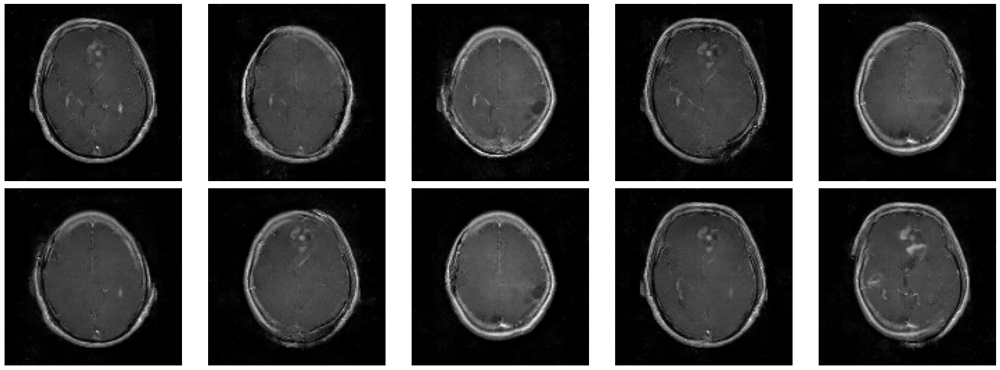

  0%|          | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 1/3750 [00:00<13:33,  4.61it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 2/3750 [00:00<12:37,  4.95it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 3/3750 [00:00<12:34,  4.97it/s]

1/1 [==============================] - 0s 43ms/step


  0%|          | 4/3750 [00:00<13:38,  4.57it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 5/3750 [00:01<12:42,  4.91it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 6/3750 [00:01<12:39,  4.93it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 7/3750 [00:01<12:51,  4.85it/s]

1/1 [==============================] - 0s 41ms/step


  0%|          | 8/3750 [00:01<13:06,  4.76it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 9/3750 [00:01<12:56,  4.82it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 10/3750 [00:02<12:44,  4.89it/s]

1/1 [==============================] - 0s 48ms/step


  0%|          | 11/3750 [00:02<13:07,  4.75it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 12/3750 [00:02<12:57,  4.80it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 13/3750 [00:02<12:54,  4.83it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 14/3750 [00:02<12:57,  4.80it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 15/3750 [00:03<12:35,  4.94it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 16/3750 [00:03<12:31,  4.97it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 17/3750 [00:03<12:23,  5.02it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 18/3750 [00:03<12:26,  5.00it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 19/3750 [00:03<12:01,  5.17it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 20/3750 [00:04<12:22,  5.03it/s]

1/1 [==============================] - 0s 50ms/step


  1%|          | 21/3750 [00:04<13:10,  4.72it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 22/3750 [00:04<12:24,  5.01it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 23/3750 [00:04<11:45,  5.28it/s]

1/1 [==============================] - 0s 37ms/step


  1%|          | 24/3750 [00:04<12:37,  4.92it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 25/3750 [00:05<12:31,  4.96it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 26/3750 [00:05<13:05,  4.74it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 27/3750 [00:05<12:41,  4.89it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 28/3750 [00:05<12:36,  4.92it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 29/3750 [00:05<12:33,  4.94it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 30/3750 [00:06<12:43,  4.88it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 31/3750 [00:06<12:18,  5.04it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 32/3750 [00:06<12:35,  4.92it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 33/3750 [00:06<11:54,  5.20it/s]

1/1 [==============================] - 0s 35ms/step


  1%|          | 34/3750 [00:06<11:40,  5.31it/s]

1/1 [==============================] - 0s 36ms/step


  1%|          | 35/3750 [00:07<12:12,  5.07it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 36/3750 [00:07<12:10,  5.08it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 37/3750 [00:07<12:19,  5.02it/s]

1/1 [==============================] - 0s 46ms/step


  1%|          | 38/3750 [00:07<12:45,  4.85it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 39/3750 [00:07<12:35,  4.91it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 40/3750 [00:08<11:50,  5.22it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 41/3750 [00:08<12:16,  5.04it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 42/3750 [00:08<11:52,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 43/3750 [00:08<12:03,  5.12it/s]

1/1 [==============================] - 0s 34ms/step


  1%|          | 44/3750 [00:08<12:23,  4.98it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 45/3750 [00:09<12:22,  4.99it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 46/3750 [00:09<12:01,  5.13it/s]

1/1 [==============================] - 0s 31ms/step


  1%|▏         | 47/3750 [00:09<12:08,  5.08it/s]

1/1 [==============================] - 0s 50ms/step


  1%|▏         | 48/3750 [00:09<12:38,  4.88it/s]

1/1 [==============================] - 0s 27ms/step


  1%|▏         | 49/3750 [00:09<12:30,  4.93it/s]

1/1 [==============================] - 0s 27ms/step


  1%|▏         | 50/3750 [00:10<11:47,  5.23it/s]

1/1 [==============================] - 0s 39ms/step


  1%|▏         | 51/3750 [00:10<13:04,  4.71it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 52/3750 [00:10<12:03,  5.11it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 53/3750 [00:10<12:18,  5.00it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 54/3750 [00:10<11:55,  5.16it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 55/3750 [00:11<12:12,  5.04it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 56/3750 [00:11<12:03,  5.11it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 57/3750 [00:11<11:33,  5.32it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 58/3750 [00:11<11:21,  5.42it/s]

1/1 [==============================] - 0s 49ms/step


  2%|▏         | 59/3750 [00:11<12:15,  5.02it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 60/3750 [00:12<12:20,  4.98it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 61/3750 [00:12<11:54,  5.16it/s]

1/1 [==============================] - 0s 37ms/step


  2%|▏         | 62/3750 [00:12<12:20,  4.98it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 63/3750 [00:12<11:38,  5.27it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 64/3750 [00:12<11:02,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 65/3750 [00:12<10:31,  5.83it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 66/3750 [00:13<10:43,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 67/3750 [00:13<10:24,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 68/3750 [00:13<10:07,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 69/3750 [00:13<10:44,  5.71it/s]

1/1 [==============================] - 0s 34ms/step


  2%|▏         | 70/3750 [00:13<10:20,  5.93it/s]

1/1 [==============================] - 0s 33ms/step


  2%|▏         | 71/3750 [00:13<10:27,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 72/3750 [00:14<10:07,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 73/3750 [00:14<10:39,  5.75it/s]

1/1 [==============================] - 0s 33ms/step


  2%|▏         | 74/3750 [00:14<10:49,  5.66it/s]

1/1 [==============================] - 0s 36ms/step


  2%|▏         | 75/3750 [00:14<10:50,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 76/3750 [00:14<10:54,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 77/3750 [00:14<10:48,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 78/3750 [00:15<10:54,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 79/3750 [00:15<10:28,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 80/3750 [00:15<10:35,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 81/3750 [00:15<09:51,  6.20it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 82/3750 [00:15<10:22,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 83/3750 [00:15<10:07,  6.04it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 84/3750 [00:16<10:01,  6.10it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 85/3750 [00:16<10:05,  6.05it/s]

1/1 [==============================] - 0s 42ms/step


  2%|▏         | 86/3750 [00:16<10:18,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 87/3750 [00:16<10:51,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 88/3750 [00:16<10:21,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 89/3750 [00:17<10:29,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 90/3750 [00:17<10:19,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 91/3750 [00:17<11:22,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 92/3750 [00:17<10:47,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 93/3750 [00:17<10:11,  5.98it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 94/3750 [00:17<10:00,  6.09it/s]

1/1 [==============================] - 0s 49ms/step


  3%|▎         | 95/3750 [00:18<10:51,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 96/3750 [00:18<10:46,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 97/3750 [00:18<10:16,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 98/3750 [00:18<09:53,  6.15it/s]

1/1 [==============================] - 0s 53ms/step


  3%|▎         | 99/3750 [00:18<10:25,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 100/3750 [00:18<09:45,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 101/3750 [00:19<10:14,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 102/3750 [00:19<10:00,  6.08it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 103/3750 [00:19<10:18,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 104/3750 [00:19<09:56,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 105/3750 [00:19<09:51,  6.16it/s]

1/1 [==============================] - 0s 36ms/step


  3%|▎         | 106/3750 [00:19<10:38,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 107/3750 [00:20<10:20,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 108/3750 [00:20<10:50,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 109/3750 [00:20<10:14,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 110/3750 [00:20<10:00,  6.06it/s]

1/1 [==============================] - 0s 51ms/step


  3%|▎         | 111/3750 [00:20<10:59,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 112/3750 [00:20<10:48,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 113/3750 [00:21<10:26,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 114/3750 [00:21<10:12,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 115/3750 [00:21<10:43,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 116/3750 [00:21<09:55,  6.10it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 117/3750 [00:21<09:40,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 118/3750 [00:21<10:01,  6.04it/s]

1/1 [==============================] - 0s 46ms/step


  3%|▎         | 119/3750 [00:22<11:32,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 120/3750 [00:22<11:25,  5.30it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 121/3750 [00:22<10:57,  5.52it/s]

1/1 [==============================] - 0s 49ms/step


  3%|▎         | 122/3750 [00:22<11:02,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 123/3750 [00:22<11:17,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 124/3750 [00:23<10:47,  5.60it/s]

1/1 [==============================] - 0s 51ms/step


  3%|▎         | 125/3750 [00:23<11:18,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 126/3750 [00:23<10:46,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 127/3750 [00:23<10:17,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 128/3750 [00:23<10:02,  6.01it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 129/3750 [00:23<10:15,  5.89it/s]

1/1 [==============================] - 0s 33ms/step


  3%|▎         | 130/3750 [00:24<10:48,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 131/3750 [00:24<10:20,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 132/3750 [00:24<09:52,  6.10it/s]

1/1 [==============================] - 0s 51ms/step


  4%|▎         | 133/3750 [00:24<11:09,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 134/3750 [00:24<10:30,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 135/3750 [00:24<10:12,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 136/3750 [00:25<10:12,  5.90it/s]

1/1 [==============================] - 0s 38ms/step


  4%|▎         | 137/3750 [00:25<10:31,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 138/3750 [00:25<10:06,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▎         | 139/3750 [00:25<09:51,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 140/3750 [00:25<10:12,  5.90it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▍         | 141/3750 [00:25<10:07,  5.94it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 142/3750 [00:26<09:55,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 143/3750 [00:26<09:37,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 144/3750 [00:26<09:28,  6.34it/s]

1/1 [==============================] - 0s 49ms/step


  4%|▍         | 145/3750 [00:26<09:42,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 146/3750 [00:26<09:21,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 147/3750 [00:26<09:08,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 148/3750 [00:27<09:30,  6.31it/s]

1/1 [==============================] - 0s 45ms/step


  4%|▍         | 149/3750 [00:27<09:57,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 150/3750 [00:27<10:18,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 151/3750 [00:27<09:45,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 152/3750 [00:27<09:54,  6.06it/s]

1/1 [==============================] - 0s 49ms/step


  4%|▍         | 153/3750 [00:27<10:12,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 154/3750 [00:28<09:49,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 155/3750 [00:28<09:23,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 156/3750 [00:28<09:23,  6.38it/s]

1/1 [==============================] - 0s 36ms/step


  4%|▍         | 157/3750 [00:28<10:00,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 158/3750 [00:28<09:28,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 159/3750 [00:28<09:26,  6.34it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▍         | 160/3750 [00:29<09:06,  6.57it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 161/3750 [00:29<09:11,  6.51it/s]

1/1 [==============================] - 0s 41ms/step


  4%|▍         | 162/3750 [00:29<09:35,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 163/3750 [00:29<09:13,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 164/3750 [00:29<09:25,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 165/3750 [00:29<09:06,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 166/3750 [00:29<09:04,  6.58it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▍         | 167/3750 [00:30<10:05,  5.91it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 168/3750 [00:30<10:18,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 169/3750 [00:30<10:16,  5.81it/s]

1/1 [==============================] - 0s 49ms/step


  5%|▍         | 170/3750 [00:30<11:47,  5.06it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 171/3750 [00:30<10:38,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 172/3750 [00:31<10:14,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 173/3750 [00:31<10:00,  5.95it/s]

1/1 [==============================] - 0s 40ms/step


  5%|▍         | 174/3750 [00:31<10:09,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 175/3750 [00:31<10:19,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 176/3750 [00:31<09:51,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 177/3750 [00:31<09:26,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▍         | 178/3750 [00:32<09:28,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 179/3750 [00:32<09:06,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▍         | 180/3750 [00:32<08:57,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 181/3750 [00:32<09:40,  6.15it/s]

1/1 [==============================] - 0s 56ms/step


  5%|▍         | 182/3750 [00:32<10:14,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 183/3750 [00:32<09:40,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 184/3750 [00:32<09:41,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


  5%|▍         | 185/3750 [00:33<15:12,  3.91it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 186/3750 [00:33<13:15,  4.48it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 187/3750 [00:33<11:56,  4.97it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 188/3750 [00:33<11:33,  5.13it/s]

1/1 [==============================] - 0s 35ms/step


  5%|▌         | 189/3750 [00:34<10:53,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 190/3750 [00:34<10:07,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 191/3750 [00:34<09:48,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 192/3750 [00:34<10:16,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▌         | 193/3750 [00:34<10:45,  5.51it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▌         | 194/3750 [00:34<10:15,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 195/3750 [00:35<09:54,  5.98it/s]

1/1 [==============================] - 0s 32ms/step


  5%|▌         | 196/3750 [00:35<09:42,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 197/3750 [00:35<09:42,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 198/3750 [00:35<09:27,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▌         | 199/3750 [00:35<09:07,  6.49it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▌         | 200/3750 [00:35<08:58,  6.59it/s]

1/1 [==============================] - 0s 43ms/step


  5%|▌         | 201/3750 [00:36<09:54,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 202/3750 [00:36<09:25,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 203/3750 [00:36<10:02,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 204/3750 [00:36<10:11,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 205/3750 [00:36<10:25,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 206/3750 [00:36<10:08,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 207/3750 [00:37<10:09,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 208/3750 [00:37<09:53,  5.97it/s]

1/1 [==============================] - 0s 52ms/step


  6%|▌         | 209/3750 [00:37<10:27,  5.65it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 210/3750 [00:37<10:09,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 211/3750 [00:37<09:53,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 212/3750 [00:37<09:45,  6.05it/s]

1/1 [==============================] - 0s 39ms/step


  6%|▌         | 213/3750 [00:38<09:49,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 214/3750 [00:38<09:32,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 215/3750 [00:38<10:04,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 216/3750 [00:38<09:46,  6.03it/s]

1/1 [==============================] - 0s 46ms/step


  6%|▌         | 217/3750 [00:38<11:07,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 218/3750 [00:39<11:11,  5.26it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 219/3750 [00:39<11:13,  5.25it/s]

1/1 [==============================] - 0s 46ms/step


  6%|▌         | 220/3750 [00:39<11:07,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 221/3750 [00:39<10:20,  5.69it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 222/3750 [00:39<09:54,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 223/3750 [00:39<09:20,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 224/3750 [00:39<09:36,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 225/3750 [00:40<09:40,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 226/3750 [00:40<09:33,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 227/3750 [00:40<09:16,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 228/3750 [00:40<09:14,  6.36it/s]

1/1 [==============================] - 0s 35ms/step


  6%|▌         | 229/3750 [00:40<09:10,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 230/3750 [00:40<09:25,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 231/3750 [00:41<09:40,  6.06it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 232/3750 [00:41<09:11,  6.38it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 233/3750 [00:41<09:15,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 234/3750 [00:41<09:12,  6.36it/s]

1/1 [==============================] - 0s 42ms/step


  6%|▋         | 235/3750 [00:41<09:33,  6.13it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▋         | 236/3750 [00:41<09:25,  6.21it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▋         | 237/3750 [00:42<09:26,  6.20it/s]

1/1 [==============================] - 0s 47ms/step


  6%|▋         | 238/3750 [00:42<10:09,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 239/3750 [00:42<09:45,  6.00it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▋         | 240/3750 [00:42<09:39,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▋         | 241/3750 [00:42<10:31,  5.55it/s]

1/1 [==============================] - 0s 39ms/step


  6%|▋         | 242/3750 [00:42<10:23,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 243/3750 [00:43<09:48,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 244/3750 [00:43<09:34,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 245/3750 [00:43<09:28,  6.16it/s]

1/1 [==============================] - 0s 58ms/step


  7%|▋         | 246/3750 [00:43<10:18,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 247/3750 [00:43<10:13,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 248/3750 [00:43<09:48,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 249/3750 [00:44<09:41,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 250/3750 [00:44<09:35,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 251/3750 [00:44<09:59,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 252/3750 [00:44<09:24,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 253/3750 [00:44<09:58,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 254/3750 [00:44<10:05,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 255/3750 [00:45<09:47,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 256/3750 [00:45<09:31,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 257/3750 [00:45<09:22,  6.21it/s]

1/1 [==============================] - 0s 48ms/step


  7%|▋         | 258/3750 [00:45<10:28,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 259/3750 [00:45<09:58,  5.84it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 260/3750 [00:45<09:32,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 261/3750 [00:46<09:53,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 262/3750 [00:46<09:52,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 263/3750 [00:46<09:17,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 264/3750 [00:46<09:08,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 265/3750 [00:46<09:14,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 266/3750 [00:46<09:18,  6.23it/s]

1/1 [==============================] - 0s 46ms/step


  7%|▋         | 267/3750 [00:47<09:50,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 268/3750 [00:47<09:25,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 269/3750 [00:47<09:08,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 270/3750 [00:47<09:25,  6.15it/s]

1/1 [==============================] - 0s 38ms/step


  7%|▋         | 271/3750 [00:47<09:33,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 272/3750 [00:47<09:22,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 273/3750 [00:48<09:48,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 274/3750 [00:48<09:34,  6.05it/s]

1/1 [==============================] - 0s 50ms/step


  7%|▋         | 275/3750 [00:48<09:55,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 276/3750 [00:48<09:43,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 277/3750 [00:48<09:11,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 278/3750 [00:48<09:47,  5.91it/s]

1/1 [==============================] - 0s 34ms/step


  7%|▋         | 279/3750 [00:49<09:40,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 280/3750 [00:49<09:38,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 281/3750 [00:49<10:11,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 282/3750 [00:49<10:23,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 283/3750 [00:49<10:41,  5.40it/s]

1/1 [==============================] - 0s 32ms/step


  8%|▊         | 284/3750 [00:50<10:20,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 285/3750 [00:50<10:26,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 286/3750 [00:50<09:53,  5.84it/s]

1/1 [==============================] - 0s 34ms/step


  8%|▊         | 287/3750 [00:50<09:58,  5.79it/s]

1/1 [==============================] - 0s 46ms/step


  8%|▊         | 288/3750 [00:50<10:53,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 289/3750 [00:50<10:49,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 290/3750 [00:51<10:13,  5.64it/s]

1/1 [==============================] - 0s 37ms/step


  8%|▊         | 291/3750 [00:51<11:11,  5.15it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 292/3750 [00:51<10:30,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 293/3750 [00:51<10:05,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 294/3750 [00:51<09:47,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 295/3750 [00:51<09:46,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 296/3750 [00:52<10:04,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 297/3750 [00:52<10:12,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 298/3750 [00:52<10:08,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 299/3750 [00:52<10:03,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 300/3750 [00:52<09:37,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 301/3750 [00:52<09:15,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 302/3750 [00:53<09:50,  5.84it/s]

1/1 [==============================] - 0s 57ms/step


  8%|▊         | 303/3750 [00:53<10:03,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 304/3750 [00:53<09:42,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 305/3750 [00:53<09:34,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 306/3750 [00:53<09:26,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 307/3750 [00:54<09:54,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 308/3750 [00:54<09:30,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 309/3750 [00:54<09:03,  6.33it/s]

1/1 [==============================] - 0s 48ms/step


  8%|▊         | 310/3750 [00:54<10:16,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 311/3750 [00:54<09:41,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 312/3750 [00:54<09:21,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 313/3750 [00:54<09:04,  6.31it/s]

1/1 [==============================] - 0s 34ms/step


  8%|▊         | 314/3750 [00:55<09:25,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 315/3750 [00:55<09:55,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 316/3750 [00:55<09:25,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 317/3750 [00:55<09:05,  6.30it/s]

1/1 [==============================] - 0s 32ms/step


  8%|▊         | 318/3750 [00:55<09:01,  6.34it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▊         | 319/3750 [00:55<08:37,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 320/3750 [00:56<08:31,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 321/3750 [00:56<08:31,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 322/3750 [00:56<08:24,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 323/3750 [00:56<08:37,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 324/3750 [00:56<09:21,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 325/3750 [00:56<09:48,  5.82it/s]

1/1 [==============================] - 0s 38ms/step


  9%|▊         | 326/3750 [00:57<10:05,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 327/3750 [00:57<10:40,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▊         | 328/3750 [00:57<10:02,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 329/3750 [00:57<09:31,  5.99it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▉         | 330/3750 [00:57<09:48,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 331/3750 [00:57<09:56,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 332/3750 [00:58<09:34,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 333/3750 [00:58<09:19,  6.10it/s]

1/1 [==============================] - 0s 55ms/step


  9%|▉         | 334/3750 [00:58<10:04,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 335/3750 [00:58<09:59,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 336/3750 [00:58<10:19,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 337/3750 [00:59<09:59,  5.69it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 338/3750 [00:59<10:26,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 339/3750 [00:59<10:37,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 340/3750 [00:59<10:22,  5.48it/s]

1/1 [==============================] - 0s 54ms/step


  9%|▉         | 341/3750 [00:59<11:17,  5.03it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 342/3750 [00:59<10:28,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 343/3750 [01:00<10:04,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 344/3750 [01:00<09:54,  5.73it/s]

1/1 [==============================] - 0s 55ms/step


  9%|▉         | 345/3750 [01:00<10:42,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 346/3750 [01:00<10:23,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 347/3750 [01:00<10:25,  5.44it/s]

1/1 [==============================] - 0s 35ms/step


  9%|▉         | 348/3750 [01:01<10:01,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 349/3750 [01:01<09:44,  5.82it/s]

1/1 [==============================] - 0s 39ms/step


  9%|▉         | 350/3750 [01:01<10:02,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 351/3750 [01:01<09:34,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 352/3750 [01:01<09:20,  6.06it/s]

1/1 [==============================] - 0s 47ms/step


  9%|▉         | 353/3750 [01:01<09:36,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 354/3750 [01:02<09:58,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 355/3750 [01:02<09:22,  6.03it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 356/3750 [01:02<09:38,  5.87it/s]

1/1 [==============================] - 0s 35ms/step


 10%|▉         | 357/3750 [01:02<09:30,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 358/3750 [01:02<09:06,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 359/3750 [01:02<08:44,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 360/3750 [01:02<08:38,  6.54it/s]

1/1 [==============================] - 0s 29ms/step


 10%|▉         | 361/3750 [01:03<08:27,  6.67it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 362/3750 [01:03<08:32,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 363/3750 [01:03<08:58,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 364/3750 [01:03<08:45,  6.45it/s]

1/1 [==============================] - 0s 35ms/step


 10%|▉         | 365/3750 [01:03<08:43,  6.47it/s]

1/1 [==============================] - 0s 46ms/step


 10%|▉         | 366/3750 [01:03<09:15,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 367/3750 [01:04<09:13,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 10%|▉         | 368/3750 [01:04<08:51,  6.36it/s]

1/1 [==============================] - 0s 27ms/step


 10%|▉         | 369/3750 [01:04<08:49,  6.39it/s]

1/1 [==============================] - 0s 35ms/step


 10%|▉         | 370/3750 [01:04<09:02,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 371/3750 [01:04<08:49,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 372/3750 [01:04<08:31,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 373/3750 [01:05<08:28,  6.65it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 374/3750 [01:05<09:08,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 375/3750 [01:05<09:07,  6.17it/s]

1/1 [==============================] - 0s 35ms/step


 10%|█         | 376/3750 [01:05<09:34,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 377/3750 [01:05<09:20,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 378/3750 [01:05<09:31,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 379/3750 [01:06<09:42,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 380/3750 [01:06<09:10,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 381/3750 [01:06<08:58,  6.25it/s]

1/1 [==============================] - 0s 36ms/step


 10%|█         | 382/3750 [01:06<09:47,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 383/3750 [01:06<09:45,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 384/3750 [01:06<10:03,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 385/3750 [01:07<09:29,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 386/3750 [01:07<09:15,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 387/3750 [01:07<10:02,  5.58it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 388/3750 [01:07<10:02,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 389/3750 [01:07<09:47,  5.72it/s]

1/1 [==============================] - 0s 53ms/step


 10%|█         | 390/3750 [01:07<10:11,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 391/3750 [01:08<09:37,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 392/3750 [01:08<09:18,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 393/3750 [01:08<09:06,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 394/3750 [01:08<09:39,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 395/3750 [01:08<09:04,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 396/3750 [01:08<08:58,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 397/3750 [01:09<08:57,  6.23it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 398/3750 [01:09<08:47,  6.35it/s]

1/1 [==============================] - 0s 33ms/step


 11%|█         | 399/3750 [01:09<09:28,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 400/3750 [01:09<09:44,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 401/3750 [01:09<09:19,  5.99it/s]

1/1 [==============================] - 0s 48ms/step


 11%|█         | 402/3750 [01:09<09:53,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 403/3750 [01:10<09:50,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 404/3750 [01:10<10:02,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 405/3750 [01:10<09:41,  5.75it/s]

1/1 [==============================] - 0s 49ms/step


 11%|█         | 406/3750 [01:10<10:10,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 407/3750 [01:10<09:29,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 408/3750 [01:10<09:01,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 409/3750 [01:11<08:59,  6.19it/s]

1/1 [==============================] - 0s 33ms/step


 11%|█         | 410/3750 [01:11<09:37,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 411/3750 [01:11<10:23,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 412/3750 [01:11<10:17,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 413/3750 [01:11<09:53,  5.62it/s]

1/1 [==============================] - 0s 37ms/step


 11%|█         | 414/3750 [01:12<10:14,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 415/3750 [01:12<09:38,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 416/3750 [01:12<09:26,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 417/3750 [01:12<09:14,  6.01it/s]

1/1 [==============================] - 0s 44ms/step


 11%|█         | 418/3750 [01:12<11:03,  5.02it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 419/3750 [01:13<10:31,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 420/3750 [01:13<09:55,  5.59it/s]

1/1 [==============================] - 0s 51ms/step


 11%|█         | 421/3750 [01:13<10:23,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█▏        | 422/3750 [01:13<10:09,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 423/3750 [01:13<09:39,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 424/3750 [01:13<09:32,  5.81it/s]

1/1 [==============================] - 0s 35ms/step


 11%|█▏        | 425/3750 [01:14<09:29,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 426/3750 [01:14<09:11,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 427/3750 [01:14<09:09,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 428/3750 [01:14<09:04,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 429/3750 [01:14<09:32,  5.80it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█▏        | 430/3750 [01:14<09:37,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█▏        | 431/3750 [01:15<09:10,  6.03it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 432/3750 [01:15<08:39,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 433/3750 [01:15<08:42,  6.35it/s]

1/1 [==============================] - 0s 45ms/step


 12%|█▏        | 434/3750 [01:15<09:15,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 435/3750 [01:15<09:39,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 436/3750 [01:15<09:06,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 437/3750 [01:16<08:59,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 438/3750 [01:16<09:14,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 439/3750 [01:16<09:20,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 440/3750 [01:16<08:57,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 441/3750 [01:16<08:45,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 442/3750 [01:16<08:55,  6.18it/s]

1/1 [==============================] - 0s 37ms/step


 12%|█▏        | 443/3750 [01:17<09:31,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 444/3750 [01:17<09:39,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 445/3750 [01:17<09:29,  5.81it/s]

1/1 [==============================] - 0s 50ms/step


 12%|█▏        | 446/3750 [01:17<09:57,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 447/3750 [01:17<10:08,  5.42it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 448/3750 [01:17<09:45,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 449/3750 [01:18<09:24,  5.84it/s]

1/1 [==============================] - 0s 52ms/step


 12%|█▏        | 450/3750 [01:18<09:30,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 451/3750 [01:18<08:58,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 452/3750 [01:18<08:39,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 453/3750 [01:18<08:56,  6.14it/s]

1/1 [==============================] - 0s 38ms/step


 12%|█▏        | 454/3750 [01:18<09:03,  6.06it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 455/3750 [01:19<09:20,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 456/3750 [01:19<08:59,  6.11it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 457/3750 [01:19<08:54,  6.16it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 458/3750 [01:19<08:50,  6.20it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 459/3750 [01:19<08:48,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 460/3750 [01:19<08:40,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 461/3750 [01:20<08:32,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 462/3750 [01:20<08:36,  6.36it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 463/3750 [01:20<08:24,  6.51it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 464/3750 [01:20<08:20,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 465/3750 [01:20<08:08,  6.73it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 466/3750 [01:20<07:59,  6.84it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 467/3750 [01:20<07:57,  6.87it/s]

1/1 [==============================] - 0s 36ms/step


 12%|█▏        | 468/3750 [01:21<08:45,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 469/3750 [01:21<09:07,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 470/3750 [01:21<08:50,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 471/3750 [01:21<08:33,  6.39it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 472/3750 [01:21<08:24,  6.50it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 473/3750 [01:21<08:37,  6.33it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 474/3750 [01:22<08:51,  6.17it/s]

1/1 [==============================] - 0s 53ms/step


 13%|█▎        | 475/3750 [01:22<09:28,  5.76it/s]

1/1 [==============================] - 0s 61ms/step


 13%|█▎        | 476/3750 [01:22<10:06,  5.40it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 477/3750 [01:22<09:39,  5.64it/s]

1/1 [==============================] - 0s 36ms/step


 13%|█▎        | 478/3750 [01:22<09:32,  5.72it/s]

1/1 [==============================] - 0s 34ms/step


 13%|█▎        | 479/3750 [01:22<10:02,  5.43it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 480/3750 [01:23<09:48,  5.56it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 481/3750 [01:23<09:54,  5.50it/s]

1/1 [==============================] - 0s 39ms/step


 13%|█▎        | 482/3750 [01:23<10:07,  5.38it/s]

1/1 [==============================] - 0s 48ms/step


 13%|█▎        | 483/3750 [01:23<11:08,  4.88it/s]

1/1 [==============================] - 0s 51ms/step


 13%|█▎        | 484/3750 [01:24<11:31,  4.72it/s]

1/1 [==============================] - 0s 41ms/step


 13%|█▎        | 485/3750 [01:24<11:19,  4.80it/s]

1/1 [==============================] - 0s 50ms/step


 13%|█▎        | 486/3750 [01:24<11:34,  4.70it/s]

1/1 [==============================] - 0s 38ms/step


 13%|█▎        | 487/3750 [01:24<11:11,  4.86it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 488/3750 [01:24<10:56,  4.97it/s]

1/1 [==============================] - 0s 34ms/step


 13%|█▎        | 489/3750 [01:25<10:50,  5.01it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 490/3750 [01:25<10:32,  5.16it/s]

1/1 [==============================] - 0s 61ms/step


 13%|█▎        | 491/3750 [01:25<10:48,  5.03it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 492/3750 [01:25<10:26,  5.20it/s]

1/1 [==============================] - 0s 54ms/step


 13%|█▎        | 493/3750 [01:25<10:39,  5.09it/s]

1/1 [==============================] - 0s 38ms/step


 13%|█▎        | 494/3750 [01:25<10:38,  5.10it/s]

1/1 [==============================] - 0s 59ms/step


 13%|█▎        | 495/3750 [01:26<10:58,  4.95it/s]

1/1 [==============================] - 0s 47ms/step


 13%|█▎        | 496/3750 [01:26<11:01,  4.92it/s]

1/1 [==============================] - 0s 34ms/step


 13%|█▎        | 497/3750 [01:26<10:38,  5.10it/s]

1/1 [==============================] - 0s 59ms/step


 13%|█▎        | 498/3750 [01:26<11:09,  4.86it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 499/3750 [01:27<10:55,  4.96it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 500/3750 [01:27<11:23,  4.76it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 501/3750 [01:27<10:34,  5.12it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 502/3750 [01:27<10:34,  5.12it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 503/3750 [01:27<10:33,  5.12it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 504/3750 [01:27<09:59,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 505/3750 [01:28<09:36,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 506/3750 [01:28<09:28,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▎        | 507/3750 [01:28<09:22,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 508/3750 [01:28<09:57,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 509/3750 [01:28<10:06,  5.34it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 510/3750 [01:29<09:31,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▎        | 511/3750 [01:29<09:21,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▎        | 512/3750 [01:29<09:18,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▎        | 513/3750 [01:29<09:39,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▎        | 514/3750 [01:29<09:56,  5.42it/s]

1/1 [==============================] - 0s 37ms/step


 14%|█▎        | 515/3750 [01:29<09:58,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 516/3750 [01:30<09:31,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 517/3750 [01:30<09:06,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 518/3750 [01:30<09:29,  5.67it/s]

1/1 [==============================] - 0s 37ms/step


 14%|█▍        | 519/3750 [01:30<09:29,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 520/3750 [01:30<09:21,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 521/3750 [01:30<09:02,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 522/3750 [01:31<08:42,  6.18it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▍        | 523/3750 [01:31<09:13,  5.84it/s]

1/1 [==============================] - 0s 56ms/step


 14%|█▍        | 524/3750 [01:31<09:44,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 525/3750 [01:31<09:15,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 526/3750 [01:31<09:08,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 527/3750 [01:31<09:01,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 528/3750 [01:32<09:03,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 529/3750 [01:32<08:57,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 530/3750 [01:32<08:47,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 531/3750 [01:32<08:33,  6.26it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▍        | 532/3750 [01:32<09:19,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 533/3750 [01:32<09:44,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 534/3750 [01:33<09:21,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 535/3750 [01:33<09:05,  5.89it/s]

1/1 [==============================] - 0s 56ms/step


 14%|█▍        | 536/3750 [01:33<10:10,  5.26it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 537/3750 [01:33<09:33,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 538/3750 [01:33<09:17,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 539/3750 [01:34<09:05,  5.88it/s]

1/1 [==============================] - 0s 49ms/step


 14%|█▍        | 540/3750 [01:34<09:58,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 541/3750 [01:34<09:29,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 542/3750 [01:34<09:16,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 543/3750 [01:34<08:51,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 544/3750 [01:34<09:04,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 545/3750 [01:35<09:13,  5.79it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 546/3750 [01:35<09:04,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 547/3750 [01:35<08:49,  6.05it/s]

1/1 [==============================] - 0s 52ms/step


 15%|█▍        | 548/3750 [01:35<09:12,  5.79it/s]

1/1 [==============================] - 0s 34ms/step


 15%|█▍        | 549/3750 [01:35<09:01,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 550/3750 [01:35<09:30,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 551/3750 [01:36<09:18,  5.73it/s]

1/1 [==============================] - 0s 52ms/step


 15%|█▍        | 552/3750 [01:36<09:48,  5.43it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 553/3750 [01:36<09:15,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 554/3750 [01:36<08:52,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 555/3750 [01:36<09:09,  5.81it/s]

1/1 [==============================] - 0s 39ms/step


 15%|█▍        | 556/3750 [01:36<09:17,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 557/3750 [01:37<09:02,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 558/3750 [01:37<08:38,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 559/3750 [01:37<08:35,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 560/3750 [01:37<08:38,  6.16it/s]

1/1 [==============================] - 0s 45ms/step


 15%|█▍        | 561/3750 [01:37<09:41,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 562/3750 [01:37<09:10,  5.79it/s]

1/1 [==============================] - 0s 37ms/step


 15%|█▌        | 563/3750 [01:38<08:45,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 564/3750 [01:38<08:34,  6.19it/s]

1/1 [==============================] - 0s 48ms/step


 15%|█▌        | 565/3750 [01:38<09:00,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 566/3750 [01:38<08:36,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 567/3750 [01:38<08:36,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 568/3750 [01:38<08:15,  6.42it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 569/3750 [01:39<08:34,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 570/3750 [01:39<08:28,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 571/3750 [01:39<08:30,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 572/3750 [01:39<08:06,  6.53it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 573/3750 [01:39<08:09,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 574/3750 [01:39<08:44,  6.06it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 575/3750 [01:40<09:28,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 576/3750 [01:40<09:25,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 577/3750 [01:40<08:57,  5.90it/s]

1/1 [==============================] - 0s 34ms/step


 15%|█▌        | 578/3750 [01:40<09:08,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 579/3750 [01:40<08:59,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 580/3750 [01:40<09:08,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 581/3750 [01:41<09:02,  5.84it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▌        | 582/3750 [01:41<09:00,  5.86it/s]

1/1 [==============================] - 0s 46ms/step


 16%|█▌        | 583/3750 [01:41<09:04,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 584/3750 [01:41<09:25,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 585/3750 [01:41<08:54,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 586/3750 [01:41<08:47,  6.00it/s]

1/1 [==============================] - 0s 34ms/step


 16%|█▌        | 587/3750 [01:42<08:57,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 588/3750 [01:42<08:59,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 589/3750 [01:42<08:42,  6.05it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 590/3750 [01:42<08:33,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 591/3750 [01:42<08:39,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 592/3750 [01:42<09:03,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 593/3750 [01:43<08:34,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 594/3750 [01:43<09:08,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 595/3750 [01:43<08:51,  5.94it/s]

1/1 [==============================] - 0s 55ms/step


 16%|█▌        | 596/3750 [01:43<09:31,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 597/3750 [01:43<08:53,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 598/3750 [01:44<09:02,  5.81it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▌        | 599/3750 [01:44<08:49,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 600/3750 [01:44<08:52,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 601/3750 [01:44<08:33,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 602/3750 [01:44<08:28,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 603/3750 [01:44<08:10,  6.41it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 604/3750 [01:44<08:07,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 605/3750 [01:45<08:09,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 606/3750 [01:45<08:46,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 607/3750 [01:45<09:06,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 608/3750 [01:45<08:53,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 609/3750 [01:45<09:09,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 610/3750 [01:46<09:17,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 611/3750 [01:46<09:31,  5.50it/s]

1/1 [==============================] - 0s 62ms/step


 16%|█▋        | 612/3750 [01:46<10:48,  4.84it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 613/3750 [01:46<10:00,  5.22it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 614/3750 [01:46<09:29,  5.51it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▋        | 615/3750 [01:46<09:14,  5.66it/s]

1/1 [==============================] - 0s 35ms/step


 16%|█▋        | 616/3750 [01:47<09:16,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 617/3750 [01:47<09:35,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 618/3750 [01:47<08:58,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 619/3750 [01:47<08:45,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 620/3750 [01:47<09:12,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 621/3750 [01:48<08:58,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 622/3750 [01:48<08:53,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 623/3750 [01:48<08:42,  5.98it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 624/3750 [01:48<09:10,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 625/3750 [01:48<09:03,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 626/3750 [01:48<08:38,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 627/3750 [01:48<08:29,  6.13it/s]

1/1 [==============================] - 0s 42ms/step


 17%|█▋        | 628/3750 [01:49<08:42,  5.97it/s]

1/1 [==============================] - 0s 50ms/step


 17%|█▋        | 629/3750 [01:49<09:21,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 630/3750 [01:49<09:32,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 631/3750 [01:49<09:00,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 632/3750 [01:49<08:59,  5.78it/s]

1/1 [==============================] - 0s 51ms/step


 17%|█▋        | 633/3750 [01:50<09:55,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 634/3750 [01:50<09:26,  5.50it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 635/3750 [01:50<09:09,  5.67it/s]

1/1 [==============================] - 0s 59ms/step


 17%|█▋        | 636/3750 [01:50<09:55,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 637/3750 [01:50<09:41,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 638/3750 [01:51<09:30,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 639/3750 [01:51<09:04,  5.71it/s]

1/1 [==============================] - 0s 37ms/step


 17%|█▋        | 640/3750 [01:51<09:32,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 641/3750 [01:51<09:05,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 642/3750 [01:51<08:58,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 643/3750 [01:51<09:19,  5.56it/s]

1/1 [==============================] - 0s 53ms/step


 17%|█▋        | 644/3750 [01:52<10:10,  5.09it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 645/3750 [01:52<09:57,  5.20it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 646/3750 [01:52<09:22,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 647/3750 [01:52<09:25,  5.49it/s]

1/1 [==============================] - 0s 36ms/step


 17%|█▋        | 648/3750 [01:52<09:45,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 649/3750 [01:53<09:05,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 650/3750 [01:53<08:43,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 651/3750 [01:53<08:32,  6.05it/s]

1/1 [==============================] - 0s 37ms/step


 17%|█▋        | 652/3750 [01:53<08:43,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 653/3750 [01:53<08:27,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 654/3750 [01:53<08:13,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 655/3750 [01:53<07:55,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 656/3750 [01:54<07:49,  6.59it/s]

1/1 [==============================] - 0s 51ms/step


 18%|█▊        | 657/3750 [01:54<08:37,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 658/3750 [01:54<08:23,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 659/3750 [01:54<08:07,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 660/3750 [01:54<07:46,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 661/3750 [01:54<08:00,  6.43it/s]

1/1 [==============================] - 0s 38ms/step


 18%|█▊        | 662/3750 [01:55<08:20,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 663/3750 [01:55<08:15,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 664/3750 [01:55<08:23,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 665/3750 [01:55<08:52,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 666/3750 [01:55<08:59,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 667/3750 [01:55<08:43,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 668/3750 [01:56<08:21,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 669/3750 [01:56<08:11,  6.26it/s]

1/1 [==============================] - 0s 33ms/step


 18%|█▊        | 670/3750 [01:56<08:21,  6.14it/s]

1/1 [==============================] - 0s 49ms/step


 18%|█▊        | 671/3750 [01:56<08:42,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 672/3750 [01:56<08:16,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 673/3750 [01:56<08:13,  6.24it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 674/3750 [01:57<08:44,  5.87it/s]

1/1 [==============================] - 0s 32ms/step


 18%|█▊        | 675/3750 [01:57<09:17,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 676/3750 [01:57<09:24,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 677/3750 [01:57<09:00,  5.69it/s]

1/1 [==============================] - 0s 55ms/step


 18%|█▊        | 678/3750 [01:57<09:50,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 679/3750 [01:58<09:31,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 680/3750 [01:58<08:59,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 681/3750 [01:58<09:16,  5.51it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 682/3750 [01:58<08:43,  5.86it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 683/3750 [01:58<08:38,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 684/3750 [01:58<08:25,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 685/3750 [01:59<08:28,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 686/3750 [01:59<08:21,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 687/3750 [01:59<08:53,  5.74it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 688/3750 [01:59<09:02,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 689/3750 [01:59<08:35,  5.94it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 690/3750 [01:59<08:50,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 691/3750 [02:00<08:21,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 692/3750 [02:00<08:00,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 693/3750 [02:00<07:56,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 694/3750 [02:00<08:05,  6.29it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▊        | 695/3750 [02:00<08:09,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 696/3750 [02:00<07:59,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 697/3750 [02:00<07:56,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 698/3750 [02:01<08:00,  6.35it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▊        | 699/3750 [02:01<08:22,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 700/3750 [02:01<08:16,  6.15it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▊        | 701/3750 [02:01<08:17,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 702/3750 [02:01<08:10,  6.21it/s]

1/1 [==============================] - 0s 53ms/step


 19%|█▊        | 703/3750 [02:01<08:40,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 704/3750 [02:02<08:45,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 705/3750 [02:02<08:27,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 706/3750 [02:02<08:26,  6.01it/s]

1/1 [==============================] - 0s 45ms/step


 19%|█▉        | 707/3750 [02:02<09:25,  5.38it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 708/3750 [02:02<08:57,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 709/3750 [02:03<08:48,  5.76it/s]

1/1 [==============================] - 0s 36ms/step


 19%|█▉        | 710/3750 [02:03<09:12,  5.50it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 711/3750 [02:03<08:44,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 712/3750 [02:03<08:27,  5.98it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▉        | 713/3750 [02:03<08:56,  5.66it/s]

1/1 [==============================] - 0s 37ms/step


 19%|█▉        | 714/3750 [02:03<09:04,  5.57it/s]

1/1 [==============================] - 0s 41ms/step


 19%|█▉        | 715/3750 [02:04<09:03,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 716/3750 [02:04<08:39,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 717/3750 [02:04<08:47,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 718/3750 [02:04<09:12,  5.48it/s]

1/1 [==============================] - 0s 38ms/step


 19%|█▉        | 719/3750 [02:04<09:41,  5.21it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 720/3750 [02:05<09:10,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 721/3750 [02:05<08:50,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 722/3750 [02:05<08:44,  5.77it/s]

1/1 [==============================] - 0s 51ms/step


 19%|█▉        | 723/3750 [02:05<08:57,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 724/3750 [02:05<08:46,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 725/3750 [02:05<09:12,  5.48it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 726/3750 [02:06<09:09,  5.50it/s]

1/1 [==============================] - 0s 38ms/step


 19%|█▉        | 727/3750 [02:06<09:28,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 728/3750 [02:06<09:02,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 729/3750 [02:06<08:34,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 730/3750 [02:06<09:04,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 731/3750 [02:06<08:49,  5.70it/s]

1/1 [==============================] - 0s 35ms/step


 20%|█▉        | 732/3750 [02:07<08:39,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 733/3750 [02:07<08:18,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 734/3750 [02:07<08:06,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 735/3750 [02:07<07:59,  6.29it/s]

1/1 [==============================] - 0s 55ms/step


 20%|█▉        | 736/3750 [02:07<08:58,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


 20%|█▉        | 737/3750 [02:07<09:09,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 738/3750 [02:08<09:28,  5.30it/s]

1/1 [==============================] - 0s 39ms/step


 20%|█▉        | 739/3750 [02:08<09:16,  5.41it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 740/3750 [02:08<08:45,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 741/3750 [02:08<08:29,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 742/3750 [02:08<08:08,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 743/3750 [02:08<08:24,  5.95it/s]

1/1 [==============================] - 0s 30ms/step


 20%|█▉        | 744/3750 [02:09<08:37,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 745/3750 [02:09<08:55,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 746/3750 [02:09<08:30,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 747/3750 [02:09<08:27,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 748/3750 [02:09<08:09,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 749/3750 [02:09<08:08,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 750/3750 [02:10<08:14,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 751/3750 [02:10<08:06,  6.16it/s]

1/1 [==============================] - 0s 32ms/step


 20%|██        | 752/3750 [02:10<08:02,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 753/3750 [02:10<07:55,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 754/3750 [02:10<07:53,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 755/3750 [02:10<07:56,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 756/3750 [02:11<07:54,  6.31it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 757/3750 [02:11<07:57,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 758/3750 [02:11<07:48,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 759/3750 [02:11<07:32,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 760/3750 [02:11<07:26,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 761/3750 [02:11<07:34,  6.58it/s]

1/1 [==============================] - 0s 33ms/step


 20%|██        | 762/3750 [02:12<07:44,  6.43it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 763/3750 [02:12<07:50,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 764/3750 [02:12<07:37,  6.53it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 765/3750 [02:12<07:43,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 766/3750 [02:12<07:50,  6.34it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 767/3750 [02:12<07:47,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 768/3750 [02:12<07:43,  6.44it/s]

1/1 [==============================] - 0s 31ms/step


 21%|██        | 769/3750 [02:13<07:44,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 770/3750 [02:13<07:40,  6.46it/s]

1/1 [==============================] - 0s 37ms/step


 21%|██        | 771/3750 [02:13<08:20,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 772/3750 [02:13<08:06,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 773/3750 [02:13<07:49,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 774/3750 [02:13<07:45,  6.39it/s]

1/1 [==============================] - 0s 41ms/step


 21%|██        | 775/3750 [02:14<08:24,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 776/3750 [02:14<08:19,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 777/3750 [02:14<08:08,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 778/3750 [02:14<07:55,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 779/3750 [02:14<07:57,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 780/3750 [02:14<07:58,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 781/3750 [02:15<07:45,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 782/3750 [02:15<08:11,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 783/3750 [02:15<08:05,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 784/3750 [02:15<08:14,  6.00it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██        | 785/3750 [02:15<08:14,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 786/3750 [02:15<08:21,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 787/3750 [02:16<08:26,  5.85it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██        | 788/3750 [02:16<09:08,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 789/3750 [02:16<08:36,  5.73it/s]

1/1 [==============================] - 0s 32ms/step


 21%|██        | 790/3750 [02:16<09:11,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 791/3750 [02:16<08:45,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 792/3750 [02:17<09:08,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 793/3750 [02:17<09:12,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 794/3750 [02:17<08:42,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 795/3750 [02:17<08:26,  5.83it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 796/3750 [02:17<08:19,  5.91it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██▏       | 797/3750 [02:17<08:39,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██▏       | 798/3750 [02:18<08:57,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 799/3750 [02:18<09:14,  5.32it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██▏       | 800/3750 [02:18<09:39,  5.09it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██▏       | 801/3750 [02:18<09:39,  5.09it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 802/3750 [02:18<09:24,  5.23it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██▏       | 803/3750 [02:19<08:57,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 804/3750 [02:19<09:05,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 805/3750 [02:19<08:38,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 806/3750 [02:19<08:30,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 807/3750 [02:19<08:20,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 808/3750 [02:19<07:57,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 809/3750 [02:20<07:48,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 810/3750 [02:20<08:00,  6.12it/s]

1/1 [==============================] - 0s 39ms/step


 22%|██▏       | 811/3750 [02:20<08:09,  6.00it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 812/3750 [02:20<08:14,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 813/3750 [02:20<07:49,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 814/3750 [02:20<07:48,  6.26it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 815/3750 [02:20<07:43,  6.34it/s]

1/1 [==============================] - 0s 52ms/step


 22%|██▏       | 816/3750 [02:21<08:54,  5.49it/s]

1/1 [==============================] - 0s 32ms/step


 22%|██▏       | 817/3750 [02:21<09:17,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 818/3750 [02:21<09:05,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 819/3750 [02:21<09:01,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 820/3750 [02:21<08:37,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 821/3750 [02:22<08:15,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 822/3750 [02:22<08:06,  6.02it/s]

1/1 [==============================] - 0s 38ms/step


 22%|██▏       | 823/3750 [02:22<08:16,  5.90it/s]

1/1 [==============================] - 0s 39ms/step


 22%|██▏       | 824/3750 [02:22<08:17,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 825/3750 [02:22<07:56,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 826/3750 [02:22<07:54,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 827/3750 [02:23<07:36,  6.40it/s]

1/1 [==============================] - 0s 37ms/step


 22%|██▏       | 828/3750 [02:23<08:00,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 829/3750 [02:23<07:45,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 830/3750 [02:23<08:11,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 831/3750 [02:23<07:53,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 832/3750 [02:23<07:46,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 833/3750 [02:24<07:37,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 834/3750 [02:24<07:47,  6.24it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 835/3750 [02:24<07:40,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 836/3750 [02:24<07:47,  6.23it/s]

1/1 [==============================] - 0s 34ms/step


 22%|██▏       | 837/3750 [02:24<07:55,  6.13it/s]

1/1 [==============================] - 0s 33ms/step


 22%|██▏       | 838/3750 [02:24<08:40,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 839/3750 [02:25<08:07,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 840/3750 [02:25<07:43,  6.28it/s]

1/1 [==============================] - 0s 37ms/step


 22%|██▏       | 841/3750 [02:25<08:16,  5.86it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 842/3750 [02:25<08:15,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 843/3750 [02:25<07:47,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 844/3750 [02:25<07:33,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 845/3750 [02:25<07:19,  6.60it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 846/3750 [02:26<07:42,  6.28it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 847/3750 [02:26<07:42,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 848/3750 [02:26<07:31,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 849/3750 [02:26<07:26,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 850/3750 [02:26<07:25,  6.51it/s]

1/1 [==============================] - 0s 37ms/step


 23%|██▎       | 851/3750 [02:26<07:39,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 852/3750 [02:27<07:37,  6.34it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 853/3750 [02:27<07:27,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 854/3750 [02:27<07:28,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 855/3750 [02:27<07:35,  6.35it/s]

1/1 [==============================] - 0s 51ms/step


 23%|██▎       | 856/3750 [02:27<08:09,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 857/3750 [02:27<07:44,  6.23it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 858/3750 [02:28<07:25,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 859/3750 [02:28<07:11,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 860/3750 [02:28<07:12,  6.68it/s]

1/1 [==============================] - 0s 59ms/step


 23%|██▎       | 861/3750 [02:28<08:12,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 862/3750 [02:28<08:35,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 863/3750 [02:28<08:18,  5.79it/s]

1/1 [==============================] - 0s 36ms/step


 23%|██▎       | 864/3750 [02:29<08:38,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 865/3750 [02:29<08:17,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 866/3750 [02:29<08:11,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 867/3750 [02:29<08:03,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 868/3750 [02:29<07:56,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 869/3750 [02:29<07:43,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 870/3750 [02:30<07:31,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 871/3750 [02:30<07:29,  6.40it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 872/3750 [02:30<07:31,  6.37it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 873/3750 [02:30<08:18,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 874/3750 [02:30<08:12,  5.84it/s]

1/1 [==============================] - 0s 33ms/step


 23%|██▎       | 875/3750 [02:30<07:53,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 876/3750 [02:31<07:57,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 877/3750 [02:31<07:57,  6.02it/s]

1/1 [==============================] - 0s 48ms/step


 23%|██▎       | 878/3750 [02:31<08:51,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 879/3750 [02:31<08:18,  5.76it/s]

1/1 [==============================] - 0s 33ms/step


 23%|██▎       | 880/3750 [02:31<08:10,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 881/3750 [02:31<08:30,  5.62it/s]

1/1 [==============================] - 0s 37ms/step


 24%|██▎       | 882/3750 [02:32<08:20,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 883/3750 [02:32<07:50,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 884/3750 [02:32<07:44,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 885/3750 [02:32<08:05,  5.90it/s]

1/1 [==============================] - 0s 56ms/step


 24%|██▎       | 886/3750 [02:32<09:06,  5.24it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▎       | 887/3750 [02:33<08:41,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 888/3750 [02:33<08:19,  5.73it/s]

1/1 [==============================] - 0s 35ms/step


 24%|██▎       | 889/3750 [02:33<08:12,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 890/3750 [02:33<08:06,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 891/3750 [02:33<07:43,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 892/3750 [02:33<07:34,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 893/3750 [02:33<07:57,  5.98it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 894/3750 [02:34<07:50,  6.07it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 895/3750 [02:34<07:58,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 896/3750 [02:34<07:49,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 897/3750 [02:34<07:36,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 898/3750 [02:34<07:34,  6.27it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 899/3750 [02:34<07:52,  6.04it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 900/3750 [02:35<07:50,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 901/3750 [02:35<07:44,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 902/3750 [02:35<07:37,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 903/3750 [02:35<07:17,  6.51it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 904/3750 [02:35<08:28,  5.60it/s]

1/1 [==============================] - 0s 36ms/step


 24%|██▍       | 905/3750 [02:35<08:17,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 906/3750 [02:36<08:02,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 907/3750 [02:36<07:49,  6.06it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 908/3750 [02:36<07:46,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 909/3750 [02:36<07:50,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 910/3750 [02:36<08:11,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 911/3750 [02:36<08:15,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 912/3750 [02:37<08:00,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 913/3750 [02:37<08:03,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 914/3750 [02:37<07:44,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 915/3750 [02:37<07:46,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 916/3750 [02:37<07:29,  6.30it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 917/3750 [02:37<07:40,  6.15it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 918/3750 [02:38<07:40,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 919/3750 [02:38<07:31,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 920/3750 [02:38<07:51,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 921/3750 [02:38<07:39,  6.16it/s]

1/1 [==============================] - 0s 36ms/step


 25%|██▍       | 922/3750 [02:38<07:41,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 923/3750 [02:38<07:49,  6.02it/s]

1/1 [==============================] - 0s 39ms/step


 25%|██▍       | 924/3750 [02:39<08:08,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 925/3750 [02:39<07:46,  6.06it/s]

1/1 [==============================] - 0s 37ms/step


 25%|██▍       | 926/3750 [02:39<08:23,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 927/3750 [02:39<08:31,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 928/3750 [02:39<08:11,  5.74it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▍       | 929/3750 [02:39<07:52,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 930/3750 [02:40<07:38,  6.15it/s]

1/1 [==============================] - 0s 33ms/step


 25%|██▍       | 931/3750 [02:40<07:39,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 932/3750 [02:40<07:28,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 933/3750 [02:40<07:05,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 934/3750 [02:40<07:04,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 935/3750 [02:40<07:15,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 936/3750 [02:41<07:11,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 937/3750 [02:41<07:07,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 938/3750 [02:41<07:22,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 939/3750 [02:41<07:12,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 940/3750 [02:41<07:25,  6.31it/s]

1/1 [==============================] - 0s 49ms/step


 25%|██▌       | 941/3750 [02:41<07:37,  6.13it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 942/3750 [02:41<07:16,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 943/3750 [02:42<07:02,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 944/3750 [02:42<07:10,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 945/3750 [02:42<07:26,  6.28it/s]

1/1 [==============================] - 0s 33ms/step


 25%|██▌       | 946/3750 [02:42<07:21,  6.35it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 947/3750 [02:42<07:16,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 948/3750 [02:42<06:58,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 949/3750 [02:43<07:06,  6.56it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▌       | 950/3750 [02:43<07:13,  6.46it/s]

1/1 [==============================] - 0s 35ms/step


 25%|██▌       | 951/3750 [02:43<07:28,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 952/3750 [02:43<07:14,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 953/3750 [02:43<07:08,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 954/3750 [02:43<06:58,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 955/3750 [02:43<07:15,  6.42it/s]

1/1 [==============================] - 0s 47ms/step


 25%|██▌       | 956/3750 [02:44<07:36,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 957/3750 [02:44<07:40,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 958/3750 [02:44<07:31,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 959/3750 [02:44<07:29,  6.21it/s]

1/1 [==============================] - 0s 52ms/step


 26%|██▌       | 960/3750 [02:44<07:56,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▌       | 961/3750 [02:45<07:59,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 962/3750 [02:45<07:39,  6.07it/s]

1/1 [==============================] - 0s 32ms/step


 26%|██▌       | 963/3750 [02:45<07:37,  6.09it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 964/3750 [02:45<08:00,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 965/3750 [02:45<07:43,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 966/3750 [02:45<07:58,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 967/3750 [02:46<07:43,  6.01it/s]

1/1 [==============================] - 0s 32ms/step


 26%|██▌       | 968/3750 [02:46<07:34,  6.12it/s]

1/1 [==============================] - 0s 38ms/step


 26%|██▌       | 969/3750 [02:46<07:46,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 970/3750 [02:46<07:24,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 971/3750 [02:46<07:18,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 972/3750 [02:46<07:13,  6.41it/s]

1/1 [==============================] - 0s 42ms/step


 26%|██▌       | 973/3750 [02:46<07:47,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 974/3750 [02:47<07:51,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 975/3750 [02:47<07:32,  6.13it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 976/3750 [02:47<07:37,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 977/3750 [02:47<07:32,  6.13it/s]

1/1 [==============================] - 0s 40ms/step


 26%|██▌       | 978/3750 [02:47<07:45,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 979/3750 [02:48<08:13,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 980/3750 [02:48<07:48,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▌       | 981/3750 [02:48<08:09,  5.65it/s]

1/1 [==============================] - 0s 36ms/step


 26%|██▌       | 982/3750 [02:48<08:02,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 983/3750 [02:48<07:40,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 984/3750 [02:48<07:27,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 985/3750 [02:48<07:13,  6.38it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▋       | 986/3750 [02:49<07:27,  6.17it/s]

1/1 [==============================] - 0s 36ms/step


 26%|██▋       | 987/3750 [02:49<08:01,  5.74it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▋       | 988/3750 [02:49<07:47,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▋       | 989/3750 [02:49<07:32,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 990/3750 [02:49<08:03,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 991/3750 [02:50<07:49,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 992/3750 [02:50<07:34,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 993/3750 [02:50<07:50,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 994/3750 [02:50<08:02,  5.71it/s]

1/1 [==============================] - 0s 37ms/step


 27%|██▋       | 995/3750 [02:50<07:59,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 996/3750 [02:50<07:26,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 997/3750 [02:50<07:00,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 998/3750 [02:51<06:39,  6.88it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 999/3750 [02:51<06:48,  6.73it/s]

1/1 [==============================] - 0s 38ms/step


 27%|██▋       | 1000/3750 [02:51<07:10,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1001/3750 [02:51<06:56,  6.60it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1002/3750 [02:51<06:59,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1003/3750 [02:51<07:17,  6.28it/s]

1/1 [==============================] - 0s 31ms/step


 27%|██▋       | 1004/3750 [02:52<07:20,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1005/3750 [02:52<07:16,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1006/3750 [02:52<07:00,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1007/3750 [02:52<06:48,  6.72it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1008/3750 [02:52<06:45,  6.76it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 1009/3750 [02:52<06:38,  6.87it/s]

1/1 [==============================] - 0s 49ms/step


 27%|██▋       | 1010/3750 [02:52<07:19,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1011/3750 [02:53<07:28,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1012/3750 [02:53<07:45,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1013/3750 [02:53<07:23,  6.17it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 1014/3750 [02:53<07:25,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1015/3750 [02:53<07:46,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1016/3750 [02:53<07:24,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 1017/3750 [02:54<07:05,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1018/3750 [02:54<07:36,  5.98it/s]

1/1 [==============================] - 0s 37ms/step


 27%|██▋       | 1019/3750 [02:54<08:16,  5.51it/s]

1/1 [==============================] - 0s 37ms/step


 27%|██▋       | 1020/3750 [02:54<07:52,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1021/3750 [02:54<07:36,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1022/3750 [02:54<07:23,  6.15it/s]

1/1 [==============================] - 0s 50ms/step


 27%|██▋       | 1023/3750 [02:55<07:34,  6.00it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 1024/3750 [02:55<07:50,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1025/3750 [02:55<07:29,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1026/3750 [02:55<07:13,  6.28it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 1027/3750 [02:55<07:04,  6.41it/s]

1/1 [==============================] - 0s 55ms/step


 27%|██▋       | 1028/3750 [02:56<08:01,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1029/3750 [02:56<08:10,  5.55it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 1030/3750 [02:56<07:49,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 1031/3750 [02:56<07:48,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 1032/3750 [02:56<07:44,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1033/3750 [02:56<07:45,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1034/3750 [02:57<07:23,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1035/3750 [02:57<07:13,  6.27it/s]

1/1 [==============================] - 0s 34ms/step


 28%|██▊       | 1036/3750 [02:57<07:53,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1037/3750 [02:57<08:11,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1038/3750 [02:57<07:47,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1039/3750 [02:57<07:55,  5.70it/s]

1/1 [==============================] - 0s 32ms/step


 28%|██▊       | 1040/3750 [02:58<08:10,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1041/3750 [02:58<08:24,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1042/3750 [02:58<07:52,  5.73it/s]

1/1 [==============================] - 0s 61ms/step


 28%|██▊       | 1043/3750 [02:58<08:26,  5.34it/s]

1/1 [==============================] - 0s 34ms/step


 28%|██▊       | 1044/3750 [02:58<08:38,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1045/3750 [02:59<08:10,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1046/3750 [02:59<07:42,  5.84it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 1047/3750 [02:59<08:02,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1048/3750 [02:59<07:38,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1049/3750 [02:59<07:25,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1050/3750 [02:59<07:34,  5.94it/s]

1/1 [==============================] - 0s 50ms/step


 28%|██▊       | 1051/3750 [03:00<07:56,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1052/3750 [03:00<07:31,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1053/3750 [03:00<07:55,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1054/3750 [03:00<07:36,  5.91it/s]

1/1 [==============================] - 0s 36ms/step


 28%|██▊       | 1055/3750 [03:00<07:50,  5.73it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 1056/3750 [03:00<07:42,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1057/3750 [03:01<07:21,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1058/3750 [03:01<07:08,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1059/3750 [03:01<07:01,  6.38it/s]

1/1 [==============================] - 0s 43ms/step


 28%|██▊       | 1060/3750 [03:01<07:32,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1061/3750 [03:01<07:07,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1062/3750 [03:01<06:57,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1063/3750 [03:01<06:56,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1064/3750 [03:02<06:55,  6.46it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 1065/3750 [03:02<07:12,  6.21it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 1066/3750 [03:02<07:03,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1067/3750 [03:02<07:05,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1068/3750 [03:02<06:49,  6.55it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▊       | 1069/3750 [03:02<06:59,  6.40it/s]

1/1 [==============================] - 0s 47ms/step


 29%|██▊       | 1070/3750 [03:03<07:13,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 1071/3750 [03:03<06:59,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 1072/3750 [03:03<06:55,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 1073/3750 [03:03<06:46,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 1074/3750 [03:03<06:52,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 1075/3750 [03:03<06:51,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 1076/3750 [03:03<06:44,  6.62it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▊       | 1077/3750 [03:04<06:34,  6.78it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 1078/3750 [03:04<06:31,  6.82it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1079/3750 [03:04<06:47,  6.55it/s]

1/1 [==============================] - 0s 43ms/step


 29%|██▉       | 1080/3750 [03:04<07:19,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1081/3750 [03:04<07:05,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1082/3750 [03:04<06:52,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1083/3750 [03:05<07:06,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1084/3750 [03:05<07:07,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1085/3750 [03:05<06:58,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1086/3750 [03:05<06:53,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1087/3750 [03:05<06:54,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1088/3750 [03:05<07:12,  6.16it/s]

1/1 [==============================] - 0s 48ms/step


 29%|██▉       | 1089/3750 [03:06<07:17,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1090/3750 [03:06<06:54,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1091/3750 [03:06<06:57,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1092/3750 [03:06<06:55,  6.40it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▉       | 1093/3750 [03:06<07:29,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1094/3750 [03:06<07:54,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1095/3750 [03:07<07:36,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 29%|██▉       | 1096/3750 [03:07<07:20,  6.02it/s]

1/1 [==============================] - 0s 41ms/step


 29%|██▉       | 1097/3750 [03:07<07:32,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1098/3750 [03:07<07:33,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1099/3750 [03:07<07:16,  6.07it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 1100/3750 [03:07<07:11,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1101/3750 [03:08<07:06,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1102/3750 [03:08<07:14,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1103/3750 [03:08<07:36,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1104/3750 [03:08<07:11,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1105/3750 [03:08<07:09,  6.16it/s]

1/1 [==============================] - 0s 46ms/step


 29%|██▉       | 1106/3750 [03:08<07:41,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1107/3750 [03:09<07:20,  6.00it/s]

1/1 [==============================] - 0s 32ms/step


 30%|██▉       | 1108/3750 [03:09<07:07,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1109/3750 [03:09<06:59,  6.29it/s]

1/1 [==============================] - 0s 27ms/step


 30%|██▉       | 1110/3750 [03:09<06:56,  6.33it/s]

1/1 [==============================] - 0s 29ms/step


 30%|██▉       | 1111/3750 [03:09<07:13,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1112/3750 [03:09<07:10,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1113/3750 [03:10<07:28,  5.88it/s]

1/1 [==============================] - 0s 34ms/step


 30%|██▉       | 1114/3750 [03:10<07:51,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1115/3750 [03:10<07:59,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1116/3750 [03:10<07:43,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1117/3750 [03:10<07:23,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1118/3750 [03:10<07:39,  5.72it/s]

1/1 [==============================] - 0s 49ms/step


 30%|██▉       | 1119/3750 [03:11<07:50,  5.59it/s]

1/1 [==============================] - 0s 30ms/step


 30%|██▉       | 1120/3750 [03:11<07:35,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1121/3750 [03:11<07:47,  5.62it/s]

1/1 [==============================] - 0s 36ms/step


 30%|██▉       | 1122/3750 [03:11<07:44,  5.66it/s]

1/1 [==============================] - 0s 32ms/step


 30%|██▉       | 1123/3750 [03:11<07:21,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1124/3750 [03:11<07:09,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1125/3750 [03:12<06:59,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1126/3750 [03:12<06:48,  6.43it/s]

1/1 [==============================] - 0s 39ms/step


 30%|███       | 1127/3750 [03:12<07:25,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 30%|███       | 1128/3750 [03:12<07:36,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1129/3750 [03:12<07:21,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1130/3750 [03:12<07:12,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 1131/3750 [03:13<07:40,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1132/3750 [03:13<07:39,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1133/3750 [03:13<07:26,  5.87it/s]

1/1 [==============================] - 0s 37ms/step


 30%|███       | 1134/3750 [03:13<07:26,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 30%|███       | 1135/3750 [03:13<07:42,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1136/3750 [03:14<07:52,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1137/3750 [03:14<07:36,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1138/3750 [03:14<07:27,  5.83it/s]

1/1 [==============================] - 0s 34ms/step


 30%|███       | 1139/3750 [03:14<07:52,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1140/3750 [03:14<07:33,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1141/3750 [03:14<07:22,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1142/3750 [03:15<07:16,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1143/3750 [03:15<07:28,  5.81it/s]

1/1 [==============================] - 0s 36ms/step


 31%|███       | 1144/3750 [03:15<07:24,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1145/3750 [03:15<07:37,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1146/3750 [03:15<07:48,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1147/3750 [03:15<08:09,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1148/3750 [03:16<08:21,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1149/3750 [03:16<07:45,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1150/3750 [03:16<07:29,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1151/3750 [03:16<07:23,  5.85it/s]

1/1 [==============================] - 0s 44ms/step


 31%|███       | 1152/3750 [03:16<08:23,  5.16it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1153/3750 [03:17<08:15,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1154/3750 [03:17<07:47,  5.55it/s]

1/1 [==============================] - 0s 36ms/step


 31%|███       | 1155/3750 [03:17<07:53,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1156/3750 [03:17<07:34,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1157/3750 [03:17<07:16,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1158/3750 [03:17<06:58,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1159/3750 [03:18<07:21,  5.86it/s]

1/1 [==============================] - 0s 51ms/step


 31%|███       | 1160/3750 [03:18<07:41,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1161/3750 [03:18<07:46,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1162/3750 [03:18<07:27,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 31%|███       | 1163/3750 [03:18<07:15,  5.94it/s]

1/1 [==============================] - 0s 51ms/step


 31%|███       | 1164/3750 [03:18<07:19,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1165/3750 [03:19<07:08,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1166/3750 [03:19<07:02,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1167/3750 [03:19<06:46,  6.35it/s]

1/1 [==============================] - 0s 38ms/step


 31%|███       | 1168/3750 [03:19<06:58,  6.18it/s]

1/1 [==============================] - 0s 34ms/step


 31%|███       | 1169/3750 [03:19<06:53,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1170/3750 [03:19<06:38,  6.47it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1171/3750 [03:20<06:45,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 1172/3750 [03:20<06:43,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1173/3750 [03:20<06:58,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1174/3750 [03:20<06:52,  6.24it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███▏      | 1175/3750 [03:20<06:50,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1176/3750 [03:20<06:35,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1177/3750 [03:20<06:32,  6.55it/s]

1/1 [==============================] - 0s 47ms/step


 31%|███▏      | 1178/3750 [03:21<06:56,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1179/3750 [03:21<06:42,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1180/3750 [03:21<06:33,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███▏      | 1181/3750 [03:21<06:22,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1182/3750 [03:21<06:34,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1183/3750 [03:21<06:44,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1184/3750 [03:22<06:32,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1185/3750 [03:22<06:19,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1186/3750 [03:22<06:19,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1187/3750 [03:22<06:23,  6.68it/s]

1/1 [==============================] - 0s 53ms/step


 32%|███▏      | 1188/3750 [03:22<06:44,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1189/3750 [03:22<06:37,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1190/3750 [03:22<06:33,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1191/3750 [03:23<06:28,  6.59it/s]

1/1 [==============================] - 0s 48ms/step


 32%|███▏      | 1192/3750 [03:23<07:14,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1193/3750 [03:23<06:56,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1194/3750 [03:23<06:44,  6.32it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 1195/3750 [03:23<06:47,  6.28it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1196/3750 [03:23<06:37,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1197/3750 [03:24<06:35,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1198/3750 [03:24<06:34,  6.47it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1199/3750 [03:24<06:30,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1200/3750 [03:24<06:12,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1201/3750 [03:24<06:16,  6.78it/s]

1/1 [==============================] - 0s 40ms/step


 32%|███▏      | 1202/3750 [03:24<07:03,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1203/3750 [03:25<06:49,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1204/3750 [03:25<06:42,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1205/3750 [03:25<06:31,  6.51it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1206/3750 [03:25<06:48,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1207/3750 [03:25<06:47,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1208/3750 [03:25<06:33,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1209/3750 [03:25<06:39,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1210/3750 [03:26<06:33,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1211/3750 [03:26<06:35,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1212/3750 [03:26<06:36,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1213/3750 [03:26<06:48,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1214/3750 [03:26<06:46,  6.24it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 1215/3750 [03:26<07:14,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1216/3750 [03:27<06:55,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1217/3750 [03:27<07:01,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1218/3750 [03:27<06:48,  6.20it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1219/3750 [03:27<06:59,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1220/3750 [03:27<06:36,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1221/3750 [03:27<06:29,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1222/3750 [03:28<06:28,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1223/3750 [03:28<06:26,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1224/3750 [03:28<06:41,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1225/3750 [03:28<06:36,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1226/3750 [03:28<06:27,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1227/3750 [03:28<06:25,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1228/3750 [03:28<06:12,  6.77it/s]

1/1 [==============================] - 0s 54ms/step


 33%|███▎      | 1229/3750 [03:29<06:49,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1230/3750 [03:29<06:33,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1231/3750 [03:29<06:33,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1232/3750 [03:29<06:18,  6.65it/s]

1/1 [==============================] - 0s 32ms/step


 33%|███▎      | 1233/3750 [03:29<06:13,  6.75it/s]

1/1 [==============================] - 0s 31ms/step


 33%|███▎      | 1234/3750 [03:29<07:10,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1235/3750 [03:30<10:50,  3.87it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1236/3750 [03:30<09:44,  4.30it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1237/3750 [03:30<08:48,  4.75it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1238/3750 [03:30<08:06,  5.16it/s]

1/1 [==============================] - 0s 39ms/step


 33%|███▎      | 1239/3750 [03:31<07:32,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1240/3750 [03:31<07:01,  5.95it/s]

1/1 [==============================] - 0s 32ms/step


 33%|███▎      | 1241/3750 [03:31<07:12,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 1242/3750 [03:31<06:54,  6.05it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1243/3750 [03:31<06:36,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1244/3750 [03:31<06:35,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1245/3750 [03:31<06:21,  6.56it/s]

1/1 [==============================] - 0s 55ms/step


 33%|███▎      | 1246/3750 [03:32<06:47,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


 33%|███▎      | 1247/3750 [03:32<06:36,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1248/3750 [03:32<06:11,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1249/3750 [03:32<06:09,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1250/3750 [03:32<05:57,  7.00it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1251/3750 [03:32<06:19,  6.59it/s]

1/1 [==============================] - 0s 38ms/step


 33%|███▎      | 1252/3750 [03:33<06:36,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1253/3750 [03:33<06:25,  6.48it/s]

1/1 [==============================] - 0s 33ms/step


 33%|███▎      | 1254/3750 [03:33<06:28,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1255/3750 [03:33<06:08,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1256/3750 [03:33<06:24,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1257/3750 [03:33<06:55,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1258/3750 [03:33<06:33,  6.33it/s]

1/1 [==============================] - 0s 39ms/step


 34%|███▎      | 1259/3750 [03:34<07:00,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1260/3750 [03:34<07:03,  5.89it/s]

1/1 [==============================] - 0s 46ms/step


 34%|███▎      | 1261/3750 [03:34<07:47,  5.32it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1262/3750 [03:34<07:51,  5.28it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 1263/3750 [03:34<07:45,  5.34it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▎      | 1264/3750 [03:35<07:38,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1265/3750 [03:35<07:26,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1266/3750 [03:35<07:06,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1267/3750 [03:35<06:41,  6.18it/s]

1/1 [==============================] - 0s 31ms/step


 34%|███▍      | 1268/3750 [03:35<06:36,  6.26it/s]

1/1 [==============================] - 0s 58ms/step


 34%|███▍      | 1269/3750 [03:35<07:20,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1270/3750 [03:36<07:30,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1271/3750 [03:36<07:10,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1272/3750 [03:36<07:09,  5.76it/s]

1/1 [==============================] - 0s 38ms/step


 34%|███▍      | 1273/3750 [03:36<07:11,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1274/3750 [03:36<07:36,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1275/3750 [03:37<07:17,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1276/3750 [03:37<07:19,  5.63it/s]

1/1 [==============================] - 0s 48ms/step


 34%|███▍      | 1277/3750 [03:37<07:48,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1278/3750 [03:37<07:20,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1279/3750 [03:37<06:58,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1280/3750 [03:37<07:16,  5.66it/s]

1/1 [==============================] - 0s 54ms/step


 34%|███▍      | 1281/3750 [03:38<08:06,  5.08it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1282/3750 [03:38<07:35,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1283/3750 [03:38<07:16,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1284/3750 [03:38<07:10,  5.73it/s]

1/1 [==============================] - 0s 52ms/step


 34%|███▍      | 1285/3750 [03:38<07:28,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1286/3750 [03:38<07:07,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1287/3750 [03:39<07:12,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1288/3750 [03:39<06:59,  5.86it/s]

1/1 [==============================] - 0s 34ms/step


 34%|███▍      | 1289/3750 [03:39<07:21,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1290/3750 [03:39<06:56,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1291/3750 [03:39<06:40,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1292/3750 [03:39<06:38,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1293/3750 [03:40<06:41,  6.12it/s]

1/1 [==============================] - 0s 38ms/step


 35%|███▍      | 1294/3750 [03:40<07:05,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1295/3750 [03:40<06:59,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1296/3750 [03:40<06:42,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1297/3750 [03:40<06:55,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▍      | 1298/3750 [03:41<07:12,  5.67it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▍      | 1299/3750 [03:41<07:43,  5.29it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 1300/3750 [03:41<07:16,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1301/3750 [03:41<06:53,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1302/3750 [03:41<06:44,  6.05it/s]

1/1 [==============================] - 0s 56ms/step


 35%|███▍      | 1303/3750 [03:41<07:11,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1304/3750 [03:42<07:19,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1305/3750 [03:42<06:58,  5.84it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▍      | 1306/3750 [03:42<07:08,  5.71it/s]

1/1 [==============================] - 0s 46ms/step


 35%|███▍      | 1307/3750 [03:42<07:16,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1308/3750 [03:42<07:23,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1309/3750 [03:42<07:01,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1310/3750 [03:43<06:42,  6.06it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▍      | 1311/3750 [03:43<07:05,  5.73it/s]

1/1 [==============================] - 0s 37ms/step


 35%|███▍      | 1312/3750 [03:43<07:18,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1313/3750 [03:43<06:50,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1314/3750 [03:43<07:12,  5.63it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 1315/3750 [03:44<07:23,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1316/3750 [03:44<07:07,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1317/3750 [03:44<06:53,  5.89it/s]

1/1 [==============================] - 0s 35ms/step


 35%|███▌      | 1318/3750 [03:44<06:41,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1319/3750 [03:44<06:27,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1320/3750 [03:44<06:30,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1321/3750 [03:44<06:32,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1322/3750 [03:45<07:06,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1323/3750 [03:45<07:08,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1324/3750 [03:45<07:07,  5.68it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 1325/3750 [03:45<07:23,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1326/3750 [03:45<07:07,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1327/3750 [03:46<06:45,  5.97it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▌      | 1328/3750 [03:46<06:54,  5.84it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1329/3750 [03:46<07:28,  5.40it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▌      | 1330/3750 [03:46<07:11,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1331/3750 [03:46<06:50,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1332/3750 [03:46<06:40,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1333/3750 [03:47<06:30,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1334/3750 [03:47<06:43,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1335/3750 [03:47<07:06,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1336/3750 [03:47<06:49,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1337/3750 [03:47<06:35,  6.10it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1338/3750 [03:47<06:35,  6.09it/s]

1/1 [==============================] - 0s 48ms/step


 36%|███▌      | 1339/3750 [03:48<07:17,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1340/3750 [03:48<07:13,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1341/3750 [03:48<06:47,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1342/3750 [03:48<06:56,  5.78it/s]

1/1 [==============================] - 0s 55ms/step


 36%|███▌      | 1343/3750 [03:48<07:07,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1344/3750 [03:48<07:12,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1345/3750 [03:49<06:56,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1346/3750 [03:49<07:16,  5.51it/s]

1/1 [==============================] - 0s 34ms/step


 36%|███▌      | 1347/3750 [03:49<06:59,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1348/3750 [03:49<06:44,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1349/3750 [03:49<06:28,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1350/3750 [03:49<06:28,  6.18it/s]

1/1 [==============================] - 0s 56ms/step


 36%|███▌      | 1351/3750 [03:50<06:56,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1352/3750 [03:50<06:51,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1353/3750 [03:50<06:39,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1354/3750 [03:50<07:04,  5.64it/s]

1/1 [==============================] - 0s 60ms/step


 36%|███▌      | 1355/3750 [03:50<07:33,  5.28it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1356/3750 [03:51<07:07,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1357/3750 [03:51<06:44,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1358/3750 [03:51<06:34,  6.07it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1359/3750 [03:51<07:09,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1360/3750 [03:51<06:48,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1361/3750 [03:51<07:11,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1362/3750 [03:52<06:55,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1363/3750 [03:52<06:41,  5.95it/s]

1/1 [==============================] - 0s 53ms/step


 36%|███▋      | 1364/3750 [03:52<06:58,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1365/3750 [03:52<07:00,  5.67it/s]

1/1 [==============================] - 0s 37ms/step


 36%|███▋      | 1366/3750 [03:52<06:51,  5.79it/s]

1/1 [==============================] - 0s 58ms/step


 36%|███▋      | 1367/3750 [03:53<07:54,  5.02it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1368/3750 [03:53<07:09,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1369/3750 [03:53<07:09,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1370/3750 [03:53<06:51,  5.79it/s]

1/1 [==============================] - 0s 35ms/step


 37%|███▋      | 1371/3750 [03:53<06:54,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1372/3750 [03:53<06:51,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1373/3750 [03:54<07:02,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1374/3750 [03:54<06:36,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1375/3750 [03:54<06:31,  6.07it/s]

1/1 [==============================] - 0s 56ms/step


 37%|███▋      | 1376/3750 [03:54<06:55,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1377/3750 [03:54<06:31,  6.06it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1378/3750 [03:54<06:12,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1379/3750 [03:55<06:29,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1380/3750 [03:55<06:39,  5.93it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1381/3750 [03:55<06:15,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1382/3750 [03:55<06:11,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1383/3750 [03:55<05:54,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1384/3750 [03:55<05:50,  6.74it/s]

1/1 [==============================] - 0s 38ms/step


 37%|███▋      | 1385/3750 [03:55<06:25,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1386/3750 [03:56<06:24,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1387/3750 [03:56<05:59,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1388/3750 [03:56<05:50,  6.74it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1389/3750 [03:56<05:49,  6.75it/s]

1/1 [==============================] - 0s 57ms/step


 37%|███▋      | 1390/3750 [03:56<06:24,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1391/3750 [03:56<06:09,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1392/3750 [03:57<05:52,  6.69it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1393/3750 [03:57<05:48,  6.77it/s]

1/1 [==============================] - 0s 40ms/step


 37%|███▋      | 1394/3750 [03:57<05:55,  6.63it/s]

1/1 [==============================] - 0s 35ms/step


 37%|███▋      | 1395/3750 [03:57<06:30,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1396/3750 [03:57<06:20,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1397/3750 [03:57<05:59,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1398/3750 [03:57<05:56,  6.60it/s]

1/1 [==============================] - 0s 51ms/step


 37%|███▋      | 1399/3750 [03:58<06:35,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1400/3750 [03:58<06:19,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1401/3750 [03:58<06:07,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1402/3750 [03:58<05:53,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1403/3750 [03:58<05:52,  6.66it/s]

1/1 [==============================] - 0s 46ms/step


 37%|███▋      | 1404/3750 [03:58<06:09,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1405/3750 [03:59<06:03,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1406/3750 [03:59<06:01,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1407/3750 [03:59<06:04,  6.43it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1408/3750 [03:59<06:04,  6.43it/s]

1/1 [==============================] - 0s 49ms/step


 38%|███▊      | 1409/3750 [03:59<06:30,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1410/3750 [03:59<06:15,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1411/3750 [04:00<06:07,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1412/3750 [04:00<05:57,  6.54it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1413/3750 [04:00<06:19,  6.15it/s]

1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 1414/3750 [04:00<06:22,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1415/3750 [04:00<06:06,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1416/3750 [04:00<05:56,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1417/3750 [04:00<05:51,  6.63it/s]

1/1 [==============================] - 0s 34ms/step


 38%|███▊      | 1418/3750 [04:01<06:04,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1419/3750 [04:01<05:59,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1420/3750 [04:01<06:13,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1421/3750 [04:01<06:02,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1422/3750 [04:01<06:28,  5.99it/s]

1/1 [==============================] - 0s 45ms/step


 38%|███▊      | 1423/3750 [04:01<06:27,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1424/3750 [04:02<06:39,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1425/3750 [04:02<06:21,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1426/3750 [04:02<06:36,  5.86it/s]

1/1 [==============================] - 0s 50ms/step


 38%|███▊      | 1427/3750 [04:02<06:42,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1428/3750 [04:02<06:52,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1429/3750 [04:03<06:59,  5.53it/s]

1/1 [==============================] - 0s 40ms/step


 38%|███▊      | 1430/3750 [04:03<06:49,  5.67it/s]

1/1 [==============================] - 0s 46ms/step


 38%|███▊      | 1431/3750 [04:03<06:47,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1432/3750 [04:03<06:24,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1433/3750 [04:03<06:13,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1434/3750 [04:03<06:03,  6.37it/s]

1/1 [==============================] - 0s 37ms/step


 38%|███▊      | 1435/3750 [04:03<06:12,  6.22it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1436/3750 [04:04<06:31,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1437/3750 [04:04<06:13,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1438/3750 [04:04<05:59,  6.43it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1439/3750 [04:04<05:40,  6.79it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1440/3750 [04:04<05:43,  6.73it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1441/3750 [04:04<05:41,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1442/3750 [04:05<05:50,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1443/3750 [04:05<05:47,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1444/3750 [04:05<05:52,  6.54it/s]

1/1 [==============================] - 0s 33ms/step


 39%|███▊      | 1445/3750 [04:05<06:07,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1446/3750 [04:05<05:53,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1447/3750 [04:05<05:53,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1448/3750 [04:05<05:59,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1449/3750 [04:06<05:49,  6.58it/s]

1/1 [==============================] - 0s 36ms/step


 39%|███▊      | 1450/3750 [04:06<05:59,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1451/3750 [04:06<05:51,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1452/3750 [04:06<05:56,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1453/3750 [04:06<05:53,  6.50it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1454/3750 [04:06<06:09,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1455/3750 [04:07<06:06,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1456/3750 [04:07<05:47,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1457/3750 [04:07<05:54,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1458/3750 [04:07<05:47,  6.59it/s]

1/1 [==============================] - 0s 50ms/step


 39%|███▉      | 1459/3750 [04:07<06:23,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1460/3750 [04:07<06:02,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1461/3750 [04:07<05:50,  6.53it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1462/3750 [04:08<05:41,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1463/3750 [04:08<05:37,  6.77it/s]

1/1 [==============================] - 0s 36ms/step


 39%|███▉      | 1464/3750 [04:08<05:54,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1465/3750 [04:08<05:49,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1466/3750 [04:08<05:43,  6.65it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1467/3750 [04:08<05:32,  6.86it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1468/3750 [04:09<05:37,  6.77it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1469/3750 [04:09<05:45,  6.61it/s]

1/1 [==============================] - 0s 33ms/step


 39%|███▉      | 1470/3750 [04:09<05:49,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1471/3750 [04:09<05:50,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1472/3750 [04:09<05:47,  6.56it/s]

1/1 [==============================] - 0s 35ms/step


 39%|███▉      | 1473/3750 [04:09<06:20,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1474/3750 [04:09<05:59,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1475/3750 [04:10<05:57,  6.37it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1476/3750 [04:10<06:00,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1477/3750 [04:10<05:47,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1478/3750 [04:10<06:01,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1479/3750 [04:10<06:02,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1480/3750 [04:10<06:01,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1481/3750 [04:11<06:25,  5.89it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1482/3750 [04:11<06:56,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1483/3750 [04:11<06:20,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1484/3750 [04:11<06:30,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1485/3750 [04:11<06:50,  5.52it/s]

1/1 [==============================] - 0s 51ms/step


 40%|███▉      | 1486/3750 [04:12<07:37,  4.95it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1487/3750 [04:12<07:11,  5.24it/s]

1/1 [==============================] - 0s 33ms/step


 40%|███▉      | 1488/3750 [04:12<06:50,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1489/3750 [04:12<06:49,  5.52it/s]

1/1 [==============================] - 0s 60ms/step


 40%|███▉      | 1490/3750 [04:12<07:17,  5.17it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1491/3750 [04:12<06:49,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1492/3750 [04:13<06:23,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1493/3750 [04:13<06:04,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1494/3750 [04:13<06:17,  5.97it/s]

1/1 [==============================] - 0s 40ms/step


 40%|███▉      | 1495/3750 [04:13<06:25,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1496/3750 [04:13<06:07,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1497/3750 [04:13<05:59,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1498/3750 [04:14<05:43,  6.55it/s]

1/1 [==============================] - 0s 52ms/step


 40%|███▉      | 1499/3750 [04:14<06:00,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1500/3750 [04:14<06:03,  6.19it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1501/3750 [04:14<06:01,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1502/3750 [04:14<06:06,  6.13it/s]

1/1 [==============================] - 0s 36ms/step


 40%|████      | 1503/3750 [04:14<06:26,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1504/3750 [04:15<06:15,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1505/3750 [04:15<05:58,  6.27it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 1506/3750 [04:15<05:56,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1507/3750 [04:15<05:43,  6.53it/s]

1/1 [==============================] - 0s 45ms/step


 40%|████      | 1508/3750 [04:15<05:57,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1509/3750 [04:15<06:10,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1510/3750 [04:16<05:56,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1511/3750 [04:16<05:48,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1512/3750 [04:16<05:50,  6.38it/s]

1/1 [==============================] - 0s 42ms/step


 40%|████      | 1513/3750 [04:16<06:04,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1514/3750 [04:16<05:59,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1515/3750 [04:16<06:07,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1516/3750 [04:16<06:00,  6.21it/s]

1/1 [==============================] - 0s 37ms/step


 40%|████      | 1517/3750 [04:17<06:17,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1518/3750 [04:17<06:19,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1519/3750 [04:17<06:01,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1520/3750 [04:17<05:50,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1521/3750 [04:17<06:08,  6.05it/s]

1/1 [==============================] - 0s 56ms/step


 41%|████      | 1522/3750 [04:18<06:57,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1523/3750 [04:18<06:34,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1524/3750 [04:18<06:16,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1525/3750 [04:18<05:58,  6.21it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████      | 1526/3750 [04:18<06:21,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1527/3750 [04:18<06:17,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1528/3750 [04:19<06:04,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1529/3750 [04:19<05:55,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1530/3750 [04:19<05:42,  6.48it/s]

1/1 [==============================] - 0s 50ms/step


 41%|████      | 1531/3750 [04:19<06:09,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1532/3750 [04:19<05:48,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1533/3750 [04:19<05:51,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1534/3750 [04:19<05:41,  6.49it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1535/3750 [04:20<05:51,  6.30it/s]

1/1 [==============================] - 0s 53ms/step


 41%|████      | 1536/3750 [04:20<06:18,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1537/3750 [04:20<05:57,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1538/3750 [04:20<05:42,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1539/3750 [04:20<05:40,  6.50it/s]

1/1 [==============================] - 0s 58ms/step


 41%|████      | 1540/3750 [04:20<06:26,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1541/3750 [04:21<06:09,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1542/3750 [04:21<06:05,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1543/3750 [04:21<06:24,  5.74it/s]

1/1 [==============================] - 0s 38ms/step


 41%|████      | 1544/3750 [04:21<06:53,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1545/3750 [04:21<06:58,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1546/3750 [04:22<06:36,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 1547/3750 [04:22<06:18,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████▏     | 1548/3750 [04:22<06:09,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1549/3750 [04:22<05:58,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1550/3750 [04:22<06:14,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████▏     | 1551/3750 [04:22<06:05,  6.01it/s]

1/1 [==============================] - 0s 54ms/step


 41%|████▏     | 1552/3750 [04:23<06:41,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 1553/3750 [04:23<06:20,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 1554/3750 [04:23<06:04,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 1555/3750 [04:23<05:58,  6.12it/s]

1/1 [==============================] - 0s 59ms/step


 41%|████▏     | 1556/3750 [04:23<06:26,  5.68it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1557/3750 [04:23<06:36,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1558/3750 [04:24<06:20,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1559/3750 [04:24<06:07,  5.96it/s]

1/1 [==============================] - 0s 35ms/step


 42%|████▏     | 1560/3750 [04:24<05:55,  6.15it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 1561/3750 [04:24<05:58,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1562/3750 [04:24<05:48,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1563/3750 [04:24<05:39,  6.44it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1564/3750 [04:24<05:42,  6.38it/s]

1/1 [==============================] - 0s 50ms/step


 42%|████▏     | 1565/3750 [04:25<06:03,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1566/3750 [04:25<05:50,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1567/3750 [04:25<06:07,  5.95it/s]

1/1 [==============================] - 0s 33ms/step


 42%|████▏     | 1568/3750 [04:25<06:30,  5.58it/s]

1/1 [==============================] - 0s 58ms/step


 42%|████▏     | 1569/3750 [04:25<07:08,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1570/3750 [04:26<06:30,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1571/3750 [04:26<06:12,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1572/3750 [04:26<05:59,  6.05it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1573/3750 [04:26<05:56,  6.11it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1574/3750 [04:26<05:47,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1575/3750 [04:26<05:40,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1576/3750 [04:27<05:41,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1577/3750 [04:27<05:32,  6.54it/s]

1/1 [==============================] - 0s 55ms/step


 42%|████▏     | 1578/3750 [04:27<06:05,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1579/3750 [04:27<06:00,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1580/3750 [04:27<05:54,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1581/3750 [04:27<05:49,  6.20it/s]

1/1 [==============================] - 0s 57ms/step


 42%|████▏     | 1582/3750 [04:28<06:16,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1583/3750 [04:28<06:33,  5.51it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1584/3750 [04:28<06:19,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1585/3750 [04:28<05:59,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1586/3750 [04:28<05:48,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1587/3750 [04:28<06:02,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1588/3750 [04:29<05:51,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1589/3750 [04:29<05:40,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1590/3750 [04:29<05:25,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1591/3750 [04:29<05:23,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1592/3750 [04:29<05:30,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1593/3750 [04:29<05:58,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1594/3750 [04:29<05:43,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1595/3750 [04:30<05:43,  6.27it/s]

1/1 [==============================] - 0s 48ms/step


 43%|████▎     | 1596/3750 [04:30<06:06,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1597/3750 [04:30<05:51,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1598/3750 [04:30<05:46,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1599/3750 [04:30<06:03,  5.92it/s]

1/1 [==============================] - 0s 53ms/step


 43%|████▎     | 1600/3750 [04:31<06:24,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1601/3750 [04:31<06:07,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1602/3750 [04:31<06:18,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1603/3750 [04:31<06:15,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1604/3750 [04:31<06:49,  5.24it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1605/3750 [04:31<07:02,  5.08it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1606/3750 [04:32<06:36,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1607/3750 [04:32<06:34,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1608/3750 [04:32<06:38,  5.38it/s]

1/1 [==============================] - 0s 54ms/step


 43%|████▎     | 1609/3750 [04:32<07:25,  4.81it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1610/3750 [04:32<06:55,  5.14it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1611/3750 [04:33<06:30,  5.47it/s]

1/1 [==============================] - 0s 35ms/step


 43%|████▎     | 1612/3750 [04:33<06:26,  5.53it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1613/3750 [04:33<06:15,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1614/3750 [04:33<05:55,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1615/3750 [04:33<05:40,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1616/3750 [04:33<06:04,  5.86it/s]

1/1 [==============================] - 0s 37ms/step


 43%|████▎     | 1617/3750 [04:34<05:55,  6.00it/s]

1/1 [==============================] - 0s 53ms/step


 43%|████▎     | 1618/3750 [04:34<06:02,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1619/3750 [04:34<05:44,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1620/3750 [04:34<05:35,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1621/3750 [04:34<05:22,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1622/3750 [04:34<05:18,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1623/3750 [04:34<05:30,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1624/3750 [04:35<05:17,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1625/3750 [04:35<05:20,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1626/3750 [04:35<05:17,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1627/3750 [04:35<05:23,  6.56it/s]

1/1 [==============================] - 0s 60ms/step


 43%|████▎     | 1628/3750 [04:35<05:50,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1629/3750 [04:35<05:40,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1630/3750 [04:36<05:44,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1631/3750 [04:36<05:31,  6.40it/s]

1/1 [==============================] - 0s 37ms/step


 44%|████▎     | 1632/3750 [04:36<05:49,  6.06it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▎     | 1633/3750 [04:36<05:59,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1634/3750 [04:36<05:44,  6.15it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▎     | 1635/3750 [04:36<06:05,  5.79it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▎     | 1636/3750 [04:37<06:01,  5.84it/s]

1/1 [==============================] - 0s 46ms/step


 44%|████▎     | 1637/3750 [04:37<06:07,  5.74it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▎     | 1638/3750 [04:37<05:51,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1639/3750 [04:37<05:37,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1640/3750 [04:37<05:34,  6.30it/s]

1/1 [==============================] - 0s 50ms/step


 44%|████▍     | 1641/3750 [04:37<05:59,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1642/3750 [04:38<05:41,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1643/3750 [04:38<05:34,  6.29it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1644/3750 [04:38<05:28,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1645/3750 [04:38<05:26,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1646/3750 [04:38<05:24,  6.49it/s]

1/1 [==============================] - 0s 56ms/step


 44%|████▍     | 1647/3750 [04:38<06:16,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1648/3750 [04:39<05:54,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1649/3750 [04:39<05:47,  6.05it/s]

1/1 [==============================] - 0s 39ms/step


 44%|████▍     | 1650/3750 [04:39<06:33,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1651/3750 [04:39<06:21,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1652/3750 [04:39<05:59,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1653/3750 [04:39<05:59,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1654/3750 [04:40<05:51,  5.96it/s]

1/1 [==============================] - 0s 46ms/step


 44%|████▍     | 1655/3750 [04:40<06:09,  5.67it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▍     | 1656/3750 [04:40<05:46,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1657/3750 [04:40<05:28,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1658/3750 [04:40<05:24,  6.45it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1659/3750 [04:40<05:31,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1660/3750 [04:41<05:53,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1661/3750 [04:41<05:34,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1662/3750 [04:41<05:25,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1663/3750 [04:41<05:34,  6.24it/s]

1/1 [==============================] - 0s 37ms/step


 44%|████▍     | 1664/3750 [04:41<06:01,  5.76it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▍     | 1665/3750 [04:41<05:54,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1666/3750 [04:42<05:46,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1667/3750 [04:42<05:45,  6.04it/s]

1/1 [==============================] - 0s 32ms/step


 44%|████▍     | 1668/3750 [04:42<05:46,  6.02it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▍     | 1669/3750 [04:42<06:09,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1670/3750 [04:42<05:50,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1671/3750 [04:42<05:44,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1672/3750 [04:43<05:43,  6.05it/s]

1/1 [==============================] - 0s 39ms/step


 45%|████▍     | 1673/3750 [04:43<06:11,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1674/3750 [04:43<06:27,  5.36it/s]

1/1 [==============================] - 0s 31ms/step


 45%|████▍     | 1675/3750 [04:43<06:08,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1676/3750 [04:43<06:09,  5.61it/s]

1/1 [==============================] - 0s 51ms/step


 45%|████▍     | 1677/3750 [04:44<06:22,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1678/3750 [04:44<06:09,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1679/3750 [04:44<06:19,  5.45it/s]

1/1 [==============================] - 0s 32ms/step


 45%|████▍     | 1680/3750 [04:44<06:00,  5.75it/s]

1/1 [==============================] - 0s 32ms/step


 45%|████▍     | 1681/3750 [04:44<06:01,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1682/3750 [04:44<05:46,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1683/3750 [04:45<05:55,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1684/3750 [04:45<05:53,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1685/3750 [04:45<05:47,  5.94it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▍     | 1686/3750 [04:45<05:36,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1687/3750 [04:45<05:31,  6.23it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▌     | 1688/3750 [04:45<05:21,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1689/3750 [04:46<05:40,  6.05it/s]

1/1 [==============================] - 0s 54ms/step


 45%|████▌     | 1690/3750 [04:46<06:21,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1691/3750 [04:46<06:07,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1692/3750 [04:46<05:51,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1693/3750 [04:46<05:57,  5.76it/s]

1/1 [==============================] - 0s 44ms/step


 45%|████▌     | 1694/3750 [04:46<06:02,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1695/3750 [04:47<06:15,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1696/3750 [04:47<05:47,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1697/3750 [04:47<05:26,  6.29it/s]

1/1 [==============================] - 0s 38ms/step


 45%|████▌     | 1698/3750 [04:47<05:47,  5.91it/s]

1/1 [==============================] - 0s 46ms/step


 45%|████▌     | 1699/3750 [04:47<06:18,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1700/3750 [04:47<05:53,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1701/3750 [04:48<05:36,  6.10it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1702/3750 [04:48<05:30,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1703/3750 [04:48<05:22,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1704/3750 [04:48<05:43,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1705/3750 [04:48<05:33,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1706/3750 [04:48<05:22,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1707/3750 [04:49<05:59,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1708/3750 [04:49<05:36,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1709/3750 [04:49<05:37,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1710/3750 [04:49<05:52,  5.78it/s]

1/1 [==============================] - 0s 34ms/step


 46%|████▌     | 1711/3750 [04:49<05:46,  5.88it/s]

1/1 [==============================] - 0s 53ms/step


 46%|████▌     | 1712/3750 [04:49<06:06,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1713/3750 [04:50<06:15,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1714/3750 [04:50<05:55,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1715/3750 [04:50<05:41,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1716/3750 [04:50<05:34,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1717/3750 [04:50<05:33,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1718/3750 [04:50<05:22,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1719/3750 [04:51<05:12,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1720/3750 [04:51<05:25,  6.24it/s]

1/1 [==============================] - 0s 44ms/step


 46%|████▌     | 1721/3750 [04:51<05:34,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1722/3750 [04:51<05:34,  6.07it/s]

1/1 [==============================] - 0s 33ms/step


 46%|████▌     | 1723/3750 [04:51<05:27,  6.19it/s]

1/1 [==============================] - 0s 36ms/step


 46%|████▌     | 1724/3750 [04:51<05:24,  6.25it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1725/3750 [04:52<05:10,  6.52it/s]

1/1 [==============================] - 0s 46ms/step


 46%|████▌     | 1726/3750 [04:52<05:22,  6.27it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1727/3750 [04:52<05:21,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1728/3750 [04:52<05:14,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1729/3750 [04:52<05:09,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1730/3750 [04:52<05:25,  6.21it/s]

1/1 [==============================] - 0s 35ms/step


 46%|████▌     | 1731/3750 [04:52<05:23,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1732/3750 [04:53<05:12,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1733/3750 [04:53<05:26,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1734/3750 [04:53<05:11,  6.48it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▋     | 1735/3750 [04:53<05:06,  6.57it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▋     | 1736/3750 [04:53<05:02,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1737/3750 [04:53<04:56,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1738/3750 [04:54<04:52,  6.87it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▋     | 1739/3750 [04:54<04:55,  6.80it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 1740/3750 [04:54<04:56,  6.77it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▋     | 1741/3750 [04:54<04:57,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1742/3750 [04:54<05:10,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1743/3750 [04:54<05:03,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1744/3750 [04:54<04:56,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1745/3750 [04:55<04:55,  6.79it/s]

1/1 [==============================] - 0s 53ms/step


 47%|████▋     | 1746/3750 [04:55<05:21,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1747/3750 [04:55<05:10,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1748/3750 [04:55<04:51,  6.86it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1749/3750 [04:55<04:48,  6.94it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1750/3750 [04:55<04:45,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1751/3750 [04:55<04:52,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1752/3750 [04:56<04:53,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1753/3750 [04:56<04:45,  7.00it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1754/3750 [04:56<04:48,  6.92it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1755/3750 [04:56<04:53,  6.79it/s]

1/1 [==============================] - 0s 46ms/step


 47%|████▋     | 1756/3750 [04:56<05:33,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1757/3750 [04:56<05:55,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1758/3750 [04:57<05:31,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1759/3750 [04:57<05:13,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1760/3750 [04:57<05:12,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1761/3750 [04:57<05:13,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1762/3750 [04:57<04:56,  6.70it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1763/3750 [04:57<04:54,  6.75it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1764/3750 [04:57<04:47,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1765/3750 [04:58<04:43,  7.01it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 1766/3750 [04:58<04:49,  6.85it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1767/3750 [04:58<04:53,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1768/3750 [04:58<04:44,  6.98it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1769/3750 [04:58<04:47,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1770/3750 [04:58<04:48,  6.85it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1771/3750 [04:58<04:44,  6.96it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1772/3750 [04:59<04:45,  6.93it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1773/3750 [04:59<04:43,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1774/3750 [04:59<04:43,  6.98it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1775/3750 [04:59<04:38,  7.09it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1776/3750 [04:59<04:30,  7.29it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1777/3750 [04:59<04:49,  6.81it/s]

1/1 [==============================] - 0s 33ms/step


 47%|████▋     | 1778/3750 [05:00<04:54,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1779/3750 [05:00<04:49,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1780/3750 [05:00<04:46,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1781/3750 [05:00<04:44,  6.91it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1782/3750 [05:00<04:42,  6.98it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1783/3750 [05:00<04:45,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1784/3750 [05:00<04:49,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1785/3750 [05:01<04:40,  7.01it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1786/3750 [05:01<04:34,  7.17it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1787/3750 [05:01<04:34,  7.16it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1788/3750 [05:01<04:39,  7.02it/s]

1/1 [==============================] - 0s 37ms/step


 48%|████▊     | 1789/3750 [05:01<05:00,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1790/3750 [05:01<04:49,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1791/3750 [05:01<04:46,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1792/3750 [05:02<04:45,  6.86it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1793/3750 [05:02<05:04,  6.42it/s]

1/1 [==============================] - 0s 39ms/step


 48%|████▊     | 1794/3750 [05:02<05:08,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1795/3750 [05:02<05:09,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1796/3750 [05:02<05:01,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1797/3750 [05:02<04:50,  6.72it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1798/3750 [05:02<04:41,  6.93it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1799/3750 [05:03<04:38,  7.00it/s]

1/1 [==============================] - 0s 41ms/step


 48%|████▊     | 1800/3750 [05:03<05:10,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1801/3750 [05:03<04:59,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1802/3750 [05:03<04:45,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1803/3750 [05:03<05:06,  6.35it/s]

1/1 [==============================] - 0s 56ms/step


 48%|████▊     | 1804/3750 [05:03<05:30,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1805/3750 [05:04<05:19,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1806/3750 [05:04<05:08,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1807/3750 [05:04<05:00,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1808/3750 [05:04<04:58,  6.50it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1809/3750 [05:04<05:21,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1810/3750 [05:04<05:04,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1811/3750 [05:05<04:58,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1812/3750 [05:05<04:56,  6.53it/s]

1/1 [==============================] - 0s 35ms/step


 48%|████▊     | 1813/3750 [05:05<05:02,  6.41it/s]

1/1 [==============================] - 0s 44ms/step


 48%|████▊     | 1814/3750 [05:05<05:14,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1815/3750 [05:05<05:00,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1816/3750 [05:05<04:51,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1817/3750 [05:05<04:49,  6.68it/s]

1/1 [==============================] - 0s 35ms/step


 48%|████▊     | 1818/3750 [05:06<04:59,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1819/3750 [05:06<05:23,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1820/3750 [05:06<05:08,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1821/3750 [05:06<04:56,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1822/3750 [05:06<04:47,  6.71it/s]

1/1 [==============================] - 0s 38ms/step


 49%|████▊     | 1823/3750 [05:06<04:58,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1824/3750 [05:07<04:59,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1825/3750 [05:07<04:53,  6.56it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1826/3750 [05:07<04:39,  6.89it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1827/3750 [05:07<04:27,  7.19it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1828/3750 [05:07<04:25,  7.23it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1829/3750 [05:07<04:46,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1830/3750 [05:07<04:48,  6.64it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1831/3750 [05:08<05:05,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1832/3750 [05:08<05:20,  5.98it/s]

1/1 [==============================] - 0s 46ms/step


 49%|████▉     | 1833/3750 [05:08<05:28,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1834/3750 [05:08<05:20,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1835/3750 [05:08<05:13,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1836/3750 [05:08<05:06,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1837/3750 [05:09<05:08,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1838/3750 [05:09<05:27,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1839/3750 [05:09<05:13,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1840/3750 [05:09<04:57,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1841/3750 [05:09<04:53,  6.51it/s]

1/1 [==============================] - 0s 35ms/step


 49%|████▉     | 1842/3750 [05:09<05:02,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1843/3750 [05:10<04:52,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1844/3750 [05:10<04:42,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1845/3750 [05:10<04:33,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1846/3750 [05:10<04:35,  6.91it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1847/3750 [05:10<04:37,  6.86it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1848/3750 [05:10<04:53,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1849/3750 [05:10<05:00,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1850/3750 [05:11<04:46,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1851/3750 [05:11<04:42,  6.72it/s]

1/1 [==============================] - 0s 48ms/step


 49%|████▉     | 1852/3750 [05:11<05:07,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1853/3750 [05:11<05:03,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1854/3750 [05:11<04:53,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1855/3750 [05:11<04:52,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1856/3750 [05:11<04:42,  6.70it/s]

1/1 [==============================] - 0s 53ms/step


 50%|████▉     | 1857/3750 [05:12<05:01,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1858/3750 [05:12<04:49,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1859/3750 [05:12<04:48,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1860/3750 [05:12<04:52,  6.46it/s]

1/1 [==============================] - 0s 34ms/step


 50%|████▉     | 1861/3750 [05:12<04:52,  6.47it/s]

1/1 [==============================] - 0s 44ms/step


 50%|████▉     | 1862/3750 [05:12<04:58,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1863/3750 [05:13<04:54,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1864/3750 [05:13<04:50,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1865/3750 [05:13<04:42,  6.66it/s]

1/1 [==============================] - 0s 33ms/step


 50%|████▉     | 1866/3750 [05:13<04:47,  6.55it/s]

1/1 [==============================] - 0s 36ms/step


 50%|████▉     | 1867/3750 [05:13<04:57,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1868/3750 [05:13<04:49,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1869/3750 [05:13<04:46,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1870/3750 [05:14<04:38,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1871/3750 [05:14<04:34,  6.84it/s]

1/1 [==============================] - 0s 52ms/step


 50%|████▉     | 1872/3750 [05:14<04:55,  6.35it/s]

1/1 [==============================] - 0s 31ms/step


 50%|████▉     | 1873/3750 [05:14<05:07,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1874/3750 [05:14<04:45,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1875/3750 [05:14<04:35,  6.81it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1876/3750 [05:15<04:30,  6.92it/s]

1/1 [==============================] - 0s 54ms/step


 50%|█████     | 1877/3750 [05:15<04:56,  6.32it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1878/3750 [05:15<04:51,  6.43it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1879/3750 [05:15<04:40,  6.66it/s]

1/1 [==============================] - 0s 36ms/step


 50%|█████     | 1880/3750 [05:15<04:44,  6.57it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1881/3750 [05:15<04:39,  6.69it/s]

1/1 [==============================] - 0s 30ms/step


 50%|█████     | 1882/3750 [05:15<05:00,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1883/3750 [05:16<04:46,  6.51it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1884/3750 [05:16<04:41,  6.64it/s]

1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1885/3750 [05:16<04:45,  6.52it/s]

1/1 [==============================] - 0s 41ms/step


 50%|█████     | 1886/3750 [05:16<05:08,  6.03it/s]

1/1 [==============================] - 0s 33ms/step


 50%|█████     | 1887/3750 [05:16<05:12,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1888/3750 [05:16<04:54,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1889/3750 [05:17<04:36,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1890/3750 [05:17<04:54,  6.32it/s]

1/1 [==============================] - 0s 40ms/step


 50%|█████     | 1891/3750 [05:17<04:59,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1892/3750 [05:17<04:41,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1893/3750 [05:17<04:32,  6.81it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1894/3750 [05:17<04:32,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1895/3750 [05:17<04:32,  6.82it/s]

1/1 [==============================] - 0s 50ms/step


 51%|█████     | 1896/3750 [05:18<04:58,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1897/3750 [05:18<04:45,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1898/3750 [05:18<04:43,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1899/3750 [05:18<04:39,  6.62it/s]

1/1 [==============================] - 0s 37ms/step


 51%|█████     | 1900/3750 [05:18<04:33,  6.75it/s]

1/1 [==============================] - 0s 42ms/step


 51%|█████     | 1901/3750 [05:18<04:51,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1902/3750 [05:19<04:49,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1903/3750 [05:19<05:05,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1904/3750 [05:19<04:57,  6.21it/s]

1/1 [==============================] - 0s 33ms/step


 51%|█████     | 1905/3750 [05:19<04:57,  6.20it/s]

1/1 [==============================] - 0s 50ms/step


 51%|█████     | 1906/3750 [05:19<05:10,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1907/3750 [05:19<04:51,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1908/3750 [05:20<04:42,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1909/3750 [05:20<04:32,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1910/3750 [05:20<04:37,  6.63it/s]

1/1 [==============================] - 0s 52ms/step


 51%|█████     | 1911/3750 [05:20<04:56,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1912/3750 [05:20<04:35,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1913/3750 [05:20<04:25,  6.93it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1914/3750 [05:20<04:27,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1915/3750 [05:21<04:30,  6.79it/s]

1/1 [==============================] - 0s 49ms/step


 51%|█████     | 1916/3750 [05:21<05:13,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1917/3750 [05:21<04:55,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1918/3750 [05:21<04:50,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1919/3750 [05:21<04:45,  6.41it/s]

1/1 [==============================] - 0s 41ms/step


 51%|█████     | 1920/3750 [05:21<04:56,  6.17it/s]

1/1 [==============================] - 0s 51ms/step


 51%|█████     | 1921/3750 [05:22<05:08,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1922/3750 [05:22<04:55,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1923/3750 [05:22<04:51,  6.26it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████▏    | 1924/3750 [05:22<04:39,  6.54it/s]

1/1 [==============================] - 0s 33ms/step


 51%|█████▏    | 1925/3750 [05:22<04:39,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1926/3750 [05:22<04:37,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1927/3750 [05:22<04:35,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1928/3750 [05:23<04:51,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1929/3750 [05:23<04:45,  6.39it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████▏    | 1930/3750 [05:23<04:57,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1931/3750 [05:23<04:46,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1932/3750 [05:23<05:02,  6.02it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1933/3750 [05:23<05:06,  5.94it/s]

1/1 [==============================] - 0s 60ms/step


 52%|█████▏    | 1934/3750 [05:24<05:54,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1935/3750 [05:24<05:32,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1936/3750 [05:24<05:23,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1937/3750 [05:24<05:13,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1938/3750 [05:24<05:03,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1939/3750 [05:25<05:25,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1940/3750 [05:25<05:32,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1941/3750 [05:25<05:28,  5.50it/s]

1/1 [==============================] - 0s 44ms/step


 52%|█████▏    | 1942/3750 [05:25<05:46,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1943/3750 [05:25<05:21,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1944/3750 [05:25<05:12,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1945/3750 [05:26<05:19,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1946/3750 [05:26<05:33,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1947/3750 [05:26<05:11,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1948/3750 [05:26<05:03,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1949/3750 [05:26<04:55,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1950/3750 [05:26<04:51,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1951/3750 [05:27<04:42,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1952/3750 [05:27<04:38,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1953/3750 [05:27<04:34,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1954/3750 [05:27<04:23,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1955/3750 [05:27<04:22,  6.84it/s]

1/1 [==============================] - 0s 35ms/step


 52%|█████▏    | 1956/3750 [05:27<04:51,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1957/3750 [05:28<04:45,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1958/3750 [05:28<04:31,  6.60it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1959/3750 [05:28<04:26,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1960/3750 [05:28<04:25,  6.74it/s]

1/1 [==============================] - 0s 41ms/step


 52%|█████▏    | 1961/3750 [05:28<04:33,  6.54it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1962/3750 [05:28<04:53,  6.09it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1963/3750 [05:28<04:41,  6.35it/s]

1/1 [==============================] - 0s 35ms/step


 52%|█████▏    | 1964/3750 [05:29<04:52,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1965/3750 [05:29<05:00,  5.93it/s]

1/1 [==============================] - 0s 34ms/step


 52%|█████▏    | 1966/3750 [05:29<05:11,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1967/3750 [05:29<05:02,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1968/3750 [05:29<04:52,  6.10it/s]

1/1 [==============================] - 0s 51ms/step


 53%|█████▎    | 1969/3750 [05:30<05:07,  5.79it/s]

1/1 [==============================] - 0s 43ms/step


 53%|█████▎    | 1970/3750 [05:30<05:19,  5.58it/s]

1/1 [==============================] - 0s 32ms/step


 53%|█████▎    | 1971/3750 [05:30<05:10,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1972/3750 [05:30<05:01,  5.90it/s]

1/1 [==============================] - 0s 32ms/step


 53%|█████▎    | 1973/3750 [05:30<05:00,  5.91it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1974/3750 [05:30<05:15,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1975/3750 [05:31<04:55,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1976/3750 [05:31<04:48,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1977/3750 [05:31<04:52,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1978/3750 [05:31<04:57,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1979/3750 [05:31<04:44,  6.22it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1980/3750 [05:31<04:54,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1981/3750 [05:32<04:48,  6.13it/s]

1/1 [==============================] - 0s 54ms/step


 53%|█████▎    | 1982/3750 [05:32<05:17,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1983/3750 [05:32<05:01,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1984/3750 [05:32<04:39,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1985/3750 [05:32<04:35,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1986/3750 [05:32<04:21,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1987/3750 [05:32<04:23,  6.68it/s]

1/1 [==============================] - 0s 33ms/step


 53%|█████▎    | 1988/3750 [05:33<04:27,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1989/3750 [05:33<04:31,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1990/3750 [05:33<04:28,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1991/3750 [05:33<04:19,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1992/3750 [05:33<04:36,  6.35it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1993/3750 [05:33<04:43,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1994/3750 [05:34<04:38,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1995/3750 [05:34<04:30,  6.48it/s]

1/1 [==============================] - 0s 40ms/step


 53%|█████▎    | 1996/3750 [05:34<04:30,  6.48it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1997/3750 [05:34<04:43,  6.19it/s]

1/1 [==============================] - 0s 34ms/step


 53%|█████▎    | 1998/3750 [05:34<04:38,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1999/3750 [05:34<04:34,  6.38it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 2000/3750 [05:35<04:54,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 2001/3750 [05:35<04:47,  6.09it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 2002/3750 [05:35<04:53,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 2003/3750 [05:35<04:43,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 2004/3750 [05:35<04:34,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 2005/3750 [05:35<04:30,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 2006/3750 [05:35<04:37,  6.29it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▎    | 2007/3750 [05:36<05:09,  5.64it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▎    | 2008/3750 [05:36<04:59,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 2009/3750 [05:36<04:51,  5.98it/s]

1/1 [==============================] - 0s 42ms/step


 54%|█████▎    | 2010/3750 [05:36<05:00,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▎    | 2011/3750 [05:36<05:14,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 2012/3750 [05:37<04:59,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 2013/3750 [05:37<04:50,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 2014/3750 [05:37<04:46,  6.07it/s]

1/1 [==============================] - 0s 34ms/step


 54%|█████▎    | 2015/3750 [05:37<04:45,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2016/3750 [05:37<04:32,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2017/3750 [05:37<04:47,  6.03it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▍    | 2018/3750 [05:38<04:42,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2019/3750 [05:38<04:57,  5.82it/s]

1/1 [==============================] - 0s 38ms/step


 54%|█████▍    | 2020/3750 [05:38<05:01,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2021/3750 [05:38<04:45,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2022/3750 [05:38<04:38,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2023/3750 [05:38<04:39,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2024/3750 [05:39<04:48,  5.98it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 2025/3750 [05:39<04:45,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2026/3750 [05:39<04:50,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2027/3750 [05:39<04:40,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2028/3750 [05:39<04:38,  6.18it/s]

1/1 [==============================] - 0s 47ms/step


 54%|█████▍    | 2029/3750 [05:39<05:09,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2030/3750 [05:40<04:55,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2031/3750 [05:40<05:00,  5.72it/s]

1/1 [==============================] - 0s 34ms/step


 54%|█████▍    | 2032/3750 [05:40<04:57,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 2033/3750 [05:40<05:08,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2034/3750 [05:40<04:46,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2035/3750 [05:40<04:54,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2036/3750 [05:41<04:39,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2037/3750 [05:41<04:40,  6.10it/s]

1/1 [==============================] - 0s 32ms/step


 54%|█████▍    | 2038/3750 [05:41<04:56,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2039/3750 [05:41<04:36,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 2040/3750 [05:41<04:25,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2041/3750 [05:41<04:14,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2042/3750 [05:42<04:36,  6.18it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 2043/3750 [05:42<04:35,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2044/3750 [05:42<04:30,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2045/3750 [05:42<04:33,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 2046/3750 [05:42<04:30,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2047/3750 [05:42<04:28,  6.33it/s]

1/1 [==============================] - 0s 42ms/step


 55%|█████▍    | 2048/3750 [05:43<04:47,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▍    | 2049/3750 [05:43<04:35,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2050/3750 [05:43<04:54,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▍    | 2051/3750 [05:43<04:40,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 2052/3750 [05:43<04:39,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2053/3750 [05:43<04:36,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2054/3750 [05:43<04:27,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 2055/3750 [05:44<04:26,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2056/3750 [05:44<04:24,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 2057/3750 [05:44<04:22,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2058/3750 [05:44<04:37,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2059/3750 [05:44<04:30,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2060/3750 [05:44<04:22,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2061/3750 [05:45<04:21,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2062/3750 [05:45<04:23,  6.40it/s]

1/1 [==============================] - 0s 48ms/step


 55%|█████▌    | 2063/3750 [05:45<04:40,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▌    | 2064/3750 [05:45<04:24,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2065/3750 [05:45<04:13,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2066/3750 [05:45<04:16,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2067/3750 [05:46<04:20,  6.47it/s]

1/1 [==============================] - 0s 34ms/step


 55%|█████▌    | 2068/3750 [05:46<04:32,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 2069/3750 [05:46<04:26,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2070/3750 [05:46<04:23,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2071/3750 [05:46<04:38,  6.02it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▌    | 2072/3750 [05:46<04:31,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 2073/3750 [05:46<04:35,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2074/3750 [05:47<04:47,  5.82it/s]

1/1 [==============================] - 0s 44ms/step


 55%|█████▌    | 2075/3750 [05:47<05:11,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2076/3750 [05:47<05:01,  5.55it/s]

1/1 [==============================] - 0s 36ms/step


 55%|█████▌    | 2077/3750 [05:47<04:56,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2078/3750 [05:47<04:46,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 2079/3750 [05:48<05:01,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2080/3750 [05:48<04:53,  5.70it/s]

1/1 [==============================] - 0s 35ms/step


 55%|█████▌    | 2081/3750 [05:48<04:51,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 2082/3750 [05:48<04:38,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2083/3750 [05:48<04:27,  6.22it/s]

1/1 [==============================] - 0s 33ms/step


 56%|█████▌    | 2084/3750 [05:48<04:37,  6.00it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 2085/3750 [05:49<04:51,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2086/3750 [05:49<04:44,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2087/3750 [05:49<04:40,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2088/3750 [05:49<04:26,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2089/3750 [05:49<04:24,  6.27it/s]

1/1 [==============================] - 0s 46ms/step


 56%|█████▌    | 2090/3750 [05:49<04:38,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2091/3750 [05:50<04:52,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2092/3750 [05:50<04:40,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2093/3750 [05:50<04:33,  6.05it/s]

1/1 [==============================] - 0s 35ms/step


 56%|█████▌    | 2094/3750 [05:50<04:37,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2095/3750 [05:50<04:26,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2096/3750 [05:50<04:21,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2097/3750 [05:51<04:21,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2098/3750 [05:51<04:19,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2099/3750 [05:51<04:15,  6.46it/s]

1/1 [==============================] - 0s 37ms/step


 56%|█████▌    | 2100/3750 [05:51<04:28,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2101/3750 [05:51<04:29,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2102/3750 [05:51<04:23,  6.27it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 2103/3750 [05:52<04:29,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 2104/3750 [05:52<04:24,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2105/3750 [05:52<04:10,  6.55it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 2106/3750 [05:52<04:04,  6.72it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 2107/3750 [05:52<03:57,  6.93it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2108/3750 [05:52<04:15,  6.42it/s]

1/1 [==============================] - 0s 48ms/step


 56%|█████▌    | 2109/3750 [05:52<04:30,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 2110/3750 [05:53<04:38,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 2111/3750 [05:53<04:24,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 2112/3750 [05:53<04:18,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 2113/3750 [05:53<04:17,  6.37it/s]

1/1 [==============================] - 0s 32ms/step


 56%|█████▋    | 2114/3750 [05:53<04:22,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 2115/3750 [05:53<04:15,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 2116/3750 [05:54<04:14,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 2117/3750 [05:54<04:02,  6.74it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▋    | 2118/3750 [05:54<04:14,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2119/3750 [05:54<04:22,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2120/3750 [05:54<04:11,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2121/3750 [05:54<04:04,  6.65it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2122/3750 [05:54<04:04,  6.66it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 2123/3750 [05:55<04:16,  6.34it/s]

1/1 [==============================] - 0s 33ms/step


 57%|█████▋    | 2124/3750 [05:55<04:22,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2125/3750 [05:55<04:07,  6.56it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2126/3750 [05:55<03:59,  6.78it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2127/3750 [05:55<03:55,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2128/3750 [05:55<03:54,  6.91it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2129/3750 [05:56<04:24,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2130/3750 [05:56<04:17,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2131/3750 [05:56<04:13,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2132/3750 [05:56<04:08,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2133/3750 [05:56<04:24,  6.12it/s]

1/1 [==============================] - 0s 35ms/step


 57%|█████▋    | 2134/3750 [05:56<04:16,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2135/3750 [05:56<04:06,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2136/3750 [05:57<03:57,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2137/3750 [05:57<03:54,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2138/3750 [05:57<03:55,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2139/3750 [05:57<04:02,  6.66it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2140/3750 [05:57<03:58,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2141/3750 [05:57<03:55,  6.83it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2142/3750 [05:57<03:54,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2143/3750 [05:58<03:58,  6.74it/s]

1/1 [==============================] - 0s 50ms/step


 57%|█████▋    | 2144/3750 [05:58<04:14,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2145/3750 [05:58<04:04,  6.57it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2146/3750 [05:58<03:59,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2147/3750 [05:58<03:47,  7.05it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2148/3750 [05:58<03:53,  6.85it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2149/3750 [05:59<04:19,  6.17it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 2150/3750 [05:59<04:13,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2151/3750 [05:59<04:07,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2152/3750 [05:59<04:04,  6.54it/s]

1/1 [==============================] - 0s 48ms/step


 57%|█████▋    | 2153/3750 [05:59<04:14,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2154/3750 [05:59<04:06,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2155/3750 [05:59<03:59,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2156/3750 [06:00<04:05,  6.48it/s]

1/1 [==============================] - 0s 32ms/step


 58%|█████▊    | 2157/3750 [06:00<04:03,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2158/3750 [06:00<04:05,  6.49it/s]

1/1 [==============================] - 0s 36ms/step


 58%|█████▊    | 2159/3750 [06:00<04:26,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2160/3750 [06:00<04:16,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2161/3750 [06:00<04:13,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2162/3750 [06:01<04:04,  6.50it/s]

1/1 [==============================] - 0s 50ms/step


 58%|█████▊    | 2163/3750 [06:01<04:17,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2164/3750 [06:01<04:05,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2165/3750 [06:01<03:59,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2166/3750 [06:01<03:55,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2167/3750 [06:01<03:47,  6.94it/s]

1/1 [==============================] - 0s 34ms/step


 58%|█████▊    | 2168/3750 [06:02<03:53,  6.77it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2169/3750 [06:02<03:51,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2170/3750 [06:02<03:53,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2171/3750 [06:02<03:45,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2172/3750 [06:02<03:46,  6.95it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2173/3750 [06:02<04:01,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2174/3750 [06:02<04:06,  6.40it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 2175/3750 [06:03<04:08,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2176/3750 [06:03<03:59,  6.58it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 2177/3750 [06:03<03:59,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2178/3750 [06:03<04:15,  6.14it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 2179/3750 [06:03<04:16,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2180/3750 [06:03<04:08,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2181/3750 [06:04<04:05,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2182/3750 [06:04<04:01,  6.49it/s]

1/1 [==============================] - 0s 51ms/step


 58%|█████▊    | 2183/3750 [06:04<04:10,  6.25it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 2184/3750 [06:04<04:11,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2185/3750 [06:04<04:04,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2186/3750 [06:04<04:02,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2187/3750 [06:04<04:07,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2188/3750 [06:05<04:18,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2189/3750 [06:05<04:10,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2190/3750 [06:05<04:10,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2191/3750 [06:05<04:06,  6.33it/s]

1/1 [==============================] - 0s 36ms/step


 58%|█████▊    | 2192/3750 [06:05<04:25,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 2193/3750 [06:05<04:22,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2194/3750 [06:06<04:13,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2195/3750 [06:06<04:02,  6.41it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▊    | 2196/3750 [06:06<04:00,  6.47it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▊    | 2197/3750 [06:06<04:16,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2198/3750 [06:06<04:23,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2199/3750 [06:06<04:29,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▊    | 2200/3750 [06:07<04:39,  5.54it/s]

1/1 [==============================] - 0s 40ms/step


 59%|█████▊    | 2201/3750 [06:07<04:47,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2202/3750 [06:07<04:32,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2203/3750 [06:07<04:22,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2204/3750 [06:07<04:21,  5.92it/s]

1/1 [==============================] - 0s 52ms/step


 59%|█████▉    | 2205/3750 [06:08<04:41,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2206/3750 [06:08<04:21,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 2207/3750 [06:08<04:22,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2208/3750 [06:08<04:30,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2209/3750 [06:08<04:13,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2210/3750 [06:08<04:09,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2211/3750 [06:08<04:05,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 2212/3750 [06:09<04:00,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2213/3750 [06:09<03:54,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 2214/3750 [06:09<03:51,  6.64it/s]

1/1 [==============================] - 0s 48ms/step


 59%|█████▉    | 2215/3750 [06:09<04:22,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2216/3750 [06:09<04:10,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2217/3750 [06:09<04:01,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2218/3750 [06:10<03:56,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2219/3750 [06:10<03:47,  6.73it/s]

1/1 [==============================] - 0s 50ms/step


 59%|█████▉    | 2220/3750 [06:10<04:01,  6.34it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 2221/3750 [06:10<04:13,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2222/3750 [06:10<04:05,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2223/3750 [06:10<04:21,  5.83it/s]

1/1 [==============================] - 0s 51ms/step


 59%|█████▉    | 2224/3750 [06:11<04:25,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2225/3750 [06:11<04:17,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2226/3750 [06:11<04:04,  6.23it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 2227/3750 [06:11<03:57,  6.40it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 2228/3750 [06:11<03:57,  6.41it/s]

1/1 [==============================] - 0s 35ms/step


 59%|█████▉    | 2229/3750 [06:11<03:57,  6.40it/s]

1/1 [==============================] - 0s 49ms/step


 59%|█████▉    | 2230/3750 [06:12<04:10,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2231/3750 [06:12<04:05,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2232/3750 [06:12<03:57,  6.38it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 2233/3750 [06:12<03:56,  6.42it/s]

1/1 [==============================] - 0s 33ms/step


 60%|█████▉    | 2234/3750 [06:12<04:15,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2235/3750 [06:12<04:27,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2236/3750 [06:13<04:16,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2237/3750 [06:13<04:08,  6.09it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 2238/3750 [06:13<04:03,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 2239/3750 [06:13<03:59,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2240/3750 [06:13<04:09,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2241/3750 [06:13<03:58,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2242/3750 [06:13<03:56,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2243/3750 [06:14<04:10,  6.00it/s]

1/1 [==============================] - 0s 56ms/step


 60%|█████▉    | 2244/3750 [06:14<04:34,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2245/3750 [06:14<04:19,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 2246/3750 [06:14<04:24,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2247/3750 [06:14<04:13,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2248/3750 [06:15<04:16,  5.86it/s]

1/1 [==============================] - 0s 35ms/step


 60%|█████▉    | 2249/3750 [06:15<04:13,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2250/3750 [06:15<04:07,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2251/3750 [06:15<04:18,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2252/3750 [06:15<04:05,  6.10it/s]

1/1 [==============================] - 0s 29ms/step


 60%|██████    | 2253/3750 [06:15<04:09,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2254/3750 [06:16<04:01,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2255/3750 [06:16<03:53,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2256/3750 [06:16<03:44,  6.67it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2257/3750 [06:16<03:40,  6.77it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2258/3750 [06:16<03:38,  6.84it/s]

1/1 [==============================] - 0s 37ms/step


 60%|██████    | 2259/3750 [06:16<03:55,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2260/3750 [06:16<04:16,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2261/3750 [06:17<04:13,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2262/3750 [06:17<04:04,  6.08it/s]

1/1 [==============================] - 0s 37ms/step


 60%|██████    | 2263/3750 [06:17<04:10,  5.94it/s]

1/1 [==============================] - 0s 28ms/step


 60%|██████    | 2264/3750 [06:17<04:18,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2265/3750 [06:17<04:03,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2266/3750 [06:17<03:55,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2267/3750 [06:18<03:49,  6.47it/s]

1/1 [==============================] - 0s 35ms/step


 60%|██████    | 2268/3750 [06:18<03:53,  6.36it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████    | 2269/3750 [06:18<03:49,  6.46it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2270/3750 [06:18<03:40,  6.73it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2271/3750 [06:18<03:38,  6.77it/s]

1/1 [==============================] - 0s 37ms/step


 61%|██████    | 2272/3750 [06:18<03:57,  6.22it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2273/3750 [06:19<04:27,  5.53it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████    | 2274/3750 [06:19<04:32,  5.41it/s]

1/1 [==============================] - 0s 38ms/step


 61%|██████    | 2275/3750 [06:19<04:40,  5.26it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2276/3750 [06:19<04:23,  5.59it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████    | 2277/3750 [06:19<04:29,  5.47it/s]

1/1 [==============================] - 0s 40ms/step


 61%|██████    | 2278/3750 [06:20<04:37,  5.30it/s]

1/1 [==============================] - 0s 52ms/step


 61%|██████    | 2279/3750 [06:20<04:42,  5.21it/s]

1/1 [==============================] - 0s 45ms/step


 61%|██████    | 2280/3750 [06:20<04:42,  5.20it/s]

1/1 [==============================] - 0s 52ms/step


 61%|██████    | 2281/3750 [06:20<04:43,  5.19it/s]

1/1 [==============================] - 0s 37ms/step


 61%|██████    | 2282/3750 [06:20<04:51,  5.04it/s]

1/1 [==============================] - 0s 36ms/step


 61%|██████    | 2283/3750 [06:21<04:43,  5.18it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████    | 2284/3750 [06:21<04:43,  5.17it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2285/3750 [06:21<04:44,  5.14it/s]

1/1 [==============================] - 0s 46ms/step


 61%|██████    | 2286/3750 [06:21<04:45,  5.13it/s]

1/1 [==============================] - 0s 42ms/step


 61%|██████    | 2287/3750 [06:21<04:47,  5.09it/s]

1/1 [==============================] - 0s 60ms/step


 61%|██████    | 2288/3750 [06:22<04:53,  4.98it/s]

1/1 [==============================] - 0s 44ms/step


 61%|██████    | 2289/3750 [06:22<05:09,  4.72it/s]

1/1 [==============================] - 0s 50ms/step


 61%|██████    | 2290/3750 [06:22<05:04,  4.79it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2291/3750 [06:22<04:50,  5.01it/s]

1/1 [==============================] - 0s 39ms/step


 61%|██████    | 2292/3750 [06:22<05:17,  4.59it/s]

1/1 [==============================] - 0s 51ms/step


 61%|██████    | 2293/3750 [06:23<05:19,  4.56it/s]

1/1 [==============================] - 0s 37ms/step


 61%|██████    | 2294/3750 [06:23<05:35,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2295/3750 [06:23<05:15,  4.60it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2296/3750 [06:23<04:50,  5.00it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████▏   | 2297/3750 [06:23<04:33,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2298/3750 [06:24<04:21,  5.55it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████▏   | 2299/3750 [06:24<04:27,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2300/3750 [06:24<04:37,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2301/3750 [06:24<04:19,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2302/3750 [06:24<04:04,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2303/3750 [06:24<04:00,  6.03it/s]

1/1 [==============================] - 0s 44ms/step


 61%|██████▏   | 2304/3750 [06:25<04:18,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████▏   | 2305/3750 [06:25<04:03,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2306/3750 [06:25<03:58,  6.04it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2307/3750 [06:25<04:03,  5.93it/s]

1/1 [==============================] - 0s 36ms/step


 62%|██████▏   | 2308/3750 [06:25<04:17,  5.60it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2309/3750 [06:25<04:04,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2310/3750 [06:26<04:00,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2311/3750 [06:26<03:50,  6.24it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2312/3750 [06:26<04:09,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2313/3750 [06:26<06:27,  3.71it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2314/3750 [06:27<05:36,  4.27it/s]

1/1 [==============================] - 0s 52ms/step


 62%|██████▏   | 2315/3750 [06:27<05:23,  4.44it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2316/3750 [06:27<04:57,  4.82it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2317/3750 [06:27<04:34,  5.22it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2318/3750 [06:27<04:36,  5.18it/s]

1/1 [==============================] - 0s 39ms/step


 62%|██████▏   | 2319/3750 [06:28<04:37,  5.16it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2320/3750 [06:28<04:22,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2321/3750 [06:28<04:06,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2322/3750 [06:28<03:55,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2323/3750 [06:28<03:49,  6.21it/s]

1/1 [==============================] - 0s 50ms/step


 62%|██████▏   | 2324/3750 [06:28<04:14,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2325/3750 [06:29<04:03,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2326/3750 [06:29<03:52,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2327/3750 [06:29<03:52,  6.12it/s]

1/1 [==============================] - 0s 35ms/step


 62%|██████▏   | 2328/3750 [06:29<03:56,  6.00it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2329/3750 [06:29<03:55,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2330/3750 [06:29<03:47,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2331/3750 [06:29<03:41,  6.40it/s]

1/1 [==============================] - 0s 43ms/step


 62%|██████▏   | 2332/3750 [06:30<04:04,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2333/3750 [06:30<03:53,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2334/3750 [06:30<04:05,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2335/3750 [06:30<04:03,  5.81it/s]

1/1 [==============================] - 0s 35ms/step


 62%|██████▏   | 2336/3750 [06:30<04:14,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2337/3750 [06:31<04:01,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2338/3750 [06:31<03:50,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2339/3750 [06:31<03:43,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2340/3750 [06:31<03:43,  6.30it/s]

1/1 [==============================] - 0s 44ms/step


 62%|██████▏   | 2341/3750 [06:31<03:57,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2342/3750 [06:31<04:08,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2343/3750 [06:32<03:57,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2344/3750 [06:32<03:58,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2345/3750 [06:32<04:10,  5.62it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2346/3750 [06:32<04:00,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2347/3750 [06:32<03:52,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2348/3750 [06:32<03:48,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2349/3750 [06:33<03:57,  5.90it/s]

1/1 [==============================] - 0s 35ms/step


 63%|██████▎   | 2350/3750 [06:33<04:16,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2351/3750 [06:33<04:18,  5.41it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2352/3750 [06:33<04:05,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2353/3750 [06:33<03:54,  5.95it/s]

1/1 [==============================] - 0s 56ms/step


 63%|██████▎   | 2354/3750 [06:33<04:21,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2355/3750 [06:34<04:20,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2356/3750 [06:34<04:22,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2357/3750 [06:34<04:19,  5.36it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2358/3750 [06:34<04:14,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2359/3750 [06:34<04:06,  5.65it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2360/3750 [06:35<03:58,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2361/3750 [06:35<03:51,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2362/3750 [06:35<04:03,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2363/3750 [06:35<04:17,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2364/3750 [06:35<04:05,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2365/3750 [06:35<04:10,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2366/3750 [06:36<03:58,  5.80it/s]

1/1 [==============================] - 0s 36ms/step


 63%|██████▎   | 2367/3750 [06:36<04:05,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2368/3750 [06:36<03:54,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2369/3750 [06:36<03:48,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2370/3750 [06:36<03:44,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2371/3750 [06:36<03:38,  6.31it/s]

1/1 [==============================] - 0s 53ms/step


 63%|██████▎   | 2372/3750 [06:37<04:20,  5.29it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2373/3750 [06:37<04:06,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2374/3750 [06:37<03:49,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2375/3750 [06:37<03:38,  6.31it/s]

1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 2376/3750 [06:37<03:50,  5.97it/s]

1/1 [==============================] - 0s 37ms/step


 63%|██████▎   | 2377/3750 [06:37<04:08,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2378/3750 [06:38<03:55,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2379/3750 [06:38<03:43,  6.14it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 2380/3750 [06:38<03:54,  5.84it/s]

1/1 [==============================] - 0s 48ms/step


 63%|██████▎   | 2381/3750 [06:38<03:57,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2382/3750 [06:38<03:51,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2383/3750 [06:38<03:44,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2384/3750 [06:39<03:38,  6.26it/s]

1/1 [==============================] - 0s 37ms/step


 64%|██████▎   | 2385/3750 [06:39<03:43,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▎   | 2386/3750 [06:39<03:36,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2387/3750 [06:39<03:26,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▎   | 2388/3750 [06:39<03:23,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▎   | 2389/3750 [06:39<03:20,  6.79it/s]

1/1 [==============================] - 0s 49ms/step


 64%|██████▎   | 2390/3750 [06:40<03:36,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2391/3750 [06:40<03:33,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2392/3750 [06:40<03:35,  6.29it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2393/3750 [06:40<03:27,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2394/3750 [06:40<03:41,  6.13it/s]

1/1 [==============================] - 0s 33ms/step


 64%|██████▍   | 2395/3750 [06:40<03:43,  6.05it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2396/3750 [06:41<03:52,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2397/3750 [06:41<03:42,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2398/3750 [06:41<03:54,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2399/3750 [06:41<03:44,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2400/3750 [06:41<03:30,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2401/3750 [06:41<03:27,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2402/3750 [06:41<03:44,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2403/3750 [06:42<03:40,  6.12it/s]

1/1 [==============================] - 0s 35ms/step


 64%|██████▍   | 2404/3750 [06:42<04:04,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2405/3750 [06:42<04:10,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2406/3750 [06:42<03:58,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2407/3750 [06:42<03:50,  5.83it/s]

1/1 [==============================] - 0s 55ms/step


 64%|██████▍   | 2408/3750 [06:43<04:04,  5.48it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2409/3750 [06:43<03:53,  5.75it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2410/3750 [06:43<03:52,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2411/3750 [06:43<03:44,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2412/3750 [06:43<03:40,  6.06it/s]

1/1 [==============================] - 0s 33ms/step


 64%|██████▍   | 2413/3750 [06:43<03:41,  6.03it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2414/3750 [06:44<03:51,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2415/3750 [06:44<03:39,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2416/3750 [06:44<03:31,  6.31it/s]

1/1 [==============================] - 0s 56ms/step


 64%|██████▍   | 2417/3750 [06:44<03:49,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2418/3750 [06:44<03:56,  5.63it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▍   | 2419/3750 [06:44<03:50,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2420/3750 [06:45<03:40,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2421/3750 [06:45<03:39,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2422/3750 [06:45<03:43,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2423/3750 [06:45<03:42,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2424/3750 [06:45<03:32,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2425/3750 [06:45<03:28,  6.37it/s]

1/1 [==============================] - 0s 34ms/step


 65%|██████▍   | 2426/3750 [06:46<03:49,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2427/3750 [06:46<03:38,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2428/3750 [06:46<03:37,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2429/3750 [06:46<03:32,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2430/3750 [06:46<03:28,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2431/3750 [06:46<03:22,  6.51it/s]

1/1 [==============================] - 0s 52ms/step


 65%|██████▍   | 2432/3750 [06:47<03:38,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2433/3750 [06:47<03:30,  6.27it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2434/3750 [06:47<03:42,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2435/3750 [06:47<03:46,  5.80it/s]

1/1 [==============================] - 0s 39ms/step


 65%|██████▍   | 2436/3750 [06:47<03:49,  5.73it/s]

1/1 [==============================] - 0s 34ms/step


 65%|██████▍   | 2437/3750 [06:47<03:41,  5.93it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2438/3750 [06:48<03:48,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2439/3750 [06:48<03:37,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2440/3750 [06:48<03:50,  5.68it/s]

1/1 [==============================] - 0s 44ms/step


 65%|██████▌   | 2441/3750 [06:48<03:55,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2442/3750 [06:48<03:42,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2443/3750 [06:48<03:35,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2444/3750 [06:49<03:30,  6.19it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2445/3750 [06:49<03:36,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2446/3750 [06:49<03:34,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2447/3750 [06:49<03:28,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2448/3750 [06:49<03:22,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2449/3750 [06:49<03:26,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2450/3750 [06:50<03:25,  6.31it/s]

1/1 [==============================] - 0s 32ms/step


 65%|██████▌   | 2451/3750 [06:50<03:30,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2452/3750 [06:50<03:25,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2453/3750 [06:50<03:24,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2454/3750 [06:50<03:19,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2455/3750 [06:50<03:19,  6.50it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2456/3750 [06:50<03:27,  6.24it/s]

1/1 [==============================] - 0s 51ms/step


 66%|██████▌   | 2457/3750 [06:51<03:40,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2458/3750 [06:51<03:27,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2459/3750 [06:51<03:21,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2460/3750 [06:51<03:29,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2461/3750 [06:51<03:25,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2462/3750 [06:51<03:24,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2463/3750 [06:52<03:22,  6.36it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2464/3750 [06:52<03:35,  5.98it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▌   | 2465/3750 [06:52<03:31,  6.08it/s]

1/1 [==============================] - 0s 49ms/step


 66%|██████▌   | 2466/3750 [06:52<03:54,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2467/3750 [06:52<03:44,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2468/3750 [06:53<03:43,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2469/3750 [06:53<03:30,  6.10it/s]

1/1 [==============================] - 0s 47ms/step


 66%|██████▌   | 2470/3750 [06:53<03:43,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2471/3750 [06:53<03:45,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2472/3750 [06:53<03:33,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2473/3750 [06:53<03:25,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2474/3750 [06:53<03:20,  6.36it/s]

1/1 [==============================] - 0s 50ms/step


 66%|██████▌   | 2475/3750 [06:54<03:35,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2476/3750 [06:54<03:39,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2477/3750 [06:54<03:32,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2478/3750 [06:54<03:24,  6.21it/s]

1/1 [==============================] - 0s 40ms/step


 66%|██████▌   | 2479/3750 [06:54<03:22,  6.26it/s]

1/1 [==============================] - 0s 50ms/step


 66%|██████▌   | 2480/3750 [06:55<03:44,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2481/3750 [06:55<03:34,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2482/3750 [06:55<03:31,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2483/3750 [06:55<03:31,  5.99it/s]

1/1 [==============================] - 0s 53ms/step


 66%|██████▌   | 2484/3750 [06:55<03:45,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▋   | 2485/3750 [06:55<03:50,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▋   | 2486/3750 [06:56<03:35,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2487/3750 [06:56<03:42,  5.68it/s]

1/1 [==============================] - 0s 41ms/step


 66%|██████▋   | 2488/3750 [06:56<03:48,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2489/3750 [06:56<03:35,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▋   | 2490/3750 [06:56<03:27,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▋   | 2491/3750 [06:56<03:20,  6.27it/s]

1/1 [==============================] - 0s 47ms/step


 66%|██████▋   | 2492/3750 [06:57<03:33,  5.88it/s]

1/1 [==============================] - 0s 45ms/step


 66%|██████▋   | 2493/3750 [06:57<03:49,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2494/3750 [06:57<03:55,  5.33it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2495/3750 [06:57<03:45,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2496/3750 [06:57<03:37,  5.76it/s]

1/1 [==============================] - 0s 46ms/step


 67%|██████▋   | 2497/3750 [06:58<03:53,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2498/3750 [06:58<03:39,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2499/3750 [06:58<03:46,  5.53it/s]

1/1 [==============================] - 0s 34ms/step


 67%|██████▋   | 2500/3750 [06:58<03:37,  5.76it/s]

1/1 [==============================] - 0s 49ms/step


 67%|██████▋   | 2501/3750 [06:58<04:00,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2502/3750 [06:58<03:43,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2503/3750 [06:59<03:31,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2504/3750 [06:59<03:27,  6.01it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2505/3750 [06:59<03:25,  6.06it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2506/3750 [06:59<03:26,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2507/3750 [06:59<03:16,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2508/3750 [06:59<03:20,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2509/3750 [06:59<03:16,  6.32it/s]

1/1 [==============================] - 0s 52ms/step


 67%|██████▋   | 2510/3750 [07:00<03:43,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2511/3750 [07:00<03:31,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2512/3750 [07:00<03:23,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2513/3750 [07:00<03:15,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2514/3750 [07:00<03:20,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2515/3750 [07:00<03:20,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2516/3750 [07:01<03:31,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2517/3750 [07:01<03:38,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2518/3750 [07:01<03:34,  5.75it/s]

1/1 [==============================] - 0s 35ms/step


 67%|██████▋   | 2519/3750 [07:01<03:42,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2520/3750 [07:01<03:30,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2521/3750 [07:02<03:20,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2522/3750 [07:02<03:16,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2523/3750 [07:02<03:15,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2524/3750 [07:02<03:18,  6.18it/s]

1/1 [==============================] - 0s 34ms/step


 67%|██████▋   | 2525/3750 [07:02<03:32,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2526/3750 [07:02<03:38,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2527/3750 [07:03<03:44,  5.44it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2528/3750 [07:03<03:49,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2529/3750 [07:03<03:35,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2530/3750 [07:03<03:44,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2531/3750 [07:03<03:35,  5.65it/s]

1/1 [==============================] - 0s 36ms/step


 68%|██████▊   | 2532/3750 [07:03<03:33,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2533/3750 [07:04<03:37,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2534/3750 [07:04<03:37,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2535/3750 [07:04<03:28,  5.82it/s]

1/1 [==============================] - 0s 51ms/step


 68%|██████▊   | 2536/3750 [07:04<03:50,  5.27it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2537/3750 [07:04<03:52,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2538/3750 [07:05<03:37,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2539/3750 [07:05<03:32,  5.70it/s]

1/1 [==============================] - 0s 49ms/step


 68%|██████▊   | 2540/3750 [07:05<03:57,  5.09it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2541/3750 [07:05<03:54,  5.16it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2542/3750 [07:05<03:54,  5.15it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2543/3750 [07:06<03:40,  5.47it/s]

1/1 [==============================] - 0s 53ms/step


 68%|██████▊   | 2544/3750 [07:06<03:54,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2545/3750 [07:06<03:44,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2546/3750 [07:06<03:50,  5.23it/s]

1/1 [==============================] - 0s 37ms/step


 68%|██████▊   | 2547/3750 [07:06<03:59,  5.03it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2548/3750 [07:07<03:49,  5.25it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2549/3750 [07:07<03:38,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2550/3750 [07:07<03:40,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2551/3750 [07:07<03:31,  5.67it/s]

1/1 [==============================] - 0s 49ms/step


 68%|██████▊   | 2552/3750 [07:07<03:53,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2553/3750 [07:07<03:39,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2554/3750 [07:08<03:26,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2555/3750 [07:08<03:25,  5.80it/s]

1/1 [==============================] - 0s 58ms/step


 68%|██████▊   | 2556/3750 [07:08<03:40,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2557/3750 [07:08<03:41,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2558/3750 [07:08<03:28,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2559/3750 [07:08<03:37,  5.47it/s]

1/1 [==============================] - 0s 34ms/step


 68%|██████▊   | 2560/3750 [07:09<03:32,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2561/3750 [07:09<03:39,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2562/3750 [07:09<03:25,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2563/3750 [07:09<03:17,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2564/3750 [07:09<03:16,  6.02it/s]

1/1 [==============================] - 0s 37ms/step


 68%|██████▊   | 2565/3750 [07:09<03:19,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2566/3750 [07:10<03:15,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2567/3750 [07:10<03:08,  6.29it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2568/3750 [07:10<03:08,  6.28it/s]

1/1 [==============================] - 0s 51ms/step


 69%|██████▊   | 2569/3750 [07:10<03:28,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 2570/3750 [07:10<03:21,  5.85it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▊   | 2571/3750 [07:10<03:23,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 2572/3750 [07:11<03:32,  5.55it/s]

1/1 [==============================] - 0s 43ms/step


 69%|██████▊   | 2573/3750 [07:11<03:42,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 2574/3750 [07:11<03:43,  5.26it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 2575/3750 [07:11<03:31,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 2576/3750 [07:11<03:40,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▊   | 2577/3750 [07:12<03:38,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 2578/3750 [07:12<03:41,  5.28it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2579/3750 [07:12<03:31,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2580/3750 [07:12<03:28,  5.62it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2581/3750 [07:12<03:26,  5.67it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2582/3750 [07:12<03:18,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2583/3750 [07:13<03:14,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2584/3750 [07:13<03:22,  5.77it/s]

1/1 [==============================] - 0s 48ms/step


 69%|██████▉   | 2585/3750 [07:13<03:28,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2586/3750 [07:13<03:26,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2587/3750 [07:13<03:13,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2588/3750 [07:14<03:08,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2589/3750 [07:14<03:04,  6.29it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2590/3750 [07:14<03:15,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2591/3750 [07:14<03:09,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2592/3750 [07:14<03:01,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2593/3750 [07:14<03:08,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2594/3750 [07:15<03:19,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2595/3750 [07:15<03:15,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2596/3750 [07:15<03:06,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2597/3750 [07:15<03:14,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2598/3750 [07:15<03:05,  6.22it/s]

1/1 [==============================] - 0s 33ms/step


 69%|██████▉   | 2599/3750 [07:15<03:07,  6.12it/s]

1/1 [==============================] - 0s 55ms/step


 69%|██████▉   | 2600/3750 [07:15<03:14,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2601/3750 [07:16<03:05,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2602/3750 [07:16<02:56,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2603/3750 [07:16<02:52,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2604/3750 [07:16<02:52,  6.65it/s]

1/1 [==============================] - 0s 37ms/step


 69%|██████▉   | 2605/3750 [07:16<03:00,  6.34it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2606/3750 [07:16<02:58,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 2607/3750 [07:17<02:51,  6.67it/s]

1/1 [==============================] - 0s 31ms/step


 70%|██████▉   | 2608/3750 [07:17<02:48,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2609/3750 [07:17<02:52,  6.63it/s]

1/1 [==============================] - 0s 29ms/step


 70%|██████▉   | 2610/3750 [07:17<02:58,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2611/3750 [07:17<02:54,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2612/3750 [07:17<02:46,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2613/3750 [07:17<02:43,  6.93it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2614/3750 [07:18<02:40,  7.09it/s]

1/1 [==============================] - 0s 33ms/step


 70%|██████▉   | 2615/3750 [07:18<02:52,  6.58it/s]

1/1 [==============================] - 0s 34ms/step


 70%|██████▉   | 2616/3750 [07:18<02:58,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2617/3750 [07:18<02:53,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2618/3750 [07:18<02:51,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2619/3750 [07:18<02:50,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2620/3750 [07:18<02:49,  6.65it/s]

1/1 [==============================] - 0s 58ms/step


 70%|██████▉   | 2621/3750 [07:19<03:00,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2622/3750 [07:19<02:58,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2623/3750 [07:19<02:55,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 2624/3750 [07:19<02:49,  6.66it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2625/3750 [07:19<03:11,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2626/3750 [07:19<03:02,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2627/3750 [07:20<02:51,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2628/3750 [07:20<03:07,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2629/3750 [07:20<02:58,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2630/3750 [07:20<02:53,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2631/3750 [07:20<03:07,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2632/3750 [07:20<03:01,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2633/3750 [07:21<02:55,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2634/3750 [07:21<03:07,  5.95it/s]

1/1 [==============================] - 0s 53ms/step


 70%|███████   | 2635/3750 [07:21<03:17,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2636/3750 [07:21<03:08,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2637/3750 [07:21<03:04,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2638/3750 [07:21<02:59,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2639/3750 [07:22<02:57,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2640/3750 [07:22<02:54,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2641/3750 [07:22<02:49,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2642/3750 [07:22<02:46,  6.65it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2643/3750 [07:22<02:43,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2644/3750 [07:22<02:46,  6.66it/s]

1/1 [==============================] - 0s 60ms/step


 71%|███████   | 2645/3750 [07:23<03:00,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2646/3750 [07:23<03:13,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2647/3750 [07:23<03:18,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2648/3750 [07:23<03:10,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2649/3750 [07:23<03:03,  6.00it/s]

1/1 [==============================] - 0s 53ms/step


 71%|███████   | 2650/3750 [07:23<03:23,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2651/3750 [07:24<03:16,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2652/3750 [07:24<03:22,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2653/3750 [07:24<03:14,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2654/3750 [07:24<03:20,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2655/3750 [07:24<03:14,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2656/3750 [07:24<03:07,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2657/3750 [07:25<03:03,  5.95it/s]

1/1 [==============================] - 0s 39ms/step


 71%|███████   | 2658/3750 [07:25<03:19,  5.46it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████   | 2659/3750 [07:25<03:28,  5.22it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2660/3750 [07:25<03:16,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2661/3750 [07:25<03:08,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2662/3750 [07:26<03:08,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2663/3750 [07:26<03:00,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 2664/3750 [07:26<02:55,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 2665/3750 [07:26<02:56,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2666/3750 [07:26<02:55,  6.17it/s]

1/1 [==============================] - 0s 37ms/step


 71%|███████   | 2667/3750 [07:26<03:09,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2668/3750 [07:27<03:02,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2669/3750 [07:27<02:56,  6.13it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2670/3750 [07:27<02:54,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2671/3750 [07:27<02:55,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2672/3750 [07:27<03:06,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████▏  | 2673/3750 [07:27<03:14,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2674/3750 [07:28<03:08,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2675/3750 [07:28<03:03,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2676/3750 [07:28<03:00,  5.95it/s]

1/1 [==============================] - 0s 46ms/step


 71%|███████▏  | 2677/3750 [07:28<03:14,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2678/3750 [07:28<03:05,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████▏  | 2679/3750 [07:28<02:56,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2680/3750 [07:29<02:51,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2681/3750 [07:29<02:53,  6.17it/s]

1/1 [==============================] - 0s 49ms/step


 72%|███████▏  | 2682/3750 [07:29<03:14,  5.50it/s]

1/1 [==============================] - 0s 36ms/step


 72%|███████▏  | 2683/3750 [07:29<03:15,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2684/3750 [07:29<03:03,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2685/3750 [07:29<02:52,  6.16it/s]

1/1 [==============================] - 0s 54ms/step


 72%|███████▏  | 2686/3750 [07:30<03:09,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2687/3750 [07:30<03:05,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2688/3750 [07:30<03:09,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2689/3750 [07:30<02:57,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2690/3750 [07:30<02:52,  6.13it/s]

1/1 [==============================] - 0s 36ms/step


 72%|███████▏  | 2691/3750 [07:30<03:01,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2692/3750 [07:31<03:05,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2693/3750 [07:31<02:56,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2694/3750 [07:31<03:03,  5.75it/s]

1/1 [==============================] - 0s 37ms/step


 72%|███████▏  | 2695/3750 [07:31<03:11,  5.52it/s]

1/1 [==============================] - 0s 31ms/step


 72%|███████▏  | 2696/3750 [07:31<03:04,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2697/3750 [07:32<03:02,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2698/3750 [07:32<02:54,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2699/3750 [07:32<02:49,  6.21it/s]

1/1 [==============================] - 0s 50ms/step


 72%|███████▏  | 2700/3750 [07:32<03:07,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2701/3750 [07:32<02:59,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2702/3750 [07:32<02:53,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2703/3750 [07:33<02:48,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2704/3750 [07:33<02:42,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2705/3750 [07:33<02:45,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2706/3750 [07:33<02:40,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2707/3750 [07:33<02:37,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2708/3750 [07:33<02:34,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2709/3750 [07:33<02:33,  6.80it/s]

1/1 [==============================] - 0s 61ms/step


 72%|███████▏  | 2710/3750 [07:34<02:57,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2711/3750 [07:34<02:48,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2712/3750 [07:34<02:43,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2713/3750 [07:34<02:35,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2714/3750 [07:34<02:32,  6.81it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2715/3750 [07:34<02:34,  6.70it/s]

1/1 [==============================] - 0s 37ms/step


 72%|███████▏  | 2716/3750 [07:34<02:35,  6.65it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2717/3750 [07:35<02:41,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2718/3750 [07:35<02:32,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2719/3750 [07:35<02:25,  7.07it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2720/3750 [07:35<02:25,  7.07it/s]

1/1 [==============================] - 0s 45ms/step


 73%|███████▎  | 2721/3750 [07:35<02:48,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2722/3750 [07:35<02:58,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2723/3750 [07:36<02:48,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2724/3750 [07:36<02:43,  6.26it/s]

1/1 [==============================] - 0s 37ms/step


 73%|███████▎  | 2725/3750 [07:36<02:56,  5.82it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2726/3750 [07:36<02:50,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2727/3750 [07:36<02:39,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2728/3750 [07:36<02:47,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2729/3750 [07:37<02:43,  6.23it/s]

1/1 [==============================] - 0s 34ms/step


 73%|███████▎  | 2730/3750 [07:37<02:44,  6.22it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2731/3750 [07:37<02:59,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2732/3750 [07:37<02:52,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2733/3750 [07:37<02:39,  6.36it/s]

1/1 [==============================] - 0s 33ms/step


 73%|███████▎  | 2734/3750 [07:37<02:34,  6.57it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2735/3750 [07:38<02:35,  6.55it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2736/3750 [07:38<02:34,  6.56it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2737/3750 [07:38<02:28,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2738/3750 [07:38<02:25,  6.95it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2739/3750 [07:38<02:35,  6.51it/s]

1/1 [==============================] - 0s 53ms/step


 73%|███████▎  | 2740/3750 [07:38<02:57,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2741/3750 [07:39<02:50,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2742/3750 [07:39<02:44,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2743/3750 [07:39<02:40,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2744/3750 [07:39<02:31,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2745/3750 [07:39<02:29,  6.72it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2746/3750 [07:39<02:31,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2747/3750 [07:39<02:26,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2748/3750 [07:40<02:27,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2749/3750 [07:40<02:27,  6.80it/s]

1/1 [==============================] - 0s 48ms/step


 73%|███████▎  | 2750/3750 [07:40<02:36,  6.39it/s]

1/1 [==============================] - 0s 41ms/step


 73%|███████▎  | 2751/3750 [07:40<02:38,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2752/3750 [07:40<02:28,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2753/3750 [07:40<02:24,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2754/3750 [07:40<02:24,  6.88it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2755/3750 [07:41<02:27,  6.73it/s]

1/1 [==============================] - 0s 43ms/step


 73%|███████▎  | 2756/3750 [07:41<02:36,  6.36it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▎  | 2757/3750 [07:41<02:35,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2758/3750 [07:41<02:31,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2759/3750 [07:41<02:31,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2760/3750 [07:41<02:26,  6.76it/s]

1/1 [==============================] - 0s 35ms/step


 74%|███████▎  | 2761/3750 [07:42<02:41,  6.12it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▎  | 2762/3750 [07:42<02:40,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2763/3750 [07:42<02:35,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2764/3750 [07:42<02:30,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2765/3750 [07:42<02:30,  6.56it/s]

1/1 [==============================] - 0s 61ms/step


 74%|███████▍  | 2766/3750 [07:42<02:42,  6.04it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2767/3750 [07:42<02:39,  6.18it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 2768/3750 [07:43<02:35,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2769/3750 [07:43<02:36,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2770/3750 [07:43<02:37,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2771/3750 [07:43<02:38,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2772/3750 [07:43<02:33,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2773/3750 [07:43<02:39,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2774/3750 [07:44<02:42,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2775/3750 [07:44<02:39,  6.13it/s]

1/1 [==============================] - 0s 51ms/step


 74%|███████▍  | 2776/3750 [07:44<02:53,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2777/3750 [07:44<02:52,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2778/3750 [07:44<02:42,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2779/3750 [07:45<02:50,  5.69it/s]

1/1 [==============================] - 0s 33ms/step


 74%|███████▍  | 2780/3750 [07:45<02:50,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2781/3750 [07:45<02:44,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2782/3750 [07:45<02:38,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2783/3750 [07:45<02:35,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2784/3750 [07:45<02:33,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2785/3750 [07:45<02:31,  6.38it/s]

1/1 [==============================] - 0s 61ms/step


 74%|███████▍  | 2786/3750 [07:46<02:47,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2787/3750 [07:46<02:39,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2788/3750 [07:46<02:32,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2789/3750 [07:46<02:32,  6.32it/s]

1/1 [==============================] - 0s 36ms/step


 74%|███████▍  | 2790/3750 [07:46<02:47,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2791/3750 [07:46<02:43,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2792/3750 [07:47<02:40,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2793/3750 [07:47<02:38,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2794/3750 [07:47<02:34,  6.19it/s]

1/1 [==============================] - 0s 49ms/step


 75%|███████▍  | 2795/3750 [07:47<02:41,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2796/3750 [07:47<02:40,  5.94it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▍  | 2797/3750 [07:47<02:32,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2798/3750 [07:48<02:28,  6.42it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▍  | 2799/3750 [07:48<02:27,  6.44it/s]

1/1 [==============================] - 0s 41ms/step


 75%|███████▍  | 2800/3750 [07:48<02:34,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2801/3750 [07:48<02:29,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2802/3750 [07:48<02:39,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2803/3750 [07:48<02:42,  5.84it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▍  | 2804/3750 [07:49<02:41,  5.87it/s]

1/1 [==============================] - 0s 43ms/step


 75%|███████▍  | 2805/3750 [07:49<02:42,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2806/3750 [07:49<02:48,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2807/3750 [07:49<02:51,  5.50it/s]

1/1 [==============================] - 0s 36ms/step


 75%|███████▍  | 2808/3750 [07:49<02:56,  5.33it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2809/3750 [07:50<03:01,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2810/3750 [07:50<03:02,  5.16it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2811/3750 [07:50<02:55,  5.34it/s]

1/1 [==============================] - 0s 47ms/step


 75%|███████▍  | 2812/3750 [07:50<02:58,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2813/3750 [07:50<02:56,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2814/3750 [07:51<02:51,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2815/3750 [07:51<02:47,  5.59it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▌  | 2816/3750 [07:51<02:50,  5.49it/s]

1/1 [==============================] - 0s 39ms/step


 75%|███████▌  | 2817/3750 [07:51<02:49,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2818/3750 [07:51<02:42,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2819/3750 [07:51<02:34,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2820/3750 [07:52<02:36,  5.94it/s]

1/1 [==============================] - 0s 34ms/step


 75%|███████▌  | 2821/3750 [07:52<02:40,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2822/3750 [07:52<02:33,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2823/3750 [07:52<02:30,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2824/3750 [07:52<02:26,  6.30it/s]

1/1 [==============================] - 0s 56ms/step


 75%|███████▌  | 2825/3750 [07:52<02:41,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2826/3750 [07:53<02:31,  6.09it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 2827/3750 [07:53<02:26,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2828/3750 [07:53<02:30,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2829/3750 [07:53<02:36,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2830/3750 [07:53<02:35,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2831/3750 [07:53<02:29,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2832/3750 [07:53<02:31,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2833/3750 [07:54<02:28,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2834/3750 [07:54<02:26,  6.24it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▌  | 2835/3750 [07:54<02:30,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2836/3750 [07:54<02:23,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2837/3750 [07:54<02:21,  6.47it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 2838/3750 [07:54<02:18,  6.57it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2839/3750 [07:55<02:19,  6.51it/s]

1/1 [==============================] - 0s 57ms/step


 76%|███████▌  | 2840/3750 [07:55<02:40,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2841/3750 [07:55<02:34,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2842/3750 [07:55<02:25,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2843/3750 [07:55<02:22,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2844/3750 [07:55<02:24,  6.27it/s]

1/1 [==============================] - 0s 40ms/step


 76%|███████▌  | 2845/3750 [07:56<02:40,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2846/3750 [07:56<02:30,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2847/3750 [07:56<02:38,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2848/3750 [07:56<02:31,  5.97it/s]

1/1 [==============================] - 0s 41ms/step


 76%|███████▌  | 2849/3750 [07:56<02:34,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2850/3750 [07:56<02:31,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2851/3750 [07:57<02:25,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2852/3750 [07:57<02:28,  6.03it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2853/3750 [07:57<02:26,  6.13it/s]

1/1 [==============================] - 0s 50ms/step


 76%|███████▌  | 2854/3750 [07:57<02:43,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2855/3750 [07:57<02:35,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2856/3750 [07:57<02:28,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2857/3750 [07:58<02:25,  6.13it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▌  | 2858/3750 [07:58<02:31,  5.89it/s]

1/1 [==============================] - 0s 45ms/step


 76%|███████▌  | 2859/3750 [07:58<02:44,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 2860/3750 [07:58<02:34,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2861/3750 [07:58<02:28,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2862/3750 [07:59<02:31,  5.85it/s]

1/1 [==============================] - 0s 35ms/step


 76%|███████▋  | 2863/3750 [07:59<02:37,  5.63it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▋  | 2864/3750 [07:59<02:28,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 2865/3750 [07:59<02:23,  6.18it/s]

1/1 [==============================] - 0s 33ms/step


 76%|███████▋  | 2866/3750 [07:59<02:27,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 2867/3750 [07:59<02:19,  6.34it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▋  | 2868/3750 [08:00<02:28,  5.92it/s]

1/1 [==============================] - 0s 46ms/step


 77%|███████▋  | 2869/3750 [08:00<02:41,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2870/3750 [08:00<02:33,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2871/3750 [08:00<02:29,  5.89it/s]

1/1 [==============================] - 0s 35ms/step


 77%|███████▋  | 2872/3750 [08:00<02:26,  6.01it/s]

1/1 [==============================] - 0s 51ms/step


 77%|███████▋  | 2873/3750 [08:00<02:30,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2874/3750 [08:01<02:25,  6.04it/s]

1/1 [==============================] - 0s 30ms/step


 77%|███████▋  | 2875/3750 [08:01<02:23,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2876/3750 [08:01<02:22,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2877/3750 [08:01<02:16,  6.42it/s]

1/1 [==============================] - 0s 55ms/step


 77%|███████▋  | 2878/3750 [08:01<02:25,  6.00it/s]

1/1 [==============================] - 0s 40ms/step


 77%|███████▋  | 2879/3750 [08:01<02:42,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2880/3750 [08:02<02:34,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2881/3750 [08:02<02:31,  5.75it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2882/3750 [08:02<02:34,  5.60it/s]

1/1 [==============================] - 0s 47ms/step


 77%|███████▋  | 2883/3750 [08:02<02:37,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2884/3750 [08:02<02:28,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2885/3750 [08:02<02:20,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2886/3750 [08:03<02:18,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2887/3750 [08:03<02:14,  6.41it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2888/3750 [08:03<02:13,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2889/3750 [08:03<02:11,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2890/3750 [08:03<02:11,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2891/3750 [08:03<02:11,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2892/3750 [08:03<02:12,  6.50it/s]

1/1 [==============================] - 0s 48ms/step


 77%|███████▋  | 2893/3750 [08:04<02:24,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2894/3750 [08:04<02:16,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2895/3750 [08:04<02:15,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2896/3750 [08:04<02:22,  6.00it/s]

1/1 [==============================] - 0s 56ms/step


 77%|███████▋  | 2897/3750 [08:04<02:28,  5.74it/s]

1/1 [==============================] - 0s 37ms/step


 77%|███████▋  | 2898/3750 [08:05<02:39,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2899/3750 [08:05<02:41,  5.28it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2900/3750 [08:05<02:42,  5.23it/s]

1/1 [==============================] - 0s 51ms/step


 77%|███████▋  | 2901/3750 [08:05<02:52,  4.94it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2902/3750 [08:05<02:43,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2903/3750 [08:06<02:42,  5.20it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2904/3750 [08:06<02:31,  5.58it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2905/3750 [08:06<02:42,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2906/3750 [08:06<02:42,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2907/3750 [08:06<02:29,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2908/3750 [08:06<02:29,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2909/3750 [08:07<02:27,  5.70it/s]

1/1 [==============================] - 0s 40ms/step


 78%|███████▊  | 2910/3750 [08:07<02:27,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2911/3750 [08:07<02:29,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2912/3750 [08:07<02:24,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2913/3750 [08:07<02:17,  6.08it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2914/3750 [08:07<02:25,  5.74it/s]

1/1 [==============================] - 0s 45ms/step


 78%|███████▊  | 2915/3750 [08:08<02:27,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2916/3750 [08:08<02:18,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2917/3750 [08:08<02:11,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2918/3750 [08:08<02:08,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2919/3750 [08:08<02:05,  6.62it/s]

1/1 [==============================] - 0s 38ms/step


 78%|███████▊  | 2920/3750 [08:08<02:07,  6.49it/s]

1/1 [==============================] - 0s 34ms/step


 78%|███████▊  | 2921/3750 [08:09<02:07,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2922/3750 [08:09<02:06,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2923/3750 [08:09<02:03,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2924/3750 [08:09<02:02,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2925/3750 [08:09<02:07,  6.46it/s]

1/1 [==============================] - 0s 54ms/step


 78%|███████▊  | 2926/3750 [08:09<02:17,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2927/3750 [08:09<02:16,  6.04it/s]

1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 2928/3750 [08:10<02:09,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2929/3750 [08:10<02:08,  6.40it/s]

1/1 [==============================] - 0s 39ms/step


 78%|███████▊  | 2930/3750 [08:10<02:12,  6.17it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2931/3750 [08:10<02:12,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2932/3750 [08:10<02:19,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2933/3750 [08:10<02:15,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2934/3750 [08:11<02:13,  6.12it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2935/3750 [08:11<02:22,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 2936/3750 [08:11<02:22,  5.71it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2937/3750 [08:11<02:18,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2938/3750 [08:11<02:13,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2939/3750 [08:11<02:19,  5.81it/s]

1/1 [==============================] - 0s 34ms/step


 78%|███████▊  | 2940/3750 [08:12<02:27,  5.51it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2941/3750 [08:12<02:15,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2942/3750 [08:12<02:10,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2943/3750 [08:12<02:06,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2944/3750 [08:12<02:08,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2945/3750 [08:12<02:11,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2946/3750 [08:13<02:07,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▊  | 2947/3750 [08:13<02:03,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2948/3750 [08:13<02:05,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2949/3750 [08:13<02:03,  6.47it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▊  | 2950/3750 [08:13<02:14,  5.96it/s]

1/1 [==============================] - 0s 33ms/step


 79%|███████▊  | 2951/3750 [08:13<02:12,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2952/3750 [08:14<02:06,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2953/3750 [08:14<02:07,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2954/3750 [08:14<02:06,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2955/3750 [08:14<02:13,  5.97it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2956/3750 [08:14<02:11,  6.04it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▉  | 2957/3750 [08:14<02:07,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2958/3750 [08:15<02:10,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2959/3750 [08:15<02:03,  6.41it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2960/3750 [08:15<02:01,  6.51it/s]

1/1 [==============================] - 0s 45ms/step


 79%|███████▉  | 2961/3750 [08:15<02:10,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2962/3750 [08:15<02:02,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2963/3750 [08:15<02:03,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2964/3750 [08:15<02:00,  6.55it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▉  | 2965/3750 [08:16<02:00,  6.50it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▉  | 2966/3750 [08:16<02:10,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2967/3750 [08:16<02:06,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2968/3750 [08:16<02:04,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2969/3750 [08:16<01:56,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2970/3750 [08:16<01:56,  6.67it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2971/3750 [08:17<01:55,  6.74it/s]

1/1 [==============================] - 0s 51ms/step


 79%|███████▉  | 2972/3750 [08:17<02:04,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2973/3750 [08:17<02:02,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2974/3750 [08:17<01:57,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2975/3750 [08:17<01:55,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2976/3750 [08:17<01:56,  6.62it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2977/3750 [08:17<01:56,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2978/3750 [08:18<01:55,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2979/3750 [08:18<01:55,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2980/3750 [08:18<01:52,  6.86it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2981/3750 [08:18<01:53,  6.75it/s]

1/1 [==============================] - 0s 33ms/step


 80%|███████▉  | 2982/3750 [08:18<02:04,  6.18it/s]

1/1 [==============================] - 0s 28ms/step


 80%|███████▉  | 2983/3750 [08:18<02:06,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2984/3750 [08:19<02:02,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2985/3750 [08:19<02:00,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2986/3750 [08:19<02:01,  6.27it/s]

1/1 [==============================] - 0s 55ms/step


 80%|███████▉  | 2987/3750 [08:19<02:07,  5.99it/s]

1/1 [==============================] - 0s 29ms/step


 80%|███████▉  | 2988/3750 [08:19<02:08,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2989/3750 [08:19<02:03,  6.14it/s]

1/1 [==============================] - 0s 29ms/step


 80%|███████▉  | 2990/3750 [08:20<01:59,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2991/3750 [08:20<01:56,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


 80%|███████▉  | 2992/3750 [08:20<01:54,  6.61it/s]

1/1 [==============================] - 0s 35ms/step


 80%|███████▉  | 2993/3750 [08:20<02:07,  5.94it/s]

1/1 [==============================] - 0s 32ms/step


 80%|███████▉  | 2994/3750 [08:20<02:03,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2995/3750 [08:20<01:57,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2996/3750 [08:20<01:55,  6.50it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2997/3750 [08:21<01:54,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2998/3750 [08:21<01:54,  6.56it/s]

1/1 [==============================] - 0s 43ms/step


 80%|███████▉  | 2999/3750 [08:21<02:12,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 3000/3750 [08:21<02:04,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3001/3750 [08:21<02:01,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 3002/3750 [08:21<02:00,  6.19it/s]

1/1 [==============================] - 0s 43ms/step


 80%|████████  | 3003/3750 [08:22<02:04,  5.98it/s]

1/1 [==============================] - 0s 50ms/step


 80%|████████  | 3004/3750 [08:22<02:07,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 3005/3750 [08:22<02:07,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3006/3750 [08:22<02:02,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3007/3750 [08:22<01:59,  6.22it/s]

1/1 [==============================] - 0s 37ms/step


 80%|████████  | 3008/3750 [08:22<02:06,  5.87it/s]

1/1 [==============================] - 0s 36ms/step


 80%|████████  | 3009/3750 [08:23<02:07,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3010/3750 [08:23<02:10,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 3011/3750 [08:23<02:15,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3012/3750 [08:23<02:10,  5.67it/s]

1/1 [==============================] - 0s 51ms/step


 80%|████████  | 3013/3750 [08:23<02:15,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 3014/3750 [08:24<02:10,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 3015/3750 [08:24<02:05,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 3016/3750 [08:24<02:03,  5.93it/s]

1/1 [==============================] - 0s 33ms/step


 80%|████████  | 3017/3750 [08:24<02:04,  5.87it/s]

1/1 [==============================] - 0s 34ms/step


 80%|████████  | 3018/3750 [08:24<02:13,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3019/3750 [08:24<02:07,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3020/3750 [08:25<02:02,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 3021/3750 [08:25<02:02,  5.94it/s]

1/1 [==============================] - 0s 56ms/step


 81%|████████  | 3022/3750 [08:25<02:09,  5.62it/s]

1/1 [==============================] - 0s 37ms/step


 81%|████████  | 3023/3750 [08:25<02:11,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3024/3750 [08:25<02:06,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3025/3750 [08:26<02:12,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 3026/3750 [08:26<02:04,  5.83it/s]

1/1 [==============================] - 0s 39ms/step


 81%|████████  | 3027/3750 [08:26<02:06,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3028/3750 [08:26<02:01,  5.95it/s]

1/1 [==============================] - 0s 33ms/step


 81%|████████  | 3029/3750 [08:26<02:00,  5.98it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 3030/3750 [08:26<01:54,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3031/3750 [08:26<01:55,  6.24it/s]

1/1 [==============================] - 0s 42ms/step


 81%|████████  | 3032/3750 [08:27<02:03,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3033/3750 [08:27<02:10,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3034/3750 [08:27<02:03,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3035/3750 [08:27<01:58,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3036/3750 [08:27<01:59,  5.96it/s]

1/1 [==============================] - 0s 60ms/step


 81%|████████  | 3037/3750 [08:28<02:14,  5.29it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3038/3750 [08:28<02:15,  5.26it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3039/3750 [08:28<02:12,  5.38it/s]

1/1 [==============================] - 0s 51ms/step


 81%|████████  | 3040/3750 [08:28<02:17,  5.18it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3041/3750 [08:28<02:17,  5.14it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 3042/3750 [08:29<02:09,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3043/3750 [08:29<02:02,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3044/3750 [08:29<01:59,  5.89it/s]

1/1 [==============================] - 0s 41ms/step


 81%|████████  | 3045/3750 [08:29<02:04,  5.66it/s]

1/1 [==============================] - 0s 45ms/step


 81%|████████  | 3046/3750 [08:29<02:06,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 3047/3750 [08:29<02:02,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 3048/3750 [08:30<01:54,  6.13it/s]

1/1 [==============================] - 0s 30ms/step


 81%|████████▏ | 3049/3750 [08:30<01:56,  6.04it/s]

1/1 [==============================] - 0s 57ms/step


 81%|████████▏ | 3050/3750 [08:30<01:59,  5.85it/s]

1/1 [==============================] - 0s 41ms/step


 81%|████████▏ | 3051/3750 [08:30<02:01,  5.78it/s]

1/1 [==============================] - 0s 31ms/step


 81%|████████▏ | 3052/3750 [08:30<01:56,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 3053/3750 [08:30<01:59,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 3054/3750 [08:31<01:55,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3055/3750 [08:31<01:57,  5.90it/s]

1/1 [==============================] - 0s 37ms/step


 81%|████████▏ | 3056/3750 [08:31<02:11,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3057/3750 [08:31<02:01,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3058/3750 [08:31<01:57,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 3059/3750 [08:31<01:54,  6.03it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 3060/3750 [08:32<01:49,  6.27it/s]

1/1 [==============================] - 0s 55ms/step


 82%|████████▏ | 3061/3750 [08:32<01:56,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3062/3750 [08:32<01:52,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3063/3750 [08:32<01:50,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3064/3750 [08:32<01:43,  6.63it/s]

1/1 [==============================] - 0s 35ms/step


 82%|████████▏ | 3065/3750 [08:32<01:49,  6.27it/s]

1/1 [==============================] - 0s 48ms/step


 82%|████████▏ | 3066/3750 [08:33<01:54,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3067/3750 [08:33<01:48,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3068/3750 [08:33<01:45,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3069/3750 [08:33<01:42,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3070/3750 [08:33<01:44,  6.52it/s]

1/1 [==============================] - 0s 53ms/step


 82%|████████▏ | 3071/3750 [08:33<01:52,  6.06it/s]

1/1 [==============================] - 0s 34ms/step


 82%|████████▏ | 3072/3750 [08:33<01:50,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3073/3750 [08:34<01:45,  6.43it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 3074/3750 [08:34<01:48,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3075/3750 [08:34<01:57,  5.76it/s]

1/1 [==============================] - 0s 57ms/step


 82%|████████▏ | 3076/3750 [08:34<02:02,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3077/3750 [08:34<02:03,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 3078/3750 [08:35<01:58,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3079/3750 [08:35<02:05,  5.33it/s]

1/1 [==============================] - 0s 46ms/step


 82%|████████▏ | 3080/3750 [08:35<02:03,  5.43it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3081/3750 [08:35<01:54,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3082/3750 [08:35<01:47,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3083/3750 [08:35<01:45,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3084/3750 [08:36<01:45,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3085/3750 [08:36<01:48,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3086/3750 [08:36<01:48,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3087/3750 [08:36<01:43,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3088/3750 [08:36<01:41,  6.50it/s]

1/1 [==============================] - 0s 48ms/step


 82%|████████▏ | 3089/3750 [08:36<01:50,  5.96it/s]

1/1 [==============================] - 0s 33ms/step


 82%|████████▏ | 3090/3750 [08:37<01:54,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3091/3750 [08:37<01:52,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3092/3750 [08:37<01:48,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3093/3750 [08:37<01:44,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3094/3750 [08:37<01:42,  6.41it/s]

1/1 [==============================] - 0s 48ms/step


 83%|████████▎ | 3095/3750 [08:37<01:48,  6.05it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 3096/3750 [08:37<01:45,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3097/3750 [08:38<01:45,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3098/3750 [08:38<01:42,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3099/3750 [08:38<01:42,  6.37it/s]

1/1 [==============================] - 0s 34ms/step


 83%|████████▎ | 3100/3750 [08:38<01:49,  5.92it/s]

1/1 [==============================] - 0s 32ms/step


 83%|████████▎ | 3101/3750 [08:38<01:49,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3102/3750 [08:38<01:44,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3103/3750 [08:39<01:42,  6.33it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 3104/3750 [08:39<01:40,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3105/3750 [08:39<01:39,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3106/3750 [08:39<01:43,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3107/3750 [08:39<01:43,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3108/3750 [08:39<01:43,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3109/3750 [08:40<01:42,  6.25it/s]

1/1 [==============================] - 0s 33ms/step


 83%|████████▎ | 3110/3750 [08:40<01:48,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 3111/3750 [08:40<01:46,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3112/3750 [08:40<01:49,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3113/3750 [08:40<01:45,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3114/3750 [08:40<01:42,  6.20it/s]

1/1 [==============================] - 0s 35ms/step


 83%|████████▎ | 3115/3750 [08:41<01:56,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3116/3750 [08:41<01:55,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3117/3750 [08:41<01:50,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 3118/3750 [08:41<01:50,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3119/3750 [08:41<01:46,  5.95it/s]

1/1 [==============================] - 0s 39ms/step


 83%|████████▎ | 3120/3750 [08:41<01:52,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3121/3750 [08:42<01:46,  5.93it/s]

1/1 [==============================] - 0s 37ms/step


 83%|████████▎ | 3122/3750 [08:42<01:43,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3123/3750 [08:42<01:49,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3124/3750 [08:42<01:45,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3125/3750 [08:42<01:44,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3126/3750 [08:42<01:41,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3127/3750 [08:43<01:39,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 3128/3750 [08:43<01:40,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3129/3750 [08:43<01:39,  6.21it/s]

1/1 [==============================] - 0s 61ms/step


 83%|████████▎ | 3130/3750 [08:43<01:47,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 3131/3750 [08:43<01:45,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 3132/3750 [08:43<01:41,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3133/3750 [08:44<01:44,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 3134/3750 [08:44<01:48,  5.70it/s]

1/1 [==============================] - 0s 35ms/step


 84%|████████▎ | 3135/3750 [08:44<01:48,  5.66it/s]

1/1 [==============================] - 0s 36ms/step


 84%|████████▎ | 3136/3750 [08:44<01:47,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 3137/3750 [08:44<01:48,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▎ | 3138/3750 [08:45<01:46,  5.77it/s]

1/1 [==============================] - 0s 49ms/step


 84%|████████▎ | 3139/3750 [08:45<01:50,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▎ | 3140/3750 [08:45<01:47,  5.68it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 3141/3750 [08:45<01:45,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3142/3750 [08:45<01:42,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3143/3750 [08:45<01:42,  5.95it/s]

1/1 [==============================] - 0s 49ms/step


 84%|████████▍ | 3144/3750 [08:46<01:51,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3145/3750 [08:46<01:44,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 3146/3750 [08:46<01:42,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3147/3750 [08:46<01:39,  6.04it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 3148/3750 [08:46<01:39,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3149/3750 [08:46<01:34,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3150/3750 [08:47<01:33,  6.45it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 3151/3750 [08:47<01:30,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3152/3750 [08:47<01:27,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3153/3750 [08:47<01:26,  6.93it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 3154/3750 [08:47<01:28,  6.77it/s]

1/1 [==============================] - 0s 50ms/step


 84%|████████▍ | 3155/3750 [08:47<01:35,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3156/3750 [08:47<01:32,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3157/3750 [08:48<01:32,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3158/3750 [08:48<01:29,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3159/3750 [08:48<01:32,  6.41it/s]

1/1 [==============================] - 0s 40ms/step


 84%|████████▍ | 3160/3750 [08:48<01:33,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3161/3750 [08:48<01:32,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3162/3750 [08:48<01:32,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3163/3750 [08:49<01:35,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3164/3750 [08:49<01:33,  6.29it/s]

1/1 [==============================] - 0s 37ms/step


 84%|████████▍ | 3165/3750 [08:49<01:41,  5.77it/s]

1/1 [==============================] - 0s 35ms/step


 84%|████████▍ | 3166/3750 [08:49<01:38,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3167/3750 [08:49<01:35,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3168/3750 [08:49<01:33,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 3169/3750 [08:50<01:30,  6.44it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▍ | 3170/3750 [08:50<01:31,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3171/3750 [08:50<01:38,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 3172/3750 [08:50<01:36,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3173/3750 [08:50<01:37,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3174/3750 [08:50<01:41,  5.66it/s]

1/1 [==============================] - 0s 53ms/step


 85%|████████▍ | 3175/3750 [08:51<01:44,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3176/3750 [08:51<01:37,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 3177/3750 [08:51<01:35,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3178/3750 [08:51<01:31,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3179/3750 [08:51<01:27,  6.54it/s]

1/1 [==============================] - 0s 37ms/step


 85%|████████▍ | 3180/3750 [08:51<01:29,  6.39it/s]

1/1 [==============================] - 0s 50ms/step


 85%|████████▍ | 3181/3750 [08:52<01:32,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3182/3750 [08:52<01:36,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 3183/3750 [08:52<01:32,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3184/3750 [08:52<01:29,  6.35it/s]

1/1 [==============================] - 0s 36ms/step


 85%|████████▍ | 3185/3750 [08:52<01:35,  5.91it/s]

1/1 [==============================] - 0s 37ms/step


 85%|████████▍ | 3186/3750 [08:52<01:34,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3187/3750 [08:53<01:32,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3188/3750 [08:53<01:31,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 3189/3750 [08:53<01:26,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3190/3750 [08:53<01:28,  6.31it/s]

1/1 [==============================] - 0s 48ms/step


 85%|████████▌ | 3191/3750 [08:53<01:32,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3192/3750 [08:53<01:29,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 3193/3750 [08:53<01:29,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3194/3750 [08:54<01:27,  6.34it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 3195/3750 [08:54<01:24,  6.58it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 3196/3750 [08:54<01:26,  6.44it/s]

1/1 [==============================] - 0s 34ms/step


 85%|████████▌ | 3197/3750 [08:54<01:34,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 3198/3750 [08:54<01:40,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3199/3750 [08:54<01:35,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 3200/3750 [08:55<01:29,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3201/3750 [08:55<01:32,  5.93it/s]

1/1 [==============================] - 0s 45ms/step


 85%|████████▌ | 3202/3750 [08:55<01:37,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3203/3750 [08:55<01:33,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3204/3750 [08:55<01:37,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3205/3750 [08:56<01:33,  5.84it/s]

1/1 [==============================] - 0s 37ms/step


 85%|████████▌ | 3206/3750 [08:56<01:35,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3207/3750 [08:56<01:39,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3208/3750 [08:56<01:35,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3209/3750 [08:56<01:31,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3210/3750 [08:56<01:37,  5.51it/s]

1/1 [==============================] - 0s 50ms/step


 86%|████████▌ | 3211/3750 [08:57<01:39,  5.41it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3212/3750 [08:57<01:32,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3213/3750 [08:57<01:32,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3214/3750 [08:57<01:28,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3215/3750 [08:57<01:24,  6.31it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 3216/3750 [08:57<01:25,  6.26it/s]

1/1 [==============================] - 0s 43ms/step


 86%|████████▌ | 3217/3750 [08:58<01:27,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3218/3750 [08:58<01:23,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3219/3750 [08:58<01:22,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3220/3750 [08:58<01:21,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3221/3750 [08:58<01:18,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3222/3750 [08:58<01:22,  6.37it/s]

1/1 [==============================] - 0s 43ms/step


 86%|████████▌ | 3223/3750 [08:59<01:29,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3224/3750 [08:59<01:32,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3225/3750 [08:59<01:29,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 3226/3750 [08:59<01:27,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 3227/3750 [08:59<01:30,  5.77it/s]

1/1 [==============================] - 0s 35ms/step


 86%|████████▌ | 3228/3750 [08:59<01:31,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3229/3750 [09:00<01:31,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3230/3750 [09:00<01:26,  6.03it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 3231/3750 [09:00<01:23,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3232/3750 [09:00<01:23,  6.17it/s]

1/1 [==============================] - 0s 52ms/step


 86%|████████▌ | 3233/3750 [09:00<01:28,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3234/3750 [09:00<01:29,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 3235/3750 [09:01<01:25,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 3236/3750 [09:01<01:22,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▋ | 3237/3750 [09:01<01:24,  6.04it/s]

1/1 [==============================] - 0s 36ms/step


 86%|████████▋ | 3238/3750 [09:01<01:29,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▋ | 3239/3750 [09:01<01:26,  5.92it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▋ | 3240/3750 [09:01<01:25,  5.97it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▋ | 3241/3750 [09:02<01:25,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3242/3750 [09:02<01:20,  6.33it/s]

1/1 [==============================] - 0s 36ms/step


 86%|████████▋ | 3243/3750 [09:02<01:22,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3244/3750 [09:02<01:21,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3245/3750 [09:02<01:19,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3246/3750 [09:02<01:17,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3247/3750 [09:02<01:15,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3248/3750 [09:03<01:18,  6.41it/s]

1/1 [==============================] - 0s 54ms/step


 87%|████████▋ | 3249/3750 [09:03<01:32,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 3250/3750 [09:03<01:25,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3251/3750 [09:03<01:22,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3252/3750 [09:03<01:20,  6.22it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 3253/3750 [09:03<01:18,  6.35it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 3254/3750 [09:04<01:19,  6.26it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 3255/3750 [09:04<01:18,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3256/3750 [09:04<01:15,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3257/3750 [09:04<01:14,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3258/3750 [09:04<01:13,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3259/3750 [09:04<01:14,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3260/3750 [09:05<01:16,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3261/3750 [09:05<01:14,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3262/3750 [09:05<01:14,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3263/3750 [09:05<01:11,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3264/3750 [09:05<01:10,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3265/3750 [09:05<01:11,  6.82it/s]

1/1 [==============================] - 0s 50ms/step


 87%|████████▋ | 3266/3750 [09:05<01:14,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3267/3750 [09:06<01:13,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3268/3750 [09:06<01:13,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3269/3750 [09:06<01:13,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3270/3750 [09:06<01:12,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3271/3750 [09:06<01:17,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 3272/3750 [09:06<01:15,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3273/3750 [09:07<01:14,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3274/3750 [09:07<01:13,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3275/3750 [09:07<01:12,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3276/3750 [09:07<01:12,  6.50it/s]

1/1 [==============================] - 0s 36ms/step


 87%|████████▋ | 3277/3750 [09:07<01:15,  6.29it/s]

1/1 [==============================] - 0s 36ms/step


 87%|████████▋ | 3278/3750 [09:07<01:20,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3279/3750 [09:08<01:23,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3280/3750 [09:08<01:19,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3281/3750 [09:08<01:17,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3282/3750 [09:08<01:19,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3283/3750 [09:08<01:17,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3284/3750 [09:08<01:14,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3285/3750 [09:08<01:13,  6.33it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 3286/3750 [09:09<01:11,  6.49it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 3287/3750 [09:09<01:15,  6.12it/s]

1/1 [==============================] - 0s 50ms/step


 88%|████████▊ | 3288/3750 [09:09<01:22,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3289/3750 [09:09<01:16,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3290/3750 [09:09<01:14,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3291/3750 [09:09<01:11,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3292/3750 [09:10<01:11,  6.39it/s]

1/1 [==============================] - 0s 45ms/step


 88%|████████▊ | 3293/3750 [09:10<01:18,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3294/3750 [09:10<01:14,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3295/3750 [09:10<01:11,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 3296/3750 [09:10<01:10,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3297/3750 [09:10<01:06,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3298/3750 [09:11<01:06,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3299/3750 [09:11<01:06,  6.82it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 3300/3750 [09:11<01:07,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3301/3750 [09:11<01:05,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3302/3750 [09:11<01:03,  7.03it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3303/3750 [09:11<01:04,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3304/3750 [09:11<01:04,  6.88it/s]

1/1 [==============================] - 0s 48ms/step


 88%|████████▊ | 3305/3750 [09:12<01:09,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3306/3750 [09:12<01:07,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3307/3750 [09:12<01:08,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3308/3750 [09:12<01:04,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3309/3750 [09:12<01:01,  7.15it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3310/3750 [09:12<01:02,  7.01it/s]

1/1 [==============================] - 0s 37ms/step


 88%|████████▊ | 3311/3750 [09:12<01:04,  6.76it/s]

1/1 [==============================] - 0s 36ms/step


 88%|████████▊ | 3312/3750 [09:13<01:11,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3313/3750 [09:13<01:08,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3314/3750 [09:13<01:06,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3315/3750 [09:13<01:11,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3316/3750 [09:13<01:10,  6.15it/s]

1/1 [==============================] - 0s 49ms/step


 88%|████████▊ | 3317/3750 [09:13<01:12,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3318/3750 [09:14<01:15,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 3319/3750 [09:14<01:11,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3320/3750 [09:14<01:14,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 3321/3750 [09:14<01:09,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 3322/3750 [09:14<01:08,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 3323/3750 [09:14<01:10,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3324/3750 [09:15<01:09,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 3325/3750 [09:15<01:06,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 3326/3750 [09:15<01:05,  6.51it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▊ | 3327/3750 [09:15<01:04,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3328/3750 [09:15<01:06,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3329/3750 [09:15<01:04,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3330/3750 [09:16<01:05,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3331/3750 [09:16<01:03,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3332/3750 [09:16<01:07,  6.18it/s]

1/1 [==============================] - 0s 46ms/step


 89%|████████▉ | 3333/3750 [09:16<01:10,  5.92it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 3334/3750 [09:16<01:08,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3335/3750 [09:16<01:06,  6.27it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 3336/3750 [09:17<01:06,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3337/3750 [09:17<01:03,  6.46it/s]

1/1 [==============================] - 0s 45ms/step


 89%|████████▉ | 3338/3750 [09:17<01:07,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3339/3750 [09:17<01:05,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3340/3750 [09:17<01:04,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3341/3750 [09:17<01:03,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3342/3750 [09:17<01:01,  6.61it/s]

1/1 [==============================] - 0s 37ms/step


 89%|████████▉ | 3343/3750 [09:18<01:04,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3344/3750 [09:18<01:04,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3345/3750 [09:18<01:02,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3346/3750 [09:18<01:02,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3347/3750 [09:18<01:00,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3348/3750 [09:18<01:04,  6.22it/s]

1/1 [==============================] - 0s 58ms/step


 89%|████████▉ | 3349/3750 [09:19<01:08,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3350/3750 [09:19<01:07,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3351/3750 [09:19<01:02,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3352/3750 [09:19<01:01,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3353/3750 [09:19<01:01,  6.51it/s]

1/1 [==============================] - 0s 44ms/step


 89%|████████▉ | 3354/3750 [09:19<01:03,  6.20it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 3355/3750 [09:20<01:04,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3356/3750 [09:20<01:01,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 3357/3750 [09:20<00:59,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3358/3750 [09:20<00:57,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3359/3750 [09:20<00:57,  6.86it/s]

1/1 [==============================] - 0s 33ms/step


 90%|████████▉ | 3360/3750 [09:20<00:56,  6.85it/s]

1/1 [==============================] - 0s 53ms/step


 90%|████████▉ | 3361/3750 [09:20<00:59,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3362/3750 [09:21<00:58,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3363/3750 [09:21<00:58,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 3364/3750 [09:21<00:55,  6.92it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 3365/3750 [09:21<00:55,  6.96it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 3366/3750 [09:21<00:58,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3367/3750 [09:21<00:57,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3368/3750 [09:21<00:59,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3369/3750 [09:22<00:58,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3370/3750 [09:22<00:58,  6.47it/s]

1/1 [==============================] - 0s 54ms/step


 90%|████████▉ | 3371/3750 [09:22<01:03,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3372/3750 [09:22<01:01,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 3373/3750 [09:22<01:01,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3374/3750 [09:22<00:59,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3375/3750 [09:23<00:57,  6.47it/s]

1/1 [==============================] - 0s 49ms/step


 90%|█████████ | 3376/3750 [09:23<01:02,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3377/3750 [09:23<01:01,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 3378/3750 [09:23<00:57,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 3379/3750 [09:23<00:59,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3380/3750 [09:23<00:58,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3381/3750 [09:24<01:00,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3382/3750 [09:24<00:57,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3383/3750 [09:24<00:56,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3384/3750 [09:24<00:56,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3385/3750 [09:24<00:57,  6.39it/s]

1/1 [==============================] - 0s 33ms/step


 90%|█████████ | 3386/3750 [09:24<00:58,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3387/3750 [09:24<00:58,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3388/3750 [09:25<00:56,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3389/3750 [09:25<00:55,  6.54it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3390/3750 [09:25<00:53,  6.67it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3391/3750 [09:25<00:59,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3392/3750 [09:26<01:34,  3.78it/s]

1/1 [==============================] - 0s 58ms/step


 90%|█████████ | 3393/3750 [09:26<01:30,  3.93it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3394/3750 [09:26<01:18,  4.56it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3395/3750 [09:26<01:10,  5.02it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3396/3750 [09:26<01:05,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3397/3750 [09:26<01:01,  5.71it/s]

1/1 [==============================] - 0s 46ms/step


 91%|█████████ | 3398/3750 [09:27<01:00,  5.78it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3399/3750 [09:27<01:02,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3400/3750 [09:27<00:59,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3401/3750 [09:27<00:55,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3402/3750 [09:27<00:54,  6.43it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████ | 3403/3750 [09:27<00:56,  6.12it/s]

1/1 [==============================] - 0s 37ms/step


 91%|█████████ | 3404/3750 [09:28<00:56,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3405/3750 [09:28<00:54,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3406/3750 [09:28<00:52,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3407/3750 [09:28<00:50,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3408/3750 [09:28<00:51,  6.64it/s]

1/1 [==============================] - 0s 54ms/step


 91%|█████████ | 3409/3750 [09:28<00:56,  6.05it/s]

1/1 [==============================] - 0s 37ms/step


 91%|█████████ | 3410/3750 [09:29<00:54,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3411/3750 [09:29<00:53,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3412/3750 [09:29<00:52,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3413/3750 [09:29<00:52,  6.44it/s]

1/1 [==============================] - 0s 50ms/step


 91%|█████████ | 3414/3750 [09:29<00:55,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3415/3750 [09:29<00:58,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3416/3750 [09:29<00:55,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3417/3750 [09:30<00:54,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3418/3750 [09:30<00:50,  6.51it/s]

1/1 [==============================] - 0s 46ms/step


 91%|█████████ | 3419/3750 [09:30<00:57,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3420/3750 [09:30<00:55,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3421/3750 [09:30<00:53,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3422/3750 [09:30<00:54,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3423/3750 [09:31<00:53,  6.10it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████▏| 3424/3750 [09:31<00:53,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3425/3750 [09:31<00:53,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3426/3750 [09:31<00:55,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████▏| 3427/3750 [09:31<00:52,  6.11it/s]

1/1 [==============================] - 0s 38ms/step


 91%|█████████▏| 3428/3750 [09:32<00:58,  5.54it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████▏| 3429/3750 [09:32<00:56,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3430/3750 [09:32<00:53,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3431/3750 [09:32<00:52,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3432/3750 [09:32<00:51,  6.19it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3433/3750 [09:32<00:49,  6.35it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3434/3750 [09:32<00:52,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3435/3750 [09:33<00:55,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3436/3750 [09:33<00:54,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3437/3750 [09:33<00:51,  6.06it/s]

1/1 [==============================] - 0s 47ms/step


 92%|█████████▏| 3438/3750 [09:33<00:54,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3439/3750 [09:33<00:50,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3440/3750 [09:33<00:49,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3441/3750 [09:34<00:52,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3442/3750 [09:34<00:52,  5.84it/s]

1/1 [==============================] - 0s 47ms/step


 92%|█████████▏| 3443/3750 [09:34<00:53,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3444/3750 [09:34<00:50,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3445/3750 [09:34<00:50,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3446/3750 [09:34<00:50,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3447/3750 [09:35<00:47,  6.36it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3448/3750 [09:35<00:47,  6.41it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3449/3750 [09:35<00:46,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3450/3750 [09:35<00:45,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3451/3750 [09:35<00:46,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3452/3750 [09:35<00:43,  6.82it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3453/3750 [09:36<00:44,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3454/3750 [09:36<00:43,  6.76it/s]

1/1 [==============================] - 0s 33ms/step


 92%|█████████▏| 3455/3750 [09:36<00:45,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3456/3750 [09:36<00:45,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3457/3750 [09:36<00:44,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3458/3750 [09:36<00:43,  6.74it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3459/3750 [09:36<00:42,  6.78it/s]

1/1 [==============================] - 0s 36ms/step


 92%|█████████▏| 3460/3750 [09:37<00:44,  6.53it/s]

1/1 [==============================] - 0s 34ms/step


 92%|█████████▏| 3461/3750 [09:37<00:47,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3462/3750 [09:37<00:45,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3463/3750 [09:37<00:44,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3464/3750 [09:37<00:43,  6.55it/s]

1/1 [==============================] - 0s 37ms/step


 92%|█████████▏| 3465/3750 [09:37<00:45,  6.33it/s]

1/1 [==============================] - 0s 48ms/step


 92%|█████████▏| 3466/3750 [09:38<00:46,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3467/3750 [09:38<00:45,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3468/3750 [09:38<00:44,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3469/3750 [09:38<00:45,  6.16it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3470/3750 [09:38<00:48,  5.80it/s]

1/1 [==============================] - 0s 35ms/step


 93%|█████████▎| 3471/3750 [09:38<00:50,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3472/3750 [09:39<00:51,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3473/3750 [09:39<00:47,  5.85it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3474/3750 [09:39<00:44,  6.16it/s]

1/1 [==============================] - 0s 45ms/step


 93%|█████████▎| 3475/3750 [09:39<00:48,  5.61it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3476/3750 [09:39<00:45,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3477/3750 [09:39<00:43,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3478/3750 [09:40<00:40,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3479/3750 [09:40<00:40,  6.61it/s]

1/1 [==============================] - 0s 49ms/step


 93%|█████████▎| 3480/3750 [09:40<00:45,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3481/3750 [09:40<00:43,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3482/3750 [09:40<00:41,  6.50it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3483/3750 [09:40<00:39,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3484/3750 [09:40<00:39,  6.82it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3485/3750 [09:41<00:39,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3486/3750 [09:41<00:38,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3487/3750 [09:41<00:41,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3488/3750 [09:41<00:43,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3489/3750 [09:41<00:44,  5.90it/s]

1/1 [==============================] - 0s 40ms/step


 93%|█████████▎| 3490/3750 [09:41<00:44,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3491/3750 [09:42<00:42,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3492/3750 [09:42<00:39,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3493/3750 [09:42<00:41,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3494/3750 [09:42<00:39,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3495/3750 [09:42<00:39,  6.53it/s]

1/1 [==============================] - 0s 47ms/step


 93%|█████████▎| 3496/3750 [09:42<00:41,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3497/3750 [09:43<00:39,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3498/3750 [09:43<00:37,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3499/3750 [09:43<00:36,  6.92it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3500/3750 [09:43<00:38,  6.44it/s]

1/1 [==============================] - 0s 37ms/step


 93%|█████████▎| 3501/3750 [09:43<00:41,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3502/3750 [09:43<00:39,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3503/3750 [09:43<00:38,  6.37it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 3504/3750 [09:44<00:39,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3505/3750 [09:44<00:37,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3506/3750 [09:44<00:37,  6.53it/s]

1/1 [==============================] - 0s 47ms/step


 94%|█████████▎| 3507/3750 [09:44<00:38,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3508/3750 [09:44<00:37,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3509/3750 [09:44<00:39,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3510/3750 [09:45<00:37,  6.33it/s]

1/1 [==============================] - 0s 32ms/step


 94%|█████████▎| 3511/3750 [09:45<00:38,  6.27it/s]

1/1 [==============================] - 0s 45ms/step


 94%|█████████▎| 3512/3750 [09:45<00:38,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3513/3750 [09:45<00:38,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▎| 3514/3750 [09:45<00:37,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3515/3750 [09:45<00:36,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3516/3750 [09:46<00:37,  6.32it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 3517/3750 [09:46<00:36,  6.45it/s]

1/1 [==============================] - 0s 45ms/step


 94%|█████████▍| 3518/3750 [09:46<00:40,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3519/3750 [09:46<00:40,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3520/3750 [09:46<00:38,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3521/3750 [09:46<00:39,  5.77it/s]

1/1 [==============================] - 0s 46ms/step


 94%|█████████▍| 3522/3750 [09:47<00:39,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3523/3750 [09:47<00:37,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3524/3750 [09:47<00:36,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3525/3750 [09:47<00:38,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3526/3750 [09:47<00:37,  5.96it/s]

1/1 [==============================] - 0s 37ms/step


 94%|█████████▍| 3527/3750 [09:47<00:37,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3528/3750 [09:48<00:36,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3529/3750 [09:48<00:34,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3530/3750 [09:48<00:33,  6.57it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3531/3750 [09:48<00:33,  6.48it/s]

1/1 [==============================] - 0s 37ms/step


 94%|█████████▍| 3532/3750 [09:48<00:34,  6.31it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 3533/3750 [09:48<00:37,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3534/3750 [09:49<00:36,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3535/3750 [09:49<00:35,  6.00it/s]

1/1 [==============================] - 0s 36ms/step


 94%|█████████▍| 3536/3750 [09:49<00:35,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3537/3750 [09:49<00:34,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3538/3750 [09:49<00:32,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3539/3750 [09:49<00:32,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3540/3750 [09:49<00:30,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3541/3750 [09:50<00:31,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3542/3750 [09:50<00:30,  6.81it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3543/3750 [09:50<00:31,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3544/3750 [09:50<00:33,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3545/3750 [09:50<00:32,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3546/3750 [09:50<00:32,  6.32it/s]

1/1 [==============================] - 0s 48ms/step


 95%|█████████▍| 3547/3750 [09:51<00:33,  6.11it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 3548/3750 [09:51<00:30,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3549/3750 [09:51<00:30,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3550/3750 [09:51<00:29,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3551/3750 [09:51<00:31,  6.29it/s]

1/1 [==============================] - 0s 37ms/step


 95%|█████████▍| 3552/3750 [09:51<00:31,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3553/3750 [09:51<00:31,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3554/3750 [09:52<00:30,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3555/3750 [09:52<00:30,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3556/3750 [09:52<00:29,  6.59it/s]

1/1 [==============================] - 0s 36ms/step


 95%|█████████▍| 3557/3750 [09:52<00:30,  6.43it/s]

1/1 [==============================] - 0s 34ms/step


 95%|█████████▍| 3558/3750 [09:52<00:31,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3559/3750 [09:52<00:29,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3560/3750 [09:53<00:29,  6.49it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 3561/3750 [09:53<00:28,  6.57it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 3562/3750 [09:53<00:28,  6.67it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▌| 3563/3750 [09:53<00:28,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▌| 3564/3750 [09:53<00:28,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3565/3750 [09:53<00:26,  6.93it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3566/3750 [09:53<00:26,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3567/3750 [09:54<00:27,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3568/3750 [09:54<00:26,  6.86it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▌| 3569/3750 [09:54<00:27,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3570/3750 [09:54<00:26,  6.85it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3571/3750 [09:54<00:25,  7.03it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 3572/3750 [09:54<00:24,  7.16it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3573/3750 [09:54<00:27,  6.40it/s]

1/1 [==============================] - 0s 36ms/step


 95%|█████████▌| 3574/3750 [09:55<00:28,  6.08it/s]

1/1 [==============================] - 0s 36ms/step


 95%|█████████▌| 3575/3750 [09:55<00:30,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3576/3750 [09:55<00:28,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3577/3750 [09:55<00:27,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3578/3750 [09:55<00:27,  6.17it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▌| 3579/3750 [09:55<00:27,  6.32it/s]

1/1 [==============================] - 0s 46ms/step


 95%|█████████▌| 3580/3750 [09:56<00:28,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3581/3750 [09:56<00:26,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3582/3750 [09:56<00:27,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3583/3750 [09:56<00:28,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3584/3750 [09:56<00:28,  5.86it/s]

1/1 [==============================] - 0s 35ms/step


 96%|█████████▌| 3585/3750 [09:57<00:29,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3586/3750 [09:57<00:28,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3587/3750 [09:57<00:28,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3588/3750 [09:57<00:27,  5.98it/s]

1/1 [==============================] - 0s 47ms/step


 96%|█████████▌| 3589/3750 [09:57<00:29,  5.48it/s]

1/1 [==============================] - 0s 43ms/step


 96%|█████████▌| 3590/3750 [09:57<00:28,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3591/3750 [09:58<00:27,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3592/3750 [09:58<00:28,  5.60it/s]

1/1 [==============================] - 0s 36ms/step


 96%|█████████▌| 3593/3750 [09:58<00:28,  5.55it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3594/3750 [09:58<00:26,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3595/3750 [09:58<00:27,  5.67it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3596/3750 [09:58<00:25,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3597/3750 [09:59<00:23,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3598/3750 [09:59<00:23,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3599/3750 [09:59<00:22,  6.67it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3600/3750 [09:59<00:23,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3601/3750 [09:59<00:22,  6.72it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3602/3750 [09:59<00:21,  6.96it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3603/3750 [09:59<00:20,  7.03it/s]

1/1 [==============================] - 0s 37ms/step


 96%|█████████▌| 3604/3750 [10:00<00:21,  6.80it/s]

1/1 [==============================] - 0s 37ms/step


 96%|█████████▌| 3605/3750 [10:00<00:22,  6.43it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3606/3750 [10:00<00:21,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3607/3750 [10:00<00:21,  6.55it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3608/3750 [10:00<00:21,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3609/3750 [10:00<00:20,  6.90it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▋| 3610/3750 [10:00<00:20,  6.82it/s]

1/1 [==============================] - 0s 48ms/step


 96%|█████████▋| 3611/3750 [10:01<00:22,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3612/3750 [10:01<00:23,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3613/3750 [10:01<00:22,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3614/3750 [10:01<00:22,  6.05it/s]

1/1 [==============================] - 0s 52ms/step


 96%|█████████▋| 3615/3750 [10:01<00:24,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▋| 3616/3750 [10:02<00:23,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3617/3750 [10:02<00:22,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▋| 3618/3750 [10:02<00:21,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3619/3750 [10:02<00:20,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3620/3750 [10:02<00:20,  6.37it/s]

1/1 [==============================] - 0s 45ms/step


 97%|█████████▋| 3621/3750 [10:02<00:21,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3622/3750 [10:02<00:19,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3623/3750 [10:03<00:19,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3624/3750 [10:03<00:19,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3625/3750 [10:03<00:19,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3626/3750 [10:03<00:21,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3627/3750 [10:03<00:20,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3628/3750 [10:03<00:19,  6.19it/s]

1/1 [==============================] - 0s 33ms/step


 97%|█████████▋| 3629/3750 [10:04<00:19,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3630/3750 [10:04<00:18,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3631/3750 [10:04<00:18,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3632/3750 [10:04<00:17,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3633/3750 [10:04<00:17,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3634/3750 [10:04<00:17,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3635/3750 [10:05<00:17,  6.57it/s]

1/1 [==============================] - 0s 36ms/step


 97%|█████████▋| 3636/3750 [10:05<00:17,  6.42it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3637/3750 [10:05<00:17,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3638/3750 [10:05<00:18,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3639/3750 [10:05<00:17,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3640/3750 [10:05<00:17,  6.32it/s]

1/1 [==============================] - 0s 46ms/step


 97%|█████████▋| 3641/3750 [10:06<00:19,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3642/3750 [10:06<00:17,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3643/3750 [10:06<00:17,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3644/3750 [10:06<00:16,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3645/3750 [10:06<00:16,  6.44it/s]

1/1 [==============================] - 0s 53ms/step


 97%|█████████▋| 3646/3750 [10:06<00:19,  5.33it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3647/3750 [10:07<00:18,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3648/3750 [10:07<00:16,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3649/3750 [10:07<00:16,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3650/3750 [10:07<00:15,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3651/3750 [10:07<00:15,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3652/3750 [10:07<00:15,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3653/3750 [10:07<00:14,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3654/3750 [10:08<00:14,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3655/3750 [10:08<00:14,  6.74it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 3656/3750 [10:08<00:14,  6.71it/s]

1/1 [==============================] - 0s 50ms/step


 98%|█████████▊| 3657/3750 [10:08<00:14,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3658/3750 [10:08<00:13,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3659/3750 [10:08<00:13,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3660/3750 [10:08<00:13,  6.75it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3661/3750 [10:09<00:13,  6.56it/s]

1/1 [==============================] - 0s 46ms/step


 98%|█████████▊| 3662/3750 [10:09<00:14,  6.27it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3663/3750 [10:09<00:13,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3664/3750 [10:09<00:12,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3665/3750 [10:09<00:12,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3666/3750 [10:09<00:12,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3667/3750 [10:10<00:12,  6.75it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3668/3750 [10:10<00:12,  6.35it/s]

1/1 [==============================] - 0s 35ms/step


 98%|█████████▊| 3669/3750 [10:10<00:13,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3670/3750 [10:10<00:12,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3671/3750 [10:10<00:12,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3672/3750 [10:10<00:11,  6.70it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3673/3750 [10:11<00:12,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3674/3750 [10:11<00:11,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3675/3750 [10:11<00:11,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3676/3750 [10:11<00:11,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3677/3750 [10:11<00:10,  6.65it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3678/3750 [10:11<00:11,  6.52it/s]

1/1 [==============================] - 0s 54ms/step


 98%|█████████▊| 3679/3750 [10:11<00:12,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3680/3750 [10:12<00:11,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3681/3750 [10:12<00:11,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3682/3750 [10:12<00:11,  6.02it/s]

1/1 [==============================] - 0s 46ms/step


 98%|█████████▊| 3683/3750 [10:12<00:11,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3684/3750 [10:12<00:11,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3685/3750 [10:12<00:10,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3686/3750 [10:13<00:10,  6.32it/s]

1/1 [==============================] - 0s 37ms/step


 98%|█████████▊| 3687/3750 [10:13<00:10,  6.18it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3688/3750 [10:13<00:10,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3689/3750 [10:13<00:09,  6.44it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3690/3750 [10:13<00:09,  6.56it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3691/3750 [10:13<00:08,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3692/3750 [10:14<00:08,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3693/3750 [10:14<00:08,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3694/3750 [10:14<00:08,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3695/3750 [10:14<00:08,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3696/3750 [10:14<00:08,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3697/3750 [10:14<00:07,  6.97it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3698/3750 [10:14<00:07,  7.19it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3699/3750 [10:15<00:07,  6.94it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3700/3750 [10:15<00:07,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3701/3750 [10:15<00:07,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3702/3750 [10:15<00:07,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3703/3750 [10:15<00:07,  6.68it/s]

1/1 [==============================] - 0s 52ms/step


 99%|█████████▉| 3704/3750 [10:15<00:07,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3705/3750 [10:15<00:06,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3706/3750 [10:16<00:06,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3707/3750 [10:16<00:06,  6.72it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3708/3750 [10:16<00:06,  6.72it/s]

1/1 [==============================] - 0s 36ms/step


 99%|█████████▉| 3709/3750 [10:16<00:06,  6.16it/s]

1/1 [==============================] - 0s 46ms/step


 99%|█████████▉| 3710/3750 [10:16<00:06,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3711/3750 [10:16<00:06,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3712/3750 [10:17<00:05,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3713/3750 [10:17<00:05,  6.49it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 3714/3750 [10:17<00:05,  6.63it/s]

1/1 [==============================] - 0s 49ms/step


 99%|█████████▉| 3715/3750 [10:17<00:05,  6.19it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3716/3750 [10:17<00:05,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3717/3750 [10:17<00:04,  6.70it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3718/3750 [10:17<00:04,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3719/3750 [10:18<00:04,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3720/3750 [10:18<00:04,  6.70it/s]

1/1 [==============================] - 0s 51ms/step


 99%|█████████▉| 3721/3750 [10:18<00:04,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3722/3750 [10:18<00:04,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3723/3750 [10:18<00:04,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3724/3750 [10:18<00:04,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3725/3750 [10:19<00:03,  6.46it/s]

1/1 [==============================] - 0s 35ms/step


 99%|█████████▉| 3726/3750 [10:19<00:04,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3727/3750 [10:19<00:03,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3728/3750 [10:19<00:03,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3729/3750 [10:19<00:03,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3730/3750 [10:19<00:03,  6.09it/s]

1/1 [==============================] - 0s 39ms/step


 99%|█████████▉| 3731/3750 [10:20<00:03,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3732/3750 [10:20<00:03,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3733/3750 [10:20<00:02,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3734/3750 [10:20<00:02,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


100%|█████████▉| 3735/3750 [10:20<00:02,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3736/3750 [10:20<00:02,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3737/3750 [10:21<00:02,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3738/3750 [10:21<00:01,  6.57it/s]

1/1 [==============================] - 0s 29ms/step


100%|█████████▉| 3739/3750 [10:21<00:01,  6.70it/s]

1/1 [==============================] - 0s 30ms/step


100%|█████████▉| 3740/3750 [10:21<00:01,  6.48it/s]

1/1 [==============================] - 0s 48ms/step


100%|█████████▉| 3741/3750 [10:21<00:01,  6.27it/s]

1/1 [==============================] - 0s 36ms/step


100%|█████████▉| 3742/3750 [10:21<00:01,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3743/3750 [10:22<00:01,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3744/3750 [10:22<00:00,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3745/3750 [10:22<00:00,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3746/3750 [10:22<00:00,  6.79it/s]

1/1 [==============================] - 0s 51ms/step


100%|█████████▉| 3747/3750 [10:22<00:00,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3748/3750 [10:22<00:00,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3749/3750 [10:22<00:00,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


100%|██████████| 3750/3750 [10:23<00:00,  6.02it/s]

EPOCH: 6 Generator Loss: 6.7900 Discriminator Loss: 0.1770
1/1 [==============================] - 0s 21ms/step


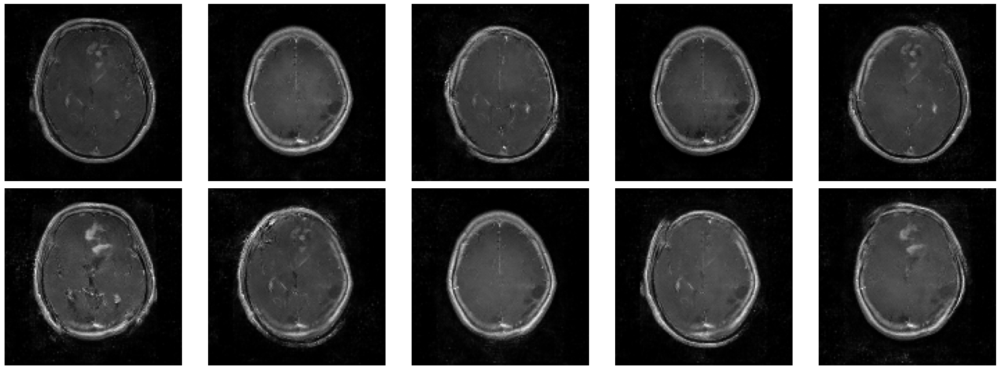

  0%|          | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 38ms/step


  0%|          | 1/3750 [00:00<13:49,  4.52it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 2/3750 [00:00<12:32,  4.98it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 3/3750 [00:00<12:26,  5.02it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 4/3750 [00:00<13:08,  4.75it/s]

1/1 [==============================] - 0s 45ms/step


  0%|          | 5/3750 [00:01<13:33,  4.61it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 6/3750 [00:01<12:57,  4.81it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 7/3750 [00:01<12:05,  5.16it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 8/3750 [00:01<11:53,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 9/3750 [00:01<11:49,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 10/3750 [00:01<11:55,  5.22it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 11/3750 [00:02<11:08,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 12/3750 [00:02<10:35,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 13/3750 [00:02<10:52,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 14/3750 [00:02<10:51,  5.73it/s]

1/1 [==============================] - 0s 35ms/step


  0%|          | 15/3750 [00:02<10:43,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 16/3750 [00:02<10:16,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 17/3750 [00:03<09:44,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 18/3750 [00:03<10:04,  6.18it/s]

1/1 [==============================] - 0s 58ms/step


  1%|          | 19/3750 [00:03<10:36,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 20/3750 [00:03<10:01,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 21/3750 [00:03<09:56,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 22/3750 [00:03<09:28,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 23/3750 [00:04<09:20,  6.65it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 24/3750 [00:04<09:57,  6.23it/s]

1/1 [==============================] - 0s 44ms/step


  1%|          | 25/3750 [00:04<10:57,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 26/3750 [00:04<11:05,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 27/3750 [00:04<10:23,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 28/3750 [00:04<10:20,  6.00it/s]

1/1 [==============================] - 0s 47ms/step


  1%|          | 29/3750 [00:05<10:32,  5.89it/s]

1/1 [==============================] - 0s 34ms/step


  1%|          | 30/3750 [00:05<10:15,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 31/3750 [00:05<10:04,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 32/3750 [00:05<09:46,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 33/3750 [00:05<09:25,  6.57it/s]

1/1 [==============================] - 0s 35ms/step


  1%|          | 34/3750 [00:05<09:36,  6.45it/s]

1/1 [==============================] - 0s 39ms/step


  1%|          | 35/3750 [00:06<09:40,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 36/3750 [00:06<09:31,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 37/3750 [00:06<09:23,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 38/3750 [00:06<09:26,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 39/3750 [00:06<09:21,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 40/3750 [00:06<09:14,  6.69it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 41/3750 [00:06<10:43,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 42/3750 [00:07<09:55,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 43/3750 [00:07<09:45,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 44/3750 [00:07<09:25,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 45/3750 [00:07<09:33,  6.46it/s]

1/1 [==============================] - 0s 46ms/step


  1%|          | 46/3750 [00:07<10:42,  5.76it/s]

1/1 [==============================] - 0s 33ms/step


  1%|▏         | 47/3750 [00:08<12:01,  5.13it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 48/3750 [00:08<11:51,  5.20it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 49/3750 [00:08<11:05,  5.56it/s]

1/1 [==============================] - 0s 44ms/step


  1%|▏         | 50/3750 [00:08<11:01,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 51/3750 [00:08<10:29,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 52/3750 [00:08<10:12,  6.04it/s]

1/1 [==============================] - 0s 31ms/step


  1%|▏         | 53/3750 [00:09<10:26,  5.90it/s]

1/1 [==============================] - 0s 36ms/step


  1%|▏         | 54/3750 [00:09<10:29,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 55/3750 [00:09<10:44,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 56/3750 [00:09<10:55,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 57/3750 [00:09<10:22,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 58/3750 [00:09<10:44,  5.73it/s]

1/1 [==============================] - 0s 33ms/step


  2%|▏         | 59/3750 [00:10<10:45,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 60/3750 [00:10<10:54,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 61/3750 [00:10<10:19,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 62/3750 [00:10<10:08,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 63/3750 [00:10<09:50,  6.24it/s]

1/1 [==============================] - 0s 47ms/step


  2%|▏         | 64/3750 [00:10<10:12,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 65/3750 [00:11<10:53,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 66/3750 [00:11<10:24,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 67/3750 [00:11<10:07,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 68/3750 [00:11<09:37,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 69/3750 [00:11<09:37,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 70/3750 [00:11<09:40,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 71/3750 [00:12<09:24,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 72/3750 [00:12<09:33,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 73/3750 [00:12<09:18,  6.58it/s]

1/1 [==============================] - 0s 32ms/step


  2%|▏         | 74/3750 [00:12<09:28,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 75/3750 [00:12<09:48,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 76/3750 [00:12<09:11,  6.67it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 77/3750 [00:12<09:09,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 78/3750 [00:13<09:51,  6.21it/s]

1/1 [==============================] - 0s 53ms/step


  2%|▏         | 79/3750 [00:13<10:50,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 80/3750 [00:13<10:19,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 81/3750 [00:13<09:55,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 82/3750 [00:13<09:50,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 83/3750 [00:13<09:31,  6.41it/s]

1/1 [==============================] - 0s 48ms/step


  2%|▏         | 84/3750 [00:14<09:52,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 85/3750 [00:14<10:03,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 86/3750 [00:14<09:35,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 87/3750 [00:14<09:22,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 88/3750 [00:14<09:24,  6.49it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 89/3750 [00:14<09:43,  6.28it/s]

1/1 [==============================] - 0s 44ms/step


  2%|▏         | 90/3750 [00:15<10:42,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 91/3750 [00:15<10:09,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 92/3750 [00:15<09:49,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 93/3750 [00:15<09:12,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 94/3750 [00:15<09:09,  6.65it/s]

1/1 [==============================] - 0s 36ms/step


  3%|▎         | 95/3750 [00:15<09:24,  6.48it/s]

1/1 [==============================] - 0s 40ms/step


  3%|▎         | 96/3750 [00:15<09:30,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 97/3750 [00:16<09:20,  6.51it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 98/3750 [00:16<09:06,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 99/3750 [00:16<08:59,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 100/3750 [00:16<08:51,  6.87it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 101/3750 [00:16<09:06,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 102/3750 [00:16<09:09,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 103/3750 [00:17<08:52,  6.85it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 104/3750 [00:17<08:43,  6.96it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 105/3750 [00:17<09:25,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 106/3750 [00:17<09:25,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 107/3750 [00:17<09:10,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 108/3750 [00:17<09:08,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 109/3750 [00:17<09:02,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 110/3750 [00:18<08:58,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 111/3750 [00:18<09:42,  6.25it/s]

1/1 [==============================] - 0s 42ms/step


  3%|▎         | 112/3750 [00:18<09:57,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 113/3750 [00:18<09:44,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 114/3750 [00:18<09:38,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 115/3750 [00:18<10:11,  5.95it/s]

1/1 [==============================] - 0s 32ms/step


  3%|▎         | 116/3750 [00:19<09:54,  6.11it/s]

1/1 [==============================] - 0s 39ms/step


  3%|▎         | 117/3750 [00:19<09:58,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 118/3750 [00:19<09:40,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 119/3750 [00:19<09:26,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 120/3750 [00:19<09:16,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 121/3750 [00:19<09:25,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 122/3750 [00:20<09:36,  6.29it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 123/3750 [00:20<09:42,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 124/3750 [00:20<09:38,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 125/3750 [00:20<09:11,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 126/3750 [00:20<09:06,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 127/3750 [00:20<08:42,  6.93it/s]

1/1 [==============================] - 0s 52ms/step


  3%|▎         | 128/3750 [00:20<10:16,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 129/3750 [00:21<10:07,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 130/3750 [00:21<09:37,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 131/3750 [00:21<09:02,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 132/3750 [00:21<08:59,  6.70it/s]

1/1 [==============================] - 0s 46ms/step


  4%|▎         | 133/3750 [00:21<09:34,  6.29it/s]

1/1 [==============================] - 0s 39ms/step


  4%|▎         | 134/3750 [00:21<09:57,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 135/3750 [00:22<09:27,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 136/3750 [00:22<09:10,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 137/3750 [00:22<09:04,  6.64it/s]

1/1 [==============================] - 0s 33ms/step


  4%|▎         | 138/3750 [00:22<09:18,  6.47it/s]

1/1 [==============================] - 0s 53ms/step


  4%|▎         | 139/3750 [00:22<09:33,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 140/3750 [00:22<09:28,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 141/3750 [00:22<08:49,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 142/3750 [00:23<08:47,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 143/3750 [00:23<08:52,  6.77it/s]

1/1 [==============================] - 0s 55ms/step


  4%|▍         | 144/3750 [00:23<09:29,  6.33it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 145/3750 [00:23<09:13,  6.51it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 146/3750 [00:23<09:43,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 147/3750 [00:23<09:32,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 148/3750 [00:24<09:15,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 149/3750 [00:24<09:42,  6.18it/s]

1/1 [==============================] - 0s 58ms/step


  4%|▍         | 150/3750 [00:24<09:56,  6.04it/s]

1/1 [==============================] - 0s 33ms/step


  4%|▍         | 151/3750 [00:24<09:44,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 152/3750 [00:24<09:24,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 153/3750 [00:24<09:06,  6.58it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▍         | 154/3750 [00:25<09:43,  6.17it/s]

1/1 [==============================] - 0s 40ms/step


  4%|▍         | 155/3750 [00:25<10:24,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 156/3750 [00:25<09:42,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 157/3750 [00:25<09:52,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 158/3750 [00:25<09:31,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 159/3750 [00:25<09:34,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 160/3750 [00:26<09:33,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 161/3750 [00:26<09:14,  6.47it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 162/3750 [00:26<09:05,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 163/3750 [00:26<08:53,  6.72it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▍         | 164/3750 [00:26<09:18,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 165/3750 [00:26<09:02,  6.60it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 166/3750 [00:26<08:54,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 167/3750 [00:27<08:32,  6.98it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 168/3750 [00:27<08:32,  6.98it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 169/3750 [00:27<08:29,  7.03it/s]

1/1 [==============================] - 0s 49ms/step


  5%|▍         | 170/3750 [00:27<09:27,  6.30it/s]

1/1 [==============================] - 0s 30ms/step


  5%|▍         | 171/3750 [00:27<09:14,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 172/3750 [00:27<08:52,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 173/3750 [00:27<08:46,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 174/3750 [00:28<09:07,  6.53it/s]

1/1 [==============================] - 0s 34ms/step


  5%|▍         | 175/3750 [00:28<09:02,  6.59it/s]

1/1 [==============================] - 0s 51ms/step


  5%|▍         | 176/3750 [00:28<09:25,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 177/3750 [00:28<09:10,  6.49it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▍         | 178/3750 [00:28<09:07,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 179/3750 [00:28<09:39,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 180/3750 [00:29<09:20,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 181/3750 [00:29<09:28,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 182/3750 [00:29<10:08,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 183/3750 [00:29<09:38,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 184/3750 [00:29<09:20,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 185/3750 [00:29<09:03,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 186/3750 [00:29<08:54,  6.67it/s]

1/1 [==============================] - 0s 33ms/step


  5%|▍         | 187/3750 [00:30<09:04,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 188/3750 [00:30<08:38,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 189/3750 [00:30<08:29,  6.99it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 190/3750 [00:30<09:10,  6.47it/s]

1/1 [==============================] - 0s 34ms/step


  5%|▌         | 191/3750 [00:30<09:07,  6.50it/s]

1/1 [==============================] - 0s 37ms/step


  5%|▌         | 192/3750 [00:30<09:25,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 193/3750 [00:31<08:58,  6.61it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▌         | 194/3750 [00:31<08:58,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 195/3750 [00:31<08:54,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 196/3750 [00:31<08:56,  6.62it/s]

1/1 [==============================] - 0s 46ms/step


  5%|▌         | 197/3750 [00:31<09:50,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 198/3750 [00:31<09:31,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 199/3750 [00:31<09:16,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 200/3750 [00:32<09:02,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 201/3750 [00:32<09:21,  6.32it/s]

1/1 [==============================] - 0s 35ms/step


  5%|▌         | 202/3750 [00:32<09:55,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 203/3750 [00:32<10:21,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 204/3750 [00:32<09:43,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 205/3750 [00:32<09:21,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 206/3750 [00:33<09:15,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 207/3750 [00:33<09:38,  6.12it/s]

1/1 [==============================] - 0s 41ms/step


  6%|▌         | 208/3750 [00:33<09:42,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 209/3750 [00:33<09:16,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 210/3750 [00:33<09:04,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▌         | 211/3750 [00:33<08:53,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 212/3750 [00:34<08:47,  6.70it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 213/3750 [00:34<08:46,  6.71it/s]

1/1 [==============================] - 0s 36ms/step


  6%|▌         | 214/3750 [00:34<09:22,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 215/3750 [00:34<08:57,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 216/3750 [00:34<08:46,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 217/3750 [00:34<08:41,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 218/3750 [00:34<08:32,  6.89it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 219/3750 [00:35<09:04,  6.48it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 220/3750 [00:35<08:58,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 221/3750 [00:35<08:48,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 222/3750 [00:35<08:40,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 223/3750 [00:35<08:41,  6.76it/s]

1/1 [==============================] - 0s 47ms/step


  6%|▌         | 224/3750 [00:35<10:01,  5.86it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 225/3750 [00:36<09:51,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 226/3750 [00:36<09:32,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 227/3750 [00:36<09:14,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 228/3750 [00:36<08:44,  6.72it/s]

1/1 [==============================] - 0s 36ms/step


  6%|▌         | 229/3750 [00:36<09:05,  6.46it/s]

1/1 [==============================] - 0s 54ms/step


  6%|▌         | 230/3750 [00:36<09:35,  6.12it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 231/3750 [00:37<09:18,  6.30it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 232/3750 [00:37<08:59,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 233/3750 [00:37<08:45,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 234/3750 [00:37<08:39,  6.76it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▋         | 235/3750 [00:37<08:48,  6.65it/s]

1/1 [==============================] - 0s 59ms/step


  6%|▋         | 236/3750 [00:37<10:16,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▋         | 237/3750 [00:37<09:55,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▋         | 238/3750 [00:38<09:34,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▋         | 239/3750 [00:38<09:17,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 240/3750 [00:38<09:01,  6.48it/s]

1/1 [==============================] - 0s 54ms/step


  6%|▋         | 241/3750 [00:38<09:27,  6.19it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▋         | 242/3750 [00:38<09:50,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▋         | 243/3750 [00:38<09:27,  6.18it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 244/3750 [00:39<09:13,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 245/3750 [00:39<09:12,  6.34it/s]

1/1 [==============================] - 0s 34ms/step


  7%|▋         | 246/3750 [00:39<09:11,  6.36it/s]

1/1 [==============================] - 0s 47ms/step


  7%|▋         | 247/3750 [00:39<09:41,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 248/3750 [00:39<09:25,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 249/3750 [00:39<09:26,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 250/3750 [00:40<09:55,  5.88it/s]

1/1 [==============================] - 0s 33ms/step


  7%|▋         | 251/3750 [00:40<09:56,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 252/3750 [00:40<09:42,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 253/3750 [00:40<09:10,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 254/3750 [00:40<08:56,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 255/3750 [00:40<09:38,  6.04it/s]

1/1 [==============================] - 0s 62ms/step


  7%|▋         | 256/3750 [00:41<10:01,  5.81it/s]

1/1 [==============================] - 0s 36ms/step


  7%|▋         | 257/3750 [00:41<09:56,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 258/3750 [00:41<09:33,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 259/3750 [00:41<09:07,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 260/3750 [00:41<08:51,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 261/3750 [00:41<09:19,  6.24it/s]

1/1 [==============================] - 0s 50ms/step


  7%|▋         | 262/3750 [00:42<10:09,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 263/3750 [00:42<10:03,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 264/3750 [00:42<09:33,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 265/3750 [00:42<09:23,  6.19it/s]

1/1 [==============================] - 0s 45ms/step


  7%|▋         | 266/3750 [00:42<09:54,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 267/3750 [00:42<09:29,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 268/3750 [00:43<09:17,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 269/3750 [00:43<09:49,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 270/3750 [00:43<09:29,  6.12it/s]

1/1 [==============================] - 0s 48ms/step


  7%|▋         | 271/3750 [00:43<10:19,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 272/3750 [00:43<10:14,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 273/3750 [00:43<09:43,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 274/3750 [00:44<09:09,  6.33it/s]

1/1 [==============================] - 0s 31ms/step


  7%|▋         | 275/3750 [00:44<09:15,  6.25it/s]

1/1 [==============================] - 0s 34ms/step


  7%|▋         | 276/3750 [00:44<09:31,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 277/3750 [00:44<09:13,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 278/3750 [00:44<09:12,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 279/3750 [00:44<08:53,  6.50it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 280/3750 [00:44<08:51,  6.53it/s]

1/1 [==============================] - 0s 52ms/step


  7%|▋         | 281/3750 [00:45<09:35,  6.03it/s]

1/1 [==============================] - 0s 35ms/step


  8%|▊         | 282/3750 [00:45<09:21,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 283/3750 [00:45<09:04,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 284/3750 [00:45<08:40,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 285/3750 [00:45<08:23,  6.88it/s]

1/1 [==============================] - 0s 38ms/step


  8%|▊         | 286/3750 [00:45<09:41,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 287/3750 [00:46<09:31,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 288/3750 [00:46<09:03,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 289/3750 [00:46<09:10,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 290/3750 [00:46<08:54,  6.48it/s]

1/1 [==============================] - 0s 45ms/step


  8%|▊         | 291/3750 [00:46<09:12,  6.26it/s]

1/1 [==============================] - 0s 43ms/step


  8%|▊         | 292/3750 [00:46<10:11,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 293/3750 [00:47<10:21,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 294/3750 [00:47<09:37,  5.99it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 295/3750 [00:47<09:54,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 296/3750 [00:47<09:53,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 297/3750 [00:47<09:07,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 298/3750 [00:47<08:59,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 299/3750 [00:48<09:13,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 300/3750 [00:48<09:16,  6.20it/s]

1/1 [==============================] - 0s 49ms/step


  8%|▊         | 301/3750 [00:48<10:12,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 302/3750 [00:48<09:33,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 303/3750 [00:48<09:14,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 304/3750 [00:48<09:02,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 305/3750 [00:49<08:49,  6.50it/s]

1/1 [==============================] - 0s 38ms/step


  8%|▊         | 306/3750 [00:49<09:17,  6.18it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 307/3750 [00:49<10:05,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 308/3750 [00:49<09:27,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 309/3750 [00:49<08:53,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 310/3750 [00:49<08:40,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 311/3750 [00:49<08:18,  6.89it/s]

1/1 [==============================] - 0s 63ms/step


  8%|▊         | 312/3750 [00:50<09:36,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 313/3750 [00:50<09:39,  5.93it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 314/3750 [00:50<09:19,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 315/3750 [00:50<09:37,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 316/3750 [00:50<09:58,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 317/3750 [00:51<10:02,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 318/3750 [00:51<09:39,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 319/3750 [00:51<09:19,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 320/3750 [00:51<09:03,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 321/3750 [00:51<09:02,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 322/3750 [00:51<08:47,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 323/3750 [00:51<09:33,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 324/3750 [00:52<09:56,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 325/3750 [00:52<09:26,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 326/3750 [00:52<09:06,  6.26it/s]

1/1 [==============================] - 0s 35ms/step


  9%|▊         | 327/3750 [00:52<09:10,  6.22it/s]

1/1 [==============================] - 0s 50ms/step


  9%|▊         | 328/3750 [00:52<09:08,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 329/3750 [00:52<08:42,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 330/3750 [00:53<08:22,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 331/3750 [00:53<08:19,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 332/3750 [00:53<08:04,  7.05it/s]

1/1 [==============================] - 0s 46ms/step


  9%|▉         | 333/3750 [00:53<08:38,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 334/3750 [00:53<08:32,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 335/3750 [00:53<08:01,  7.10it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 336/3750 [00:53<08:05,  7.03it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 337/3750 [00:54<08:06,  7.02it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 338/3750 [00:54<08:06,  7.01it/s]

1/1 [==============================] - 0s 48ms/step


  9%|▉         | 339/3750 [00:54<08:42,  6.53it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 340/3750 [00:54<08:27,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 341/3750 [00:54<08:37,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 342/3750 [00:54<08:36,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 343/3750 [00:54<08:17,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 344/3750 [00:55<08:27,  6.71it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 345/3750 [00:55<08:40,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 346/3750 [00:55<09:30,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 347/3750 [00:55<09:20,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 348/3750 [00:55<08:58,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 349/3750 [00:55<08:35,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 350/3750 [00:56<08:25,  6.73it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 351/3750 [00:56<09:15,  6.12it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 352/3750 [00:56<09:17,  6.10it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 353/3750 [00:56<08:56,  6.33it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▉         | 354/3750 [00:56<08:59,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 355/3750 [00:56<08:36,  6.58it/s]

1/1 [==============================] - 0s 33ms/step


  9%|▉         | 356/3750 [00:57<08:52,  6.38it/s]

1/1 [==============================] - 0s 41ms/step


 10%|▉         | 357/3750 [00:57<09:52,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 358/3750 [00:57<09:19,  6.07it/s]

1/1 [==============================] - 0s 28ms/step


 10%|▉         | 359/3750 [00:57<08:56,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 360/3750 [00:57<08:38,  6.53it/s]

1/1 [==============================] - 0s 38ms/step


 10%|▉         | 361/3750 [00:57<08:58,  6.29it/s]

1/1 [==============================] - 0s 50ms/step


 10%|▉         | 362/3750 [00:58<09:22,  6.03it/s]

1/1 [==============================] - 0s 31ms/step


 10%|▉         | 363/3750 [00:58<09:10,  6.15it/s]

1/1 [==============================] - 0s 34ms/step


 10%|▉         | 364/3750 [00:58<09:52,  5.71it/s]

1/1 [==============================] - 0s 36ms/step


 10%|▉         | 365/3750 [00:58<09:48,  5.75it/s]

1/1 [==============================] - 0s 35ms/step


 10%|▉         | 366/3750 [00:58<09:43,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 367/3750 [00:58<09:30,  5.93it/s]

1/1 [==============================] - 0s 52ms/step


 10%|▉         | 368/3750 [00:59<09:40,  5.83it/s]

1/1 [==============================] - 0s 43ms/step


 10%|▉         | 369/3750 [00:59<09:49,  5.73it/s]

1/1 [==============================] - 0s 49ms/step


 10%|▉         | 370/3750 [00:59<10:05,  5.58it/s]

1/1 [==============================] - 0s 28ms/step


 10%|▉         | 371/3750 [00:59<10:38,  5.30it/s]

1/1 [==============================] - 0s 36ms/step


 10%|▉         | 372/3750 [00:59<10:47,  5.22it/s]

1/1 [==============================] - 0s 48ms/step


 10%|▉         | 373/3750 [01:00<10:46,  5.22it/s]

1/1 [==============================] - 0s 30ms/step


 10%|▉         | 374/3750 [01:00<10:15,  5.49it/s]

1/1 [==============================] - 0s 47ms/step


 10%|█         | 375/3750 [01:00<10:39,  5.28it/s]

1/1 [==============================] - 0s 46ms/step


 10%|█         | 376/3750 [01:00<10:51,  5.18it/s]

1/1 [==============================] - 0s 51ms/step


 10%|█         | 377/3750 [01:00<10:56,  5.14it/s]

1/1 [==============================] - 0s 27ms/step


 10%|█         | 378/3750 [01:01<11:19,  4.96it/s]

1/1 [==============================] - 0s 36ms/step


 10%|█         | 379/3750 [01:01<11:03,  5.08it/s]

1/1 [==============================] - 0s 36ms/step


 10%|█         | 380/3750 [01:01<10:55,  5.14it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 381/3750 [01:01<10:25,  5.39it/s]

1/1 [==============================] - 0s 40ms/step


 10%|█         | 382/3750 [01:01<10:24,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 383/3750 [01:01<10:08,  5.53it/s]

1/1 [==============================] - 0s 51ms/step


 10%|█         | 384/3750 [01:02<10:26,  5.37it/s]

1/1 [==============================] - 0s 34ms/step


 10%|█         | 385/3750 [01:02<10:16,  5.46it/s]

1/1 [==============================] - 0s 50ms/step


 10%|█         | 386/3750 [01:02<10:44,  5.22it/s]

1/1 [==============================] - 0s 34ms/step


 10%|█         | 387/3750 [01:02<10:52,  5.16it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 388/3750 [01:02<10:45,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 389/3750 [01:03<10:14,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 390/3750 [01:03<09:46,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 391/3750 [01:03<09:24,  5.95it/s]

1/1 [==============================] - 0s 51ms/step


 10%|█         | 392/3750 [01:03<10:55,  5.12it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 393/3750 [01:03<10:01,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 394/3750 [01:03<09:43,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 395/3750 [01:04<09:14,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 396/3750 [01:04<09:52,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 397/3750 [01:04<10:07,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 398/3750 [01:04<09:30,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 399/3750 [01:04<08:58,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 400/3750 [01:04<08:40,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 401/3750 [01:05<08:38,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 402/3750 [01:05<08:31,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 403/3750 [01:05<08:28,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 404/3750 [01:05<08:12,  6.80it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 405/3750 [01:05<08:06,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 406/3750 [01:05<08:06,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 407/3750 [01:05<08:00,  6.95it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 408/3750 [01:06<08:30,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 409/3750 [01:06<08:19,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 410/3750 [01:06<08:08,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 411/3750 [01:06<08:09,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 412/3750 [01:06<08:08,  6.84it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 413/3750 [01:06<07:57,  6.98it/s]

1/1 [==============================] - 0s 46ms/step


 11%|█         | 414/3750 [01:06<08:46,  6.34it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 415/3750 [01:07<08:48,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 416/3750 [01:07<08:29,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 417/3750 [01:07<08:27,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 418/3750 [01:07<08:40,  6.40it/s]

1/1 [==============================] - 0s 48ms/step


 11%|█         | 419/3750 [01:07<09:40,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 420/3750 [01:08<10:03,  5.52it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 421/3750 [01:08<09:49,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█▏        | 422/3750 [01:08<09:29,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 423/3750 [01:08<09:15,  5.99it/s]

1/1 [==============================] - 0s 50ms/step


 11%|█▏        | 424/3750 [01:08<09:45,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 425/3750 [01:08<09:58,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 426/3750 [01:09<09:35,  5.78it/s]

1/1 [==============================] - 0s 33ms/step


 11%|█▏        | 427/3750 [01:09<09:27,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 428/3750 [01:09<09:05,  6.09it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█▏        | 429/3750 [01:09<09:33,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 430/3750 [01:09<09:03,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 431/3750 [01:09<08:54,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 432/3750 [01:10<08:48,  6.27it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 433/3750 [01:10<09:12,  6.00it/s]

1/1 [==============================] - 0s 35ms/step


 12%|█▏        | 434/3750 [01:10<09:27,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 435/3750 [01:10<08:53,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 436/3750 [01:10<08:28,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 437/3750 [01:10<08:11,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 438/3750 [01:10<08:14,  6.70it/s]

1/1 [==============================] - 0s 35ms/step


 12%|█▏        | 439/3750 [01:11<09:19,  5.92it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 440/3750 [01:11<09:06,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 441/3750 [01:11<09:29,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 442/3750 [01:11<09:14,  5.96it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 443/3750 [01:11<08:48,  6.26it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 444/3750 [01:11<08:38,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 445/3750 [01:12<08:38,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 446/3750 [01:12<08:31,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 447/3750 [01:12<08:19,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 448/3750 [01:12<08:16,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 449/3750 [01:12<08:28,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 450/3750 [01:12<08:50,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 451/3750 [01:13<08:37,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 452/3750 [01:13<09:17,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 453/3750 [01:13<08:59,  6.11it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 454/3750 [01:13<08:45,  6.27it/s]

1/1 [==============================] - 0s 54ms/step


 12%|█▏        | 455/3750 [01:13<09:17,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 456/3750 [01:13<08:45,  6.27it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 457/3750 [01:13<08:27,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 458/3750 [01:14<08:07,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 459/3750 [01:14<08:01,  6.83it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 460/3750 [01:14<08:02,  6.82it/s]

1/1 [==============================] - 0s 46ms/step


 12%|█▏        | 461/3750 [01:14<09:03,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 462/3750 [01:14<08:37,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 463/3750 [01:14<08:14,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 464/3750 [01:15<08:04,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 465/3750 [01:15<08:07,  6.74it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 466/3750 [01:15<08:17,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 467/3750 [01:15<08:03,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 468/3750 [01:15<07:54,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 469/3750 [01:15<08:20,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 470/3750 [01:16<13:22,  4.09it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 471/3750 [01:16<11:47,  4.63it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 472/3750 [01:16<10:40,  5.12it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 473/3750 [01:16<09:54,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 474/3750 [01:16<09:15,  5.89it/s]

1/1 [==============================] - 0s 52ms/step


 13%|█▎        | 475/3750 [01:17<09:53,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 476/3750 [01:17<09:56,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 477/3750 [01:17<09:26,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 478/3750 [01:17<09:02,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 479/3750 [01:17<08:49,  6.18it/s]

1/1 [==============================] - 0s 56ms/step


 13%|█▎        | 480/3750 [01:17<10:18,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 481/3750 [01:18<09:32,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 482/3750 [01:18<08:56,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 483/3750 [01:18<08:27,  6.44it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 484/3750 [01:18<08:18,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 485/3750 [01:18<08:13,  6.62it/s]

1/1 [==============================] - 0s 50ms/step


 13%|█▎        | 486/3750 [01:18<09:03,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 487/3750 [01:18<08:36,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 488/3750 [01:19<08:23,  6.48it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 489/3750 [01:19<08:37,  6.31it/s]

1/1 [==============================] - 0s 41ms/step


 13%|█▎        | 490/3750 [01:19<08:59,  6.04it/s]

1/1 [==============================] - 0s 40ms/step


 13%|█▎        | 491/3750 [01:19<08:57,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 492/3750 [01:19<09:20,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 493/3750 [01:20<09:32,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 494/3750 [01:20<09:03,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 495/3750 [01:20<08:30,  6.37it/s]

1/1 [==============================] - 0s 43ms/step


 13%|█▎        | 496/3750 [01:20<08:59,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 497/3750 [01:20<08:32,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 498/3750 [01:20<08:09,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 499/3750 [01:20<08:01,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 500/3750 [01:21<07:52,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 501/3750 [01:21<07:53,  6.85it/s]

1/1 [==============================] - 0s 37ms/step


 13%|█▎        | 502/3750 [01:21<08:25,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 503/3750 [01:21<08:53,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 504/3750 [01:21<08:19,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 505/3750 [01:21<08:21,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 506/3750 [01:21<08:16,  6.54it/s]

1/1 [==============================] - 0s 36ms/step


 14%|█▎        | 507/3750 [01:22<08:12,  6.59it/s]

1/1 [==============================] - 0s 38ms/step


 14%|█▎        | 508/3750 [01:22<09:05,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 509/3750 [01:22<08:37,  6.27it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▎        | 510/3750 [01:22<08:31,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 511/3750 [01:22<08:10,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 512/3750 [01:22<08:03,  6.69it/s]

1/1 [==============================] - 0s 46ms/step


 14%|█▎        | 513/3750 [01:23<08:27,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 514/3750 [01:23<08:44,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 515/3750 [01:23<08:33,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 516/3750 [01:23<08:12,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 517/3750 [01:23<08:21,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 518/3750 [01:23<08:13,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 519/3750 [01:24<08:07,  6.63it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▍        | 520/3750 [01:24<08:16,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 521/3750 [01:24<07:55,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 522/3750 [01:24<07:50,  6.86it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 523/3750 [01:24<07:29,  7.17it/s]

1/1 [==============================] - 0s 33ms/step


 14%|█▍        | 524/3750 [01:24<07:29,  7.18it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 525/3750 [01:24<07:34,  7.10it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 526/3750 [01:25<07:48,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 527/3750 [01:25<07:37,  7.04it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 528/3750 [01:25<07:38,  7.03it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 529/3750 [01:25<07:40,  6.99it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 530/3750 [01:25<07:58,  6.73it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 531/3750 [01:25<08:29,  6.32it/s]

1/1 [==============================] - 0s 42ms/step


 14%|█▍        | 532/3750 [01:25<08:40,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 533/3750 [01:26<08:19,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 534/3750 [01:26<08:53,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 535/3750 [01:26<08:19,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 536/3750 [01:26<07:59,  6.70it/s]

1/1 [==============================] - 0s 54ms/step


 14%|█▍        | 537/3750 [01:26<08:41,  6.16it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 538/3750 [01:26<08:18,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 539/3750 [01:27<08:07,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 540/3750 [01:27<08:09,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 541/3750 [01:27<08:24,  6.36it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▍        | 542/3750 [01:27<08:22,  6.38it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 543/3750 [01:27<08:15,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 544/3750 [01:27<07:56,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 545/3750 [01:27<07:50,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 546/3750 [01:28<07:44,  6.90it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 547/3750 [01:28<07:42,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 548/3750 [01:28<07:47,  6.85it/s]

1/1 [==============================] - 0s 58ms/step


 15%|█▍        | 549/3750 [01:28<08:35,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 550/3750 [01:28<08:15,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 551/3750 [01:28<08:57,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 552/3750 [01:29<08:36,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 553/3750 [01:29<08:45,  6.09it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▍        | 554/3750 [01:29<08:35,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 555/3750 [01:29<08:05,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 556/3750 [01:29<08:19,  6.39it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 557/3750 [01:29<08:03,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 558/3750 [01:29<07:50,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 559/3750 [01:30<07:31,  7.06it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 560/3750 [01:30<07:35,  7.01it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 561/3750 [01:30<07:38,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 562/3750 [01:30<07:20,  7.24it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 563/3750 [01:30<07:23,  7.18it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 564/3750 [01:30<07:27,  7.12it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 565/3750 [01:30<08:15,  6.43it/s]

1/1 [==============================] - 0s 49ms/step


 15%|█▌        | 566/3750 [01:31<08:49,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 567/3750 [01:31<08:33,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 568/3750 [01:31<08:09,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 569/3750 [01:31<08:03,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 570/3750 [01:31<08:04,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 571/3750 [01:31<08:23,  6.31it/s]

1/1 [==============================] - 0s 35ms/step


 15%|█▌        | 572/3750 [01:32<08:24,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 573/3750 [01:32<08:07,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 574/3750 [01:32<07:48,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 575/3750 [01:32<07:49,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 576/3750 [01:32<07:47,  6.79it/s]

1/1 [==============================] - 0s 48ms/step


 15%|█▌        | 577/3750 [01:32<08:55,  5.93it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▌        | 578/3750 [01:33<08:45,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 579/3750 [01:33<08:29,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 580/3750 [01:33<08:06,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 581/3750 [01:33<08:41,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 582/3750 [01:33<08:36,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 583/3750 [01:33<08:09,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 584/3750 [01:33<07:58,  6.62it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 585/3750 [01:34<08:04,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 586/3750 [01:34<07:57,  6.63it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 587/3750 [01:34<07:56,  6.64it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 588/3750 [01:34<07:49,  6.74it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 589/3750 [01:34<08:28,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 590/3750 [01:34<08:19,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 591/3750 [01:35<08:13,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 592/3750 [01:35<07:52,  6.68it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 593/3750 [01:35<07:43,  6.81it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 594/3750 [01:35<07:35,  6.93it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 595/3750 [01:35<08:14,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 596/3750 [01:35<08:12,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 597/3750 [01:35<07:58,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 598/3750 [01:36<07:55,  6.63it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 599/3750 [01:36<07:56,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 600/3750 [01:36<07:38,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 601/3750 [01:36<07:44,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 602/3750 [01:36<07:35,  6.92it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 603/3750 [01:36<08:10,  6.42it/s]

1/1 [==============================] - 0s 52ms/step


 16%|█▌        | 604/3750 [01:37<08:37,  6.08it/s]

1/1 [==============================] - 0s 49ms/step


 16%|█▌        | 605/3750 [01:37<08:40,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 606/3750 [01:37<09:01,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 607/3750 [01:37<08:35,  6.10it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 608/3750 [01:37<08:21,  6.27it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 609/3750 [01:37<08:16,  6.33it/s]

1/1 [==============================] - 0s 48ms/step


 16%|█▋        | 610/3750 [01:37<08:31,  6.14it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▋        | 611/3750 [01:38<08:27,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 612/3750 [01:38<08:23,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 613/3750 [01:38<08:09,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 614/3750 [01:38<07:38,  6.84it/s]

1/1 [==============================] - 0s 34ms/step


 16%|█▋        | 615/3750 [01:38<08:02,  6.49it/s]

1/1 [==============================] - 0s 52ms/step


 16%|█▋        | 616/3750 [01:38<08:38,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 617/3750 [01:39<08:08,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 618/3750 [01:39<08:02,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 619/3750 [01:39<07:45,  6.72it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 620/3750 [01:39<07:58,  6.53it/s]

1/1 [==============================] - 0s 39ms/step


 17%|█▋        | 621/3750 [01:39<08:15,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 622/3750 [01:39<08:52,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 623/3750 [01:40<09:07,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 624/3750 [01:40<09:13,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 625/3750 [01:40<08:57,  5.82it/s]

1/1 [==============================] - 0s 51ms/step


 17%|█▋        | 626/3750 [01:40<09:42,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 627/3750 [01:40<09:02,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 628/3750 [01:40<08:48,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 629/3750 [01:41<08:22,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 630/3750 [01:41<08:00,  6.50it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 631/3750 [01:41<08:20,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 632/3750 [01:41<08:25,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 633/3750 [01:41<08:47,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 634/3750 [01:41<08:16,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 635/3750 [01:42<07:57,  6.53it/s]

1/1 [==============================] - 0s 49ms/step


 17%|█▋        | 636/3750 [01:42<08:40,  5.98it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 637/3750 [01:42<08:53,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 638/3750 [01:42<08:20,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 639/3750 [01:42<08:17,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 640/3750 [01:42<07:58,  6.50it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 641/3750 [01:42<07:50,  6.61it/s]

1/1 [==============================] - 0s 50ms/step


 17%|█▋        | 642/3750 [01:43<09:02,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 643/3750 [01:43<08:35,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 644/3750 [01:43<08:08,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 645/3750 [01:43<07:56,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 646/3750 [01:43<07:41,  6.72it/s]

1/1 [==============================] - 0s 37ms/step


 17%|█▋        | 647/3750 [01:43<07:52,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 648/3750 [01:44<07:56,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 649/3750 [01:44<07:35,  6.81it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 650/3750 [01:44<07:39,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 651/3750 [01:44<07:33,  6.84it/s]

1/1 [==============================] - 0s 59ms/step


 17%|█▋        | 652/3750 [01:44<08:05,  6.38it/s]

1/1 [==============================] - 0s 37ms/step


 17%|█▋        | 653/3750 [01:44<08:04,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 654/3750 [01:45<08:32,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 655/3750 [01:45<08:15,  6.25it/s]

1/1 [==============================] - 0s 35ms/step


 17%|█▋        | 656/3750 [01:45<08:51,  5.82it/s]

1/1 [==============================] - 0s 46ms/step


 18%|█▊        | 657/3750 [01:45<09:15,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 658/3750 [01:45<08:45,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 659/3750 [01:45<08:22,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 660/3750 [01:46<08:12,  6.28it/s]

1/1 [==============================] - 0s 37ms/step


 18%|█▊        | 661/3750 [01:46<08:26,  6.10it/s]

1/1 [==============================] - 0s 45ms/step


 18%|█▊        | 662/3750 [01:46<08:53,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 663/3750 [01:46<08:24,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 664/3750 [01:46<08:10,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 665/3750 [01:46<08:00,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 666/3750 [01:46<08:11,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 667/3750 [01:47<08:45,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 668/3750 [01:47<08:57,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 669/3750 [01:47<09:18,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 670/3750 [01:47<08:38,  5.94it/s]

1/1 [==============================] - 0s 35ms/step


 18%|█▊        | 671/3750 [01:47<08:40,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 672/3750 [01:48<08:28,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 673/3750 [01:48<08:11,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 674/3750 [01:48<07:54,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 675/3750 [01:48<07:45,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 676/3750 [01:48<08:25,  6.08it/s]

1/1 [==============================] - 0s 36ms/step


 18%|█▊        | 677/3750 [01:48<08:41,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 678/3750 [01:48<08:18,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 679/3750 [01:49<08:10,  6.26it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 680/3750 [01:49<07:57,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 681/3750 [01:49<08:35,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 682/3750 [01:49<08:26,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 683/3750 [01:49<08:08,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 684/3750 [01:49<07:55,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 685/3750 [01:50<07:35,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 686/3750 [01:50<07:19,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 687/3750 [01:50<07:44,  6.59it/s]

1/1 [==============================] - 0s 37ms/step


 18%|█▊        | 688/3750 [01:50<07:46,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 689/3750 [01:50<08:33,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 690/3750 [01:50<08:52,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 691/3750 [01:51<08:19,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 692/3750 [01:51<08:11,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 693/3750 [01:51<08:00,  6.37it/s]

1/1 [==============================] - 0s 46ms/step


 19%|█▊        | 694/3750 [01:51<08:17,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 695/3750 [01:51<07:51,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 696/3750 [01:51<07:38,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 697/3750 [01:51<07:36,  6.69it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▊        | 698/3750 [01:52<07:29,  6.79it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▊        | 699/3750 [01:52<07:39,  6.64it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▊        | 700/3750 [01:52<07:41,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 701/3750 [01:52<07:19,  6.93it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▊        | 702/3750 [01:52<07:22,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 703/3750 [01:52<07:31,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 704/3750 [01:52<07:21,  6.89it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 705/3750 [01:53<07:20,  6.92it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 706/3750 [01:53<07:40,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 707/3750 [01:53<07:43,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 708/3750 [01:53<07:35,  6.68it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▉        | 709/3750 [01:53<07:32,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 710/3750 [01:53<07:16,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 711/3750 [01:54<07:20,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 712/3750 [01:54<07:32,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 713/3750 [01:54<07:27,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 714/3750 [01:54<07:10,  7.05it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 715/3750 [01:54<07:12,  7.02it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 716/3750 [01:54<07:10,  7.05it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 717/3750 [01:54<07:55,  6.38it/s]

1/1 [==============================] - 0s 52ms/step


 19%|█▉        | 718/3750 [01:55<08:30,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 719/3750 [01:55<07:54,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 720/3750 [01:55<07:31,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 721/3750 [01:55<07:11,  7.02it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 722/3750 [01:55<07:19,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 723/3750 [01:55<07:45,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 724/3750 [01:55<07:48,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 725/3750 [01:56<07:47,  6.47it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 726/3750 [01:56<07:55,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 727/3750 [01:56<07:46,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 728/3750 [01:56<07:34,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 729/3750 [01:56<08:13,  6.12it/s]

1/1 [==============================] - 0s 35ms/step


 19%|█▉        | 730/3750 [01:56<08:01,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 731/3750 [01:57<07:33,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 732/3750 [01:57<07:31,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 733/3750 [01:57<07:32,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 734/3750 [01:57<07:08,  7.03it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 735/3750 [01:57<07:32,  6.67it/s]

1/1 [==============================] - 0s 52ms/step


 20%|█▉        | 736/3750 [01:57<08:06,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 737/3750 [01:57<07:42,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 738/3750 [01:58<07:37,  6.58it/s]

1/1 [==============================] - 0s 32ms/step


 20%|█▉        | 739/3750 [01:58<07:33,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 740/3750 [01:58<07:50,  6.39it/s]

1/1 [==============================] - 0s 35ms/step


 20%|█▉        | 741/3750 [01:58<08:46,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 742/3750 [01:58<08:56,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 743/3750 [01:59<08:27,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 744/3750 [01:59<07:50,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 745/3750 [01:59<07:29,  6.69it/s]

1/1 [==============================] - 0s 35ms/step


 20%|█▉        | 746/3750 [01:59<07:41,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 747/3750 [01:59<07:52,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 748/3750 [01:59<08:17,  6.04it/s]

1/1 [==============================] - 0s 31ms/step


 20%|█▉        | 749/3750 [01:59<08:39,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 750/3750 [02:00<08:23,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 751/3750 [02:00<08:38,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 752/3750 [02:00<07:59,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 753/3750 [02:00<07:43,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 754/3750 [02:00<07:35,  6.57it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 755/3750 [02:00<07:33,  6.60it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 756/3750 [02:01<07:34,  6.59it/s]

1/1 [==============================] - 0s 52ms/step


 20%|██        | 757/3750 [02:01<08:08,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 758/3750 [02:01<08:00,  6.23it/s]

1/1 [==============================] - 0s 30ms/step


 20%|██        | 759/3750 [02:01<07:50,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 760/3750 [02:01<07:27,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 761/3750 [02:01<07:20,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 762/3750 [02:01<07:31,  6.62it/s]

1/1 [==============================] - 0s 33ms/step


 20%|██        | 763/3750 [02:02<07:52,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 764/3750 [02:02<07:40,  6.48it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 765/3750 [02:02<08:00,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 766/3750 [02:02<07:35,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 767/3750 [02:02<07:16,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 768/3750 [02:02<07:22,  6.73it/s]

1/1 [==============================] - 0s 50ms/step


 21%|██        | 769/3750 [02:03<07:55,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 770/3750 [02:03<07:37,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 771/3750 [02:03<07:20,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 772/3750 [02:03<07:18,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 773/3750 [02:03<07:13,  6.86it/s]

1/1 [==============================] - 0s 43ms/step


 21%|██        | 774/3750 [02:03<08:00,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 775/3750 [02:03<07:49,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 776/3750 [02:04<08:10,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 777/3750 [02:04<07:51,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 778/3750 [02:04<08:10,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 779/3750 [02:04<08:01,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 780/3750 [02:04<07:44,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 781/3750 [02:04<07:34,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 782/3750 [02:05<07:35,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 783/3750 [02:05<07:28,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 784/3750 [02:05<07:16,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 785/3750 [02:05<07:37,  6.48it/s]

1/1 [==============================] - 0s 52ms/step


 21%|██        | 786/3750 [02:05<08:05,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 787/3750 [02:05<07:58,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 788/3750 [02:06<07:45,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 789/3750 [02:06<07:42,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 790/3750 [02:06<07:30,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 791/3750 [02:06<07:50,  6.29it/s]

1/1 [==============================] - 0s 46ms/step


 21%|██        | 792/3750 [02:06<08:34,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 793/3750 [02:06<07:58,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 794/3750 [02:07<08:18,  5.93it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 795/3750 [02:07<07:57,  6.19it/s]

1/1 [==============================] - 0s 34ms/step


 21%|██        | 796/3750 [02:07<08:00,  6.15it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██▏       | 797/3750 [02:07<08:17,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 798/3750 [02:07<08:18,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 799/3750 [02:07<08:39,  5.69it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██▏       | 800/3750 [02:08<08:08,  6.04it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██▏       | 801/3750 [02:08<08:06,  6.06it/s]

1/1 [==============================] - 0s 46ms/step


 21%|██▏       | 802/3750 [02:08<08:23,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 803/3750 [02:08<08:40,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 804/3750 [02:08<08:12,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 805/3750 [02:08<07:59,  6.15it/s]

1/1 [==============================] - 0s 31ms/step


 21%|██▏       | 806/3750 [02:09<07:54,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 807/3750 [02:09<07:40,  6.40it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 808/3750 [02:09<07:43,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 809/3750 [02:09<07:36,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 810/3750 [02:09<07:19,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 811/3750 [02:09<07:22,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 812/3750 [02:09<07:28,  6.55it/s]

1/1 [==============================] - 0s 33ms/step


 22%|██▏       | 813/3750 [02:10<07:33,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 814/3750 [02:10<07:59,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 815/3750 [02:10<07:46,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 816/3750 [02:10<07:40,  6.37it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 817/3750 [02:10<07:38,  6.39it/s]

1/1 [==============================] - 0s 52ms/step


 22%|██▏       | 818/3750 [02:10<08:18,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 819/3750 [02:11<08:37,  5.66it/s]

1/1 [==============================] - 0s 57ms/step


 22%|██▏       | 820/3750 [02:11<08:35,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 821/3750 [02:11<08:10,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 822/3750 [02:11<07:47,  6.27it/s]

1/1 [==============================] - 0s 60ms/step


 22%|██▏       | 823/3750 [02:11<08:35,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 824/3750 [02:11<08:52,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 825/3750 [02:12<08:54,  5.48it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 826/3750 [02:12<08:16,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 827/3750 [02:12<07:52,  6.19it/s]

1/1 [==============================] - 0s 34ms/step


 22%|██▏       | 828/3750 [02:12<08:21,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 829/3750 [02:12<07:56,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 830/3750 [02:12<07:53,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 831/3750 [02:13<08:09,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 832/3750 [02:13<07:56,  6.12it/s]

1/1 [==============================] - 0s 41ms/step


 22%|██▏       | 833/3750 [02:13<08:08,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 834/3750 [02:13<08:33,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 835/3750 [02:13<08:51,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 836/3750 [02:14<08:55,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 837/3750 [02:14<08:59,  5.40it/s]

1/1 [==============================] - 0s 37ms/step


 22%|██▏       | 838/3750 [02:14<08:48,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 839/3750 [02:14<08:52,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 840/3750 [02:14<08:27,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 841/3750 [02:14<08:01,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 842/3750 [02:15<07:41,  6.31it/s]

1/1 [==============================] - 0s 38ms/step


 22%|██▏       | 843/3750 [02:15<07:46,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 844/3750 [02:15<08:00,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 845/3750 [02:15<07:42,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 846/3750 [02:15<07:29,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 847/3750 [02:15<07:39,  6.32it/s]

1/1 [==============================] - 0s 36ms/step


 23%|██▎       | 848/3750 [02:15<07:45,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 849/3750 [02:16<08:05,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 850/3750 [02:16<07:50,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 851/3750 [02:16<07:42,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 852/3750 [02:16<07:29,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 853/3750 [02:16<07:40,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 854/3750 [02:16<07:26,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 855/3750 [02:17<07:21,  6.55it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 856/3750 [02:17<07:14,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 857/3750 [02:17<07:13,  6.68it/s]

1/1 [==============================] - 0s 41ms/step


 23%|██▎       | 858/3750 [02:17<07:28,  6.45it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 859/3750 [02:17<07:23,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 860/3750 [02:17<07:02,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 861/3750 [02:17<06:52,  7.00it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 862/3750 [02:18<07:29,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 863/3750 [02:18<07:28,  6.44it/s]

1/1 [==============================] - 0s 44ms/step


 23%|██▎       | 864/3750 [02:18<07:43,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 865/3750 [02:18<07:31,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 866/3750 [02:18<07:22,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 867/3750 [02:18<07:17,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 868/3750 [02:19<07:16,  6.61it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 869/3750 [02:19<07:24,  6.48it/s]

1/1 [==============================] - 0s 48ms/step


 23%|██▎       | 870/3750 [02:19<08:10,  5.87it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 871/3750 [02:19<08:50,  5.43it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 872/3750 [02:19<08:31,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 873/3750 [02:19<08:04,  5.94it/s]

1/1 [==============================] - 0s 47ms/step


 23%|██▎       | 874/3750 [02:20<08:14,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 875/3750 [02:20<07:58,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 876/3750 [02:20<07:50,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 877/3750 [02:20<07:43,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 878/3750 [02:20<07:57,  6.02it/s]

1/1 [==============================] - 0s 50ms/step


 23%|██▎       | 879/3750 [02:20<08:48,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 880/3750 [02:21<08:18,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 881/3750 [02:21<07:52,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▎       | 882/3750 [02:21<07:31,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 883/3750 [02:21<07:20,  6.51it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▎       | 884/3750 [02:21<07:45,  6.16it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▎       | 885/3750 [02:21<08:18,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 886/3750 [02:22<08:32,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 887/3750 [02:22<08:14,  5.79it/s]

1/1 [==============================] - 0s 37ms/step


 24%|██▎       | 888/3750 [02:22<08:22,  5.69it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▎       | 889/3750 [02:22<08:04,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▎       | 890/3750 [02:22<08:32,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 891/3750 [02:23<08:34,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 892/3750 [02:23<08:41,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 893/3750 [02:23<08:37,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 894/3750 [02:23<08:15,  5.76it/s]

1/1 [==============================] - 0s 34ms/step


 24%|██▍       | 895/3750 [02:23<08:05,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 896/3750 [02:23<08:11,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 897/3750 [02:24<07:42,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 898/3750 [02:24<07:37,  6.24it/s]

1/1 [==============================] - 0s 51ms/step


 24%|██▍       | 899/3750 [02:24<07:51,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 900/3750 [02:24<07:36,  6.24it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 901/3750 [02:24<07:29,  6.34it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 902/3750 [02:24<07:43,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 903/3750 [02:25<07:50,  6.05it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 904/3750 [02:25<07:57,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 905/3750 [02:25<07:32,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 906/3750 [02:25<07:23,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 907/3750 [02:25<07:34,  6.26it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 908/3750 [02:25<07:27,  6.36it/s]

1/1 [==============================] - 0s 51ms/step


 24%|██▍       | 909/3750 [02:25<07:40,  6.17it/s]

1/1 [==============================] - 0s 46ms/step


 24%|██▍       | 910/3750 [02:26<08:22,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 911/3750 [02:26<07:44,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 912/3750 [02:26<07:21,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 913/3750 [02:26<07:03,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 914/3750 [02:26<07:00,  6.74it/s]

1/1 [==============================] - 0s 34ms/step


 24%|██▍       | 915/3750 [02:26<07:07,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 916/3750 [02:27<06:51,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 917/3750 [02:27<06:49,  6.93it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 918/3750 [02:27<06:38,  7.10it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 919/3750 [02:27<06:35,  7.16it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 920/3750 [02:27<06:39,  7.09it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 921/3750 [02:27<06:53,  6.84it/s]

1/1 [==============================] - 0s 38ms/step


 25%|██▍       | 922/3750 [02:27<07:40,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 923/3750 [02:28<07:26,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 924/3750 [02:28<07:16,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 925/3750 [02:28<07:16,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 926/3750 [02:28<07:16,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 927/3750 [02:28<07:20,  6.40it/s]

1/1 [==============================] - 0s 47ms/step


 25%|██▍       | 928/3750 [02:28<07:44,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 929/3750 [02:29<08:03,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 930/3750 [02:29<07:46,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 931/3750 [02:29<07:53,  5.95it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▍       | 932/3750 [02:29<07:45,  6.05it/s]

1/1 [==============================] - 0s 46ms/step


 25%|██▍       | 933/3750 [02:29<08:32,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 934/3750 [02:29<08:15,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 935/3750 [02:30<07:52,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 936/3750 [02:30<07:31,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 937/3750 [02:30<07:25,  6.32it/s]

1/1 [==============================] - 0s 41ms/step


 25%|██▌       | 938/3750 [02:30<07:32,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 939/3750 [02:30<07:56,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 940/3750 [02:30<07:38,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 941/3750 [02:31<07:37,  6.13it/s]

1/1 [==============================] - 0s 46ms/step


 25%|██▌       | 942/3750 [02:31<07:54,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 943/3750 [02:31<07:33,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 944/3750 [02:31<07:12,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 945/3750 [02:31<06:48,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 946/3750 [02:31<06:50,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 947/3750 [02:31<07:32,  6.19it/s]

1/1 [==============================] - 0s 32ms/step


 25%|██▌       | 948/3750 [02:32<07:31,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 949/3750 [02:32<07:25,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 950/3750 [02:32<07:16,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 951/3750 [02:32<07:35,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 952/3750 [02:32<07:23,  6.31it/s]

1/1 [==============================] - 0s 36ms/step


 25%|██▌       | 953/3750 [02:32<07:25,  6.28it/s]

1/1 [==============================] - 0s 35ms/step


 25%|██▌       | 954/3750 [02:33<07:32,  6.18it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 955/3750 [02:33<07:17,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 956/3750 [02:33<07:10,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 957/3750 [02:33<06:54,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 958/3750 [02:33<07:01,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 959/3750 [02:33<07:18,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 960/3750 [02:33<07:03,  6.58it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▌       | 961/3750 [02:34<07:03,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 962/3750 [02:34<07:22,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 963/3750 [02:34<07:20,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 964/3750 [02:34<07:18,  6.35it/s]

1/1 [==============================] - 0s 46ms/step


 26%|██▌       | 965/3750 [02:34<07:46,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 966/3750 [02:34<07:25,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 967/3750 [02:35<07:09,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 968/3750 [02:35<07:06,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 969/3750 [02:35<06:59,  6.63it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 970/3750 [02:35<07:20,  6.31it/s]

1/1 [==============================] - 0s 42ms/step


 26%|██▌       | 971/3750 [02:35<07:41,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 972/3750 [02:35<07:28,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 973/3750 [02:36<07:10,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 974/3750 [02:36<07:17,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 975/3750 [02:36<07:13,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 976/3750 [02:36<06:57,  6.64it/s]

1/1 [==============================] - 0s 44ms/step


 26%|██▌       | 977/3750 [02:36<07:46,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 978/3750 [02:36<07:24,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 979/3750 [02:37<07:11,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 980/3750 [02:37<06:55,  6.66it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▌       | 981/3750 [02:37<06:58,  6.62it/s]

1/1 [==============================] - 0s 46ms/step


 26%|██▌       | 982/3750 [02:37<07:18,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 983/3750 [02:37<06:59,  6.60it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 984/3750 [02:37<06:45,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 985/3750 [02:37<06:37,  6.95it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 986/3750 [02:38<06:36,  6.97it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▋       | 987/3750 [02:38<06:38,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 988/3750 [02:38<07:01,  6.56it/s]

1/1 [==============================] - 0s 35ms/step


 26%|██▋       | 989/3750 [02:38<07:37,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 990/3750 [02:38<07:16,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▋       | 991/3750 [02:38<06:56,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▋       | 992/3750 [02:38<06:32,  7.03it/s]

1/1 [==============================] - 0s 36ms/step


 26%|██▋       | 993/3750 [02:39<07:21,  6.25it/s]

1/1 [==============================] - 0s 35ms/step


 27%|██▋       | 994/3750 [02:39<07:55,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 995/3750 [02:39<07:23,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 996/3750 [02:39<07:05,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 997/3750 [02:39<06:56,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 998/3750 [02:39<07:02,  6.51it/s]

1/1 [==============================] - 0s 53ms/step


 27%|██▋       | 999/3750 [02:40<07:32,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1000/3750 [02:40<07:06,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1001/3750 [02:40<06:59,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1002/3750 [02:40<06:42,  6.82it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1003/3750 [02:40<06:41,  6.84it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 1004/3750 [02:40<06:55,  6.62it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 1005/3750 [02:41<07:44,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1006/3750 [02:41<07:29,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1007/3750 [02:41<07:19,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1008/3750 [02:41<07:31,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1009/3750 [02:41<07:30,  6.09it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 1010/3750 [02:41<07:28,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1011/3750 [02:42<07:58,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1012/3750 [02:42<07:48,  5.85it/s]

1/1 [==============================] - 0s 34ms/step


 27%|██▋       | 1013/3750 [02:42<07:34,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1014/3750 [02:42<07:31,  6.06it/s]

1/1 [==============================] - 0s 54ms/step


 27%|██▋       | 1015/3750 [02:42<08:53,  5.13it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 1016/3750 [02:42<08:22,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1017/3750 [02:43<08:26,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1018/3750 [02:43<08:07,  5.61it/s]

1/1 [==============================] - 0s 35ms/step


 27%|██▋       | 1019/3750 [02:43<08:35,  5.30it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 1020/3750 [02:43<08:34,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1021/3750 [02:43<08:15,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1022/3750 [02:44<08:18,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1023/3750 [02:44<08:01,  5.66it/s]

1/1 [==============================] - 0s 48ms/step


 27%|██▋       | 1024/3750 [02:44<07:59,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1025/3750 [02:44<07:46,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1026/3750 [02:44<07:31,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1027/3750 [02:44<07:27,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1028/3750 [02:45<07:20,  6.18it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 1029/3750 [02:45<07:48,  5.81it/s]

1/1 [==============================] - 0s 55ms/step


 27%|██▋       | 1030/3750 [02:45<08:08,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1031/3750 [02:45<07:39,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1032/3750 [02:45<07:23,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1033/3750 [02:45<07:14,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1034/3750 [02:46<07:12,  6.27it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 1035/3750 [02:46<07:23,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1036/3750 [02:46<07:24,  6.11it/s]

1/1 [==============================] - 0s 34ms/step


 28%|██▊       | 1037/3750 [02:46<07:19,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1038/3750 [02:46<07:31,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1039/3750 [02:46<07:16,  6.22it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 1040/3750 [02:47<07:44,  5.84it/s]

1/1 [==============================] - 0s 32ms/step


 28%|██▊       | 1041/3750 [02:47<07:45,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 1042/3750 [02:47<07:34,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1043/3750 [02:47<07:17,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1044/3750 [02:47<07:25,  6.07it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 1045/3750 [02:47<07:15,  6.21it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 1046/3750 [02:47<07:16,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1047/3750 [02:48<07:07,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1048/3750 [02:48<06:51,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1049/3750 [02:48<06:54,  6.51it/s]

1/1 [==============================] - 0s 38ms/step


 28%|██▊       | 1050/3750 [02:48<07:08,  6.30it/s]

1/1 [==============================] - 0s 36ms/step


 28%|██▊       | 1051/3750 [02:48<07:47,  5.77it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 1052/3750 [02:48<07:38,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1053/3750 [02:49<07:22,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1054/3750 [02:49<07:01,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 1055/3750 [02:49<06:59,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 1056/3750 [02:49<07:06,  6.32it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 1057/3750 [02:49<07:10,  6.25it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 1058/3750 [02:49<07:37,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1059/3750 [02:50<07:41,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1060/3750 [02:50<07:28,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1061/3750 [02:50<07:40,  5.84it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 1062/3750 [02:50<07:58,  5.62it/s]

1/1 [==============================] - 0s 57ms/step


 28%|██▊       | 1063/3750 [02:50<09:01,  4.96it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1064/3750 [02:51<08:30,  5.26it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1065/3750 [02:51<08:20,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1066/3750 [02:51<08:00,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1067/3750 [02:51<08:21,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1068/3750 [02:51<07:59,  5.59it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▊       | 1069/3750 [02:51<07:43,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 1070/3750 [02:52<07:24,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 1071/3750 [02:52<07:13,  6.18it/s]

1/1 [==============================] - 0s 34ms/step


 29%|██▊       | 1072/3750 [02:52<07:28,  5.97it/s]

1/1 [==============================] - 0s 36ms/step


 29%|██▊       | 1073/3750 [02:52<07:41,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 1074/3750 [02:52<07:27,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 1075/3750 [02:52<07:16,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 1076/3750 [02:53<07:03,  6.32it/s]

1/1 [==============================] - 0s 35ms/step


 29%|██▊       | 1077/3750 [02:53<07:44,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 1078/3750 [02:53<07:56,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1079/3750 [02:53<07:27,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1080/3750 [02:53<07:14,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1081/3750 [02:53<07:11,  6.18it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▉       | 1082/3750 [02:54<07:04,  6.29it/s]

1/1 [==============================] - 0s 47ms/step


 29%|██▉       | 1083/3750 [02:54<07:21,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1084/3750 [02:54<07:04,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1085/3750 [02:54<06:54,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1086/3750 [02:54<06:48,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1087/3750 [02:54<06:44,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1088/3750 [02:54<06:58,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1089/3750 [02:55<06:54,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1090/3750 [02:55<06:56,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1091/3750 [02:55<06:49,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1092/3750 [02:55<06:47,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1093/3750 [02:55<06:52,  6.44it/s]

1/1 [==============================] - 0s 39ms/step


 29%|██▉       | 1094/3750 [02:55<06:58,  6.35it/s]

1/1 [==============================] - 0s 51ms/step


 29%|██▉       | 1095/3750 [02:56<07:31,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1096/3750 [02:56<07:08,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1097/3750 [02:56<06:45,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1098/3750 [02:56<06:41,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1099/3750 [02:56<06:45,  6.54it/s]

1/1 [==============================] - 0s 38ms/step


 29%|██▉       | 1100/3750 [02:56<07:32,  5.86it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 1101/3750 [02:57<07:19,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1102/3750 [02:57<07:08,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1103/3750 [02:57<06:56,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1104/3750 [02:57<06:45,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1105/3750 [02:57<06:32,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1106/3750 [02:57<06:37,  6.66it/s]

1/1 [==============================] - 0s 33ms/step


 30%|██▉       | 1107/3750 [02:57<06:56,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1108/3750 [02:58<07:24,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1109/3750 [02:58<07:05,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1110/3750 [02:58<06:56,  6.34it/s]

1/1 [==============================] - 0s 29ms/step


 30%|██▉       | 1111/3750 [02:58<06:46,  6.49it/s]

1/1 [==============================] - 0s 41ms/step


 30%|██▉       | 1112/3750 [02:58<06:58,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1113/3750 [02:58<06:42,  6.55it/s]

1/1 [==============================] - 0s 26ms/step


 30%|██▉       | 1114/3750 [02:59<06:30,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1115/3750 [02:59<06:31,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1116/3750 [02:59<06:26,  6.81it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1117/3750 [02:59<06:35,  6.66it/s]

1/1 [==============================] - 0s 40ms/step


 30%|██▉       | 1118/3750 [02:59<07:10,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1119/3750 [02:59<06:57,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1120/3750 [03:00<07:01,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 30%|██▉       | 1121/3750 [03:00<06:53,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1122/3750 [03:00<06:46,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1123/3750 [03:00<06:42,  6.53it/s]

1/1 [==============================] - 0s 37ms/step


 30%|██▉       | 1124/3750 [03:00<07:16,  6.02it/s]

1/1 [==============================] - 0s 45ms/step


 30%|███       | 1125/3750 [03:00<07:48,  5.60it/s]

1/1 [==============================] - 0s 33ms/step


 30%|███       | 1126/3750 [03:01<08:02,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 1127/3750 [03:01<07:59,  5.47it/s]

1/1 [==============================] - 0s 30ms/step


 30%|███       | 1128/3750 [03:01<07:55,  5.51it/s]

1/1 [==============================] - 0s 47ms/step


 30%|███       | 1129/3750 [03:01<08:07,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1130/3750 [03:01<08:12,  5.32it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1131/3750 [03:01<07:53,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1132/3750 [03:02<07:42,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1133/3750 [03:02<07:22,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


 30%|███       | 1134/3750 [03:02<07:16,  5.99it/s]

1/1 [==============================] - 0s 36ms/step


 30%|███       | 1135/3750 [03:02<07:15,  6.01it/s]

1/1 [==============================] - 0s 27ms/step


 30%|███       | 1136/3750 [03:02<07:05,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1137/3750 [03:02<07:32,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 30%|███       | 1138/3750 [03:03<07:41,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1139/3750 [03:03<07:18,  5.96it/s]

1/1 [==============================] - 0s 30ms/step


 30%|███       | 1140/3750 [03:03<07:36,  5.71it/s]

1/1 [==============================] - 0s 38ms/step


 30%|███       | 1141/3750 [03:03<08:13,  5.29it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1142/3750 [03:03<07:38,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1143/3750 [03:04<07:14,  6.00it/s]

1/1 [==============================] - 0s 33ms/step


 31%|███       | 1144/3750 [03:04<07:06,  6.11it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 1145/3750 [03:04<07:08,  6.08it/s]

1/1 [==============================] - 0s 50ms/step


 31%|███       | 1146/3750 [03:04<07:24,  5.86it/s]

1/1 [==============================] - 0s 44ms/step


 31%|███       | 1147/3750 [03:04<07:59,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1148/3750 [03:04<07:42,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1149/3750 [03:05<07:21,  5.89it/s]

1/1 [==============================] - 0s 33ms/step


 31%|███       | 1150/3750 [03:05<07:07,  6.08it/s]

1/1 [==============================] - 0s 50ms/step


 31%|███       | 1151/3750 [03:05<07:45,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1152/3750 [03:05<07:18,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1153/3750 [03:05<06:54,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1154/3750 [03:05<06:34,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1155/3750 [03:06<06:53,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1156/3750 [03:06<06:41,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1157/3750 [03:06<06:50,  6.31it/s]

1/1 [==============================] - 0s 53ms/step


 31%|███       | 1158/3750 [03:06<07:24,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1159/3750 [03:06<07:06,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1160/3750 [03:06<06:56,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1161/3750 [03:07<07:23,  5.84it/s]

1/1 [==============================] - 0s 51ms/step


 31%|███       | 1162/3750 [03:07<08:07,  5.31it/s]

1/1 [==============================] - 0s 40ms/step


 31%|███       | 1163/3750 [03:07<07:46,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1164/3750 [03:07<07:23,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1165/3750 [03:07<07:18,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1166/3750 [03:07<07:09,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1167/3750 [03:08<06:51,  6.28it/s]

1/1 [==============================] - 0s 51ms/step


 31%|███       | 1168/3750 [03:08<07:22,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1169/3750 [03:08<06:57,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1170/3750 [03:08<06:45,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1171/3750 [03:08<06:27,  6.65it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███▏      | 1172/3750 [03:08<06:30,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1173/3750 [03:08<06:37,  6.48it/s]

1/1 [==============================] - 0s 58ms/step


 31%|███▏      | 1174/3750 [03:09<07:19,  5.87it/s]

1/1 [==============================] - 0s 39ms/step


 31%|███▏      | 1175/3750 [03:09<07:11,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1176/3750 [03:09<07:22,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1177/3750 [03:09<07:02,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███▏      | 1178/3750 [03:09<06:52,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1179/3750 [03:09<07:08,  6.00it/s]

1/1 [==============================] - 0s 40ms/step


 31%|███▏      | 1180/3750 [03:10<07:45,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 1181/3750 [03:10<07:52,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1182/3750 [03:10<08:00,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1183/3750 [03:10<07:32,  5.67it/s]

1/1 [==============================] - 0s 50ms/step


 32%|███▏      | 1184/3750 [03:10<08:08,  5.25it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1185/3750 [03:11<07:49,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1186/3750 [03:11<07:37,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1187/3750 [03:11<07:13,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1188/3750 [03:11<07:16,  5.86it/s]

1/1 [==============================] - 0s 65ms/step


 32%|███▏      | 1189/3750 [03:11<08:00,  5.33it/s]

1/1 [==============================] - 0s 48ms/step


 32%|███▏      | 1190/3750 [03:12<08:27,  5.05it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1191/3750 [03:12<07:50,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1192/3750 [03:12<07:56,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1193/3750 [03:12<07:30,  5.67it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1194/3750 [03:12<07:16,  5.86it/s]

1/1 [==============================] - 0s 52ms/step


 32%|███▏      | 1195/3750 [03:12<08:10,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1196/3750 [03:13<07:56,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1197/3750 [03:13<07:29,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1198/3750 [03:13<07:16,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1199/3750 [03:13<06:54,  6.15it/s]

1/1 [==============================] - 0s 53ms/step


 32%|███▏      | 1200/3750 [03:13<07:46,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1201/3750 [03:13<07:22,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1202/3750 [03:14<07:14,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1203/3750 [03:14<07:11,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1204/3750 [03:14<06:54,  6.14it/s]

1/1 [==============================] - 0s 38ms/step


 32%|███▏      | 1205/3750 [03:14<07:02,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1206/3750 [03:14<07:22,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1207/3750 [03:14<07:12,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1208/3750 [03:15<07:04,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1209/3750 [03:15<06:45,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1210/3750 [03:15<06:37,  6.38it/s]

1/1 [==============================] - 0s 31ms/step


 32%|███▏      | 1211/3750 [03:15<06:40,  6.34it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 1212/3750 [03:15<06:44,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1213/3750 [03:15<06:34,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1214/3750 [03:16<07:01,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1215/3750 [03:16<07:31,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1216/3750 [03:16<07:10,  5.89it/s]

1/1 [==============================] - 0s 32ms/step


 32%|███▏      | 1217/3750 [03:16<07:02,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1218/3750 [03:16<07:03,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1219/3750 [03:16<06:42,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1220/3750 [03:17<06:34,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1221/3750 [03:17<06:33,  6.43it/s]

1/1 [==============================] - 0s 30ms/step


 33%|███▎      | 1222/3750 [03:17<06:29,  6.49it/s]

1/1 [==============================] - 0s 40ms/step


 33%|███▎      | 1223/3750 [03:17<07:03,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1224/3750 [03:17<07:32,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1225/3750 [03:17<07:10,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1226/3750 [03:18<06:55,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1227/3750 [03:18<06:47,  6.19it/s]

1/1 [==============================] - 0s 32ms/step


 33%|███▎      | 1228/3750 [03:18<06:54,  6.09it/s]

1/1 [==============================] - 0s 31ms/step


 33%|███▎      | 1229/3750 [03:18<07:21,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1230/3750 [03:18<06:57,  6.04it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1231/3750 [03:18<07:14,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1232/3750 [03:19<06:55,  6.06it/s]

1/1 [==============================] - 0s 64ms/step


 33%|███▎      | 1233/3750 [03:19<07:49,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1234/3750 [03:19<07:28,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1235/3750 [03:19<07:05,  5.91it/s]

1/1 [==============================] - 0s 44ms/step


 33%|███▎      | 1236/3750 [03:19<07:06,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1237/3750 [03:19<06:43,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1238/3750 [03:20<07:05,  5.90it/s]

1/1 [==============================] - 0s 36ms/step


 33%|███▎      | 1239/3750 [03:20<07:11,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1240/3750 [03:20<06:51,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1241/3750 [03:20<06:53,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1242/3750 [03:20<06:39,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1243/3750 [03:20<06:20,  6.58it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1244/3750 [03:21<06:06,  6.84it/s]

1/1 [==============================] - 0s 35ms/step


 33%|███▎      | 1245/3750 [03:21<06:43,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1246/3750 [03:21<06:45,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1247/3750 [03:21<06:34,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1248/3750 [03:21<06:24,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1249/3750 [03:21<06:04,  6.87it/s]

1/1 [==============================] - 0s 33ms/step


 33%|███▎      | 1250/3750 [03:21<06:13,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1251/3750 [03:22<06:35,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1252/3750 [03:22<06:14,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1253/3750 [03:22<06:01,  6.91it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1254/3750 [03:22<06:08,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1255/3750 [03:22<06:06,  6.80it/s]

1/1 [==============================] - 0s 42ms/step


 33%|███▎      | 1256/3750 [03:22<06:27,  6.44it/s]

1/1 [==============================] - 0s 49ms/step


 34%|███▎      | 1257/3750 [03:23<06:45,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1258/3750 [03:23<06:36,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1259/3750 [03:23<06:17,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1260/3750 [03:23<06:07,  6.77it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 1261/3750 [03:23<06:00,  6.91it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1262/3750 [03:23<06:13,  6.67it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1263/3750 [03:23<06:23,  6.49it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▎      | 1264/3750 [03:24<06:27,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1265/3750 [03:24<06:55,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1266/3750 [03:24<06:39,  6.21it/s]

1/1 [==============================] - 0s 31ms/step


 34%|███▍      | 1267/3750 [03:24<06:33,  6.31it/s]

1/1 [==============================] - 0s 32ms/step


 34%|███▍      | 1268/3750 [03:24<06:26,  6.42it/s]

1/1 [==============================] - 0s 49ms/step


 34%|███▍      | 1269/3750 [03:24<07:08,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1270/3750 [03:25<07:09,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1271/3750 [03:25<06:46,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1272/3750 [03:25<06:36,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1273/3750 [03:25<06:30,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1274/3750 [03:25<06:48,  6.07it/s]

1/1 [==============================] - 0s 36ms/step


 34%|███▍      | 1275/3750 [03:25<07:09,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1276/3750 [03:26<06:48,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1277/3750 [03:26<06:37,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1278/3750 [03:26<06:34,  6.26it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1279/3750 [03:26<06:34,  6.27it/s]

1/1 [==============================] - 0s 37ms/step


 34%|███▍      | 1280/3750 [03:26<07:10,  5.74it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 1281/3750 [03:26<06:56,  5.93it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1282/3750 [03:27<07:00,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1283/3750 [03:27<06:45,  6.08it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1284/3750 [03:27<06:40,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1285/3750 [03:27<06:44,  6.09it/s]

1/1 [==============================] - 0s 38ms/step


 34%|███▍      | 1286/3750 [03:27<07:00,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1287/3750 [03:27<06:48,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1288/3750 [03:28<07:08,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1289/3750 [03:28<06:59,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1290/3750 [03:28<07:03,  5.81it/s]

1/1 [==============================] - 0s 52ms/step


 34%|███▍      | 1291/3750 [03:28<07:20,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1292/3750 [03:28<07:08,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1293/3750 [03:28<06:52,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1294/3750 [03:29<07:12,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1295/3750 [03:29<07:04,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▍      | 1296/3750 [03:29<06:56,  5.90it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▍      | 1297/3750 [03:29<07:19,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1298/3750 [03:29<07:01,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1299/3750 [03:30<07:04,  5.78it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▍      | 1300/3750 [03:30<07:18,  5.58it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▍      | 1301/3750 [03:30<07:04,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1302/3750 [03:30<06:45,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1303/3750 [03:30<06:37,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1304/3750 [03:30<06:23,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1305/3750 [03:30<06:15,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1306/3750 [03:31<06:40,  6.11it/s]

1/1 [==============================] - 0s 38ms/step


 35%|███▍      | 1307/3750 [03:31<06:44,  6.04it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▍      | 1308/3750 [03:31<06:49,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1309/3750 [03:31<06:38,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1310/3750 [03:31<06:27,  6.30it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 1311/3750 [03:31<06:23,  6.36it/s]

1/1 [==============================] - 0s 52ms/step


 35%|███▍      | 1312/3750 [03:32<06:48,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1313/3750 [03:32<06:44,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1314/3750 [03:32<06:55,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1315/3750 [03:32<06:53,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1316/3750 [03:32<06:46,  5.99it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▌      | 1317/3750 [03:32<06:57,  5.83it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 1318/3750 [03:33<07:19,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1319/3750 [03:33<06:57,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1320/3750 [03:33<07:14,  5.59it/s]

1/1 [==============================] - 0s 38ms/step


 35%|███▌      | 1321/3750 [03:33<06:57,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1322/3750 [03:33<06:50,  5.91it/s]

1/1 [==============================] - 0s 49ms/step


 35%|███▌      | 1323/3750 [03:34<07:38,  5.30it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1324/3750 [03:34<07:15,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1325/3750 [03:34<07:21,  5.49it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▌      | 1326/3750 [03:34<06:56,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1327/3750 [03:34<06:53,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1328/3750 [03:34<07:00,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1329/3750 [03:35<07:19,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1330/3750 [03:35<06:50,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1331/3750 [03:35<06:42,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1332/3750 [03:35<06:19,  6.36it/s]

1/1 [==============================] - 0s 37ms/step


 36%|███▌      | 1333/3750 [03:35<06:25,  6.27it/s]

1/1 [==============================] - 0s 50ms/step


 36%|███▌      | 1334/3750 [03:35<07:00,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1335/3750 [03:36<06:45,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1336/3750 [03:36<06:33,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1337/3750 [03:36<06:18,  6.37it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1338/3750 [03:36<06:29,  6.20it/s]

1/1 [==============================] - 0s 36ms/step


 36%|███▌      | 1339/3750 [03:36<06:44,  5.96it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1340/3750 [03:36<06:53,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1341/3750 [03:37<06:28,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1342/3750 [03:37<06:17,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1343/3750 [03:37<06:31,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1344/3750 [03:37<06:29,  6.17it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1345/3750 [03:37<06:53,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1346/3750 [03:37<06:27,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1347/3750 [03:38<06:15,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1348/3750 [03:38<06:14,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1349/3750 [03:38<06:00,  6.67it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1350/3750 [03:38<06:14,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1351/3750 [03:38<06:46,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1352/3750 [03:38<06:55,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1353/3750 [03:39<07:09,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1354/3750 [03:39<06:47,  5.88it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▌      | 1355/3750 [03:39<06:44,  5.92it/s]

1/1 [==============================] - 0s 48ms/step


 36%|███▌      | 1356/3750 [03:39<06:59,  5.70it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1357/3750 [03:39<06:39,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1358/3750 [03:39<07:02,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1359/3750 [03:40<06:45,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1360/3750 [03:40<06:27,  6.16it/s]

1/1 [==============================] - 0s 60ms/step


 36%|███▋      | 1361/3750 [03:40<07:01,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1362/3750 [03:40<06:36,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1363/3750 [03:40<06:48,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1364/3750 [03:40<06:34,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1365/3750 [03:41<06:17,  6.32it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▋      | 1366/3750 [03:41<06:47,  5.85it/s]

1/1 [==============================] - 0s 56ms/step


 36%|███▋      | 1367/3750 [03:41<07:07,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1368/3750 [03:41<07:13,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1369/3750 [03:41<07:20,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1370/3750 [03:42<07:16,  5.45it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1371/3750 [03:42<07:09,  5.54it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1372/3750 [03:42<07:27,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1373/3750 [03:42<07:23,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1374/3750 [03:42<07:32,  5.25it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1375/3750 [03:42<07:13,  5.47it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1376/3750 [03:43<07:41,  5.15it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1377/3750 [03:43<07:16,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1378/3750 [03:43<06:55,  5.71it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1379/3750 [03:43<06:43,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1380/3750 [03:43<06:31,  6.05it/s]

1/1 [==============================] - 0s 62ms/step


 37%|███▋      | 1381/3750 [03:43<07:11,  5.49it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1382/3750 [03:44<06:53,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1383/3750 [03:44<06:43,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1384/3750 [03:44<06:33,  6.01it/s]

1/1 [==============================] - 0s 35ms/step


 37%|███▋      | 1385/3750 [03:44<07:00,  5.62it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1386/3750 [03:44<07:15,  5.43it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1387/3750 [03:45<07:22,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1388/3750 [03:45<06:52,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1389/3750 [03:45<06:32,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1390/3750 [03:45<06:17,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1391/3750 [03:45<06:21,  6.18it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1392/3750 [03:45<06:33,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1393/3750 [03:46<06:21,  6.18it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1394/3750 [03:46<06:16,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1395/3750 [03:46<06:05,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1396/3750 [03:46<06:23,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1397/3750 [03:46<06:28,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1398/3750 [03:46<06:34,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1399/3750 [03:47<06:55,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1400/3750 [03:47<06:34,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1401/3750 [03:47<06:28,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1402/3750 [03:47<06:25,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1403/3750 [03:47<06:42,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1404/3750 [03:47<06:36,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1405/3750 [03:48<06:46,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1406/3750 [03:48<06:36,  5.91it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1407/3750 [03:48<06:33,  5.96it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1408/3750 [03:48<06:49,  5.73it/s]

1/1 [==============================] - 0s 43ms/step


 38%|███▊      | 1409/3750 [03:48<06:59,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1410/3750 [03:48<06:48,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1411/3750 [03:49<06:30,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1412/3750 [03:49<06:31,  5.97it/s]

1/1 [==============================] - 0s 58ms/step


 38%|███▊      | 1413/3750 [03:49<07:29,  5.20it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1414/3750 [03:49<07:04,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1415/3750 [03:49<06:47,  5.72it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1416/3750 [03:49<06:43,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1417/3750 [03:50<06:29,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1418/3750 [03:50<06:25,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1419/3750 [03:50<06:25,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1420/3750 [03:50<06:45,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1421/3750 [03:50<06:48,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1422/3750 [03:50<06:28,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1423/3750 [03:51<06:27,  6.00it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1424/3750 [03:51<06:31,  5.94it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1425/3750 [03:51<06:32,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1426/3750 [03:51<06:18,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1427/3750 [03:51<06:19,  6.11it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1428/3750 [03:51<06:35,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1429/3750 [03:52<06:22,  6.07it/s]

1/1 [==============================] - 0s 48ms/step


 38%|███▊      | 1430/3750 [03:52<06:47,  5.70it/s]

1/1 [==============================] - 0s 36ms/step


 38%|███▊      | 1431/3750 [03:52<06:50,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1432/3750 [03:52<06:42,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1433/3750 [03:52<06:25,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1434/3750 [03:52<06:35,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1435/3750 [03:53<06:23,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1436/3750 [03:53<06:14,  6.18it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1437/3750 [03:53<06:38,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1438/3750 [03:53<06:08,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1439/3750 [03:53<06:00,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1440/3750 [03:53<05:58,  6.45it/s]

1/1 [==============================] - 0s 43ms/step


 38%|███▊      | 1441/3750 [03:54<06:00,  6.41it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1442/3750 [03:54<06:25,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1443/3750 [03:54<05:55,  6.50it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▊      | 1444/3750 [03:54<05:43,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1445/3750 [03:54<05:42,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1446/3750 [03:54<05:37,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1447/3750 [03:54<05:41,  6.74it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▊      | 1448/3750 [03:55<05:46,  6.65it/s]

1/1 [==============================] - 0s 34ms/step


 39%|███▊      | 1449/3750 [03:55<05:58,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1450/3750 [03:55<05:43,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1451/3750 [03:55<05:29,  6.97it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▊      | 1452/3750 [03:55<05:39,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1453/3750 [03:55<05:37,  6.81it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1454/3750 [03:55<05:28,  7.00it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▉      | 1455/3750 [03:56<05:33,  6.88it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1456/3750 [03:56<06:29,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1457/3750 [03:56<06:38,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1458/3750 [03:56<06:22,  5.99it/s]

1/1 [==============================] - 0s 33ms/step


 39%|███▉      | 1459/3750 [03:56<06:42,  5.69it/s]

1/1 [==============================] - 0s 48ms/step


 39%|███▉      | 1460/3750 [03:57<06:52,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1461/3750 [03:57<06:28,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1462/3750 [03:57<06:09,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1463/3750 [03:57<06:32,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1464/3750 [03:57<06:16,  6.08it/s]

1/1 [==============================] - 0s 48ms/step


 39%|███▉      | 1465/3750 [03:57<06:28,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1466/3750 [03:58<06:33,  5.80it/s]

1/1 [==============================] - 0s 35ms/step


 39%|███▉      | 1467/3750 [03:58<06:33,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1468/3750 [03:58<06:15,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1469/3750 [03:58<06:06,  6.22it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1470/3750 [03:58<06:03,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1471/3750 [03:58<06:13,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1472/3750 [03:59<06:08,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1473/3750 [03:59<05:57,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1474/3750 [03:59<06:01,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1475/3750 [03:59<05:54,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1476/3750 [03:59<06:09,  6.16it/s]

1/1 [==============================] - 0s 37ms/step


 39%|███▉      | 1477/3750 [03:59<06:05,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1478/3750 [04:00<06:10,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1479/3750 [04:00<06:29,  5.84it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1480/3750 [04:00<06:26,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1481/3750 [04:00<06:26,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1482/3750 [04:00<06:22,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1483/3750 [04:00<06:07,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1484/3750 [04:01<06:27,  5.84it/s]

1/1 [==============================] - 0s 27ms/step


 40%|███▉      | 1485/3750 [04:01<06:15,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1486/3750 [04:01<06:04,  6.21it/s]

1/1 [==============================] - 0s 46ms/step


 40%|███▉      | 1487/3750 [04:01<06:34,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1488/3750 [04:01<06:44,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1489/3750 [04:01<06:21,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1490/3750 [04:02<06:05,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1491/3750 [04:02<06:30,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1492/3750 [04:02<06:18,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 1493/3750 [04:02<06:14,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1494/3750 [04:02<06:33,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1495/3750 [04:02<06:24,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1496/3750 [04:03<06:22,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1497/3750 [04:03<06:36,  5.68it/s]

1/1 [==============================] - 0s 48ms/step


 40%|███▉      | 1498/3750 [04:03<07:16,  5.16it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1499/3750 [04:03<06:45,  5.55it/s]

1/1 [==============================] - 0s 33ms/step


 40%|████      | 1500/3750 [04:03<06:30,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1501/3750 [04:03<06:11,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1502/3750 [04:04<06:17,  5.95it/s]

1/1 [==============================] - 0s 39ms/step


 40%|████      | 1503/3750 [04:04<06:23,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 1504/3750 [04:04<06:53,  5.43it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1505/3750 [04:04<06:32,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1506/3750 [04:04<06:18,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1507/3750 [04:04<06:00,  6.23it/s]

1/1 [==============================] - 0s 35ms/step


 40%|████      | 1508/3750 [04:05<06:29,  5.75it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1509/3750 [04:05<06:25,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1510/3750 [04:05<06:08,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1511/3750 [04:05<05:55,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1512/3750 [04:05<05:53,  6.33it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 1513/3750 [04:05<05:49,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1514/3750 [04:06<05:55,  6.28it/s]

1/1 [==============================] - 0s 52ms/step


 40%|████      | 1515/3750 [04:06<06:26,  5.78it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1516/3750 [04:06<06:10,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1517/3750 [04:06<06:02,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1518/3750 [04:06<05:46,  6.43it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1519/3750 [04:06<05:57,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1520/3750 [04:07<10:09,  3.66it/s]

1/1 [==============================] - 0s 38ms/step


 41%|████      | 1521/3750 [04:07<09:02,  4.11it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1522/3750 [04:07<08:01,  4.62it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1523/3750 [04:07<07:44,  4.79it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1524/3750 [04:08<07:50,  4.73it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1525/3750 [04:08<07:34,  4.89it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1526/3750 [04:08<07:01,  5.27it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1527/3750 [04:08<06:38,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1528/3750 [04:08<06:42,  5.52it/s]

1/1 [==============================] - 0s 33ms/step


 41%|████      | 1529/3750 [04:09<06:59,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1530/3750 [04:09<07:00,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1531/3750 [04:09<06:31,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1532/3750 [04:09<06:01,  6.14it/s]

1/1 [==============================] - 0s 36ms/step


 41%|████      | 1533/3750 [04:09<06:19,  5.85it/s]

1/1 [==============================] - 0s 49ms/step


 41%|████      | 1534/3750 [04:09<06:24,  5.77it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████      | 1535/3750 [04:10<06:30,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1536/3750 [04:10<06:04,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1537/3750 [04:10<05:46,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1538/3750 [04:10<05:39,  6.52it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1539/3750 [04:10<05:29,  6.72it/s]

1/1 [==============================] - 0s 44ms/step


 41%|████      | 1540/3750 [04:10<05:43,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1541/3750 [04:10<05:35,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1542/3750 [04:11<05:31,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1543/3750 [04:11<05:25,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1544/3750 [04:11<05:28,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1545/3750 [04:11<05:29,  6.69it/s]

1/1 [==============================] - 0s 35ms/step


 41%|████      | 1546/3750 [04:11<05:44,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1547/3750 [04:11<05:34,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1548/3750 [04:12<05:44,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1549/3750 [04:12<05:37,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1550/3750 [04:12<05:43,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████▏     | 1551/3750 [04:12<05:54,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1552/3750 [04:12<05:57,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████▏     | 1553/3750 [04:12<06:14,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1554/3750 [04:13<06:00,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████▏     | 1555/3750 [04:13<05:53,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 1556/3750 [04:13<05:43,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1557/3750 [04:13<05:33,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1558/3750 [04:13<06:05,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1559/3750 [04:13<05:42,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1560/3750 [04:13<05:44,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1561/3750 [04:14<05:38,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1562/3750 [04:14<05:32,  6.57it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1563/3750 [04:14<05:55,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1564/3750 [04:14<06:04,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1565/3750 [04:14<06:04,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1566/3750 [04:14<06:10,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1567/3750 [04:15<05:51,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1568/3750 [04:15<05:44,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1569/3750 [04:15<05:44,  6.34it/s]

1/1 [==============================] - 0s 50ms/step


 42%|████▏     | 1570/3750 [04:15<06:31,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1571/3750 [04:15<06:15,  5.80it/s]

1/1 [==============================] - 0s 38ms/step


 42%|████▏     | 1572/3750 [04:15<06:12,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1573/3750 [04:16<06:28,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1574/3750 [04:16<06:13,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1575/3750 [04:16<06:01,  6.02it/s]

1/1 [==============================] - 0s 55ms/step


 42%|████▏     | 1576/3750 [04:16<06:13,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1577/3750 [04:16<06:07,  5.91it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1578/3750 [04:17<06:27,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1579/3750 [04:17<06:20,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1580/3750 [04:17<06:16,  5.76it/s]

1/1 [==============================] - 0s 65ms/step


 42%|████▏     | 1581/3750 [04:17<07:01,  5.14it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1582/3750 [04:17<06:49,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1583/3750 [04:17<06:45,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1584/3750 [04:18<06:27,  5.59it/s]

1/1 [==============================] - 0s 38ms/step


 42%|████▏     | 1585/3750 [04:18<06:34,  5.49it/s]

1/1 [==============================] - 0s 41ms/step


 42%|████▏     | 1586/3750 [04:18<06:54,  5.22it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1587/3750 [04:18<06:31,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1588/3750 [04:18<06:19,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1589/3750 [04:19<06:01,  5.97it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1590/3750 [04:19<05:42,  6.30it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 1591/3750 [04:19<05:55,  6.07it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1592/3750 [04:19<06:20,  5.67it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1593/3750 [04:19<06:11,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1594/3750 [04:19<06:12,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1595/3750 [04:20<05:57,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1596/3750 [04:20<05:57,  6.03it/s]

1/1 [==============================] - 0s 39ms/step


 43%|████▎     | 1597/3750 [04:20<05:58,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1598/3750 [04:20<06:21,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1599/3750 [04:20<06:04,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1600/3750 [04:20<06:22,  5.61it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1601/3750 [04:21<06:40,  5.36it/s]

1/1 [==============================] - 0s 37ms/step


 43%|████▎     | 1602/3750 [04:21<06:50,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1603/3750 [04:21<06:42,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1604/3750 [04:21<06:51,  5.22it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1605/3750 [04:21<06:27,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1606/3750 [04:22<06:31,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1607/3750 [04:22<06:28,  5.51it/s]

1/1 [==============================] - 0s 35ms/step


 43%|████▎     | 1608/3750 [04:22<06:21,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1609/3750 [04:22<06:03,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1610/3750 [04:22<06:19,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1611/3750 [04:22<06:30,  5.48it/s]

1/1 [==============================] - 0s 40ms/step


 43%|████▎     | 1612/3750 [04:23<06:31,  5.46it/s]

1/1 [==============================] - 0s 40ms/step


 43%|████▎     | 1613/3750 [04:23<06:36,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1614/3750 [04:23<06:11,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1615/3750 [04:23<05:58,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1616/3750 [04:23<05:48,  6.12it/s]

1/1 [==============================] - 0s 35ms/step


 43%|████▎     | 1617/3750 [04:23<05:58,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1618/3750 [04:24<06:04,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1619/3750 [04:24<06:00,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1620/3750 [04:24<05:47,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1621/3750 [04:24<05:36,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1622/3750 [04:24<05:27,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1623/3750 [04:24<05:20,  6.64it/s]

1/1 [==============================] - 0s 56ms/step


 43%|████▎     | 1624/3750 [04:25<05:41,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1625/3750 [04:25<06:10,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1626/3750 [04:25<05:51,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1627/3750 [04:25<05:25,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1628/3750 [04:25<05:13,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1629/3750 [04:25<05:12,  6.79it/s]

1/1 [==============================] - 0s 50ms/step


 43%|████▎     | 1630/3750 [04:25<05:31,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1631/3750 [04:26<05:18,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1632/3750 [04:26<05:12,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1633/3750 [04:26<05:32,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1634/3750 [04:26<05:48,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1635/3750 [04:26<05:46,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1636/3750 [04:26<05:37,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1637/3750 [04:27<05:29,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▎     | 1638/3750 [04:27<05:28,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1639/3750 [04:27<06:01,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1640/3750 [04:27<05:51,  6.00it/s]

1/1 [==============================] - 0s 56ms/step


 44%|████▍     | 1641/3750 [04:27<06:04,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1642/3750 [04:27<05:47,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1643/3750 [04:28<05:39,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1644/3750 [04:28<05:33,  6.31it/s]

1/1 [==============================] - 0s 33ms/step


 44%|████▍     | 1645/3750 [04:28<05:23,  6.50it/s]

1/1 [==============================] - 0s 35ms/step


 44%|████▍     | 1646/3750 [04:28<05:38,  6.21it/s]

1/1 [==============================] - 0s 52ms/step


 44%|████▍     | 1647/3750 [04:28<05:53,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1648/3750 [04:28<05:44,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1649/3750 [04:29<05:42,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1650/3750 [04:29<05:33,  6.31it/s]

1/1 [==============================] - 0s 36ms/step


 44%|████▍     | 1651/3750 [04:29<05:52,  5.96it/s]

1/1 [==============================] - 0s 38ms/step


 44%|████▍     | 1652/3750 [04:29<06:14,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1653/3750 [04:29<05:59,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1654/3750 [04:29<06:07,  5.71it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1655/3750 [04:30<06:08,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1656/3750 [04:30<06:07,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1657/3750 [04:30<05:54,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1658/3750 [04:30<06:11,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1659/3750 [04:30<05:57,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1660/3750 [04:30<05:46,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1661/3750 [04:31<06:01,  5.77it/s]

1/1 [==============================] - 0s 52ms/step


 44%|████▍     | 1662/3750 [04:31<06:33,  5.31it/s]

1/1 [==============================] - 0s 31ms/step


 44%|████▍     | 1663/3750 [04:31<06:14,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1664/3750 [04:31<05:58,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1665/3750 [04:31<06:04,  5.71it/s]

1/1 [==============================] - 0s 36ms/step


 44%|████▍     | 1666/3750 [04:32<06:14,  5.57it/s]

1/1 [==============================] - 0s 32ms/step


 44%|████▍     | 1667/3750 [04:32<06:21,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1668/3750 [04:32<06:00,  5.78it/s]

1/1 [==============================] - 0s 36ms/step


 45%|████▍     | 1669/3750 [04:32<05:54,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1670/3750 [04:32<05:49,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1671/3750 [04:32<05:53,  5.89it/s]

1/1 [==============================] - 0s 35ms/step


 45%|████▍     | 1672/3750 [04:33<06:01,  5.74it/s]

1/1 [==============================] - 0s 37ms/step


 45%|████▍     | 1673/3750 [04:33<05:54,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1674/3750 [04:33<05:34,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1675/3750 [04:33<05:33,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1676/3750 [04:33<05:20,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1677/3750 [04:33<05:29,  6.29it/s]

1/1 [==============================] - 0s 40ms/step


 45%|████▍     | 1678/3750 [04:34<05:39,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1679/3750 [04:34<05:53,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1680/3750 [04:34<06:08,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1681/3750 [04:34<05:58,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1682/3750 [04:34<05:43,  6.03it/s]

1/1 [==============================] - 0s 35ms/step


 45%|████▍     | 1683/3750 [04:34<05:43,  6.02it/s]

1/1 [==============================] - 0s 38ms/step


 45%|████▍     | 1684/3750 [04:35<05:45,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1685/3750 [04:35<05:33,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1686/3750 [04:35<05:31,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1687/3750 [04:35<05:35,  6.16it/s]

1/1 [==============================] - 0s 34ms/step


 45%|████▌     | 1688/3750 [04:35<05:56,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▌     | 1689/3750 [04:35<06:17,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1690/3750 [04:36<06:02,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1691/3750 [04:36<06:00,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1692/3750 [04:36<05:45,  5.97it/s]

1/1 [==============================] - 0s 49ms/step


 45%|████▌     | 1693/3750 [04:36<06:08,  5.59it/s]

1/1 [==============================] - 0s 42ms/step


 45%|████▌     | 1694/3750 [04:36<06:11,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1695/3750 [04:36<05:51,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1696/3750 [04:37<05:46,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1697/3750 [04:37<05:34,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1698/3750 [04:37<05:38,  6.07it/s]

1/1 [==============================] - 0s 56ms/step


 45%|████▌     | 1699/3750 [04:37<06:27,  5.30it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▌     | 1700/3750 [04:37<06:10,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1701/3750 [04:37<05:52,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1702/3750 [04:38<05:31,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1703/3750 [04:38<05:15,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1704/3750 [04:38<05:12,  6.54it/s]

1/1 [==============================] - 0s 48ms/step


 45%|████▌     | 1705/3750 [04:38<05:37,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1706/3750 [04:38<05:16,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1707/3750 [04:38<05:19,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1708/3750 [04:39<05:12,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1709/3750 [04:39<05:12,  6.53it/s]

1/1 [==============================] - 0s 52ms/step


 46%|████▌     | 1710/3750 [04:39<05:58,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1711/3750 [04:39<05:52,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1712/3750 [04:39<05:35,  6.07it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1713/3750 [04:39<05:21,  6.33it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1714/3750 [04:40<05:20,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1715/3750 [04:40<05:10,  6.55it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1716/3750 [04:40<05:12,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1717/3750 [04:40<05:07,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1718/3750 [04:40<05:04,  6.67it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1719/3750 [04:40<05:04,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1720/3750 [04:40<05:17,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1721/3750 [04:41<05:22,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1722/3750 [04:41<05:21,  6.31it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1723/3750 [04:41<05:43,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1724/3750 [04:41<05:29,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1725/3750 [04:41<05:07,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1726/3750 [04:41<05:24,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1727/3750 [04:42<05:13,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1728/3750 [04:42<05:15,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1729/3750 [04:42<05:13,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1730/3750 [04:42<05:09,  6.53it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1731/3750 [04:42<05:35,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1732/3750 [04:42<05:28,  6.14it/s]

1/1 [==============================] - 0s 40ms/step


 46%|████▌     | 1733/3750 [04:43<06:04,  5.53it/s]

1/1 [==============================] - 0s 37ms/step


 46%|████▌     | 1734/3750 [04:43<06:08,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 1735/3750 [04:43<05:44,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 1736/3750 [04:43<05:37,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 1737/3750 [04:43<05:32,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1738/3750 [04:43<05:17,  6.34it/s]

1/1 [==============================] - 0s 36ms/step


 46%|████▋     | 1739/3750 [04:44<05:22,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1740/3750 [04:44<05:52,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1741/3750 [04:44<05:36,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1742/3750 [04:44<05:27,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 1743/3750 [04:44<05:21,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1744/3750 [04:44<05:10,  6.45it/s]

1/1 [==============================] - 0s 31ms/step


 47%|████▋     | 1745/3750 [04:45<05:21,  6.24it/s]

1/1 [==============================] - 0s 31ms/step


 47%|████▋     | 1746/3750 [04:45<05:24,  6.18it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1747/3750 [04:45<05:18,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1748/3750 [04:45<05:45,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1749/3750 [04:45<05:40,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1750/3750 [04:45<05:28,  6.09it/s]

1/1 [==============================] - 0s 50ms/step


 47%|████▋     | 1751/3750 [04:46<05:48,  5.73it/s]

1/1 [==============================] - 0s 32ms/step


 47%|████▋     | 1752/3750 [04:46<05:55,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1753/3750 [04:46<05:46,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1754/3750 [04:46<05:34,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1755/3750 [04:46<05:52,  5.65it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1756/3750 [04:46<05:41,  5.85it/s]

1/1 [==============================] - 0s 53ms/step


 47%|████▋     | 1757/3750 [04:47<06:11,  5.37it/s]

1/1 [==============================] - 0s 35ms/step


 47%|████▋     | 1758/3750 [04:47<06:02,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1759/3750 [04:47<05:47,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1760/3750 [04:47<05:35,  5.93it/s]

1/1 [==============================] - 0s 38ms/step


 47%|████▋     | 1761/3750 [04:47<05:40,  5.85it/s]

1/1 [==============================] - 0s 49ms/step


 47%|████▋     | 1762/3750 [04:47<05:58,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1763/3750 [04:48<05:57,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1764/3750 [04:48<05:37,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1765/3750 [04:48<05:35,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1766/3750 [04:48<05:53,  5.62it/s]

1/1 [==============================] - 0s 47ms/step


 47%|████▋     | 1767/3750 [04:48<06:14,  5.30it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1768/3750 [04:49<05:55,  5.58it/s]

1/1 [==============================] - 0s 35ms/step


 47%|████▋     | 1769/3750 [04:49<05:45,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1770/3750 [04:49<05:59,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1771/3750 [04:49<06:06,  5.39it/s]

1/1 [==============================] - 0s 57ms/step


 47%|████▋     | 1772/3750 [04:49<06:19,  5.22it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1773/3750 [04:49<06:01,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1774/3750 [04:50<05:45,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1775/3750 [04:50<05:38,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1776/3750 [04:50<05:31,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1777/3750 [04:50<05:28,  6.01it/s]

1/1 [==============================] - 0s 43ms/step


 47%|████▋     | 1778/3750 [04:50<05:55,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1779/3750 [04:50<05:40,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1780/3750 [04:51<05:53,  5.57it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1781/3750 [04:51<05:39,  5.80it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1782/3750 [04:51<05:34,  5.88it/s]

1/1 [==============================] - 0s 60ms/step


 48%|████▊     | 1783/3750 [04:51<05:54,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1784/3750 [04:51<05:31,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1785/3750 [04:52<05:19,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1786/3750 [04:52<05:20,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1787/3750 [04:52<05:38,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1788/3750 [04:52<05:49,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1789/3750 [04:52<05:48,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1790/3750 [04:52<05:24,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1791/3750 [04:53<05:09,  6.33it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1792/3750 [04:53<05:18,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1793/3750 [04:53<05:19,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1794/3750 [04:53<05:31,  5.90it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1795/3750 [04:53<05:16,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1796/3750 [04:53<05:10,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1797/3750 [04:54<05:36,  5.81it/s]

1/1 [==============================] - 0s 37ms/step


 48%|████▊     | 1798/3750 [04:54<05:59,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1799/3750 [04:54<05:40,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1800/3750 [04:54<05:27,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1801/3750 [04:54<05:44,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1802/3750 [04:54<05:47,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1803/3750 [04:55<05:49,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1804/3750 [04:55<05:38,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1805/3750 [04:55<05:29,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1806/3750 [04:55<05:14,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1807/3750 [04:55<05:05,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1808/3750 [04:55<05:22,  6.02it/s]

1/1 [==============================] - 0s 44ms/step


 48%|████▊     | 1809/3750 [04:56<05:30,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1810/3750 [04:56<05:17,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1811/3750 [04:56<05:05,  6.34it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1812/3750 [04:56<05:05,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1813/3750 [04:56<05:25,  5.95it/s]

1/1 [==============================] - 0s 42ms/step


 48%|████▊     | 1814/3750 [04:56<05:39,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1815/3750 [04:57<05:24,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1816/3750 [04:57<05:17,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1817/3750 [04:57<05:16,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1818/3750 [04:57<05:16,  6.10it/s]

1/1 [==============================] - 0s 48ms/step


 49%|████▊     | 1819/3750 [04:57<05:55,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1820/3750 [04:57<05:58,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1821/3750 [04:58<06:01,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1822/3750 [04:58<06:01,  5.34it/s]

1/1 [==============================] - 0s 37ms/step


 49%|████▊     | 1823/3750 [04:58<05:58,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1824/3750 [04:58<05:39,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1825/3750 [04:58<05:21,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1826/3750 [04:58<05:13,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1827/3750 [04:59<05:07,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1828/3750 [04:59<05:12,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1829/3750 [04:59<05:14,  6.11it/s]

1/1 [==============================] - 0s 47ms/step


 49%|████▉     | 1830/3750 [04:59<05:31,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1831/3750 [04:59<05:36,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1832/3750 [04:59<05:20,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1833/3750 [05:00<05:10,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1834/3750 [05:00<05:02,  6.34it/s]

1/1 [==============================] - 0s 39ms/step


 49%|████▉     | 1835/3750 [05:00<05:35,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1836/3750 [05:00<05:16,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1837/3750 [05:00<05:04,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1838/3750 [05:00<05:02,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1839/3750 [05:01<05:11,  6.13it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▉     | 1840/3750 [05:01<05:30,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1841/3750 [05:01<05:22,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1842/3750 [05:01<05:31,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1843/3750 [05:01<05:19,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1844/3750 [05:01<05:11,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1845/3750 [05:02<05:00,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1846/3750 [05:02<05:01,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1847/3750 [05:02<04:48,  6.59it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1848/3750 [05:02<04:42,  6.73it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1849/3750 [05:02<04:50,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1850/3750 [05:02<04:41,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1851/3750 [05:03<04:46,  6.63it/s]

1/1 [==============================] - 0s 54ms/step


 49%|████▉     | 1852/3750 [05:03<05:12,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1853/3750 [05:03<05:10,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1854/3750 [05:03<05:01,  6.28it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1855/3750 [05:03<04:56,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1856/3750 [05:03<05:01,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


 50%|████▉     | 1857/3750 [05:03<05:01,  6.28it/s]

1/1 [==============================] - 0s 57ms/step


 50%|████▉     | 1858/3750 [05:04<05:28,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1859/3750 [05:04<05:12,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1860/3750 [05:04<05:01,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1861/3750 [05:04<04:58,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1862/3750 [05:04<04:55,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1863/3750 [05:04<05:15,  5.98it/s]

1/1 [==============================] - 0s 52ms/step


 50%|████▉     | 1864/3750 [05:05<05:37,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1865/3750 [05:05<05:48,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1866/3750 [05:05<05:34,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1867/3750 [05:05<05:41,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1868/3750 [05:05<05:36,  5.59it/s]

1/1 [==============================] - 0s 27ms/step


 50%|████▉     | 1869/3750 [05:06<05:29,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1870/3750 [05:06<05:14,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1871/3750 [05:06<05:06,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1872/3750 [05:06<04:58,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1873/3750 [05:06<04:52,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1874/3750 [05:06<04:56,  6.34it/s]

1/1 [==============================] - 0s 38ms/step


 50%|█████     | 1875/3750 [05:07<05:10,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1876/3750 [05:07<04:58,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1877/3750 [05:07<05:11,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1878/3750 [05:07<05:27,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1879/3750 [05:07<05:20,  5.84it/s]

1/1 [==============================] - 0s 46ms/step


 50%|█████     | 1880/3750 [05:07<05:36,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1881/3750 [05:08<05:15,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1882/3750 [05:08<05:30,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1883/3750 [05:08<05:25,  5.74it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1884/3750 [05:08<05:34,  5.58it/s]

1/1 [==============================] - 0s 50ms/step


 50%|█████     | 1885/3750 [05:08<05:36,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1886/3750 [05:08<05:23,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1887/3750 [05:09<05:09,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1888/3750 [05:09<05:07,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1889/3750 [05:09<05:02,  6.15it/s]

1/1 [==============================] - 0s 40ms/step


 50%|█████     | 1890/3750 [05:09<05:21,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1891/3750 [05:09<05:37,  5.50it/s]

1/1 [==============================] - 0s 35ms/step


 50%|█████     | 1892/3750 [05:10<05:39,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1893/3750 [05:10<05:25,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1894/3750 [05:10<05:22,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1895/3750 [05:10<05:14,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1896/3750 [05:10<05:12,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1897/3750 [05:10<05:02,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1898/3750 [05:11<05:15,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1899/3750 [05:11<05:00,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1900/3750 [05:11<04:56,  6.23it/s]

1/1 [==============================] - 0s 36ms/step


 51%|█████     | 1901/3750 [05:11<05:00,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1902/3750 [05:11<05:16,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1903/3750 [05:11<05:20,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1904/3750 [05:11<04:58,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1905/3750 [05:12<05:12,  5.90it/s]

1/1 [==============================] - 0s 33ms/step


 51%|█████     | 1906/3750 [05:12<05:02,  6.10it/s]

1/1 [==============================] - 0s 36ms/step


 51%|█████     | 1907/3750 [05:12<05:11,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1908/3750 [05:12<04:54,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1909/3750 [05:12<04:43,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1910/3750 [05:12<04:33,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1911/3750 [05:13<04:28,  6.86it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1912/3750 [05:13<04:33,  6.72it/s]

1/1 [==============================] - 0s 43ms/step


 51%|█████     | 1913/3750 [05:13<04:50,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████     | 1914/3750 [05:13<04:50,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1915/3750 [05:13<04:34,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1916/3750 [05:13<04:38,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1917/3750 [05:13<04:30,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1918/3750 [05:14<04:29,  6.80it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1919/3750 [05:14<04:36,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1920/3750 [05:14<04:38,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1921/3750 [05:14<04:30,  6.77it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 1922/3750 [05:14<04:31,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1923/3750 [05:14<04:33,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1924/3750 [05:15<04:31,  6.73it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 1925/3750 [05:15<04:38,  6.55it/s]

1/1 [==============================] - 0s 38ms/step


 51%|█████▏    | 1926/3750 [05:15<04:51,  6.26it/s]

1/1 [==============================] - 0s 31ms/step


 51%|█████▏    | 1927/3750 [05:15<05:14,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 1928/3750 [05:15<05:10,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 1929/3750 [05:15<05:06,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1930/3750 [05:16<04:52,  6.21it/s]

1/1 [==============================] - 0s 38ms/step


 51%|█████▏    | 1931/3750 [05:16<05:09,  5.87it/s]

1/1 [==============================] - 0s 52ms/step


 52%|█████▏    | 1932/3750 [05:16<05:28,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1933/3750 [05:16<05:08,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1934/3750 [05:16<04:51,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1935/3750 [05:16<05:02,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1936/3750 [05:17<04:49,  6.26it/s]

1/1 [==============================] - 0s 35ms/step


 52%|█████▏    | 1937/3750 [05:17<04:48,  6.29it/s]

1/1 [==============================] - 0s 50ms/step


 52%|█████▏    | 1938/3750 [05:17<05:24,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1939/3750 [05:17<05:14,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1940/3750 [05:17<05:09,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1941/3750 [05:17<04:54,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1942/3750 [05:18<04:57,  6.08it/s]

1/1 [==============================] - 0s 49ms/step


 52%|█████▏    | 1943/3750 [05:18<05:13,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1944/3750 [05:18<05:36,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1945/3750 [05:18<05:25,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1946/3750 [05:18<05:14,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1947/3750 [05:18<05:05,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1948/3750 [05:19<05:04,  5.92it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1949/3750 [05:19<05:04,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1950/3750 [05:19<04:58,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1951/3750 [05:19<04:54,  6.11it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1952/3750 [05:19<04:46,  6.29it/s]

1/1 [==============================] - 0s 31ms/step


 52%|█████▏    | 1953/3750 [05:19<04:43,  6.34it/s]

1/1 [==============================] - 0s 59ms/step


 52%|█████▏    | 1954/3750 [05:20<05:20,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1955/3750 [05:20<05:44,  5.21it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1956/3750 [05:20<05:20,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1957/3750 [05:20<05:24,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1958/3750 [05:20<05:14,  5.70it/s]

1/1 [==============================] - 0s 48ms/step


 52%|█████▏    | 1959/3750 [05:21<05:38,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1960/3750 [05:21<05:11,  5.75it/s]

1/1 [==============================] - 0s 33ms/step


 52%|█████▏    | 1961/3750 [05:21<04:59,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1962/3750 [05:21<04:46,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1963/3750 [05:21<04:40,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1964/3750 [05:21<04:37,  6.44it/s]

1/1 [==============================] - 0s 37ms/step


 52%|█████▏    | 1965/3750 [05:22<04:57,  6.01it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1966/3750 [05:22<05:00,  5.94it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1967/3750 [05:22<04:50,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1968/3750 [05:22<04:41,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1969/3750 [05:22<04:37,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1970/3750 [05:22<04:39,  6.37it/s]

1/1 [==============================] - 0s 37ms/step


 53%|█████▎    | 1971/3750 [05:22<04:55,  6.01it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1972/3750 [05:23<04:55,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1973/3750 [05:23<04:43,  6.26it/s]

1/1 [==============================] - 0s 34ms/step


 53%|█████▎    | 1974/3750 [05:23<04:34,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1975/3750 [05:23<04:53,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1976/3750 [05:23<04:53,  6.05it/s]

1/1 [==============================] - 0s 36ms/step


 53%|█████▎    | 1977/3750 [05:23<05:01,  5.89it/s]

1/1 [==============================] - 0s 48ms/step


 53%|█████▎    | 1978/3750 [05:24<05:02,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1979/3750 [05:24<04:48,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1980/3750 [05:24<04:37,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1981/3750 [05:24<04:29,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1982/3750 [05:24<04:29,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1983/3750 [05:24<04:22,  6.73it/s]

1/1 [==============================] - 0s 47ms/step


 53%|█████▎    | 1984/3750 [05:25<04:37,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1985/3750 [05:25<04:37,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1986/3750 [05:25<04:25,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1987/3750 [05:25<04:24,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1988/3750 [05:25<04:26,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1989/3750 [05:25<04:27,  6.57it/s]

1/1 [==============================] - 0s 37ms/step


 53%|█████▎    | 1990/3750 [05:25<04:44,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1991/3750 [05:26<04:41,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1992/3750 [05:26<04:34,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1993/3750 [05:26<04:33,  6.42it/s]

1/1 [==============================] - 0s 32ms/step


 53%|█████▎    | 1994/3750 [05:26<04:48,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1995/3750 [05:26<04:56,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1996/3750 [05:26<05:08,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1997/3750 [05:27<05:17,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1998/3750 [05:27<05:17,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1999/3750 [05:27<05:19,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 2000/3750 [05:27<05:09,  5.66it/s]

1/1 [==============================] - 0s 49ms/step


 53%|█████▎    | 2001/3750 [05:27<05:29,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 2002/3750 [05:28<05:04,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 2003/3750 [05:28<04:52,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 2004/3750 [05:28<05:07,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 2005/3750 [05:28<05:09,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 2006/3750 [05:28<05:05,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 2007/3750 [05:28<05:02,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2008/3750 [05:29<04:52,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 2009/3750 [05:29<04:48,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2010/3750 [05:29<04:39,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 2011/3750 [05:29<04:39,  6.23it/s]

1/1 [==============================] - 0s 33ms/step


 54%|█████▎    | 2012/3750 [05:29<04:48,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2013/3750 [05:29<04:36,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2014/3750 [05:30<04:35,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▎    | 2015/3750 [05:30<04:33,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2016/3750 [05:30<04:30,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2017/3750 [05:30<04:51,  5.94it/s]

1/1 [==============================] - 0s 59ms/step


 54%|█████▍    | 2018/3750 [05:30<05:04,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2019/3750 [05:30<04:51,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2020/3750 [05:31<04:40,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2021/3750 [05:31<04:32,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2022/3750 [05:31<04:30,  6.39it/s]

1/1 [==============================] - 0s 61ms/step


 54%|█████▍    | 2023/3750 [05:31<05:17,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2024/3750 [05:31<05:26,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2025/3750 [05:31<05:08,  5.59it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▍    | 2026/3750 [05:32<04:56,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2027/3750 [05:32<04:52,  5.90it/s]

1/1 [==============================] - 0s 50ms/step


 54%|█████▍    | 2028/3750 [05:32<05:04,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2029/3750 [05:32<04:48,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 2030/3750 [05:32<04:39,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2031/3750 [05:32<04:34,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2032/3750 [05:33<04:26,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2033/3750 [05:33<04:23,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2034/3750 [05:33<04:35,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2035/3750 [05:33<04:30,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2036/3750 [05:33<04:25,  6.45it/s]

1/1 [==============================] - 0s 40ms/step


 54%|█████▍    | 2037/3750 [05:33<04:38,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2038/3750 [05:34<04:32,  6.27it/s]

1/1 [==============================] - 0s 60ms/step


 54%|█████▍    | 2039/3750 [05:34<04:59,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2040/3750 [05:34<04:46,  5.96it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 2041/3750 [05:34<05:03,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2042/3750 [05:34<04:56,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2043/3750 [05:34<04:53,  5.83it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▍    | 2044/3750 [05:35<04:48,  5.92it/s]

1/1 [==============================] - 0s 58ms/step


 55%|█████▍    | 2045/3750 [05:35<05:02,  5.64it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 2046/3750 [05:35<04:49,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2047/3750 [05:35<04:38,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 2048/3750 [05:35<04:26,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2049/3750 [05:35<04:26,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 2050/3750 [05:36<04:28,  6.33it/s]

1/1 [==============================] - 0s 54ms/step


 55%|█████▍    | 2051/3750 [05:36<04:55,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2052/3750 [05:36<04:40,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 2053/3750 [05:36<04:26,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 2054/3750 [05:36<04:46,  5.93it/s]

1/1 [==============================] - 0s 38ms/step


 55%|█████▍    | 2055/3750 [05:36<05:12,  5.43it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▍    | 2056/3750 [05:37<05:20,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2057/3750 [05:37<04:59,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 2058/3750 [05:37<05:07,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2059/3750 [05:37<04:51,  5.80it/s]

1/1 [==============================] - 0s 53ms/step


 55%|█████▍    | 2060/3750 [05:37<05:13,  5.40it/s]

1/1 [==============================] - 0s 32ms/step


 55%|█████▍    | 2061/3750 [05:37<05:02,  5.58it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 2062/3750 [05:38<04:43,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2063/3750 [05:38<04:51,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▌    | 2064/3750 [05:38<04:36,  6.10it/s]

1/1 [==============================] - 0s 36ms/step


 55%|█████▌    | 2065/3750 [05:38<04:37,  6.08it/s]

1/1 [==============================] - 0s 44ms/step


 55%|█████▌    | 2066/3750 [05:38<04:44,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2067/3750 [05:39<05:02,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2068/3750 [05:39<04:45,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 2069/3750 [05:39<04:41,  5.96it/s]

1/1 [==============================] - 0s 36ms/step


 55%|█████▌    | 2070/3750 [05:39<04:47,  5.83it/s]

1/1 [==============================] - 0s 48ms/step


 55%|█████▌    | 2071/3750 [05:39<04:57,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2072/3750 [05:39<04:43,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2073/3750 [05:40<04:41,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 2074/3750 [05:40<04:34,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2075/3750 [05:40<04:19,  6.47it/s]

1/1 [==============================] - 0s 51ms/step


 55%|█████▌    | 2076/3750 [05:40<04:38,  6.01it/s]

1/1 [==============================] - 0s 56ms/step


 55%|█████▌    | 2077/3750 [05:40<04:50,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2078/3750 [05:40<04:36,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 2079/3750 [05:40<04:31,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 2080/3750 [05:41<04:43,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2081/3750 [05:41<04:35,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2082/3750 [05:41<04:50,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2083/3750 [05:41<04:39,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2084/3750 [05:41<04:31,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 2085/3750 [05:41<04:29,  6.19it/s]

1/1 [==============================] - 0s 39ms/step


 56%|█████▌    | 2086/3750 [05:42<04:29,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 2087/3750 [05:42<04:39,  5.95it/s]

1/1 [==============================] - 0s 46ms/step


 56%|█████▌    | 2088/3750 [05:42<05:28,  5.07it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2089/3750 [05:42<05:00,  5.53it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 2090/3750 [05:42<04:48,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 2091/3750 [05:43<05:01,  5.49it/s]

1/1 [==============================] - 0s 48ms/step


 56%|█████▌    | 2092/3750 [05:43<04:57,  5.56it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 2093/3750 [05:43<04:43,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2094/3750 [05:43<04:24,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2095/3750 [05:43<04:18,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2096/3750 [05:43<04:07,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2097/3750 [05:43<04:05,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2098/3750 [05:44<04:20,  6.34it/s]

1/1 [==============================] - 0s 37ms/step


 56%|█████▌    | 2099/3750 [05:44<04:39,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2100/3750 [05:44<04:25,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2101/3750 [05:44<04:17,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2102/3750 [05:44<04:16,  6.44it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 2103/3750 [05:44<04:16,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2104/3750 [05:45<04:12,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2105/3750 [05:45<04:17,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2106/3750 [05:45<04:14,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2107/3750 [05:45<04:02,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2108/3750 [05:45<03:59,  6.86it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2109/3750 [05:45<03:59,  6.84it/s]

1/1 [==============================] - 0s 45ms/step


 56%|█████▋    | 2110/3750 [05:46<04:15,  6.42it/s]

1/1 [==============================] - 0s 56ms/step


 56%|█████▋    | 2111/3750 [05:46<04:49,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 2112/3750 [05:46<04:38,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▋    | 2113/3750 [05:46<04:30,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▋    | 2114/3750 [05:46<04:23,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 2115/3750 [05:46<04:34,  5.95it/s]

1/1 [==============================] - 0s 34ms/step


 56%|█████▋    | 2116/3750 [05:47<04:31,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▋    | 2117/3750 [05:47<04:37,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 2118/3750 [05:47<04:26,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2119/3750 [05:47<04:26,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2120/3750 [05:47<04:21,  6.24it/s]

1/1 [==============================] - 0s 49ms/step


 57%|█████▋    | 2121/3750 [05:47<04:33,  5.96it/s]

1/1 [==============================] - 0s 35ms/step


 57%|█████▋    | 2122/3750 [05:48<04:47,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2123/3750 [05:48<04:33,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2124/3750 [05:48<04:36,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2125/3750 [05:48<04:31,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2126/3750 [05:48<04:22,  6.18it/s]

1/1 [==============================] - 0s 62ms/step


 57%|█████▋    | 2127/3750 [05:48<04:51,  5.56it/s]

1/1 [==============================] - 0s 38ms/step


 57%|█████▋    | 2128/3750 [05:49<04:47,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2129/3750 [05:49<04:37,  5.85it/s]

1/1 [==============================] - 0s 39ms/step


 57%|█████▋    | 2130/3750 [05:49<04:36,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2131/3750 [05:49<04:28,  6.03it/s]

1/1 [==============================] - 0s 33ms/step


 57%|█████▋    | 2132/3750 [05:49<04:41,  5.76it/s]

1/1 [==============================] - 0s 32ms/step


 57%|█████▋    | 2133/3750 [05:49<04:38,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2134/3750 [05:50<04:48,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2135/3750 [05:50<04:28,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2136/3750 [05:50<04:14,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2137/3750 [05:50<04:24,  6.11it/s]

1/1 [==============================] - 0s 50ms/step


 57%|█████▋    | 2138/3750 [05:50<04:36,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2139/3750 [05:50<04:32,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2140/3750 [05:51<04:21,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2141/3750 [05:51<04:11,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2142/3750 [05:51<04:05,  6.55it/s]

1/1 [==============================] - 0s 46ms/step


 57%|█████▋    | 2143/3750 [05:51<04:21,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2144/3750 [05:51<04:13,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2145/3750 [05:51<04:11,  6.37it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2146/3750 [05:52<04:06,  6.51it/s]

1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 2147/3750 [05:52<04:02,  6.60it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2148/3750 [05:52<04:02,  6.60it/s]

1/1 [==============================] - 0s 31ms/step


 57%|█████▋    | 2149/3750 [05:52<04:14,  6.28it/s]

1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 2150/3750 [05:52<04:12,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2151/3750 [05:52<04:05,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2152/3750 [05:52<04:21,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2153/3750 [05:53<04:14,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2154/3750 [05:53<04:23,  6.06it/s]

1/1 [==============================] - 0s 48ms/step


 57%|█████▋    | 2155/3750 [05:53<04:33,  5.84it/s]

1/1 [==============================] - 0s 32ms/step


 57%|█████▋    | 2156/3750 [05:53<04:28,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2157/3750 [05:53<04:18,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2158/3750 [05:53<04:13,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2159/3750 [05:54<04:12,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2160/3750 [05:54<04:14,  6.26it/s]

1/1 [==============================] - 0s 47ms/step


 58%|█████▊    | 2161/3750 [05:54<04:42,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2162/3750 [05:54<04:36,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2163/3750 [05:54<04:17,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2164/3750 [05:54<04:14,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2165/3750 [05:55<04:09,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2166/3750 [05:55<04:12,  6.27it/s]

1/1 [==============================] - 0s 51ms/step


 58%|█████▊    | 2167/3750 [05:55<04:29,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2168/3750 [05:55<04:25,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2169/3750 [05:55<04:17,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2170/3750 [05:55<04:11,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2171/3750 [05:56<04:07,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2172/3750 [05:56<04:06,  6.40it/s]

1/1 [==============================] - 0s 50ms/step


 58%|█████▊    | 2173/3750 [05:56<04:35,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2174/3750 [05:56<04:42,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2175/3750 [05:56<04:25,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2176/3750 [05:56<04:15,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2177/3750 [05:57<04:30,  5.80it/s]

1/1 [==============================] - 0s 37ms/step


 58%|█████▊    | 2178/3750 [05:57<04:47,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2179/3750 [05:57<04:30,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2180/3750 [05:57<04:39,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 2181/3750 [05:57<04:25,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2182/3750 [05:57<04:33,  5.73it/s]

1/1 [==============================] - 0s 47ms/step


 58%|█████▊    | 2183/3750 [05:58<04:45,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2184/3750 [05:58<04:54,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2185/3750 [05:58<04:54,  5.32it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2186/3750 [05:58<04:50,  5.39it/s]

1/1 [==============================] - 0s 34ms/step


 58%|█████▊    | 2187/3750 [05:58<04:43,  5.52it/s]

1/1 [==============================] - 0s 46ms/step


 58%|█████▊    | 2188/3750 [05:59<04:56,  5.26it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2189/3750 [05:59<04:37,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2190/3750 [05:59<04:26,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2191/3750 [05:59<04:33,  5.69it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 2192/3750 [05:59<04:40,  5.56it/s]

1/1 [==============================] - 0s 35ms/step


 58%|█████▊    | 2193/3750 [06:00<04:42,  5.52it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▊    | 2194/3750 [06:00<04:27,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▊    | 2195/3750 [06:00<04:13,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2196/3750 [06:00<04:06,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▊    | 2197/3750 [06:00<04:01,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2198/3750 [06:00<04:04,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▊    | 2199/3750 [06:00<04:22,  5.90it/s]

1/1 [==============================] - 0s 34ms/step


 59%|█████▊    | 2200/3750 [06:01<04:28,  5.78it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▊    | 2201/3750 [06:01<04:22,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▊    | 2202/3750 [06:01<04:36,  5.60it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▊    | 2203/3750 [06:01<04:44,  5.43it/s]

1/1 [==============================] - 0s 37ms/step


 59%|█████▉    | 2204/3750 [06:01<04:39,  5.53it/s]

1/1 [==============================] - 0s 37ms/step


 59%|█████▉    | 2205/3750 [06:02<04:44,  5.42it/s]

1/1 [==============================] - 0s 50ms/step


 59%|█████▉    | 2206/3750 [06:02<04:52,  5.28it/s]

1/1 [==============================] - 0s 53ms/step


 59%|█████▉    | 2207/3750 [06:02<04:56,  5.21it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 2208/3750 [06:02<04:43,  5.44it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 2209/3750 [06:02<04:58,  5.16it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 2210/3750 [06:03<05:10,  4.96it/s]

1/1 [==============================] - 0s 63ms/step


 59%|█████▉    | 2211/3750 [06:03<05:44,  4.47it/s]

1/1 [==============================] - 0s 49ms/step


 59%|█████▉    | 2212/3750 [06:03<05:45,  4.45it/s]

1/1 [==============================] - 0s 52ms/step


 59%|█████▉    | 2213/3750 [06:03<05:45,  4.44it/s]

1/1 [==============================] - 0s 35ms/step


 59%|█████▉    | 2214/3750 [06:04<05:45,  4.44it/s]

1/1 [==============================] - 0s 56ms/step


 59%|█████▉    | 2215/3750 [06:04<05:45,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 2216/3750 [06:04<05:44,  4.45it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▉    | 2217/3750 [06:04<05:30,  4.64it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 2218/3750 [06:04<05:18,  4.81it/s]

1/1 [==============================] - 0s 34ms/step


 59%|█████▉    | 2219/3750 [06:05<05:25,  4.70it/s]

1/1 [==============================] - 0s 34ms/step


 59%|█████▉    | 2220/3750 [06:05<05:28,  4.66it/s]

1/1 [==============================] - 0s 55ms/step


 59%|█████▉    | 2221/3750 [06:05<05:33,  4.58it/s]

1/1 [==============================] - 0s 54ms/step


 59%|█████▉    | 2222/3750 [06:05<05:33,  4.58it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 2223/3750 [06:05<05:31,  4.60it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2224/3750 [06:06<05:18,  4.79it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 2225/3750 [06:06<05:15,  4.84it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 2226/3750 [06:06<05:11,  4.89it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 2227/3750 [06:06<05:08,  4.94it/s]

1/1 [==============================] - 0s 38ms/step


 59%|█████▉    | 2228/3750 [06:06<05:19,  4.76it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 2229/3750 [06:07<05:10,  4.90it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 2230/3750 [06:07<05:12,  4.87it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2231/3750 [06:07<04:51,  5.21it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 2232/3750 [06:07<04:53,  5.17it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 2233/3750 [06:07<04:49,  5.24it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 2234/3750 [06:08<05:09,  4.90it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 2235/3750 [06:08<05:06,  4.95it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 2236/3750 [06:08<05:00,  5.04it/s]

1/1 [==============================] - 0s 53ms/step


 60%|█████▉    | 2237/3750 [06:08<05:14,  4.82it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2238/3750 [06:08<04:54,  5.13it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2239/3750 [06:09<04:42,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2240/3750 [06:09<04:29,  5.59it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 2241/3750 [06:09<04:20,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2242/3750 [06:09<04:19,  5.81it/s]

1/1 [==============================] - 0s 61ms/step


 60%|█████▉    | 2243/3750 [06:09<04:52,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2244/3750 [06:09<04:31,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2245/3750 [06:10<04:22,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2246/3750 [06:10<04:14,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2247/3750 [06:10<04:15,  5.89it/s]

1/1 [==============================] - 0s 54ms/step


 60%|█████▉    | 2248/3750 [06:10<04:36,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2249/3750 [06:10<04:35,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2250/3750 [06:11<04:40,  5.35it/s]

1/1 [==============================] - 0s 30ms/step


 60%|██████    | 2251/3750 [06:11<04:25,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2252/3750 [06:11<04:13,  5.92it/s]

1/1 [==============================] - 0s 31ms/step


 60%|██████    | 2253/3750 [06:11<04:41,  5.32it/s]

1/1 [==============================] - 0s 31ms/step


 60%|██████    | 2254/3750 [06:11<04:49,  5.16it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 2255/3750 [06:12<04:49,  5.17it/s]

1/1 [==============================] - 0s 29ms/step


 60%|██████    | 2256/3750 [06:12<04:52,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2257/3750 [06:12<04:32,  5.49it/s]

1/1 [==============================] - 0s 39ms/step


 60%|██████    | 2258/3750 [06:12<04:29,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2259/3750 [06:12<04:24,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2260/3750 [06:12<04:11,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2261/3750 [06:12<04:02,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2262/3750 [06:13<03:58,  6.23it/s]

1/1 [==============================] - 0s 33ms/step


 60%|██████    | 2263/3750 [06:13<04:13,  5.87it/s]

1/1 [==============================] - 0s 52ms/step


 60%|██████    | 2264/3750 [06:13<04:38,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2265/3750 [06:13<04:18,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2266/3750 [06:13<04:06,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2267/3750 [06:14<03:53,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2268/3750 [06:14<03:54,  6.32it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2269/3750 [06:14<03:52,  6.37it/s]

1/1 [==============================] - 0s 48ms/step


 61%|██████    | 2270/3750 [06:14<04:01,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2271/3750 [06:14<03:58,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2272/3750 [06:14<04:14,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2273/3750 [06:14<04:01,  6.12it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████    | 2274/3750 [06:15<04:13,  5.82it/s]

1/1 [==============================] - 0s 50ms/step


 61%|██████    | 2275/3750 [06:15<04:35,  5.35it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2276/3750 [06:15<04:09,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2277/3750 [06:15<04:07,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2278/3750 [06:15<04:00,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2279/3750 [06:16<04:05,  5.99it/s]

1/1 [==============================] - 0s 37ms/step


 61%|██████    | 2280/3750 [06:16<04:07,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2281/3750 [06:16<04:15,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2282/3750 [06:16<03:59,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2283/3750 [06:16<03:45,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2284/3750 [06:16<03:36,  6.78it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████    | 2285/3750 [06:16<03:44,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2286/3750 [06:17<03:46,  6.47it/s]

1/1 [==============================] - 0s 35ms/step


 61%|██████    | 2287/3750 [06:17<03:47,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2288/3750 [06:17<03:42,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2289/3750 [06:17<03:33,  6.83it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2290/3750 [06:17<03:25,  7.12it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2291/3750 [06:17<03:21,  7.23it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2292/3750 [06:18<03:51,  6.30it/s]

1/1 [==============================] - 0s 40ms/step


 61%|██████    | 2293/3750 [06:18<03:57,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2294/3750 [06:18<03:50,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2295/3750 [06:18<03:42,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2296/3750 [06:18<03:35,  6.73it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████▏   | 2297/3750 [06:18<03:42,  6.52it/s]

1/1 [==============================] - 0s 36ms/step


 61%|██████▏   | 2298/3750 [06:18<03:49,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2299/3750 [06:19<03:55,  6.17it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████▏   | 2300/3750 [06:19<03:51,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 2301/3750 [06:19<03:53,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████▏   | 2302/3750 [06:19<03:58,  6.06it/s]

1/1 [==============================] - 0s 40ms/step


 61%|██████▏   | 2303/3750 [06:19<04:23,  5.50it/s]

1/1 [==============================] - 0s 51ms/step


 61%|██████▏   | 2304/3750 [06:20<04:21,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████▏   | 2305/3750 [06:20<04:08,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████▏   | 2306/3750 [06:20<03:58,  6.07it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2307/3750 [06:20<03:49,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2308/3750 [06:20<04:11,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2309/3750 [06:20<04:18,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2310/3750 [06:21<04:07,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2311/3750 [06:21<03:53,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2312/3750 [06:21<03:50,  6.23it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2313/3750 [06:21<03:45,  6.38it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2314/3750 [06:21<03:43,  6.42it/s]

1/1 [==============================] - 0s 54ms/step


 62%|██████▏   | 2315/3750 [06:21<04:13,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2316/3750 [06:21<03:59,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2317/3750 [06:22<03:53,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2318/3750 [06:22<03:53,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2319/3750 [06:22<03:47,  6.30it/s]

1/1 [==============================] - 0s 36ms/step


 62%|██████▏   | 2320/3750 [06:22<04:03,  5.88it/s]

1/1 [==============================] - 0s 36ms/step


 62%|██████▏   | 2321/3750 [06:22<04:05,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2322/3750 [06:22<04:00,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2323/3750 [06:23<03:56,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2324/3750 [06:23<03:54,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2325/3750 [06:23<03:53,  6.11it/s]

1/1 [==============================] - 0s 51ms/step


 62%|██████▏   | 2326/3750 [06:23<04:09,  5.71it/s]

1/1 [==============================] - 0s 46ms/step


 62%|██████▏   | 2327/3750 [06:23<04:20,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2328/3750 [06:24<04:22,  5.42it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2329/3750 [06:24<04:08,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2330/3750 [06:24<04:00,  5.92it/s]

1/1 [==============================] - 0s 37ms/step


 62%|██████▏   | 2331/3750 [06:24<04:16,  5.54it/s]

1/1 [==============================] - 0s 39ms/step


 62%|██████▏   | 2332/3750 [06:24<04:18,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2333/3750 [06:24<03:59,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2334/3750 [06:25<03:47,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2335/3750 [06:25<03:40,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2336/3750 [06:25<03:37,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2337/3750 [06:25<03:42,  6.36it/s]

1/1 [==============================] - 0s 47ms/step


 62%|██████▏   | 2338/3750 [06:25<03:52,  6.08it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2339/3750 [06:25<04:00,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2340/3750 [06:26<03:49,  6.13it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2341/3750 [06:26<04:01,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2342/3750 [06:26<03:56,  5.96it/s]

1/1 [==============================] - 0s 53ms/step


 62%|██████▏   | 2343/3750 [06:26<04:11,  5.59it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2344/3750 [06:26<04:06,  5.70it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2345/3750 [06:26<04:04,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2346/3750 [06:27<04:13,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2347/3750 [06:27<04:06,  5.70it/s]

1/1 [==============================] - 0s 64ms/step


 63%|██████▎   | 2348/3750 [06:27<04:31,  5.17it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2349/3750 [06:27<04:18,  5.42it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2350/3750 [06:27<04:13,  5.52it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2351/3750 [06:27<03:57,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2352/3750 [06:28<03:49,  6.10it/s]

1/1 [==============================] - 0s 36ms/step


 63%|██████▎   | 2353/3750 [06:28<04:12,  5.52it/s]

1/1 [==============================] - 0s 47ms/step


 63%|██████▎   | 2354/3750 [06:28<04:19,  5.38it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2355/3750 [06:28<04:22,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2356/3750 [06:28<04:08,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2357/3750 [06:29<04:00,  5.79it/s]

1/1 [==============================] - 0s 41ms/step


 63%|██████▎   | 2358/3750 [06:29<04:20,  5.33it/s]

1/1 [==============================] - 0s 37ms/step


 63%|██████▎   | 2359/3750 [06:29<04:19,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2360/3750 [06:29<04:06,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2361/3750 [06:29<04:11,  5.52it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2362/3750 [06:29<04:00,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2363/3750 [06:30<04:01,  5.75it/s]

1/1 [==============================] - 0s 63ms/step


 63%|██████▎   | 2364/3750 [06:30<04:23,  5.26it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2365/3750 [06:30<04:23,  5.25it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2366/3750 [06:30<04:08,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2367/3750 [06:30<03:59,  5.77it/s]

1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 2368/3750 [06:31<03:53,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2369/3750 [06:31<04:03,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2370/3750 [06:31<03:57,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2371/3750 [06:31<04:04,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2372/3750 [06:31<03:52,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2373/3750 [06:31<03:44,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2374/3750 [06:32<03:45,  6.11it/s]

1/1 [==============================] - 0s 42ms/step


 63%|██████▎   | 2375/3750 [06:32<03:49,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2376/3750 [06:32<03:41,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2377/3750 [06:32<03:38,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2378/3750 [06:32<03:33,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2379/3750 [06:32<03:37,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2380/3750 [06:32<03:37,  6.29it/s]

1/1 [==============================] - 0s 44ms/step


 63%|██████▎   | 2381/3750 [06:33<03:44,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▎   | 2382/3750 [06:33<03:55,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2383/3750 [06:33<03:44,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▎   | 2384/3750 [06:33<03:37,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▎   | 2385/3750 [06:33<03:37,  6.27it/s]

1/1 [==============================] - 0s 51ms/step


 64%|██████▎   | 2386/3750 [06:34<03:56,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▎   | 2387/3750 [06:34<03:59,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2388/3750 [06:34<03:50,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▎   | 2389/3750 [06:34<03:55,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▎   | 2390/3750 [06:34<03:53,  5.82it/s]

1/1 [==============================] - 0s 51ms/step


 64%|██████▍   | 2391/3750 [06:34<04:05,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2392/3750 [06:35<03:52,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2393/3750 [06:35<03:58,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2394/3750 [06:35<03:55,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2395/3750 [06:35<04:02,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2396/3750 [06:35<03:59,  5.65it/s]

1/1 [==============================] - 0s 46ms/step


 64%|██████▍   | 2397/3750 [06:35<04:02,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2398/3750 [06:36<03:50,  5.86it/s]

1/1 [==============================] - 0s 38ms/step


 64%|██████▍   | 2399/3750 [06:36<03:47,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2400/3750 [06:36<03:41,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2401/3750 [06:36<03:36,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2402/3750 [06:36<03:49,  5.87it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2403/3750 [06:36<03:40,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2404/3750 [06:37<03:40,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2405/3750 [06:37<03:41,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2406/3750 [06:37<03:41,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2407/3750 [06:37<03:39,  6.12it/s]

1/1 [==============================] - 0s 58ms/step


 64%|██████▍   | 2408/3750 [06:37<04:00,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2409/3750 [06:37<04:05,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2410/3750 [06:38<04:07,  5.42it/s]

1/1 [==============================] - 0s 35ms/step


 64%|██████▍   | 2411/3750 [06:38<04:01,  5.54it/s]

1/1 [==============================] - 0s 37ms/step


 64%|██████▍   | 2412/3750 [06:38<04:08,  5.38it/s]

1/1 [==============================] - 0s 49ms/step


 64%|██████▍   | 2413/3750 [06:38<04:23,  5.08it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2414/3750 [06:38<04:23,  5.08it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2415/3750 [06:39<04:09,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2416/3750 [06:39<04:11,  5.30it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2417/3750 [06:39<03:55,  5.67it/s]

1/1 [==============================] - 0s 46ms/step


 64%|██████▍   | 2418/3750 [06:39<03:56,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2419/3750 [06:39<03:44,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2420/3750 [06:39<03:53,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2421/3750 [06:40<03:58,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2422/3750 [06:40<03:51,  5.75it/s]

1/1 [==============================] - 0s 39ms/step


 65%|██████▍   | 2423/3750 [06:40<04:19,  5.12it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2424/3750 [06:40<04:16,  5.17it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2425/3750 [06:40<04:03,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2426/3750 [06:41<03:57,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2427/3750 [06:41<04:02,  5.45it/s]

1/1 [==============================] - 0s 33ms/step


 65%|██████▍   | 2428/3750 [06:41<03:59,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2429/3750 [06:41<04:24,  4.99it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2430/3750 [06:41<04:04,  5.40it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2431/3750 [06:42<03:52,  5.68it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▍   | 2432/3750 [06:42<03:44,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2433/3750 [06:42<03:40,  5.96it/s]

1/1 [==============================] - 0s 53ms/step


 65%|██████▍   | 2434/3750 [06:42<04:05,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2435/3750 [06:42<03:51,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2436/3750 [06:42<03:44,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▍   | 2437/3750 [06:43<03:50,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2438/3750 [06:43<03:46,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2439/3750 [06:43<03:55,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2440/3750 [06:43<03:43,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2441/3750 [06:43<03:36,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2442/3750 [06:43<03:32,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2443/3750 [06:44<03:26,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2444/3750 [06:44<03:21,  6.50it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 2445/3750 [06:44<03:26,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2446/3750 [06:44<03:25,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2447/3750 [06:44<03:18,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2448/3750 [06:44<03:36,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2449/3750 [06:44<03:31,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2450/3750 [06:45<03:22,  6.41it/s]

1/1 [==============================] - 0s 35ms/step


 65%|██████▌   | 2451/3750 [06:45<03:31,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2452/3750 [06:45<03:32,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2453/3750 [06:45<03:42,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2454/3750 [06:45<03:52,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2455/3750 [06:46<03:44,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2456/3750 [06:46<03:41,  5.83it/s]

1/1 [==============================] - 0s 37ms/step


 66%|██████▌   | 2457/3750 [06:46<03:41,  5.85it/s]

1/1 [==============================] - 0s 34ms/step


 66%|██████▌   | 2458/3750 [06:46<03:41,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2459/3750 [06:46<03:31,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2460/3750 [06:46<03:23,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2461/3750 [06:46<03:21,  6.40it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2462/3750 [06:47<03:28,  6.17it/s]

1/1 [==============================] - 0s 41ms/step


 66%|██████▌   | 2463/3750 [06:47<03:46,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2464/3750 [06:47<03:36,  5.93it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2465/3750 [06:47<03:49,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2466/3750 [06:47<03:44,  5.71it/s]

1/1 [==============================] - 0s 37ms/step


 66%|██████▌   | 2467/3750 [06:48<03:59,  5.36it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2468/3750 [06:48<04:03,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2469/3750 [06:48<04:00,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2470/3750 [06:48<03:49,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2471/3750 [06:48<03:55,  5.43it/s]

1/1 [==============================] - 0s 36ms/step


 66%|██████▌   | 2472/3750 [06:49<03:58,  5.36it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2473/3750 [06:49<04:00,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2474/3750 [06:49<04:04,  5.21it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2475/3750 [06:49<03:52,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2476/3750 [06:49<03:59,  5.32it/s]

1/1 [==============================] - 0s 49ms/step


 66%|██████▌   | 2477/3750 [06:49<04:04,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2478/3750 [06:50<03:51,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2479/3750 [06:50<03:43,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2480/3750 [06:50<03:38,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2481/3750 [06:50<03:36,  5.86it/s]

1/1 [==============================] - 0s 48ms/step


 66%|██████▌   | 2482/3750 [06:50<03:52,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2483/3750 [06:51<03:59,  5.29it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2484/3750 [06:51<03:59,  5.29it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2485/3750 [06:51<03:59,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2486/3750 [06:51<04:04,  5.18it/s]

1/1 [==============================] - 0s 48ms/step


 66%|██████▋   | 2487/3750 [06:51<04:04,  5.16it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2488/3750 [06:51<04:04,  5.16it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2489/3750 [06:52<03:49,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2490/3750 [06:52<03:39,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2491/3750 [06:52<03:32,  5.94it/s]

1/1 [==============================] - 0s 49ms/step


 66%|██████▋   | 2492/3750 [06:52<03:47,  5.52it/s]

1/1 [==============================] - 0s 36ms/step


 66%|██████▋   | 2493/3750 [06:52<03:47,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2494/3750 [06:52<03:33,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2495/3750 [06:53<03:33,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2496/3750 [06:53<03:29,  6.00it/s]

1/1 [==============================] - 0s 37ms/step


 67%|██████▋   | 2497/3750 [06:53<03:27,  6.03it/s]

1/1 [==============================] - 0s 47ms/step


 67%|██████▋   | 2498/3750 [06:53<03:48,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2499/3750 [06:53<03:51,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2500/3750 [06:54<03:37,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2501/3750 [06:54<03:25,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2502/3750 [06:54<03:21,  6.19it/s]

1/1 [==============================] - 0s 58ms/step


 67%|██████▋   | 2503/3750 [06:54<03:38,  5.71it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2504/3750 [06:54<03:46,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2505/3750 [06:54<03:48,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2506/3750 [06:55<03:28,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2507/3750 [06:55<03:22,  6.15it/s]

1/1 [==============================] - 0s 36ms/step


 67%|██████▋   | 2508/3750 [06:55<03:35,  5.76it/s]

1/1 [==============================] - 0s 52ms/step


 67%|██████▋   | 2509/3750 [06:55<03:44,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2510/3750 [06:55<03:38,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2511/3750 [06:55<03:30,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2512/3750 [06:56<03:40,  5.60it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2513/3750 [06:56<03:40,  5.61it/s]

1/1 [==============================] - 0s 52ms/step


 67%|██████▋   | 2514/3750 [06:56<03:46,  5.46it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2515/3750 [06:56<03:38,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2516/3750 [06:56<03:31,  5.83it/s]

1/1 [==============================] - 0s 35ms/step


 67%|██████▋   | 2517/3750 [06:57<03:39,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2518/3750 [06:57<03:31,  5.84it/s]

1/1 [==============================] - 0s 36ms/step


 67%|██████▋   | 2519/3750 [06:57<03:39,  5.60it/s]

1/1 [==============================] - 0s 46ms/step


 67%|██████▋   | 2520/3750 [06:57<03:44,  5.49it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2521/3750 [06:57<03:46,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2522/3750 [06:57<03:35,  5.70it/s]

1/1 [==============================] - 0s 33ms/step


 67%|██████▋   | 2523/3750 [06:58<03:35,  5.69it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2524/3750 [06:58<03:25,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2525/3750 [06:58<03:28,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2526/3750 [06:58<03:43,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2527/3750 [06:58<03:33,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2528/3750 [06:58<03:29,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2529/3750 [06:59<03:33,  5.72it/s]

1/1 [==============================] - 0s 51ms/step


 67%|██████▋   | 2530/3750 [06:59<03:43,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2531/3750 [06:59<03:34,  5.69it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2532/3750 [06:59<03:26,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2533/3750 [06:59<03:35,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2534/3750 [06:59<03:26,  5.89it/s]

1/1 [==============================] - 0s 37ms/step


 68%|██████▊   | 2535/3750 [07:00<03:40,  5.52it/s]

1/1 [==============================] - 0s 48ms/step


 68%|██████▊   | 2536/3750 [07:00<03:44,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2537/3750 [07:00<03:30,  5.75it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2538/3750 [07:00<03:22,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2539/3750 [07:00<03:18,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2540/3750 [07:01<03:14,  6.22it/s]

1/1 [==============================] - 0s 37ms/step


 68%|██████▊   | 2541/3750 [07:01<03:39,  5.52it/s]

1/1 [==============================] - 0s 44ms/step


 68%|██████▊   | 2542/3750 [07:01<03:54,  5.15it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2543/3750 [07:01<03:34,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2544/3750 [07:01<03:22,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2545/3750 [07:01<03:15,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2546/3750 [07:02<03:27,  5.81it/s]

1/1 [==============================] - 0s 34ms/step


 68%|██████▊   | 2547/3750 [07:02<03:21,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2548/3750 [07:02<03:12,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2549/3750 [07:02<03:02,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2550/3750 [07:02<03:14,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2551/3750 [07:02<03:10,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2552/3750 [07:03<03:09,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2553/3750 [07:03<03:10,  6.27it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2554/3750 [07:03<03:10,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2555/3750 [07:03<03:03,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2556/3750 [07:03<02:55,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2557/3750 [07:03<02:53,  6.88it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2558/3750 [07:03<02:46,  7.16it/s]

1/1 [==============================] - 0s 49ms/step


 68%|██████▊   | 2559/3750 [07:04<03:11,  6.21it/s]

1/1 [==============================] - 0s 34ms/step


 68%|██████▊   | 2560/3750 [07:04<03:13,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2561/3750 [07:04<03:16,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2562/3750 [07:04<03:06,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2563/3750 [07:04<03:03,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2564/3750 [07:04<02:57,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2565/3750 [07:04<02:51,  6.90it/s]

1/1 [==============================] - 0s 39ms/step


 68%|██████▊   | 2566/3750 [07:05<03:12,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2567/3750 [07:05<03:13,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2568/3750 [07:05<03:08,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 2569/3750 [07:05<03:02,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 2570/3750 [07:05<03:01,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 2571/3750 [07:05<02:59,  6.56it/s]

1/1 [==============================] - 0s 57ms/step


 69%|██████▊   | 2572/3750 [07:06<03:11,  6.14it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▊   | 2573/3750 [07:06<03:29,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 2574/3750 [07:06<03:16,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 2575/3750 [07:06<03:07,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2576/3750 [07:06<03:24,  5.75it/s]

1/1 [==============================] - 0s 42ms/step


 69%|██████▊   | 2577/3750 [07:07<03:38,  5.38it/s]

1/1 [==============================] - 0s 46ms/step


 69%|██████▊   | 2578/3750 [07:07<03:37,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2579/3750 [07:07<03:32,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2580/3750 [07:07<03:27,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2581/3750 [07:07<03:20,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2582/3750 [07:07<03:18,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2583/3750 [07:08<03:19,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2584/3750 [07:08<03:15,  5.96it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 2585/3750 [07:08<03:12,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2586/3750 [07:08<03:06,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2587/3750 [07:08<03:09,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2588/3750 [07:09<05:28,  3.54it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2589/3750 [07:09<04:44,  4.09it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2590/3750 [07:09<04:15,  4.53it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 2591/3750 [07:09<04:00,  4.81it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2592/3750 [07:09<03:44,  5.16it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▉   | 2593/3750 [07:10<03:36,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2594/3750 [07:10<03:27,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2595/3750 [07:10<03:19,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2596/3750 [07:10<03:13,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2597/3750 [07:10<03:25,  5.61it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 2598/3750 [07:10<03:22,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2599/3750 [07:11<03:25,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2600/3750 [07:11<03:15,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2601/3750 [07:11<03:10,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2602/3750 [07:11<03:06,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2603/3750 [07:11<03:09,  6.06it/s]

1/1 [==============================] - 0s 48ms/step


 69%|██████▉   | 2604/3750 [07:11<03:15,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2605/3750 [07:12<03:13,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2606/3750 [07:12<03:04,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2607/3750 [07:12<03:02,  6.28it/s]

1/1 [==============================] - 0s 29ms/step


 70%|██████▉   | 2608/3750 [07:12<03:00,  6.32it/s]

1/1 [==============================] - 0s 40ms/step


 70%|██████▉   | 2609/3750 [07:12<03:05,  6.13it/s]

1/1 [==============================] - 0s 41ms/step


 70%|██████▉   | 2610/3750 [07:12<03:19,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2611/3750 [07:13<03:11,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2612/3750 [07:13<03:10,  5.98it/s]

1/1 [==============================] - 0s 29ms/step


 70%|██████▉   | 2613/3750 [07:13<03:03,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


 70%|██████▉   | 2614/3750 [07:13<03:29,  5.43it/s]

1/1 [==============================] - 0s 45ms/step


 70%|██████▉   | 2615/3750 [07:13<03:29,  5.41it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2616/3750 [07:13<03:20,  5.65it/s]

1/1 [==============================] - 0s 26ms/step


 70%|██████▉   | 2617/3750 [07:14<03:29,  5.40it/s]

1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 2618/3750 [07:14<03:17,  5.72it/s]

1/1 [==============================] - 0s 31ms/step


 70%|██████▉   | 2619/3750 [07:14<03:22,  5.58it/s]

1/1 [==============================] - 0s 34ms/step


 70%|██████▉   | 2620/3750 [07:14<03:34,  5.28it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2621/3750 [07:14<03:23,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2622/3750 [07:15<03:17,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2623/3750 [07:15<03:12,  5.84it/s]

1/1 [==============================] - 0s 39ms/step


 70%|██████▉   | 2624/3750 [07:15<03:21,  5.58it/s]

1/1 [==============================] - 0s 46ms/step


 70%|███████   | 2625/3750 [07:15<03:42,  5.06it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2626/3750 [07:15<03:32,  5.29it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2627/3750 [07:16<03:26,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2628/3750 [07:16<03:25,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2629/3750 [07:16<03:17,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2630/3750 [07:16<03:15,  5.74it/s]

1/1 [==============================] - 0s 29ms/step


 70%|███████   | 2631/3750 [07:16<03:08,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2632/3750 [07:16<03:01,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2633/3750 [07:16<03:02,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2634/3750 [07:17<03:08,  5.91it/s]

1/1 [==============================] - 0s 29ms/step


 70%|███████   | 2635/3750 [07:17<03:01,  6.13it/s]

1/1 [==============================] - 0s 47ms/step


 70%|███████   | 2636/3750 [07:17<03:11,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2637/3750 [07:17<03:11,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2638/3750 [07:17<03:03,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2639/3750 [07:18<03:10,  5.82it/s]

1/1 [==============================] - 0s 28ms/step


 70%|███████   | 2640/3750 [07:18<03:10,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2641/3750 [07:18<03:08,  5.88it/s]

1/1 [==============================] - 0s 42ms/step


 70%|███████   | 2642/3750 [07:18<03:13,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2643/3750 [07:18<03:05,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2644/3750 [07:18<02:59,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2645/3750 [07:19<03:02,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2646/3750 [07:19<02:58,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2647/3750 [07:19<03:00,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2648/3750 [07:19<02:59,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2649/3750 [07:19<02:50,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2650/3750 [07:19<02:51,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2651/3750 [07:19<02:50,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2652/3750 [07:20<02:51,  6.42it/s]

1/1 [==============================] - 0s 47ms/step


 71%|███████   | 2653/3750 [07:20<03:01,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2654/3750 [07:20<02:56,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2655/3750 [07:20<02:48,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2656/3750 [07:20<02:43,  6.69it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 2657/3750 [07:20<02:50,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2658/3750 [07:21<02:44,  6.66it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████   | 2659/3750 [07:21<02:45,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2660/3750 [07:21<02:48,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2661/3750 [07:21<02:43,  6.68it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 2662/3750 [07:21<02:44,  6.63it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2663/3750 [07:21<02:44,  6.60it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████   | 2664/3750 [07:21<02:46,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2665/3750 [07:22<02:41,  6.72it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2666/3750 [07:22<02:44,  6.58it/s]

1/1 [==============================] - 0s 52ms/step


 71%|███████   | 2667/3750 [07:22<03:03,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2668/3750 [07:22<02:56,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2669/3750 [07:22<02:57,  6.10it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2670/3750 [07:22<03:02,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2671/3750 [07:23<02:59,  6.03it/s]

1/1 [==============================] - 0s 38ms/step


 71%|███████▏  | 2672/3750 [07:23<03:00,  5.96it/s]

1/1 [==============================] - 0s 32ms/step


 71%|███████▏  | 2673/3750 [07:23<02:58,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2674/3750 [07:23<02:53,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2675/3750 [07:23<02:49,  6.35it/s]

1/1 [==============================] - 0s 35ms/step


 71%|███████▏  | 2676/3750 [07:23<02:46,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2677/3750 [07:24<02:54,  6.16it/s]

1/1 [==============================] - 0s 36ms/step


 71%|███████▏  | 2678/3750 [07:24<03:04,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2679/3750 [07:24<02:56,  6.05it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████▏  | 2680/3750 [07:24<03:02,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████▏  | 2681/3750 [07:24<02:54,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2682/3750 [07:24<02:51,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2683/3750 [07:25<02:52,  6.17it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2684/3750 [07:25<02:58,  5.97it/s]

1/1 [==============================] - 0s 52ms/step


 72%|███████▏  | 2685/3750 [07:25<03:03,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2686/3750 [07:25<02:56,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2687/3750 [07:25<02:55,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2688/3750 [07:25<02:56,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2689/3750 [07:26<02:57,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2690/3750 [07:26<02:58,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2691/3750 [07:26<02:57,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2692/3750 [07:26<03:03,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2693/3750 [07:26<02:56,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2694/3750 [07:26<02:51,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2695/3750 [07:27<03:02,  5.78it/s]

1/1 [==============================] - 0s 37ms/step


 72%|███████▏  | 2696/3750 [07:27<03:07,  5.62it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2697/3750 [07:27<03:22,  5.20it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2698/3750 [07:27<03:13,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2699/3750 [07:27<03:06,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2700/3750 [07:28<02:59,  5.85it/s]

1/1 [==============================] - 0s 39ms/step


 72%|███████▏  | 2701/3750 [07:28<02:58,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2702/3750 [07:28<02:58,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2703/3750 [07:28<02:58,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2704/3750 [07:28<03:03,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2705/3750 [07:28<02:55,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2706/3750 [07:29<02:59,  5.80it/s]

1/1 [==============================] - 0s 34ms/step


 72%|███████▏  | 2707/3750 [07:29<03:09,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2708/3750 [07:29<03:12,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2709/3750 [07:29<03:01,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2710/3750 [07:29<02:55,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2711/3750 [07:29<02:59,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2712/3750 [07:30<03:00,  5.75it/s]

1/1 [==============================] - 0s 35ms/step


 72%|███████▏  | 2713/3750 [07:30<03:02,  5.69it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2714/3750 [07:30<02:52,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2715/3750 [07:30<02:47,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2716/3750 [07:30<02:57,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2717/3750 [07:30<02:57,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2718/3750 [07:31<02:53,  5.96it/s]

1/1 [==============================] - 0s 33ms/step


 73%|███████▎  | 2719/3750 [07:31<03:15,  5.26it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2720/3750 [07:31<03:04,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2721/3750 [07:31<02:53,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2722/3750 [07:31<02:49,  6.07it/s]

1/1 [==============================] - 0s 33ms/step


 73%|███████▎  | 2723/3750 [07:31<02:56,  5.83it/s]

1/1 [==============================] - 0s 61ms/step


 73%|███████▎  | 2724/3750 [07:32<03:17,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2725/3750 [07:32<03:16,  5.23it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2726/3750 [07:32<03:05,  5.51it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2727/3750 [07:32<03:09,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2728/3750 [07:32<03:00,  5.65it/s]

1/1 [==============================] - 0s 38ms/step


 73%|███████▎  | 2729/3750 [07:33<03:03,  5.56it/s]

1/1 [==============================] - 0s 36ms/step


 73%|███████▎  | 2730/3750 [07:33<02:59,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2731/3750 [07:33<02:50,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2732/3750 [07:33<02:43,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2733/3750 [07:33<02:36,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2734/3750 [07:33<02:46,  6.10it/s]

1/1 [==============================] - 0s 48ms/step


 73%|███████▎  | 2735/3750 [07:34<02:52,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2736/3750 [07:34<02:43,  6.20it/s]

1/1 [==============================] - 0s 33ms/step


 73%|███████▎  | 2737/3750 [07:34<02:42,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2738/3750 [07:34<02:38,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2739/3750 [07:34<02:33,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2740/3750 [07:34<02:34,  6.55it/s]

1/1 [==============================] - 0s 51ms/step


 73%|███████▎  | 2741/3750 [07:35<02:47,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2742/3750 [07:35<02:49,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2743/3750 [07:35<02:44,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2744/3750 [07:35<02:38,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2745/3750 [07:35<02:36,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2746/3750 [07:35<02:44,  6.11it/s]

1/1 [==============================] - 0s 47ms/step


 73%|███████▎  | 2747/3750 [07:36<02:57,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2748/3750 [07:36<02:52,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2749/3750 [07:36<02:46,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2750/3750 [07:36<02:41,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2751/3750 [07:36<02:35,  6.44it/s]

1/1 [==============================] - 0s 33ms/step


 73%|███████▎  | 2752/3750 [07:36<02:34,  6.45it/s]

1/1 [==============================] - 0s 47ms/step


 73%|███████▎  | 2753/3750 [07:37<02:55,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2754/3750 [07:37<02:55,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2755/3750 [07:37<03:00,  5.50it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2756/3750 [07:37<02:57,  5.60it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▎  | 2757/3750 [07:37<02:46,  5.95it/s]

1/1 [==============================] - 0s 43ms/step


 74%|███████▎  | 2758/3750 [07:37<02:55,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2759/3750 [07:38<02:58,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2760/3750 [07:38<03:02,  5.43it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▎  | 2761/3750 [07:38<02:57,  5.56it/s]

1/1 [==============================] - 0s 36ms/step


 74%|███████▎  | 2762/3750 [07:38<02:59,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2763/3750 [07:38<02:48,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2764/3750 [07:38<02:44,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2765/3750 [07:39<02:41,  6.10it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2766/3750 [07:39<02:34,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2767/3750 [07:39<02:33,  6.42it/s]

1/1 [==============================] - 0s 46ms/step


 74%|███████▍  | 2768/3750 [07:39<02:56,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2769/3750 [07:39<02:45,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2770/3750 [07:39<02:41,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2771/3750 [07:40<02:49,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2772/3750 [07:40<02:45,  5.89it/s]

1/1 [==============================] - 0s 51ms/step


 74%|███████▍  | 2773/3750 [07:40<03:02,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2774/3750 [07:40<02:52,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2775/3750 [07:40<02:49,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2776/3750 [07:40<02:49,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2777/3750 [07:41<02:45,  5.87it/s]

1/1 [==============================] - 0s 35ms/step


 74%|███████▍  | 2778/3750 [07:41<02:58,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2779/3750 [07:41<02:49,  5.71it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2780/3750 [07:41<02:41,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2781/3750 [07:41<02:50,  5.67it/s]

1/1 [==============================] - 0s 55ms/step


 74%|███████▍  | 2782/3750 [07:42<02:55,  5.51it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2783/3750 [07:42<02:47,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2784/3750 [07:42<02:43,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2785/3750 [07:42<02:37,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2786/3750 [07:42<02:33,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2787/3750 [07:42<02:28,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2788/3750 [07:43<02:35,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2789/3750 [07:43<02:36,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2790/3750 [07:43<02:35,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2791/3750 [07:43<02:44,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2792/3750 [07:43<02:47,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2793/3750 [07:43<02:46,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2794/3750 [07:44<02:45,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2795/3750 [07:44<02:46,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2796/3750 [07:44<02:38,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2797/3750 [07:44<02:31,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2798/3750 [07:44<02:26,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2799/3750 [07:44<02:26,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2800/3750 [07:44<02:29,  6.34it/s]

1/1 [==============================] - 0s 37ms/step


 75%|███████▍  | 2801/3750 [07:45<02:32,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 2802/3750 [07:45<02:32,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2803/3750 [07:45<02:30,  6.29it/s]

1/1 [==============================] - 0s 35ms/step


 75%|███████▍  | 2804/3750 [07:45<02:30,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2805/3750 [07:45<02:32,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2806/3750 [07:45<02:35,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2807/3750 [07:46<02:36,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 2808/3750 [07:46<02:33,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2809/3750 [07:46<02:30,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2810/3750 [07:46<02:28,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2811/3750 [07:46<02:24,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2812/3750 [07:46<02:27,  6.37it/s]

1/1 [==============================] - 0s 55ms/step


 75%|███████▌  | 2813/3750 [07:47<02:32,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2814/3750 [07:47<02:26,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2815/3750 [07:47<02:22,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2816/3750 [07:47<02:29,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2817/3750 [07:47<02:27,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2818/3750 [07:47<02:30,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2819/3750 [07:48<02:31,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2820/3750 [07:48<02:29,  6.22it/s]

1/1 [==============================] - 0s 39ms/step


 75%|███████▌  | 2821/3750 [07:48<02:29,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2822/3750 [07:48<02:26,  6.33it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2823/3750 [07:48<02:28,  6.23it/s]

1/1 [==============================] - 0s 40ms/step


 75%|███████▌  | 2824/3750 [07:48<02:35,  5.94it/s]

1/1 [==============================] - 0s 36ms/step


 75%|███████▌  | 2825/3750 [07:49<02:33,  6.02it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▌  | 2826/3750 [07:49<02:35,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2827/3750 [07:49<02:33,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2828/3750 [07:49<02:27,  6.25it/s]

1/1 [==============================] - 0s 35ms/step


 75%|███████▌  | 2829/3750 [07:49<02:32,  6.06it/s]

1/1 [==============================] - 0s 57ms/step


 75%|███████▌  | 2830/3750 [07:49<02:44,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2831/3750 [07:50<02:40,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2832/3750 [07:50<02:44,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2833/3750 [07:50<02:35,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2834/3750 [07:50<02:38,  5.76it/s]

1/1 [==============================] - 0s 53ms/step


 76%|███████▌  | 2835/3750 [07:50<02:57,  5.14it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2836/3750 [07:50<02:49,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2837/3750 [07:51<02:50,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2838/3750 [07:51<02:41,  5.64it/s]

1/1 [==============================] - 0s 57ms/step


 76%|███████▌  | 2839/3750 [07:51<02:53,  5.25it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2840/3750 [07:51<02:54,  5.21it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2841/3750 [07:51<02:52,  5.26it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2842/3750 [07:52<02:50,  5.32it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2843/3750 [07:52<02:40,  5.65it/s]

1/1 [==============================] - 0s 38ms/step


 76%|███████▌  | 2844/3750 [07:52<02:57,  5.12it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2845/3750 [07:52<02:44,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2846/3750 [07:52<02:36,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2847/3750 [07:52<02:34,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2848/3750 [07:53<02:32,  5.91it/s]

1/1 [==============================] - 0s 42ms/step


 76%|███████▌  | 2849/3750 [07:53<02:53,  5.18it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2850/3750 [07:53<03:00,  4.99it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2851/3750 [07:53<02:46,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2852/3750 [07:53<02:38,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2853/3750 [07:54<02:36,  5.72it/s]

1/1 [==============================] - 0s 37ms/step


 76%|███████▌  | 2854/3750 [07:54<02:52,  5.19it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 2855/3750 [07:54<02:45,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2856/3750 [07:54<02:38,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2857/3750 [07:54<02:28,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2858/3750 [07:54<02:34,  5.77it/s]

1/1 [==============================] - 0s 55ms/step


 76%|███████▌  | 2859/3750 [07:55<02:40,  5.55it/s]

1/1 [==============================] - 0s 42ms/step


 76%|███████▋  | 2860/3750 [07:55<02:52,  5.17it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▋  | 2861/3750 [07:55<02:41,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2862/3750 [07:55<02:37,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2863/3750 [07:55<02:40,  5.52it/s]

1/1 [==============================] - 0s 37ms/step


 76%|███████▋  | 2864/3750 [07:56<02:47,  5.30it/s]

1/1 [==============================] - 0s 34ms/step


 76%|███████▋  | 2865/3750 [07:56<02:41,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2866/3750 [07:56<02:35,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 2867/3750 [07:56<02:26,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2868/3750 [07:56<02:20,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2869/3750 [07:56<02:17,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2870/3750 [07:57<02:14,  6.56it/s]

1/1 [==============================] - 0s 46ms/step


 77%|███████▋  | 2871/3750 [07:57<02:23,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2872/3750 [07:57<02:17,  6.39it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2873/3750 [07:57<02:14,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2874/3750 [07:57<02:14,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2875/3750 [07:57<02:12,  6.61it/s]

1/1 [==============================] - 0s 33ms/step


 77%|███████▋  | 2876/3750 [07:57<02:18,  6.29it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2877/3750 [07:58<02:17,  6.35it/s]

1/1 [==============================] - 0s 32ms/step


 77%|███████▋  | 2878/3750 [07:58<02:27,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2879/3750 [07:58<02:21,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2880/3750 [07:58<02:16,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2881/3750 [07:58<02:11,  6.60it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2882/3750 [07:58<02:16,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2883/3750 [07:59<02:16,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2884/3750 [07:59<02:12,  6.53it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2885/3750 [07:59<02:12,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2886/3750 [07:59<02:12,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2887/3750 [07:59<02:23,  6.03it/s]

1/1 [==============================] - 0s 46ms/step


 77%|███████▋  | 2888/3750 [07:59<02:28,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2889/3750 [08:00<02:30,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2890/3750 [08:00<02:26,  5.86it/s]

1/1 [==============================] - 0s 42ms/step


 77%|███████▋  | 2891/3750 [08:00<02:24,  5.93it/s]

1/1 [==============================] - 0s 33ms/step


 77%|███████▋  | 2892/3750 [08:00<02:31,  5.67it/s]

1/1 [==============================] - 0s 51ms/step


 77%|███████▋  | 2893/3750 [08:00<02:45,  5.18it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2894/3750 [08:00<02:35,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2895/3750 [08:01<02:31,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2896/3750 [08:01<02:26,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2897/3750 [08:01<02:24,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2898/3750 [08:01<02:25,  5.87it/s]

1/1 [==============================] - 0s 49ms/step


 77%|███████▋  | 2899/3750 [08:01<02:36,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2900/3750 [08:02<02:38,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2901/3750 [08:02<02:28,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2902/3750 [08:02<02:31,  5.59it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2903/3750 [08:02<02:20,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2904/3750 [08:02<02:22,  5.93it/s]

1/1 [==============================] - 0s 45ms/step


 77%|███████▋  | 2905/3750 [08:02<02:25,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2906/3750 [08:03<02:18,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2907/3750 [08:03<02:20,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2908/3750 [08:03<02:17,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2909/3750 [08:03<02:21,  5.95it/s]

1/1 [==============================] - 0s 56ms/step


 78%|███████▊  | 2910/3750 [08:03<02:44,  5.11it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2911/3750 [08:03<02:32,  5.51it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2912/3750 [08:04<02:26,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2913/3750 [08:04<02:17,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2914/3750 [08:04<02:12,  6.32it/s]

1/1 [==============================] - 0s 32ms/step


 78%|███████▊  | 2915/3750 [08:04<02:10,  6.40it/s]

1/1 [==============================] - 0s 37ms/step


 78%|███████▊  | 2916/3750 [08:04<02:18,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2917/3750 [08:04<02:14,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2918/3750 [08:05<02:12,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2919/3750 [08:05<02:10,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2920/3750 [08:05<02:20,  5.89it/s]

1/1 [==============================] - 0s 51ms/step


 78%|███████▊  | 2921/3750 [08:05<02:28,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2922/3750 [08:05<02:19,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2923/3750 [08:05<02:15,  6.10it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2924/3750 [08:06<02:11,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2925/3750 [08:06<02:09,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2926/3750 [08:06<02:06,  6.49it/s]

1/1 [==============================] - 0s 48ms/step


 78%|███████▊  | 2927/3750 [08:06<02:17,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2928/3750 [08:06<02:14,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2929/3750 [08:06<02:10,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2930/3750 [08:06<02:09,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2931/3750 [08:07<02:15,  6.03it/s]

1/1 [==============================] - 0s 34ms/step


 78%|███████▊  | 2932/3750 [08:07<02:16,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2933/3750 [08:07<02:26,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2934/3750 [08:07<02:20,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2935/3750 [08:07<02:15,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2936/3750 [08:08<02:11,  6.18it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2937/3750 [08:08<02:08,  6.33it/s]

1/1 [==============================] - 0s 33ms/step


 78%|███████▊  | 2938/3750 [08:08<02:14,  6.06it/s]

1/1 [==============================] - 0s 37ms/step


 78%|███████▊  | 2939/3750 [08:08<02:20,  5.79it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 2940/3750 [08:08<02:11,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2941/3750 [08:08<02:08,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2942/3750 [08:08<02:01,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2943/3750 [08:09<02:01,  6.64it/s]

1/1 [==============================] - 0s 41ms/step


 79%|███████▊  | 2944/3750 [08:09<02:09,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2945/3750 [08:09<02:07,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2946/3750 [08:09<02:05,  6.40it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▊  | 2947/3750 [08:09<02:08,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2948/3750 [08:09<02:05,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2949/3750 [08:10<02:02,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2950/3750 [08:10<02:10,  6.15it/s]

1/1 [==============================] - 0s 34ms/step


 79%|███████▊  | 2951/3750 [08:10<02:13,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2952/3750 [08:10<02:06,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2953/3750 [08:10<02:02,  6.49it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2954/3750 [08:10<02:03,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2955/3750 [08:11<02:07,  6.24it/s]

1/1 [==============================] - 0s 40ms/step


 79%|███████▉  | 2956/3750 [08:11<02:23,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2957/3750 [08:11<02:16,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2958/3750 [08:11<02:12,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2959/3750 [08:11<02:21,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2960/3750 [08:11<02:19,  5.67it/s]

1/1 [==============================] - 0s 51ms/step


 79%|███████▉  | 2961/3750 [08:12<02:28,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2962/3750 [08:12<02:24,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2963/3750 [08:12<02:17,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2964/3750 [08:12<02:13,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2965/3750 [08:12<02:19,  5.62it/s]

1/1 [==============================] - 0s 38ms/step


 79%|███████▉  | 2966/3750 [08:13<02:20,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2967/3750 [08:13<02:21,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2968/3750 [08:13<02:15,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2969/3750 [08:13<02:20,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2970/3750 [08:13<02:13,  5.83it/s]

1/1 [==============================] - 0s 38ms/step


 79%|███████▉  | 2971/3750 [08:13<02:19,  5.60it/s]

1/1 [==============================] - 0s 53ms/step


 79%|███████▉  | 2972/3750 [08:14<02:26,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2973/3750 [08:14<02:24,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2974/3750 [08:14<02:20,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2975/3750 [08:14<02:23,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2976/3750 [08:14<02:26,  5.28it/s]

1/1 [==============================] - 0s 34ms/step


 79%|███████▉  | 2977/3750 [08:15<02:21,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2978/3750 [08:15<02:28,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2979/3750 [08:15<02:20,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2980/3750 [08:15<02:22,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2981/3750 [08:15<02:17,  5.58it/s]

1/1 [==============================] - 0s 48ms/step


 80%|███████▉  | 2982/3750 [08:15<02:28,  5.17it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2983/3750 [08:16<02:21,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2984/3750 [08:16<02:16,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2985/3750 [08:16<02:13,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2986/3750 [08:16<02:09,  5.89it/s]

1/1 [==============================] - 0s 30ms/step


 80%|███████▉  | 2987/3750 [08:16<02:10,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2988/3750 [08:16<02:07,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2989/3750 [08:17<02:02,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2990/3750 [08:17<02:10,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2991/3750 [08:17<02:15,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2992/3750 [08:17<02:09,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 80%|███████▉  | 2993/3750 [08:17<02:06,  5.98it/s]

1/1 [==============================] - 0s 53ms/step


 80%|███████▉  | 2994/3750 [08:18<02:13,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2995/3750 [08:18<02:08,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2996/3750 [08:18<02:07,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2997/3750 [08:18<02:16,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2998/3750 [08:18<02:13,  5.64it/s]

1/1 [==============================] - 0s 67ms/step


 80%|███████▉  | 2999/3750 [08:18<02:33,  4.90it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 3000/3750 [08:19<02:30,  4.99it/s]

1/1 [==============================] - 0s 27ms/step


 80%|████████  | 3001/3750 [08:19<02:31,  4.94it/s]

1/1 [==============================] - 0s 28ms/step


 80%|████████  | 3002/3750 [08:19<02:24,  5.18it/s]

1/1 [==============================] - 0s 29ms/step


 80%|████████  | 3003/3750 [08:19<02:22,  5.23it/s]

1/1 [==============================] - 0s 42ms/step


 80%|████████  | 3004/3750 [08:19<02:24,  5.17it/s]

1/1 [==============================] - 0s 40ms/step


 80%|████████  | 3005/3750 [08:20<02:20,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 3006/3750 [08:20<02:19,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3007/3750 [08:20<02:11,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3008/3750 [08:20<02:04,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 3009/3750 [08:20<02:02,  6.05it/s]

1/1 [==============================] - 0s 54ms/step


 80%|████████  | 3010/3750 [08:20<02:09,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 3011/3750 [08:21<02:04,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3012/3750 [08:21<01:59,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3013/3750 [08:21<01:56,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3014/3750 [08:21<01:53,  6.47it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 3015/3750 [08:21<01:53,  6.46it/s]

1/1 [==============================] - 0s 50ms/step


 80%|████████  | 3016/3750 [08:21<02:09,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 3017/3750 [08:22<02:05,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 3018/3750 [08:22<02:01,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3019/3750 [08:22<01:55,  6.31it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 3020/3750 [08:22<01:54,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3021/3750 [08:22<01:54,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3022/3750 [08:22<01:52,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3023/3750 [08:23<01:54,  6.38it/s]

1/1 [==============================] - 0s 39ms/step


 81%|████████  | 3024/3750 [08:23<01:57,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3025/3750 [08:23<01:53,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3026/3750 [08:23<01:54,  6.35it/s]

1/1 [==============================] - 0s 34ms/step


 81%|████████  | 3027/3750 [08:23<01:56,  6.18it/s]

1/1 [==============================] - 0s 44ms/step


 81%|████████  | 3028/3750 [08:23<01:59,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3029/3750 [08:23<01:52,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3030/3750 [08:24<01:49,  6.57it/s]

1/1 [==============================] - 0s 31ms/step


 81%|████████  | 3031/3750 [08:24<01:57,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3032/3750 [08:24<01:52,  6.38it/s]

1/1 [==============================] - 0s 42ms/step


 81%|████████  | 3033/3750 [08:24<01:59,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3034/3750 [08:24<01:55,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3035/3750 [08:24<01:52,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3036/3750 [08:25<01:50,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3037/3750 [08:25<01:48,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3038/3750 [08:25<01:45,  6.78it/s]

1/1 [==============================] - 0s 34ms/step


 81%|████████  | 3039/3750 [08:25<01:49,  6.52it/s]

1/1 [==============================] - 0s 38ms/step


 81%|████████  | 3040/3750 [08:25<01:53,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3041/3750 [08:25<01:48,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3042/3750 [08:25<01:45,  6.68it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3043/3750 [08:26<01:53,  6.22it/s]

1/1 [==============================] - 0s 37ms/step


 81%|████████  | 3044/3750 [08:26<01:54,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3045/3750 [08:26<01:58,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3046/3750 [08:26<01:55,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 3047/3750 [08:26<01:53,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 3048/3750 [08:26<01:55,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 3049/3750 [08:27<01:53,  6.20it/s]

1/1 [==============================] - 0s 36ms/step


 81%|████████▏ | 3050/3750 [08:27<02:00,  5.82it/s]

1/1 [==============================] - 0s 40ms/step


 81%|████████▏ | 3051/3750 [08:27<02:02,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 3052/3750 [08:27<01:56,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 3053/3750 [08:27<01:57,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 3054/3750 [08:27<01:53,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 3055/3750 [08:28<01:51,  6.21it/s]

1/1 [==============================] - 0s 30ms/step


 81%|████████▏ | 3056/3750 [08:28<01:54,  6.06it/s]

1/1 [==============================] - 0s 35ms/step


 82%|████████▏ | 3057/3750 [08:28<01:58,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3058/3750 [08:28<02:02,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3059/3750 [08:28<02:07,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3060/3750 [08:29<02:10,  5.27it/s]

1/1 [==============================] - 0s 50ms/step


 82%|████████▏ | 3061/3750 [08:29<02:12,  5.21it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 3062/3750 [08:29<02:06,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3063/3750 [08:29<02:12,  5.19it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 3064/3750 [08:29<02:07,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3065/3750 [08:29<01:58,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 3066/3750 [08:30<01:59,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3067/3750 [08:30<01:58,  5.78it/s]

1/1 [==============================] - 0s 32ms/step


 82%|████████▏ | 3068/3750 [08:30<01:58,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3069/3750 [08:30<02:05,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 3070/3750 [08:30<01:59,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3071/3750 [08:31<01:54,  5.93it/s]

1/1 [==============================] - 0s 34ms/step


 82%|████████▏ | 3072/3750 [08:31<01:57,  5.79it/s]

1/1 [==============================] - 0s 36ms/step


 82%|████████▏ | 3073/3750 [08:31<01:58,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3074/3750 [08:31<01:56,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3075/3750 [08:31<01:52,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3076/3750 [08:31<01:47,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 3077/3750 [08:32<01:53,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3078/3750 [08:32<01:51,  6.02it/s]

1/1 [==============================] - 0s 44ms/step


 82%|████████▏ | 3079/3750 [08:32<01:56,  5.76it/s]

1/1 [==============================] - 0s 35ms/step


 82%|████████▏ | 3080/3750 [08:32<02:01,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3081/3750 [08:32<02:02,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 3082/3750 [08:32<01:55,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3083/3750 [08:33<01:53,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3084/3750 [08:33<02:05,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3085/3750 [08:33<01:58,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3086/3750 [08:33<02:02,  5.44it/s]

1/1 [==============================] - 0s 32ms/step


 82%|████████▏ | 3087/3750 [08:33<02:03,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3088/3750 [08:34<01:56,  5.70it/s]

1/1 [==============================] - 0s 37ms/step


 82%|████████▏ | 3089/3750 [08:34<02:04,  5.31it/s]

1/1 [==============================] - 0s 34ms/step


 82%|████████▏ | 3090/3750 [08:34<02:08,  5.15it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3091/3750 [08:34<02:02,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 3092/3750 [08:34<02:04,  5.26it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3093/3750 [08:35<02:03,  5.30it/s]

1/1 [==============================] - 0s 53ms/step


 83%|████████▎ | 3094/3750 [08:35<02:15,  4.85it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3095/3750 [08:35<02:06,  5.17it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3096/3750 [08:35<02:00,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 3097/3750 [08:35<01:57,  5.57it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 3098/3750 [08:35<01:50,  5.91it/s]

1/1 [==============================] - 0s 37ms/step


 83%|████████▎ | 3099/3750 [08:36<01:50,  5.88it/s]

1/1 [==============================] - 0s 45ms/step


 83%|████████▎ | 3100/3750 [08:36<01:52,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3101/3750 [08:36<01:57,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3102/3750 [08:36<01:50,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 3103/3750 [08:36<01:48,  5.97it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 3104/3750 [08:36<01:45,  6.10it/s]

1/1 [==============================] - 0s 54ms/step


 83%|████████▎ | 3105/3750 [08:37<01:54,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3106/3750 [08:37<01:48,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3107/3750 [08:37<01:44,  6.14it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 3108/3750 [08:37<01:44,  6.12it/s]

1/1 [==============================] - 0s 39ms/step


 83%|████████▎ | 3109/3750 [08:37<01:44,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3110/3750 [08:37<01:44,  6.14it/s]

1/1 [==============================] - 0s 56ms/step


 83%|████████▎ | 3111/3750 [08:38<02:00,  5.32it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3112/3750 [08:38<01:51,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3113/3750 [08:38<01:45,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3114/3750 [08:38<01:50,  5.75it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 3115/3750 [08:38<01:45,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3116/3750 [08:38<01:41,  6.25it/s]

1/1 [==============================] - 0s 48ms/step


 83%|████████▎ | 3117/3750 [08:39<01:46,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3118/3750 [08:39<01:40,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3119/3750 [08:39<01:45,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3120/3750 [08:39<01:37,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3121/3750 [08:39<01:34,  6.66it/s]

1/1 [==============================] - 0s 37ms/step


 83%|████████▎ | 3122/3750 [08:39<01:43,  6.05it/s]

1/1 [==============================] - 0s 46ms/step


 83%|████████▎ | 3123/3750 [08:40<01:53,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3124/3750 [08:40<01:46,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3125/3750 [08:40<01:41,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3126/3750 [08:40<01:37,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3127/3750 [08:40<01:36,  6.46it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 3128/3750 [08:40<01:44,  5.93it/s]

1/1 [==============================] - 0s 34ms/step


 83%|████████▎ | 3129/3750 [08:41<01:43,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3130/3750 [08:41<01:40,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3131/3750 [08:41<01:40,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▎ | 3132/3750 [08:41<01:37,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3133/3750 [08:41<01:43,  5.94it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▎ | 3134/3750 [08:41<01:51,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 3135/3750 [08:42<01:51,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3136/3750 [08:42<01:45,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▎ | 3137/3750 [08:42<01:40,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3138/3750 [08:42<01:41,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3139/3750 [08:42<01:45,  5.79it/s]

1/1 [==============================] - 0s 38ms/step


 84%|████████▎ | 3140/3750 [08:42<01:43,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 3141/3750 [08:43<01:39,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3142/3750 [08:43<01:38,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3143/3750 [08:43<01:36,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3144/3750 [08:43<01:34,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3145/3750 [08:43<01:38,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3146/3750 [08:43<01:46,  5.65it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 3147/3750 [08:44<01:48,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3148/3750 [08:44<01:50,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3149/3750 [08:44<01:49,  5.48it/s]

1/1 [==============================] - 0s 37ms/step


 84%|████████▍ | 3150/3750 [08:44<01:52,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 3151/3750 [08:44<01:45,  5.66it/s]

1/1 [==============================] - 0s 34ms/step


 84%|████████▍ | 3152/3750 [08:45<01:46,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3153/3750 [08:45<01:44,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3154/3750 [08:45<01:41,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3155/3750 [08:45<01:42,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3156/3750 [08:45<01:46,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 3157/3750 [08:45<01:52,  5.29it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3158/3750 [08:46<01:54,  5.18it/s]

1/1 [==============================] - 0s 42ms/step


 84%|████████▍ | 3159/3750 [08:46<01:52,  5.26it/s]

1/1 [==============================] - 0s 37ms/step


 84%|████████▍ | 3160/3750 [08:46<01:57,  5.02it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3161/3750 [08:46<01:48,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 3162/3750 [08:46<01:43,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3163/3750 [08:47<01:47,  5.44it/s]

1/1 [==============================] - 0s 36ms/step


 84%|████████▍ | 3164/3750 [08:47<01:54,  5.13it/s]

1/1 [==============================] - 0s 34ms/step


 84%|████████▍ | 3165/3750 [08:47<01:49,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3166/3750 [08:47<01:47,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 3167/3750 [08:47<01:42,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3168/3750 [08:47<01:39,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3169/3750 [08:48<01:38,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3170/3750 [08:48<01:39,  5.83it/s]

1/1 [==============================] - 0s 36ms/step


 85%|████████▍ | 3171/3750 [08:48<01:43,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 3172/3750 [08:48<01:38,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3173/3750 [08:48<01:35,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3174/3750 [08:48<01:32,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3175/3750 [08:49<01:30,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 3176/3750 [08:49<01:28,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3177/3750 [08:49<01:29,  6.40it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▍ | 3178/3750 [08:49<01:30,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3179/3750 [08:49<01:27,  6.49it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▍ | 3180/3750 [08:49<01:28,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3181/3750 [08:49<01:28,  6.42it/s]

1/1 [==============================] - 0s 35ms/step


 85%|████████▍ | 3182/3750 [08:50<01:35,  5.97it/s]

1/1 [==============================] - 0s 52ms/step


 85%|████████▍ | 3183/3750 [08:50<01:39,  5.71it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 3184/3750 [08:50<01:34,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3185/3750 [08:50<01:30,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 3186/3750 [08:50<01:29,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3187/3750 [08:50<01:28,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3188/3750 [08:51<01:28,  6.34it/s]

1/1 [==============================] - 0s 36ms/step


 85%|████████▌ | 3189/3750 [08:51<01:32,  6.04it/s]

1/1 [==============================] - 0s 41ms/step


 85%|████████▌ | 3190/3750 [08:51<01:36,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3191/3750 [08:51<01:31,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 3192/3750 [08:51<01:28,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 3193/3750 [08:51<01:25,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3194/3750 [08:52<01:32,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3195/3750 [08:52<01:32,  6.02it/s]

1/1 [==============================] - 0s 48ms/step


 85%|████████▌ | 3196/3750 [08:52<01:35,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 3197/3750 [08:52<01:32,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 3198/3750 [08:52<01:29,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3199/3750 [08:52<01:25,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3200/3750 [08:53<01:27,  6.29it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 3201/3750 [08:53<01:29,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3202/3750 [08:53<01:32,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3203/3750 [08:53<01:30,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3204/3750 [08:53<01:26,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3205/3750 [08:53<01:22,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3206/3750 [08:54<01:21,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3207/3750 [08:54<01:21,  6.68it/s]

1/1 [==============================] - 0s 44ms/step


 86%|████████▌ | 3208/3750 [08:54<01:24,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3209/3750 [08:54<01:25,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3210/3750 [08:54<01:22,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3211/3750 [08:54<01:21,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3212/3750 [08:54<01:20,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3213/3750 [08:55<01:20,  6.65it/s]

1/1 [==============================] - 0s 50ms/step


 86%|████████▌ | 3214/3750 [08:55<01:25,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3215/3750 [08:55<01:22,  6.50it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 3216/3750 [08:55<01:20,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3217/3750 [08:55<01:20,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3218/3750 [08:55<01:19,  6.67it/s]

1/1 [==============================] - 0s 41ms/step


 86%|████████▌ | 3219/3750 [08:56<01:27,  6.08it/s]

1/1 [==============================] - 0s 46ms/step


 86%|████████▌ | 3220/3750 [08:56<01:27,  6.04it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 3221/3750 [08:56<01:27,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3222/3750 [08:56<01:27,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3223/3750 [08:56<01:23,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3224/3750 [08:56<01:22,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3225/3750 [08:57<01:23,  6.26it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 3226/3750 [08:57<01:24,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3227/3750 [08:57<01:20,  6.50it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 3228/3750 [08:57<01:20,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3229/3750 [08:57<01:19,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3230/3750 [08:57<01:18,  6.59it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 3231/3750 [08:57<01:24,  6.11it/s]

1/1 [==============================] - 0s 47ms/step


 86%|████████▌ | 3232/3750 [08:58<01:27,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3233/3750 [08:58<01:24,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3234/3750 [08:58<01:23,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▋ | 3235/3750 [08:58<01:20,  6.42it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▋ | 3236/3750 [08:58<01:19,  6.49it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▋ | 3237/3750 [08:58<01:20,  6.41it/s]

1/1 [==============================] - 0s 39ms/step


 86%|████████▋ | 3238/3750 [08:59<01:22,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 3239/3750 [08:59<01:19,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▋ | 3240/3750 [08:59<01:23,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 3241/3750 [08:59<01:23,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▋ | 3242/3750 [08:59<01:19,  6.42it/s]

1/1 [==============================] - 0s 35ms/step


 86%|████████▋ | 3243/3750 [08:59<01:21,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3244/3750 [09:00<01:26,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3245/3750 [09:00<01:22,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3246/3750 [09:00<01:24,  5.96it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 3247/3750 [09:00<01:26,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 3248/3750 [09:00<01:26,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3249/3750 [09:00<01:27,  5.76it/s]

1/1 [==============================] - 0s 41ms/step


 87%|████████▋ | 3250/3750 [09:01<01:25,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3251/3750 [09:01<01:22,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3252/3750 [09:01<01:19,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3253/3750 [09:01<01:18,  6.37it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 3254/3750 [09:01<01:16,  6.46it/s]

1/1 [==============================] - 0s 37ms/step


 87%|████████▋ | 3255/3750 [09:01<01:25,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3256/3750 [09:02<01:24,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3257/3750 [09:02<01:21,  6.03it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 3258/3750 [09:02<01:18,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3259/3750 [09:02<01:15,  6.54it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 3260/3750 [09:02<01:14,  6.58it/s]

1/1 [==============================] - 0s 38ms/step


 87%|████████▋ | 3261/3750 [09:02<01:24,  5.79it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 3262/3750 [09:03<01:29,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3263/3750 [09:03<01:23,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3264/3750 [09:03<01:25,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3265/3750 [09:03<01:19,  6.13it/s]

1/1 [==============================] - 0s 46ms/step


 87%|████████▋ | 3266/3750 [09:03<01:24,  5.74it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 3267/3750 [09:03<01:26,  5.56it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 3268/3750 [09:04<01:25,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3269/3750 [09:04<01:21,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3270/3750 [09:04<01:22,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3271/3750 [09:04<01:19,  6.03it/s]

1/1 [==============================] - 0s 39ms/step


 87%|████████▋ | 3272/3750 [09:04<01:23,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3273/3750 [09:04<01:20,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3274/3750 [09:05<01:16,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3275/3750 [09:05<01:16,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3276/3750 [09:05<01:14,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3277/3750 [09:05<01:15,  6.26it/s]

1/1 [==============================] - 0s 46ms/step


 87%|████████▋ | 3278/3750 [09:05<01:21,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3279/3750 [09:05<01:19,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3280/3750 [09:06<01:17,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 3281/3750 [09:06<01:16,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3282/3750 [09:06<01:16,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3283/3750 [09:06<01:15,  6.22it/s]

1/1 [==============================] - 0s 57ms/step


 88%|████████▊ | 3284/3750 [09:06<01:19,  5.87it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 3285/3750 [09:06<01:16,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3286/3750 [09:07<01:14,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3287/3750 [09:07<01:13,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3288/3750 [09:07<01:12,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3289/3750 [09:07<01:11,  6.47it/s]

1/1 [==============================] - 0s 53ms/step


 88%|████████▊ | 3290/3750 [09:07<01:15,  6.09it/s]

1/1 [==============================] - 0s 34ms/step


 88%|████████▊ | 3291/3750 [09:07<01:16,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3292/3750 [09:08<01:14,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 3293/3750 [09:08<01:12,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3294/3750 [09:08<01:14,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3295/3750 [09:08<01:17,  5.85it/s]

1/1 [==============================] - 0s 49ms/step


 88%|████████▊ | 3296/3750 [09:08<01:20,  5.63it/s]

1/1 [==============================] - 0s 35ms/step


 88%|████████▊ | 3297/3750 [09:08<01:19,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3298/3750 [09:09<01:16,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3299/3750 [09:09<01:13,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3300/3750 [09:09<01:09,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3301/3750 [09:09<01:07,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3302/3750 [09:09<01:06,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3303/3750 [09:09<01:07,  6.63it/s]

1/1 [==============================] - 0s 41ms/step


 88%|████████▊ | 3304/3750 [09:09<01:07,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3305/3750 [09:10<01:05,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3306/3750 [09:10<01:03,  6.99it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3307/3750 [09:10<01:01,  7.15it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3308/3750 [09:10<01:02,  7.02it/s]

1/1 [==============================] - 0s 38ms/step


 88%|████████▊ | 3309/3750 [09:10<01:17,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 3310/3750 [09:10<01:18,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3311/3750 [09:11<01:14,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3312/3750 [09:11<01:11,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3313/3750 [09:11<01:07,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3314/3750 [09:11<01:11,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3315/3750 [09:11<01:20,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3316/3750 [09:11<01:14,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3317/3750 [09:12<01:12,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3318/3750 [09:12<01:09,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3319/3750 [09:12<01:06,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3320/3750 [09:12<01:03,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3321/3750 [09:12<01:04,  6.66it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▊ | 3322/3750 [09:12<01:04,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3323/3750 [09:12<01:02,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3324/3750 [09:13<01:04,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3325/3750 [09:13<01:04,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3326/3750 [09:13<01:02,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3327/3750 [09:13<01:03,  6.66it/s]

1/1 [==============================] - 0s 53ms/step


 89%|████████▊ | 3328/3750 [09:13<01:10,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3329/3750 [09:13<01:08,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3330/3750 [09:14<01:07,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3331/3750 [09:14<01:05,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 3332/3750 [09:14<01:03,  6.54it/s]

1/1 [==============================] - 0s 34ms/step


 89%|████████▉ | 3333/3750 [09:14<01:05,  6.38it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 3334/3750 [09:14<01:08,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3335/3750 [09:14<01:10,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3336/3750 [09:15<01:06,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3337/3750 [09:15<01:07,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3338/3750 [09:15<01:04,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3339/3750 [09:15<01:07,  6.13it/s]

1/1 [==============================] - 0s 58ms/step


 89%|████████▉ | 3340/3750 [09:15<01:12,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 3341/3750 [09:15<01:08,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3342/3750 [09:16<01:07,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 3343/3750 [09:16<01:06,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3344/3750 [09:16<01:08,  5.94it/s]

1/1 [==============================] - 0s 36ms/step


 89%|████████▉ | 3345/3750 [09:16<01:09,  5.86it/s]

1/1 [==============================] - 0s 58ms/step


 89%|████████▉ | 3346/3750 [09:16<01:15,  5.34it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3347/3750 [09:16<01:10,  5.71it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 3348/3750 [09:17<01:10,  5.68it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 3349/3750 [09:17<01:07,  5.97it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 3350/3750 [09:17<01:07,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3351/3750 [09:17<01:12,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3352/3750 [09:17<01:13,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3353/3750 [09:17<01:10,  5.65it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 3354/3750 [09:18<01:12,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3355/3750 [09:18<01:10,  5.60it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 3356/3750 [09:18<01:10,  5.56it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 3357/3750 [09:18<01:11,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 3358/3750 [09:18<01:07,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3359/3750 [09:19<01:05,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3360/3750 [09:19<01:04,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3361/3750 [09:19<01:03,  6.08it/s]

1/1 [==============================] - 0s 30ms/step


 90%|████████▉ | 3362/3750 [09:19<01:08,  5.66it/s]

1/1 [==============================] - 0s 51ms/step


 90%|████████▉ | 3363/3750 [09:19<01:10,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3364/3750 [09:19<01:12,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 90%|████████▉ | 3365/3750 [09:20<01:08,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3366/3750 [09:20<01:05,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 3367/3750 [09:20<01:00,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3368/3750 [09:20<01:02,  6.11it/s]

1/1 [==============================] - 0s 57ms/step


 90%|████████▉ | 3369/3750 [09:20<01:07,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 3370/3750 [09:20<01:06,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 3371/3750 [09:21<01:03,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3372/3750 [09:21<01:02,  6.09it/s]

1/1 [==============================] - 0s 32ms/step


 90%|████████▉ | 3373/3750 [09:21<01:01,  6.15it/s]

1/1 [==============================] - 0s 54ms/step


 90%|████████▉ | 3374/3750 [09:21<01:06,  5.67it/s]

1/1 [==============================] - 0s 56ms/step


 90%|█████████ | 3375/3750 [09:21<01:15,  4.94it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 3376/3750 [09:22<01:10,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3377/3750 [09:22<01:06,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 3378/3750 [09:22<01:04,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3379/3750 [09:22<01:06,  5.62it/s]

1/1 [==============================] - 0s 58ms/step


 90%|█████████ | 3380/3750 [09:22<01:13,  5.00it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3381/3750 [09:22<01:08,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3382/3750 [09:23<01:05,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3383/3750 [09:23<01:02,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3384/3750 [09:23<01:01,  5.93it/s]

1/1 [==============================] - 0s 36ms/step


 90%|█████████ | 3385/3750 [09:23<01:05,  5.58it/s]

1/1 [==============================] - 0s 38ms/step


 90%|█████████ | 3386/3750 [09:23<01:13,  4.95it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3387/3750 [09:24<01:08,  5.27it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 3388/3750 [09:24<01:06,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3389/3750 [09:24<01:04,  5.63it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3390/3750 [09:24<01:03,  5.69it/s]

1/1 [==============================] - 0s 50ms/step


 90%|█████████ | 3391/3750 [09:24<01:07,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3392/3750 [09:24<01:07,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


 90%|█████████ | 3393/3750 [09:25<01:03,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3394/3750 [09:25<00:59,  5.95it/s]

1/1 [==============================] - 0s 37ms/step


 91%|█████████ | 3395/3750 [09:25<01:01,  5.76it/s]

1/1 [==============================] - 0s 52ms/step


 91%|█████████ | 3396/3750 [09:25<01:07,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3397/3750 [09:25<01:04,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3398/3750 [09:25<01:01,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3399/3750 [09:26<00:58,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3400/3750 [09:26<01:02,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3401/3750 [09:26<01:02,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3402/3750 [09:26<01:04,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3403/3750 [09:26<00:59,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3404/3750 [09:27<00:56,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3405/3750 [09:27<00:55,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3406/3750 [09:27<00:54,  6.36it/s]

1/1 [==============================] - 0s 37ms/step


 91%|█████████ | 3407/3750 [09:27<00:57,  5.92it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3408/3750 [09:27<01:00,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3409/3750 [09:27<01:00,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3410/3750 [09:28<00:57,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3411/3750 [09:28<00:54,  6.18it/s]

1/1 [==============================] - 0s 51ms/step


 91%|█████████ | 3412/3750 [09:28<00:58,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3413/3750 [09:28<00:54,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3414/3750 [09:28<00:52,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3415/3750 [09:28<00:52,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3416/3750 [09:28<00:51,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3417/3750 [09:29<00:53,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3418/3750 [09:29<00:55,  6.02it/s]

1/1 [==============================] - 0s 49ms/step


 91%|█████████ | 3419/3750 [09:29<00:58,  5.66it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3420/3750 [09:29<00:56,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3421/3750 [09:29<00:54,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3422/3750 [09:30<00:54,  6.07it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████▏| 3423/3750 [09:30<00:55,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████▏| 3424/3750 [09:30<00:55,  5.83it/s]

1/1 [==============================] - 0s 41ms/step


 91%|█████████▏| 3425/3750 [09:30<00:55,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████▏| 3426/3750 [09:30<00:57,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████▏| 3427/3750 [09:30<00:56,  5.71it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████▏| 3428/3750 [09:31<00:54,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████▏| 3429/3750 [09:31<00:53,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████▏| 3430/3750 [09:31<00:53,  5.93it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████▏| 3431/3750 [09:31<00:54,  5.90it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3432/3750 [09:31<00:52,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3433/3750 [09:31<00:54,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3434/3750 [09:32<00:52,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3435/3750 [09:32<00:51,  6.13it/s]

1/1 [==============================] - 0s 52ms/step


 92%|█████████▏| 3436/3750 [09:32<00:58,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3437/3750 [09:32<00:53,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3438/3750 [09:32<00:52,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3439/3750 [09:32<00:53,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3440/3750 [09:33<00:50,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3441/3750 [09:33<00:49,  6.19it/s]

1/1 [==============================] - 0s 54ms/step


 92%|█████████▏| 3442/3750 [09:33<00:52,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3443/3750 [09:33<00:51,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3444/3750 [09:33<00:50,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3445/3750 [09:33<00:49,  6.17it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3446/3750 [09:34<00:48,  6.33it/s]

1/1 [==============================] - 0s 51ms/step


 92%|█████████▏| 3447/3750 [09:34<00:51,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3448/3750 [09:34<00:52,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3449/3750 [09:34<00:48,  6.15it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3450/3750 [09:34<00:47,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3451/3750 [09:34<00:49,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3452/3750 [09:35<00:48,  6.09it/s]

1/1 [==============================] - 0s 40ms/step


 92%|█████████▏| 3453/3750 [09:35<00:49,  6.04it/s]

1/1 [==============================] - 0s 48ms/step


 92%|█████████▏| 3454/3750 [09:35<00:53,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3455/3750 [09:35<00:50,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3456/3750 [09:35<00:48,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3457/3750 [09:35<00:46,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3458/3750 [09:36<00:46,  6.27it/s]

1/1 [==============================] - 0s 38ms/step


 92%|█████████▏| 3459/3750 [09:36<00:50,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3460/3750 [09:36<00:49,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3461/3750 [09:36<00:46,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3462/3750 [09:36<00:45,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3463/3750 [09:36<00:44,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3464/3750 [09:36<00:44,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3465/3750 [09:37<00:44,  6.40it/s]

1/1 [==============================] - 0s 42ms/step


 92%|█████████▏| 3466/3750 [09:37<00:45,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3467/3750 [09:37<00:44,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3468/3750 [09:37<00:44,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3469/3750 [09:37<00:43,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3470/3750 [09:37<00:43,  6.46it/s]

1/1 [==============================] - 0s 36ms/step


 93%|█████████▎| 3471/3750 [09:38<00:43,  6.40it/s]

1/1 [==============================] - 0s 47ms/step


 93%|█████████▎| 3472/3750 [09:38<00:48,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3473/3750 [09:38<00:46,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3474/3750 [09:38<00:44,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3475/3750 [09:38<00:47,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3476/3750 [09:38<00:46,  5.93it/s]

1/1 [==============================] - 0s 50ms/step


 93%|█████████▎| 3477/3750 [09:39<00:47,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3478/3750 [09:39<00:43,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3479/3750 [09:39<00:43,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3480/3750 [09:39<00:41,  6.44it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3481/3750 [09:39<00:41,  6.41it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 3482/3750 [09:39<00:42,  6.35it/s]

1/1 [==============================] - 0s 47ms/step


 93%|█████████▎| 3483/3750 [09:40<00:44,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3484/3750 [09:40<00:43,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3485/3750 [09:40<00:43,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3486/3750 [09:40<00:41,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3487/3750 [09:40<00:40,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3488/3750 [09:40<00:40,  6.53it/s]

1/1 [==============================] - 0s 49ms/step


 93%|█████████▎| 3489/3750 [09:41<00:42,  6.08it/s]

1/1 [==============================] - 0s 46ms/step


 93%|█████████▎| 3490/3750 [09:41<00:46,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3491/3750 [09:41<00:47,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3492/3750 [09:41<00:45,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3493/3750 [09:41<00:43,  5.93it/s]

1/1 [==============================] - 0s 49ms/step


 93%|█████████▎| 3494/3750 [09:41<00:46,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3495/3750 [09:42<00:43,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3496/3750 [09:42<00:44,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3497/3750 [09:42<00:41,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3498/3750 [09:42<00:38,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3499/3750 [09:42<00:38,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3500/3750 [09:42<00:39,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3501/3750 [09:43<00:42,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3502/3750 [09:43<00:44,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3503/3750 [09:43<00:42,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3504/3750 [09:43<00:42,  5.81it/s]

1/1 [==============================] - 0s 48ms/step


 93%|█████████▎| 3505/3750 [09:43<00:43,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3506/3750 [09:44<00:44,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▎| 3507/3750 [09:44<00:45,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▎| 3508/3750 [09:44<00:41,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3509/3750 [09:44<00:39,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3510/3750 [09:44<00:37,  6.48it/s]

1/1 [==============================] - 0s 34ms/step


 94%|█████████▎| 3511/3750 [09:44<00:38,  6.27it/s]

1/1 [==============================] - 0s 48ms/step


 94%|█████████▎| 3512/3750 [09:45<00:41,  5.69it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▎| 3513/3750 [09:45<00:43,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▎| 3514/3750 [09:45<00:41,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3515/3750 [09:45<00:38,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3516/3750 [09:45<00:37,  6.29it/s]

1/1 [==============================] - 0s 39ms/step


 94%|█████████▍| 3517/3750 [09:45<00:38,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3518/3750 [09:46<00:40,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3519/3750 [09:46<00:38,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3520/3750 [09:46<00:38,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3521/3750 [09:46<00:36,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3522/3750 [09:46<00:35,  6.46it/s]

1/1 [==============================] - 0s 33ms/step


 94%|█████████▍| 3523/3750 [09:46<00:36,  6.18it/s]

1/1 [==============================] - 0s 49ms/step


 94%|█████████▍| 3524/3750 [09:46<00:37,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3525/3750 [09:47<00:39,  5.74it/s]

1/1 [==============================] - 0s 34ms/step


 94%|█████████▍| 3526/3750 [09:47<00:39,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3527/3750 [09:47<00:38,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3528/3750 [09:47<00:37,  5.96it/s]

1/1 [==============================] - 0s 37ms/step


 94%|█████████▍| 3529/3750 [09:47<00:36,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 3530/3750 [09:48<00:36,  6.06it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 3531/3750 [09:48<00:34,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3532/3750 [09:48<00:34,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3533/3750 [09:48<00:34,  6.36it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 3534/3750 [09:48<00:33,  6.49it/s]

1/1 [==============================] - 0s 34ms/step


 94%|█████████▍| 3535/3750 [09:48<00:34,  6.32it/s]

1/1 [==============================] - 0s 50ms/step


 94%|█████████▍| 3536/3750 [09:48<00:35,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3537/3750 [09:49<00:34,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3538/3750 [09:49<00:33,  6.36it/s]

1/1 [==============================] - 0s 37ms/step


 94%|█████████▍| 3539/3750 [09:49<00:33,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3540/3750 [09:49<00:33,  6.36it/s]

1/1 [==============================] - 0s 32ms/step


 94%|█████████▍| 3541/3750 [09:49<00:35,  5.90it/s]

1/1 [==============================] - 0s 36ms/step


 94%|█████████▍| 3542/3750 [09:49<00:35,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3543/3750 [09:50<00:34,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3544/3750 [09:50<00:35,  5.81it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▍| 3545/3750 [09:50<00:34,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3546/3750 [09:50<00:35,  5.70it/s]

1/1 [==============================] - 0s 54ms/step


 95%|█████████▍| 3547/3750 [09:50<00:37,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3548/3750 [09:51<00:35,  5.70it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▍| 3549/3750 [09:51<00:34,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3550/3750 [09:51<00:33,  6.02it/s]

1/1 [==============================] - 0s 36ms/step


 95%|█████████▍| 3551/3750 [09:51<00:35,  5.57it/s]

1/1 [==============================] - 0s 39ms/step


 95%|█████████▍| 3552/3750 [09:51<00:35,  5.53it/s]

1/1 [==============================] - 0s 51ms/step


 95%|█████████▍| 3553/3750 [09:51<00:36,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 3554/3750 [09:52<00:37,  5.16it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 3555/3750 [09:52<00:35,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3556/3750 [09:52<00:33,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3557/3750 [09:52<00:33,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3558/3750 [09:52<00:32,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3559/3750 [09:52<00:32,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 3560/3750 [09:53<00:31,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 3561/3750 [09:53<00:30,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3562/3750 [09:53<00:28,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3563/3750 [09:53<00:27,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3564/3750 [09:53<00:27,  6.72it/s]

1/1 [==============================] - 0s 34ms/step


 95%|█████████▌| 3565/3750 [09:53<00:29,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3566/3750 [09:54<00:30,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3567/3750 [09:54<00:29,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3568/3750 [09:54<00:29,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3569/3750 [09:54<00:29,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3570/3750 [09:54<00:28,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3571/3750 [09:54<00:29,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3572/3750 [09:54<00:28,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3573/3750 [09:55<00:28,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3574/3750 [09:55<00:30,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3575/3750 [09:55<00:31,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3576/3750 [09:55<00:31,  5.50it/s]

1/1 [==============================] - 0s 47ms/step


 95%|█████████▌| 3577/3750 [09:55<00:31,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3578/3750 [09:56<00:29,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3579/3750 [09:56<00:27,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3580/3750 [09:56<00:27,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3581/3750 [09:56<00:25,  6.59it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▌| 3582/3750 [09:56<00:25,  6.61it/s]

1/1 [==============================] - 0s 53ms/step


 96%|█████████▌| 3583/3750 [09:56<00:26,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3584/3750 [09:56<00:26,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3585/3750 [09:57<00:26,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3586/3750 [09:57<00:25,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3587/3750 [09:57<00:25,  6.45it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3588/3750 [09:57<00:26,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3589/3750 [09:57<00:25,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3590/3750 [09:57<00:25,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3591/3750 [09:58<00:23,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3592/3750 [09:58<00:24,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3593/3750 [09:58<00:23,  6.67it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3594/3750 [09:58<00:23,  6.52it/s]

1/1 [==============================] - 0s 49ms/step


 96%|█████████▌| 3595/3750 [09:58<00:24,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3596/3750 [09:58<00:26,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3597/3750 [09:59<00:25,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3598/3750 [09:59<00:24,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3599/3750 [09:59<00:23,  6.48it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3600/3750 [09:59<00:23,  6.32it/s]

1/1 [==============================] - 0s 35ms/step


 96%|█████████▌| 3601/3750 [09:59<00:24,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3602/3750 [09:59<00:23,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3603/3750 [09:59<00:23,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3604/3750 [10:00<00:24,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3605/3750 [10:00<00:24,  6.00it/s]

1/1 [==============================] - 0s 49ms/step


 96%|█████████▌| 3606/3750 [10:00<00:25,  5.71it/s]

1/1 [==============================] - 0s 34ms/step


 96%|█████████▌| 3607/3750 [10:00<00:24,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3608/3750 [10:00<00:23,  6.03it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3609/3750 [10:00<00:22,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▋| 3610/3750 [10:01<00:22,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3611/3750 [10:01<00:22,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3612/3750 [10:01<00:23,  5.76it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▋| 3613/3750 [10:01<00:24,  5.67it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▋| 3614/3750 [10:01<00:24,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3615/3750 [10:02<00:23,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▋| 3616/3750 [10:02<00:22,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▋| 3617/3750 [10:02<00:22,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3618/3750 [10:02<00:22,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3619/3750 [10:02<00:22,  5.82it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3620/3750 [10:02<00:21,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3621/3750 [10:03<00:22,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3622/3750 [10:03<00:21,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3623/3750 [10:03<00:21,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3624/3750 [10:03<00:20,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3625/3750 [10:03<00:20,  5.98it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3626/3750 [10:03<00:21,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3627/3750 [10:04<00:21,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3628/3750 [10:04<00:20,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 3629/3750 [10:04<00:19,  6.17it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3630/3750 [10:04<00:19,  6.17it/s]

1/1 [==============================] - 0s 44ms/step


 97%|█████████▋| 3631/3750 [10:04<00:19,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3632/3750 [10:04<00:18,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3633/3750 [10:05<00:18,  6.31it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3634/3750 [10:05<00:19,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3635/3750 [10:05<00:20,  5.62it/s]

1/1 [==============================] - 0s 40ms/step


 97%|█████████▋| 3636/3750 [10:05<00:21,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3637/3750 [10:05<00:20,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3638/3750 [10:05<00:19,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3639/3750 [10:06<00:18,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3640/3750 [10:06<00:18,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3641/3750 [10:06<00:17,  6.25it/s]

1/1 [==============================] - 0s 38ms/step


 97%|█████████▋| 3642/3750 [10:06<00:18,  5.81it/s]

1/1 [==============================] - 0s 55ms/step


 97%|█████████▋| 3643/3750 [10:06<00:19,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3644/3750 [10:06<00:18,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3645/3750 [10:07<00:17,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3646/3750 [10:07<00:18,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3647/3750 [10:07<00:17,  5.87it/s]

1/1 [==============================] - 0s 39ms/step


 97%|█████████▋| 3648/3750 [10:07<00:18,  5.45it/s]

1/1 [==============================] - 0s 50ms/step


 97%|█████████▋| 3649/3750 [10:07<00:18,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3650/3750 [10:08<00:17,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3651/3750 [10:08<00:18,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3652/3750 [10:08<00:16,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3653/3750 [10:08<00:17,  5.53it/s]

1/1 [==============================] - 0s 51ms/step


 97%|█████████▋| 3654/3750 [10:08<00:18,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3655/3750 [10:08<00:17,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3656/3750 [10:09<00:26,  3.61it/s]

1/1 [==============================] - 0s 40ms/step


 98%|█████████▊| 3657/3750 [10:09<00:23,  3.96it/s]

1/1 [==============================] - 0s 50ms/step


 98%|█████████▊| 3658/3750 [10:09<00:21,  4.21it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3659/3750 [10:10<00:20,  4.49it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3660/3750 [10:10<00:18,  4.75it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3661/3750 [10:10<00:18,  4.85it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3662/3750 [10:10<00:18,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3663/3750 [10:10<00:17,  4.89it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3664/3750 [10:11<00:17,  5.05it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3665/3750 [10:11<00:16,  5.15it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3666/3750 [10:11<00:15,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3667/3750 [10:11<00:14,  5.63it/s]

1/1 [==============================] - 0s 46ms/step


 98%|█████████▊| 3668/3750 [10:11<00:15,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3669/3750 [10:11<00:14,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3670/3750 [10:12<00:13,  5.89it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3671/3750 [10:12<00:12,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3672/3750 [10:12<00:12,  6.25it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3673/3750 [10:12<00:12,  6.02it/s]

1/1 [==============================] - 0s 34ms/step


 98%|█████████▊| 3674/3750 [10:12<00:12,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3675/3750 [10:12<00:12,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3676/3750 [10:12<00:11,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3677/3750 [10:13<00:12,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3678/3750 [10:13<00:12,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3679/3750 [10:13<00:11,  6.12it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3680/3750 [10:13<00:11,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3681/3750 [10:13<00:10,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3682/3750 [10:13<00:10,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3683/3750 [10:14<00:10,  6.37it/s]

1/1 [==============================] - 0s 37ms/step


 98%|█████████▊| 3684/3750 [10:14<00:10,  6.04it/s]

1/1 [==============================] - 0s 52ms/step


 98%|█████████▊| 3685/3750 [10:14<00:11,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3686/3750 [10:14<00:10,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3687/3750 [10:14<00:10,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3688/3750 [10:14<00:09,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3689/3750 [10:15<00:09,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3690/3750 [10:15<00:09,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3691/3750 [10:15<00:09,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3692/3750 [10:15<00:09,  6.42it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3693/3750 [10:15<00:08,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3694/3750 [10:15<00:08,  6.77it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3695/3750 [10:15<00:08,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3696/3750 [10:16<00:08,  6.64it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▊| 3697/3750 [10:16<00:08,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3698/3750 [10:16<00:08,  6.42it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▊| 3699/3750 [10:16<00:07,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3700/3750 [10:16<00:07,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▊| 3701/3750 [10:16<00:07,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3702/3750 [10:17<00:07,  6.73it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 3703/3750 [10:17<00:06,  6.75it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3704/3750 [10:17<00:06,  6.64it/s]

1/1 [==============================] - 0s 50ms/step


 99%|█████████▉| 3705/3750 [10:17<00:07,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3706/3750 [10:17<00:06,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3707/3750 [10:17<00:06,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3708/3750 [10:17<00:06,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3709/3750 [10:18<00:06,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3710/3750 [10:18<00:06,  6.65it/s]

1/1 [==============================] - 0s 39ms/step


 99%|█████████▉| 3711/3750 [10:18<00:06,  6.43it/s]

1/1 [==============================] - 0s 55ms/step


 99%|█████████▉| 3712/3750 [10:18<00:06,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3713/3750 [10:18<00:06,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3714/3750 [10:18<00:05,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3715/3750 [10:19<00:05,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3716/3750 [10:19<00:05,  6.39it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3717/3750 [10:19<00:05,  6.06it/s]

1/1 [==============================] - 0s 36ms/step


 99%|█████████▉| 3718/3750 [10:19<00:05,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3719/3750 [10:19<00:04,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 3720/3750 [10:19<00:04,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3721/3750 [10:20<00:04,  6.55it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3722/3750 [10:20<00:04,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 3723/3750 [10:20<00:04,  6.46it/s]

1/1 [==============================] - 0s 42ms/step


 99%|█████████▉| 3724/3750 [10:20<00:04,  5.90it/s]

1/1 [==============================] - 0s 34ms/step


 99%|█████████▉| 3725/3750 [10:20<00:04,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3726/3750 [10:20<00:04,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3727/3750 [10:21<00:03,  6.27it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 3728/3750 [10:21<00:03,  5.94it/s]

1/1 [==============================] - 0s 39ms/step


 99%|█████████▉| 3729/3750 [10:21<00:03,  5.95it/s]

1/1 [==============================] - 0s 36ms/step


 99%|█████████▉| 3730/3750 [10:21<00:03,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3731/3750 [10:21<00:03,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3732/3750 [10:21<00:02,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3733/3750 [10:22<00:02,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3734/3750 [10:22<00:02,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3735/3750 [10:22<00:02,  5.68it/s]

1/1 [==============================] - 0s 34ms/step


100%|█████████▉| 3736/3750 [10:22<00:02,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


100%|█████████▉| 3737/3750 [10:22<00:02,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


100%|█████████▉| 3738/3750 [10:22<00:01,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3739/3750 [10:23<00:01,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3740/3750 [10:23<00:01,  6.28it/s]

1/1 [==============================] - 0s 34ms/step


100%|█████████▉| 3741/3750 [10:23<00:01,  6.44it/s]

1/1 [==============================] - 0s 40ms/step


100%|█████████▉| 3742/3750 [10:23<00:01,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3743/3750 [10:23<00:01,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3744/3750 [10:23<00:00,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3745/3750 [10:24<00:00,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3746/3750 [10:24<00:00,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3747/3750 [10:24<00:00,  6.36it/s]

1/1 [==============================] - 0s 34ms/step


100%|█████████▉| 3748/3750 [10:24<00:00,  6.00it/s]

1/1 [==============================] - 0s 38ms/step


100%|█████████▉| 3749/3750 [10:24<00:00,  5.58it/s]

1/1 [==============================] - 0s 27ms/step


100%|██████████| 3750/3750 [10:24<00:00,  6.00it/s]


EPOCH: 7 Generator Loss: 5.3514 Discriminator Loss: 0.0515
1/1 [==============================] - 0s 24ms/step


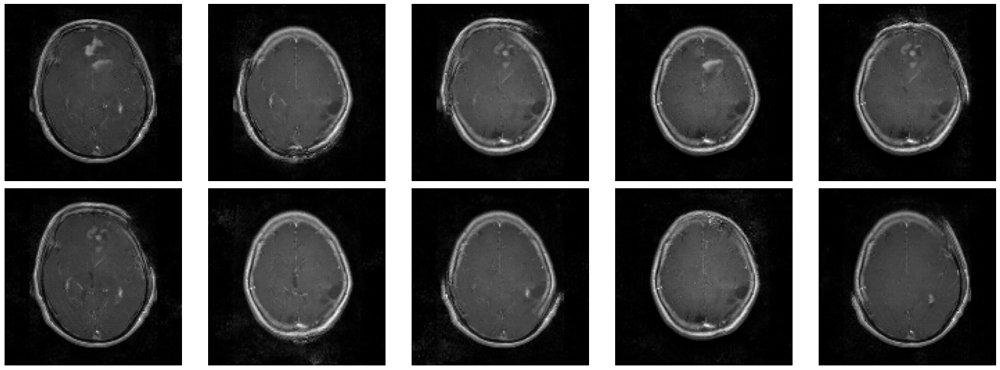

  0%|          | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 1/3750 [00:00<11:31,  5.42it/s]

1/1 [==============================] - 0s 29ms/step


  0%|          | 2/3750 [00:00<12:10,  5.13it/s]

1/1 [==============================] - 0s 38ms/step


  0%|          | 3/3750 [00:00<13:15,  4.71it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 4/3750 [00:00<12:54,  4.84it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 5/3750 [00:01<12:46,  4.89it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 6/3750 [00:01<11:53,  5.25it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 7/3750 [00:01<12:05,  5.16it/s]

1/1 [==============================] - 0s 36ms/step


  0%|          | 8/3750 [00:01<12:11,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 9/3750 [00:01<11:22,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 10/3750 [00:01<10:57,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 11/3750 [00:02<10:32,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 12/3750 [00:02<10:08,  6.15it/s]

1/1 [==============================] - 0s 51ms/step


  0%|          | 13/3750 [00:02<10:46,  5.78it/s]

1/1 [==============================] - 0s 35ms/step


  0%|          | 14/3750 [00:02<10:30,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 15/3750 [00:02<09:53,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 16/3750 [00:02<09:35,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 17/3750 [00:02<09:17,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 18/3750 [00:03<10:05,  6.16it/s]

1/1 [==============================] - 0s 57ms/step


  1%|          | 19/3750 [00:03<10:35,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 20/3750 [00:03<10:33,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 21/3750 [00:03<10:14,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 22/3750 [00:03<09:59,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 23/3750 [00:03<09:47,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 24/3750 [00:04<09:34,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 25/3750 [00:04<09:39,  6.43it/s]

1/1 [==============================] - 0s 46ms/step


  1%|          | 26/3750 [00:04<10:16,  6.04it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 27/3750 [00:04<10:06,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 28/3750 [00:04<09:57,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 29/3750 [00:04<10:17,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 30/3750 [00:05<09:51,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 31/3750 [00:05<09:50,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 32/3750 [00:05<10:43,  5.78it/s]

1/1 [==============================] - 0s 30ms/step


  1%|          | 33/3750 [00:05<10:31,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 34/3750 [00:05<10:03,  6.16it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 35/3750 [00:05<09:53,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 36/3750 [00:06<09:37,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 37/3750 [00:06<09:34,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 38/3750 [00:06<09:30,  6.50it/s]

1/1 [==============================] - 0s 35ms/step


  1%|          | 39/3750 [00:06<10:27,  5.91it/s]

1/1 [==============================] - 0s 34ms/step


  1%|          | 40/3750 [00:06<10:22,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 41/3750 [00:06<10:13,  6.04it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 42/3750 [00:07<09:56,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 43/3750 [00:07<09:32,  6.47it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 44/3750 [00:07<10:07,  6.10it/s]

1/1 [==============================] - 0s 55ms/step


  1%|          | 45/3750 [00:07<11:17,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 46/3750 [00:07<10:35,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 47/3750 [00:07<10:00,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


  1%|▏         | 48/3750 [00:08<09:42,  6.36it/s]

1/1 [==============================] - 0s 27ms/step


  1%|▏         | 49/3750 [00:08<09:39,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 50/3750 [00:08<09:44,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


  1%|▏         | 51/3750 [00:08<10:01,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


  1%|▏         | 52/3750 [00:08<10:32,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 53/3750 [00:08<10:12,  6.03it/s]

1/1 [==============================] - 0s 27ms/step


  1%|▏         | 54/3750 [00:09<09:50,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 55/3750 [00:09<09:35,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 56/3750 [00:09<09:32,  6.45it/s]

1/1 [==============================] - 0s 34ms/step


  2%|▏         | 57/3750 [00:09<10:26,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 58/3750 [00:09<10:29,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 59/3750 [00:09<10:01,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 60/3750 [00:10<09:56,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 61/3750 [00:10<09:56,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 62/3750 [00:10<09:32,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 63/3750 [00:10<09:39,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 64/3750 [00:10<09:35,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 65/3750 [00:10<09:29,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 66/3750 [00:10<09:36,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 67/3750 [00:11<09:29,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 68/3750 [00:11<09:24,  6.52it/s]

1/1 [==============================] - 0s 35ms/step


  2%|▏         | 69/3750 [00:11<09:50,  6.24it/s]

1/1 [==============================] - 0s 37ms/step


  2%|▏         | 70/3750 [00:11<10:08,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 71/3750 [00:11<09:49,  6.24it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 72/3750 [00:11<09:55,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 73/3750 [00:12<09:33,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 74/3750 [00:12<09:09,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 75/3750 [00:12<09:14,  6.62it/s]

1/1 [==============================] - 0s 40ms/step


  2%|▏         | 76/3750 [00:12<09:42,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 77/3750 [00:12<09:46,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 78/3750 [00:12<09:35,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 79/3750 [00:12<09:39,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 80/3750 [00:13<09:18,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 81/3750 [00:13<09:27,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 82/3750 [00:13<09:33,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 83/3750 [00:13<09:42,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 84/3750 [00:13<09:32,  6.41it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 85/3750 [00:13<09:56,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 86/3750 [00:14<09:28,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 87/3750 [00:14<09:17,  6.57it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 88/3750 [00:14<09:24,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 89/3750 [00:14<09:46,  6.24it/s]

1/1 [==============================] - 0s 53ms/step


  2%|▏         | 90/3750 [00:14<10:56,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 91/3750 [00:14<10:17,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 92/3750 [00:15<10:24,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 93/3750 [00:15<10:04,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 94/3750 [00:15<10:02,  6.07it/s]

1/1 [==============================] - 0s 39ms/step


  3%|▎         | 95/3750 [00:15<10:33,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 96/3750 [00:15<10:32,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 97/3750 [00:15<11:02,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 98/3750 [00:16<10:24,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 99/3750 [00:16<10:16,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 100/3750 [00:16<10:10,  5.98it/s]

1/1 [==============================] - 0s 49ms/step


  3%|▎         | 101/3750 [00:16<11:26,  5.32it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 102/3750 [00:16<11:25,  5.32it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 103/3750 [00:17<10:38,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 104/3750 [00:17<10:20,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 105/3750 [00:17<09:57,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 106/3750 [00:17<10:06,  6.00it/s]

1/1 [==============================] - 0s 34ms/step


  3%|▎         | 107/3750 [00:17<10:39,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 108/3750 [00:17<10:07,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 109/3750 [00:17<09:57,  6.09it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 110/3750 [00:18<10:14,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 111/3750 [00:18<09:46,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 112/3750 [00:18<09:46,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 113/3750 [00:18<09:56,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 114/3750 [00:18<10:14,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 115/3750 [00:18<09:43,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 116/3750 [00:19<09:29,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 117/3750 [00:19<09:00,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 118/3750 [00:19<08:37,  7.02it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 119/3750 [00:19<08:31,  7.10it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 120/3750 [00:19<08:32,  7.08it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 121/3750 [00:19<09:20,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 122/3750 [00:19<09:01,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 123/3750 [00:20<08:56,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 124/3750 [00:20<08:57,  6.75it/s]

1/1 [==============================] - 0s 37ms/step


  3%|▎         | 125/3750 [00:20<09:01,  6.69it/s]

1/1 [==============================] - 0s 49ms/step


  3%|▎         | 126/3750 [00:20<09:32,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 127/3750 [00:20<09:23,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 128/3750 [00:20<09:02,  6.68it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 129/3750 [00:21<08:54,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 130/3750 [00:21<08:43,  6.92it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 131/3750 [00:21<08:36,  7.00it/s]

1/1 [==============================] - 0s 40ms/step


  4%|▎         | 132/3750 [00:21<09:01,  6.68it/s]

1/1 [==============================] - 0s 39ms/step


  4%|▎         | 133/3750 [00:21<10:03,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 134/3750 [00:21<09:36,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 135/3750 [00:21<09:29,  6.35it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▎         | 136/3750 [00:22<09:24,  6.40it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▎         | 137/3750 [00:22<09:18,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▎         | 138/3750 [00:22<09:20,  6.44it/s]

1/1 [==============================] - 0s 51ms/step


  4%|▎         | 139/3750 [00:22<09:51,  6.11it/s]

1/1 [==============================] - 0s 39ms/step


  4%|▎         | 140/3750 [00:22<10:03,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 141/3750 [00:22<10:09,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 142/3750 [00:23<09:59,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 143/3750 [00:23<09:53,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 144/3750 [00:23<10:20,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 145/3750 [00:23<10:29,  5.73it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▍         | 146/3750 [00:23<10:09,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 147/3750 [00:24<10:35,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 148/3750 [00:24<10:22,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 149/3750 [00:24<09:49,  6.11it/s]

1/1 [==============================] - 0s 48ms/step


  4%|▍         | 150/3750 [00:24<10:44,  5.59it/s]

1/1 [==============================] - 0s 50ms/step


  4%|▍         | 151/3750 [00:24<11:29,  5.22it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 152/3750 [00:24<11:28,  5.23it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 153/3750 [00:25<10:42,  5.60it/s]

1/1 [==============================] - 0s 33ms/step


  4%|▍         | 154/3750 [00:25<10:22,  5.77it/s]

1/1 [==============================] - 0s 43ms/step


  4%|▍         | 155/3750 [00:25<10:45,  5.57it/s]

1/1 [==============================] - 0s 37ms/step


  4%|▍         | 156/3750 [00:25<11:07,  5.38it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 157/3750 [00:25<10:25,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 158/3750 [00:25<10:03,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 159/3750 [00:26<09:50,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 160/3750 [00:26<09:45,  6.13it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▍         | 161/3750 [00:26<09:45,  6.13it/s]

1/1 [==============================] - 0s 38ms/step


  4%|▍         | 162/3750 [00:26<10:19,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 163/3750 [00:26<10:00,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 164/3750 [00:26<09:40,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 165/3750 [00:27<09:10,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 166/3750 [00:27<09:08,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 167/3750 [00:27<08:51,  6.74it/s]

1/1 [==============================] - 0s 35ms/step


  4%|▍         | 168/3750 [00:27<09:14,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 169/3750 [00:27<09:09,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 170/3750 [00:27<09:01,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▍         | 171/3750 [00:27<09:06,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 172/3750 [00:28<09:02,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 173/3750 [00:28<09:11,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 174/3750 [00:28<09:22,  6.35it/s]

1/1 [==============================] - 0s 34ms/step


  5%|▍         | 175/3750 [00:28<09:36,  6.20it/s]

1/1 [==============================] - 0s 40ms/step


  5%|▍         | 176/3750 [00:28<09:33,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 177/3750 [00:28<09:58,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 178/3750 [00:29<10:29,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 179/3750 [00:29<09:50,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 180/3750 [00:29<09:46,  6.08it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▍         | 181/3750 [00:29<10:00,  5.95it/s]

1/1 [==============================] - 0s 36ms/step


  5%|▍         | 182/3750 [00:29<10:54,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 183/3750 [00:30<11:03,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 184/3750 [00:30<11:15,  5.28it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 185/3750 [00:30<10:48,  5.49it/s]

1/1 [==============================] - 0s 36ms/step


  5%|▍         | 186/3750 [00:30<10:53,  5.45it/s]

1/1 [==============================] - 0s 36ms/step


  5%|▍         | 187/3750 [00:30<10:52,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 188/3750 [00:30<10:17,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 189/3750 [00:31<09:47,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 190/3750 [00:31<09:55,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 191/3750 [00:31<09:45,  6.08it/s]

1/1 [==============================] - 0s 36ms/step


  5%|▌         | 192/3750 [00:31<09:59,  5.93it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▌         | 193/3750 [00:31<09:57,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 194/3750 [00:31<09:50,  6.03it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▌         | 195/3750 [00:32<09:20,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 196/3750 [00:32<08:58,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 197/3750 [00:32<08:48,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 198/3750 [00:32<08:38,  6.85it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 199/3750 [00:32<08:30,  6.96it/s]

1/1 [==============================] - 0s 37ms/step


  5%|▌         | 200/3750 [00:32<09:28,  6.24it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▌         | 201/3750 [00:32<09:31,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 202/3750 [00:33<09:04,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 203/3750 [00:33<08:42,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 204/3750 [00:33<08:40,  6.81it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 205/3750 [00:33<08:14,  7.17it/s]

1/1 [==============================] - 0s 30ms/step


  5%|▌         | 206/3750 [00:33<08:30,  6.94it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▌         | 207/3750 [00:33<08:50,  6.68it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 208/3750 [00:34<09:29,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 209/3750 [00:34<09:37,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 210/3750 [00:34<09:16,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 211/3750 [00:34<08:55,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 212/3750 [00:34<09:07,  6.47it/s]

1/1 [==============================] - 0s 43ms/step


  6%|▌         | 213/3750 [00:34<10:04,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 214/3750 [00:34<09:20,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 215/3750 [00:35<08:53,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 216/3750 [00:35<08:48,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 217/3750 [00:35<08:30,  6.92it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 218/3750 [00:35<08:36,  6.83it/s]

1/1 [==============================] - 0s 55ms/step


  6%|▌         | 219/3750 [00:35<09:33,  6.15it/s]

1/1 [==============================] - 0s 36ms/step


  6%|▌         | 220/3750 [00:35<10:22,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 221/3750 [00:36<10:35,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 222/3750 [00:36<09:56,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 223/3750 [00:36<09:38,  6.10it/s]

1/1 [==============================] - 0s 34ms/step


  6%|▌         | 224/3750 [00:36<09:25,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 225/3750 [00:36<09:43,  6.04it/s]

1/1 [==============================] - 0s 33ms/step


  6%|▌         | 226/3750 [00:36<10:34,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 227/3750 [00:37<09:52,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 228/3750 [00:37<09:17,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 229/3750 [00:37<09:07,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 230/3750 [00:37<09:04,  6.46it/s]

1/1 [==============================] - 0s 47ms/step


  6%|▌         | 231/3750 [00:37<09:47,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 232/3750 [00:37<09:55,  5.91it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 233/3750 [00:38<10:16,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 234/3750 [00:38<09:44,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 235/3750 [00:38<09:22,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 236/3750 [00:38<09:50,  5.95it/s]

1/1 [==============================] - 0s 48ms/step


  6%|▋         | 237/3750 [00:38<10:48,  5.42it/s]

1/1 [==============================] - 0s 34ms/step


  6%|▋         | 238/3750 [00:38<10:15,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▋         | 239/3750 [00:39<09:42,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 240/3750 [00:39<09:28,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 241/3750 [00:39<09:18,  6.28it/s]

1/1 [==============================] - 0s 29ms/step


  6%|▋         | 242/3750 [00:39<09:34,  6.11it/s]

1/1 [==============================] - 0s 59ms/step


  6%|▋         | 243/3750 [00:39<11:22,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 244/3750 [00:40<11:06,  5.26it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 245/3750 [00:40<10:38,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 246/3750 [00:40<10:56,  5.34it/s]

1/1 [==============================] - 0s 53ms/step


  7%|▋         | 247/3750 [00:40<11:25,  5.11it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 248/3750 [00:40<10:34,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 249/3750 [00:40<10:17,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 250/3750 [00:41<09:56,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 251/3750 [00:41<09:44,  5.99it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 252/3750 [00:41<09:30,  6.14it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 253/3750 [00:41<09:59,  5.83it/s]

1/1 [==============================] - 0s 46ms/step


  7%|▋         | 254/3750 [00:41<10:22,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 255/3750 [00:41<09:52,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 256/3750 [00:42<09:29,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 257/3750 [00:42<09:26,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 258/3750 [00:42<09:31,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 259/3750 [00:42<09:26,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 260/3750 [00:42<10:01,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 261/3750 [00:42<09:42,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 262/3750 [00:43<09:35,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 263/3750 [00:43<09:26,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 264/3750 [00:43<09:16,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 265/3750 [00:43<09:17,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 266/3750 [00:43<09:13,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 267/3750 [00:43<09:13,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 268/3750 [00:44<09:09,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 269/3750 [00:44<09:13,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 270/3750 [00:44<09:06,  6.37it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 271/3750 [00:44<09:08,  6.34it/s]

1/1 [==============================] - 0s 37ms/step


  7%|▋         | 272/3750 [00:44<09:41,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 273/3750 [00:44<09:50,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 274/3750 [00:45<10:07,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 275/3750 [00:45<09:48,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 276/3750 [00:45<09:38,  6.00it/s]

1/1 [==============================] - 0s 31ms/step


  7%|▋         | 277/3750 [00:45<09:46,  5.92it/s]

1/1 [==============================] - 0s 35ms/step


  7%|▋         | 278/3750 [00:45<10:11,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 279/3750 [00:45<09:41,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 280/3750 [00:46<09:39,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 281/3750 [00:46<09:54,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 282/3750 [00:46<09:29,  6.09it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 283/3750 [00:46<09:38,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 284/3750 [00:46<09:53,  5.84it/s]

1/1 [==============================] - 0s 35ms/step


  8%|▊         | 285/3750 [00:46<10:57,  5.27it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 286/3750 [00:47<10:17,  5.61it/s]

1/1 [==============================] - 0s 40ms/step


  8%|▊         | 287/3750 [00:47<10:34,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 288/3750 [00:47<10:49,  5.33it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 289/3750 [00:47<10:23,  5.55it/s]

1/1 [==============================] - 0s 48ms/step


  8%|▊         | 290/3750 [00:47<10:44,  5.37it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 291/3750 [00:48<10:11,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 292/3750 [00:48<09:38,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 293/3750 [00:48<09:53,  5.82it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 294/3750 [00:48<09:42,  5.93it/s]

1/1 [==============================] - 0s 74ms/step


  8%|▊         | 295/3750 [00:48<10:33,  5.46it/s]

1/1 [==============================] - 0s 34ms/step


  8%|▊         | 296/3750 [00:48<10:51,  5.30it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 297/3750 [00:49<11:06,  5.18it/s]

1/1 [==============================] - 0s 32ms/step


  8%|▊         | 298/3750 [00:49<10:36,  5.42it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 299/3750 [00:49<10:15,  5.60it/s]

1/1 [==============================] - 0s 47ms/step


  8%|▊         | 300/3750 [00:49<10:26,  5.51it/s]

1/1 [==============================] - 0s 43ms/step


  8%|▊         | 301/3750 [00:49<10:27,  5.49it/s]

1/1 [==============================] - 0s 33ms/step


  8%|▊         | 302/3750 [00:49<10:22,  5.54it/s]

1/1 [==============================] - 0s 35ms/step


  8%|▊         | 303/3750 [00:50<10:23,  5.53it/s]

1/1 [==============================] - 0s 38ms/step


  8%|▊         | 304/3750 [00:50<10:23,  5.53it/s]

1/1 [==============================] - 0s 48ms/step


  8%|▊         | 305/3750 [00:50<10:25,  5.51it/s]

1/1 [==============================] - 0s 34ms/step


  8%|▊         | 306/3750 [00:50<10:23,  5.52it/s]

1/1 [==============================] - 0s 33ms/step


  8%|▊         | 307/3750 [00:50<10:23,  5.52it/s]

1/1 [==============================] - 0s 37ms/step


  8%|▊         | 308/3750 [00:51<10:35,  5.42it/s]

1/1 [==============================] - 0s 36ms/step


  8%|▊         | 309/3750 [00:51<10:49,  5.30it/s]

1/1 [==============================] - 0s 38ms/step


  8%|▊         | 310/3750 [00:51<11:12,  5.11it/s]

1/1 [==============================] - 0s 37ms/step


  8%|▊         | 311/3750 [00:51<11:05,  5.17it/s]

1/1 [==============================] - 0s 63ms/step


  8%|▊         | 312/3750 [00:51<11:59,  4.78it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 313/3750 [00:52<11:55,  4.80it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 314/3750 [00:52<11:36,  4.93it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 315/3750 [00:52<11:25,  5.01it/s]

1/1 [==============================] - 0s 35ms/step


  8%|▊         | 316/3750 [00:52<11:32,  4.96it/s]

1/1 [==============================] - 0s 55ms/step


  8%|▊         | 317/3750 [00:52<12:21,  4.63it/s]

1/1 [==============================] - 0s 33ms/step


  8%|▊         | 318/3750 [00:53<12:00,  4.76it/s]

1/1 [==============================] - 0s 41ms/step


  9%|▊         | 319/3750 [00:53<12:37,  4.53it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▊         | 320/3750 [00:53<11:40,  4.90it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 321/3750 [00:53<11:30,  4.97it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▊         | 322/3750 [00:53<11:37,  4.92it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 323/3750 [00:54<11:33,  4.94it/s]

1/1 [==============================] - 0s 51ms/step


  9%|▊         | 324/3750 [00:54<11:51,  4.82it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 325/3750 [00:54<11:36,  4.92it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 326/3750 [00:54<11:30,  4.96it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 327/3750 [00:54<11:20,  5.03it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 328/3750 [00:55<11:30,  4.95it/s]

1/1 [==============================] - 0s 45ms/step


  9%|▉         | 329/3750 [00:55<12:08,  4.70it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▉         | 330/3750 [00:55<12:00,  4.74it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 331/3750 [00:55<11:43,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▉         | 332/3750 [00:56<11:19,  5.03it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 333/3750 [00:56<11:31,  4.94it/s]

1/1 [==============================] - 0s 54ms/step


  9%|▉         | 334/3750 [00:56<12:14,  4.65it/s]

1/1 [==============================] - 0s 31ms/step


  9%|▉         | 335/3750 [00:56<11:54,  4.78it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 336/3750 [00:56<11:35,  4.91it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 337/3750 [00:57<11:22,  5.00it/s]

1/1 [==============================] - 0s 46ms/step


  9%|▉         | 338/3750 [00:57<11:28,  4.96it/s]

1/1 [==============================] - 0s 54ms/step


  9%|▉         | 339/3750 [00:57<12:17,  4.63it/s]

1/1 [==============================] - 0s 34ms/step


  9%|▉         | 340/3750 [00:57<12:51,  4.42it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 341/3750 [00:57<12:17,  4.62it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 342/3750 [00:58<12:43,  4.46it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 343/3750 [00:58<12:03,  4.71it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 344/3750 [00:58<11:54,  4.76it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 345/3750 [00:58<11:38,  4.87it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 346/3750 [00:58<11:20,  5.00it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 347/3750 [00:59<10:44,  5.28it/s]

1/1 [==============================] - 0s 45ms/step


  9%|▉         | 348/3750 [00:59<11:27,  4.95it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 349/3750 [00:59<11:29,  4.93it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 350/3750 [00:59<11:32,  4.91it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 351/3750 [00:59<10:48,  5.24it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 352/3750 [01:00<10:24,  5.44it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 353/3750 [01:00<10:12,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 354/3750 [01:00<09:46,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 355/3750 [01:00<09:42,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 356/3750 [01:00<09:25,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 357/3750 [01:00<09:17,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 358/3750 [01:01<09:09,  6.17it/s]

1/1 [==============================] - 0s 38ms/step


 10%|▉         | 359/3750 [01:01<09:47,  5.77it/s]

1/1 [==============================] - 0s 42ms/step


 10%|▉         | 360/3750 [01:01<10:29,  5.38it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 361/3750 [01:01<09:50,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 362/3750 [01:01<09:20,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 363/3750 [01:01<09:47,  5.77it/s]

1/1 [==============================] - 0s 32ms/step


 10%|▉         | 364/3750 [01:02<09:31,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 365/3750 [01:02<10:11,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 366/3750 [01:02<09:33,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


 10%|▉         | 367/3750 [01:02<09:49,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 368/3750 [01:02<09:33,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 369/3750 [01:02<09:06,  6.18it/s]

1/1 [==============================] - 0s 34ms/step


 10%|▉         | 370/3750 [01:03<08:51,  6.36it/s]

1/1 [==============================] - 0s 38ms/step


 10%|▉         | 371/3750 [01:03<09:04,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 372/3750 [01:03<08:51,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 373/3750 [01:03<09:27,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 374/3750 [01:03<08:58,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 375/3750 [01:03<08:52,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 376/3750 [01:04<08:56,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 377/3750 [01:04<09:09,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 378/3750 [01:04<09:09,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 379/3750 [01:04<08:43,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 380/3750 [01:04<08:36,  6.52it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 381/3750 [01:04<08:38,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 382/3750 [01:05<08:45,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 383/3750 [01:05<08:50,  6.35it/s]

1/1 [==============================] - 0s 48ms/step


 10%|█         | 384/3750 [01:05<09:21,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 385/3750 [01:05<09:06,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 386/3750 [01:05<08:51,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 387/3750 [01:05<08:50,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 388/3750 [01:05<08:40,  6.46it/s]

1/1 [==============================] - 0s 31ms/step


 10%|█         | 389/3750 [01:06<08:42,  6.43it/s]

1/1 [==============================] - 0s 48ms/step


 10%|█         | 390/3750 [01:06<09:28,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 391/3750 [01:06<09:29,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 392/3750 [01:06<08:48,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 393/3750 [01:06<08:15,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 394/3750 [01:06<08:07,  6.89it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 395/3750 [01:07<08:16,  6.76it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 396/3750 [01:07<08:16,  6.75it/s]

1/1 [==============================] - 0s 47ms/step


 11%|█         | 397/3750 [01:07<08:46,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 398/3750 [01:07<08:17,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 399/3750 [01:07<07:59,  6.99it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 400/3750 [01:07<07:53,  7.07it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 401/3750 [01:07<08:06,  6.89it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 402/3750 [01:08<08:26,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 403/3750 [01:08<08:35,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 404/3750 [01:08<08:28,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 405/3750 [01:08<08:15,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 406/3750 [01:08<07:56,  7.02it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 407/3750 [01:08<07:59,  6.97it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 408/3750 [01:08<07:59,  6.98it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 409/3750 [01:09<08:24,  6.63it/s]

1/1 [==============================] - 0s 54ms/step


 11%|█         | 410/3750 [01:09<09:17,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 411/3750 [01:09<09:00,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 412/3750 [01:09<08:47,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 413/3750 [01:09<08:37,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 414/3750 [01:09<08:42,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 415/3750 [01:10<08:29,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 416/3750 [01:10<08:53,  6.25it/s]

1/1 [==============================] - 0s 48ms/step


 11%|█         | 417/3750 [01:10<09:11,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 418/3750 [01:10<09:09,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 419/3750 [01:10<09:24,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 420/3750 [01:10<09:08,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 421/3750 [01:11<08:58,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 422/3750 [01:11<09:00,  6.15it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█▏        | 423/3750 [01:11<09:13,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 424/3750 [01:11<09:40,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 425/3750 [01:11<09:15,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 426/3750 [01:11<08:49,  6.28it/s]

1/1 [==============================] - 0s 39ms/step


 11%|█▏        | 427/3750 [01:12<09:01,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 428/3750 [01:12<09:12,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 429/3750 [01:12<09:40,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 430/3750 [01:12<09:15,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 431/3750 [01:12<08:58,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 432/3750 [01:12<09:25,  5.87it/s]

1/1 [==============================] - 0s 39ms/step


 12%|█▏        | 433/3750 [01:13<10:04,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 434/3750 [01:13<09:31,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 435/3750 [01:13<09:15,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 436/3750 [01:13<09:29,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 437/3750 [01:13<09:47,  5.64it/s]

1/1 [==============================] - 0s 63ms/step


 12%|█▏        | 438/3750 [01:14<10:41,  5.16it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 439/3750 [01:14<11:04,  4.99it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 440/3750 [01:14<10:02,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 441/3750 [01:14<09:32,  5.78it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 442/3750 [01:14<09:10,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 443/3750 [01:14<09:44,  5.66it/s]

1/1 [==============================] - 0s 50ms/step


 12%|█▏        | 444/3750 [01:15<09:53,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 445/3750 [01:15<09:19,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 446/3750 [01:15<08:59,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 447/3750 [01:15<08:49,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 448/3750 [01:15<08:50,  6.23it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 449/3750 [01:15<09:08,  6.02it/s]

1/1 [==============================] - 0s 49ms/step


 12%|█▏        | 450/3750 [01:16<09:58,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 451/3750 [01:16<09:23,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 452/3750 [01:16<08:59,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 453/3750 [01:16<08:40,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 454/3750 [01:16<08:40,  6.34it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 455/3750 [01:16<08:49,  6.22it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 456/3750 [01:17<09:00,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 457/3750 [01:17<08:42,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 458/3750 [01:17<09:03,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 459/3750 [01:17<08:50,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 460/3750 [01:17<08:36,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 461/3750 [01:17<09:05,  6.03it/s]

1/1 [==============================] - 0s 49ms/step


 12%|█▏        | 462/3750 [01:18<09:22,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 463/3750 [01:18<09:41,  5.65it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 464/3750 [01:18<09:18,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 465/3750 [01:18<09:05,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 466/3750 [01:18<08:49,  6.20it/s]

1/1 [==============================] - 0s 40ms/step


 12%|█▏        | 467/3750 [01:18<09:07,  6.00it/s]

1/1 [==============================] - 0s 50ms/step


 12%|█▏        | 468/3750 [01:19<09:30,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 469/3750 [01:19<09:00,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 470/3750 [01:19<08:41,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 471/3750 [01:19<08:34,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 472/3750 [01:19<09:14,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 473/3750 [01:19<08:46,  6.23it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 474/3750 [01:19<08:40,  6.29it/s]

1/1 [==============================] - 0s 49ms/step


 13%|█▎        | 475/3750 [01:20<10:03,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 476/3750 [01:20<10:10,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 477/3750 [01:20<09:35,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 478/3750 [01:20<09:14,  5.90it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 479/3750 [01:20<09:13,  5.91it/s]

1/1 [==============================] - 0s 34ms/step


 13%|█▎        | 480/3750 [01:21<09:10,  5.94it/s]

1/1 [==============================] - 0s 41ms/step


 13%|█▎        | 481/3750 [01:21<09:02,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 482/3750 [01:21<08:26,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 483/3750 [01:21<08:53,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 484/3750 [01:21<08:40,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 485/3750 [01:21<08:36,  6.32it/s]

1/1 [==============================] - 0s 53ms/step


 13%|█▎        | 486/3750 [01:22<09:17,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 487/3750 [01:22<09:42,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 488/3750 [01:22<09:15,  5.88it/s]

1/1 [==============================] - 0s 34ms/step


 13%|█▎        | 489/3750 [01:22<09:38,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 490/3750 [01:22<09:34,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 491/3750 [01:22<09:09,  5.93it/s]

1/1 [==============================] - 0s 54ms/step


 13%|█▎        | 492/3750 [01:23<09:29,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 493/3750 [01:23<09:12,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 494/3750 [01:23<08:51,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 495/3750 [01:23<09:05,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 496/3750 [01:23<09:06,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 497/3750 [01:23<09:00,  6.02it/s]

1/1 [==============================] - 0s 48ms/step


 13%|█▎        | 498/3750 [01:24<09:17,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 499/3750 [01:24<09:04,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 500/3750 [01:24<08:44,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 501/3750 [01:24<08:29,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 502/3750 [01:24<08:22,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 503/3750 [01:24<08:10,  6.62it/s]

1/1 [==============================] - 0s 36ms/step


 13%|█▎        | 504/3750 [01:25<08:58,  6.03it/s]

1/1 [==============================] - 0s 48ms/step


 13%|█▎        | 505/3750 [01:25<09:31,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 506/3750 [01:25<08:56,  6.05it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▎        | 507/3750 [01:25<09:27,  5.71it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▎        | 508/3750 [01:25<08:59,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 509/3750 [01:25<08:59,  6.00it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▎        | 510/3750 [01:26<08:59,  6.01it/s]

1/1 [==============================] - 0s 53ms/step


 14%|█▎        | 511/3750 [01:26<09:21,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 512/3750 [01:26<09:29,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 513/3750 [01:26<09:01,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 514/3750 [01:26<08:45,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 515/3750 [01:26<08:27,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 516/3750 [01:27<08:39,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 517/3750 [01:27<08:53,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 518/3750 [01:27<08:44,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 519/3750 [01:27<08:19,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 520/3750 [01:27<08:28,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 521/3750 [01:27<08:07,  6.63it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 522/3750 [01:27<07:55,  6.79it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 523/3750 [01:28<07:55,  6.78it/s]

1/1 [==============================] - 0s 53ms/step


 14%|█▍        | 524/3750 [01:28<08:45,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 525/3750 [01:28<08:37,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 526/3750 [01:28<08:59,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 527/3750 [01:28<08:46,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 528/3750 [01:28<08:21,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 529/3750 [01:29<08:19,  6.44it/s]

1/1 [==============================] - 0s 38ms/step


 14%|█▍        | 530/3750 [01:29<09:07,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 531/3750 [01:29<09:07,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 532/3750 [01:29<08:58,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 533/3750 [01:29<08:32,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 534/3750 [01:29<08:24,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 535/3750 [01:30<08:28,  6.32it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 536/3750 [01:30<08:09,  6.56it/s]

1/1 [==============================] - 0s 38ms/step


 14%|█▍        | 537/3750 [01:30<08:31,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 538/3750 [01:30<08:30,  6.29it/s]

1/1 [==============================] - 0s 33ms/step


 14%|█▍        | 539/3750 [01:30<08:51,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 540/3750 [01:30<08:44,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 541/3750 [01:31<08:30,  6.29it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 542/3750 [01:31<08:29,  6.30it/s]

1/1 [==============================] - 0s 46ms/step


 14%|█▍        | 543/3750 [01:31<09:01,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 544/3750 [01:31<08:54,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 545/3750 [01:31<08:36,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 546/3750 [01:31<08:19,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 547/3750 [01:31<08:07,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 548/3750 [01:32<08:12,  6.50it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▍        | 549/3750 [01:32<09:03,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 550/3750 [01:32<09:14,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 551/3750 [01:32<09:19,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 552/3750 [01:32<08:53,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 553/3750 [01:33<08:51,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 554/3750 [01:33<08:49,  6.03it/s]

1/1 [==============================] - 0s 48ms/step


 15%|█▍        | 555/3750 [01:33<09:46,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 556/3750 [01:33<09:56,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 557/3750 [01:33<09:22,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 558/3750 [01:33<09:09,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 559/3750 [01:34<08:56,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 560/3750 [01:34<08:41,  6.12it/s]

1/1 [==============================] - 0s 49ms/step


 15%|█▍        | 561/3750 [01:34<09:39,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 562/3750 [01:34<09:04,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 563/3750 [01:34<09:05,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 564/3750 [01:34<08:57,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 565/3750 [01:35<08:44,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 566/3750 [01:35<08:54,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 567/3750 [01:35<09:09,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 568/3750 [01:35<08:54,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 569/3750 [01:35<09:20,  5.68it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 570/3750 [01:35<09:32,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 571/3750 [01:36<09:23,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 572/3750 [01:36<09:09,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 573/3750 [01:36<09:03,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 574/3750 [01:36<09:00,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 575/3750 [01:36<09:15,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 576/3750 [01:37<09:29,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 577/3750 [01:37<08:57,  5.90it/s]

1/1 [==============================] - 0s 55ms/step


 15%|█▌        | 578/3750 [01:37<09:28,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 579/3750 [01:37<08:53,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 580/3750 [01:37<08:31,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 581/3750 [01:37<08:18,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 582/3750 [01:37<08:16,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 583/3750 [01:38<07:51,  6.71it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 584/3750 [01:38<07:49,  6.74it/s]

1/1 [==============================] - 0s 52ms/step


 16%|█▌        | 585/3750 [01:38<08:38,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 586/3750 [01:38<08:12,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 587/3750 [01:38<08:02,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 588/3750 [01:38<07:53,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 589/3750 [01:39<07:51,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 590/3750 [01:39<07:34,  6.95it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 591/3750 [01:39<07:44,  6.81it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 592/3750 [01:39<07:36,  6.91it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 593/3750 [01:39<07:35,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 594/3750 [01:39<07:42,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 595/3750 [01:39<07:45,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 596/3750 [01:40<07:33,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 597/3750 [01:40<07:30,  7.00it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 598/3750 [01:40<07:33,  6.95it/s]

1/1 [==============================] - 0s 55ms/step


 16%|█▌        | 599/3750 [01:40<08:16,  6.35it/s]

1/1 [==============================] - 0s 51ms/step


 16%|█▌        | 600/3750 [01:40<08:51,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 601/3750 [01:40<08:34,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 602/3750 [01:40<08:11,  6.41it/s]

1/1 [==============================] - 0s 34ms/step


 16%|█▌        | 603/3750 [01:41<07:53,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 604/3750 [01:41<07:55,  6.62it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 605/3750 [01:41<08:19,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 606/3750 [01:41<08:09,  6.42it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▌        | 607/3750 [01:41<08:12,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 608/3750 [01:41<08:47,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 609/3750 [01:42<09:00,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 610/3750 [01:42<08:43,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 611/3750 [01:42<08:23,  6.24it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▋        | 612/3750 [01:42<08:39,  6.04it/s]

1/1 [==============================] - 0s 34ms/step


 16%|█▋        | 613/3750 [01:42<08:40,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 614/3750 [01:42<08:26,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 615/3750 [01:43<08:06,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 616/3750 [01:43<08:22,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 617/3750 [01:43<08:13,  6.35it/s]

1/1 [==============================] - 0s 38ms/step


 16%|█▋        | 618/3750 [01:43<08:20,  6.25it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 619/3750 [01:43<08:10,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 620/3750 [01:43<08:44,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 621/3750 [01:44<08:33,  6.09it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 622/3750 [01:44<08:42,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 623/3750 [01:44<08:48,  5.91it/s]

1/1 [==============================] - 0s 40ms/step


 17%|█▋        | 624/3750 [01:44<09:20,  5.58it/s]

1/1 [==============================] - 0s 48ms/step


 17%|█▋        | 625/3750 [01:44<09:54,  5.26it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 626/3750 [01:45<09:58,  5.22it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 627/3750 [01:45<09:57,  5.23it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 628/3750 [01:45<09:51,  5.28it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 629/3750 [01:45<09:28,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 630/3750 [01:45<09:10,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 631/3750 [01:45<09:11,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 632/3750 [01:46<09:01,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 633/3750 [01:46<08:48,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 634/3750 [01:46<08:35,  6.04it/s]

1/1 [==============================] - 0s 37ms/step


 17%|█▋        | 635/3750 [01:46<08:58,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 636/3750 [01:46<09:12,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 637/3750 [01:46<09:27,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 638/3750 [01:47<08:41,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 639/3750 [01:47<08:08,  6.37it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 640/3750 [01:47<07:54,  6.55it/s]

1/1 [==============================] - 0s 36ms/step


 17%|█▋        | 641/3750 [01:47<08:12,  6.31it/s]

1/1 [==============================] - 0s 49ms/step


 17%|█▋        | 642/3750 [01:47<09:33,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 643/3750 [01:47<09:28,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 644/3750 [01:48<08:58,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 645/3750 [01:48<08:47,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 646/3750 [01:48<08:27,  6.11it/s]

1/1 [==============================] - 0s 37ms/step


 17%|█▋        | 647/3750 [01:48<09:21,  5.52it/s]

1/1 [==============================] - 0s 35ms/step


 17%|█▋        | 648/3750 [01:48<09:16,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 649/3750 [01:48<08:54,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 650/3750 [01:49<08:35,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 651/3750 [01:49<08:16,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 652/3750 [01:49<08:23,  6.16it/s]

1/1 [==============================] - 0s 48ms/step


 17%|█▋        | 653/3750 [01:49<08:48,  5.86it/s]

1/1 [==============================] - 0s 56ms/step


 17%|█▋        | 654/3750 [01:49<09:29,  5.43it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 655/3750 [01:50<09:01,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 656/3750 [01:50<09:21,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 657/3750 [01:50<08:47,  5.86it/s]

1/1 [==============================] - 0s 34ms/step


 18%|█▊        | 658/3750 [01:50<08:47,  5.86it/s]

1/1 [==============================] - 0s 51ms/step


 18%|█▊        | 659/3750 [01:50<09:00,  5.72it/s]

1/1 [==============================] - 0s 37ms/step


 18%|█▊        | 660/3750 [01:50<09:13,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 661/3750 [01:51<08:46,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 662/3750 [01:51<08:47,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 663/3750 [01:51<08:19,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 664/3750 [01:51<08:24,  6.12it/s]

1/1 [==============================] - 0s 50ms/step


 18%|█▊        | 665/3750 [01:51<09:32,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 666/3750 [01:51<08:56,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 667/3750 [01:52<08:37,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 668/3750 [01:52<09:11,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 669/3750 [01:52<08:57,  5.73it/s]

1/1 [==============================] - 0s 34ms/step


 18%|█▊        | 670/3750 [01:52<09:10,  5.59it/s]

1/1 [==============================] - 0s 33ms/step


 18%|█▊        | 671/3750 [01:52<09:08,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 672/3750 [01:52<08:34,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 673/3750 [01:53<08:28,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 674/3750 [01:53<08:07,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 675/3750 [01:53<07:47,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 676/3750 [01:53<07:52,  6.50it/s]

1/1 [==============================] - 0s 35ms/step


 18%|█▊        | 677/3750 [01:53<08:03,  6.35it/s]

1/1 [==============================] - 0s 52ms/step


 18%|█▊        | 678/3750 [01:53<08:37,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 679/3750 [01:54<08:08,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 680/3750 [01:54<08:02,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 681/3750 [01:54<07:42,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 682/3750 [01:54<07:28,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 683/3750 [01:54<07:58,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 684/3750 [01:54<08:00,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 685/3750 [01:54<07:42,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 686/3750 [01:55<07:25,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 687/3750 [01:55<07:15,  7.03it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 688/3750 [01:55<07:20,  6.95it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 689/3750 [01:55<07:05,  7.19it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 690/3750 [01:55<07:13,  7.06it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 691/3750 [01:55<07:45,  6.58it/s]

1/1 [==============================] - 0s 53ms/step


 18%|█▊        | 692/3750 [01:56<08:48,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 693/3750 [01:56<08:37,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 694/3750 [01:56<08:15,  6.17it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▊        | 695/3750 [01:56<08:01,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 696/3750 [01:56<07:47,  6.53it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▊        | 697/3750 [01:56<07:58,  6.38it/s]

1/1 [==============================] - 0s 50ms/step


 19%|█▊        | 698/3750 [01:57<08:57,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 699/3750 [01:57<08:31,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 700/3750 [01:57<08:11,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▊        | 701/3750 [01:57<08:01,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 702/3750 [01:57<08:25,  6.03it/s]

1/1 [==============================] - 0s 35ms/step


 19%|█▊        | 703/3750 [01:57<08:37,  5.89it/s]

1/1 [==============================] - 0s 50ms/step


 19%|█▉        | 704/3750 [01:57<08:51,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 705/3750 [01:58<08:37,  5.88it/s]

1/1 [==============================] - 0s 40ms/step


 19%|█▉        | 706/3750 [01:58<08:36,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 707/3750 [01:58<08:29,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 708/3750 [01:58<08:31,  5.95it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 709/3750 [01:58<08:26,  6.01it/s]

1/1 [==============================] - 0s 51ms/step


 19%|█▉        | 710/3750 [01:59<08:41,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 711/3750 [01:59<08:20,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 712/3750 [01:59<08:09,  6.20it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 713/3750 [01:59<08:46,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 714/3750 [01:59<08:51,  5.72it/s]

1/1 [==============================] - 0s 35ms/step


 19%|█▉        | 715/3750 [01:59<09:08,  5.53it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 716/3750 [02:00<09:11,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 717/3750 [02:00<08:43,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 718/3750 [02:00<08:25,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 719/3750 [02:00<08:12,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 720/3750 [02:00<08:06,  6.23it/s]

1/1 [==============================] - 0s 38ms/step


 19%|█▉        | 721/3750 [02:00<08:16,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 722/3750 [02:01<08:51,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 723/3750 [02:01<09:01,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 724/3750 [02:01<08:49,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 725/3750 [02:01<08:36,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 726/3750 [02:01<08:44,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 727/3750 [02:01<08:34,  5.88it/s]

1/1 [==============================] - 0s 41ms/step


 19%|█▉        | 728/3750 [02:02<08:53,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 729/3750 [02:02<09:09,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 730/3750 [02:02<09:34,  5.25it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 731/3750 [02:02<09:23,  5.35it/s]

1/1 [==============================] - 0s 32ms/step


 20%|█▉        | 732/3750 [02:02<09:30,  5.29it/s]

1/1 [==============================] - 0s 33ms/step


 20%|█▉        | 733/3750 [02:03<09:24,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 734/3750 [02:03<09:22,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 735/3750 [02:03<09:26,  5.32it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 736/3750 [02:03<08:58,  5.60it/s]

1/1 [==============================] - 0s 27ms/step


 20%|█▉        | 737/3750 [02:03<08:31,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 738/3750 [02:03<08:34,  5.85it/s]

1/1 [==============================] - 0s 46ms/step


 20%|█▉        | 739/3750 [02:04<09:09,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 740/3750 [02:04<09:00,  5.57it/s]

1/1 [==============================] - 0s 28ms/step


 20%|█▉        | 741/3750 [02:04<08:36,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 742/3750 [02:04<08:32,  5.87it/s]

1/1 [==============================] - 0s 32ms/step


 20%|█▉        | 743/3750 [02:04<08:22,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 744/3750 [02:04<08:35,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 745/3750 [02:05<13:45,  3.64it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 746/3750 [02:05<13:06,  3.82it/s]

1/1 [==============================] - 0s 62ms/step


 20%|█▉        | 747/3750 [02:05<12:30,  4.00it/s]

1/1 [==============================] - 0s 32ms/step


 20%|█▉        | 748/3750 [02:06<11:13,  4.46it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 749/3750 [02:06<10:02,  4.98it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 750/3750 [02:06<10:05,  4.96it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 751/3750 [02:06<09:27,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 752/3750 [02:06<08:53,  5.62it/s]

1/1 [==============================] - 0s 49ms/step


 20%|██        | 753/3750 [02:06<09:48,  5.09it/s]

1/1 [==============================] - 0s 35ms/step


 20%|██        | 754/3750 [02:07<09:41,  5.15it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 755/3750 [02:07<09:12,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 756/3750 [02:07<08:35,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 757/3750 [02:07<08:42,  5.73it/s]

1/1 [==============================] - 0s 37ms/step


 20%|██        | 758/3750 [02:07<08:46,  5.68it/s]

1/1 [==============================] - 0s 34ms/step


 20%|██        | 759/3750 [02:08<08:47,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 760/3750 [02:08<08:34,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 761/3750 [02:08<08:12,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 762/3750 [02:08<08:29,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 763/3750 [02:08<08:03,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 764/3750 [02:08<07:52,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 765/3750 [02:08<07:53,  6.31it/s]

1/1 [==============================] - 0s 46ms/step


 20%|██        | 766/3750 [02:09<08:08,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 767/3750 [02:09<07:50,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 768/3750 [02:09<07:24,  6.71it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 769/3750 [02:09<07:17,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 770/3750 [02:09<07:40,  6.48it/s]

1/1 [==============================] - 0s 36ms/step


 21%|██        | 771/3750 [02:09<07:38,  6.49it/s]

1/1 [==============================] - 0s 49ms/step


 21%|██        | 772/3750 [02:10<08:05,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 773/3750 [02:10<07:56,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 774/3750 [02:10<07:43,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 775/3750 [02:10<07:19,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 776/3750 [02:10<07:18,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 777/3750 [02:10<07:09,  6.93it/s]

1/1 [==============================] - 0s 45ms/step


 21%|██        | 778/3750 [02:10<08:03,  6.15it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 779/3750 [02:11<08:19,  5.94it/s]

1/1 [==============================] - 0s 34ms/step


 21%|██        | 780/3750 [02:11<08:12,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 781/3750 [02:11<08:09,  6.07it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 782/3750 [02:11<08:06,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 783/3750 [02:11<08:19,  5.93it/s]

1/1 [==============================] - 0s 40ms/step


 21%|██        | 784/3750 [02:12<08:53,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 785/3750 [02:12<08:25,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 786/3750 [02:12<07:59,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 787/3750 [02:12<07:55,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 788/3750 [02:12<07:42,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 789/3750 [02:12<07:56,  6.21it/s]

1/1 [==============================] - 0s 51ms/step


 21%|██        | 790/3750 [02:13<08:45,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 791/3750 [02:13<08:14,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 792/3750 [02:13<07:59,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 793/3750 [02:13<07:57,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 794/3750 [02:13<07:36,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 795/3750 [02:13<07:33,  6.52it/s]

1/1 [==============================] - 0s 46ms/step


 21%|██        | 796/3750 [02:13<08:07,  6.06it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██▏       | 797/3750 [02:14<08:06,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 798/3750 [02:14<07:42,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 799/3750 [02:14<07:54,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██▏       | 800/3750 [02:14<07:41,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 801/3750 [02:14<07:31,  6.53it/s]

1/1 [==============================] - 0s 31ms/step


 21%|██▏       | 802/3750 [02:14<07:39,  6.42it/s]

1/1 [==============================] - 0s 50ms/step


 21%|██▏       | 803/3750 [02:15<08:04,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 804/3750 [02:15<07:52,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██▏       | 805/3750 [02:15<07:35,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 806/3750 [02:15<07:39,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 807/3750 [02:15<07:35,  6.45it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 808/3750 [02:15<07:36,  6.44it/s]

1/1 [==============================] - 0s 55ms/step


 22%|██▏       | 809/3750 [02:16<08:28,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 810/3750 [02:16<07:55,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 811/3750 [02:16<07:26,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 812/3750 [02:16<07:29,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 813/3750 [02:16<07:11,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 814/3750 [02:16<07:03,  6.93it/s]

1/1 [==============================] - 0s 35ms/step


 22%|██▏       | 815/3750 [02:16<07:18,  6.69it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 816/3750 [02:17<07:52,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 817/3750 [02:17<07:44,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 818/3750 [02:17<07:39,  6.37it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 819/3750 [02:17<07:38,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 820/3750 [02:17<07:21,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 821/3750 [02:17<07:17,  6.70it/s]

1/1 [==============================] - 0s 39ms/step


 22%|██▏       | 822/3750 [02:17<07:30,  6.50it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 823/3750 [02:18<07:55,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 824/3750 [02:18<07:38,  6.38it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 825/3750 [02:18<07:13,  6.74it/s]

1/1 [==============================] - 0s 34ms/step


 22%|██▏       | 826/3750 [02:18<07:23,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 827/3750 [02:18<07:17,  6.69it/s]

1/1 [==============================] - 0s 47ms/step


 22%|██▏       | 828/3750 [02:18<08:07,  5.99it/s]

1/1 [==============================] - 0s 40ms/step


 22%|██▏       | 829/3750 [02:19<08:40,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 830/3750 [02:19<08:16,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 831/3750 [02:19<07:50,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 832/3750 [02:19<07:46,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 833/3750 [02:19<07:55,  6.13it/s]

1/1 [==============================] - 0s 57ms/step


 22%|██▏       | 834/3750 [02:19<08:27,  5.75it/s]

1/1 [==============================] - 0s 40ms/step


 22%|██▏       | 835/3750 [02:20<08:49,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 836/3750 [02:20<08:16,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 837/3750 [02:20<07:59,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 838/3750 [02:20<08:26,  5.75it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 839/3750 [02:20<08:19,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 840/3750 [02:21<08:19,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 841/3750 [02:21<08:03,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 842/3750 [02:21<07:50,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 843/3750 [02:21<07:31,  6.44it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 844/3750 [02:21<07:48,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 845/3750 [02:21<07:36,  6.37it/s]

1/1 [==============================] - 0s 54ms/step


 23%|██▎       | 846/3750 [02:21<08:04,  5.99it/s]

1/1 [==============================] - 0s 33ms/step


 23%|██▎       | 847/3750 [02:22<08:24,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 848/3750 [02:22<07:53,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 849/3750 [02:22<07:49,  6.18it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 850/3750 [02:22<07:42,  6.26it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 851/3750 [02:22<07:43,  6.26it/s]

1/1 [==============================] - 0s 52ms/step


 23%|██▎       | 852/3750 [02:22<08:20,  5.79it/s]

1/1 [==============================] - 0s 42ms/step


 23%|██▎       | 853/3750 [02:23<08:25,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 854/3750 [02:23<07:48,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 855/3750 [02:23<07:30,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 856/3750 [02:23<07:13,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 857/3750 [02:23<07:01,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 858/3750 [02:23<07:06,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 859/3750 [02:24<07:24,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 860/3750 [02:24<07:17,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 861/3750 [02:24<07:04,  6.80it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 862/3750 [02:24<06:54,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 863/3750 [02:24<07:22,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 864/3750 [02:24<07:59,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 865/3750 [02:24<07:52,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 866/3750 [02:25<07:53,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 867/3750 [02:25<07:31,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 868/3750 [02:25<07:20,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 869/3750 [02:25<07:13,  6.65it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 870/3750 [02:25<07:03,  6.79it/s]

1/1 [==============================] - 0s 33ms/step


 23%|██▎       | 871/3750 [02:25<07:44,  6.20it/s]

1/1 [==============================] - 0s 45ms/step


 23%|██▎       | 872/3750 [02:26<07:59,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 873/3750 [02:26<07:38,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 874/3750 [02:26<07:32,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 875/3750 [02:26<07:30,  6.39it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 876/3750 [02:26<07:16,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 877/3750 [02:26<07:06,  6.73it/s]

1/1 [==============================] - 0s 39ms/step


 23%|██▎       | 878/3750 [02:26<07:25,  6.44it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 879/3750 [02:27<07:24,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 880/3750 [02:27<07:09,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 881/3750 [02:27<07:00,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 882/3750 [02:27<07:04,  6.76it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▎       | 883/3750 [02:27<06:53,  6.93it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▎       | 884/3750 [02:27<06:45,  7.06it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▎       | 885/3750 [02:27<07:04,  6.75it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▎       | 886/3750 [02:28<07:39,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 887/3750 [02:28<07:28,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▎       | 888/3750 [02:28<07:08,  6.68it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▎       | 889/3750 [02:28<07:11,  6.64it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▎       | 890/3750 [02:28<07:14,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 891/3750 [02:28<07:25,  6.42it/s]

1/1 [==============================] - 0s 57ms/step


 24%|██▍       | 892/3750 [02:29<08:35,  5.54it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 893/3750 [02:29<08:30,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 894/3750 [02:29<08:01,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 895/3750 [02:29<07:51,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 896/3750 [02:29<07:41,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 897/3750 [02:29<07:40,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 898/3750 [02:30<07:56,  5.98it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 899/3750 [02:30<08:41,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 900/3750 [02:30<08:06,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 901/3750 [02:30<07:38,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 902/3750 [02:30<08:05,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 903/3750 [02:30<07:45,  6.12it/s]

1/1 [==============================] - 0s 48ms/step


 24%|██▍       | 904/3750 [02:31<08:12,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 905/3750 [02:31<08:01,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 906/3750 [02:31<07:41,  6.16it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 907/3750 [02:31<07:48,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 908/3750 [02:31<07:34,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 909/3750 [02:31<07:34,  6.25it/s]

1/1 [==============================] - 0s 49ms/step


 24%|██▍       | 910/3750 [02:32<07:48,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 911/3750 [02:32<07:51,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 912/3750 [02:32<07:34,  6.25it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 913/3750 [02:32<07:27,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 914/3750 [02:32<07:18,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 915/3750 [02:32<07:53,  5.99it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 916/3750 [02:33<08:04,  5.85it/s]

1/1 [==============================] - 0s 46ms/step


 24%|██▍       | 917/3750 [02:33<08:43,  5.41it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 918/3750 [02:33<08:10,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 919/3750 [02:33<07:48,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 920/3750 [02:33<07:36,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 921/3750 [02:33<07:44,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 922/3750 [02:34<07:40,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 923/3750 [02:34<07:33,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 924/3750 [02:34<07:56,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 925/3750 [02:34<07:59,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 926/3750 [02:34<08:07,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 927/3750 [02:34<07:59,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 928/3750 [02:35<08:31,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 929/3750 [02:35<07:59,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 930/3750 [02:35<07:38,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 931/3750 [02:35<07:34,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 932/3750 [02:35<07:19,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 933/3750 [02:35<07:26,  6.31it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 934/3750 [02:36<07:28,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 935/3750 [02:36<07:54,  5.93it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 936/3750 [02:36<07:44,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 937/3750 [02:36<07:32,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 938/3750 [02:36<07:47,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 939/3750 [02:36<07:44,  6.05it/s]

1/1 [==============================] - 0s 50ms/step


 25%|██▌       | 940/3750 [02:37<08:02,  5.82it/s]

1/1 [==============================] - 0s 43ms/step


 25%|██▌       | 941/3750 [02:37<08:04,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 942/3750 [02:37<07:44,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 943/3750 [02:37<07:26,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 944/3750 [02:37<07:25,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 945/3750 [02:37<07:17,  6.42it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▌       | 946/3750 [02:38<07:26,  6.28it/s]

1/1 [==============================] - 0s 39ms/step


 25%|██▌       | 947/3750 [02:38<08:05,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 948/3750 [02:38<07:40,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 949/3750 [02:38<07:25,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 950/3750 [02:38<07:41,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 951/3750 [02:38<07:29,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 952/3750 [02:39<07:19,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 953/3750 [02:39<07:20,  6.35it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▌       | 954/3750 [02:39<07:32,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 955/3750 [02:39<07:06,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 956/3750 [02:39<06:53,  6.76it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▌       | 957/3750 [02:39<06:41,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 958/3750 [02:39<06:33,  7.10it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 959/3750 [02:40<06:28,  7.18it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 960/3750 [02:40<06:50,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 961/3750 [02:40<07:16,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 962/3750 [02:40<06:54,  6.73it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 963/3750 [02:40<06:48,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 964/3750 [02:40<06:44,  6.88it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▌       | 965/3750 [02:40<06:38,  6.99it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 966/3750 [02:41<06:49,  6.80it/s]

1/1 [==============================] - 0s 37ms/step


 26%|██▌       | 967/3750 [02:41<07:48,  5.94it/s]

1/1 [==============================] - 0s 33ms/step


 26%|██▌       | 968/3750 [02:41<07:32,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 969/3750 [02:41<07:19,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 970/3750 [02:41<07:01,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 971/3750 [02:41<06:59,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 972/3750 [02:42<07:07,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 973/3750 [02:42<07:19,  6.32it/s]

1/1 [==============================] - 0s 41ms/step


 26%|██▌       | 974/3750 [02:42<08:02,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 975/3750 [02:42<07:51,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 976/3750 [02:42<07:24,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 977/3750 [02:42<07:20,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 978/3750 [02:43<07:09,  6.45it/s]

1/1 [==============================] - 0s 51ms/step


 26%|██▌       | 979/3750 [02:43<07:40,  6.02it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 980/3750 [02:43<07:33,  6.11it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 981/3750 [02:43<07:17,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 982/3750 [02:43<07:13,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 983/3750 [02:43<07:06,  6.49it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 984/3750 [02:43<07:01,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▋       | 985/3750 [02:44<06:54,  6.67it/s]

1/1 [==============================] - 0s 53ms/step


 26%|██▋       | 986/3750 [02:44<07:31,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▋       | 987/3750 [02:44<07:36,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 988/3750 [02:44<07:16,  6.33it/s]

1/1 [==============================] - 0s 36ms/step


 26%|██▋       | 989/3750 [02:44<07:05,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 990/3750 [02:44<06:46,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▋       | 991/3750 [02:45<07:15,  6.33it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▋       | 992/3750 [02:45<07:20,  6.26it/s]

1/1 [==============================] - 0s 54ms/step


 26%|██▋       | 993/3750 [02:45<08:12,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 994/3750 [02:45<07:49,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 995/3750 [02:45<08:09,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 996/3750 [02:46<08:16,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 997/3750 [02:46<07:54,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 998/3750 [02:46<08:09,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 999/3750 [02:46<07:46,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1000/3750 [02:46<07:41,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1001/3750 [02:46<07:56,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1002/3750 [02:47<08:17,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 1003/3750 [02:47<08:28,  5.40it/s]

1/1 [==============================] - 0s 34ms/step


 27%|██▋       | 1004/3750 [02:47<08:52,  5.16it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1005/3750 [02:47<08:44,  5.24it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 1006/3750 [02:47<08:42,  5.25it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1007/3750 [02:48<08:29,  5.38it/s]

1/1 [==============================] - 0s 56ms/step


 27%|██▋       | 1008/3750 [02:48<08:46,  5.21it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 1009/3750 [02:48<08:18,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 1010/3750 [02:48<08:02,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1011/3750 [02:48<07:54,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1012/3750 [02:48<07:56,  5.74it/s]

1/1 [==============================] - 0s 52ms/step


 27%|██▋       | 1013/3750 [02:49<08:22,  5.44it/s]

1/1 [==============================] - 0s 52ms/step


 27%|██▋       | 1014/3750 [02:49<08:43,  5.23it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 1015/3750 [02:49<08:05,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1016/3750 [02:49<07:55,  5.75it/s]

1/1 [==============================] - 0s 42ms/step


 27%|██▋       | 1017/3750 [02:49<08:20,  5.47it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 1018/3750 [02:49<08:05,  5.63it/s]

1/1 [==============================] - 0s 54ms/step


 27%|██▋       | 1019/3750 [02:50<09:28,  4.81it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1020/3750 [02:50<09:15,  4.92it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1021/3750 [02:50<08:35,  5.30it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1022/3750 [02:50<08:48,  5.16it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 1023/3750 [02:50<08:27,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1024/3750 [02:51<08:13,  5.52it/s]

1/1 [==============================] - 0s 43ms/step


 27%|██▋       | 1025/3750 [02:51<08:33,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1026/3750 [02:51<08:10,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1027/3750 [02:51<08:06,  5.60it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 1028/3750 [02:51<07:49,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1029/3750 [02:52<07:42,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1030/3750 [02:52<07:55,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 1031/3750 [02:52<08:11,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1032/3750 [02:52<08:14,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 1033/3750 [02:52<07:52,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 1034/3750 [02:52<08:20,  5.43it/s]

1/1 [==============================] - 0s 49ms/step


 28%|██▊       | 1035/3750 [02:53<08:34,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1036/3750 [02:53<08:44,  5.17it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1037/3750 [02:53<08:40,  5.21it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1038/3750 [02:53<08:47,  5.14it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1039/3750 [02:53<08:42,  5.19it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 1040/3750 [02:54<08:56,  5.05it/s]

1/1 [==============================] - 0s 40ms/step


 28%|██▊       | 1041/3750 [02:54<08:48,  5.12it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 1042/3750 [02:54<08:50,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1043/3750 [02:54<08:06,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1044/3750 [02:54<07:51,  5.74it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 1045/3750 [02:54<07:42,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 1046/3750 [02:55<07:59,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 1047/3750 [02:55<07:43,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1048/3750 [02:55<07:33,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1049/3750 [02:55<07:28,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1050/3750 [02:55<07:00,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1051/3750 [02:55<06:48,  6.61it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 1052/3750 [02:56<07:21,  6.11it/s]

1/1 [==============================] - 0s 44ms/step


 28%|██▊       | 1053/3750 [02:56<08:00,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1054/3750 [02:56<08:08,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1055/3750 [02:56<08:16,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1056/3750 [02:56<08:15,  5.44it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 1057/3750 [02:57<07:54,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1058/3750 [02:57<07:56,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1059/3750 [02:57<08:11,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1060/3750 [02:57<07:58,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1061/3750 [02:57<07:42,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1062/3750 [02:57<07:38,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1063/3750 [02:58<07:53,  5.67it/s]

1/1 [==============================] - 0s 54ms/step


 28%|██▊       | 1064/3750 [02:58<08:15,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1065/3750 [02:58<08:08,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1066/3750 [02:58<07:40,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1067/3750 [02:58<07:31,  5.94it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 1068/3750 [02:58<07:34,  5.90it/s]

1/1 [==============================] - 0s 39ms/step


 29%|██▊       | 1069/3750 [02:59<08:03,  5.54it/s]

1/1 [==============================] - 0s 39ms/step


 29%|██▊       | 1070/3750 [02:59<08:31,  5.24it/s]

1/1 [==============================] - 0s 28ms/step


 29%|██▊       | 1071/3750 [02:59<08:12,  5.44it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▊       | 1072/3750 [02:59<08:03,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▊       | 1073/3750 [02:59<08:06,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 1074/3750 [03:00<07:56,  5.62it/s]

1/1 [==============================] - 0s 54ms/step


 29%|██▊       | 1075/3750 [03:00<08:40,  5.14it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 1076/3750 [03:00<08:08,  5.47it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▊       | 1077/3750 [03:00<07:38,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 1078/3750 [03:00<07:20,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1079/3750 [03:00<07:05,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1080/3750 [03:01<06:53,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1081/3750 [03:01<07:22,  6.03it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 1082/3750 [03:01<07:51,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1083/3750 [03:01<08:04,  5.50it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1084/3750 [03:01<07:31,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1085/3750 [03:01<07:26,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1086/3750 [03:02<07:12,  6.16it/s]

1/1 [==============================] - 0s 50ms/step


 29%|██▉       | 1087/3750 [03:02<07:29,  5.92it/s]

1/1 [==============================] - 0s 51ms/step


 29%|██▉       | 1088/3750 [03:02<08:10,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1089/3750 [03:02<07:44,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1090/3750 [03:02<07:31,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1091/3750 [03:02<07:25,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1092/3750 [03:03<07:16,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1093/3750 [03:03<07:36,  5.82it/s]

1/1 [==============================] - 0s 56ms/step


 29%|██▉       | 1094/3750 [03:03<07:58,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1095/3750 [03:03<08:15,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1096/3750 [03:03<07:40,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1097/3750 [03:04<07:22,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1098/3750 [03:04<07:50,  5.64it/s]

1/1 [==============================] - 0s 38ms/step


 29%|██▉       | 1099/3750 [03:04<07:52,  5.61it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▉       | 1100/3750 [03:04<08:03,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1101/3750 [03:04<07:58,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1102/3750 [03:04<07:44,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1103/3750 [03:05<07:20,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1104/3750 [03:05<07:42,  5.72it/s]

1/1 [==============================] - 0s 50ms/step


 29%|██▉       | 1105/3750 [03:05<07:55,  5.57it/s]

1/1 [==============================] - 0s 49ms/step


 29%|██▉       | 1106/3750 [03:05<08:27,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1107/3750 [03:05<08:26,  5.21it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1108/3750 [03:06<08:30,  5.18it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1109/3750 [03:06<08:28,  5.19it/s]

1/1 [==============================] - 0s 28ms/step


 30%|██▉       | 1110/3750 [03:06<08:36,  5.11it/s]

1/1 [==============================] - 0s 30ms/step


 30%|██▉       | 1111/3750 [03:06<08:50,  4.98it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1112/3750 [03:06<08:42,  5.05it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1113/3750 [03:07<08:43,  5.03it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1114/3750 [03:07<08:32,  5.14it/s]

1/1 [==============================] - 0s 34ms/step


 30%|██▉       | 1115/3750 [03:07<08:26,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 30%|██▉       | 1116/3750 [03:07<08:28,  5.18it/s]

1/1 [==============================] - 0s 27ms/step


 30%|██▉       | 1117/3750 [03:07<08:28,  5.17it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1118/3750 [03:07<08:09,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1119/3750 [03:08<07:52,  5.57it/s]

1/1 [==============================] - 0s 29ms/step


 30%|██▉       | 1120/3750 [03:08<07:39,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1121/3750 [03:08<07:45,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1122/3750 [03:08<08:07,  5.39it/s]

1/1 [==============================] - 0s 31ms/step


 30%|██▉       | 1123/3750 [03:08<07:51,  5.58it/s]

1/1 [==============================] - 0s 26ms/step


 30%|██▉       | 1124/3750 [03:09<08:08,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1125/3750 [03:09<07:42,  5.68it/s]

1/1 [==============================] - 0s 34ms/step


 30%|███       | 1126/3750 [03:09<07:50,  5.58it/s]

1/1 [==============================] - 0s 46ms/step


 30%|███       | 1127/3750 [03:09<08:22,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1128/3750 [03:09<07:48,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1129/3750 [03:09<07:19,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1130/3750 [03:10<07:03,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1131/3750 [03:10<06:53,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1132/3750 [03:10<06:44,  6.46it/s]

1/1 [==============================] - 0s 30ms/step


 30%|███       | 1133/3750 [03:10<07:09,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1134/3750 [03:10<07:00,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1135/3750 [03:10<06:47,  6.41it/s]

1/1 [==============================] - 0s 28ms/step


 30%|███       | 1136/3750 [03:11<06:40,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1137/3750 [03:11<06:28,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1138/3750 [03:11<06:49,  6.38it/s]

1/1 [==============================] - 0s 41ms/step


 30%|███       | 1139/3750 [03:11<07:15,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1140/3750 [03:11<07:19,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 1141/3750 [03:11<06:57,  6.24it/s]

1/1 [==============================] - 0s 27ms/step


 30%|███       | 1142/3750 [03:11<06:39,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1143/3750 [03:12<06:40,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1144/3750 [03:12<06:33,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1145/3750 [03:12<06:20,  6.84it/s]

1/1 [==============================] - 0s 33ms/step


 31%|███       | 1146/3750 [03:12<06:39,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1147/3750 [03:12<06:44,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1148/3750 [03:12<06:23,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1149/3750 [03:13<06:52,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1150/3750 [03:13<06:55,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1151/3750 [03:13<06:51,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1152/3750 [03:13<07:00,  6.18it/s]

1/1 [==============================] - 0s 48ms/step


 31%|███       | 1153/3750 [03:13<07:11,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1154/3750 [03:13<07:02,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1155/3750 [03:14<06:56,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1156/3750 [03:14<06:49,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1157/3750 [03:14<06:37,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1158/3750 [03:14<06:26,  6.71it/s]

1/1 [==============================] - 0s 29ms/step


 31%|███       | 1159/3750 [03:14<06:50,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1160/3750 [03:14<06:55,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1161/3750 [03:14<07:06,  6.07it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1162/3750 [03:15<07:33,  5.71it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1163/3750 [03:15<07:11,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1164/3750 [03:15<06:44,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1165/3750 [03:15<06:42,  6.41it/s]

1/1 [==============================] - 0s 37ms/step


 31%|███       | 1166/3750 [03:15<07:15,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1167/3750 [03:15<07:19,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1168/3750 [03:16<07:41,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1169/3750 [03:16<07:38,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1170/3750 [03:16<07:40,  5.60it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1171/3750 [03:16<07:25,  5.79it/s]

1/1 [==============================] - 0s 51ms/step


 31%|███▏      | 1172/3750 [03:16<07:51,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1173/3750 [03:17<07:49,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1174/3750 [03:17<07:26,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1175/3750 [03:17<07:04,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 1176/3750 [03:17<07:00,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1177/3750 [03:17<07:00,  6.12it/s]

1/1 [==============================] - 0s 44ms/step


 31%|███▏      | 1178/3750 [03:17<07:13,  5.94it/s]

1/1 [==============================] - 0s 36ms/step


 31%|███▏      | 1179/3750 [03:18<07:22,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1180/3750 [03:18<07:14,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███▏      | 1181/3750 [03:18<07:04,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1182/3750 [03:18<06:49,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1183/3750 [03:18<07:07,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1184/3750 [03:18<07:07,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1185/3750 [03:19<07:27,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1186/3750 [03:19<07:01,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1187/3750 [03:19<06:55,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1188/3750 [03:19<07:18,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1189/3750 [03:19<07:34,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1190/3750 [03:19<07:30,  5.68it/s]

1/1 [==============================] - 0s 35ms/step


 32%|███▏      | 1191/3750 [03:20<07:27,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1192/3750 [03:20<07:06,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1193/3750 [03:20<07:01,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1194/3750 [03:20<06:49,  6.24it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1195/3750 [03:20<06:36,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1196/3750 [03:20<06:56,  6.14it/s]

1/1 [==============================] - 0s 40ms/step


 32%|███▏      | 1197/3750 [03:21<07:19,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1198/3750 [03:21<07:48,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1199/3750 [03:21<07:50,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1200/3750 [03:21<07:23,  5.75it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1201/3750 [03:21<07:50,  5.42it/s]

1/1 [==============================] - 0s 40ms/step


 32%|███▏      | 1202/3750 [03:22<08:14,  5.16it/s]

1/1 [==============================] - 0s 37ms/step


 32%|███▏      | 1203/3750 [03:22<07:55,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1204/3750 [03:22<07:30,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1205/3750 [03:22<07:14,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1206/3750 [03:22<07:06,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1207/3750 [03:22<06:55,  6.12it/s]

1/1 [==============================] - 0s 39ms/step


 32%|███▏      | 1208/3750 [03:22<06:53,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1209/3750 [03:23<06:55,  6.12it/s]

1/1 [==============================] - 0s 44ms/step


 32%|███▏      | 1210/3750 [03:23<07:04,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1211/3750 [03:23<06:58,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1212/3750 [03:23<06:43,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1213/3750 [03:23<06:38,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1214/3750 [03:23<06:38,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1215/3750 [03:24<06:37,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1216/3750 [03:24<06:53,  6.12it/s]

1/1 [==============================] - 0s 40ms/step


 32%|███▏      | 1217/3750 [03:24<06:59,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1218/3750 [03:24<06:46,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1219/3750 [03:24<06:39,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1220/3750 [03:24<06:52,  6.13it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 1221/3750 [03:25<07:15,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1222/3750 [03:25<07:07,  5.91it/s]

1/1 [==============================] - 0s 49ms/step


 33%|███▎      | 1223/3750 [03:25<07:44,  5.44it/s]

1/1 [==============================] - 0s 35ms/step


 33%|███▎      | 1224/3750 [03:25<07:18,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1225/3750 [03:25<06:44,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1226/3750 [03:25<06:28,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1227/3750 [03:26<06:23,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1228/3750 [03:26<06:14,  6.73it/s]

1/1 [==============================] - 0s 39ms/step


 33%|███▎      | 1229/3750 [03:26<07:03,  5.95it/s]

1/1 [==============================] - 0s 40ms/step


 33%|███▎      | 1230/3750 [03:26<07:21,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1231/3750 [03:26<06:57,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1232/3750 [03:26<06:44,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1233/3750 [03:27<06:34,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1234/3750 [03:27<06:22,  6.59it/s]

1/1 [==============================] - 0s 36ms/step


 33%|███▎      | 1235/3750 [03:27<07:18,  5.73it/s]

1/1 [==============================] - 0s 46ms/step


 33%|███▎      | 1236/3750 [03:27<07:23,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1237/3750 [03:27<07:27,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1238/3750 [03:27<07:01,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1239/3750 [03:28<06:52,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1240/3750 [03:28<06:36,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1241/3750 [03:28<06:32,  6.39it/s]

1/1 [==============================] - 0s 61ms/step


 33%|███▎      | 1242/3750 [03:28<07:28,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1243/3750 [03:28<07:03,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1244/3750 [03:28<06:54,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1245/3750 [03:29<06:32,  6.39it/s]

1/1 [==============================] - 0s 36ms/step


 33%|███▎      | 1246/3750 [03:29<06:34,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1247/3750 [03:29<06:30,  6.40it/s]

1/1 [==============================] - 0s 60ms/step


 33%|███▎      | 1248/3750 [03:29<07:36,  5.48it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1249/3750 [03:29<07:24,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1250/3750 [03:29<07:31,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1251/3750 [03:30<07:10,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1252/3750 [03:30<07:08,  5.83it/s]

1/1 [==============================] - 0s 32ms/step


 33%|███▎      | 1253/3750 [03:30<07:03,  5.89it/s]

1/1 [==============================] - 0s 42ms/step


 33%|███▎      | 1254/3750 [03:30<07:18,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1255/3750 [03:30<06:55,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1256/3750 [03:30<06:38,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1257/3750 [03:31<06:28,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1258/3750 [03:31<06:25,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1259/3750 [03:31<06:25,  6.46it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 1260/3750 [03:31<06:48,  6.09it/s]

1/1 [==============================] - 0s 45ms/step


 34%|███▎      | 1261/3750 [03:31<07:04,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1262/3750 [03:31<06:50,  6.06it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 1263/3750 [03:32<06:40,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1264/3750 [03:32<06:37,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1265/3750 [03:32<06:21,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1266/3750 [03:32<06:26,  6.42it/s]

1/1 [==============================] - 0s 37ms/step


 34%|███▍      | 1267/3750 [03:32<06:44,  6.14it/s]

1/1 [==============================] - 0s 54ms/step


 34%|███▍      | 1268/3750 [03:32<07:51,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1269/3750 [03:33<07:26,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1270/3750 [03:33<07:15,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1271/3750 [03:33<07:00,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1272/3750 [03:33<07:00,  5.90it/s]

1/1 [==============================] - 0s 39ms/step


 34%|███▍      | 1273/3750 [03:33<07:12,  5.73it/s]

1/1 [==============================] - 0s 50ms/step


 34%|███▍      | 1274/3750 [03:34<07:54,  5.22it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1275/3750 [03:34<07:24,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1276/3750 [03:34<07:20,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1277/3750 [03:34<07:42,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1278/3750 [03:34<07:26,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1279/3750 [03:34<07:49,  5.26it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1280/3750 [03:35<07:49,  5.26it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1281/3750 [03:35<07:41,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1282/3750 [03:35<07:39,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1283/3750 [03:35<07:37,  5.39it/s]

1/1 [==============================] - 0s 47ms/step


 34%|███▍      | 1284/3750 [03:35<08:09,  5.04it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1285/3750 [03:36<07:59,  5.14it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1286/3750 [03:36<07:29,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1287/3750 [03:36<07:02,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1288/3750 [03:36<07:09,  5.74it/s]

1/1 [==============================] - 0s 57ms/step


 34%|███▍      | 1289/3750 [03:36<07:36,  5.39it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1290/3750 [03:36<07:40,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1291/3750 [03:37<07:25,  5.53it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1292/3750 [03:37<07:19,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1293/3750 [03:37<07:20,  5.57it/s]

1/1 [==============================] - 0s 41ms/step


 35%|███▍      | 1294/3750 [03:37<07:21,  5.57it/s]

1/1 [==============================] - 0s 52ms/step


 35%|███▍      | 1295/3750 [03:37<07:58,  5.13it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1296/3750 [03:38<07:40,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1297/3750 [03:38<07:43,  5.29it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1298/3750 [03:38<07:37,  5.36it/s]

1/1 [==============================] - 0s 41ms/step


 35%|███▍      | 1299/3750 [03:38<07:41,  5.31it/s]

1/1 [==============================] - 0s 47ms/step


 35%|███▍      | 1300/3750 [03:38<07:37,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 1301/3750 [03:38<07:06,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1302/3750 [03:39<06:54,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1303/3750 [03:39<06:43,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1304/3750 [03:39<07:01,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1305/3750 [03:39<06:48,  5.98it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▍      | 1306/3750 [03:39<06:38,  6.13it/s]

1/1 [==============================] - 0s 52ms/step


 35%|███▍      | 1307/3750 [03:39<07:05,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1308/3750 [03:40<06:47,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1309/3750 [03:40<06:38,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1310/3750 [03:40<06:29,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1311/3750 [03:40<06:27,  6.29it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▍      | 1312/3750 [03:40<06:34,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1313/3750 [03:40<06:38,  6.11it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▌      | 1314/3750 [03:41<06:40,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1315/3750 [03:41<06:30,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1316/3750 [03:41<06:34,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1317/3750 [03:41<06:56,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1318/3750 [03:41<07:02,  5.76it/s]

1/1 [==============================] - 0s 53ms/step


 35%|███▌      | 1319/3750 [03:41<07:17,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1320/3750 [03:42<06:51,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1321/3750 [03:42<06:45,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1322/3750 [03:42<06:39,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1323/3750 [03:42<06:32,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1324/3750 [03:42<06:24,  6.32it/s]

1/1 [==============================] - 0s 47ms/step


 35%|███▌      | 1325/3750 [03:42<06:43,  6.01it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 1326/3750 [03:43<06:33,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1327/3750 [03:43<06:21,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1328/3750 [03:43<06:14,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1329/3750 [03:43<06:12,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1330/3750 [03:43<06:28,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1331/3750 [03:43<06:12,  6.50it/s]

1/1 [==============================] - 0s 51ms/step


 36%|███▌      | 1332/3750 [03:44<06:33,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1333/3750 [03:44<06:27,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1334/3750 [03:44<06:22,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1335/3750 [03:44<06:23,  6.30it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1336/3750 [03:44<06:17,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1337/3750 [03:44<06:05,  6.60it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1338/3750 [03:44<06:10,  6.51it/s]

1/1 [==============================] - 0s 37ms/step


 36%|███▌      | 1339/3750 [03:45<06:23,  6.28it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1340/3750 [03:45<06:20,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1341/3750 [03:45<06:11,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1342/3750 [03:45<06:14,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1343/3750 [03:45<06:14,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1344/3750 [03:45<06:48,  5.89it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1345/3750 [03:46<06:31,  6.14it/s]

1/1 [==============================] - 0s 51ms/step


 36%|███▌      | 1346/3750 [03:46<06:46,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1347/3750 [03:46<06:36,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1348/3750 [03:46<06:55,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1349/3750 [03:46<07:12,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1350/3750 [03:46<06:52,  5.82it/s]

1/1 [==============================] - 0s 46ms/step


 36%|███▌      | 1351/3750 [03:47<07:03,  5.66it/s]

1/1 [==============================] - 0s 52ms/step


 36%|███▌      | 1352/3750 [03:47<07:12,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1353/3750 [03:47<06:56,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1354/3750 [03:47<06:47,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1355/3750 [03:47<06:38,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1356/3750 [03:47<06:51,  5.81it/s]

1/1 [==============================] - 0s 56ms/step


 36%|███▌      | 1357/3750 [03:48<07:49,  5.10it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1358/3750 [03:48<07:19,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1359/3750 [03:48<06:49,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1360/3750 [03:48<06:36,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1361/3750 [03:48<06:27,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1362/3750 [03:49<06:50,  5.82it/s]

1/1 [==============================] - 0s 58ms/step


 36%|███▋      | 1363/3750 [03:49<07:20,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1364/3750 [03:49<07:35,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1365/3750 [03:49<07:16,  5.47it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▋      | 1366/3750 [03:49<06:57,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1367/3750 [03:49<07:06,  5.59it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▋      | 1368/3750 [03:50<06:46,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1369/3750 [03:50<06:44,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1370/3750 [03:50<06:41,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1371/3750 [03:50<06:22,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1372/3750 [03:50<06:14,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1373/3750 [03:50<06:05,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1374/3750 [03:51<06:19,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1375/3750 [03:51<06:18,  6.28it/s]

1/1 [==============================] - 0s 55ms/step


 37%|███▋      | 1376/3750 [03:51<06:54,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1377/3750 [03:51<07:02,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1378/3750 [03:51<06:48,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1379/3750 [03:51<07:02,  5.62it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1380/3750 [03:52<07:13,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1381/3750 [03:52<07:04,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1382/3750 [03:52<07:02,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1383/3750 [03:52<06:35,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1384/3750 [03:52<06:56,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1385/3750 [03:52<06:39,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1386/3750 [03:53<06:44,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1387/3750 [03:53<06:34,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1388/3750 [03:53<06:38,  5.93it/s]

1/1 [==============================] - 0s 49ms/step


 37%|███▋      | 1389/3750 [03:53<06:45,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1390/3750 [03:53<06:35,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1391/3750 [03:53<06:29,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1392/3750 [03:54<06:14,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1393/3750 [03:54<06:10,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1394/3750 [03:54<06:19,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1395/3750 [03:54<06:36,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1396/3750 [03:54<06:28,  6.06it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1397/3750 [03:54<06:21,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1398/3750 [03:55<06:11,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1399/3750 [03:55<06:04,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1400/3750 [03:55<06:04,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1401/3750 [03:55<06:08,  6.38it/s]

1/1 [==============================] - 0s 46ms/step


 37%|███▋      | 1402/3750 [03:55<06:30,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1403/3750 [03:55<06:19,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1404/3750 [03:56<06:08,  6.36it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1405/3750 [03:56<06:02,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1406/3750 [03:56<05:54,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1407/3750 [03:56<05:51,  6.66it/s]

1/1 [==============================] - 0s 36ms/step


 38%|███▊      | 1408/3750 [03:56<06:21,  6.14it/s]

1/1 [==============================] - 0s 47ms/step


 38%|███▊      | 1409/3750 [03:56<06:38,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1410/3750 [03:57<06:37,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1411/3750 [03:57<06:21,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1412/3750 [03:57<06:03,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1413/3750 [03:57<06:02,  6.44it/s]

1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 1414/3750 [03:57<06:05,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1415/3750 [03:57<06:23,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1416/3750 [03:57<06:14,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1417/3750 [03:58<05:54,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1418/3750 [03:58<05:45,  6.75it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1419/3750 [03:58<05:38,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1420/3750 [03:58<06:05,  6.38it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1421/3750 [03:58<05:59,  6.48it/s]

1/1 [==============================] - 0s 45ms/step


 38%|███▊      | 1422/3750 [03:58<06:23,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1423/3750 [03:59<06:03,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1424/3750 [03:59<05:49,  6.65it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1425/3750 [03:59<05:53,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1426/3750 [03:59<05:47,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1427/3750 [03:59<06:07,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1428/3750 [03:59<06:10,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1429/3750 [03:59<06:05,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1430/3750 [04:00<05:54,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1431/3750 [04:00<05:54,  6.55it/s]

1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 1432/3750 [04:00<05:56,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1433/3750 [04:00<05:52,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1434/3750 [04:00<05:54,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1435/3750 [04:00<06:00,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1436/3750 [04:01<06:25,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1437/3750 [04:01<06:11,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1438/3750 [04:01<06:08,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1439/3750 [04:01<06:09,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1440/3750 [04:01<06:05,  6.32it/s]

1/1 [==============================] - 0s 54ms/step


 38%|███▊      | 1441/3750 [04:01<06:50,  5.63it/s]

1/1 [==============================] - 0s 39ms/step


 38%|███▊      | 1442/3750 [04:02<07:13,  5.32it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1443/3750 [04:02<06:53,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1444/3750 [04:02<06:46,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1445/3750 [04:02<06:28,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▊      | 1446/3750 [04:02<06:43,  5.70it/s]

1/1 [==============================] - 0s 55ms/step


 39%|███▊      | 1447/3750 [04:03<07:02,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▊      | 1448/3750 [04:03<06:39,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1449/3750 [04:03<06:23,  6.00it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▊      | 1450/3750 [04:03<06:48,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1451/3750 [04:03<06:46,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1452/3750 [04:03<06:34,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1453/3750 [04:04<06:29,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1454/3750 [04:04<06:49,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1455/3750 [04:04<06:26,  5.94it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1456/3750 [04:04<06:20,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1457/3750 [04:04<06:20,  6.03it/s]

1/1 [==============================] - 0s 35ms/step


 39%|███▉      | 1458/3750 [04:04<06:24,  5.97it/s]

1/1 [==============================] - 0s 56ms/step


 39%|███▉      | 1459/3750 [04:05<07:09,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1460/3750 [04:05<06:51,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1461/3750 [04:05<06:30,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1462/3750 [04:05<06:27,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1463/3750 [04:05<06:16,  6.07it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1464/3750 [04:05<06:39,  5.72it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▉      | 1465/3750 [04:06<06:39,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1466/3750 [04:06<06:48,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1467/3750 [04:06<06:30,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1468/3750 [04:06<06:32,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1469/3750 [04:06<06:44,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1470/3750 [04:07<07:09,  5.31it/s]

1/1 [==============================] - 0s 48ms/step


 39%|███▉      | 1471/3750 [04:07<07:10,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1472/3750 [04:07<07:05,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1473/3750 [04:07<06:44,  5.63it/s]

1/1 [==============================] - 0s 32ms/step


 39%|███▉      | 1474/3750 [04:07<06:39,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1475/3750 [04:07<06:40,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1476/3750 [04:08<06:37,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1477/3750 [04:08<06:48,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1478/3750 [04:08<06:32,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1479/3750 [04:08<06:26,  5.88it/s]

1/1 [==============================] - 0s 35ms/step


 39%|███▉      | 1480/3750 [04:08<06:18,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1481/3750 [04:08<06:07,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1482/3750 [04:09<06:14,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1483/3750 [04:09<06:31,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1484/3750 [04:09<06:15,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1485/3750 [04:09<06:03,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1486/3750 [04:09<06:31,  5.79it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1487/3750 [04:09<06:19,  5.96it/s]

1/1 [==============================] - 0s 48ms/step


 40%|███▉      | 1488/3750 [04:10<06:41,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1489/3750 [04:10<06:25,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1490/3750 [04:10<06:19,  5.96it/s]

1/1 [==============================] - 0s 32ms/step


 40%|███▉      | 1491/3750 [04:10<06:16,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1492/3750 [04:10<06:09,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1493/3750 [04:10<05:59,  6.27it/s]

1/1 [==============================] - 0s 33ms/step


 40%|███▉      | 1494/3750 [04:11<05:57,  6.32it/s]

1/1 [==============================] - 0s 40ms/step


 40%|███▉      | 1495/3750 [04:11<06:07,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1496/3750 [04:11<05:59,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1497/3750 [04:11<05:44,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1498/3750 [04:11<05:28,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1499/3750 [04:11<05:37,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1500/3750 [04:11<05:36,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1501/3750 [04:12<05:53,  6.35it/s]

1/1 [==============================] - 0s 45ms/step


 40%|████      | 1502/3750 [04:12<06:06,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1503/3750 [04:12<05:44,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1504/3750 [04:12<05:27,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1505/3750 [04:12<05:31,  6.77it/s]

1/1 [==============================] - 0s 35ms/step


 40%|████      | 1506/3750 [04:12<05:35,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1507/3750 [04:13<05:36,  6.66it/s]

1/1 [==============================] - 0s 36ms/step


 40%|████      | 1508/3750 [04:13<06:03,  6.16it/s]

1/1 [==============================] - 0s 37ms/step


 40%|████      | 1509/3750 [04:13<06:08,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1510/3750 [04:13<06:11,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1511/3750 [04:13<05:51,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1512/3750 [04:13<05:43,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1513/3750 [04:13<05:38,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1514/3750 [04:14<05:32,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1515/3750 [04:14<05:30,  6.76it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1516/3750 [04:14<05:40,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1517/3750 [04:14<05:28,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1518/3750 [04:14<05:20,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1519/3750 [04:14<05:09,  7.22it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1520/3750 [04:14<05:13,  7.12it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1521/3750 [04:15<05:20,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1522/3750 [04:15<05:30,  6.74it/s]

1/1 [==============================] - 0s 54ms/step


 41%|████      | 1523/3750 [04:15<05:57,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1524/3750 [04:15<05:47,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1525/3750 [04:15<05:46,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1526/3750 [04:15<05:48,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1527/3750 [04:16<05:53,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1528/3750 [04:16<05:45,  6.44it/s]

1/1 [==============================] - 0s 43ms/step


 41%|████      | 1529/3750 [04:16<05:59,  6.18it/s]

1/1 [==============================] - 0s 46ms/step


 41%|████      | 1530/3750 [04:16<06:17,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1531/3750 [04:16<05:58,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1532/3750 [04:16<05:56,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1533/3750 [04:17<05:43,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1534/3750 [04:17<05:35,  6.61it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1535/3750 [04:17<05:30,  6.70it/s]

1/1 [==============================] - 0s 57ms/step


 41%|████      | 1536/3750 [04:17<05:56,  6.22it/s]

1/1 [==============================] - 0s 50ms/step


 41%|████      | 1537/3750 [04:17<06:51,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1538/3750 [04:17<06:30,  5.67it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████      | 1539/3750 [04:18<06:07,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1540/3750 [04:18<05:50,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1541/3750 [04:18<05:43,  6.44it/s]

1/1 [==============================] - 0s 59ms/step


 41%|████      | 1542/3750 [04:18<06:00,  6.12it/s]

1/1 [==============================] - 0s 51ms/step


 41%|████      | 1543/3750 [04:18<06:14,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1544/3750 [04:18<05:55,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1545/3750 [04:19<05:45,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1546/3750 [04:19<05:38,  6.50it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████▏     | 1547/3750 [04:19<05:39,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1548/3750 [04:19<05:35,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1549/3750 [04:19<05:47,  6.34it/s]

1/1 [==============================] - 0s 54ms/step


 41%|████▏     | 1550/3750 [04:19<06:07,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1551/3750 [04:19<05:51,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 1552/3750 [04:20<05:49,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1553/3750 [04:20<05:49,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1554/3750 [04:20<05:43,  6.39it/s]

1/1 [==============================] - 0s 40ms/step


 41%|████▏     | 1555/3750 [04:20<05:59,  6.11it/s]

1/1 [==============================] - 0s 51ms/step


 41%|████▏     | 1556/3750 [04:20<06:17,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1557/3750 [04:20<05:53,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1558/3750 [04:21<05:50,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1559/3750 [04:21<05:46,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1560/3750 [04:21<05:42,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1561/3750 [04:21<05:52,  6.22it/s]

1/1 [==============================] - 0s 47ms/step


 42%|████▏     | 1562/3750 [04:21<06:21,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1563/3750 [04:21<06:17,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1564/3750 [04:22<05:59,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1565/3750 [04:22<05:54,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1566/3750 [04:22<05:37,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1567/3750 [04:22<05:43,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1568/3750 [04:22<05:55,  6.14it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1569/3750 [04:22<05:58,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1570/3750 [04:23<05:46,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1571/3750 [04:23<05:44,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1572/3750 [04:23<05:53,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1573/3750 [04:23<05:39,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1574/3750 [04:23<05:35,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1575/3750 [04:23<05:35,  6.48it/s]

1/1 [==============================] - 0s 36ms/step


 42%|████▏     | 1576/3750 [04:23<05:42,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1577/3750 [04:24<05:37,  6.43it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1578/3750 [04:24<05:38,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1579/3750 [04:24<05:27,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1580/3750 [04:24<05:20,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1581/3750 [04:24<05:17,  6.83it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1582/3750 [04:24<05:24,  6.68it/s]

1/1 [==============================] - 0s 50ms/step


 42%|████▏     | 1583/3750 [04:25<05:46,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1584/3750 [04:25<05:30,  6.55it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1585/3750 [04:25<05:24,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1586/3750 [04:25<05:26,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1587/3750 [04:25<05:36,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1588/3750 [04:25<05:32,  6.49it/s]

1/1 [==============================] - 0s 41ms/step


 42%|████▏     | 1589/3750 [04:26<06:10,  5.83it/s]

1/1 [==============================] - 0s 37ms/step


 42%|████▏     | 1590/3750 [04:26<06:55,  5.20it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1591/3750 [04:26<07:06,  5.07it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1592/3750 [04:26<06:35,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1593/3750 [04:26<06:39,  5.40it/s]

1/1 [==============================] - 0s 53ms/step


 43%|████▎     | 1594/3750 [04:27<07:11,  4.99it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1595/3750 [04:27<07:02,  5.10it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1596/3750 [04:27<06:55,  5.18it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1597/3750 [04:27<06:23,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1598/3750 [04:27<06:04,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1599/3750 [04:27<06:39,  5.38it/s]

1/1 [==============================] - 0s 40ms/step


 43%|████▎     | 1600/3750 [04:28<06:57,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1601/3750 [04:28<06:50,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1602/3750 [04:28<06:36,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1603/3750 [04:28<06:40,  5.36it/s]

1/1 [==============================] - 0s 33ms/step


 43%|████▎     | 1604/3750 [04:28<06:22,  5.61it/s]

1/1 [==============================] - 0s 45ms/step


 43%|████▎     | 1605/3750 [04:29<06:24,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1606/3750 [04:29<06:29,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1607/3750 [04:29<06:09,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1608/3750 [04:29<05:54,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1609/3750 [04:29<06:09,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1610/3750 [04:29<05:50,  6.10it/s]

1/1 [==============================] - 0s 60ms/step


 43%|████▎     | 1611/3750 [04:30<06:34,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1612/3750 [04:30<06:10,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1613/3750 [04:30<05:42,  6.24it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1614/3750 [04:30<05:54,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1615/3750 [04:30<05:41,  6.24it/s]

1/1 [==============================] - 0s 41ms/step


 43%|████▎     | 1616/3750 [04:30<06:02,  5.89it/s]

1/1 [==============================] - 0s 47ms/step


 43%|████▎     | 1617/3750 [04:31<06:14,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1618/3750 [04:31<06:25,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1619/3750 [04:31<06:06,  5.81it/s]

1/1 [==============================] - 0s 36ms/step


 43%|████▎     | 1620/3750 [04:31<06:21,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1621/3750 [04:31<06:11,  5.73it/s]

1/1 [==============================] - 0s 32ms/step


 43%|████▎     | 1622/3750 [04:31<06:05,  5.82it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1623/3750 [04:32<06:20,  5.59it/s]

1/1 [==============================] - 0s 34ms/step


 43%|████▎     | 1624/3750 [04:32<06:12,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1625/3750 [04:32<05:50,  6.06it/s]

1/1 [==============================] - 0s 34ms/step


 43%|████▎     | 1626/3750 [04:32<05:42,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1627/3750 [04:32<05:37,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1628/3750 [04:32<05:26,  6.49it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1629/3750 [04:33<05:47,  6.10it/s]

1/1 [==============================] - 0s 38ms/step


 43%|████▎     | 1630/3750 [04:33<05:57,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1631/3750 [04:33<05:45,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1632/3750 [04:33<05:33,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1633/3750 [04:33<05:29,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▎     | 1634/3750 [04:33<05:25,  6.49it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▎     | 1635/3750 [04:34<05:31,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▎     | 1636/3750 [04:34<05:44,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1637/3750 [04:34<05:45,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1638/3750 [04:34<05:56,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1639/3750 [04:34<05:53,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▎     | 1640/3750 [04:34<05:34,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1641/3750 [04:34<05:32,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1642/3750 [04:35<05:18,  6.62it/s]

1/1 [==============================] - 0s 37ms/step


 44%|████▍     | 1643/3750 [04:35<05:34,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1644/3750 [04:35<05:30,  6.37it/s]

1/1 [==============================] - 0s 33ms/step


 44%|████▍     | 1645/3750 [04:35<05:35,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1646/3750 [04:35<05:17,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1647/3750 [04:35<05:09,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1648/3750 [04:36<05:03,  6.92it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1649/3750 [04:36<05:09,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1650/3750 [04:36<05:19,  6.58it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1651/3750 [04:36<05:31,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1652/3750 [04:36<05:31,  6.34it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1653/3750 [04:36<05:23,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1654/3750 [04:36<05:23,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1655/3750 [04:37<05:16,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1656/3750 [04:37<05:16,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1657/3750 [04:37<05:14,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1658/3750 [04:37<05:23,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1659/3750 [04:37<05:53,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1660/3750 [04:37<06:05,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1661/3750 [04:38<05:55,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1662/3750 [04:38<05:37,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1663/3750 [04:38<05:27,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1664/3750 [04:38<05:34,  6.24it/s]

1/1 [==============================] - 0s 36ms/step


 44%|████▍     | 1665/3750 [04:38<05:48,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1666/3750 [04:38<05:48,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1667/3750 [04:39<05:38,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1668/3750 [04:39<05:34,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1669/3750 [04:39<05:34,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1670/3750 [04:39<05:35,  6.20it/s]

1/1 [==============================] - 0s 55ms/step


 45%|████▍     | 1671/3750 [04:39<05:46,  6.00it/s]

1/1 [==============================] - 0s 37ms/step


 45%|████▍     | 1672/3750 [04:39<05:56,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1673/3750 [04:40<05:48,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1674/3750 [04:40<05:37,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1675/3750 [04:40<05:31,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1676/3750 [04:40<05:21,  6.45it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▍     | 1677/3750 [04:40<05:07,  6.74it/s]

1/1 [==============================] - 0s 55ms/step


 45%|████▍     | 1678/3750 [04:40<05:24,  6.38it/s]

1/1 [==============================] - 0s 33ms/step


 45%|████▍     | 1679/3750 [04:41<05:27,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1680/3750 [04:41<05:28,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1681/3750 [04:41<05:24,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1682/3750 [04:41<05:19,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1683/3750 [04:41<05:12,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1684/3750 [04:41<05:00,  6.88it/s]

1/1 [==============================] - 0s 33ms/step


 45%|████▍     | 1685/3750 [04:41<05:28,  6.28it/s]

1/1 [==============================] - 0s 41ms/step


 45%|████▍     | 1686/3750 [04:42<05:35,  6.15it/s]

1/1 [==============================] - 0s 36ms/step


 45%|████▍     | 1687/3750 [04:42<05:34,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1688/3750 [04:42<05:20,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1689/3750 [04:42<05:07,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1690/3750 [04:42<05:07,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1691/3750 [04:42<04:57,  6.92it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▌     | 1692/3750 [04:42<05:01,  6.83it/s]

1/1 [==============================] - 0s 45ms/step


 45%|████▌     | 1693/3750 [04:43<05:17,  6.48it/s]

1/1 [==============================] - 0s 40ms/step


 45%|████▌     | 1694/3750 [04:43<05:22,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1695/3750 [04:43<05:10,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1696/3750 [04:43<05:28,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1697/3750 [04:43<05:18,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1698/3750 [04:43<05:30,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▌     | 1699/3750 [04:44<05:24,  6.33it/s]

1/1 [==============================] - 0s 45ms/step


 45%|████▌     | 1700/3750 [04:44<05:32,  6.17it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▌     | 1701/3750 [04:44<05:58,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1702/3750 [04:44<06:00,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1703/3750 [04:44<05:43,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1704/3750 [04:44<05:40,  6.01it/s]

1/1 [==============================] - 0s 35ms/step


 45%|████▌     | 1705/3750 [04:45<05:40,  6.01it/s]

1/1 [==============================] - 0s 45ms/step


 45%|████▌     | 1706/3750 [04:45<05:58,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1707/3750 [04:45<05:33,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1708/3750 [04:45<05:16,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1709/3750 [04:45<05:09,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1710/3750 [04:45<05:06,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1711/3750 [04:46<05:09,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1712/3750 [04:46<05:12,  6.53it/s]

1/1 [==============================] - 0s 55ms/step


 46%|████▌     | 1713/3750 [04:46<05:40,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1714/3750 [04:46<05:24,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1715/3750 [04:46<05:08,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1716/3750 [04:46<05:23,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1717/3750 [04:47<05:20,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1718/3750 [04:47<05:12,  6.51it/s]

1/1 [==============================] - 0s 47ms/step


 46%|████▌     | 1719/3750 [04:47<05:40,  5.97it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1720/3750 [04:47<06:03,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1721/3750 [04:47<05:51,  5.77it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1722/3750 [04:47<05:37,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1723/3750 [04:48<05:23,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1724/3750 [04:48<05:11,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1725/3750 [04:48<05:20,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1726/3750 [04:48<05:24,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1727/3750 [04:48<05:37,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1728/3750 [04:48<05:27,  6.17it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1729/3750 [04:48<05:19,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1730/3750 [04:49<05:16,  6.38it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1731/3750 [04:49<05:40,  5.92it/s]

1/1 [==============================] - 0s 49ms/step


 46%|████▌     | 1732/3750 [04:49<06:14,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1733/3750 [04:49<05:53,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1734/3750 [04:49<05:45,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1735/3750 [04:50<05:48,  5.78it/s]

1/1 [==============================] - 0s 34ms/step


 46%|████▋     | 1736/3750 [04:50<05:44,  5.85it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▋     | 1737/3750 [04:50<05:53,  5.70it/s]

1/1 [==============================] - 0s 37ms/step


 46%|████▋     | 1738/3750 [04:50<05:47,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1739/3750 [04:50<05:36,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1740/3750 [04:50<05:23,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1741/3750 [04:51<05:52,  5.70it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▋     | 1742/3750 [04:51<05:57,  5.61it/s]

1/1 [==============================] - 0s 53ms/step


 46%|████▋     | 1743/3750 [04:51<06:11,  5.41it/s]

1/1 [==============================] - 0s 36ms/step


 47%|████▋     | 1744/3750 [04:51<06:01,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1745/3750 [04:51<05:40,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1746/3750 [04:51<05:54,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1747/3750 [04:52<05:39,  5.89it/s]

1/1 [==============================] - 0s 40ms/step


 47%|████▋     | 1748/3750 [04:52<05:43,  5.83it/s]

1/1 [==============================] - 0s 47ms/step


 47%|████▋     | 1749/3750 [04:52<06:13,  5.35it/s]

1/1 [==============================] - 0s 46ms/step


 47%|████▋     | 1750/3750 [04:52<06:18,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1751/3750 [04:52<06:03,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1752/3750 [04:53<05:47,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1753/3750 [04:53<05:32,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1754/3750 [04:53<05:30,  6.04it/s]

1/1 [==============================] - 0s 36ms/step


 47%|████▋     | 1755/3750 [04:53<05:33,  5.98it/s]

1/1 [==============================] - 0s 56ms/step


 47%|████▋     | 1756/3750 [04:53<05:47,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1757/3750 [04:53<06:04,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1758/3750 [04:54<05:39,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1759/3750 [04:54<05:47,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1760/3750 [04:54<05:57,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1761/3750 [04:54<05:44,  5.78it/s]

1/1 [==============================] - 0s 52ms/step


 47%|████▋     | 1762/3750 [04:54<06:27,  5.13it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1763/3750 [04:54<06:04,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1764/3750 [04:55<05:47,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1765/3750 [04:55<05:37,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1766/3750 [04:55<05:36,  5.89it/s]

1/1 [==============================] - 0s 38ms/step


 47%|████▋     | 1767/3750 [04:55<05:39,  5.85it/s]

1/1 [==============================] - 0s 46ms/step


 47%|████▋     | 1768/3750 [04:55<05:45,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 1769/3750 [04:56<05:58,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1770/3750 [04:56<06:09,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1771/3750 [04:56<05:46,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1772/3750 [04:56<05:44,  5.73it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1773/3750 [04:56<05:35,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1774/3750 [04:56<05:34,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1775/3750 [04:57<05:50,  5.64it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1776/3750 [04:57<05:40,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1777/3750 [04:57<05:24,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1778/3750 [04:57<05:21,  6.14it/s]

1/1 [==============================] - 0s 55ms/step


 47%|████▋     | 1779/3750 [04:57<05:39,  5.80it/s]

1/1 [==============================] - 0s 31ms/step


 47%|████▋     | 1780/3750 [04:57<05:33,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1781/3750 [04:58<05:19,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1782/3750 [04:58<05:14,  6.26it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1783/3750 [04:58<05:10,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1784/3750 [04:58<05:02,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1785/3750 [04:58<05:05,  6.44it/s]

1/1 [==============================] - 0s 46ms/step


 48%|████▊     | 1786/3750 [04:58<05:26,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1787/3750 [04:58<05:13,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1788/3750 [04:59<05:07,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1789/3750 [04:59<04:52,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1790/3750 [04:59<04:47,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1791/3750 [04:59<04:48,  6.79it/s]

1/1 [==============================] - 0s 39ms/step


 48%|████▊     | 1792/3750 [04:59<05:26,  5.99it/s]

1/1 [==============================] - 0s 35ms/step


 48%|████▊     | 1793/3750 [04:59<05:28,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1794/3750 [05:00<05:18,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1795/3750 [05:00<05:00,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1796/3750 [05:00<04:53,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1797/3750 [05:00<04:45,  6.84it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1798/3750 [05:00<04:50,  6.73it/s]

1/1 [==============================] - 0s 46ms/step


 48%|████▊     | 1799/3750 [05:00<05:20,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1800/3750 [05:01<05:28,  5.93it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1801/3750 [05:01<05:12,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1802/3750 [05:01<05:15,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1803/3750 [05:01<05:13,  6.21it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1804/3750 [05:01<05:26,  5.95it/s]

1/1 [==============================] - 0s 38ms/step


 48%|████▊     | 1805/3750 [05:01<05:25,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1806/3750 [05:01<05:24,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1807/3750 [05:02<05:12,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1808/3750 [05:02<05:06,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1809/3750 [05:02<05:05,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1810/3750 [05:02<05:01,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1811/3750 [05:02<04:56,  6.54it/s]

1/1 [==============================] - 0s 54ms/step


 48%|████▊     | 1812/3750 [05:02<05:18,  6.09it/s]

1/1 [==============================] - 0s 40ms/step


 48%|████▊     | 1813/3750 [05:03<05:32,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1814/3750 [05:03<05:14,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1815/3750 [05:03<05:35,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1816/3750 [05:03<05:31,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1817/3750 [05:03<05:10,  6.22it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1818/3750 [05:03<05:14,  6.14it/s]

1/1 [==============================] - 0s 53ms/step


 49%|████▊     | 1819/3750 [05:04<05:25,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1820/3750 [05:04<05:19,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▊     | 1821/3750 [05:04<05:36,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▊     | 1822/3750 [05:04<05:38,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1823/3750 [05:04<05:58,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1824/3750 [05:05<08:55,  3.60it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1825/3750 [05:05<07:38,  4.20it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1826/3750 [05:05<07:05,  4.52it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1827/3750 [05:05<06:32,  4.90it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▊     | 1828/3750 [05:06<06:26,  4.97it/s]

1/1 [==============================] - 0s 51ms/step


 49%|████▉     | 1829/3750 [05:06<06:30,  4.92it/s]

1/1 [==============================] - 0s 46ms/step


 49%|████▉     | 1830/3750 [05:06<06:23,  5.01it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1831/3750 [05:06<06:14,  5.12it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1832/3750 [05:06<06:07,  5.22it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1833/3750 [05:06<05:47,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1834/3750 [05:07<05:45,  5.55it/s]

1/1 [==============================] - 0s 57ms/step


 49%|████▉     | 1835/3750 [05:07<05:55,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1836/3750 [05:07<06:01,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1837/3750 [05:07<06:01,  5.29it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1838/3750 [05:07<05:41,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1839/3750 [05:08<05:29,  5.79it/s]

1/1 [==============================] - 0s 51ms/step


 49%|████▉     | 1840/3750 [05:08<05:58,  5.33it/s]

1/1 [==============================] - 0s 51ms/step


 49%|████▉     | 1841/3750 [05:08<06:28,  4.92it/s]

1/1 [==============================] - 0s 38ms/step


 49%|████▉     | 1842/3750 [05:08<06:34,  4.84it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1843/3750 [05:08<06:58,  4.55it/s]

1/1 [==============================] - 0s 51ms/step


 49%|████▉     | 1844/3750 [05:09<07:43,  4.11it/s]

1/1 [==============================] - 0s 48ms/step


 49%|████▉     | 1845/3750 [05:09<07:50,  4.05it/s]

1/1 [==============================] - 0s 36ms/step


 49%|████▉     | 1846/3750 [05:09<07:32,  4.21it/s]

1/1 [==============================] - 0s 50ms/step


 49%|████▉     | 1847/3750 [05:09<07:29,  4.24it/s]

1/1 [==============================] - 0s 40ms/step


 49%|████▉     | 1848/3750 [05:10<07:29,  4.23it/s]

1/1 [==============================] - 0s 46ms/step


 49%|████▉     | 1849/3750 [05:10<07:31,  4.21it/s]

1/1 [==============================] - 0s 49ms/step


 49%|████▉     | 1850/3750 [05:10<07:49,  4.04it/s]

1/1 [==============================] - 0s 49ms/step


 49%|████▉     | 1851/3750 [05:10<08:04,  3.92it/s]

1/1 [==============================] - 0s 40ms/step


 49%|████▉     | 1852/3750 [05:11<08:09,  3.88it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1853/3750 [05:11<07:56,  3.98it/s]

1/1 [==============================] - 0s 36ms/step


 49%|████▉     | 1854/3750 [05:11<07:40,  4.12it/s]

1/1 [==============================] - 0s 38ms/step


 49%|████▉     | 1855/3750 [05:11<07:35,  4.16it/s]

1/1 [==============================] - 0s 44ms/step


 49%|████▉     | 1856/3750 [05:12<07:42,  4.10it/s]

1/1 [==============================] - 0s 59ms/step


 50%|████▉     | 1857/3750 [05:12<07:57,  3.96it/s]

1/1 [==============================] - 0s 53ms/step


 50%|████▉     | 1858/3750 [05:12<07:41,  4.10it/s]

1/1 [==============================] - 0s 49ms/step


 50%|████▉     | 1859/3750 [05:12<07:51,  4.01it/s]

1/1 [==============================] - 0s 33ms/step


 50%|████▉     | 1860/3750 [05:13<07:42,  4.09it/s]

1/1 [==============================] - 0s 32ms/step


 50%|████▉     | 1861/3750 [05:13<07:50,  4.01it/s]

1/1 [==============================] - 0s 34ms/step


 50%|████▉     | 1862/3750 [05:13<07:31,  4.19it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1863/3750 [05:13<07:07,  4.41it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1864/3750 [05:14<06:38,  4.73it/s]

1/1 [==============================] - 0s 33ms/step


 50%|████▉     | 1865/3750 [05:14<06:10,  5.08it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1866/3750 [05:14<06:03,  5.19it/s]

1/1 [==============================] - 0s 30ms/step


 50%|████▉     | 1867/3750 [05:14<06:11,  5.07it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1868/3750 [05:14<05:46,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1869/3750 [05:14<05:48,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1870/3750 [05:15<05:27,  5.74it/s]

1/1 [==============================] - 0s 32ms/step


 50%|████▉     | 1871/3750 [05:15<05:15,  5.96it/s]

1/1 [==============================] - 0s 31ms/step


 50%|████▉     | 1872/3750 [05:15<05:13,  5.99it/s]

1/1 [==============================] - 0s 47ms/step


 50%|████▉     | 1873/3750 [05:15<05:56,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1874/3750 [05:15<05:36,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1875/3750 [05:15<05:14,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1876/3750 [05:16<05:01,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1877/3750 [05:16<04:54,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1878/3750 [05:16<04:49,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1879/3750 [05:16<05:02,  6.19it/s]

1/1 [==============================] - 0s 50ms/step


 50%|█████     | 1880/3750 [05:16<05:44,  5.42it/s]

1/1 [==============================] - 0s 29ms/step


 50%|█████     | 1881/3750 [05:16<05:20,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1882/3750 [05:17<05:09,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1883/3750 [05:17<05:24,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1884/3750 [05:17<05:18,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1885/3750 [05:17<05:11,  5.98it/s]

1/1 [==============================] - 0s 48ms/step


 50%|█████     | 1886/3750 [05:17<05:36,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1887/3750 [05:17<05:13,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1888/3750 [05:18<05:22,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1889/3750 [05:18<05:33,  5.57it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1890/3750 [05:18<05:30,  5.62it/s]

1/1 [==============================] - 0s 29ms/step


 50%|█████     | 1891/3750 [05:18<05:49,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1892/3750 [05:18<05:45,  5.38it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1893/3750 [05:19<05:26,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1894/3750 [05:19<05:37,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1895/3750 [05:19<05:23,  5.73it/s]

1/1 [==============================] - 0s 35ms/step


 51%|█████     | 1896/3750 [05:19<05:42,  5.42it/s]

1/1 [==============================] - 0s 44ms/step


 51%|█████     | 1897/3750 [05:19<05:59,  5.15it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1898/3750 [05:19<05:38,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1899/3750 [05:20<05:43,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1900/3750 [05:20<05:23,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1901/3750 [05:20<05:23,  5.72it/s]

1/1 [==============================] - 0s 56ms/step


 51%|█████     | 1902/3750 [05:20<05:46,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1903/3750 [05:20<05:34,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1904/3750 [05:21<05:21,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1905/3750 [05:21<05:18,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1906/3750 [05:21<05:06,  6.03it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1907/3750 [05:21<04:55,  6.25it/s]

1/1 [==============================] - 0s 53ms/step


 51%|█████     | 1908/3750 [05:21<05:40,  5.41it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1909/3750 [05:21<05:42,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1910/3750 [05:22<05:48,  5.28it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1911/3750 [05:22<05:28,  5.59it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████     | 1912/3750 [05:22<05:27,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1913/3750 [05:22<05:19,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1914/3750 [05:22<05:11,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1915/3750 [05:22<05:01,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1916/3750 [05:23<04:56,  6.20it/s]

1/1 [==============================] - 0s 31ms/step


 51%|█████     | 1917/3750 [05:23<04:59,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1918/3750 [05:23<04:51,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1919/3750 [05:23<05:05,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1920/3750 [05:23<04:58,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1921/3750 [05:23<04:39,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1922/3750 [05:24<04:49,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1923/3750 [05:24<04:45,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1924/3750 [05:24<04:42,  6.47it/s]

1/1 [==============================] - 0s 36ms/step


 51%|█████▏    | 1925/3750 [05:24<04:51,  6.26it/s]

1/1 [==============================] - 0s 32ms/step


 51%|█████▏    | 1926/3750 [05:24<05:08,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████▏    | 1927/3750 [05:24<04:59,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 1928/3750 [05:25<05:14,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████▏    | 1929/3750 [05:25<04:59,  6.09it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████▏    | 1930/3750 [05:25<05:06,  5.94it/s]

1/1 [==============================] - 0s 32ms/step


 51%|█████▏    | 1931/3750 [05:25<05:24,  5.60it/s]

1/1 [==============================] - 0s 51ms/step


 52%|█████▏    | 1932/3750 [05:25<05:48,  5.22it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1933/3750 [05:25<05:22,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1934/3750 [05:26<05:08,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1935/3750 [05:26<05:04,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1936/3750 [05:26<04:53,  6.18it/s]

1/1 [==============================] - 0s 36ms/step


 52%|█████▏    | 1937/3750 [05:26<05:11,  5.83it/s]

1/1 [==============================] - 0s 39ms/step


 52%|█████▏    | 1938/3750 [05:26<05:16,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1939/3750 [05:26<05:07,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1940/3750 [05:27<04:57,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1941/3750 [05:27<04:53,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1942/3750 [05:27<05:08,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1943/3750 [05:27<05:03,  5.95it/s]

1/1 [==============================] - 0s 51ms/step


 52%|█████▏    | 1944/3750 [05:27<05:22,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1945/3750 [05:28<05:25,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1946/3750 [05:28<05:11,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1947/3750 [05:28<05:00,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1948/3750 [05:28<04:45,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1949/3750 [05:28<04:39,  6.45it/s]

1/1 [==============================] - 0s 37ms/step


 52%|█████▏    | 1950/3750 [05:28<04:53,  6.13it/s]

1/1 [==============================] - 0s 32ms/step


 52%|█████▏    | 1951/3750 [05:28<05:12,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1952/3750 [05:29<05:05,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1953/3750 [05:29<05:00,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1954/3750 [05:29<04:53,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1955/3750 [05:29<04:49,  6.20it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1956/3750 [05:29<04:49,  6.19it/s]

1/1 [==============================] - 0s 56ms/step


 52%|█████▏    | 1957/3750 [05:29<05:11,  5.75it/s]

1/1 [==============================] - 0s 55ms/step


 52%|█████▏    | 1958/3750 [05:30<05:44,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1959/3750 [05:30<05:41,  5.24it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1960/3750 [05:30<05:24,  5.51it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1961/3750 [05:30<05:10,  5.76it/s]

1/1 [==============================] - 0s 35ms/step


 52%|█████▏    | 1962/3750 [05:30<05:10,  5.76it/s]

1/1 [==============================] - 0s 46ms/step


 52%|█████▏    | 1963/3750 [05:31<05:21,  5.56it/s]

1/1 [==============================] - 0s 30ms/step


 52%|█████▏    | 1964/3750 [05:31<05:09,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1965/3750 [05:31<05:02,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1966/3750 [05:31<04:53,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1967/3750 [05:31<04:39,  6.37it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1968/3750 [05:31<04:36,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1969/3750 [05:32<04:40,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1970/3750 [05:32<04:40,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1971/3750 [05:32<04:51,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1972/3750 [05:32<04:38,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1973/3750 [05:32<04:35,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1974/3750 [05:32<04:29,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1975/3750 [05:32<04:35,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1976/3750 [05:33<04:39,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1977/3750 [05:33<04:47,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1978/3750 [05:33<04:37,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1979/3750 [05:33<04:55,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1980/3750 [05:33<04:43,  6.25it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 1981/3750 [05:33<04:53,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1982/3750 [05:34<04:51,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1983/3750 [05:34<04:41,  6.28it/s]

1/1 [==============================] - 0s 49ms/step


 53%|█████▎    | 1984/3750 [05:34<05:13,  5.63it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1985/3750 [05:34<05:11,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1986/3750 [05:34<04:57,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1987/3750 [05:34<04:45,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1988/3750 [05:35<04:57,  5.93it/s]

1/1 [==============================] - 0s 43ms/step


 53%|█████▎    | 1989/3750 [05:35<05:05,  5.77it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1990/3750 [05:35<04:56,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1991/3750 [05:35<04:47,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1992/3750 [05:35<04:40,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1993/3750 [05:35<04:37,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1994/3750 [05:36<04:31,  6.48it/s]

1/1 [==============================] - 0s 32ms/step


 53%|█████▎    | 1995/3750 [05:36<04:34,  6.40it/s]

1/1 [==============================] - 0s 47ms/step


 53%|█████▎    | 1996/3750 [05:36<04:52,  6.00it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1997/3750 [05:36<04:50,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1998/3750 [05:36<04:33,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1999/3750 [05:36<04:50,  6.02it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 2000/3750 [05:37<04:47,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 2001/3750 [05:37<04:40,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 2002/3750 [05:37<04:32,  6.41it/s]

1/1 [==============================] - 0s 41ms/step


 53%|█████▎    | 2003/3750 [05:37<04:56,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 2004/3750 [05:37<04:44,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 2005/3750 [05:37<04:42,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 2006/3750 [05:38<04:35,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 2007/3750 [05:38<04:29,  6.47it/s]

1/1 [==============================] - 0s 33ms/step


 54%|█████▎    | 2008/3750 [05:38<04:34,  6.34it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▎    | 2009/3750 [05:38<04:23,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2010/3750 [05:38<04:19,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2011/3750 [05:38<04:13,  6.86it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 2012/3750 [05:38<04:06,  7.04it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2013/3750 [05:39<04:00,  7.22it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2014/3750 [05:39<04:01,  7.19it/s]

1/1 [==============================] - 0s 37ms/step


 54%|█████▎    | 2015/3750 [05:39<04:27,  6.50it/s]

1/1 [==============================] - 0s 45ms/step


 54%|█████▍    | 2016/3750 [05:39<04:41,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 2017/3750 [05:39<04:29,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2018/3750 [05:39<04:17,  6.72it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2019/3750 [05:39<04:14,  6.81it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2020/3750 [05:40<04:18,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2021/3750 [05:40<04:21,  6.61it/s]

1/1 [==============================] - 0s 44ms/step


 54%|█████▍    | 2022/3750 [05:40<04:28,  6.43it/s]

1/1 [==============================] - 0s 44ms/step


 54%|█████▍    | 2023/3750 [05:40<04:40,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 2024/3750 [05:40<04:29,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2025/3750 [05:40<04:24,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2026/3750 [05:41<04:11,  6.86it/s]

1/1 [==============================] - 0s 34ms/step


 54%|█████▍    | 2027/3750 [05:41<04:06,  6.99it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2028/3750 [05:41<03:57,  7.24it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2029/3750 [05:41<04:10,  6.87it/s]

1/1 [==============================] - 0s 49ms/step


 54%|█████▍    | 2030/3750 [05:41<04:24,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2031/3750 [05:41<04:17,  6.66it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2032/3750 [05:41<04:17,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2033/3750 [05:42<04:15,  6.72it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 2034/3750 [05:42<04:26,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2035/3750 [05:42<04:19,  6.60it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2036/3750 [05:42<04:25,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2037/3750 [05:42<04:28,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2038/3750 [05:42<04:19,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2039/3750 [05:42<04:13,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2040/3750 [05:43<04:05,  6.98it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▍    | 2041/3750 [05:43<04:05,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2042/3750 [05:43<03:58,  7.18it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 2043/3750 [05:43<04:05,  6.94it/s]

1/1 [==============================] - 0s 48ms/step


 55%|█████▍    | 2044/3750 [05:43<04:24,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2045/3750 [05:43<04:22,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2046/3750 [05:43<04:17,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2047/3750 [05:44<04:10,  6.79it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 2048/3750 [05:44<04:12,  6.73it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2049/3750 [05:44<04:05,  6.93it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 2050/3750 [05:44<04:19,  6.55it/s]

1/1 [==============================] - 0s 46ms/step


 55%|█████▍    | 2051/3750 [05:44<04:30,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2052/3750 [05:44<04:34,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2053/3750 [05:45<04:23,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2054/3750 [05:45<04:09,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2055/3750 [05:45<03:59,  7.08it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2056/3750 [05:45<04:04,  6.93it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▍    | 2057/3750 [05:45<04:36,  6.12it/s]

1/1 [==============================] - 0s 45ms/step


 55%|█████▍    | 2058/3750 [05:45<04:46,  5.91it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▍    | 2059/3750 [05:46<04:36,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2060/3750 [05:46<04:24,  6.40it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▍    | 2061/3750 [05:46<04:33,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2062/3750 [05:46<04:34,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2063/3750 [05:46<04:23,  6.39it/s]

1/1 [==============================] - 0s 44ms/step


 55%|█████▌    | 2064/3750 [05:46<04:25,  6.36it/s]

1/1 [==============================] - 0s 51ms/step


 55%|█████▌    | 2065/3750 [05:46<04:42,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2066/3750 [05:47<04:28,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 2067/3750 [05:47<04:42,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 2068/3750 [05:47<04:48,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2069/3750 [05:47<04:57,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2070/3750 [05:47<04:55,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2071/3750 [05:48<04:40,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2072/3750 [05:48<04:29,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2073/3750 [05:48<04:45,  5.88it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▌    | 2074/3750 [05:48<04:38,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 2075/3750 [05:48<04:24,  6.32it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▌    | 2076/3750 [05:48<04:24,  6.34it/s]

1/1 [==============================] - 0s 50ms/step


 55%|█████▌    | 2077/3750 [05:49<04:43,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 2078/3750 [05:49<04:29,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2079/3750 [05:49<04:22,  6.37it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▌    | 2080/3750 [05:49<04:22,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2081/3750 [05:49<04:09,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2082/3750 [05:49<04:11,  6.62it/s]

1/1 [==============================] - 0s 47ms/step


 56%|█████▌    | 2083/3750 [05:49<04:39,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2084/3750 [05:50<04:23,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2085/3750 [05:50<04:15,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2086/3750 [05:50<04:06,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2087/3750 [05:50<04:12,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2088/3750 [05:50<04:10,  6.63it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2089/3750 [05:50<04:11,  6.62it/s]

1/1 [==============================] - 0s 35ms/step


 56%|█████▌    | 2090/3750 [05:50<04:26,  6.22it/s]

1/1 [==============================] - 0s 40ms/step


 56%|█████▌    | 2091/3750 [05:51<04:53,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2092/3750 [05:51<04:39,  5.94it/s]

1/1 [==============================] - 0s 36ms/step


 56%|█████▌    | 2093/3750 [05:51<04:47,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2094/3750 [05:51<04:32,  6.07it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 2095/3750 [05:51<04:26,  6.20it/s]

1/1 [==============================] - 0s 50ms/step


 56%|█████▌    | 2096/3750 [05:52<04:55,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 2097/3750 [05:52<04:38,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2098/3750 [05:52<04:29,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2099/3750 [05:52<04:36,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2100/3750 [05:52<04:26,  6.19it/s]

1/1 [==============================] - 0s 34ms/step


 56%|█████▌    | 2101/3750 [05:52<04:36,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2102/3750 [05:53<04:30,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2103/3750 [05:53<04:30,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2104/3750 [05:53<04:18,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2105/3750 [05:53<04:09,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2106/3750 [05:53<04:11,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 2107/3750 [05:53<04:10,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2108/3750 [05:53<04:02,  6.78it/s]

1/1 [==============================] - 0s 43ms/step


 56%|█████▌    | 2109/3750 [05:54<04:17,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 2110/3750 [05:54<04:08,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 2111/3750 [05:54<04:07,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 2112/3750 [05:54<03:59,  6.83it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▋    | 2113/3750 [05:54<04:06,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 2114/3750 [05:54<04:03,  6.73it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▋    | 2115/3750 [05:54<03:57,  6.89it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▋    | 2116/3750 [05:55<04:03,  6.72it/s]

1/1 [==============================] - 0s 45ms/step


 56%|█████▋    | 2117/3750 [05:55<04:32,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 2118/3750 [05:55<04:23,  6.20it/s]

1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 2119/3750 [05:55<04:14,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2120/3750 [05:55<04:06,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2121/3750 [05:55<04:03,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2122/3750 [05:56<03:56,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2123/3750 [05:56<03:57,  6.86it/s]

1/1 [==============================] - 0s 34ms/step


 57%|█████▋    | 2124/3750 [05:56<04:00,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2125/3750 [05:56<03:57,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2126/3750 [05:56<03:45,  7.21it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2127/3750 [05:56<03:53,  6.96it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2128/3750 [05:56<03:47,  7.12it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2129/3750 [05:57<03:48,  7.08it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2130/3750 [05:57<04:21,  6.19it/s]

1/1 [==============================] - 0s 32ms/step


 57%|█████▋    | 2131/3750 [05:57<04:20,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2132/3750 [05:57<04:10,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2133/3750 [05:57<04:05,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2134/3750 [05:57<04:01,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2135/3750 [05:57<04:01,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2136/3750 [05:58<03:57,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2137/3750 [05:58<04:11,  6.42it/s]

1/1 [==============================] - 0s 45ms/step


 57%|█████▋    | 2138/3750 [05:58<04:30,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2139/3750 [05:58<04:18,  6.24it/s]

1/1 [==============================] - 0s 32ms/step


 57%|█████▋    | 2140/3750 [05:58<04:27,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2141/3750 [05:58<04:21,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2142/3750 [05:59<04:15,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2143/3750 [05:59<04:10,  6.43it/s]

1/1 [==============================] - 0s 42ms/step


 57%|█████▋    | 2144/3750 [05:59<04:19,  6.20it/s]

1/1 [==============================] - 0s 45ms/step


 57%|█████▋    | 2145/3750 [05:59<04:23,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2146/3750 [05:59<04:21,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2147/3750 [05:59<04:25,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2148/3750 [06:00<04:11,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2149/3750 [06:00<04:09,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2150/3750 [06:00<04:17,  6.21it/s]

1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 2151/3750 [06:00<04:19,  6.16it/s]

1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 2152/3750 [06:00<04:16,  6.22it/s]

1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 2153/3750 [06:00<04:11,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2154/3750 [06:01<04:07,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2155/3750 [06:01<03:59,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2156/3750 [06:01<03:59,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2157/3750 [06:01<03:59,  6.65it/s]

1/1 [==============================] - 0s 53ms/step


 58%|█████▊    | 2158/3750 [06:01<04:19,  6.13it/s]

1/1 [==============================] - 0s 37ms/step


 58%|█████▊    | 2159/3750 [06:01<04:13,  6.28it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 2160/3750 [06:01<04:12,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2161/3750 [06:02<04:03,  6.53it/s]

1/1 [==============================] - 0s 41ms/step


 58%|█████▊    | 2162/3750 [06:02<04:02,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2163/3750 [06:02<04:13,  6.27it/s]

1/1 [==============================] - 0s 36ms/step


 58%|█████▊    | 2164/3750 [06:02<04:18,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2165/3750 [06:02<04:08,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2166/3750 [06:02<04:05,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2167/3750 [06:03<03:55,  6.73it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2168/3750 [06:03<03:49,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2169/3750 [06:03<03:47,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2170/3750 [06:03<03:46,  6.99it/s]

1/1 [==============================] - 0s 33ms/step


 58%|█████▊    | 2171/3750 [06:03<03:55,  6.70it/s]

1/1 [==============================] - 0s 44ms/step


 58%|█████▊    | 2172/3750 [06:03<04:04,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2173/3750 [06:03<04:05,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2174/3750 [06:04<03:54,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2175/3750 [06:04<03:47,  6.91it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2176/3750 [06:04<03:47,  6.93it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2177/3750 [06:04<03:45,  6.98it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2178/3750 [06:04<03:57,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2179/3750 [06:04<03:56,  6.65it/s]

1/1 [==============================] - 0s 39ms/step


 58%|█████▊    | 2180/3750 [06:04<04:01,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2181/3750 [06:05<03:58,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2182/3750 [06:05<03:49,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2183/3750 [06:05<03:41,  7.07it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2184/3750 [06:05<03:40,  7.11it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2185/3750 [06:05<03:40,  7.09it/s]

1/1 [==============================] - 0s 49ms/step


 58%|█████▊    | 2186/3750 [06:05<04:00,  6.49it/s]

1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 2187/3750 [06:05<03:57,  6.58it/s]

1/1 [==============================] - 0s 34ms/step


 58%|█████▊    | 2188/3750 [06:06<04:04,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2189/3750 [06:06<03:58,  6.55it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2190/3750 [06:06<03:52,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2191/3750 [06:06<03:43,  6.99it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2192/3750 [06:06<03:45,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2193/3750 [06:06<03:47,  6.85it/s]

1/1 [==============================] - 0s 44ms/step


 59%|█████▊    | 2194/3750 [06:07<03:59,  6.49it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▊    | 2195/3750 [06:07<04:01,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▊    | 2196/3750 [06:07<03:49,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2197/3750 [06:07<03:54,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2198/3750 [06:07<03:47,  6.83it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▊    | 2199/3750 [06:07<03:44,  6.90it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2200/3750 [06:07<03:39,  7.05it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▊    | 2201/3750 [06:08<04:05,  6.31it/s]

1/1 [==============================] - 0s 56ms/step


 59%|█████▊    | 2202/3750 [06:08<04:26,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2203/3750 [06:08<04:13,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2204/3750 [06:08<04:09,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2205/3750 [06:08<04:03,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2206/3750 [06:08<04:00,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2207/3750 [06:09<04:02,  6.35it/s]

1/1 [==============================] - 0s 45ms/step


 59%|█████▉    | 2208/3750 [06:09<04:10,  6.16it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 2209/3750 [06:09<04:29,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2210/3750 [06:09<04:10,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2211/3750 [06:09<03:58,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2212/3750 [06:09<03:44,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2213/3750 [06:09<03:42,  6.92it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 2214/3750 [06:10<03:39,  7.00it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 2215/3750 [06:10<04:06,  6.24it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 2216/3750 [06:10<04:02,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2217/3750 [06:10<03:58,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2218/3750 [06:10<03:43,  6.85it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 2219/3750 [06:10<03:40,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2220/3750 [06:11<03:42,  6.88it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 2221/3750 [06:11<03:42,  6.88it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▉    | 2222/3750 [06:11<03:49,  6.67it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 2223/3750 [06:11<03:51,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2224/3750 [06:11<03:39,  6.95it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 2225/3750 [06:11<03:38,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2226/3750 [06:11<03:37,  7.00it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2227/3750 [06:12<03:37,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2228/3750 [06:12<03:31,  7.20it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2229/3750 [06:12<03:33,  7.11it/s]

1/1 [==============================] - 0s 47ms/step


 59%|█████▉    | 2230/3750 [06:12<04:00,  6.32it/s]

1/1 [==============================] - 0s 41ms/step


 59%|█████▉    | 2231/3750 [06:12<04:07,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2232/3750 [06:12<03:56,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2233/3750 [06:12<03:49,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2234/3750 [06:13<03:43,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2235/3750 [06:13<03:42,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2236/3750 [06:13<03:58,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2237/3750 [06:13<03:59,  6.31it/s]

1/1 [==============================] - 0s 48ms/step


 60%|█████▉    | 2238/3750 [06:13<04:05,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2239/3750 [06:13<03:55,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2240/3750 [06:14<03:55,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2241/3750 [06:14<03:40,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2242/3750 [06:14<03:36,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2243/3750 [06:14<03:55,  6.41it/s]

1/1 [==============================] - 0s 48ms/step


 60%|█████▉    | 2244/3750 [06:14<04:22,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2245/3750 [06:14<04:06,  6.09it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 2246/3750 [06:15<03:50,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2247/3750 [06:15<03:41,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2248/3750 [06:15<03:34,  7.00it/s]

1/1 [==============================] - 0s 30ms/step


 60%|█████▉    | 2249/3750 [06:15<03:36,  6.92it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2250/3750 [06:15<03:56,  6.34it/s]

1/1 [==============================] - 0s 35ms/step


 60%|██████    | 2251/3750 [06:15<03:56,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2252/3750 [06:15<03:50,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2253/3750 [06:16<03:38,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2254/3750 [06:16<03:31,  7.07it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2255/3750 [06:16<03:32,  7.03it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2256/3750 [06:16<03:33,  6.99it/s]

1/1 [==============================] - 0s 39ms/step


 60%|██████    | 2257/3750 [06:16<04:03,  6.13it/s]

1/1 [==============================] - 0s 44ms/step


 60%|██████    | 2258/3750 [06:16<04:13,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2259/3750 [06:17<04:04,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2260/3750 [06:17<03:55,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2261/3750 [06:17<03:45,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2262/3750 [06:17<03:37,  6.85it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2263/3750 [06:17<03:38,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2264/3750 [06:17<03:37,  6.83it/s]

1/1 [==============================] - 0s 35ms/step


 60%|██████    | 2265/3750 [06:17<03:59,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2266/3750 [06:18<03:49,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2267/3750 [06:18<03:45,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2268/3750 [06:18<03:40,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2269/3750 [06:18<03:41,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2270/3750 [06:18<03:39,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2271/3750 [06:18<03:34,  6.90it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2272/3750 [06:18<03:54,  6.31it/s]

1/1 [==============================] - 0s 37ms/step


 61%|██████    | 2273/3750 [06:19<04:12,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2274/3750 [06:19<03:58,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2275/3750 [06:19<03:55,  6.26it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2276/3750 [06:19<03:50,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2277/3750 [06:19<03:44,  6.55it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2278/3750 [06:19<03:43,  6.59it/s]

1/1 [==============================] - 0s 53ms/step


 61%|██████    | 2279/3750 [06:20<04:11,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2280/3750 [06:20<04:04,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2281/3750 [06:20<03:59,  6.13it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2282/3750 [06:20<03:47,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2283/3750 [06:20<03:38,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2284/3750 [06:20<03:34,  6.85it/s]

1/1 [==============================] - 0s 35ms/step


 61%|██████    | 2285/3750 [06:20<03:33,  6.85it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2286/3750 [06:21<03:37,  6.74it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████    | 2287/3750 [06:21<03:47,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2288/3750 [06:21<03:34,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2289/3750 [06:21<03:48,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2290/3750 [06:21<03:43,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2291/3750 [06:21<03:43,  6.52it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2292/3750 [06:22<03:39,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2293/3750 [06:22<03:42,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2294/3750 [06:22<03:37,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2295/3750 [06:22<03:38,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2296/3750 [06:22<03:37,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2297/3750 [06:22<03:53,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2298/3750 [06:22<03:46,  6.42it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████▏   | 2299/3750 [06:23<04:00,  6.03it/s]

1/1 [==============================] - 0s 47ms/step


 61%|██████▏   | 2300/3750 [06:23<04:09,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2301/3750 [06:23<04:01,  6.01it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████▏   | 2302/3750 [06:23<03:50,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2303/3750 [06:23<03:47,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2304/3750 [06:23<03:48,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2305/3750 [06:24<04:06,  5.87it/s]

1/1 [==============================] - 0s 59ms/step


 61%|██████▏   | 2306/3750 [06:24<04:24,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2307/3750 [06:24<04:28,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2308/3750 [06:24<04:10,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2309/3750 [06:24<04:09,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2310/3750 [06:25<04:15,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2311/3750 [06:25<04:01,  5.97it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2312/3750 [06:25<04:05,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2313/3750 [06:25<03:51,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2314/3750 [06:25<03:41,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2315/3750 [06:25<03:38,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2316/3750 [06:25<03:38,  6.55it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2317/3750 [06:26<03:40,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2318/3750 [06:26<03:34,  6.68it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2319/3750 [06:26<03:33,  6.71it/s]

1/1 [==============================] - 0s 44ms/step


 62%|██████▏   | 2320/3750 [06:26<03:47,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2321/3750 [06:26<03:40,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2322/3750 [06:26<03:42,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2323/3750 [06:27<03:39,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2324/3750 [06:27<03:49,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2325/3750 [06:27<03:37,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2326/3750 [06:27<03:36,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2327/3750 [06:27<03:33,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2328/3750 [06:27<03:35,  6.60it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2329/3750 [06:28<03:54,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2330/3750 [06:28<04:02,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2331/3750 [06:28<03:49,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2332/3750 [06:28<04:03,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2333/3750 [06:28<03:56,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2334/3750 [06:28<03:46,  6.26it/s]

1/1 [==============================] - 0s 46ms/step


 62%|██████▏   | 2335/3750 [06:29<03:57,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2336/3750 [06:29<03:58,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2337/3750 [06:29<04:01,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2338/3750 [06:29<03:49,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2339/3750 [06:29<03:40,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2340/3750 [06:29<03:53,  6.05it/s]

1/1 [==============================] - 0s 37ms/step


 62%|██████▏   | 2341/3750 [06:30<04:06,  5.72it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2342/3750 [06:30<04:10,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2343/3750 [06:30<04:07,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2344/3750 [06:30<04:00,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2345/3750 [06:30<03:47,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2346/3750 [06:30<03:52,  6.04it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 2347/3750 [06:31<03:48,  6.15it/s]

1/1 [==============================] - 0s 45ms/step


 63%|██████▎   | 2348/3750 [06:31<03:53,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2349/3750 [06:31<03:42,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2350/3750 [06:31<03:34,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2351/3750 [06:31<03:28,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2352/3750 [06:31<03:27,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2353/3750 [06:31<03:21,  6.93it/s]

1/1 [==============================] - 0s 40ms/step


 63%|██████▎   | 2354/3750 [06:32<03:50,  6.06it/s]

1/1 [==============================] - 0s 48ms/step


 63%|██████▎   | 2355/3750 [06:32<03:53,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2356/3750 [06:32<03:44,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2357/3750 [06:32<03:28,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2358/3750 [06:32<03:26,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2359/3750 [06:32<03:26,  6.73it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2360/3750 [06:32<03:16,  7.07it/s]

1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 2361/3750 [06:33<03:25,  6.75it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2362/3750 [06:33<03:26,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2363/3750 [06:33<03:21,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2364/3750 [06:33<03:15,  7.08it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2365/3750 [06:33<03:12,  7.19it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2366/3750 [06:33<03:04,  7.52it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2367/3750 [06:33<03:10,  7.24it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2368/3750 [06:34<03:14,  7.11it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2369/3750 [06:34<03:18,  6.95it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2370/3750 [06:34<03:24,  6.75it/s]

1/1 [==============================] - 0s 49ms/step


 63%|██████▎   | 2371/3750 [06:34<03:38,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2372/3750 [06:34<03:47,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2373/3750 [06:34<03:34,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2374/3750 [06:35<03:38,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2375/3750 [06:35<03:31,  6.52it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2376/3750 [06:35<03:25,  6.69it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2377/3750 [06:35<03:29,  6.55it/s]

1/1 [==============================] - 0s 45ms/step


 63%|██████▎   | 2378/3750 [06:35<03:33,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2379/3750 [06:35<03:30,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2380/3750 [06:35<03:24,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2381/3750 [06:36<03:18,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2382/3750 [06:36<03:18,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2383/3750 [06:36<03:18,  6.88it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▎   | 2384/3750 [06:36<03:19,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2385/3750 [06:36<03:30,  6.48it/s]

1/1 [==============================] - 0s 40ms/step


 64%|██████▎   | 2386/3750 [06:36<03:36,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▎   | 2387/3750 [06:37<03:30,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2388/3750 [06:37<03:36,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2389/3750 [06:37<03:30,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2390/3750 [06:37<03:26,  6.58it/s]

1/1 [==============================] - 0s 34ms/step


 64%|██████▍   | 2391/3750 [06:37<03:43,  6.08it/s]

1/1 [==============================] - 0s 46ms/step


 64%|██████▍   | 2392/3750 [06:37<03:45,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2393/3750 [06:37<03:33,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2394/3750 [06:38<03:29,  6.48it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2395/3750 [06:38<03:32,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2396/3750 [06:38<03:41,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2397/3750 [06:38<03:35,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2398/3750 [06:38<03:28,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2399/3750 [06:38<03:23,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2400/3750 [06:39<03:21,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2401/3750 [06:39<03:31,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2402/3750 [06:39<03:22,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2403/3750 [06:39<03:21,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2404/3750 [06:39<03:25,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2405/3750 [06:39<03:33,  6.29it/s]

1/1 [==============================] - 0s 32ms/step


 64%|██████▍   | 2406/3750 [06:40<03:33,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2407/3750 [06:40<03:30,  6.39it/s]

1/1 [==============================] - 0s 32ms/step


 64%|██████▍   | 2408/3750 [06:40<03:25,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2409/3750 [06:40<03:25,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2410/3750 [06:40<03:16,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2411/3750 [06:40<03:08,  7.11it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2412/3750 [06:40<03:13,  6.92it/s]

1/1 [==============================] - 0s 43ms/step


 64%|██████▍   | 2413/3750 [06:41<03:36,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2414/3750 [06:41<03:29,  6.36it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2415/3750 [06:41<03:28,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2416/3750 [06:41<03:27,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2417/3750 [06:41<03:19,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2418/3750 [06:41<03:31,  6.29it/s]

1/1 [==============================] - 0s 34ms/step


 65%|██████▍   | 2419/3750 [06:42<03:34,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2420/3750 [06:42<03:33,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2421/3750 [06:42<03:25,  6.48it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2422/3750 [06:42<03:22,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2423/3750 [06:42<03:34,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2424/3750 [06:42<03:30,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2425/3750 [06:42<03:27,  6.40it/s]

1/1 [==============================] - 0s 54ms/step


 65%|██████▍   | 2426/3750 [06:43<03:44,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2427/3750 [06:43<03:38,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2428/3750 [06:43<03:31,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2429/3750 [06:43<03:29,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2430/3750 [06:43<03:23,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2431/3750 [06:43<03:23,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2432/3750 [06:44<03:18,  6.62it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▍   | 2433/3750 [06:44<03:21,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2434/3750 [06:44<03:21,  6.55it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▍   | 2435/3750 [06:44<03:18,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2436/3750 [06:44<03:15,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2437/3750 [06:44<03:33,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2438/3750 [06:44<03:28,  6.30it/s]

1/1 [==============================] - 0s 34ms/step


 65%|██████▌   | 2439/3750 [06:45<03:28,  6.28it/s]

1/1 [==============================] - 0s 57ms/step


 65%|██████▌   | 2440/3750 [06:45<03:40,  5.94it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 2441/3750 [06:45<03:41,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2442/3750 [06:45<03:25,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2443/3750 [06:45<03:35,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2444/3750 [06:46<03:45,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2445/3750 [06:46<03:49,  5.70it/s]

1/1 [==============================] - 0s 48ms/step


 65%|██████▌   | 2446/3750 [06:46<04:09,  5.23it/s]

1/1 [==============================] - 0s 42ms/step


 65%|██████▌   | 2447/3750 [06:46<04:02,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2448/3750 [06:46<04:00,  5.41it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2449/3750 [06:46<03:51,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2450/3750 [06:47<03:54,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2451/3750 [06:47<03:39,  5.91it/s]

1/1 [==============================] - 0s 45ms/step


 65%|██████▌   | 2452/3750 [06:47<03:56,  5.49it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▌   | 2453/3750 [06:47<03:48,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2454/3750 [06:47<03:39,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2455/3750 [06:47<03:41,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2456/3750 [06:48<03:32,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2457/3750 [06:48<03:28,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2458/3750 [06:48<03:24,  6.32it/s]

1/1 [==============================] - 0s 46ms/step


 66%|██████▌   | 2459/3750 [06:48<03:37,  5.94it/s]

1/1 [==============================] - 0s 35ms/step


 66%|██████▌   | 2460/3750 [06:48<03:33,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2461/3750 [06:48<03:41,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2462/3750 [06:49<03:33,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2463/3750 [06:49<03:27,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2464/3750 [06:49<03:33,  6.02it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▌   | 2465/3750 [06:49<03:35,  5.95it/s]

1/1 [==============================] - 0s 38ms/step


 66%|██████▌   | 2466/3750 [06:49<03:40,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2467/3750 [06:49<03:45,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2468/3750 [06:50<03:37,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2469/3750 [06:50<03:33,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2470/3750 [06:50<03:29,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2471/3750 [06:50<03:36,  5.92it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2472/3750 [06:50<03:36,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2473/3750 [06:50<03:30,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2474/3750 [06:51<03:43,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2475/3750 [06:51<03:36,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2476/3750 [06:51<03:24,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2477/3750 [06:51<03:21,  6.31it/s]

1/1 [==============================] - 0s 38ms/step


 66%|██████▌   | 2478/3750 [06:51<03:36,  5.89it/s]

1/1 [==============================] - 0s 39ms/step


 66%|██████▌   | 2479/3750 [06:52<03:52,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2480/3750 [06:52<03:37,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2481/3750 [06:52<03:30,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2482/3750 [06:52<03:22,  6.25it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2483/3750 [06:52<03:21,  6.30it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2484/3750 [06:52<03:18,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▋   | 2485/3750 [06:52<03:26,  6.13it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▋   | 2486/3750 [06:53<03:31,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▋   | 2487/3750 [06:53<03:25,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2488/3750 [06:53<03:28,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▋   | 2489/3750 [06:53<03:23,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2490/3750 [06:53<03:22,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2491/3750 [06:53<03:16,  6.42it/s]

1/1 [==============================] - 0s 47ms/step


 66%|██████▋   | 2492/3750 [06:54<03:27,  6.05it/s]

1/1 [==============================] - 0s 46ms/step


 66%|██████▋   | 2493/3750 [06:54<03:33,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2494/3750 [06:54<03:25,  6.10it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2495/3750 [06:54<03:27,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2496/3750 [06:54<03:20,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2497/3750 [06:54<03:15,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2498/3750 [06:55<03:10,  6.56it/s]

1/1 [==============================] - 0s 33ms/step


 67%|██████▋   | 2499/3750 [06:55<03:13,  6.48it/s]

1/1 [==============================] - 0s 52ms/step


 67%|██████▋   | 2500/3750 [06:55<03:24,  6.10it/s]

1/1 [==============================] - 0s 38ms/step


 67%|██████▋   | 2501/3750 [06:55<03:36,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2502/3750 [06:55<03:23,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2503/3750 [06:55<03:15,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2504/3750 [06:55<03:12,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2505/3750 [06:56<03:17,  6.30it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2506/3750 [06:56<03:24,  6.10it/s]

1/1 [==============================] - 0s 33ms/step


 67%|██████▋   | 2507/3750 [06:56<03:27,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2508/3750 [06:56<03:18,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2509/3750 [06:56<03:15,  6.34it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2510/3750 [06:56<03:13,  6.40it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2511/3750 [06:57<03:09,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2512/3750 [06:57<03:13,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2513/3750 [06:57<03:07,  6.60it/s]

1/1 [==============================] - 0s 35ms/step


 67%|██████▋   | 2514/3750 [06:57<03:10,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2515/3750 [06:57<03:17,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2516/3750 [06:57<03:30,  5.86it/s]

1/1 [==============================] - 0s 35ms/step


 67%|██████▋   | 2517/3750 [06:58<03:24,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2518/3750 [06:58<03:32,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2519/3750 [06:58<03:21,  6.10it/s]

1/1 [==============================] - 0s 52ms/step


 67%|██████▋   | 2520/3750 [06:58<03:40,  5.59it/s]

1/1 [==============================] - 0s 39ms/step


 67%|██████▋   | 2521/3750 [06:58<03:36,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2522/3750 [06:58<03:36,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2523/3750 [06:59<03:24,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2524/3750 [06:59<03:26,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2525/3750 [06:59<03:17,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2526/3750 [06:59<03:29,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2527/3750 [06:59<03:32,  5.75it/s]

1/1 [==============================] - 0s 51ms/step


 67%|██████▋   | 2528/3750 [07:00<03:33,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2529/3750 [07:00<03:21,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2530/3750 [07:00<03:16,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2531/3750 [07:00<03:26,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2532/3750 [07:00<03:11,  6.35it/s]

1/1 [==============================] - 0s 35ms/step


 68%|██████▊   | 2533/3750 [07:00<03:25,  5.92it/s]

1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 2534/3750 [07:00<03:26,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2535/3750 [07:01<03:18,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2536/3750 [07:01<03:16,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2537/3750 [07:01<03:12,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2538/3750 [07:01<03:04,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2539/3750 [07:01<03:00,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2540/3750 [07:01<03:02,  6.64it/s]

1/1 [==============================] - 0s 49ms/step


 68%|██████▊   | 2541/3750 [07:02<03:14,  6.21it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2542/3750 [07:02<03:22,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2543/3750 [07:02<03:13,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2544/3750 [07:02<03:23,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2545/3750 [07:02<03:16,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2546/3750 [07:02<03:25,  5.87it/s]

1/1 [==============================] - 0s 45ms/step


 68%|██████▊   | 2547/3750 [07:03<03:39,  5.47it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2548/3750 [07:03<03:25,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2549/3750 [07:03<03:17,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2550/3750 [07:03<03:10,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2551/3750 [07:03<03:01,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2552/3750 [07:03<02:56,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2553/3750 [07:04<03:04,  6.50it/s]

1/1 [==============================] - 0s 34ms/step


 68%|██████▊   | 2554/3750 [07:04<03:35,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2555/3750 [07:04<03:24,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2556/3750 [07:04<03:24,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2557/3750 [07:04<03:31,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2558/3750 [07:04<03:32,  5.62it/s]

1/1 [==============================] - 0s 46ms/step


 68%|██████▊   | 2559/3750 [07:05<03:31,  5.63it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2560/3750 [07:05<03:34,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2561/3750 [07:05<03:28,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2562/3750 [07:05<03:23,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2563/3750 [07:05<03:16,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2564/3750 [07:05<03:11,  6.20it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2565/3750 [07:06<03:06,  6.36it/s]

1/1 [==============================] - 0s 45ms/step


 68%|██████▊   | 2566/3750 [07:06<03:19,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2567/3750 [07:06<03:16,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2568/3750 [07:06<03:08,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2569/3750 [07:06<03:17,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2570/3750 [07:06<03:09,  6.22it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▊   | 2571/3750 [07:07<03:08,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2572/3750 [07:07<03:05,  6.34it/s]

1/1 [==============================] - 0s 33ms/step


 69%|██████▊   | 2573/3750 [07:07<03:06,  6.30it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▊   | 2574/3750 [07:07<03:01,  6.48it/s]

1/1 [==============================] - 0s 35ms/step


 69%|██████▊   | 2575/3750 [07:07<03:03,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2576/3750 [07:07<03:00,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2577/3750 [07:07<02:58,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2578/3750 [07:08<02:58,  6.56it/s]

1/1 [==============================] - 0s 45ms/step


 69%|██████▉   | 2579/3750 [07:08<03:07,  6.23it/s]

1/1 [==============================] - 0s 46ms/step


 69%|██████▉   | 2580/3750 [07:08<03:21,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2581/3750 [07:08<03:11,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2582/3750 [07:08<03:05,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2583/3750 [07:08<03:07,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2584/3750 [07:09<02:57,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2585/3750 [07:09<02:58,  6.52it/s]

1/1 [==============================] - 0s 33ms/step


 69%|██████▉   | 2586/3750 [07:09<03:12,  6.04it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2587/3750 [07:09<03:15,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2588/3750 [07:09<03:06,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2589/3750 [07:09<02:57,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2590/3750 [07:10<02:53,  6.67it/s]

1/1 [==============================] - 0s 33ms/step


 69%|██████▉   | 2591/3750 [07:10<02:54,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2592/3750 [07:10<02:53,  6.68it/s]

1/1 [==============================] - 0s 40ms/step


 69%|██████▉   | 2593/3750 [07:10<02:57,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2594/3750 [07:10<03:00,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2595/3750 [07:10<02:53,  6.66it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2596/3750 [07:10<03:01,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2597/3750 [07:11<02:57,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2598/3750 [07:11<02:54,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2599/3750 [07:11<03:19,  5.78it/s]

1/1 [==============================] - 0s 35ms/step


 69%|██████▉   | 2600/3750 [07:11<03:26,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2601/3750 [07:11<03:15,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2602/3750 [07:11<03:06,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2603/3750 [07:12<03:00,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2604/3750 [07:12<02:56,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2605/3750 [07:12<03:04,  6.22it/s]

1/1 [==============================] - 0s 36ms/step


 69%|██████▉   | 2606/3750 [07:12<03:06,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 2607/3750 [07:12<03:03,  6.22it/s]

1/1 [==============================] - 0s 28ms/step


 70%|██████▉   | 2608/3750 [07:12<02:58,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 2609/3750 [07:13<02:52,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2610/3750 [07:13<02:55,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2611/3750 [07:13<02:54,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2612/3750 [07:13<02:47,  6.79it/s]

1/1 [==============================] - 0s 31ms/step


 70%|██████▉   | 2613/3750 [07:13<03:11,  5.95it/s]

1/1 [==============================] - 0s 51ms/step


 70%|██████▉   | 2614/3750 [07:13<03:19,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2615/3750 [07:14<03:13,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2616/3750 [07:14<03:02,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2617/3750 [07:14<03:11,  5.90it/s]

1/1 [==============================] - 0s 28ms/step


 70%|██████▉   | 2618/3750 [07:14<03:02,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2619/3750 [07:14<03:01,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2620/3750 [07:14<03:07,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2621/3750 [07:15<02:55,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2622/3750 [07:15<02:51,  6.59it/s]

1/1 [==============================] - 0s 28ms/step


 70%|██████▉   | 2623/3750 [07:15<02:46,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2624/3750 [07:15<02:43,  6.88it/s]

1/1 [==============================] - 0s 35ms/step


 70%|███████   | 2625/3750 [07:15<02:47,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2626/3750 [07:15<02:51,  6.54it/s]

1/1 [==============================] - 0s 46ms/step


 70%|███████   | 2627/3750 [07:15<03:07,  5.98it/s]

1/1 [==============================] - 0s 46ms/step


 70%|███████   | 2628/3750 [07:16<03:12,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2629/3750 [07:16<03:05,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2630/3750 [07:16<02:56,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2631/3750 [07:16<02:49,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2632/3750 [07:16<02:53,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2633/3750 [07:16<02:52,  6.46it/s]

1/1 [==============================] - 0s 48ms/step


 70%|███████   | 2634/3750 [07:17<03:05,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2635/3750 [07:17<03:00,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2636/3750 [07:17<02:55,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2637/3750 [07:17<02:52,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2638/3750 [07:17<02:53,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2639/3750 [07:17<02:43,  6.79it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2640/3750 [07:17<02:55,  6.33it/s]

1/1 [==============================] - 0s 51ms/step


 70%|███████   | 2641/3750 [07:18<03:04,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2642/3750 [07:18<02:59,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2643/3750 [07:18<02:51,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2644/3750 [07:18<02:44,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2645/3750 [07:18<02:37,  7.01it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2646/3750 [07:18<02:35,  7.08it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2647/3750 [07:19<02:34,  7.14it/s]

1/1 [==============================] - 0s 46ms/step


 71%|███████   | 2648/3750 [07:19<02:52,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2649/3750 [07:19<02:52,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2650/3750 [07:19<02:52,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2651/3750 [07:19<02:48,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2652/3750 [07:19<02:41,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2653/3750 [07:19<02:36,  7.01it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2654/3750 [07:20<02:38,  6.92it/s]

1/1 [==============================] - 0s 35ms/step


 71%|███████   | 2655/3750 [07:20<02:43,  6.71it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 2656/3750 [07:20<02:51,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2657/3750 [07:20<02:43,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2658/3750 [07:20<02:48,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2659/3750 [07:20<02:59,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2660/3750 [07:21<02:48,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2661/3750 [07:21<02:56,  6.16it/s]

1/1 [==============================] - 0s 46ms/step


 71%|███████   | 2662/3750 [07:21<03:06,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2663/3750 [07:21<03:18,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2664/3750 [07:21<03:18,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2665/3750 [07:21<03:16,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2666/3750 [07:22<03:12,  5.63it/s]

1/1 [==============================] - 0s 35ms/step


 71%|███████   | 2667/3750 [07:22<03:17,  5.48it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████   | 2668/3750 [07:22<03:21,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2669/3750 [07:22<03:09,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2670/3750 [07:22<03:02,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2671/3750 [07:22<02:56,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2672/3750 [07:23<02:56,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████▏  | 2673/3750 [07:23<02:55,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2674/3750 [07:23<02:53,  6.20it/s]

1/1 [==============================] - 0s 41ms/step


 71%|███████▏  | 2675/3750 [07:23<02:56,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2676/3750 [07:23<02:51,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2677/3750 [07:23<02:58,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2678/3750 [07:24<02:57,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2679/3750 [07:24<02:52,  6.21it/s]

1/1 [==============================] - 0s 37ms/step


 71%|███████▏  | 2680/3750 [07:24<03:00,  5.92it/s]

1/1 [==============================] - 0s 42ms/step


 71%|███████▏  | 2681/3750 [07:24<03:03,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2682/3750 [07:24<03:07,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2683/3750 [07:24<02:59,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2684/3750 [07:25<02:52,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2685/3750 [07:25<02:47,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2686/3750 [07:25<03:04,  5.77it/s]

1/1 [==============================] - 0s 43ms/step


 72%|███████▏  | 2687/3750 [07:25<03:03,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2688/3750 [07:25<02:53,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2689/3750 [07:25<02:51,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2690/3750 [07:26<02:56,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2691/3750 [07:26<02:57,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2692/3750 [07:26<02:54,  6.06it/s]

1/1 [==============================] - 0s 41ms/step


 72%|███████▏  | 2693/3750 [07:26<02:56,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2694/3750 [07:26<03:02,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2695/3750 [07:26<02:52,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2696/3750 [07:27<02:58,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2697/3750 [07:27<03:04,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2698/3750 [07:27<02:56,  5.97it/s]

1/1 [==============================] - 0s 32ms/step


 72%|███████▏  | 2699/3750 [07:27<02:58,  5.90it/s]

1/1 [==============================] - 0s 45ms/step


 72%|███████▏  | 2700/3750 [07:27<03:13,  5.42it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2701/3750 [07:28<03:04,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2702/3750 [07:28<02:55,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2703/3750 [07:28<02:50,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2704/3750 [07:28<02:45,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2705/3750 [07:28<03:02,  5.73it/s]

1/1 [==============================] - 0s 46ms/step


 72%|███████▏  | 2706/3750 [07:28<03:02,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2707/3750 [07:29<02:57,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2708/3750 [07:29<03:01,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2709/3750 [07:29<02:57,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2710/3750 [07:29<02:59,  5.80it/s]

1/1 [==============================] - 0s 37ms/step


 72%|███████▏  | 2711/3750 [07:29<03:13,  5.38it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2712/3750 [07:29<02:57,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2713/3750 [07:30<02:47,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2714/3750 [07:30<02:43,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2715/3750 [07:30<02:42,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2716/3750 [07:30<02:40,  6.42it/s]

1/1 [==============================] - 0s 40ms/step


 72%|███████▏  | 2717/3750 [07:30<02:42,  6.34it/s]

1/1 [==============================] - 0s 38ms/step


 72%|███████▏  | 2718/3750 [07:30<02:50,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2719/3750 [07:31<02:48,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2720/3750 [07:31<02:42,  6.33it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2721/3750 [07:31<02:38,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2722/3750 [07:31<02:35,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2723/3750 [07:31<02:32,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2724/3750 [07:31<02:42,  6.30it/s]

1/1 [==============================] - 0s 35ms/step


 73%|███████▎  | 2725/3750 [07:31<02:56,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2726/3750 [07:32<02:58,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2727/3750 [07:32<02:49,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2728/3750 [07:32<02:45,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2729/3750 [07:32<02:40,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2730/3750 [07:32<02:35,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2731/3750 [07:32<02:35,  6.55it/s]

1/1 [==============================] - 0s 56ms/step


 73%|███████▎  | 2732/3750 [07:33<02:52,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2733/3750 [07:33<03:02,  5.58it/s]

1/1 [==============================] - 0s 33ms/step


 73%|███████▎  | 2734/3750 [07:33<03:04,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2735/3750 [07:33<03:07,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2736/3750 [07:33<02:59,  5.64it/s]

1/1 [==============================] - 0s 48ms/step


 73%|███████▎  | 2737/3750 [07:34<03:12,  5.25it/s]

1/1 [==============================] - 0s 35ms/step


 73%|███████▎  | 2738/3750 [07:34<03:06,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2739/3750 [07:34<03:09,  5.33it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2740/3750 [07:34<02:59,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2741/3750 [07:34<02:51,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2742/3750 [07:34<02:44,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2743/3750 [07:35<02:40,  6.26it/s]

1/1 [==============================] - 0s 35ms/step


 73%|███████▎  | 2744/3750 [07:35<02:45,  6.08it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2745/3750 [07:35<02:54,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2746/3750 [07:35<02:58,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2747/3750 [07:35<02:47,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2748/3750 [07:35<02:40,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2749/3750 [07:36<02:44,  6.10it/s]

1/1 [==============================] - 0s 45ms/step


 73%|███████▎  | 2750/3750 [07:36<02:52,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2751/3750 [07:36<02:43,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2752/3750 [07:36<02:36,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2753/3750 [07:36<02:33,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2754/3750 [07:36<02:30,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2755/3750 [07:36<02:29,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2756/3750 [07:37<02:30,  6.60it/s]

1/1 [==============================] - 0s 40ms/step


 74%|███████▎  | 2757/3750 [07:37<02:38,  6.26it/s]

1/1 [==============================] - 0s 35ms/step


 74%|███████▎  | 2758/3750 [07:37<02:41,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2759/3750 [07:37<02:39,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2760/3750 [07:37<02:33,  6.45it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2761/3750 [07:37<02:32,  6.50it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▎  | 2762/3750 [07:38<02:29,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2763/3750 [07:38<02:35,  6.35it/s]

1/1 [==============================] - 0s 57ms/step


 74%|███████▎  | 2764/3750 [07:38<02:54,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2765/3750 [07:38<02:48,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2766/3750 [07:38<02:36,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2767/3750 [07:38<02:29,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2768/3750 [07:39<02:25,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2769/3750 [07:39<02:21,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2770/3750 [07:39<02:18,  7.08it/s]

1/1 [==============================] - 0s 48ms/step


 74%|███████▍  | 2771/3750 [07:39<02:31,  6.46it/s]

1/1 [==============================] - 0s 34ms/step


 74%|███████▍  | 2772/3750 [07:39<02:31,  6.44it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2773/3750 [07:39<02:30,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2774/3750 [07:39<02:29,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2775/3750 [07:40<02:26,  6.65it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2776/3750 [07:40<02:26,  6.65it/s]

1/1 [==============================] - 0s 36ms/step


 74%|███████▍  | 2777/3750 [07:40<02:30,  6.48it/s]

1/1 [==============================] - 0s 44ms/step


 74%|███████▍  | 2778/3750 [07:40<02:34,  6.27it/s]

1/1 [==============================] - 0s 47ms/step


 74%|███████▍  | 2779/3750 [07:40<02:40,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2780/3750 [07:40<02:29,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2781/3750 [07:41<02:22,  6.79it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2782/3750 [07:41<02:20,  6.91it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2783/3750 [07:41<02:20,  6.89it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2784/3750 [07:41<02:37,  6.13it/s]

1/1 [==============================] - 0s 35ms/step


 74%|███████▍  | 2785/3750 [07:41<02:37,  6.14it/s]

1/1 [==============================] - 0s 49ms/step


 74%|███████▍  | 2786/3750 [07:41<03:03,  5.24it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2787/3750 [07:42<02:58,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2788/3750 [07:42<02:46,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2789/3750 [07:42<02:32,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2790/3750 [07:42<02:31,  6.34it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2791/3750 [07:42<02:29,  6.41it/s]

1/1 [==============================] - 0s 39ms/step


 74%|███████▍  | 2792/3750 [07:42<02:47,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2793/3750 [07:43<02:37,  6.07it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2794/3750 [07:43<02:39,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2795/3750 [07:43<02:46,  5.73it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▍  | 2796/3750 [07:43<02:41,  5.90it/s]

1/1 [==============================] - 0s 55ms/step


 75%|███████▍  | 2797/3750 [07:43<02:47,  5.68it/s]

1/1 [==============================] - 0s 49ms/step


 75%|███████▍  | 2798/3750 [07:43<03:00,  5.26it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2799/3750 [07:44<02:51,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2800/3750 [07:44<02:41,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2801/3750 [07:44<02:43,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2802/3750 [07:44<02:41,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2803/3750 [07:44<02:44,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2804/3750 [07:44<02:42,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2805/3750 [07:45<02:36,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2806/3750 [07:45<02:28,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2807/3750 [07:45<02:21,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2808/3750 [07:45<02:26,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2809/3750 [07:45<02:20,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2810/3750 [07:45<02:17,  6.85it/s]

1/1 [==============================] - 0s 42ms/step


 75%|███████▍  | 2811/3750 [07:45<02:22,  6.60it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2812/3750 [07:46<02:25,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2813/3750 [07:46<02:20,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2814/3750 [07:46<02:20,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2815/3750 [07:46<02:19,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2816/3750 [07:46<02:19,  6.70it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▌  | 2817/3750 [07:46<02:12,  7.04it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2818/3750 [07:47<02:15,  6.87it/s]

1/1 [==============================] - 0s 50ms/step


 75%|███████▌  | 2819/3750 [07:47<02:25,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2820/3750 [07:47<02:22,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2821/3750 [07:47<02:22,  6.54it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2822/3750 [07:47<02:18,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2823/3750 [07:47<02:12,  6.99it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2824/3750 [07:47<02:06,  7.31it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▌  | 2825/3750 [07:48<02:09,  7.13it/s]

1/1 [==============================] - 0s 59ms/step


 75%|███████▌  | 2826/3750 [07:48<02:35,  5.96it/s]

1/1 [==============================] - 0s 36ms/step


 75%|███████▌  | 2827/3750 [07:48<02:32,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2828/3750 [07:48<02:25,  6.34it/s]

1/1 [==============================] - 0s 40ms/step


 75%|███████▌  | 2829/3750 [07:48<02:34,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2830/3750 [07:48<02:30,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2831/3750 [07:49<02:27,  6.25it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2832/3750 [07:49<02:22,  6.42it/s]

1/1 [==============================] - 0s 47ms/step


 76%|███████▌  | 2833/3750 [07:49<02:34,  5.95it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2834/3750 [07:49<02:37,  5.83it/s]

1/1 [==============================] - 0s 36ms/step


 76%|███████▌  | 2835/3750 [07:49<02:32,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2836/3750 [07:49<02:25,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2837/3750 [07:50<02:19,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2838/3750 [07:50<02:16,  6.70it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2839/3750 [07:50<02:18,  6.59it/s]

1/1 [==============================] - 0s 48ms/step


 76%|███████▌  | 2840/3750 [07:50<02:25,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2841/3750 [07:50<02:26,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2842/3750 [07:50<02:22,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2843/3750 [07:50<02:22,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2844/3750 [07:51<02:19,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2845/3750 [07:51<02:28,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2846/3750 [07:51<02:22,  6.33it/s]

1/1 [==============================] - 0s 38ms/step


 76%|███████▌  | 2847/3750 [07:51<02:20,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2848/3750 [07:51<02:26,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2849/3750 [07:51<02:19,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2850/3750 [07:52<02:16,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2851/3750 [07:52<02:15,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2852/3750 [07:52<02:17,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2853/3750 [07:52<02:27,  6.08it/s]

1/1 [==============================] - 0s 38ms/step


 76%|███████▌  | 2854/3750 [07:52<02:38,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2855/3750 [07:52<02:44,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2856/3750 [07:53<02:34,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2857/3750 [07:53<02:31,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2858/3750 [07:53<02:37,  5.66it/s]

1/1 [==============================] - 0s 34ms/step


 76%|███████▌  | 2859/3750 [07:53<02:41,  5.53it/s]

1/1 [==============================] - 0s 43ms/step


 76%|███████▋  | 2860/3750 [07:53<02:48,  5.28it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2861/3750 [07:54<02:38,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2862/3750 [07:54<02:29,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2863/3750 [07:54<02:31,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2864/3750 [07:54<02:29,  5.94it/s]

1/1 [==============================] - 0s 54ms/step


 76%|███████▋  | 2865/3750 [07:54<02:38,  5.60it/s]

1/1 [==============================] - 0s 41ms/step


 76%|███████▋  | 2866/3750 [07:54<02:56,  5.00it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2867/3750 [07:55<02:42,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2868/3750 [07:55<02:41,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2869/3750 [07:55<02:28,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2870/3750 [07:55<02:21,  6.23it/s]

1/1 [==============================] - 0s 43ms/step


 77%|███████▋  | 2871/3750 [07:55<02:31,  5.80it/s]

1/1 [==============================] - 0s 44ms/step


 77%|███████▋  | 2872/3750 [07:55<02:31,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2873/3750 [07:56<02:29,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2874/3750 [07:56<02:23,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2875/3750 [07:56<02:27,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2876/3750 [07:56<02:22,  6.15it/s]

1/1 [==============================] - 0s 39ms/step


 77%|███████▋  | 2877/3750 [07:56<02:29,  5.84it/s]

1/1 [==============================] - 0s 45ms/step


 77%|███████▋  | 2878/3750 [07:56<02:39,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2879/3750 [07:57<02:29,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2880/3750 [07:57<02:23,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2881/3750 [07:57<02:26,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2882/3750 [07:57<02:18,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2883/3750 [07:57<02:16,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2884/3750 [07:57<02:17,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2885/3750 [07:58<02:12,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2886/3750 [07:58<02:05,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2887/3750 [07:58<02:10,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2888/3750 [07:58<02:08,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2889/3750 [07:58<02:15,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2890/3750 [07:58<02:13,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2891/3750 [07:58<02:15,  6.32it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2892/3750 [07:59<02:16,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2893/3750 [07:59<02:15,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2894/3750 [07:59<02:12,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2895/3750 [07:59<02:07,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2896/3750 [07:59<02:01,  7.02it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2897/3750 [07:59<02:00,  7.08it/s]

1/1 [==============================] - 0s 34ms/step


 77%|███████▋  | 2898/3750 [07:59<02:05,  6.77it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2899/3750 [08:00<02:06,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2900/3750 [08:00<02:05,  6.78it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2901/3750 [08:00<02:03,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2902/3750 [08:00<02:02,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2903/3750 [08:00<02:01,  6.97it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2904/3750 [08:00<02:07,  6.63it/s]

1/1 [==============================] - 0s 30ms/step


 77%|███████▋  | 2905/3750 [08:01<02:12,  6.37it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2906/3750 [08:01<02:09,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2907/3750 [08:01<02:06,  6.68it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2908/3750 [08:01<02:04,  6.76it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2909/3750 [08:01<02:02,  6.85it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2910/3750 [08:01<01:58,  7.07it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2911/3750 [08:01<02:01,  6.90it/s]

1/1 [==============================] - 0s 34ms/step


 78%|███████▊  | 2912/3750 [08:02<02:04,  6.75it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2913/3750 [08:02<02:01,  6.89it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2914/3750 [08:02<02:04,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2915/3750 [08:02<02:03,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2916/3750 [08:02<03:16,  4.23it/s]

1/1 [==============================] - 0s 53ms/step


 78%|███████▊  | 2917/3750 [08:03<03:06,  4.48it/s]

1/1 [==============================] - 0s 32ms/step


 78%|███████▊  | 2918/3750 [08:03<02:52,  4.83it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2919/3750 [08:03<02:38,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2920/3750 [08:03<02:32,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2921/3750 [08:03<02:34,  5.38it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2922/3750 [08:03<02:23,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2923/3750 [08:04<02:15,  6.08it/s]

1/1 [==============================] - 0s 34ms/step


 78%|███████▊  | 2924/3750 [08:04<02:21,  5.83it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2925/3750 [08:04<02:20,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2926/3750 [08:04<02:12,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2927/3750 [08:04<02:04,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2928/3750 [08:04<02:00,  6.82it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2929/3750 [08:04<01:59,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2930/3750 [08:05<01:58,  6.90it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2931/3750 [08:05<02:04,  6.57it/s]

1/1 [==============================] - 0s 33ms/step


 78%|███████▊  | 2932/3750 [08:05<02:18,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2933/3750 [08:05<02:08,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2934/3750 [08:05<02:01,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2935/3750 [08:05<02:03,  6.59it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2936/3750 [08:06<02:01,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2937/3750 [08:06<02:02,  6.65it/s]

1/1 [==============================] - 0s 34ms/step


 78%|███████▊  | 2938/3750 [08:06<02:14,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2939/3750 [08:06<02:07,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2940/3750 [08:06<02:04,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2941/3750 [08:06<02:04,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2942/3750 [08:07<02:00,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2943/3750 [08:07<01:57,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2944/3750 [08:07<01:59,  6.73it/s]

1/1 [==============================] - 0s 39ms/step


 79%|███████▊  | 2945/3750 [08:07<02:05,  6.40it/s]

1/1 [==============================] - 0s 36ms/step


 79%|███████▊  | 2946/3750 [08:07<02:07,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2947/3750 [08:07<02:04,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2948/3750 [08:07<02:02,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2949/3750 [08:08<02:11,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▊  | 2950/3750 [08:08<02:08,  6.23it/s]

1/1 [==============================] - 0s 33ms/step


 79%|███████▊  | 2951/3750 [08:08<02:07,  6.24it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▊  | 2952/3750 [08:08<02:08,  6.22it/s]

1/1 [==============================] - 0s 48ms/step


 79%|███████▊  | 2953/3750 [08:08<02:11,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2954/3750 [08:08<02:17,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2955/3750 [08:09<02:10,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2956/3750 [08:09<02:05,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2957/3750 [08:09<02:03,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2958/3750 [08:09<01:58,  6.67it/s]

1/1 [==============================] - 0s 33ms/step


 79%|███████▉  | 2959/3750 [08:09<02:01,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2960/3750 [08:09<02:03,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2961/3750 [08:10<02:03,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2962/3750 [08:10<02:09,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2963/3750 [08:10<02:13,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2964/3750 [08:10<02:09,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2965/3750 [08:10<02:08,  6.11it/s]

1/1 [==============================] - 0s 46ms/step


 79%|███████▉  | 2966/3750 [08:10<02:09,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2967/3750 [08:11<02:07,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2968/3750 [08:11<02:01,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2969/3750 [08:11<01:56,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2970/3750 [08:11<01:56,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2971/3750 [08:11<01:56,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2972/3750 [08:11<01:51,  6.98it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2973/3750 [08:11<01:54,  6.80it/s]

1/1 [==============================] - 0s 48ms/step


 79%|███████▉  | 2974/3750 [08:12<02:05,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2975/3750 [08:12<02:02,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2976/3750 [08:12<01:58,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2977/3750 [08:12<01:53,  6.79it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2978/3750 [08:12<01:54,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2979/3750 [08:12<01:51,  6.94it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▉  | 2980/3750 [08:12<01:52,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2981/3750 [08:13<01:50,  6.98it/s]

1/1 [==============================] - 0s 53ms/step


 80%|███████▉  | 2982/3750 [08:13<02:09,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2983/3750 [08:13<02:01,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2984/3750 [08:13<01:57,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2985/3750 [08:13<01:57,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2986/3750 [08:13<01:55,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2987/3750 [08:14<01:55,  6.63it/s]

1/1 [==============================] - 0s 50ms/step


 80%|███████▉  | 2988/3750 [08:14<02:04,  6.13it/s]

1/1 [==============================] - 0s 40ms/step


 80%|███████▉  | 2989/3750 [08:14<02:05,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2990/3750 [08:14<02:08,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2991/3750 [08:14<02:04,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2992/3750 [08:14<02:00,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2993/3750 [08:15<01:56,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2994/3750 [08:15<01:53,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2995/3750 [08:15<01:51,  6.76it/s]

1/1 [==============================] - 0s 56ms/step


 80%|███████▉  | 2996/3750 [08:15<01:59,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2997/3750 [08:15<02:02,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2998/3750 [08:15<01:56,  6.45it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2999/3750 [08:15<02:05,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3000/3750 [08:16<01:59,  6.26it/s]

1/1 [==============================] - 0s 31ms/step


 80%|████████  | 3001/3750 [08:16<02:05,  5.98it/s]

1/1 [==============================] - 0s 49ms/step


 80%|████████  | 3002/3750 [08:16<02:13,  5.60it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 3003/3750 [08:16<02:05,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 3004/3750 [08:16<02:00,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3005/3750 [08:16<01:56,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3006/3750 [08:17<02:01,  6.14it/s]

1/1 [==============================] - 0s 42ms/step


 80%|████████  | 3007/3750 [08:17<02:10,  5.69it/s]

1/1 [==============================] - 0s 50ms/step


 80%|████████  | 3008/3750 [08:17<02:13,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3009/3750 [08:17<02:06,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3010/3750 [08:17<01:57,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3011/3750 [08:17<01:53,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 3012/3750 [08:18<01:48,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3013/3750 [08:18<01:43,  7.12it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3014/3750 [08:18<01:46,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3015/3750 [08:18<01:48,  6.77it/s]

1/1 [==============================] - 0s 39ms/step


 80%|████████  | 3016/3750 [08:18<01:58,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 3017/3750 [08:18<01:53,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 3018/3750 [08:18<01:49,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3019/3750 [08:19<01:48,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3020/3750 [08:19<01:49,  6.65it/s]

1/1 [==============================] - 0s 49ms/step


 81%|████████  | 3021/3750 [08:19<01:57,  6.21it/s]

1/1 [==============================] - 0s 45ms/step


 81%|████████  | 3022/3750 [08:19<01:55,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


 81%|████████  | 3023/3750 [08:19<01:55,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3024/3750 [08:19<01:51,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3025/3750 [08:20<01:47,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3026/3750 [08:20<01:51,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3027/3750 [08:20<01:49,  6.63it/s]

1/1 [==============================] - 0s 36ms/step


 81%|████████  | 3028/3750 [08:20<01:50,  6.51it/s]

1/1 [==============================] - 0s 31ms/step


 81%|████████  | 3029/3750 [08:20<02:00,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3030/3750 [08:20<01:56,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3031/3750 [08:21<01:50,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3032/3750 [08:21<01:47,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3033/3750 [08:21<01:44,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3034/3750 [08:21<01:44,  6.87it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3035/3750 [08:21<01:49,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3036/3750 [08:21<01:53,  6.29it/s]

1/1 [==============================] - 0s 39ms/step


 81%|████████  | 3037/3750 [08:21<01:57,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3038/3750 [08:22<02:01,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3039/3750 [08:22<01:55,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 3040/3750 [08:22<01:59,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3041/3750 [08:22<01:56,  6.06it/s]

1/1 [==============================] - 0s 45ms/step


 81%|████████  | 3042/3750 [08:22<02:01,  5.82it/s]

1/1 [==============================] - 0s 48ms/step


 81%|████████  | 3043/3750 [08:22<02:04,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3044/3750 [08:23<02:06,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3045/3750 [08:23<01:59,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3046/3750 [08:23<01:54,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 3047/3750 [08:23<01:58,  5.94it/s]

1/1 [==============================] - 0s 50ms/step


 81%|████████▏ | 3048/3750 [08:23<02:11,  5.34it/s]

1/1 [==============================] - 0s 34ms/step


 81%|████████▏ | 3049/3750 [08:24<02:18,  5.05it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3050/3750 [08:24<02:06,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 3051/3750 [08:24<01:57,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 3052/3750 [08:24<01:52,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 3053/3750 [08:24<01:48,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 3054/3750 [08:24<01:51,  6.24it/s]

1/1 [==============================] - 0s 48ms/step


 81%|████████▏ | 3055/3750 [08:25<01:57,  5.90it/s]

1/1 [==============================] - 0s 45ms/step


 81%|████████▏ | 3056/3750 [08:25<02:10,  5.34it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3057/3750 [08:25<02:01,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3058/3750 [08:25<02:03,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3059/3750 [08:25<01:55,  5.97it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 3060/3750 [08:25<01:50,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 3061/3750 [08:26<01:50,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3062/3750 [08:26<01:52,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3063/3750 [08:26<01:49,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3064/3750 [08:26<01:46,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3065/3750 [08:26<01:43,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3066/3750 [08:26<01:46,  6.45it/s]

1/1 [==============================] - 0s 34ms/step


 82%|████████▏ | 3067/3750 [08:27<01:55,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3068/3750 [08:27<01:51,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3069/3750 [08:27<01:45,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3070/3750 [08:27<01:43,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3071/3750 [08:27<01:42,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3072/3750 [08:27<01:41,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3073/3750 [08:27<01:38,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3074/3750 [08:28<01:39,  6.78it/s]

1/1 [==============================] - 0s 47ms/step


 82%|████████▏ | 3075/3750 [08:28<01:47,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3076/3750 [08:28<01:52,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3077/3750 [08:28<01:48,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3078/3750 [08:28<01:53,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3079/3750 [08:28<01:45,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3080/3750 [08:29<01:42,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3081/3750 [08:29<01:42,  6.50it/s]

1/1 [==============================] - 0s 52ms/step


 82%|████████▏ | 3082/3750 [08:29<01:47,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3083/3750 [08:29<01:44,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3084/3750 [08:29<01:42,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3085/3750 [08:29<01:39,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3086/3750 [08:29<01:39,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3087/3750 [08:30<01:36,  6.85it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 3088/3750 [08:30<01:34,  7.02it/s]

1/1 [==============================] - 0s 47ms/step


 82%|████████▏ | 3089/3750 [08:30<01:40,  6.58it/s]

1/1 [==============================] - 0s 32ms/step


 82%|████████▏ | 3090/3750 [08:30<01:41,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3091/3750 [08:30<01:40,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3092/3750 [08:30<01:39,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3093/3750 [08:30<01:35,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3094/3750 [08:31<01:32,  7.07it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3095/3750 [08:31<01:31,  7.15it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 3096/3750 [08:31<01:35,  6.88it/s]

1/1 [==============================] - 0s 58ms/step


 83%|████████▎ | 3097/3750 [08:31<01:46,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3098/3750 [08:31<01:51,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3099/3750 [08:31<01:46,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3100/3750 [08:32<01:42,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3101/3750 [08:32<01:38,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3102/3750 [08:32<01:35,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3103/3750 [08:32<01:36,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3104/3750 [08:32<01:37,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3105/3750 [08:32<01:39,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3106/3750 [08:32<01:38,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3107/3750 [08:33<01:38,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3108/3750 [08:33<01:40,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3109/3750 [08:33<01:44,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3110/3750 [08:33<01:41,  6.30it/s]

1/1 [==============================] - 0s 36ms/step


 83%|████████▎ | 3111/3750 [08:33<01:45,  6.04it/s]

1/1 [==============================] - 0s 46ms/step


 83%|████████▎ | 3112/3750 [08:33<01:46,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3113/3750 [08:34<01:41,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3114/3750 [08:34<01:44,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3115/3750 [08:34<01:40,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3116/3750 [08:34<01:32,  6.83it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3117/3750 [08:34<01:42,  6.20it/s]

1/1 [==============================] - 0s 58ms/step


 83%|████████▎ | 3118/3750 [08:34<01:48,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3119/3750 [08:35<01:40,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3120/3750 [08:35<01:34,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3121/3750 [08:35<01:32,  6.80it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3122/3750 [08:35<01:32,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3123/3750 [08:35<01:30,  6.91it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3124/3750 [08:35<01:29,  6.98it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 3125/3750 [08:35<01:29,  7.02it/s]

1/1 [==============================] - 0s 54ms/step


 83%|████████▎ | 3126/3750 [08:36<01:38,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3127/3750 [08:36<01:38,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3128/3750 [08:36<01:37,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3129/3750 [08:36<01:39,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3130/3750 [08:36<01:34,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3131/3750 [08:36<01:29,  6.95it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▎ | 3132/3750 [08:36<01:30,  6.80it/s]

1/1 [==============================] - 0s 34ms/step


 84%|████████▎ | 3133/3750 [08:37<01:34,  6.55it/s]

1/1 [==============================] - 0s 49ms/step


 84%|████████▎ | 3134/3750 [08:37<01:40,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3135/3750 [08:37<01:32,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 3136/3750 [08:37<01:32,  6.66it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▎ | 3137/3750 [08:37<01:30,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3138/3750 [08:37<01:32,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 3139/3750 [08:38<01:29,  6.85it/s]

1/1 [==============================] - 0s 51ms/step


 84%|████████▎ | 3140/3750 [08:38<01:40,  6.04it/s]

1/1 [==============================] - 0s 45ms/step


 84%|████████▍ | 3141/3750 [08:38<01:40,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3142/3750 [08:38<01:39,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 3143/3750 [08:38<01:33,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3144/3750 [08:38<01:30,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3145/3750 [08:39<01:30,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3146/3750 [08:39<01:31,  6.57it/s]

1/1 [==============================] - 0s 37ms/step


 84%|████████▍ | 3147/3750 [08:39<01:41,  5.91it/s]

1/1 [==============================] - 0s 35ms/step


 84%|████████▍ | 3148/3750 [08:39<01:48,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3149/3750 [08:39<01:41,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3150/3750 [08:39<01:38,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3151/3750 [08:40<01:35,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3152/3750 [08:40<01:31,  6.55it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 3153/3750 [08:40<01:36,  6.16it/s]

1/1 [==============================] - 0s 50ms/step


 84%|████████▍ | 3154/3750 [08:40<01:46,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3155/3750 [08:40<01:41,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3156/3750 [08:40<01:35,  6.20it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 3157/3750 [08:41<01:42,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3158/3750 [08:41<01:38,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3159/3750 [08:41<01:43,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 3160/3750 [08:41<01:42,  5.73it/s]

1/1 [==============================] - 0s 40ms/step


 84%|████████▍ | 3161/3750 [08:41<01:41,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3162/3750 [08:41<01:44,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3163/3750 [08:42<01:46,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3164/3750 [08:42<01:40,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3165/3750 [08:42<01:35,  6.10it/s]

1/1 [==============================] - 0s 48ms/step


 84%|████████▍ | 3166/3750 [08:42<01:43,  5.65it/s]

1/1 [==============================] - 0s 37ms/step


 84%|████████▍ | 3167/3750 [08:42<01:47,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3168/3750 [08:42<01:39,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3169/3750 [08:43<01:33,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 3170/3750 [08:43<01:29,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3171/3750 [08:43<01:27,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3172/3750 [08:43<01:26,  6.71it/s]

1/1 [==============================] - 0s 38ms/step


 85%|████████▍ | 3173/3750 [08:43<01:26,  6.65it/s]

1/1 [==============================] - 0s 39ms/step


 85%|████████▍ | 3174/3750 [08:43<01:31,  6.28it/s]

1/1 [==============================] - 0s 40ms/step


 85%|████████▍ | 3175/3750 [08:44<01:38,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3176/3750 [08:44<01:32,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3177/3750 [08:44<01:27,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3178/3750 [08:44<01:28,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3179/3750 [08:44<01:24,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3180/3750 [08:44<01:24,  6.75it/s]

1/1 [==============================] - 0s 54ms/step


 85%|████████▍ | 3181/3750 [08:44<01:36,  5.90it/s]

1/1 [==============================] - 0s 46ms/step


 85%|████████▍ | 3182/3750 [08:45<01:44,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 3183/3750 [08:45<01:36,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3184/3750 [08:45<01:37,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3185/3750 [08:45<01:34,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3186/3750 [08:45<01:33,  6.01it/s]

1/1 [==============================] - 0s 65ms/step


 85%|████████▍ | 3187/3750 [08:46<01:38,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 3188/3750 [08:46<01:36,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 3189/3750 [08:46<01:34,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3190/3750 [08:46<01:31,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3191/3750 [08:46<01:29,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3192/3750 [08:46<01:31,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 3193/3750 [08:46<01:28,  6.30it/s]

1/1 [==============================] - 0s 36ms/step


 85%|████████▌ | 3194/3750 [08:47<01:28,  6.29it/s]

1/1 [==============================] - 0s 51ms/step


 85%|████████▌ | 3195/3750 [08:47<01:31,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 3196/3750 [08:47<01:28,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 3197/3750 [08:47<01:25,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 3198/3750 [08:47<01:23,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3199/3750 [08:47<01:24,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3200/3750 [08:48<01:22,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3201/3750 [08:48<01:25,  6.44it/s]

1/1 [==============================] - 0s 41ms/step


 85%|████████▌ | 3202/3750 [08:48<01:27,  6.27it/s]

1/1 [==============================] - 0s 36ms/step


 85%|████████▌ | 3203/3750 [08:48<01:26,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3204/3750 [08:48<01:26,  6.30it/s]

1/1 [==============================] - 0s 31ms/step


 85%|████████▌ | 3205/3750 [08:48<01:26,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 3206/3750 [08:49<01:23,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3207/3750 [08:49<01:22,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3208/3750 [08:49<01:25,  6.34it/s]

1/1 [==============================] - 0s 51ms/step


 86%|████████▌ | 3209/3750 [08:49<01:37,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3210/3750 [08:49<01:31,  5.93it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 3211/3750 [08:49<01:27,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3212/3750 [08:49<01:22,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3213/3750 [08:50<01:24,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3214/3750 [08:50<01:21,  6.58it/s]

1/1 [==============================] - 0s 54ms/step


 86%|████████▌ | 3215/3750 [08:50<01:28,  6.05it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 3216/3750 [08:50<01:28,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3217/3750 [08:50<01:22,  6.44it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 3218/3750 [08:50<01:20,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3219/3750 [08:51<01:20,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3220/3750 [08:51<01:17,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3221/3750 [08:51<01:23,  6.33it/s]

1/1 [==============================] - 0s 37ms/step


 86%|████████▌ | 3222/3750 [08:51<01:23,  6.29it/s]

1/1 [==============================] - 0s 40ms/step


 86%|████████▌ | 3223/3750 [08:51<01:29,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3224/3750 [08:51<01:25,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3225/3750 [08:52<01:20,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3226/3750 [08:52<01:19,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3227/3750 [08:52<01:17,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3228/3750 [08:52<01:23,  6.29it/s]

1/1 [==============================] - 0s 45ms/step


 86%|████████▌ | 3229/3750 [08:52<01:26,  6.02it/s]

1/1 [==============================] - 0s 36ms/step


 86%|████████▌ | 3230/3750 [08:52<01:25,  6.09it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 3231/3750 [08:52<01:22,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3232/3750 [08:53<01:21,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3233/3750 [08:53<01:20,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3234/3750 [08:53<01:17,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 3235/3750 [08:53<01:14,  6.92it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▋ | 3236/3750 [08:53<01:20,  6.38it/s]

1/1 [==============================] - 0s 49ms/step


 86%|████████▋ | 3237/3750 [08:53<01:24,  6.07it/s]

1/1 [==============================] - 0s 44ms/step


 86%|████████▋ | 3238/3750 [08:54<01:24,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3239/3750 [08:54<01:23,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3240/3750 [08:54<01:19,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 3241/3750 [08:54<01:16,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 3242/3750 [08:54<01:21,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 3243/3750 [08:54<01:19,  6.36it/s]

1/1 [==============================] - 0s 46ms/step


 87%|████████▋ | 3244/3750 [08:55<01:29,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3245/3750 [08:55<01:25,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3246/3750 [08:55<01:19,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3247/3750 [08:55<01:13,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3248/3750 [08:55<01:11,  7.00it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3249/3750 [08:55<01:10,  7.12it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3250/3750 [08:55<01:09,  7.18it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3251/3750 [08:56<01:09,  7.16it/s]

1/1 [==============================] - 0s 40ms/step


 87%|████████▋ | 3252/3750 [08:56<01:18,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3253/3750 [08:56<01:14,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3254/3750 [08:56<01:14,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3255/3750 [08:56<01:19,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3256/3750 [08:56<01:17,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 3257/3750 [08:56<01:15,  6.52it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 3258/3750 [08:57<01:17,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3259/3750 [08:57<01:14,  6.62it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 3260/3750 [08:57<01:15,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3261/3750 [08:57<01:14,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3262/3750 [08:57<01:13,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3263/3750 [08:57<01:16,  6.38it/s]

1/1 [==============================] - 0s 36ms/step


 87%|████████▋ | 3264/3750 [08:58<01:19,  6.14it/s]

1/1 [==============================] - 0s 35ms/step


 87%|████████▋ | 3265/3750 [08:58<01:24,  5.73it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 3266/3750 [08:58<01:19,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3267/3750 [08:58<01:20,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 3268/3750 [08:58<01:23,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 3269/3750 [08:58<01:25,  5.60it/s]

1/1 [==============================] - 0s 44ms/step


 87%|████████▋ | 3270/3750 [08:59<01:25,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3271/3750 [08:59<01:23,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3272/3750 [08:59<01:18,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3273/3750 [08:59<01:15,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3274/3750 [08:59<01:13,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3275/3750 [08:59<01:13,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3276/3750 [09:00<01:11,  6.58it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 3277/3750 [09:00<01:11,  6.59it/s]

1/1 [==============================] - 0s 53ms/step


 87%|████████▋ | 3278/3750 [09:00<01:19,  5.93it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 3279/3750 [09:00<01:15,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3280/3750 [09:00<01:13,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3281/3750 [09:00<01:16,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3282/3750 [09:01<01:14,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3283/3750 [09:01<01:10,  6.65it/s]

1/1 [==============================] - 0s 35ms/step


 88%|████████▊ | 3284/3750 [09:01<01:12,  6.44it/s]

1/1 [==============================] - 0s 56ms/step


 88%|████████▊ | 3285/3750 [09:01<01:15,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 3286/3750 [09:01<01:18,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3287/3750 [09:01<01:14,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3288/3750 [09:02<01:16,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3289/3750 [09:02<01:12,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3290/3750 [09:02<01:11,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 3291/3750 [09:02<01:10,  6.48it/s]

1/1 [==============================] - 0s 46ms/step


 88%|████████▊ | 3292/3750 [09:02<01:19,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3293/3750 [09:02<01:18,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3294/3750 [09:02<01:12,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3295/3750 [09:03<01:11,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3296/3750 [09:03<01:08,  6.66it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 3297/3750 [09:03<01:09,  6.52it/s]

1/1 [==============================] - 0s 52ms/step


 88%|████████▊ | 3298/3750 [09:03<01:12,  6.22it/s]

1/1 [==============================] - 0s 39ms/step


 88%|████████▊ | 3299/3750 [09:03<01:14,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3300/3750 [09:03<01:11,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3301/3750 [09:04<01:09,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3302/3750 [09:04<01:07,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3303/3750 [09:04<01:06,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3304/3750 [09:04<01:05,  6.83it/s]

1/1 [==============================] - 0s 53ms/step


 88%|████████▊ | 3305/3750 [09:04<01:10,  6.29it/s]

1/1 [==============================] - 0s 36ms/step


 88%|████████▊ | 3306/3750 [09:04<01:10,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3307/3750 [09:04<01:08,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3308/3750 [09:05<01:05,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3309/3750 [09:05<01:03,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3310/3750 [09:05<01:02,  7.03it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3311/3750 [09:05<01:03,  6.92it/s]

1/1 [==============================] - 0s 53ms/step


 88%|████████▊ | 3312/3750 [09:05<01:09,  6.31it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 3313/3750 [09:05<01:11,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3314/3750 [09:06<01:09,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3315/3750 [09:06<01:06,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3316/3750 [09:06<01:04,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3317/3750 [09:06<01:02,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3318/3750 [09:06<01:00,  7.11it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3319/3750 [09:06<01:02,  6.92it/s]

1/1 [==============================] - 0s 45ms/step


 89%|████████▊ | 3320/3750 [09:06<01:05,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3321/3750 [09:07<01:06,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3322/3750 [09:07<01:03,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3323/3750 [09:07<01:00,  7.07it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 3324/3750 [09:07<01:01,  6.97it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3325/3750 [09:07<01:00,  7.01it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3326/3750 [09:07<00:59,  7.17it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 3327/3750 [09:07<01:00,  7.03it/s]

1/1 [==============================] - 0s 34ms/step


 89%|████████▊ | 3328/3750 [09:08<01:02,  6.72it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 3329/3750 [09:08<01:06,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3330/3750 [09:08<01:05,  6.46it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 3331/3750 [09:08<01:05,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3332/3750 [09:08<01:04,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3333/3750 [09:08<01:03,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3334/3750 [09:09<01:07,  6.19it/s]

1/1 [==============================] - 0s 50ms/step


 89%|████████▉ | 3335/3750 [09:09<01:09,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3336/3750 [09:09<01:06,  6.22it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▉ | 3337/3750 [09:09<01:05,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3338/3750 [09:09<01:03,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3339/3750 [09:09<01:07,  6.11it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 3340/3750 [09:10<01:04,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3341/3750 [09:10<01:06,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3342/3750 [09:10<01:04,  6.35it/s]

1/1 [==============================] - 0s 46ms/step


 89%|████████▉ | 3343/3750 [09:10<01:05,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3344/3750 [09:10<01:02,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3345/3750 [09:10<01:02,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3346/3750 [09:10<01:01,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3347/3750 [09:11<01:05,  6.16it/s]

1/1 [==============================] - 0s 49ms/step


 89%|████████▉ | 3348/3750 [09:11<01:11,  5.66it/s]

1/1 [==============================] - 0s 40ms/step


 89%|████████▉ | 3349/3750 [09:11<01:14,  5.38it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 3350/3750 [09:11<01:09,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 3351/3750 [09:11<01:07,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3352/3750 [09:12<01:08,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3353/3750 [09:12<01:04,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3354/3750 [09:12<01:04,  6.17it/s]

1/1 [==============================] - 0s 49ms/step


 89%|████████▉ | 3355/3750 [09:12<01:08,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3356/3750 [09:12<01:07,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3357/3750 [09:12<01:03,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3358/3750 [09:12<01:02,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3359/3750 [09:13<01:02,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3360/3750 [09:13<01:05,  6.00it/s]

1/1 [==============================] - 0s 51ms/step


 90%|████████▉ | 3361/3750 [09:13<01:09,  5.59it/s]

1/1 [==============================] - 0s 35ms/step


 90%|████████▉ | 3362/3750 [09:13<01:07,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3363/3750 [09:13<01:05,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3364/3750 [09:14<01:03,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3365/3750 [09:14<01:06,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3366/3750 [09:14<01:04,  5.95it/s]

1/1 [==============================] - 0s 45ms/step


 90%|████████▉ | 3367/3750 [09:14<01:09,  5.53it/s]

1/1 [==============================] - 0s 30ms/step


 90%|████████▉ | 3368/3750 [09:14<01:05,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3369/3750 [09:14<01:02,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3370/3750 [09:15<00:59,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3371/3750 [09:15<00:57,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3372/3750 [09:15<00:56,  6.65it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 3373/3750 [09:15<00:55,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3374/3750 [09:15<00:59,  6.36it/s]

1/1 [==============================] - 0s 44ms/step


 90%|█████████ | 3375/3750 [09:15<01:04,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3376/3750 [09:15<01:04,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3377/3750 [09:16<01:01,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3378/3750 [09:16<00:59,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3379/3750 [09:16<01:01,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3380/3750 [09:16<00:59,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3381/3750 [09:16<00:59,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3382/3750 [09:16<01:04,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3383/3750 [09:17<01:00,  6.04it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3384/3750 [09:17<01:02,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 3385/3750 [09:17<01:03,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3386/3750 [09:17<01:01,  5.92it/s]

1/1 [==============================] - 0s 36ms/step


 90%|█████████ | 3387/3750 [09:17<01:05,  5.53it/s]

1/1 [==============================] - 0s 40ms/step


 90%|█████████ | 3388/3750 [09:18<01:12,  4.97it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3389/3750 [09:18<01:06,  5.41it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3390/3750 [09:18<01:03,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3391/3750 [09:18<01:01,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3392/3750 [09:18<01:00,  5.91it/s]

1/1 [==============================] - 0s 52ms/step


 90%|█████████ | 3393/3750 [09:18<01:03,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3394/3750 [09:19<00:59,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3395/3750 [09:19<01:01,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3396/3750 [09:19<00:59,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3397/3750 [09:19<00:56,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3398/3750 [09:19<00:53,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3399/3750 [09:19<00:51,  6.83it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3400/3750 [09:19<00:51,  6.77it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████ | 3401/3750 [09:20<00:52,  6.70it/s]

1/1 [==============================] - 0s 45ms/step


 91%|█████████ | 3402/3750 [09:20<00:53,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3403/3750 [09:20<00:54,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3404/3750 [09:20<00:52,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3405/3750 [09:20<00:51,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3406/3750 [09:20<00:55,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3407/3750 [09:21<00:55,  6.15it/s]

1/1 [==============================] - 0s 58ms/step


 91%|█████████ | 3408/3750 [09:21<01:01,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3409/3750 [09:21<00:55,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3410/3750 [09:21<00:53,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3411/3750 [09:21<00:50,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3412/3750 [09:21<00:51,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3413/3750 [09:22<00:51,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3414/3750 [09:22<00:52,  6.44it/s]

1/1 [==============================] - 0s 50ms/step


 91%|█████████ | 3415/3750 [09:22<00:55,  6.01it/s]

1/1 [==============================] - 0s 31ms/step


 91%|█████████ | 3416/3750 [09:22<00:56,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3417/3750 [09:22<00:53,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3418/3750 [09:22<00:51,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3419/3750 [09:22<00:50,  6.56it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3420/3750 [09:23<00:51,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3421/3750 [09:23<00:51,  6.42it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████▏| 3422/3750 [09:23<00:53,  6.13it/s]

1/1 [==============================] - 0s 47ms/step


 91%|█████████▏| 3423/3750 [09:23<00:56,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3424/3750 [09:23<00:57,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████▏| 3425/3750 [09:24<00:54,  5.95it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████▏| 3426/3750 [09:24<00:52,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████▏| 3427/3750 [09:24<00:49,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3428/3750 [09:24<00:51,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3429/3750 [09:24<00:50,  6.33it/s]

1/1 [==============================] - 0s 43ms/step


 91%|█████████▏| 3430/3750 [09:24<00:50,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3431/3750 [09:24<00:48,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3432/3750 [09:25<00:47,  6.66it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3433/3750 [09:25<00:49,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3434/3750 [09:25<00:45,  6.88it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3435/3750 [09:25<00:45,  6.95it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3436/3750 [09:25<00:48,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3437/3750 [09:25<00:47,  6.65it/s]

1/1 [==============================] - 0s 37ms/step


 92%|█████████▏| 3438/3750 [09:26<00:51,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3439/3750 [09:26<00:51,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3440/3750 [09:26<00:51,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3441/3750 [09:26<00:48,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3442/3750 [09:26<00:47,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3443/3750 [09:26<00:47,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3444/3750 [09:26<00:47,  6.39it/s]

1/1 [==============================] - 0s 39ms/step


 92%|█████████▏| 3445/3750 [09:27<00:48,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3446/3750 [09:27<00:48,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3447/3750 [09:27<00:47,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3448/3750 [09:27<00:46,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3449/3750 [09:27<00:45,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3450/3750 [09:27<00:45,  6.65it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3451/3750 [09:28<00:44,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3452/3750 [09:28<00:44,  6.66it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3453/3750 [09:28<00:45,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3454/3750 [09:28<00:45,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3455/3750 [09:28<00:44,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3456/3750 [09:28<00:43,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3457/3750 [09:28<00:44,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3458/3750 [09:29<00:45,  6.37it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3459/3750 [09:29<00:45,  6.43it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3460/3750 [09:29<00:45,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3461/3750 [09:29<00:43,  6.62it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3462/3750 [09:29<00:43,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3463/3750 [09:29<00:42,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3464/3750 [09:29<00:42,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3465/3750 [09:30<00:42,  6.73it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3466/3750 [09:30<00:42,  6.75it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3467/3750 [09:30<00:43,  6.54it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3468/3750 [09:30<00:42,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3469/3750 [09:30<00:41,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3470/3750 [09:30<00:40,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3471/3750 [09:31<00:40,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3472/3750 [09:31<00:40,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3473/3750 [09:31<00:39,  6.97it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3474/3750 [09:31<00:42,  6.52it/s]

1/1 [==============================] - 0s 54ms/step


 93%|█████████▎| 3475/3750 [09:31<00:44,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3476/3750 [09:31<00:45,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3477/3750 [09:31<00:43,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3478/3750 [09:32<00:41,  6.48it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3479/3750 [09:32<00:40,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3480/3750 [09:32<00:39,  6.75it/s]

1/1 [==============================] - 0s 54ms/step


 93%|█████████▎| 3481/3750 [09:32<00:46,  5.73it/s]

1/1 [==============================] - 0s 41ms/step


 93%|█████████▎| 3482/3750 [09:32<00:50,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3483/3750 [09:33<00:46,  5.71it/s]

1/1 [==============================] - 0s 40ms/step


 93%|█████████▎| 3484/3750 [09:33<00:46,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3485/3750 [09:33<00:44,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3486/3750 [09:33<00:43,  6.09it/s]

1/1 [==============================] - 0s 34ms/step


 93%|█████████▎| 3487/3750 [09:33<00:44,  5.89it/s]

1/1 [==============================] - 0s 40ms/step


 93%|█████████▎| 3488/3750 [09:33<00:47,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3489/3750 [09:34<00:47,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3490/3750 [09:34<00:45,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3491/3750 [09:34<00:43,  6.00it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3492/3750 [09:34<00:43,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3493/3750 [09:34<00:41,  6.24it/s]

1/1 [==============================] - 0s 34ms/step


 93%|█████████▎| 3494/3750 [09:34<00:42,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3495/3750 [09:35<00:43,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 3496/3750 [09:35<00:41,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3497/3750 [09:35<00:40,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3498/3750 [09:35<00:39,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3499/3750 [09:35<00:38,  6.52it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3500/3750 [09:35<00:40,  6.23it/s]

1/1 [==============================] - 0s 45ms/step


 93%|█████████▎| 3501/3750 [09:35<00:41,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3502/3750 [09:36<00:41,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3503/3750 [09:36<00:39,  6.24it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3504/3750 [09:36<00:38,  6.47it/s]

1/1 [==============================] - 0s 35ms/step


 93%|█████████▎| 3505/3750 [09:36<00:37,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3506/3750 [09:36<00:36,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3507/3750 [09:36<00:35,  6.93it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▎| 3508/3750 [09:37<00:34,  6.96it/s]

1/1 [==============================] - 0s 42ms/step


 94%|█████████▎| 3509/3750 [09:37<00:36,  6.67it/s]

1/1 [==============================] - 0s 35ms/step


 94%|█████████▎| 3510/3750 [09:37<00:36,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▎| 3511/3750 [09:37<00:35,  6.70it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▎| 3512/3750 [09:37<00:37,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3513/3750 [09:37<00:35,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3514/3750 [09:37<00:33,  6.97it/s]

1/1 [==============================] - 0s 38ms/step


 94%|█████████▎| 3515/3750 [09:38<00:34,  6.85it/s]

1/1 [==============================] - 0s 46ms/step


 94%|█████████▍| 3516/3750 [09:38<00:36,  6.37it/s]

1/1 [==============================] - 0s 44ms/step


 94%|█████████▍| 3517/3750 [09:38<00:36,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3518/3750 [09:38<00:35,  6.60it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3519/3750 [09:38<00:34,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3520/3750 [09:38<00:33,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3521/3750 [09:38<00:32,  7.08it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3522/3750 [09:39<00:32,  7.08it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3523/3750 [09:39<00:31,  7.19it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3524/3750 [09:39<00:33,  6.67it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3525/3750 [09:39<00:34,  6.46it/s]

1/1 [==============================] - 0s 38ms/step


 94%|█████████▍| 3526/3750 [09:39<00:37,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3527/3750 [09:39<00:34,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3528/3750 [09:40<00:32,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3529/3750 [09:40<00:32,  6.83it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3530/3750 [09:40<00:32,  6.87it/s]

1/1 [==============================] - 0s 57ms/step


 94%|█████████▍| 3531/3750 [09:40<00:36,  6.02it/s]

1/1 [==============================] - 0s 48ms/step


 94%|█████████▍| 3532/3750 [09:40<00:37,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3533/3750 [09:40<00:36,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3534/3750 [09:41<00:35,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3535/3750 [09:41<00:33,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3536/3750 [09:41<00:32,  6.59it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3537/3750 [09:41<00:32,  6.51it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3538/3750 [09:41<00:33,  6.39it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 3539/3750 [09:41<00:34,  6.05it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3540/3750 [09:41<00:33,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3541/3750 [09:42<00:32,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3542/3750 [09:42<00:31,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3543/3750 [09:42<00:31,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3544/3750 [09:42<00:30,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3545/3750 [09:42<00:33,  6.10it/s]

1/1 [==============================] - 0s 37ms/step


 95%|█████████▍| 3546/3750 [09:42<00:32,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3547/3750 [09:43<00:31,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3548/3750 [09:43<00:30,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3549/3750 [09:43<00:31,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3550/3750 [09:43<00:31,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3551/3750 [09:43<00:30,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3552/3750 [09:43<00:30,  6.43it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▍| 3553/3750 [09:43<00:32,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3554/3750 [09:44<00:30,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3555/3750 [09:44<00:28,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3556/3750 [09:44<00:28,  6.86it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3557/3750 [09:44<00:27,  6.96it/s]

1/1 [==============================] - 0s 47ms/step


 95%|█████████▍| 3558/3750 [09:44<00:28,  6.62it/s]

1/1 [==============================] - 0s 37ms/step


 95%|█████████▍| 3559/3750 [09:44<00:29,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3560/3750 [09:45<00:29,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3561/3750 [09:45<00:28,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3562/3750 [09:45<00:27,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3563/3750 [09:45<00:27,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3564/3750 [09:45<00:27,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3565/3750 [09:45<00:26,  6.95it/s]

1/1 [==============================] - 0s 33ms/step


 95%|█████████▌| 3566/3750 [09:45<00:28,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3567/3750 [09:46<00:28,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3568/3750 [09:46<00:27,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3569/3750 [09:46<00:26,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3570/3750 [09:46<00:28,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3571/3750 [09:46<00:27,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3572/3750 [09:46<00:27,  6.58it/s]

1/1 [==============================] - 0s 54ms/step


 95%|█████████▌| 3573/3750 [09:47<00:29,  6.05it/s]

1/1 [==============================] - 0s 51ms/step


 95%|█████████▌| 3574/3750 [09:47<00:30,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3575/3750 [09:47<00:28,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3576/3750 [09:47<00:28,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3577/3750 [09:47<00:27,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3578/3750 [09:47<00:26,  6.47it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 3579/3750 [09:47<00:26,  6.44it/s]

1/1 [==============================] - 0s 45ms/step


 95%|█████████▌| 3580/3750 [09:48<00:27,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3581/3750 [09:48<00:27,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3582/3750 [09:48<00:27,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3583/3750 [09:48<00:26,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3584/3750 [09:48<00:26,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3585/3750 [09:48<00:26,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3586/3750 [09:49<00:25,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3587/3750 [09:49<00:25,  6.44it/s]

1/1 [==============================] - 0s 47ms/step


 96%|█████████▌| 3588/3750 [09:49<00:26,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3589/3750 [09:49<00:25,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3590/3750 [09:49<00:24,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3591/3750 [09:49<00:25,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3592/3750 [09:50<00:24,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3593/3750 [09:50<00:23,  6.70it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▌| 3594/3750 [09:50<00:22,  6.81it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3595/3750 [09:50<00:22,  6.91it/s]

1/1 [==============================] - 0s 43ms/step


 96%|█████████▌| 3596/3750 [09:50<00:23,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3597/3750 [09:50<00:22,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3598/3750 [09:50<00:22,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3599/3750 [09:51<00:21,  7.11it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3600/3750 [09:51<00:23,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3601/3750 [09:51<00:22,  6.53it/s]

1/1 [==============================] - 0s 50ms/step


 96%|█████████▌| 3602/3750 [09:51<00:23,  6.25it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3603/3750 [09:51<00:24,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3604/3750 [09:51<00:22,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3605/3750 [09:52<00:22,  6.53it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▌| 3606/3750 [09:52<00:22,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3607/3750 [09:52<00:22,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3608/3750 [09:52<00:23,  6.14it/s]

1/1 [==============================] - 0s 46ms/step


 96%|█████████▌| 3609/3750 [09:52<00:24,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3610/3750 [09:52<00:23,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3611/3750 [09:53<00:22,  6.15it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▋| 3612/3750 [09:53<00:22,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3613/3750 [09:53<00:21,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3614/3750 [09:53<00:21,  6.45it/s]

1/1 [==============================] - 0s 51ms/step


 96%|█████████▋| 3615/3750 [09:53<00:23,  5.64it/s]

1/1 [==============================] - 0s 39ms/step


 96%|█████████▋| 3616/3750 [09:53<00:23,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3617/3750 [09:54<00:23,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3618/3750 [09:54<00:22,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3619/3750 [09:54<00:22,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3620/3750 [09:54<00:20,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3621/3750 [09:54<00:21,  5.91it/s]

1/1 [==============================] - 0s 42ms/step


 97%|█████████▋| 3622/3750 [09:54<00:22,  5.63it/s]

1/1 [==============================] - 0s 42ms/step


 97%|█████████▋| 3623/3750 [09:55<00:22,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3624/3750 [09:55<00:20,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3625/3750 [09:55<00:20,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3626/3750 [09:55<00:19,  6.37it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3627/3750 [09:55<00:19,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3628/3750 [09:55<00:18,  6.53it/s]

1/1 [==============================] - 0s 34ms/step


 97%|█████████▋| 3629/3750 [09:55<00:19,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3630/3750 [09:56<00:20,  5.89it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3631/3750 [09:56<00:19,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3632/3750 [09:56<00:19,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3633/3750 [09:56<00:18,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3634/3750 [09:56<00:17,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3635/3750 [09:56<00:17,  6.59it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3636/3750 [09:57<00:16,  6.72it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3637/3750 [09:57<00:17,  6.30it/s]

1/1 [==============================] - 0s 34ms/step


 97%|█████████▋| 3638/3750 [09:57<00:18,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3639/3750 [09:57<00:17,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3640/3750 [09:57<00:16,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3641/3750 [09:57<00:16,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3642/3750 [09:57<00:16,  6.67it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3643/3750 [09:58<00:15,  6.78it/s]

1/1 [==============================] - 0s 50ms/step


 97%|█████████▋| 3644/3750 [09:58<00:16,  6.42it/s]

1/1 [==============================] - 0s 39ms/step


 97%|█████████▋| 3645/3750 [09:58<00:17,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3646/3750 [09:58<00:16,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3647/3750 [09:58<00:15,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3648/3750 [09:58<00:15,  6.57it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3649/3750 [09:59<00:14,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3650/3750 [09:59<00:14,  7.06it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3651/3750 [09:59<00:13,  7.18it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3652/3750 [09:59<00:14,  6.90it/s]

1/1 [==============================] - 0s 46ms/step


 97%|█████████▋| 3653/3750 [09:59<00:14,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3654/3750 [09:59<00:14,  6.60it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3655/3750 [09:59<00:13,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3656/3750 [10:00<00:13,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3657/3750 [10:00<00:14,  6.44it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3658/3750 [10:00<00:14,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3659/3750 [10:00<00:14,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3660/3750 [10:00<00:14,  6.05it/s]

1/1 [==============================] - 0s 34ms/step


 98%|█████████▊| 3661/3750 [10:00<00:14,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3662/3750 [10:01<00:13,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3663/3750 [10:01<00:13,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3664/3750 [10:01<00:12,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3665/3750 [10:01<00:12,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3666/3750 [10:01<00:12,  6.80it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3667/3750 [10:01<00:11,  6.94it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3668/3750 [10:01<00:12,  6.71it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3669/3750 [10:02<00:12,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3670/3750 [10:02<00:12,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3671/3750 [10:02<00:11,  7.02it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3672/3750 [10:02<00:11,  6.85it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3673/3750 [10:02<00:10,  7.04it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3674/3750 [10:02<00:10,  7.00it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3675/3750 [10:02<00:10,  6.85it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3676/3750 [10:03<00:11,  6.61it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3677/3750 [10:03<00:11,  6.27it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3678/3750 [10:03<00:11,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3679/3750 [10:03<00:11,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3680/3750 [10:03<00:10,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3681/3750 [10:03<00:10,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3682/3750 [10:04<00:09,  6.98it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3683/3750 [10:04<00:09,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3684/3750 [10:04<00:09,  6.99it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3685/3750 [10:04<00:10,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3686/3750 [10:04<00:10,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3687/3750 [10:04<00:09,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3688/3750 [10:04<00:09,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3689/3750 [10:05<00:09,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3690/3750 [10:05<00:09,  6.48it/s]

1/1 [==============================] - 0s 53ms/step


 98%|█████████▊| 3691/3750 [10:05<00:10,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3692/3750 [10:05<00:10,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3693/3750 [10:05<00:10,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3694/3750 [10:06<00:09,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3695/3750 [10:06<00:09,  5.73it/s]

1/1 [==============================] - 0s 51ms/step


 99%|█████████▊| 3696/3750 [10:06<00:09,  5.57it/s]

1/1 [==============================] - 0s 36ms/step


 99%|█████████▊| 3697/3750 [10:06<00:09,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3698/3750 [10:06<00:08,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3699/3750 [10:06<00:08,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3700/3750 [10:07<00:07,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3701/3750 [10:07<00:07,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3702/3750 [10:07<00:07,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3703/3750 [10:07<00:06,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3704/3750 [10:07<00:07,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3705/3750 [10:07<00:07,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3706/3750 [10:07<00:07,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3707/3750 [10:08<00:06,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3708/3750 [10:08<00:06,  6.64it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3709/3750 [10:08<00:06,  6.78it/s]

1/1 [==============================] - 0s 43ms/step


 99%|█████████▉| 3710/3750 [10:08<00:06,  6.22it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3711/3750 [10:08<00:06,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3712/3750 [10:08<00:06,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3713/3750 [10:09<00:06,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3714/3750 [10:09<00:05,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3715/3750 [10:09<00:05,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3716/3750 [10:09<00:05,  6.38it/s]

1/1 [==============================] - 0s 48ms/step


 99%|█████████▉| 3717/3750 [10:09<00:05,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3718/3750 [10:09<00:05,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3719/3750 [10:10<00:05,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3720/3750 [10:10<00:04,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3721/3750 [10:10<00:04,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3722/3750 [10:10<00:04,  6.84it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3723/3750 [10:10<00:03,  6.98it/s]

1/1 [==============================] - 0s 46ms/step


 99%|█████████▉| 3724/3750 [10:10<00:04,  6.16it/s]

1/1 [==============================] - 0s 40ms/step


 99%|█████████▉| 3725/3750 [10:10<00:04,  6.18it/s]

1/1 [==============================] - 0s 41ms/step


 99%|█████████▉| 3726/3750 [10:11<00:04,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3727/3750 [10:11<00:03,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3728/3750 [10:11<00:03,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3729/3750 [10:11<00:03,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3730/3750 [10:11<00:03,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3731/3750 [10:11<00:02,  6.42it/s]

1/1 [==============================] - 0s 48ms/step


100%|█████████▉| 3732/3750 [10:12<00:02,  6.19it/s]

1/1 [==============================] - 0s 51ms/step


100%|█████████▉| 3733/3750 [10:12<00:03,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3734/3750 [10:12<00:02,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3735/3750 [10:12<00:02,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3736/3750 [10:12<00:02,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3737/3750 [10:12<00:02,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3738/3750 [10:13<00:01,  6.16it/s]

1/1 [==============================] - 0s 50ms/step


100%|█████████▉| 3739/3750 [10:13<00:01,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3740/3750 [10:13<00:01,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3741/3750 [10:13<00:01,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3742/3750 [10:13<00:01,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3743/3750 [10:13<00:01,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3744/3750 [10:14<00:00,  6.08it/s]

1/1 [==============================] - 0s 51ms/step


100%|█████████▉| 3745/3750 [10:14<00:00,  5.71it/s]

1/1 [==============================] - 0s 46ms/step


100%|█████████▉| 3746/3750 [10:14<00:00,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


100%|█████████▉| 3747/3750 [10:14<00:00,  5.94it/s]

1/1 [==============================] - 0s 32ms/step


100%|█████████▉| 3748/3750 [10:14<00:00,  5.64it/s]

1/1 [==============================] - 0s 48ms/step


100%|█████████▉| 3749/3750 [10:15<00:00,  5.28it/s]

1/1 [==============================] - 0s 34ms/step


100%|██████████| 3750/3750 [10:15<00:00,  6.10it/s]


EPOCH: 8 Generator Loss: 6.9586 Discriminator Loss: 0.4604
1/1 [==============================] - 0s 21ms/step


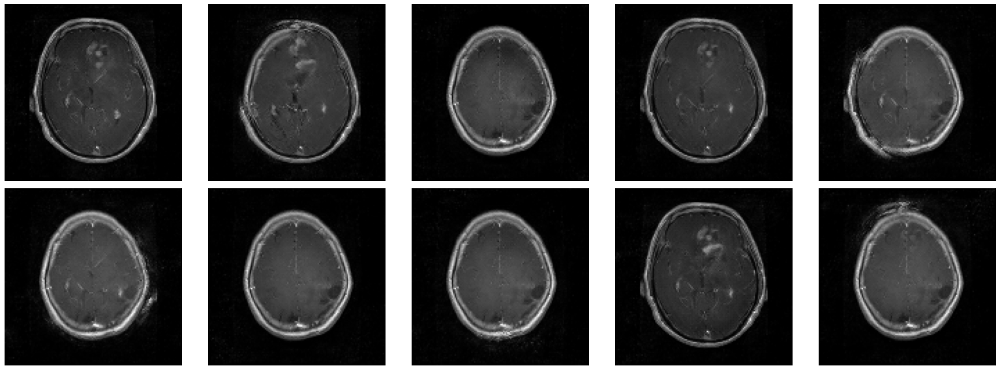

  0%|          | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 37ms/step


  0%|          | 1/3750 [00:00<13:53,  4.50it/s]

1/1 [==============================] - 0s 48ms/step


  0%|          | 2/3750 [00:00<14:15,  4.38it/s]

1/1 [==============================] - 0s 57ms/step


  0%|          | 3/3750 [00:00<13:58,  4.47it/s]

1/1 [==============================] - 0s 34ms/step


  0%|          | 4/3750 [00:00<13:50,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


  0%|          | 5/3750 [00:01<12:48,  4.87it/s]

1/1 [==============================] - 0s 32ms/step


  0%|          | 6/3750 [00:01<12:17,  5.07it/s]

1/1 [==============================] - 0s 50ms/step


  0%|          | 7/3750 [00:01<12:32,  4.97it/s]

1/1 [==============================] - 0s 35ms/step


  0%|          | 8/3750 [00:01<13:21,  4.67it/s]

1/1 [==============================] - 0s 38ms/step


  0%|          | 9/3750 [00:01<12:43,  4.90it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 10/3750 [00:02<12:12,  5.11it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 11/3750 [00:02<12:10,  5.12it/s]

1/1 [==============================] - 0s 59ms/step


  0%|          | 12/3750 [00:02<12:43,  4.90it/s]

1/1 [==============================] - 0s 33ms/step


  0%|          | 13/3750 [00:02<12:50,  4.85it/s]

1/1 [==============================] - 0s 57ms/step


  0%|          | 14/3750 [00:02<13:22,  4.65it/s]

1/1 [==============================] - 0s 38ms/step


  0%|          | 15/3750 [00:03<12:48,  4.86it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 16/3750 [00:03<12:06,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 17/3750 [00:03<12:08,  5.13it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 18/3750 [00:03<11:18,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 19/3750 [00:03<10:38,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 20/3750 [00:03<10:20,  6.01it/s]

1/1 [==============================] - 0s 45ms/step


  1%|          | 21/3750 [00:04<11:23,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 22/3750 [00:04<11:12,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 23/3750 [00:04<10:38,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 24/3750 [00:04<10:18,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 25/3750 [00:04<09:56,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 26/3750 [00:04<10:01,  6.19it/s]

1/1 [==============================] - 0s 36ms/step


  1%|          | 27/3750 [00:05<09:53,  6.28it/s]

1/1 [==============================] - 0s 42ms/step


  1%|          | 28/3750 [00:05<10:00,  6.20it/s]

1/1 [==============================] - 0s 35ms/step


  1%|          | 29/3750 [00:05<10:55,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 30/3750 [00:05<11:17,  5.49it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 31/3750 [00:05<11:26,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 32/3750 [00:06<11:31,  5.37it/s]

1/1 [==============================] - 0s 52ms/step


  1%|          | 33/3750 [00:06<11:33,  5.36it/s]

1/1 [==============================] - 0s 38ms/step


  1%|          | 34/3750 [00:06<11:47,  5.25it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 35/3750 [00:06<11:10,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 36/3750 [00:06<10:44,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 37/3750 [00:06<10:03,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 38/3750 [00:07<09:48,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 39/3750 [00:07<09:23,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 40/3750 [00:07<09:29,  6.51it/s]

1/1 [==============================] - 0s 32ms/step


  1%|          | 41/3750 [00:07<09:34,  6.46it/s]

1/1 [==============================] - 0s 47ms/step


  1%|          | 42/3750 [00:07<10:11,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 43/3750 [00:07<09:58,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 44/3750 [00:07<09:29,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 45/3750 [00:08<10:02,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 46/3750 [00:08<10:30,  5.88it/s]

1/1 [==============================] - 0s 35ms/step


  1%|▏         | 47/3750 [00:08<10:20,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


  1%|▏         | 48/3750 [00:08<09:42,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 49/3750 [00:08<10:12,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 50/3750 [00:09<10:40,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 51/3750 [00:09<09:59,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 52/3750 [00:09<09:59,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


  1%|▏         | 53/3750 [00:09<09:45,  6.31it/s]

1/1 [==============================] - 0s 47ms/step


  1%|▏         | 54/3750 [00:09<10:03,  6.13it/s]

1/1 [==============================] - 0s 44ms/step


  1%|▏         | 55/3750 [00:09<10:33,  5.83it/s]

1/1 [==============================] - 0s 30ms/step


  1%|▏         | 56/3750 [00:09<10:35,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 57/3750 [00:10<10:02,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 58/3750 [00:10<09:41,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 59/3750 [00:10<09:21,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 60/3750 [00:10<09:23,  6.55it/s]

1/1 [==============================] - 0s 36ms/step


  2%|▏         | 61/3750 [00:10<09:59,  6.15it/s]

1/1 [==============================] - 0s 47ms/step


  2%|▏         | 62/3750 [00:10<10:15,  5.99it/s]

1/1 [==============================] - 0s 32ms/step


  2%|▏         | 63/3750 [00:11<10:06,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 64/3750 [00:11<10:33,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 65/3750 [00:11<09:54,  6.20it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 66/3750 [00:11<10:00,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 67/3750 [00:11<09:29,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 68/3750 [00:11<09:26,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 69/3750 [00:12<09:24,  6.52it/s]

1/1 [==============================] - 0s 49ms/step


  2%|▏         | 70/3750 [00:12<10:10,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 71/3750 [00:12<10:42,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 72/3750 [00:12<10:55,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 73/3750 [00:12<10:27,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 74/3750 [00:12<10:44,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 75/3750 [00:13<10:07,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 76/3750 [00:13<10:06,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 77/3750 [00:13<10:23,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 78/3750 [00:13<10:19,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 79/3750 [00:13<09:46,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 80/3750 [00:13<09:45,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 81/3750 [00:14<09:31,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 82/3750 [00:14<09:24,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 83/3750 [00:14<09:25,  6.48it/s]

1/1 [==============================] - 0s 45ms/step


  2%|▏         | 84/3750 [00:14<10:08,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 85/3750 [00:14<10:05,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 86/3750 [00:14<09:37,  6.35it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 87/3750 [00:14<09:18,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 88/3750 [00:15<09:12,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 89/3750 [00:15<09:37,  6.34it/s]

1/1 [==============================] - 0s 54ms/step


  2%|▏         | 90/3750 [00:15<10:46,  5.66it/s]

1/1 [==============================] - 0s 42ms/step


  2%|▏         | 91/3750 [00:15<10:47,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 92/3750 [00:15<10:17,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 93/3750 [00:15<09:51,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 94/3750 [00:16<09:35,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 95/3750 [00:16<09:30,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 96/3750 [00:16<09:15,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 97/3750 [00:16<09:09,  6.64it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 98/3750 [00:16<09:15,  6.58it/s]

1/1 [==============================] - 0s 37ms/step


  3%|▎         | 99/3750 [00:16<09:54,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 100/3750 [00:17<10:04,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 101/3750 [00:17<09:38,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 102/3750 [00:17<10:02,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 103/3750 [00:17<09:36,  6.33it/s]

1/1 [==============================] - 0s 33ms/step


  3%|▎         | 104/3750 [00:17<09:33,  6.36it/s]

1/1 [==============================] - 0s 42ms/step


  3%|▎         | 105/3750 [00:17<09:48,  6.19it/s]

1/1 [==============================] - 0s 44ms/step


  3%|▎         | 106/3750 [00:18<09:52,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 107/3750 [00:18<10:22,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 108/3750 [00:18<10:36,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 109/3750 [00:18<09:55,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 110/3750 [00:18<09:47,  6.19it/s]

1/1 [==============================] - 0s 32ms/step


  3%|▎         | 111/3750 [00:18<10:06,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 112/3750 [00:19<09:48,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 113/3750 [00:19<09:38,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 114/3750 [00:19<09:21,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 115/3750 [00:19<08:52,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 116/3750 [00:19<08:41,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 117/3750 [00:19<08:48,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 118/3750 [00:19<08:25,  7.19it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 119/3750 [00:20<08:20,  7.25it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 120/3750 [00:20<08:14,  7.34it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 121/3750 [00:20<08:15,  7.32it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 122/3750 [00:20<08:08,  7.43it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 123/3750 [00:20<08:19,  7.25it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 124/3750 [00:20<08:09,  7.40it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 125/3750 [00:20<08:17,  7.29it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 126/3750 [00:20<08:22,  7.21it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 127/3750 [00:21<08:53,  6.79it/s]

1/1 [==============================] - 0s 53ms/step


  3%|▎         | 128/3750 [00:21<10:17,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 129/3750 [00:21<09:37,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 130/3750 [00:21<09:24,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 131/3750 [00:21<09:09,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 132/3750 [00:21<08:47,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 133/3750 [00:22<08:47,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 134/3750 [00:22<08:42,  6.92it/s]

1/1 [==============================] - 0s 52ms/step


  4%|▎         | 135/3750 [00:22<09:35,  6.28it/s]

1/1 [==============================] - 0s 52ms/step


  4%|▎         | 136/3750 [00:22<10:43,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 137/3750 [00:22<10:47,  5.58it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▎         | 138/3750 [00:22<10:11,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 139/3750 [00:23<09:43,  6.18it/s]

1/1 [==============================] - 0s 32ms/step


  4%|▎         | 140/3750 [00:23<09:14,  6.51it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 141/3750 [00:23<09:05,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 142/3750 [00:23<09:34,  6.29it/s]

1/1 [==============================] - 0s 37ms/step


  4%|▍         | 143/3750 [00:23<09:38,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 144/3750 [00:23<09:18,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 145/3750 [00:24<09:06,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 146/3750 [00:24<08:41,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 147/3750 [00:24<08:45,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 148/3750 [00:24<08:49,  6.81it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 149/3750 [00:24<09:31,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 150/3750 [00:24<09:18,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 151/3750 [00:24<09:12,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 152/3750 [00:25<09:09,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 153/3750 [00:25<08:58,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 154/3750 [00:25<09:02,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 155/3750 [00:25<09:44,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 156/3750 [00:25<09:50,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 157/3750 [00:25<09:50,  6.09it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 158/3750 [00:26<09:50,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 159/3750 [00:26<09:29,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 160/3750 [00:26<09:16,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 161/3750 [00:26<09:07,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 162/3750 [00:26<09:16,  6.45it/s]

1/1 [==============================] - 0s 35ms/step


  4%|▍         | 163/3750 [00:26<09:51,  6.06it/s]

1/1 [==============================] - 0s 47ms/step


  4%|▍         | 164/3750 [00:27<10:37,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 165/3750 [00:27<09:53,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 166/3750 [00:27<09:51,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 167/3750 [00:27<09:34,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 168/3750 [00:27<09:11,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 169/3750 [00:27<09:08,  6.53it/s]

1/1 [==============================] - 0s 37ms/step


  5%|▍         | 170/3750 [00:28<10:08,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 171/3750 [00:28<10:02,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 172/3750 [00:28<10:01,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 173/3750 [00:28<10:23,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 174/3750 [00:28<10:24,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 175/3750 [00:28<10:21,  5.75it/s]

1/1 [==============================] - 0s 32ms/step


  5%|▍         | 176/3750 [00:29<11:01,  5.40it/s]

1/1 [==============================] - 0s 40ms/step


  5%|▍         | 177/3750 [00:29<11:37,  5.12it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 178/3750 [00:29<10:42,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 179/3750 [00:29<10:01,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 180/3750 [00:29<09:53,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 181/3750 [00:29<09:27,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 182/3750 [00:30<09:21,  6.35it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▍         | 183/3750 [00:30<09:41,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 184/3750 [00:30<09:51,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 185/3750 [00:30<09:30,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 186/3750 [00:30<09:19,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 187/3750 [00:30<09:02,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 188/3750 [00:30<08:59,  6.60it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 189/3750 [00:31<09:00,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 190/3750 [00:31<08:35,  6.91it/s]

1/1 [==============================] - 0s 47ms/step


  5%|▌         | 191/3750 [00:31<08:58,  6.61it/s]

1/1 [==============================] - 0s 45ms/step


  5%|▌         | 192/3750 [00:31<09:32,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 193/3750 [00:31<09:23,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 194/3750 [00:31<09:04,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 195/3750 [00:32<09:29,  6.25it/s]

1/1 [==============================] - 0s 37ms/step


  5%|▌         | 196/3750 [00:32<09:23,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 197/3750 [00:32<09:11,  6.45it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▌         | 198/3750 [00:32<09:02,  6.55it/s]

1/1 [==============================] - 0s 46ms/step


  5%|▌         | 199/3750 [00:32<09:36,  6.16it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▌         | 200/3750 [00:32<09:27,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 201/3750 [00:33<09:08,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 202/3750 [00:33<09:03,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 203/3750 [00:33<09:11,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 204/3750 [00:33<08:50,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 205/3750 [00:33<08:41,  6.79it/s]

1/1 [==============================] - 0s 32ms/step


  5%|▌         | 206/3750 [00:33<08:51,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 207/3750 [00:33<08:40,  6.81it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 208/3750 [00:34<08:46,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 209/3750 [00:34<08:44,  6.75it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 210/3750 [00:34<08:37,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 211/3750 [00:34<09:08,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▌         | 212/3750 [00:34<08:35,  6.86it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 213/3750 [00:34<08:35,  6.86it/s]

1/1 [==============================] - 0s 29ms/step


  6%|▌         | 214/3750 [00:34<08:45,  6.73it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 215/3750 [00:35<08:42,  6.77it/s]

1/1 [==============================] - 0s 40ms/step


  6%|▌         | 216/3750 [00:35<09:00,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 217/3750 [00:35<08:57,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 218/3750 [00:35<08:43,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 219/3750 [00:35<08:41,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 220/3750 [00:35<08:50,  6.65it/s]

1/1 [==============================] - 0s 34ms/step


  6%|▌         | 221/3750 [00:36<09:40,  6.08it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 222/3750 [00:36<09:39,  6.09it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 223/3750 [00:36<09:57,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 224/3750 [00:36<09:30,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 225/3750 [00:36<08:56,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 226/3750 [00:36<08:51,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 227/3750 [00:36<08:45,  6.70it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 228/3750 [00:37<08:43,  6.73it/s]

1/1 [==============================] - 0s 47ms/step


  6%|▌         | 229/3750 [00:37<09:04,  6.46it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▌         | 230/3750 [00:37<09:09,  6.40it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▌         | 231/3750 [00:37<09:17,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 232/3750 [00:37<08:56,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 233/3750 [00:37<09:12,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▌         | 234/3750 [00:38<09:09,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▋         | 235/3750 [00:38<09:02,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 236/3750 [00:38<08:44,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 237/3750 [00:38<08:32,  6.86it/s]

1/1 [==============================] - 0s 51ms/step


  6%|▋         | 238/3750 [00:38<09:11,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 239/3750 [00:38<08:47,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 240/3750 [00:38<08:51,  6.60it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▋         | 241/3750 [00:39<08:52,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▋         | 242/3750 [00:39<08:42,  6.72it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▋         | 243/3750 [00:39<08:51,  6.60it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 244/3750 [00:39<09:04,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 245/3750 [00:39<09:26,  6.18it/s]

1/1 [==============================] - 0s 51ms/step


  7%|▋         | 246/3750 [00:39<09:35,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 247/3750 [00:40<10:01,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 248/3750 [00:40<09:30,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 249/3750 [00:40<09:43,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 250/3750 [00:40<09:54,  5.89it/s]

1/1 [==============================] - 0s 33ms/step


  7%|▋         | 251/3750 [00:40<09:49,  5.93it/s]

1/1 [==============================] - 0s 47ms/step


  7%|▋         | 252/3750 [00:40<10:04,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 253/3750 [00:41<10:11,  5.71it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 254/3750 [00:41<10:34,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 255/3750 [00:41<10:37,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 256/3750 [00:41<10:04,  5.78it/s]

1/1 [==============================] - 0s 36ms/step


  7%|▋         | 257/3750 [00:41<09:54,  5.88it/s]

1/1 [==============================] - 0s 45ms/step


  7%|▋         | 258/3750 [00:42<10:34,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 259/3750 [00:42<09:54,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 260/3750 [00:42<09:28,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 261/3750 [00:42<09:26,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 262/3750 [00:42<09:11,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 263/3750 [00:42<09:06,  6.38it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 264/3750 [00:42<09:12,  6.31it/s]

1/1 [==============================] - 0s 45ms/step


  7%|▋         | 265/3750 [00:43<09:27,  6.14it/s]

1/1 [==============================] - 0s 46ms/step


  7%|▋         | 266/3750 [00:43<09:35,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 267/3750 [00:43<09:13,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 268/3750 [00:43<08:51,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 269/3750 [00:43<08:36,  6.74it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 270/3750 [00:43<09:07,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 271/3750 [00:44<09:29,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 272/3750 [00:44<10:06,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 273/3750 [00:44<10:37,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 274/3750 [00:44<10:54,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 275/3750 [00:44<10:10,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 276/3750 [00:44<09:34,  6.05it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 277/3750 [00:45<09:32,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 278/3750 [00:45<09:45,  5.93it/s]

1/1 [==============================] - 0s 34ms/step


  7%|▋         | 279/3750 [00:45<10:08,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 280/3750 [00:45<09:46,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 281/3750 [00:45<08:59,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 282/3750 [00:45<09:18,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 283/3750 [00:46<08:54,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 284/3750 [00:46<08:36,  6.71it/s]

1/1 [==============================] - 0s 35ms/step


  8%|▊         | 285/3750 [00:46<09:35,  6.02it/s]

1/1 [==============================] - 0s 46ms/step


  8%|▊         | 286/3750 [00:46<09:59,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 287/3750 [00:46<09:32,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 288/3750 [00:46<08:58,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 289/3750 [00:47<08:47,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 290/3750 [00:47<08:31,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 291/3750 [00:47<08:13,  7.02it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 292/3750 [00:47<08:56,  6.44it/s]

1/1 [==============================] - 0s 33ms/step


  8%|▊         | 293/3750 [00:47<09:49,  5.86it/s]

1/1 [==============================] - 0s 40ms/step


  8%|▊         | 294/3750 [00:47<09:45,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 295/3750 [00:48<09:22,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 296/3750 [00:48<08:51,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 297/3750 [00:48<08:43,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 298/3750 [00:48<09:15,  6.22it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 299/3750 [00:48<08:54,  6.45it/s]

1/1 [==============================] - 0s 35ms/step


  8%|▊         | 300/3750 [00:48<09:49,  5.85it/s]

1/1 [==============================] - 0s 48ms/step


  8%|▊         | 301/3750 [00:48<09:46,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 302/3750 [00:49<09:26,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 303/3750 [00:49<09:44,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 304/3750 [00:49<09:14,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 305/3750 [00:49<09:13,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 306/3750 [00:49<09:24,  6.10it/s]

1/1 [==============================] - 0s 49ms/step


  8%|▊         | 307/3750 [00:49<09:35,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 308/3750 [00:50<09:12,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 309/3750 [00:50<08:59,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 310/3750 [00:50<08:51,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 311/3750 [00:50<08:41,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 312/3750 [00:50<09:09,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 313/3750 [00:50<08:59,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 314/3750 [00:51<09:40,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 315/3750 [00:51<10:03,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 316/3750 [00:51<10:12,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 317/3750 [00:51<09:29,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 318/3750 [00:51<08:59,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 319/3750 [00:51<08:52,  6.44it/s]

1/1 [==============================] - 0s 52ms/step


  9%|▊         | 320/3750 [00:52<10:35,  5.40it/s]

1/1 [==============================] - 0s 35ms/step


  9%|▊         | 321/3750 [00:52<10:10,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 322/3750 [00:52<09:53,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 323/3750 [00:52<09:29,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 324/3750 [00:52<09:05,  6.29it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▊         | 325/3750 [00:52<09:01,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 326/3750 [00:53<08:48,  6.48it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▊         | 327/3750 [00:53<08:43,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▊         | 328/3750 [00:53<08:45,  6.51it/s]

1/1 [==============================] - 0s 33ms/step


  9%|▉         | 329/3750 [00:53<08:46,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 330/3750 [00:53<09:15,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 331/3750 [00:53<08:53,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 332/3750 [00:54<09:20,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 333/3750 [00:54<08:47,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 334/3750 [00:54<08:38,  6.59it/s]

1/1 [==============================] - 0s 44ms/step


  9%|▉         | 335/3750 [00:54<09:35,  5.93it/s]

1/1 [==============================] - 0s 31ms/step


  9%|▉         | 336/3750 [00:54<09:18,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 337/3750 [00:54<08:51,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 338/3750 [00:54<09:12,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 339/3750 [00:55<09:02,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 340/3750 [00:55<08:47,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 341/3750 [00:55<08:44,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 342/3750 [00:55<09:24,  6.04it/s]

1/1 [==============================] - 0s 38ms/step


  9%|▉         | 343/3750 [00:55<10:23,  5.47it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 344/3750 [00:55<09:37,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 345/3750 [00:56<09:17,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 346/3750 [00:56<09:18,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 347/3750 [00:56<08:54,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 348/3750 [00:56<08:42,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 349/3750 [00:56<08:51,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 350/3750 [00:56<09:07,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 351/3750 [00:57<08:50,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 352/3750 [00:57<08:33,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 353/3750 [00:57<08:13,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 354/3750 [00:57<08:19,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 355/3750 [00:57<08:05,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 356/3750 [00:57<08:23,  6.75it/s]

1/1 [==============================] - 0s 52ms/step


 10%|▉         | 357/3750 [00:57<09:05,  6.22it/s]

1/1 [==============================] - 0s 29ms/step


 10%|▉         | 358/3750 [00:58<09:37,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 359/3750 [00:58<09:50,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 360/3750 [00:58<09:18,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 361/3750 [00:58<08:54,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 362/3750 [00:58<08:37,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 363/3750 [00:58<09:20,  6.04it/s]

1/1 [==============================] - 0s 34ms/step


 10%|▉         | 364/3750 [00:59<09:07,  6.19it/s]

1/1 [==============================] - 0s 29ms/step


 10%|▉         | 365/3750 [00:59<08:57,  6.30it/s]

1/1 [==============================] - 0s 44ms/step


 10%|▉         | 366/3750 [00:59<09:16,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 367/3750 [00:59<09:13,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 368/3750 [00:59<09:02,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 369/3750 [00:59<08:41,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 370/3750 [01:00<08:22,  6.73it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 371/3750 [01:00<08:30,  6.62it/s]

1/1 [==============================] - 0s 39ms/step


 10%|▉         | 372/3750 [01:00<09:14,  6.10it/s]

1/1 [==============================] - 0s 48ms/step


 10%|▉         | 373/3750 [01:00<10:07,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 374/3750 [01:00<09:28,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 375/3750 [01:00<09:37,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 376/3750 [01:01<09:05,  6.19it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 377/3750 [01:01<09:32,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 378/3750 [01:01<09:10,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 379/3750 [01:01<08:52,  6.33it/s]

1/1 [==============================] - 0s 36ms/step


 10%|█         | 380/3750 [01:01<08:57,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 381/3750 [01:01<08:34,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 382/3750 [01:01<08:30,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 383/3750 [01:02<08:18,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 384/3750 [01:02<08:10,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 385/3750 [01:02<08:17,  6.77it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 386/3750 [01:02<08:40,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 387/3750 [01:02<08:41,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 388/3750 [01:02<08:29,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 389/3750 [01:03<08:28,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 390/3750 [01:03<08:15,  6.78it/s]

1/1 [==============================] - 0s 32ms/step


 10%|█         | 391/3750 [01:03<08:17,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 392/3750 [01:03<08:03,  6.95it/s]

1/1 [==============================] - 0s 33ms/step


 10%|█         | 393/3750 [01:03<07:59,  7.00it/s]

1/1 [==============================] - 0s 34ms/step


 11%|█         | 394/3750 [01:03<08:18,  6.74it/s]

1/1 [==============================] - 0s 47ms/step


 11%|█         | 395/3750 [01:03<08:36,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 396/3750 [01:04<08:24,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 397/3750 [01:04<08:22,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 398/3750 [01:04<08:50,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 399/3750 [01:04<08:31,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 400/3750 [01:04<08:27,  6.60it/s]

1/1 [==============================] - 0s 51ms/step


 11%|█         | 401/3750 [01:04<09:08,  6.11it/s]

1/1 [==============================] - 0s 51ms/step


 11%|█         | 402/3750 [01:05<09:20,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 403/3750 [01:05<09:05,  6.14it/s]

1/1 [==============================] - 0s 34ms/step


 11%|█         | 404/3750 [01:05<08:51,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 405/3750 [01:05<08:39,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 406/3750 [01:05<08:10,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 407/3750 [01:05<08:17,  6.73it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█         | 408/3750 [01:05<08:11,  6.79it/s]

1/1 [==============================] - 0s 33ms/step


 11%|█         | 409/3750 [01:06<08:19,  6.69it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 410/3750 [01:06<08:42,  6.39it/s]

1/1 [==============================] - 0s 33ms/step


 11%|█         | 411/3750 [01:06<08:44,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 412/3750 [01:06<08:31,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 413/3750 [01:06<08:17,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 414/3750 [01:06<08:02,  6.92it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 415/3750 [01:06<08:00,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 416/3750 [01:07<08:17,  6.70it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 417/3750 [01:07<08:31,  6.52it/s]

1/1 [==============================] - 0s 50ms/step


 11%|█         | 418/3750 [01:07<08:44,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 419/3750 [01:07<09:07,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 420/3750 [01:07<09:23,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 421/3750 [01:07<09:01,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 422/3750 [01:08<08:39,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 423/3750 [01:08<09:01,  6.14it/s]

1/1 [==============================] - 0s 44ms/step


 11%|█▏        | 424/3750 [01:08<09:49,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 425/3750 [01:08<09:15,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 426/3750 [01:08<08:45,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 427/3750 [01:08<08:28,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 428/3750 [01:09<08:19,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 429/3750 [01:09<08:12,  6.75it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█▏        | 430/3750 [01:09<08:10,  6.77it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█▏        | 431/3750 [01:09<08:06,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 432/3750 [01:09<07:58,  6.93it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 433/3750 [01:09<08:05,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 434/3750 [01:09<07:53,  7.01it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 435/3750 [01:10<07:59,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 436/3750 [01:10<07:44,  7.14it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 437/3750 [01:10<07:48,  7.07it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 438/3750 [01:10<08:03,  6.85it/s]

1/1 [==============================] - 0s 38ms/step


 12%|█▏        | 439/3750 [01:10<08:56,  6.17it/s]

1/1 [==============================] - 0s 47ms/step


 12%|█▏        | 440/3750 [01:10<09:18,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 441/3750 [01:11<08:47,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 442/3750 [01:11<08:21,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 443/3750 [01:11<07:58,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 444/3750 [01:11<07:59,  6.90it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 445/3750 [01:11<08:03,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 446/3750 [01:11<07:58,  6.91it/s]

1/1 [==============================] - 0s 55ms/step


 12%|█▏        | 447/3750 [01:11<08:34,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 448/3750 [01:12<09:08,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 449/3750 [01:12<09:35,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 450/3750 [01:12<08:57,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 451/3750 [01:12<08:31,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 452/3750 [01:12<08:09,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 453/3750 [01:12<08:12,  6.69it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 454/3750 [01:13<08:46,  6.26it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 455/3750 [01:13<08:48,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 456/3750 [01:13<08:26,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 457/3750 [01:13<08:18,  6.60it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 458/3750 [01:13<08:12,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 459/3750 [01:13<08:03,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 460/3750 [01:13<08:07,  6.75it/s]

1/1 [==============================] - 0s 51ms/step


 12%|█▏        | 461/3750 [01:14<08:28,  6.47it/s]

1/1 [==============================] - 0s 41ms/step


 12%|█▏        | 462/3750 [01:14<08:39,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 463/3750 [01:14<08:30,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 464/3750 [01:14<07:58,  6.87it/s]

1/1 [==============================] - 0s 35ms/step


 12%|█▏        | 465/3750 [01:14<07:46,  7.05it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 466/3750 [01:14<07:53,  6.93it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 467/3750 [01:14<07:31,  7.26it/s]

1/1 [==============================] - 0s 37ms/step


 12%|█▏        | 468/3750 [01:15<08:12,  6.67it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 469/3750 [01:15<08:18,  6.59it/s]

1/1 [==============================] - 0s 46ms/step


 13%|█▎        | 470/3750 [01:15<08:26,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 471/3750 [01:15<08:16,  6.60it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 472/3750 [01:15<08:12,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 473/3750 [01:15<08:48,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 474/3750 [01:16<08:33,  6.38it/s]

1/1 [==============================] - 0s 35ms/step


 13%|█▎        | 475/3750 [01:16<08:56,  6.10it/s]

1/1 [==============================] - 0s 35ms/step


 13%|█▎        | 476/3750 [01:16<09:02,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 477/3750 [01:16<09:05,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 478/3750 [01:16<09:21,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 479/3750 [01:16<08:57,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 480/3750 [01:17<08:33,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 481/3750 [01:17<08:23,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 482/3750 [01:17<08:14,  6.61it/s]

1/1 [==============================] - 0s 45ms/step


 13%|█▎        | 483/3750 [01:17<08:29,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 484/3750 [01:17<08:46,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 485/3750 [01:17<08:41,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 486/3750 [01:18<09:03,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 487/3750 [01:18<08:52,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 488/3750 [01:18<09:09,  5.94it/s]

1/1 [==============================] - 0s 44ms/step


 13%|█▎        | 489/3750 [01:18<09:23,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 490/3750 [01:18<09:05,  5.97it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 491/3750 [01:18<08:51,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 492/3750 [01:18<08:34,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 493/3750 [01:19<08:26,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 494/3750 [01:19<08:19,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 495/3750 [01:19<08:10,  6.63it/s]

1/1 [==============================] - 0s 44ms/step


 13%|█▎        | 496/3750 [01:19<09:06,  5.96it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 497/3750 [01:19<08:59,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 498/3750 [01:19<09:17,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 499/3750 [01:20<08:53,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 500/3750 [01:20<08:26,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 501/3750 [01:20<08:04,  6.71it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 502/3750 [01:20<08:28,  6.39it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 503/3750 [01:20<09:11,  5.89it/s]

1/1 [==============================] - 0s 34ms/step


 13%|█▎        | 504/3750 [01:20<08:46,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 505/3750 [01:21<08:16,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 506/3750 [01:21<08:19,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 507/3750 [01:21<08:12,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 508/3750 [01:21<08:10,  6.61it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▎        | 509/3750 [01:21<08:42,  6.20it/s]

1/1 [==============================] - 0s 56ms/step


 14%|█▎        | 510/3750 [01:21<09:01,  5.98it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▎        | 511/3750 [01:22<09:04,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 512/3750 [01:22<08:38,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 513/3750 [01:22<08:21,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 514/3750 [01:22<08:13,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 515/3750 [01:22<08:07,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 516/3750 [01:22<07:59,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 517/3750 [01:22<07:55,  6.79it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▍        | 518/3750 [01:23<08:12,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 519/3750 [01:23<08:24,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 520/3750 [01:23<08:13,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 521/3750 [01:23<07:51,  6.85it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 522/3750 [01:23<07:44,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 523/3750 [01:23<07:44,  6.94it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 524/3750 [01:23<07:41,  6.99it/s]

1/1 [==============================] - 0s 41ms/step


 14%|█▍        | 525/3750 [01:24<08:43,  6.16it/s]

1/1 [==============================] - 0s 37ms/step


 14%|█▍        | 526/3750 [01:24<08:55,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 527/3750 [01:24<08:38,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 528/3750 [01:24<08:15,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 529/3750 [01:24<08:13,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 530/3750 [01:24<07:59,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 531/3750 [01:25<08:15,  6.50it/s]

1/1 [==============================] - 0s 53ms/step


 14%|█▍        | 532/3750 [01:25<08:37,  6.22it/s]

1/1 [==============================] - 0s 35ms/step


 14%|█▍        | 533/3750 [01:25<09:22,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 534/3750 [01:25<08:44,  6.14it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 535/3750 [01:25<09:06,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 536/3750 [01:25<08:52,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 537/3750 [01:26<08:22,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 538/3750 [01:26<08:27,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 539/3750 [01:26<08:14,  6.50it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▍        | 540/3750 [01:26<08:52,  6.03it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 541/3750 [01:26<08:53,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 542/3750 [01:26<09:26,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 543/3750 [01:27<09:03,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 544/3750 [01:27<08:47,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 545/3750 [01:27<08:29,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 546/3750 [01:27<08:14,  6.48it/s]

1/1 [==============================] - 0s 44ms/step


 15%|█▍        | 547/3750 [01:27<08:46,  6.08it/s]

1/1 [==============================] - 0s 50ms/step


 15%|█▍        | 548/3750 [01:27<09:27,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 549/3750 [01:28<08:53,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 550/3750 [01:28<09:32,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 551/3750 [01:28<09:08,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 552/3750 [01:28<08:44,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 553/3750 [01:28<08:42,  6.12it/s]

1/1 [==============================] - 0s 35ms/step


 15%|█▍        | 554/3750 [01:28<08:54,  5.97it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 555/3750 [01:29<08:40,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 556/3750 [01:29<08:27,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 557/3750 [01:29<08:13,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 558/3750 [01:29<07:54,  6.73it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 559/3750 [01:29<07:58,  6.67it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 560/3750 [01:29<08:25,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 561/3750 [01:29<08:44,  6.08it/s]

1/1 [==============================] - 0s 35ms/step


 15%|█▍        | 562/3750 [01:30<08:50,  6.01it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▌        | 563/3750 [01:30<09:16,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 564/3750 [01:30<08:28,  6.26it/s]

1/1 [==============================] - 0s 36ms/step


 15%|█▌        | 565/3750 [01:30<08:08,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 566/3750 [01:30<08:04,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 567/3750 [01:30<08:22,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 568/3750 [01:31<08:16,  6.41it/s]

1/1 [==============================] - 0s 48ms/step


 15%|█▌        | 569/3750 [01:31<08:38,  6.14it/s]

1/1 [==============================] - 0s 49ms/step


 15%|█▌        | 570/3750 [01:31<09:04,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 571/3750 [01:31<09:08,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 572/3750 [01:31<08:46,  6.04it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▌        | 573/3750 [01:31<08:21,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 574/3750 [01:32<08:37,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 575/3750 [01:32<08:26,  6.27it/s]

1/1 [==============================] - 0s 34ms/step


 15%|█▌        | 576/3750 [01:32<08:46,  6.03it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 577/3750 [01:32<08:52,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 578/3750 [01:32<08:16,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 579/3750 [01:32<08:04,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 580/3750 [01:33<07:44,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 581/3750 [01:33<07:43,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 582/3750 [01:33<08:16,  6.38it/s]

1/1 [==============================] - 0s 35ms/step


 16%|█▌        | 583/3750 [01:33<08:53,  5.93it/s]

1/1 [==============================] - 0s 36ms/step


 16%|█▌        | 584/3750 [01:33<08:56,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 585/3750 [01:33<08:37,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 586/3750 [01:33<08:21,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 587/3750 [01:34<08:14,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 588/3750 [01:34<08:00,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 589/3750 [01:34<07:51,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 590/3750 [01:34<07:48,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 591/3750 [01:34<08:41,  6.06it/s]

1/1 [==============================] - 0s 38ms/step


 16%|█▌        | 592/3750 [01:34<09:14,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 593/3750 [01:35<09:22,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 594/3750 [01:35<09:04,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 595/3750 [01:35<08:34,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 596/3750 [01:35<08:12,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 597/3750 [01:35<08:40,  6.06it/s]

1/1 [==============================] - 0s 44ms/step


 16%|█▌        | 598/3750 [01:36<09:20,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 599/3750 [01:36<08:46,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 600/3750 [01:36<08:21,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 601/3750 [01:36<08:15,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 602/3750 [01:36<08:05,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 603/3750 [01:36<08:39,  6.05it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 604/3750 [01:36<08:29,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 605/3750 [01:37<08:45,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 606/3750 [01:37<08:18,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 607/3750 [01:37<08:05,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 608/3750 [01:37<07:54,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 609/3750 [01:37<07:44,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 610/3750 [01:37<07:29,  6.98it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 611/3750 [01:37<08:00,  6.53it/s]

1/1 [==============================] - 0s 41ms/step


 16%|█▋        | 612/3750 [01:38<08:54,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▋        | 613/3750 [01:38<08:35,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 614/3750 [01:38<08:36,  6.07it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▋        | 615/3750 [01:38<08:25,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 616/3750 [01:38<08:00,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 617/3750 [01:38<07:44,  6.74it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 618/3750 [01:39<07:41,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 619/3750 [01:39<07:41,  6.79it/s]

1/1 [==============================] - 0s 43ms/step


 17%|█▋        | 620/3750 [01:39<08:00,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 621/3750 [01:39<07:56,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 622/3750 [01:39<07:43,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 623/3750 [01:39<08:07,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 624/3750 [01:40<08:01,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 625/3750 [01:40<07:56,  6.56it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 626/3750 [01:40<08:06,  6.42it/s]

1/1 [==============================] - 0s 35ms/step


 17%|█▋        | 627/3750 [01:40<08:12,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 628/3750 [01:40<07:57,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 629/3750 [01:40<08:18,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 630/3750 [01:40<08:02,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 631/3750 [01:41<07:50,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 632/3750 [01:41<07:46,  6.69it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 633/3750 [01:41<07:58,  6.52it/s]

1/1 [==============================] - 0s 52ms/step


 17%|█▋        | 634/3750 [01:41<08:18,  6.25it/s]

1/1 [==============================] - 0s 44ms/step


 17%|█▋        | 635/3750 [01:41<09:02,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 636/3750 [01:41<08:29,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 637/3750 [01:42<08:03,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 638/3750 [01:42<07:47,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 639/3750 [01:42<07:21,  7.05it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 640/3750 [01:42<07:22,  7.02it/s]

1/1 [==============================] - 0s 45ms/step


 17%|█▋        | 641/3750 [01:42<07:54,  6.55it/s]

1/1 [==============================] - 0s 33ms/step


 17%|█▋        | 642/3750 [01:42<08:23,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 643/3750 [01:42<08:05,  6.40it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 644/3750 [01:43<07:49,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 645/3750 [01:43<07:45,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 646/3750 [01:43<07:47,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 647/3750 [01:43<07:46,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 648/3750 [01:43<07:40,  6.74it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 649/3750 [01:43<08:28,  6.10it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 650/3750 [01:44<08:31,  6.07it/s]

1/1 [==============================] - 0s 36ms/step


 17%|█▋        | 651/3750 [01:44<08:11,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 652/3750 [01:44<07:56,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 653/3750 [01:44<08:23,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 654/3750 [01:44<08:02,  6.42it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 655/3750 [01:44<08:01,  6.43it/s]

1/1 [==============================] - 0s 42ms/step


 17%|█▋        | 656/3750 [01:44<08:17,  6.22it/s]

1/1 [==============================] - 0s 50ms/step


 18%|█▊        | 657/3750 [01:45<08:26,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 658/3750 [01:45<07:57,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 659/3750 [01:45<07:47,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 660/3750 [01:45<07:43,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 661/3750 [01:45<07:39,  6.72it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 662/3750 [01:45<08:09,  6.31it/s]

1/1 [==============================] - 0s 48ms/step


 18%|█▊        | 663/3750 [01:46<08:54,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 664/3750 [01:46<08:35,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 665/3750 [01:46<08:10,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 666/3750 [01:46<07:48,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 667/3750 [01:46<07:46,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 668/3750 [01:46<07:56,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 669/3750 [01:47<07:40,  6.69it/s]

1/1 [==============================] - 0s 33ms/step


 18%|█▊        | 670/3750 [01:47<07:44,  6.64it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 671/3750 [01:47<07:50,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 672/3750 [01:47<07:49,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 673/3750 [01:47<08:09,  6.28it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 674/3750 [01:47<07:56,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 675/3750 [01:47<07:42,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 676/3750 [01:48<07:32,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 677/3750 [01:48<07:19,  7.00it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 678/3750 [01:48<07:24,  6.92it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 679/3750 [01:48<07:28,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 680/3750 [01:48<07:39,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 681/3750 [01:48<07:35,  6.73it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 682/3750 [01:48<07:35,  6.74it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 683/3750 [01:49<07:25,  6.88it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 684/3750 [01:49<07:25,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 685/3750 [01:49<07:28,  6.83it/s]

1/1 [==============================] - 0s 34ms/step


 18%|█▊        | 686/3750 [01:49<07:56,  6.43it/s]

1/1 [==============================] - 0s 48ms/step


 18%|█▊        | 687/3750 [01:49<08:19,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 688/3750 [01:49<08:33,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 689/3750 [01:50<08:12,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 690/3750 [01:50<07:51,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 691/3750 [01:50<07:34,  6.73it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 692/3750 [01:50<07:35,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 693/3750 [01:50<07:17,  6.99it/s]

1/1 [==============================] - 0s 47ms/step


 19%|█▊        | 694/3750 [01:50<07:43,  6.59it/s]

1/1 [==============================] - 0s 39ms/step


 19%|█▊        | 695/3750 [01:50<08:24,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 696/3750 [01:51<08:06,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 697/3750 [01:51<07:45,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 698/3750 [01:51<07:39,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 699/3750 [01:51<07:26,  6.83it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 700/3750 [01:51<07:29,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 701/3750 [01:51<07:30,  6.77it/s]

1/1 [==============================] - 0s 45ms/step


 19%|█▊        | 702/3750 [01:52<07:59,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 703/3750 [01:52<08:08,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 704/3750 [01:52<07:52,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 705/3750 [01:52<07:39,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 706/3750 [01:52<07:47,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 707/3750 [01:52<07:39,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 708/3750 [01:52<07:32,  6.73it/s]

1/1 [==============================] - 0s 36ms/step


 19%|█▉        | 709/3750 [01:53<07:52,  6.44it/s]

1/1 [==============================] - 0s 42ms/step


 19%|█▉        | 710/3750 [01:53<08:33,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 711/3750 [01:53<08:56,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 712/3750 [01:53<09:05,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 713/3750 [01:53<08:34,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 714/3750 [01:54<08:46,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 715/3750 [01:54<08:50,  5.72it/s]

1/1 [==============================] - 0s 34ms/step


 19%|█▉        | 716/3750 [01:54<08:49,  5.73it/s]

1/1 [==============================] - 0s 47ms/step


 19%|█▉        | 717/3750 [01:54<09:58,  5.07it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 718/3750 [01:54<09:46,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 719/3750 [01:54<09:03,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 720/3750 [01:55<08:32,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 721/3750 [01:55<08:28,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 722/3750 [01:55<08:14,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 723/3750 [01:55<08:13,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 724/3750 [01:55<08:11,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 725/3750 [01:55<07:58,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 726/3750 [01:56<07:51,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 727/3750 [01:56<07:54,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 728/3750 [01:56<07:38,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 729/3750 [01:56<07:27,  6.75it/s]

1/1 [==============================] - 0s 34ms/step


 19%|█▉        | 730/3750 [01:56<07:39,  6.57it/s]

1/1 [==============================] - 0s 38ms/step


 19%|█▉        | 731/3750 [01:56<07:54,  6.37it/s]

1/1 [==============================] - 0s 52ms/step


 20%|█▉        | 732/3750 [01:57<08:55,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 733/3750 [01:57<09:16,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 734/3750 [01:57<08:35,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 735/3750 [01:57<08:03,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 736/3750 [01:57<07:41,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 737/3750 [01:57<08:10,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 738/3750 [01:57<08:09,  6.15it/s]

1/1 [==============================] - 0s 43ms/step


 20%|█▉        | 739/3750 [01:58<08:38,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 740/3750 [01:58<08:46,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 741/3750 [01:58<08:58,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 742/3750 [01:58<08:25,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 743/3750 [01:58<08:14,  6.08it/s]

1/1 [==============================] - 0s 34ms/step


 20%|█▉        | 744/3750 [01:59<08:09,  6.14it/s]

1/1 [==============================] - 0s 42ms/step


 20%|█▉        | 745/3750 [01:59<08:14,  6.07it/s]

1/1 [==============================] - 0s 46ms/step


 20%|█▉        | 746/3750 [01:59<08:15,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 747/3750 [01:59<07:59,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 748/3750 [01:59<07:50,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 749/3750 [01:59<08:01,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 750/3750 [01:59<08:24,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 751/3750 [02:00<08:00,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 752/3750 [02:00<07:56,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 753/3750 [02:00<08:06,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 754/3750 [02:00<07:50,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 755/3750 [02:00<07:32,  6.62it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 756/3750 [02:00<07:16,  6.86it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 757/3750 [02:01<07:20,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 758/3750 [02:01<07:16,  6.86it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 759/3750 [02:01<07:22,  6.76it/s]

1/1 [==============================] - 0s 31ms/step


 20%|██        | 760/3750 [02:01<07:34,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 761/3750 [02:01<07:40,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 762/3750 [02:01<07:56,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 763/3750 [02:01<07:39,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 764/3750 [02:02<07:36,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 765/3750 [02:02<07:13,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 766/3750 [02:02<07:49,  6.35it/s]

1/1 [==============================] - 0s 33ms/step


 20%|██        | 767/3750 [02:02<07:50,  6.34it/s]

1/1 [==============================] - 0s 53ms/step


 20%|██        | 768/3750 [02:02<08:06,  6.12it/s]

1/1 [==============================] - 0s 41ms/step


 21%|██        | 769/3750 [02:02<08:07,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 770/3750 [02:03<07:35,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 771/3750 [02:03<07:25,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 772/3750 [02:03<07:13,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 773/3750 [02:03<07:01,  7.06it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 774/3750 [02:03<07:10,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 775/3750 [02:03<07:01,  7.06it/s]

1/1 [==============================] - 0s 49ms/step


 21%|██        | 776/3750 [02:03<07:41,  6.45it/s]

1/1 [==============================] - 0s 47ms/step


 21%|██        | 777/3750 [02:04<07:58,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 778/3750 [02:04<07:46,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 779/3750 [02:04<07:24,  6.69it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 780/3750 [02:04<07:06,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 781/3750 [02:04<06:54,  7.16it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 782/3750 [02:04<06:59,  7.07it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 783/3750 [02:04<07:15,  6.82it/s]

1/1 [==============================] - 0s 35ms/step


 21%|██        | 784/3750 [02:05<07:37,  6.49it/s]

1/1 [==============================] - 0s 46ms/step


 21%|██        | 785/3750 [02:05<08:22,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 786/3750 [02:05<07:52,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 787/3750 [02:05<07:41,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 788/3750 [02:05<07:34,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 789/3750 [02:05<07:17,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 790/3750 [02:06<07:01,  7.02it/s]

1/1 [==============================] - 0s 31ms/step


 21%|██        | 791/3750 [02:06<07:16,  6.78it/s]

1/1 [==============================] - 0s 54ms/step


 21%|██        | 792/3750 [02:06<07:44,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 793/3750 [02:06<07:47,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 794/3750 [02:06<07:38,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 795/3750 [02:06<07:16,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 796/3750 [02:06<06:58,  7.05it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 797/3750 [02:07<06:49,  7.21it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 798/3750 [02:07<07:20,  6.70it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██▏       | 799/3750 [02:07<07:21,  6.68it/s]

1/1 [==============================] - 0s 37ms/step


 21%|██▏       | 800/3750 [02:07<07:34,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██▏       | 801/3750 [02:07<07:26,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 802/3750 [02:07<07:50,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 803/3750 [02:08<08:12,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 804/3750 [02:08<08:25,  5.83it/s]

1/1 [==============================] - 0s 32ms/step


 21%|██▏       | 805/3750 [02:08<08:26,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 806/3750 [02:08<08:00,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 807/3750 [02:08<07:41,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 808/3750 [02:08<07:28,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 809/3750 [02:08<07:05,  6.92it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 810/3750 [02:09<07:09,  6.85it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 811/3750 [02:09<07:11,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 812/3750 [02:09<07:11,  6.81it/s]

1/1 [==============================] - 0s 35ms/step


 22%|██▏       | 813/3750 [02:09<07:52,  6.22it/s]

1/1 [==============================] - 0s 38ms/step


 22%|██▏       | 814/3750 [02:09<08:16,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 815/3750 [02:09<07:52,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 816/3750 [02:10<08:14,  5.93it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 817/3750 [02:10<07:56,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 818/3750 [02:10<07:33,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 819/3750 [02:10<07:18,  6.69it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 820/3750 [02:10<07:21,  6.63it/s]

1/1 [==============================] - 0s 32ms/step


 22%|██▏       | 821/3750 [02:10<07:38,  6.39it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 822/3750 [02:11<07:52,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 823/3750 [02:11<07:42,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 824/3750 [02:11<07:24,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 825/3750 [02:11<07:27,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 826/3750 [02:11<07:20,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 827/3750 [02:11<07:33,  6.45it/s]

1/1 [==============================] - 0s 42ms/step


 22%|██▏       | 828/3750 [02:11<07:42,  6.32it/s]

1/1 [==============================] - 0s 39ms/step


 22%|██▏       | 829/3750 [02:12<07:58,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 830/3750 [02:12<08:09,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 831/3750 [02:12<07:52,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 832/3750 [02:12<07:32,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 833/3750 [02:12<07:25,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 834/3750 [02:12<07:14,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 835/3750 [02:13<07:44,  6.28it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 836/3750 [02:13<07:34,  6.40it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 837/3750 [02:13<07:43,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 838/3750 [02:13<07:24,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 839/3750 [02:13<07:06,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 840/3750 [02:13<07:00,  6.92it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 841/3750 [02:13<07:02,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 842/3750 [02:14<07:00,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 843/3750 [02:14<06:49,  7.10it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 844/3750 [02:14<06:47,  7.14it/s]

1/1 [==============================] - 0s 42ms/step


 23%|██▎       | 845/3750 [02:14<07:18,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 846/3750 [02:14<07:41,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 847/3750 [02:14<07:24,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 848/3750 [02:14<07:05,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 849/3750 [02:15<06:47,  7.12it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 850/3750 [02:15<07:09,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 851/3750 [02:15<06:55,  6.98it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 852/3750 [02:15<07:22,  6.55it/s]

1/1 [==============================] - 0s 47ms/step


 23%|██▎       | 853/3750 [02:15<07:40,  6.29it/s]

1/1 [==============================] - 0s 36ms/step


 23%|██▎       | 854/3750 [02:15<07:43,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 855/3750 [02:16<07:25,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 856/3750 [02:16<07:08,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 857/3750 [02:16<06:56,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 858/3750 [02:16<06:36,  7.29it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 859/3750 [02:16<06:24,  7.51it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 860/3750 [02:16<06:31,  7.37it/s]

1/1 [==============================] - 0s 36ms/step


 23%|██▎       | 861/3750 [02:16<06:52,  7.00it/s]

1/1 [==============================] - 0s 43ms/step


 23%|██▎       | 862/3750 [02:17<07:19,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 863/3750 [02:17<07:40,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 864/3750 [02:17<08:00,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 865/3750 [02:17<07:36,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 866/3750 [02:17<07:25,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 867/3750 [02:17<07:26,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 868/3750 [02:17<07:09,  6.71it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 869/3750 [02:18<07:16,  6.60it/s]

1/1 [==============================] - 0s 44ms/step


 23%|██▎       | 870/3750 [02:18<07:52,  6.10it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 871/3750 [02:18<07:36,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 872/3750 [02:18<07:21,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 873/3750 [02:18<07:23,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 874/3750 [02:18<07:50,  6.11it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 875/3750 [02:19<07:43,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 876/3750 [02:19<07:39,  6.26it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 877/3750 [02:19<07:50,  6.10it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 878/3750 [02:19<08:14,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 879/3750 [02:19<07:43,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 880/3750 [02:19<07:33,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 881/3750 [02:20<07:56,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▎       | 882/3750 [02:20<07:51,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 883/3750 [02:20<07:27,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 884/3750 [02:20<07:41,  6.21it/s]

1/1 [==============================] - 0s 43ms/step


 24%|██▎       | 885/3750 [02:20<07:58,  5.98it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▎       | 886/3750 [02:20<08:30,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 887/3750 [02:21<08:04,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 888/3750 [02:21<07:42,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 889/3750 [02:21<07:16,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 890/3750 [02:21<07:01,  6.79it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 891/3750 [02:21<07:19,  6.50it/s]

1/1 [==============================] - 0s 44ms/step


 24%|██▍       | 892/3750 [02:21<07:40,  6.21it/s]

1/1 [==============================] - 0s 47ms/step


 24%|██▍       | 893/3750 [02:22<07:47,  6.11it/s]

1/1 [==============================] - 0s 35ms/step


 24%|██▍       | 894/3750 [02:22<07:41,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 895/3750 [02:22<07:21,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 896/3750 [02:22<07:23,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 897/3750 [02:22<07:39,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 898/3750 [02:22<07:24,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 899/3750 [02:22<07:20,  6.47it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 900/3750 [02:23<07:17,  6.52it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 901/3750 [02:23<07:35,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 902/3750 [02:23<08:05,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 903/3750 [02:23<08:26,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 904/3750 [02:23<07:58,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 905/3750 [02:23<07:31,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 906/3750 [02:24<07:20,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 907/3750 [02:24<07:10,  6.61it/s]

1/1 [==============================] - 0s 45ms/step


 24%|██▍       | 908/3750 [02:24<07:30,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 909/3750 [02:24<07:25,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 910/3750 [02:24<07:18,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 911/3750 [02:24<07:07,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 912/3750 [02:25<07:05,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 913/3750 [02:25<07:03,  6.69it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 914/3750 [02:25<06:55,  6.83it/s]

1/1 [==============================] - 0s 51ms/step


 24%|██▍       | 915/3750 [02:25<07:19,  6.46it/s]

1/1 [==============================] - 0s 43ms/step


 24%|██▍       | 916/3750 [02:25<07:39,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 917/3750 [02:25<07:34,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 918/3750 [02:25<08:05,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 919/3750 [02:26<07:37,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 920/3750 [02:26<07:43,  6.10it/s]

1/1 [==============================] - 0s 56ms/step


 25%|██▍       | 921/3750 [02:26<08:12,  5.74it/s]

1/1 [==============================] - 0s 39ms/step


 25%|██▍       | 922/3750 [02:26<08:35,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 923/3750 [02:26<08:07,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 924/3750 [02:27<07:55,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 925/3750 [02:27<08:11,  5.75it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▍       | 926/3750 [02:27<08:18,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 927/3750 [02:27<08:09,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 928/3750 [02:27<08:08,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 929/3750 [02:27<08:23,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 930/3750 [02:28<07:50,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 931/3750 [02:28<07:23,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 932/3750 [02:28<06:55,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 933/3750 [02:28<06:43,  6.98it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 934/3750 [02:28<06:38,  7.07it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 935/3750 [02:28<07:16,  6.44it/s]

1/1 [==============================] - 0s 45ms/step


 25%|██▍       | 936/3750 [02:28<07:31,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 937/3750 [02:29<07:28,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 938/3750 [02:29<07:10,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 939/3750 [02:29<06:54,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 940/3750 [02:29<06:47,  6.89it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▌       | 941/3750 [02:29<06:45,  6.92it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 942/3750 [02:29<06:36,  7.09it/s]

1/1 [==============================] - 0s 45ms/step


 25%|██▌       | 943/3750 [02:29<07:14,  6.46it/s]

1/1 [==============================] - 0s 45ms/step


 25%|██▌       | 944/3750 [02:30<08:05,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 945/3750 [02:30<07:42,  6.06it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 946/3750 [02:30<07:26,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 947/3750 [02:30<07:03,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 948/3750 [02:30<06:58,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 949/3750 [02:30<06:42,  6.95it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 950/3750 [02:31<06:45,  6.90it/s]

1/1 [==============================] - 0s 45ms/step


 25%|██▌       | 951/3750 [02:31<07:18,  6.38it/s]

1/1 [==============================] - 0s 38ms/step


 25%|██▌       | 952/3750 [02:31<07:46,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 953/3750 [02:31<07:17,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 954/3750 [02:31<06:58,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 955/3750 [02:31<06:37,  7.03it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 956/3750 [02:31<06:27,  7.21it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 957/3750 [02:32<06:37,  7.03it/s]

1/1 [==============================] - 0s 50ms/step


 26%|██▌       | 958/3750 [02:32<07:06,  6.55it/s]

1/1 [==============================] - 0s 43ms/step


 26%|██▌       | 959/3750 [02:32<07:09,  6.50it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 960/3750 [02:32<07:32,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 961/3750 [02:32<07:10,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 962/3750 [02:32<06:53,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 963/3750 [02:33<06:47,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 964/3750 [02:33<06:30,  7.13it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 965/3750 [02:33<06:48,  6.82it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 966/3750 [02:33<07:23,  6.28it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 967/3750 [02:33<07:17,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 968/3750 [02:33<07:17,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 969/3750 [02:33<07:03,  6.56it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 970/3750 [02:34<06:50,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 971/3750 [02:34<06:45,  6.86it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 972/3750 [02:34<06:41,  6.93it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 973/3750 [02:34<07:00,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 974/3750 [02:34<07:28,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 975/3750 [02:34<07:11,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 976/3750 [02:34<06:53,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 977/3750 [02:35<06:50,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 978/3750 [02:35<07:03,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 979/3750 [02:35<06:57,  6.64it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▌       | 980/3750 [02:35<07:06,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 981/3750 [02:35<06:56,  6.65it/s]

1/1 [==============================] - 0s 44ms/step


 26%|██▌       | 982/3750 [02:35<07:16,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 983/3750 [02:36<07:45,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 984/3750 [02:36<07:24,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▋       | 985/3750 [02:36<07:20,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 986/3750 [02:36<07:01,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▋       | 987/3750 [02:36<06:59,  6.58it/s]

1/1 [==============================] - 0s 38ms/step


 26%|██▋       | 988/3750 [02:36<07:23,  6.23it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▋       | 989/3750 [02:37<07:39,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▋       | 990/3750 [02:37<07:07,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 991/3750 [02:37<06:55,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 992/3750 [02:37<06:51,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 993/3750 [02:37<07:11,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 994/3750 [02:37<07:38,  6.02it/s]

1/1 [==============================] - 0s 49ms/step


 27%|██▋       | 995/3750 [02:38<08:18,  5.52it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 996/3750 [02:38<08:16,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 997/3750 [02:38<07:53,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 998/3750 [02:38<07:44,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 999/3750 [02:38<07:23,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1000/3750 [02:38<07:18,  6.28it/s]

1/1 [==============================] - 0s 35ms/step


 27%|██▋       | 1001/3750 [02:39<07:24,  6.19it/s]

1/1 [==============================] - 0s 45ms/step


 27%|██▋       | 1002/3750 [02:39<08:02,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1003/3750 [02:39<07:37,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1004/3750 [02:39<07:28,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1005/3750 [02:39<07:08,  6.41it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 1006/3750 [02:39<07:13,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1007/3750 [02:39<07:09,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1008/3750 [02:40<07:04,  6.45it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 1009/3750 [02:40<07:08,  6.39it/s]

1/1 [==============================] - 0s 40ms/step


 27%|██▋       | 1010/3750 [02:40<07:30,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1011/3750 [02:40<07:10,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 1012/3750 [02:40<06:59,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1013/3750 [02:40<07:00,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1014/3750 [02:41<06:44,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1015/3750 [02:41<06:42,  6.79it/s]

1/1 [==============================] - 0s 46ms/step


 27%|██▋       | 1016/3750 [02:41<07:04,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1017/3750 [02:41<06:53,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1018/3750 [02:41<06:47,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1019/3750 [02:41<06:47,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1020/3750 [02:41<06:25,  7.08it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1021/3750 [02:42<06:31,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1022/3750 [02:42<06:36,  6.89it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1023/3750 [02:42<06:37,  6.85it/s]

1/1 [==============================] - 0s 34ms/step


 27%|██▋       | 1024/3750 [02:42<06:50,  6.65it/s]

1/1 [==============================] - 0s 47ms/step


 27%|██▋       | 1025/3750 [02:42<07:24,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1026/3750 [02:42<07:08,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1027/3750 [02:42<06:50,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1028/3750 [02:43<06:37,  6.85it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 1029/3750 [02:43<06:34,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1030/3750 [02:43<06:25,  7.05it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1031/3750 [02:43<06:24,  7.07it/s]

1/1 [==============================] - 0s 36ms/step


 28%|██▊       | 1032/3750 [02:43<06:57,  6.51it/s]

1/1 [==============================] - 0s 44ms/step


 28%|██▊       | 1033/3750 [02:43<07:15,  6.24it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 1034/3750 [02:44<07:12,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1035/3750 [02:44<06:56,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1036/3750 [02:44<06:58,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1037/3750 [02:44<06:49,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1038/3750 [02:44<06:39,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1039/3750 [02:44<06:56,  6.51it/s]

1/1 [==============================] - 0s 32ms/step


 28%|██▊       | 1040/3750 [02:44<07:12,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1041/3750 [02:45<07:10,  6.29it/s]

1/1 [==============================] - 0s 46ms/step


 28%|██▊       | 1042/3750 [02:45<07:25,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1043/3750 [02:45<07:53,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 1044/3750 [02:45<07:30,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1045/3750 [02:45<07:38,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1046/3750 [02:45<07:18,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1047/3750 [02:46<07:19,  6.15it/s]

1/1 [==============================] - 0s 49ms/step


 28%|██▊       | 1048/3750 [02:46<07:47,  5.78it/s]

1/1 [==============================] - 0s 36ms/step


 28%|██▊       | 1049/3750 [02:46<07:48,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1050/3750 [02:46<07:36,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 1051/3750 [02:46<07:14,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1052/3750 [02:46<07:06,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1053/3750 [02:47<07:01,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1054/3750 [02:47<06:56,  6.47it/s]

1/1 [==============================] - 0s 47ms/step


 28%|██▊       | 1055/3750 [02:47<07:27,  6.03it/s]

1/1 [==============================] - 0s 47ms/step


 28%|██▊       | 1056/3750 [02:47<07:57,  5.64it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 1057/3750 [02:47<07:45,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1058/3750 [02:48<07:53,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1059/3750 [02:48<07:24,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1060/3750 [02:48<07:11,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1061/3750 [02:48<06:50,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 1062/3750 [02:48<06:42,  6.69it/s]

1/1 [==============================] - 0s 45ms/step


 28%|██▊       | 1063/3750 [02:48<07:16,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1064/3750 [02:48<07:39,  5.85it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 1065/3750 [02:49<07:48,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1066/3750 [02:49<07:59,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1067/3750 [02:49<08:10,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1068/3750 [02:49<07:58,  5.60it/s]

1/1 [==============================] - 0s 35ms/step


 29%|██▊       | 1069/3750 [02:49<08:04,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 1070/3750 [02:50<07:32,  5.92it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▊       | 1071/3750 [02:50<07:21,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 1072/3750 [02:50<07:05,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 1073/3750 [02:50<07:29,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 1074/3750 [02:50<07:22,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 1075/3750 [02:50<07:10,  6.21it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▊       | 1076/3750 [02:51<07:42,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 1077/3750 [02:51<07:24,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 1078/3750 [02:51<07:10,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 1079/3750 [02:51<07:00,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1080/3750 [02:51<06:57,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1081/3750 [02:51<06:56,  6.40it/s]

1/1 [==============================] - 0s 35ms/step


 29%|██▉       | 1082/3750 [02:51<07:30,  5.93it/s]

1/1 [==============================] - 0s 44ms/step


 29%|██▉       | 1083/3750 [02:52<07:38,  5.82it/s]

1/1 [==============================] - 0s 47ms/step


 29%|██▉       | 1084/3750 [02:52<07:37,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1085/3750 [02:52<07:33,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1086/3750 [02:52<07:46,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1087/3750 [02:52<07:45,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1088/3750 [02:53<07:43,  5.74it/s]

1/1 [==============================] - 0s 36ms/step


 29%|██▉       | 1089/3750 [02:53<08:02,  5.51it/s]

1/1 [==============================] - 0s 36ms/step


 29%|██▉       | 1090/3750 [02:53<07:49,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1091/3750 [02:53<07:24,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1092/3750 [02:53<07:10,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1093/3750 [02:53<06:58,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 1094/3750 [02:53<06:46,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1095/3750 [02:54<06:47,  6.51it/s]

1/1 [==============================] - 0s 49ms/step


 29%|██▉       | 1096/3750 [02:54<07:31,  5.88it/s]

1/1 [==============================] - 0s 35ms/step


 29%|██▉       | 1097/3750 [02:54<07:29,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1098/3750 [02:54<07:44,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 1099/3750 [02:54<07:26,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 1100/3750 [02:54<07:02,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 1101/3750 [02:55<06:58,  6.33it/s]

1/1 [==============================] - 0s 43ms/step


 29%|██▉       | 1102/3750 [02:55<11:48,  3.74it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 1103/3750 [02:55<10:06,  4.36it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1104/3750 [02:55<08:57,  4.93it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1105/3750 [02:56<08:07,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1106/3750 [02:56<07:31,  5.85it/s]

1/1 [==============================] - 0s 29ms/step


 30%|██▉       | 1107/3750 [02:56<07:08,  6.17it/s]

1/1 [==============================] - 0s 28ms/step


 30%|██▉       | 1108/3750 [02:56<07:18,  6.02it/s]

1/1 [==============================] - 0s 37ms/step


 30%|██▉       | 1109/3750 [02:56<07:42,  5.71it/s]

1/1 [==============================] - 0s 38ms/step


 30%|██▉       | 1110/3750 [02:56<07:34,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1111/3750 [02:57<07:05,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1112/3750 [02:57<06:54,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1113/3750 [02:57<06:35,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1114/3750 [02:57<06:34,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1115/3750 [02:57<06:27,  6.81it/s]

1/1 [==============================] - 0s 52ms/step


 30%|██▉       | 1116/3750 [02:57<07:29,  5.86it/s]

1/1 [==============================] - 0s 56ms/step


 30%|██▉       | 1117/3750 [02:58<08:03,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1118/3750 [02:58<07:39,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1119/3750 [02:58<07:20,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1120/3750 [02:58<07:36,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1121/3750 [02:58<07:24,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1122/3750 [02:58<07:08,  6.13it/s]

1/1 [==============================] - 0s 35ms/step


 30%|██▉       | 1123/3750 [02:59<07:02,  6.22it/s]

1/1 [==============================] - 0s 37ms/step


 30%|██▉       | 1124/3750 [02:59<07:09,  6.11it/s]

1/1 [==============================] - 0s 51ms/step


 30%|███       | 1125/3750 [02:59<07:23,  5.92it/s]

1/1 [==============================] - 0s 34ms/step


 30%|███       | 1126/3750 [02:59<07:12,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1127/3750 [02:59<06:40,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1128/3750 [02:59<06:34,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1129/3750 [02:59<06:10,  7.08it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1130/3750 [03:00<06:18,  6.92it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1131/3750 [03:00<06:23,  6.83it/s]

1/1 [==============================] - 0s 50ms/step


 30%|███       | 1132/3750 [03:00<06:51,  6.36it/s]

1/1 [==============================] - 0s 34ms/step


 30%|███       | 1133/3750 [03:00<06:59,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1134/3750 [03:00<06:40,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1135/3750 [03:00<06:43,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1136/3750 [03:00<06:25,  6.78it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1137/3750 [03:01<06:08,  7.10it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1138/3750 [03:01<06:10,  7.04it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 1139/3750 [03:01<05:58,  7.28it/s]

1/1 [==============================] - 0s 33ms/step


 30%|███       | 1140/3750 [03:01<06:45,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1141/3750 [03:01<06:42,  6.49it/s]

1/1 [==============================] - 0s 32ms/step


 30%|███       | 1142/3750 [03:01<06:55,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1143/3750 [03:02<06:43,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1144/3750 [03:02<06:27,  6.73it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1145/3750 [03:02<06:11,  7.01it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1146/3750 [03:02<06:08,  7.06it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1147/3750 [03:02<06:13,  6.96it/s]

1/1 [==============================] - 0s 48ms/step


 31%|███       | 1148/3750 [03:02<06:37,  6.55it/s]

1/1 [==============================] - 0s 56ms/step


 31%|███       | 1149/3750 [03:02<07:26,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1150/3750 [03:03<07:04,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1151/3750 [03:03<06:47,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1152/3750 [03:03<06:28,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1153/3750 [03:03<06:16,  6.90it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███       | 1154/3750 [03:03<06:15,  6.92it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1155/3750 [03:03<05:59,  7.23it/s]

1/1 [==============================] - 0s 31ms/step


 31%|███       | 1156/3750 [03:03<06:32,  6.60it/s]

1/1 [==============================] - 0s 44ms/step


 31%|███       | 1157/3750 [03:04<06:52,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1158/3750 [03:04<06:36,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1159/3750 [03:04<06:08,  7.03it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1160/3750 [03:04<06:11,  6.97it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1161/3750 [03:04<06:14,  6.91it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1162/3750 [03:04<05:57,  7.24it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1163/3750 [03:04<05:59,  7.20it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1164/3750 [03:05<06:23,  6.75it/s]

1/1 [==============================] - 0s 51ms/step


 31%|███       | 1165/3750 [03:05<06:53,  6.25it/s]

1/1 [==============================] - 0s 49ms/step


 31%|███       | 1166/3750 [03:05<07:02,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1167/3750 [03:05<06:34,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1168/3750 [03:05<06:29,  6.63it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1169/3750 [03:05<06:49,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1170/3750 [03:06<06:43,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1171/3750 [03:06<06:33,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1172/3750 [03:06<06:32,  6.57it/s]

1/1 [==============================] - 0s 32ms/step


 31%|███▏      | 1173/3750 [03:06<06:46,  6.34it/s]

1/1 [==============================] - 0s 55ms/step


 31%|███▏      | 1174/3750 [03:06<07:05,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1175/3750 [03:06<07:13,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 1176/3750 [03:07<07:02,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1177/3750 [03:07<06:46,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1178/3750 [03:07<06:29,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1179/3750 [03:07<06:36,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1180/3750 [03:07<06:26,  6.64it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███▏      | 1181/3750 [03:07<06:27,  6.62it/s]

1/1 [==============================] - 0s 41ms/step


 32%|███▏      | 1182/3750 [03:08<06:52,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1183/3750 [03:08<06:45,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1184/3750 [03:08<06:31,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1185/3750 [03:08<06:20,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1186/3750 [03:08<06:18,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1187/3750 [03:08<06:03,  7.05it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1188/3750 [03:08<06:04,  7.02it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1189/3750 [03:09<06:11,  6.89it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1190/3750 [03:09<06:15,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1191/3750 [03:09<06:16,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1192/3750 [03:09<06:06,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1193/3750 [03:09<05:56,  7.17it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1194/3750 [03:09<06:03,  7.03it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1195/3750 [03:09<05:59,  7.11it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1196/3750 [03:10<05:59,  7.10it/s]

1/1 [==============================] - 0s 53ms/step


 32%|███▏      | 1197/3750 [03:10<06:24,  6.65it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1198/3750 [03:10<06:20,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1199/3750 [03:10<06:37,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1200/3750 [03:10<06:57,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1201/3750 [03:10<06:43,  6.32it/s]

1/1 [==============================] - 0s 36ms/step


 32%|███▏      | 1202/3750 [03:11<07:14,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1203/3750 [03:11<06:55,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1204/3750 [03:11<07:04,  6.00it/s]

1/1 [==============================] - 0s 51ms/step


 32%|███▏      | 1205/3750 [03:11<07:41,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1206/3750 [03:11<07:23,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1207/3750 [03:11<07:33,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1208/3750 [03:12<07:33,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1209/3750 [03:12<07:07,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1210/3750 [03:12<06:49,  6.20it/s]

1/1 [==============================] - 0s 30ms/step


 32%|███▏      | 1211/3750 [03:12<06:38,  6.38it/s]

1/1 [==============================] - 0s 53ms/step


 32%|███▏      | 1212/3750 [03:12<07:04,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1213/3750 [03:12<06:44,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1214/3750 [03:12<06:35,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1215/3750 [03:13<07:04,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1216/3750 [03:13<06:38,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1217/3750 [03:13<06:17,  6.71it/s]

1/1 [==============================] - 0s 30ms/step


 32%|███▏      | 1218/3750 [03:13<06:23,  6.61it/s]

1/1 [==============================] - 0s 56ms/step


 33%|███▎      | 1219/3750 [03:13<06:54,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1220/3750 [03:13<06:49,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1221/3750 [03:14<06:50,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1222/3750 [03:14<06:45,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1223/3750 [03:14<06:35,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1224/3750 [03:14<06:28,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1225/3750 [03:14<06:23,  6.59it/s]

1/1 [==============================] - 0s 36ms/step


 33%|███▎      | 1226/3750 [03:14<06:26,  6.53it/s]

1/1 [==============================] - 0s 40ms/step


 33%|███▎      | 1227/3750 [03:15<06:41,  6.29it/s]

1/1 [==============================] - 0s 50ms/step


 33%|███▎      | 1228/3750 [03:15<06:52,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1229/3750 [03:15<06:34,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1230/3750 [03:15<06:25,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1231/3750 [03:15<06:12,  6.76it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1232/3750 [03:15<06:11,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1233/3750 [03:15<06:10,  6.79it/s]

1/1 [==============================] - 0s 33ms/step


 33%|███▎      | 1234/3750 [03:16<06:08,  6.84it/s]

1/1 [==============================] - 0s 32ms/step


 33%|███▎      | 1235/3750 [03:16<06:14,  6.72it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1236/3750 [03:16<06:06,  6.86it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 1237/3750 [03:16<06:14,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1238/3750 [03:16<06:02,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1239/3750 [03:16<06:01,  6.94it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1240/3750 [03:16<05:58,  7.01it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1241/3750 [03:17<05:53,  7.10it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1242/3750 [03:17<06:07,  6.82it/s]

1/1 [==============================] - 0s 58ms/step


 33%|███▎      | 1243/3750 [03:17<06:35,  6.34it/s]

1/1 [==============================] - 0s 31ms/step


 33%|███▎      | 1244/3750 [03:17<06:31,  6.40it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1245/3750 [03:17<06:26,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1246/3750 [03:17<06:31,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1247/3750 [03:18<06:51,  6.08it/s]

1/1 [==============================] - 0s 34ms/step


 33%|███▎      | 1248/3750 [03:18<06:57,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1249/3750 [03:18<06:34,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1250/3750 [03:18<06:50,  6.09it/s]

1/1 [==============================] - 0s 51ms/step


 33%|███▎      | 1251/3750 [03:18<07:35,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1252/3750 [03:18<07:13,  5.76it/s]

1/1 [==============================] - 0s 33ms/step


 33%|███▎      | 1253/3750 [03:19<06:57,  5.98it/s]

1/1 [==============================] - 0s 38ms/step


 33%|███▎      | 1254/3750 [03:19<06:46,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1255/3750 [03:19<06:33,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1256/3750 [03:19<06:22,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1257/3750 [03:19<06:27,  6.43it/s]

1/1 [==============================] - 0s 35ms/step


 34%|███▎      | 1258/3750 [03:19<06:48,  6.10it/s]

1/1 [==============================] - 0s 50ms/step


 34%|███▎      | 1259/3750 [03:20<06:55,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1260/3750 [03:20<06:32,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1261/3750 [03:20<06:21,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1262/3750 [03:20<06:10,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1263/3750 [03:20<06:11,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1264/3750 [03:20<05:59,  6.91it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1265/3750 [03:20<06:11,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1266/3750 [03:21<06:03,  6.83it/s]

1/1 [==============================] - 0s 39ms/step


 34%|███▍      | 1267/3750 [03:21<06:20,  6.52it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1268/3750 [03:21<06:20,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1269/3750 [03:21<06:22,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1270/3750 [03:21<06:17,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1271/3750 [03:21<06:14,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1272/3750 [03:21<06:14,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1273/3750 [03:22<06:15,  6.60it/s]

1/1 [==============================] - 0s 50ms/step


 34%|███▍      | 1274/3750 [03:22<06:33,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1275/3750 [03:22<06:19,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1276/3750 [03:22<06:05,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1277/3750 [03:22<06:02,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1278/3750 [03:22<05:59,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1279/3750 [03:23<06:02,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1280/3750 [03:23<06:01,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1281/3750 [03:23<06:17,  6.54it/s]

1/1 [==============================] - 0s 33ms/step


 34%|███▍      | 1282/3750 [03:23<06:47,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1283/3750 [03:23<06:51,  6.00it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1284/3750 [03:23<07:12,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1285/3750 [03:24<06:50,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1286/3750 [03:24<06:31,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1287/3750 [03:24<06:23,  6.42it/s]

1/1 [==============================] - 0s 36ms/step


 34%|███▍      | 1288/3750 [03:24<06:34,  6.24it/s]

1/1 [==============================] - 0s 49ms/step


 34%|███▍      | 1289/3750 [03:24<07:17,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1290/3750 [03:24<07:24,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1291/3750 [03:25<07:28,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1292/3750 [03:25<06:59,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1293/3750 [03:25<06:50,  5.98it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▍      | 1294/3750 [03:25<06:54,  5.93it/s]

1/1 [==============================] - 0s 48ms/step


 35%|███▍      | 1295/3750 [03:25<07:15,  5.64it/s]

1/1 [==============================] - 0s 49ms/step


 35%|███▍      | 1296/3750 [03:25<07:22,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▍      | 1297/3750 [03:26<07:00,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1298/3750 [03:26<06:51,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1299/3750 [03:26<07:01,  5.81it/s]

1/1 [==============================] - 0s 35ms/step


 35%|███▍      | 1300/3750 [03:26<06:50,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1301/3750 [03:26<06:37,  6.17it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▍      | 1302/3750 [03:26<07:05,  5.75it/s]

1/1 [==============================] - 0s 39ms/step


 35%|███▍      | 1303/3750 [03:27<07:20,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1304/3750 [03:27<06:57,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1305/3750 [03:27<06:37,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1306/3750 [03:27<07:01,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1307/3750 [03:27<06:44,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1308/3750 [03:27<06:29,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1309/3750 [03:28<06:25,  6.34it/s]

1/1 [==============================] - 0s 53ms/step


 35%|███▍      | 1310/3750 [03:28<06:53,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1311/3750 [03:28<06:26,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1312/3750 [03:28<06:18,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1313/3750 [03:28<06:30,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1314/3750 [03:28<06:19,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1315/3750 [03:29<06:09,  6.58it/s]

1/1 [==============================] - 0s 35ms/step


 35%|███▌      | 1316/3750 [03:29<06:39,  6.09it/s]

1/1 [==============================] - 0s 48ms/step


 35%|███▌      | 1317/3750 [03:29<07:14,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1318/3750 [03:29<07:12,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1319/3750 [03:29<06:41,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1320/3750 [03:29<06:57,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1321/3750 [03:30<06:35,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1322/3750 [03:30<06:54,  5.85it/s]

1/1 [==============================] - 0s 48ms/step


 35%|███▌      | 1323/3750 [03:30<06:57,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1324/3750 [03:30<06:57,  5.81it/s]

1/1 [==============================] - 0s 37ms/step


 35%|███▌      | 1325/3750 [03:30<06:48,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1326/3750 [03:30<06:28,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1327/3750 [03:31<06:22,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1328/3750 [03:31<06:20,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1329/3750 [03:31<06:06,  6.60it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▌      | 1330/3750 [03:31<06:13,  6.49it/s]

1/1 [==============================] - 0s 44ms/step


 35%|███▌      | 1331/3750 [03:31<06:28,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1332/3750 [03:31<06:20,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1333/3750 [03:31<06:11,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1334/3750 [03:32<06:10,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1335/3750 [03:32<06:01,  6.68it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1336/3750 [03:32<05:59,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1337/3750 [03:32<05:56,  6.76it/s]

1/1 [==============================] - 0s 45ms/step


 36%|███▌      | 1338/3750 [03:32<06:22,  6.31it/s]

1/1 [==============================] - 0s 46ms/step


 36%|███▌      | 1339/3750 [03:32<06:35,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1340/3750 [03:33<06:43,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1341/3750 [03:33<06:20,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1342/3750 [03:33<06:12,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1343/3750 [03:33<06:11,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1344/3750 [03:33<06:30,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1345/3750 [03:33<06:33,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1346/3750 [03:34<06:19,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1347/3750 [03:34<06:04,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1348/3750 [03:34<05:51,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1349/3750 [03:34<05:46,  6.94it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1350/3750 [03:34<05:47,  6.90it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1351/3750 [03:34<05:36,  7.13it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1352/3750 [03:34<05:40,  7.03it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1353/3750 [03:35<05:41,  7.01it/s]

1/1 [==============================] - 0s 48ms/step


 36%|███▌      | 1354/3750 [03:35<06:08,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1355/3750 [03:35<06:28,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1356/3750 [03:35<06:22,  6.26it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1357/3750 [03:35<06:17,  6.35it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▌      | 1358/3750 [03:35<06:19,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1359/3750 [03:35<06:06,  6.52it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▋      | 1360/3750 [03:36<06:06,  6.53it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▋      | 1361/3750 [03:36<05:59,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1362/3750 [03:36<05:58,  6.67it/s]

1/1 [==============================] - 0s 51ms/step


 36%|███▋      | 1363/3750 [03:36<06:22,  6.25it/s]

1/1 [==============================] - 0s 45ms/step


 36%|███▋      | 1364/3750 [03:36<06:37,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1365/3750 [03:36<06:20,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1366/3750 [03:37<06:11,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1367/3750 [03:37<05:53,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1368/3750 [03:37<06:20,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1369/3750 [03:37<06:13,  6.38it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1370/3750 [03:37<06:14,  6.35it/s]

1/1 [==============================] - 0s 54ms/step


 37%|███▋      | 1371/3750 [03:37<06:48,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1372/3750 [03:38<06:36,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1373/3750 [03:38<06:22,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1374/3750 [03:38<05:59,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1375/3750 [03:38<05:58,  6.63it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1376/3750 [03:38<05:50,  6.76it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1377/3750 [03:38<05:37,  7.02it/s]

1/1 [==============================] - 0s 52ms/step


 37%|███▋      | 1378/3750 [03:38<06:24,  6.16it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1379/3750 [03:39<06:26,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1380/3750 [03:39<06:12,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1381/3750 [03:39<06:00,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1382/3750 [03:39<05:54,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1383/3750 [03:39<05:50,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1384/3750 [03:39<05:48,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1385/3750 [03:40<05:57,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1386/3750 [03:40<06:17,  6.26it/s]

1/1 [==============================] - 0s 54ms/step


 37%|███▋      | 1387/3750 [03:40<07:02,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1388/3750 [03:40<06:33,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1389/3750 [03:40<06:28,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1390/3750 [03:40<06:16,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1391/3750 [03:41<06:10,  6.37it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1392/3750 [03:41<06:03,  6.49it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1393/3750 [03:41<06:13,  6.31it/s]

1/1 [==============================] - 0s 47ms/step


 37%|███▋      | 1394/3750 [03:41<06:56,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1395/3750 [03:41<07:16,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1396/3750 [03:41<07:11,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1397/3750 [03:42<07:12,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1398/3750 [03:42<06:45,  5.80it/s]

1/1 [==============================] - 0s 51ms/step


 37%|███▋      | 1399/3750 [03:42<06:57,  5.63it/s]

1/1 [==============================] - 0s 43ms/step


 37%|███▋      | 1400/3750 [03:42<07:06,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1401/3750 [03:42<06:49,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1402/3750 [03:42<06:29,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1403/3750 [03:43<06:20,  6.17it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1404/3750 [03:43<06:43,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1405/3750 [03:43<06:19,  6.18it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1406/3750 [03:43<06:39,  5.86it/s]

1/1 [==============================] - 0s 46ms/step


 38%|███▊      | 1407/3750 [03:43<07:20,  5.32it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1408/3750 [03:44<06:51,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1409/3750 [03:44<06:49,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1410/3750 [03:44<06:31,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1411/3750 [03:44<06:19,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1412/3750 [03:44<06:04,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1413/3750 [03:44<06:07,  6.35it/s]

1/1 [==============================] - 0s 48ms/step


 38%|███▊      | 1414/3750 [03:44<06:35,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1415/3750 [03:45<06:20,  6.14it/s]

1/1 [==============================] - 0s 38ms/step


 38%|███▊      | 1416/3750 [03:45<06:24,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1417/3750 [03:45<06:15,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1418/3750 [03:45<05:54,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1419/3750 [03:45<05:50,  6.65it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1420/3750 [03:45<05:47,  6.70it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1421/3750 [03:46<05:53,  6.58it/s]

1/1 [==============================] - 0s 48ms/step


 38%|███▊      | 1422/3750 [03:46<06:04,  6.39it/s]

1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 1423/3750 [03:46<06:13,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1424/3750 [03:46<05:55,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1425/3750 [03:46<05:48,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1426/3750 [03:46<05:44,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1427/3750 [03:46<05:32,  6.98it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1428/3750 [03:47<05:43,  6.76it/s]

1/1 [==============================] - 0s 46ms/step


 38%|███▊      | 1429/3750 [03:47<06:29,  5.96it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1430/3750 [03:47<06:13,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1431/3750 [03:47<05:45,  6.72it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1432/3750 [03:47<05:41,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1433/3750 [03:47<05:36,  6.89it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1434/3750 [03:47<05:36,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1435/3750 [03:48<05:23,  7.16it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1436/3750 [03:48<05:16,  7.31it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1437/3750 [03:48<05:24,  7.14it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1438/3750 [03:48<05:49,  6.62it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1439/3750 [03:48<05:50,  6.59it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1440/3750 [03:48<06:11,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1441/3750 [03:49<05:59,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1442/3750 [03:49<05:51,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1443/3750 [03:49<05:41,  6.75it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▊      | 1444/3750 [03:49<05:51,  6.57it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▊      | 1445/3750 [03:49<05:58,  6.43it/s]

1/1 [==============================] - 0s 54ms/step


 39%|███▊      | 1446/3750 [03:49<06:25,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▊      | 1447/3750 [03:50<06:22,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1448/3750 [03:50<06:37,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1449/3750 [03:50<06:31,  5.87it/s]

1/1 [==============================] - 0s 34ms/step


 39%|███▊      | 1450/3750 [03:50<06:16,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1451/3750 [03:50<06:35,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1452/3750 [03:50<06:11,  6.18it/s]

1/1 [==============================] - 0s 42ms/step


 39%|███▊      | 1453/3750 [03:51<06:43,  5.70it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1454/3750 [03:51<06:29,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1455/3750 [03:51<06:13,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1456/3750 [03:51<06:00,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1457/3750 [03:51<05:50,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1458/3750 [03:51<05:43,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1459/3750 [03:51<05:48,  6.57it/s]

1/1 [==============================] - 0s 51ms/step


 39%|███▉      | 1460/3750 [03:52<06:20,  6.02it/s]

1/1 [==============================] - 0s 40ms/step


 39%|███▉      | 1461/3750 [03:52<06:51,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1462/3750 [03:52<06:31,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1463/3750 [03:52<06:07,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1464/3750 [03:52<05:50,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1465/3750 [03:52<05:41,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1466/3750 [03:53<05:40,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1467/3750 [03:53<05:54,  6.45it/s]

1/1 [==============================] - 0s 49ms/step


 39%|███▉      | 1468/3750 [03:53<06:35,  5.77it/s]

1/1 [==============================] - 0s 32ms/step


 39%|███▉      | 1469/3750 [03:53<06:19,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1470/3750 [03:53<06:09,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1471/3750 [03:53<05:55,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1472/3750 [03:54<05:48,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1473/3750 [03:54<05:33,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1474/3750 [03:54<05:27,  6.96it/s]

1/1 [==============================] - 0s 34ms/step


 39%|███▉      | 1475/3750 [03:54<05:35,  6.78it/s]

1/1 [==============================] - 0s 43ms/step


 39%|███▉      | 1476/3750 [03:54<05:53,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1477/3750 [03:54<06:06,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1478/3750 [03:54<05:55,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1479/3750 [03:55<05:51,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1480/3750 [03:55<05:45,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1481/3750 [03:55<05:42,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1482/3750 [03:55<05:42,  6.61it/s]

1/1 [==============================] - 0s 33ms/step


 40%|███▉      | 1483/3750 [03:55<05:52,  6.43it/s]

1/1 [==============================] - 0s 54ms/step


 40%|███▉      | 1484/3750 [03:55<06:13,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1485/3750 [03:56<05:51,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1486/3750 [03:56<05:33,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1487/3750 [03:56<06:03,  6.23it/s]

1/1 [==============================] - 0s 27ms/step


 40%|███▉      | 1488/3750 [03:56<05:57,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1489/3750 [03:56<05:50,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1490/3750 [03:56<06:16,  6.01it/s]

1/1 [==============================] - 0s 49ms/step


 40%|███▉      | 1491/3750 [03:57<06:19,  5.95it/s]

1/1 [==============================] - 0s 38ms/step


 40%|███▉      | 1492/3750 [03:57<06:08,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1493/3750 [03:57<05:46,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1494/3750 [03:57<05:37,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1495/3750 [03:57<05:34,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1496/3750 [03:57<05:28,  6.87it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1497/3750 [03:57<05:33,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1498/3750 [03:58<05:38,  6.65it/s]

1/1 [==============================] - 0s 35ms/step


 40%|███▉      | 1499/3750 [03:58<05:51,  6.41it/s]

1/1 [==============================] - 0s 49ms/step


 40%|████      | 1500/3750 [03:58<06:04,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1501/3750 [03:58<05:47,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1502/3750 [03:58<05:42,  6.56it/s]

1/1 [==============================] - 0s 33ms/step


 40%|████      | 1503/3750 [03:58<05:33,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1504/3750 [03:58<05:28,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1505/3750 [03:59<05:30,  6.80it/s]

1/1 [==============================] - 0s 42ms/step


 40%|████      | 1506/3750 [03:59<06:41,  5.59it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1507/3750 [03:59<06:34,  5.69it/s]

1/1 [==============================] - 0s 34ms/step


 40%|████      | 1508/3750 [03:59<06:29,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 1509/3750 [03:59<06:09,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1510/3750 [03:59<05:49,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1511/3750 [04:00<05:41,  6.56it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1512/3750 [04:00<05:25,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1513/3750 [04:00<05:22,  6.93it/s]

1/1 [==============================] - 0s 34ms/step


 40%|████      | 1514/3750 [04:00<05:46,  6.45it/s]

1/1 [==============================] - 0s 35ms/step


 40%|████      | 1515/3750 [04:00<06:13,  5.98it/s]

1/1 [==============================] - 0s 40ms/step


 40%|████      | 1516/3750 [04:00<06:10,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


 40%|████      | 1517/3750 [04:01<06:23,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1518/3750 [04:01<06:06,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1519/3750 [04:01<06:16,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1520/3750 [04:01<05:57,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1521/3750 [04:01<06:01,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1522/3750 [04:01<06:18,  5.89it/s]

1/1 [==============================] - 0s 39ms/step


 41%|████      | 1523/3750 [04:02<06:26,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1524/3750 [04:02<06:10,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1525/3750 [04:02<05:52,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1526/3750 [04:02<06:02,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1527/3750 [04:02<05:52,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 1528/3750 [04:02<06:14,  5.93it/s]

1/1 [==============================] - 0s 33ms/step


 41%|████      | 1529/3750 [04:03<06:05,  6.07it/s]

1/1 [==============================] - 0s 41ms/step


 41%|████      | 1530/3750 [04:03<06:59,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1531/3750 [04:03<06:28,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1532/3750 [04:03<06:07,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1533/3750 [04:03<05:54,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1534/3750 [04:03<05:42,  6.48it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1535/3750 [04:04<05:44,  6.42it/s]

1/1 [==============================] - 0s 47ms/step


 41%|████      | 1536/3750 [04:04<06:01,  6.12it/s]

1/1 [==============================] - 0s 44ms/step


 41%|████      | 1537/3750 [04:04<06:25,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1538/3750 [04:04<06:38,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1539/3750 [04:04<06:41,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1540/3750 [04:04<06:06,  6.04it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 1541/3750 [04:05<05:54,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1542/3750 [04:05<05:41,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1543/3750 [04:05<05:45,  6.39it/s]

1/1 [==============================] - 0s 51ms/step


 41%|████      | 1544/3750 [04:05<06:01,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1545/3750 [04:05<05:46,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1546/3750 [04:05<05:42,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1547/3750 [04:05<05:28,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1548/3750 [04:06<05:34,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1549/3750 [04:06<05:35,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1550/3750 [04:06<05:47,  6.34it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████▏     | 1551/3750 [04:06<05:41,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1552/3750 [04:06<05:39,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1553/3750 [04:06<06:00,  6.09it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████▏     | 1554/3750 [04:07<05:57,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1555/3750 [04:07<05:49,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1556/3750 [04:07<05:35,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1557/3750 [04:07<05:21,  6.82it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1558/3750 [04:07<05:15,  6.95it/s]

1/1 [==============================] - 0s 46ms/step


 42%|████▏     | 1559/3750 [04:07<05:44,  6.36it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1560/3750 [04:08<06:12,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1561/3750 [04:08<06:01,  6.05it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1562/3750 [04:08<05:45,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1563/3750 [04:08<05:46,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1564/3750 [04:08<05:30,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1565/3750 [04:08<05:21,  6.80it/s]

1/1 [==============================] - 0s 33ms/step


 42%|████▏     | 1566/3750 [04:08<05:47,  6.28it/s]

1/1 [==============================] - 0s 45ms/step


 42%|████▏     | 1567/3750 [04:09<06:04,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1568/3750 [04:09<05:59,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1569/3750 [04:09<05:54,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1570/3750 [04:09<05:43,  6.35it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1571/3750 [04:09<05:35,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1572/3750 [04:09<05:33,  6.53it/s]

1/1 [==============================] - 0s 49ms/step


 42%|████▏     | 1573/3750 [04:10<06:15,  5.79it/s]

1/1 [==============================] - 0s 39ms/step


 42%|████▏     | 1574/3750 [04:10<06:18,  5.75it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1575/3750 [04:10<05:59,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1576/3750 [04:10<06:06,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1577/3750 [04:10<05:38,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1578/3750 [04:10<05:26,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1579/3750 [04:11<05:28,  6.61it/s]

1/1 [==============================] - 0s 35ms/step


 42%|████▏     | 1580/3750 [04:11<05:56,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1581/3750 [04:11<05:53,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1582/3750 [04:11<05:57,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1583/3750 [04:11<06:14,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1584/3750 [04:11<06:01,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1585/3750 [04:12<05:42,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1586/3750 [04:12<05:36,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1587/3750 [04:12<05:37,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1588/3750 [04:12<05:58,  6.03it/s]

1/1 [==============================] - 0s 37ms/step


 42%|████▏     | 1589/3750 [04:12<05:58,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1590/3750 [04:12<05:45,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1591/3750 [04:13<05:59,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1592/3750 [04:13<05:45,  6.24it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1593/3750 [04:13<05:46,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1594/3750 [04:13<05:29,  6.53it/s]

1/1 [==============================] - 0s 34ms/step


 43%|████▎     | 1595/3750 [04:13<05:41,  6.32it/s]

1/1 [==============================] - 0s 49ms/step


 43%|████▎     | 1596/3750 [04:13<06:14,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1597/3750 [04:14<05:54,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1598/3750 [04:14<05:41,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1599/3750 [04:14<05:33,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1600/3750 [04:14<05:46,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1601/3750 [04:14<05:29,  6.52it/s]

1/1 [==============================] - 0s 35ms/step


 43%|████▎     | 1602/3750 [04:14<05:46,  6.20it/s]

1/1 [==============================] - 0s 47ms/step


 43%|████▎     | 1603/3750 [04:15<06:18,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1604/3750 [04:15<06:26,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1605/3750 [04:15<06:05,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1606/3750 [04:15<05:45,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1607/3750 [04:15<05:28,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1608/3750 [04:15<05:27,  6.55it/s]

1/1 [==============================] - 0s 45ms/step


 43%|████▎     | 1609/3750 [04:15<05:55,  6.02it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1610/3750 [04:16<06:23,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1611/3750 [04:16<06:01,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1612/3750 [04:16<05:40,  6.28it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1613/3750 [04:16<05:28,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1614/3750 [04:16<05:20,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1615/3750 [04:16<05:23,  6.59it/s]

1/1 [==============================] - 0s 49ms/step


 43%|████▎     | 1616/3750 [04:17<05:43,  6.21it/s]

1/1 [==============================] - 0s 47ms/step


 43%|████▎     | 1617/3750 [04:17<05:51,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1618/3750 [04:17<05:37,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1619/3750 [04:17<05:29,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1620/3750 [04:17<05:15,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1621/3750 [04:17<05:29,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1622/3750 [04:18<05:42,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1623/3750 [04:18<05:47,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1624/3750 [04:18<05:43,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1625/3750 [04:18<06:05,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1626/3750 [04:18<05:42,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1627/3750 [04:18<05:32,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1628/3750 [04:18<05:13,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1629/3750 [04:19<05:13,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1630/3750 [04:19<05:29,  6.43it/s]

1/1 [==============================] - 0s 48ms/step


 43%|████▎     | 1631/3750 [04:19<05:52,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1632/3750 [04:19<05:49,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1633/3750 [04:19<05:41,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1634/3750 [04:19<05:36,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▎     | 1635/3750 [04:20<05:31,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1636/3750 [04:20<05:26,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1637/3750 [04:20<05:18,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1638/3750 [04:20<05:03,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1639/3750 [04:20<05:01,  7.01it/s]

1/1 [==============================] - 0s 37ms/step


 44%|████▎     | 1640/3750 [04:20<05:22,  6.53it/s]

1/1 [==============================] - 0s 49ms/step


 44%|████▍     | 1641/3750 [04:21<05:34,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1642/3750 [04:21<05:20,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1643/3750 [04:21<05:19,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1644/3750 [04:21<05:12,  6.74it/s]

1/1 [==============================] - 0s 34ms/step


 44%|████▍     | 1645/3750 [04:21<05:34,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1646/3750 [04:21<05:24,  6.49it/s]

1/1 [==============================] - 0s 34ms/step


 44%|████▍     | 1647/3750 [04:21<05:28,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1648/3750 [04:22<05:30,  6.36it/s]

1/1 [==============================] - 0s 39ms/step


 44%|████▍     | 1649/3750 [04:22<05:36,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1650/3750 [04:22<05:24,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1651/3750 [04:22<05:14,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1652/3750 [04:22<05:11,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1653/3750 [04:22<04:57,  7.04it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1654/3750 [04:22<04:54,  7.12it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1655/3750 [04:23<04:53,  7.14it/s]

1/1 [==============================] - 0s 41ms/step


 44%|████▍     | 1656/3750 [04:23<05:06,  6.83it/s]

1/1 [==============================] - 0s 54ms/step


 44%|████▍     | 1657/3750 [04:23<05:33,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1658/3750 [04:23<05:51,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1659/3750 [04:23<06:02,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1660/3750 [04:23<05:47,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1661/3750 [04:24<05:37,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1662/3750 [04:24<05:25,  6.41it/s]

1/1 [==============================] - 0s 34ms/step


 44%|████▍     | 1663/3750 [04:24<05:35,  6.22it/s]

1/1 [==============================] - 0s 47ms/step


 44%|████▍     | 1664/3750 [04:24<05:50,  5.96it/s]

1/1 [==============================] - 0s 32ms/step


 44%|████▍     | 1665/3750 [04:24<05:45,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1666/3750 [04:24<05:25,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1667/3750 [04:25<05:17,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1668/3750 [04:25<05:05,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1669/3750 [04:25<05:07,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1670/3750 [04:25<05:10,  6.70it/s]

1/1 [==============================] - 0s 31ms/step


 45%|████▍     | 1671/3750 [04:25<05:18,  6.53it/s]

1/1 [==============================] - 0s 32ms/step


 45%|████▍     | 1672/3750 [04:25<05:27,  6.35it/s]

1/1 [==============================] - 0s 53ms/step


 45%|████▍     | 1673/3750 [04:25<05:45,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1674/3750 [04:26<05:33,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1675/3750 [04:26<05:25,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1676/3750 [04:26<05:19,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1677/3750 [04:26<05:18,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1678/3750 [04:26<05:19,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1679/3750 [04:26<05:08,  6.72it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▍     | 1680/3750 [04:27<05:08,  6.70it/s]

1/1 [==============================] - 0s 47ms/step


 45%|████▍     | 1681/3750 [04:27<05:25,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1682/3750 [04:27<05:16,  6.53it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▍     | 1683/3750 [04:27<05:10,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1684/3750 [04:27<05:14,  6.56it/s]

1/1 [==============================] - 0s 34ms/step


 45%|████▍     | 1685/3750 [04:27<05:41,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1686/3750 [04:27<05:28,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1687/3750 [04:28<05:41,  6.05it/s]

1/1 [==============================] - 0s 45ms/step


 45%|████▌     | 1688/3750 [04:28<05:48,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1689/3750 [04:28<05:36,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1690/3750 [04:28<05:27,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1691/3750 [04:28<05:27,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1692/3750 [04:28<05:18,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▌     | 1693/3750 [04:29<05:15,  6.52it/s]

1/1 [==============================] - 0s 57ms/step


 45%|████▌     | 1694/3750 [04:29<05:58,  5.74it/s]

1/1 [==============================] - 0s 35ms/step


 45%|████▌     | 1695/3750 [04:29<05:56,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1696/3750 [04:29<05:39,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1697/3750 [04:29<05:26,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1698/3750 [04:29<05:21,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1699/3750 [04:30<05:13,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1700/3750 [04:30<05:03,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1701/3750 [04:30<05:17,  6.46it/s]

1/1 [==============================] - 0s 49ms/step


 45%|████▌     | 1702/3750 [04:30<05:35,  6.10it/s]

1/1 [==============================] - 0s 50ms/step


 45%|████▌     | 1703/3750 [04:30<05:47,  5.88it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▌     | 1704/3750 [04:30<05:31,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1705/3750 [04:31<05:35,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1706/3750 [04:31<05:24,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1707/3750 [04:31<05:17,  6.44it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1708/3750 [04:31<05:19,  6.40it/s]

1/1 [==============================] - 0s 48ms/step


 46%|████▌     | 1709/3750 [04:31<05:34,  6.11it/s]

1/1 [==============================] - 0s 50ms/step


 46%|████▌     | 1710/3750 [04:31<05:40,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1711/3750 [04:32<05:24,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1712/3750 [04:32<05:13,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1713/3750 [04:32<05:06,  6.64it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1714/3750 [04:32<05:11,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1715/3750 [04:32<05:29,  6.18it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1716/3750 [04:32<05:36,  6.04it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1717/3750 [04:33<05:58,  5.67it/s]

1/1 [==============================] - 0s 38ms/step


 46%|████▌     | 1718/3750 [04:33<06:05,  5.56it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1719/3750 [04:33<05:46,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1720/3750 [04:33<05:29,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1721/3750 [04:33<05:14,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1722/3750 [04:33<05:05,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1723/3750 [04:33<05:07,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1724/3750 [04:34<05:14,  6.44it/s]

1/1 [==============================] - 0s 54ms/step


 46%|████▌     | 1725/3750 [04:34<05:32,  6.08it/s]

1/1 [==============================] - 0s 38ms/step


 46%|████▌     | 1726/3750 [04:34<05:28,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1727/3750 [04:34<05:14,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1728/3750 [04:34<05:23,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1729/3750 [04:34<05:18,  6.34it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1730/3750 [04:35<05:14,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1731/3750 [04:35<05:14,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1732/3750 [04:35<05:39,  5.94it/s]

1/1 [==============================] - 0s 39ms/step


 46%|████▌     | 1733/3750 [04:35<05:58,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1734/3750 [04:35<05:31,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1735/3750 [04:35<05:19,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 1736/3750 [04:36<05:02,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1737/3750 [04:36<05:03,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 1738/3750 [04:36<04:56,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1739/3750 [04:36<04:54,  6.82it/s]

1/1 [==============================] - 0s 37ms/step


 46%|████▋     | 1740/3750 [04:36<05:02,  6.64it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▋     | 1741/3750 [04:36<05:34,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1742/3750 [04:36<05:18,  6.30it/s]

1/1 [==============================] - 0s 36ms/step


 46%|████▋     | 1743/3750 [04:37<05:22,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1744/3750 [04:37<05:03,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1745/3750 [04:37<05:00,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1746/3750 [04:37<04:57,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1747/3750 [04:37<04:55,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1748/3750 [04:37<04:55,  6.77it/s]

1/1 [==============================] - 0s 44ms/step


 47%|████▋     | 1749/3750 [04:38<05:16,  6.32it/s]

1/1 [==============================] - 0s 36ms/step


 47%|████▋     | 1750/3750 [04:38<05:41,  5.85it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1751/3750 [04:38<05:30,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1752/3750 [04:38<05:17,  6.29it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1753/3750 [04:38<05:09,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1754/3750 [04:38<05:00,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1755/3750 [04:38<05:00,  6.63it/s]

1/1 [==============================] - 0s 49ms/step


 47%|████▋     | 1756/3750 [04:39<05:18,  6.26it/s]

1/1 [==============================] - 0s 43ms/step


 47%|████▋     | 1757/3750 [04:39<05:46,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1758/3750 [04:39<05:32,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1759/3750 [04:39<05:18,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1760/3750 [04:39<05:11,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1761/3750 [04:39<05:00,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1762/3750 [04:40<05:04,  6.53it/s]

1/1 [==============================] - 0s 35ms/step


 47%|████▋     | 1763/3750 [04:40<05:05,  6.50it/s]

1/1 [==============================] - 0s 52ms/step


 47%|████▋     | 1764/3750 [04:40<05:48,  5.71it/s]

1/1 [==============================] - 0s 53ms/step


 47%|████▋     | 1765/3750 [04:40<06:46,  4.89it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1766/3750 [04:40<06:08,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1767/3750 [04:41<05:48,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1768/3750 [04:41<05:35,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1769/3750 [04:41<05:29,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1770/3750 [04:41<05:32,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1771/3750 [04:41<05:34,  5.92it/s]

1/1 [==============================] - 0s 37ms/step


 47%|████▋     | 1772/3750 [04:41<05:49,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1773/3750 [04:42<05:39,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1774/3750 [04:42<05:19,  6.18it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 1775/3750 [04:42<05:29,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1776/3750 [04:42<05:16,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1777/3750 [04:42<05:04,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1778/3750 [04:42<05:24,  6.08it/s]

1/1 [==============================] - 0s 56ms/step


 47%|████▋     | 1779/3750 [04:43<05:37,  5.83it/s]

1/1 [==============================] - 0s 34ms/step


 47%|████▋     | 1780/3750 [04:43<05:50,  5.62it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1781/3750 [04:43<05:30,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1782/3750 [04:43<05:12,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1783/3750 [04:43<04:56,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1784/3750 [04:43<04:51,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1785/3750 [04:43<04:47,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1786/3750 [04:44<04:53,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1787/3750 [04:44<05:12,  6.29it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1788/3750 [04:44<05:34,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1789/3750 [04:44<05:43,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1790/3750 [04:44<05:22,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1791/3750 [04:44<05:34,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1792/3750 [04:45<05:29,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1793/3750 [04:45<05:59,  5.44it/s]

1/1 [==============================] - 0s 35ms/step


 48%|████▊     | 1794/3750 [04:45<05:55,  5.51it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1795/3750 [04:45<05:42,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1796/3750 [04:45<05:36,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1797/3750 [04:45<05:20,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1798/3750 [04:46<05:15,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1799/3750 [04:46<05:10,  6.29it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1800/3750 [04:46<05:31,  5.88it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1801/3750 [04:46<05:44,  5.66it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1802/3750 [04:46<05:35,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1803/3750 [04:47<05:52,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1804/3750 [04:47<05:38,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1805/3750 [04:47<05:28,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1806/3750 [04:47<05:12,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1807/3750 [04:47<04:57,  6.54it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1808/3750 [04:47<04:56,  6.55it/s]

1/1 [==============================] - 0s 39ms/step


 48%|████▊     | 1809/3750 [04:47<05:02,  6.42it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1810/3750 [04:48<04:58,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1811/3750 [04:48<04:49,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1812/3750 [04:48<04:36,  7.02it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1813/3750 [04:48<04:43,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1814/3750 [04:48<04:45,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1815/3750 [04:48<04:48,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1816/3750 [04:48<04:48,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1817/3750 [04:49<04:48,  6.70it/s]

1/1 [==============================] - 0s 44ms/step


 48%|████▊     | 1818/3750 [04:49<05:07,  6.28it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▊     | 1819/3750 [04:49<05:06,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1820/3750 [04:49<05:04,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1821/3750 [04:49<04:50,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1822/3750 [04:49<04:46,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1823/3750 [04:50<04:53,  6.57it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1824/3750 [04:50<04:41,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1825/3750 [04:50<04:41,  6.83it/s]

1/1 [==============================] - 0s 54ms/step


 49%|████▊     | 1826/3750 [04:50<05:22,  5.96it/s]

1/1 [==============================] - 0s 35ms/step


 49%|████▊     | 1827/3750 [04:50<05:34,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1828/3750 [04:50<05:44,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1829/3750 [04:51<05:19,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1830/3750 [04:51<05:07,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1831/3750 [04:51<05:02,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1832/3750 [04:51<05:23,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1833/3750 [04:51<05:19,  6.00it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▉     | 1834/3750 [04:51<05:34,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1835/3750 [04:52<05:42,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1836/3750 [04:52<05:24,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1837/3750 [04:52<05:08,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1838/3750 [04:52<04:57,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1839/3750 [04:52<04:56,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1840/3750 [04:52<05:04,  6.28it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1841/3750 [04:53<05:09,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1842/3750 [04:53<05:00,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1843/3750 [04:53<04:42,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1844/3750 [04:53<05:10,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1845/3750 [04:53<05:05,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1846/3750 [04:53<05:10,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1847/3750 [04:53<05:00,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1848/3750 [04:54<04:56,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1849/3750 [04:54<04:55,  6.44it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▉     | 1850/3750 [04:54<05:27,  5.80it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1851/3750 [04:54<05:21,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1852/3750 [04:54<05:06,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1853/3750 [04:54<04:56,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1854/3750 [04:55<04:55,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1855/3750 [04:55<04:59,  6.32it/s]

1/1 [==============================] - 0s 37ms/step


 49%|████▉     | 1856/3750 [04:55<05:31,  5.72it/s]

1/1 [==============================] - 0s 48ms/step


 50%|████▉     | 1857/3750 [04:55<05:56,  5.32it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1858/3750 [04:55<05:32,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1859/3750 [04:55<05:12,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1860/3750 [04:56<05:11,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1861/3750 [04:56<05:24,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1862/3750 [04:56<05:19,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1863/3750 [04:56<05:16,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1864/3750 [04:56<05:17,  5.94it/s]

1/1 [==============================] - 0s 45ms/step


 50%|████▉     | 1865/3750 [04:57<05:24,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1866/3750 [04:57<05:07,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1867/3750 [04:57<05:02,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1868/3750 [04:57<04:54,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1869/3750 [04:57<04:51,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1870/3750 [04:57<04:45,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1871/3750 [04:57<04:40,  6.71it/s]

1/1 [==============================] - 0s 43ms/step


 50%|████▉     | 1872/3750 [04:58<04:54,  6.38it/s]

1/1 [==============================] - 0s 28ms/step


 50%|████▉     | 1873/3750 [04:58<04:55,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1874/3750 [04:58<04:56,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1875/3750 [04:58<04:45,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1876/3750 [04:58<04:37,  6.75it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1877/3750 [04:58<04:34,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1878/3750 [04:58<04:55,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1879/3750 [04:59<04:58,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1880/3750 [04:59<04:47,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1881/3750 [04:59<04:46,  6.53it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1882/3750 [04:59<05:00,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1883/3750 [04:59<05:00,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1884/3750 [04:59<05:02,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1885/3750 [05:00<04:53,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1886/3750 [05:00<05:08,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1887/3750 [05:00<04:52,  6.37it/s]

1/1 [==============================] - 0s 45ms/step


 50%|█████     | 1888/3750 [05:00<05:02,  6.15it/s]

1/1 [==============================] - 0s 30ms/step


 50%|█████     | 1889/3750 [05:00<05:01,  6.18it/s]

1/1 [==============================] - 0s 32ms/step


 50%|█████     | 1890/3750 [05:00<04:58,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1891/3750 [05:01<04:42,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1892/3750 [05:01<04:37,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1893/3750 [05:01<04:36,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1894/3750 [05:01<04:35,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1895/3750 [05:01<04:39,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1896/3750 [05:01<04:41,  6.58it/s]

1/1 [==============================] - 0s 46ms/step


 51%|█████     | 1897/3750 [05:01<05:11,  5.95it/s]

1/1 [==============================] - 0s 51ms/step


 51%|█████     | 1898/3750 [05:02<05:26,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1899/3750 [05:02<05:12,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1900/3750 [05:02<04:58,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1901/3750 [05:02<05:07,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1902/3750 [05:02<04:58,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1903/3750 [05:03<05:36,  5.50it/s]

1/1 [==============================] - 0s 52ms/step


 51%|█████     | 1904/3750 [05:03<05:56,  5.18it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1905/3750 [05:03<05:59,  5.13it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1906/3750 [05:03<05:37,  5.47it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1907/3750 [05:03<05:22,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1908/3750 [05:03<05:31,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1909/3750 [05:04<05:40,  5.41it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1910/3750 [05:04<05:45,  5.33it/s]

1/1 [==============================] - 0s 49ms/step


 51%|█████     | 1911/3750 [05:04<05:52,  5.22it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1912/3750 [05:04<05:27,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1913/3750 [05:04<05:31,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1914/3750 [05:05<05:04,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1915/3750 [05:05<04:54,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1916/3750 [05:05<04:41,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1917/3750 [05:05<04:37,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1918/3750 [05:05<04:53,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1919/3750 [05:05<04:57,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1920/3750 [05:05<04:43,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1921/3750 [05:06<04:32,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1922/3750 [05:06<04:22,  6.95it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 1923/3750 [05:06<04:22,  6.97it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1924/3750 [05:06<04:24,  6.90it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1925/3750 [05:06<04:24,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1926/3750 [05:06<04:25,  6.88it/s]

1/1 [==============================] - 0s 36ms/step


 51%|█████▏    | 1927/3750 [05:06<04:40,  6.50it/s]

1/1 [==============================] - 0s 49ms/step


 51%|█████▏    | 1928/3750 [05:07<05:01,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1929/3750 [05:07<04:57,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1930/3750 [05:07<04:48,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1931/3750 [05:07<04:37,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1932/3750 [05:07<04:27,  6.79it/s]

1/1 [==============================] - 0s 32ms/step


 52%|█████▏    | 1933/3750 [05:07<04:59,  6.07it/s]

1/1 [==============================] - 0s 51ms/step


 52%|█████▏    | 1934/3750 [05:08<05:07,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1935/3750 [05:08<04:59,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1936/3750 [05:08<04:49,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1937/3750 [05:08<04:34,  6.59it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1938/3750 [05:08<04:25,  6.82it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1939/3750 [05:08<04:26,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1940/3750 [05:08<04:23,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1941/3750 [05:09<04:18,  7.00it/s]

1/1 [==============================] - 0s 33ms/step


 52%|█████▏    | 1942/3750 [05:09<04:27,  6.76it/s]

1/1 [==============================] - 0s 50ms/step


 52%|█████▏    | 1943/3750 [05:09<05:02,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1944/3750 [05:09<05:02,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1945/3750 [05:09<04:56,  6.08it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1946/3750 [05:09<04:48,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1947/3750 [05:10<04:43,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1948/3750 [05:10<04:41,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1949/3750 [05:10<04:37,  6.49it/s]

1/1 [==============================] - 0s 35ms/step


 52%|█████▏    | 1950/3750 [05:10<04:46,  6.28it/s]

1/1 [==============================] - 0s 50ms/step


 52%|█████▏    | 1951/3750 [05:10<05:09,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1952/3750 [05:10<05:13,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1953/3750 [05:11<05:00,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1954/3750 [05:11<04:52,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1955/3750 [05:11<05:07,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1956/3750 [05:11<04:55,  6.07it/s]

1/1 [==============================] - 0s 34ms/step


 52%|█████▏    | 1957/3750 [05:11<05:00,  5.97it/s]

1/1 [==============================] - 0s 36ms/step


 52%|█████▏    | 1958/3750 [05:11<04:56,  6.05it/s]

1/1 [==============================] - 0s 46ms/step


 52%|█████▏    | 1959/3750 [05:12<05:14,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1960/3750 [05:12<05:05,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1961/3750 [05:12<04:53,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1962/3750 [05:12<05:08,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1963/3750 [05:12<04:55,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1964/3750 [05:12<04:53,  6.08it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1965/3750 [05:13<05:03,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1966/3750 [05:13<05:07,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1967/3750 [05:13<04:48,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1968/3750 [05:13<04:36,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1969/3750 [05:13<04:35,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1970/3750 [05:13<04:20,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1971/3750 [05:14<04:23,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1972/3750 [05:14<04:22,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1973/3750 [05:14<04:24,  6.71it/s]

1/1 [==============================] - 0s 37ms/step


 53%|█████▎    | 1974/3750 [05:14<04:51,  6.10it/s]

1/1 [==============================] - 0s 35ms/step


 53%|█████▎    | 1975/3750 [05:14<04:51,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1976/3750 [05:14<04:51,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1977/3750 [05:15<04:54,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1978/3750 [05:15<04:44,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1979/3750 [05:15<04:36,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1980/3750 [05:15<04:32,  6.51it/s]

1/1 [==============================] - 0s 54ms/step


 53%|█████▎    | 1981/3750 [05:15<04:56,  5.97it/s]

1/1 [==============================] - 0s 50ms/step


 53%|█████▎    | 1982/3750 [05:15<05:05,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1983/3750 [05:15<04:47,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1984/3750 [05:16<04:42,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1985/3750 [05:16<04:34,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1986/3750 [05:16<04:29,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1987/3750 [05:16<04:30,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1988/3750 [05:16<04:29,  6.54it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1989/3750 [05:16<04:35,  6.40it/s]

1/1 [==============================] - 0s 52ms/step


 53%|█████▎    | 1990/3750 [05:17<04:48,  6.10it/s]

1/1 [==============================] - 0s 34ms/step


 53%|█████▎    | 1991/3750 [05:17<04:46,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1992/3750 [05:17<04:39,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1993/3750 [05:17<04:30,  6.50it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1994/3750 [05:17<04:31,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1995/3750 [05:17<04:42,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1996/3750 [05:18<04:30,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1997/3750 [05:18<04:41,  6.23it/s]

1/1 [==============================] - 0s 33ms/step


 53%|█████▎    | 1998/3750 [05:18<05:00,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1999/3750 [05:18<05:02,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 2000/3750 [05:18<04:55,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 2001/3750 [05:18<04:36,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 2002/3750 [05:19<04:32,  6.42it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 2003/3750 [05:19<04:21,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 2004/3750 [05:19<04:18,  6.75it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 2005/3750 [05:19<04:23,  6.63it/s]

1/1 [==============================] - 0s 47ms/step


 53%|█████▎    | 2006/3750 [05:19<04:55,  5.89it/s]

1/1 [==============================] - 0s 47ms/step


 54%|█████▎    | 2007/3750 [05:19<05:06,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2008/3750 [05:19<04:54,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▎    | 2009/3750 [05:20<05:03,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▎    | 2010/3750 [05:20<04:45,  6.10it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▎    | 2011/3750 [05:20<04:31,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2012/3750 [05:20<04:27,  6.51it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▎    | 2013/3750 [05:20<05:01,  5.76it/s]

1/1 [==============================] - 0s 36ms/step


 54%|█████▎    | 2014/3750 [05:21<05:03,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2015/3750 [05:21<04:51,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2016/3750 [05:21<04:35,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2017/3750 [05:21<04:26,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2018/3750 [05:21<04:25,  6.52it/s]

1/1 [==============================] - 0s 35ms/step


 54%|█████▍    | 2019/3750 [05:21<04:26,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2020/3750 [05:21<04:21,  6.61it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 2021/3750 [05:22<04:18,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2022/3750 [05:22<04:24,  6.53it/s]

1/1 [==============================] - 0s 52ms/step


 54%|█████▍    | 2023/3750 [05:22<04:42,  6.11it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▍    | 2024/3750 [05:22<04:51,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2025/3750 [05:22<04:59,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2026/3750 [05:22<04:42,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2027/3750 [05:23<04:36,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2028/3750 [05:23<04:51,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 2029/3750 [05:23<04:54,  5.84it/s]

1/1 [==============================] - 0s 49ms/step


 54%|█████▍    | 2030/3750 [05:23<05:12,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2031/3750 [05:23<05:01,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2032/3750 [05:23<04:57,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 2033/3750 [05:24<04:45,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2034/3750 [05:24<04:50,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 2035/3750 [05:24<04:59,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2036/3750 [05:24<04:52,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 2037/3750 [05:24<04:52,  5.86it/s]

1/1 [==============================] - 0s 37ms/step


 54%|█████▍    | 2038/3750 [05:24<04:51,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2039/3750 [05:25<04:49,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2040/3750 [05:25<04:43,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2041/3750 [05:25<04:31,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2042/3750 [05:25<04:29,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2043/3750 [05:25<04:18,  6.60it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▍    | 2044/3750 [05:25<04:22,  6.49it/s]

1/1 [==============================] - 0s 33ms/step


 55%|█████▍    | 2045/3750 [05:26<04:40,  6.08it/s]

1/1 [==============================] - 0s 39ms/step


 55%|█████▍    | 2046/3750 [05:26<05:08,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2047/3750 [05:26<04:58,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2048/3750 [05:26<05:09,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2049/3750 [05:26<04:58,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2050/3750 [05:26<04:49,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2051/3750 [05:27<04:54,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▍    | 2052/3750 [05:27<05:02,  5.60it/s]

1/1 [==============================] - 0s 50ms/step


 55%|█████▍    | 2053/3750 [05:27<05:04,  5.57it/s]

1/1 [==============================] - 0s 38ms/step


 55%|█████▍    | 2054/3750 [05:27<05:02,  5.60it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▍    | 2055/3750 [05:27<04:49,  5.86it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▍    | 2056/3750 [05:28<04:55,  5.72it/s]

1/1 [==============================] - 0s 32ms/step


 55%|█████▍    | 2057/3750 [05:28<04:53,  5.76it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▍    | 2058/3750 [05:28<05:17,  5.33it/s]

1/1 [==============================] - 0s 37ms/step


 55%|█████▍    | 2059/3750 [05:28<05:28,  5.14it/s]

1/1 [==============================] - 0s 48ms/step


 55%|█████▍    | 2060/3750 [05:28<05:35,  5.04it/s]

1/1 [==============================] - 0s 35ms/step


 55%|█████▍    | 2061/3750 [05:29<05:24,  5.20it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▍    | 2062/3750 [05:29<05:10,  5.44it/s]

1/1 [==============================] - 0s 33ms/step


 55%|█████▌    | 2063/3750 [05:29<05:24,  5.20it/s]

1/1 [==============================] - 0s 32ms/step


 55%|█████▌    | 2064/3750 [05:29<05:21,  5.25it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2065/3750 [05:29<05:26,  5.17it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▌    | 2066/3750 [05:29<05:18,  5.28it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2067/3750 [05:30<05:25,  5.18it/s]

1/1 [==============================] - 0s 45ms/step


 55%|█████▌    | 2068/3750 [05:30<05:44,  4.89it/s]

1/1 [==============================] - 0s 46ms/step


 55%|█████▌    | 2069/3750 [05:30<06:14,  4.49it/s]

1/1 [==============================] - 0s 55ms/step


 55%|█████▌    | 2070/3750 [05:30<06:13,  4.50it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▌    | 2071/3750 [05:31<05:50,  4.79it/s]

1/1 [==============================] - 0s 46ms/step


 55%|█████▌    | 2072/3750 [05:31<06:20,  4.41it/s]

1/1 [==============================] - 0s 50ms/step


 55%|█████▌    | 2073/3750 [05:31<06:13,  4.49it/s]

1/1 [==============================] - 0s 48ms/step


 55%|█████▌    | 2074/3750 [05:31<06:10,  4.52it/s]

1/1 [==============================] - 0s 54ms/step


 55%|█████▌    | 2075/3750 [05:31<06:13,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▌    | 2076/3750 [05:32<06:19,  4.42it/s]

1/1 [==============================] - 0s 51ms/step


 55%|█████▌    | 2077/3750 [05:32<06:20,  4.39it/s]

1/1 [==============================] - 0s 46ms/step


 55%|█████▌    | 2078/3750 [05:32<06:35,  4.23it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2079/3750 [05:32<06:18,  4.41it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2080/3750 [05:33<06:07,  4.54it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2081/3750 [05:33<05:50,  4.76it/s]

1/1 [==============================] - 0s 56ms/step


 56%|█████▌    | 2082/3750 [05:33<05:55,  4.70it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 2083/3750 [05:33<05:45,  4.83it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2084/3750 [05:33<05:30,  5.04it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2085/3750 [05:34<05:31,  5.03it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 2086/3750 [05:34<05:17,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2087/3750 [05:34<05:05,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2088/3750 [05:34<05:11,  5.33it/s]

1/1 [==============================] - 0s 51ms/step


 56%|█████▌    | 2089/3750 [05:34<05:23,  5.13it/s]

1/1 [==============================] - 0s 39ms/step


 56%|█████▌    | 2090/3750 [05:35<05:31,  5.01it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 2091/3750 [05:35<05:07,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2092/3750 [05:35<04:51,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2093/3750 [05:35<04:53,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2094/3750 [05:35<04:37,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2095/3750 [05:35<04:20,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 2096/3750 [05:35<04:14,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2097/3750 [05:36<04:14,  6.50it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 2098/3750 [05:36<04:22,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2099/3750 [05:36<04:25,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2100/3750 [05:36<04:20,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2101/3750 [05:36<04:09,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2102/3750 [05:36<04:01,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2103/3750 [05:37<04:14,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2104/3750 [05:37<04:08,  6.61it/s]

1/1 [==============================] - 0s 37ms/step


 56%|█████▌    | 2105/3750 [05:37<04:19,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2106/3750 [05:37<04:14,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2107/3750 [05:37<04:15,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2108/3750 [05:37<04:10,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2109/3750 [05:37<04:01,  6.81it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▋    | 2110/3750 [05:38<03:55,  6.97it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▋    | 2111/3750 [05:38<03:56,  6.92it/s]

1/1 [==============================] - 0s 33ms/step


 56%|█████▋    | 2112/3750 [05:38<04:03,  6.73it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 2113/3750 [05:38<04:07,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 2114/3750 [05:38<04:08,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 2115/3750 [05:38<03:58,  6.86it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▋    | 2116/3750 [05:39<04:19,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 2117/3750 [05:39<04:13,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 2118/3750 [05:39<04:20,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2119/3750 [05:39<04:18,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2120/3750 [05:39<04:22,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2121/3750 [05:39<04:34,  5.94it/s]

1/1 [==============================] - 0s 37ms/step


 57%|█████▋    | 2122/3750 [05:40<04:31,  5.99it/s]

1/1 [==============================] - 0s 33ms/step


 57%|█████▋    | 2123/3750 [05:40<04:28,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2124/3750 [05:40<04:12,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2125/3750 [05:40<04:03,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2126/3750 [05:40<03:57,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2127/3750 [05:40<03:55,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2128/3750 [05:40<03:54,  6.91it/s]

1/1 [==============================] - 0s 30ms/step


 57%|█████▋    | 2129/3750 [05:41<03:57,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2130/3750 [05:41<04:09,  6.48it/s]

1/1 [==============================] - 0s 55ms/step


 57%|█████▋    | 2131/3750 [05:41<04:24,  6.12it/s]

1/1 [==============================] - 0s 32ms/step


 57%|█████▋    | 2132/3750 [05:41<04:22,  6.16it/s]

1/1 [==============================] - 0s 30ms/step


 57%|█████▋    | 2133/3750 [05:41<04:18,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2134/3750 [05:41<04:12,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2135/3750 [05:41<04:10,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2136/3750 [05:42<04:02,  6.66it/s]

1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 2137/3750 [05:42<03:57,  6.80it/s]

1/1 [==============================] - 0s 43ms/step


 57%|█████▋    | 2138/3750 [05:42<04:09,  6.46it/s]

1/1 [==============================] - 0s 32ms/step


 57%|█████▋    | 2139/3750 [05:42<04:43,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2140/3750 [05:42<04:23,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2141/3750 [05:42<04:15,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2142/3750 [05:43<04:11,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2143/3750 [05:43<04:05,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2144/3750 [05:43<04:01,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2145/3750 [05:43<03:59,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2146/3750 [05:43<04:01,  6.65it/s]

1/1 [==============================] - 0s 50ms/step


 57%|█████▋    | 2147/3750 [05:43<04:26,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2148/3750 [05:44<04:10,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2149/3750 [05:44<04:09,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2150/3750 [05:44<04:01,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2151/3750 [05:44<03:48,  6.99it/s]

1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 2152/3750 [05:44<03:44,  7.13it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2153/3750 [05:44<03:41,  7.21it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2154/3750 [05:44<03:41,  7.21it/s]

1/1 [==============================] - 0s 32ms/step


 57%|█████▋    | 2155/3750 [05:45<03:55,  6.78it/s]

1/1 [==============================] - 0s 46ms/step


 57%|█████▋    | 2156/3750 [05:45<04:09,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2157/3750 [05:45<04:01,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2158/3750 [05:45<03:59,  6.66it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 2159/3750 [05:45<04:15,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2160/3750 [05:45<04:04,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2161/3750 [05:45<03:57,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2162/3750 [05:46<03:55,  6.74it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 2163/3750 [05:46<04:04,  6.50it/s]

1/1 [==============================] - 0s 42ms/step


 58%|█████▊    | 2164/3750 [05:46<04:16,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2165/3750 [05:46<04:09,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2166/3750 [05:46<04:22,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2167/3750 [05:46<04:25,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2168/3750 [05:47<04:04,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2169/3750 [05:47<04:06,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2170/3750 [05:47<03:58,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2171/3750 [05:47<04:00,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2172/3750 [05:47<04:12,  6.24it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 2173/3750 [05:47<04:15,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2174/3750 [05:48<04:19,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2175/3750 [05:48<04:11,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2176/3750 [05:48<04:02,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2177/3750 [05:48<04:16,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2178/3750 [05:48<04:01,  6.51it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 2179/3750 [05:48<03:59,  6.55it/s]

1/1 [==============================] - 0s 41ms/step


 58%|█████▊    | 2180/3750 [05:48<04:07,  6.35it/s]

1/1 [==============================] - 0s 32ms/step


 58%|█████▊    | 2181/3750 [05:49<04:09,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2182/3750 [05:49<04:02,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2183/3750 [05:49<03:56,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2184/3750 [05:49<03:54,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2185/3750 [05:49<03:41,  7.06it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 2186/3750 [05:49<03:41,  7.06it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2187/3750 [05:49<03:42,  7.01it/s]

1/1 [==============================] - 0s 35ms/step


 58%|█████▊    | 2188/3750 [05:50<03:48,  6.83it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 2189/3750 [05:50<03:56,  6.61it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2190/3750 [05:50<04:02,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2191/3750 [05:50<06:30,  4.00it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2192/3750 [05:51<05:36,  4.63it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2193/3750 [05:51<05:02,  5.15it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2194/3750 [05:51<04:30,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▊    | 2195/3750 [05:51<04:14,  6.11it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▊    | 2196/3750 [05:51<04:05,  6.34it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▊    | 2197/3750 [05:51<04:02,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2198/3750 [05:51<03:55,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2199/3750 [05:52<03:52,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 2200/3750 [05:52<03:53,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2201/3750 [05:52<03:52,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▊    | 2202/3750 [05:52<03:48,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 2203/3750 [05:52<03:46,  6.84it/s]

1/1 [==============================] - 0s 46ms/step


 59%|█████▉    | 2204/3750 [05:52<04:00,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 2205/3750 [05:52<03:53,  6.63it/s]

1/1 [==============================] - 0s 36ms/step


 59%|█████▉    | 2206/3750 [05:53<03:52,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2207/3750 [05:53<03:45,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2208/3750 [05:53<04:03,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2209/3750 [05:53<04:13,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2210/3750 [05:53<04:19,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2211/3750 [05:53<04:11,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2212/3750 [05:54<04:13,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2213/3750 [05:54<04:26,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 2214/3750 [05:54<04:11,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 2215/3750 [05:54<04:08,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2216/3750 [05:54<04:01,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2217/3750 [05:54<03:51,  6.62it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 2218/3750 [05:55<03:44,  6.81it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2219/3750 [05:55<03:46,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2220/3750 [05:55<04:01,  6.32it/s]

1/1 [==============================] - 0s 49ms/step


 59%|█████▉    | 2221/3750 [05:55<04:16,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2222/3750 [05:55<04:22,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2223/3750 [05:55<04:09,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2224/3750 [05:56<04:03,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2225/3750 [05:56<04:14,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2226/3750 [05:56<04:08,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2227/3750 [05:56<03:59,  6.35it/s]

1/1 [==============================] - 0s 34ms/step


 59%|█████▉    | 2228/3750 [05:56<03:54,  6.48it/s]

1/1 [==============================] - 0s 48ms/step


 59%|█████▉    | 2229/3750 [05:56<04:08,  6.13it/s]

1/1 [==============================] - 0s 38ms/step


 59%|█████▉    | 2230/3750 [05:57<04:27,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2231/3750 [05:57<04:14,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2232/3750 [05:57<04:05,  6.19it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 2233/3750 [05:57<04:01,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2234/3750 [05:57<04:08,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2235/3750 [05:57<03:56,  6.40it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 2236/3750 [05:57<03:52,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2237/3750 [05:58<03:53,  6.49it/s]

1/1 [==============================] - 0s 45ms/step


 60%|█████▉    | 2238/3750 [05:58<04:06,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2239/3750 [05:58<04:18,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2240/3750 [05:58<04:04,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2241/3750 [05:58<03:52,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2242/3750 [05:58<03:45,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2243/3750 [05:59<03:46,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2244/3750 [05:59<03:46,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2245/3750 [05:59<03:48,  6.59it/s]

1/1 [==============================] - 0s 52ms/step


 60%|█████▉    | 2246/3750 [05:59<03:57,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 2247/3750 [05:59<03:56,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2248/3750 [05:59<03:45,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2249/3750 [05:59<03:38,  6.87it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2250/3750 [06:00<03:44,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2251/3750 [06:00<03:46,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2252/3750 [06:00<03:40,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2253/3750 [06:00<03:36,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2254/3750 [06:00<03:37,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2255/3750 [06:00<03:36,  6.91it/s]

1/1 [==============================] - 0s 46ms/step


 60%|██████    | 2256/3750 [06:00<03:49,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2257/3750 [06:01<03:43,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2258/3750 [06:01<03:49,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2259/3750 [06:01<03:46,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2260/3750 [06:01<04:03,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2261/3750 [06:01<03:54,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2262/3750 [06:01<03:47,  6.53it/s]

1/1 [==============================] - 0s 34ms/step


 60%|██████    | 2263/3750 [06:02<03:55,  6.31it/s]

1/1 [==============================] - 0s 45ms/step


 60%|██████    | 2264/3750 [06:02<04:07,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2265/3750 [06:02<03:54,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2266/3750 [06:02<04:10,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2267/3750 [06:02<04:00,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2268/3750 [06:02<04:09,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2269/3750 [06:03<04:01,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2270/3750 [06:03<03:54,  6.30it/s]

1/1 [==============================] - 0s 44ms/step


 61%|██████    | 2271/3750 [06:03<04:03,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2272/3750 [06:03<04:08,  5.94it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2273/3750 [06:03<04:19,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2274/3750 [06:03<04:05,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2275/3750 [06:04<03:59,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2276/3750 [06:04<03:54,  6.27it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2277/3750 [06:04<04:04,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2278/3750 [06:04<04:15,  5.76it/s]

1/1 [==============================] - 0s 48ms/step


 61%|██████    | 2279/3750 [06:04<04:41,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2280/3750 [06:05<04:35,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2281/3750 [06:05<04:14,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2282/3750 [06:05<04:07,  5.93it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████    | 2283/3750 [06:05<04:23,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2284/3750 [06:05<04:07,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2285/3750 [06:05<04:00,  6.09it/s]

1/1 [==============================] - 0s 41ms/step


 61%|██████    | 2286/3750 [06:05<04:02,  6.03it/s]

1/1 [==============================] - 0s 49ms/step


 61%|██████    | 2287/3750 [06:06<04:02,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2288/3750 [06:06<04:12,  5.79it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2289/3750 [06:06<04:22,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2290/3750 [06:06<04:28,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2291/3750 [06:06<04:27,  5.45it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2292/3750 [06:07<04:08,  5.86it/s]

1/1 [==============================] - 0s 44ms/step


 61%|██████    | 2293/3750 [06:07<04:13,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2294/3750 [06:07<04:12,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2295/3750 [06:07<04:15,  5.69it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2296/3750 [06:07<04:00,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2297/3750 [06:07<04:01,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2298/3750 [06:08<03:51,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2299/3750 [06:08<03:45,  6.42it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████▏   | 2300/3750 [06:08<03:40,  6.57it/s]

1/1 [==============================] - 0s 45ms/step


 61%|██████▏   | 2301/3750 [06:08<04:13,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████▏   | 2302/3750 [06:08<04:21,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2303/3750 [06:08<04:09,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2304/3750 [06:09<04:03,  5.95it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████▏   | 2305/3750 [06:09<04:13,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2306/3750 [06:09<04:12,  5.72it/s]

1/1 [==============================] - 0s 37ms/step


 62%|██████▏   | 2307/3750 [06:09<04:11,  5.74it/s]

1/1 [==============================] - 0s 36ms/step


 62%|██████▏   | 2308/3750 [06:09<04:07,  5.83it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2309/3750 [06:09<03:58,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2310/3750 [06:10<03:49,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2311/3750 [06:10<03:47,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2312/3750 [06:10<03:38,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2313/3750 [06:10<03:35,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2314/3750 [06:10<03:47,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2315/3750 [06:10<03:44,  6.40it/s]

1/1 [==============================] - 0s 46ms/step


 62%|██████▏   | 2316/3750 [06:11<04:04,  5.86it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2317/3750 [06:11<03:56,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2318/3750 [06:11<03:46,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2319/3750 [06:11<04:01,  5.93it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2320/3750 [06:11<03:49,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2321/3750 [06:11<03:44,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2322/3750 [06:11<03:41,  6.45it/s]

1/1 [==============================] - 0s 34ms/step


 62%|██████▏   | 2323/3750 [06:12<03:58,  5.98it/s]

1/1 [==============================] - 0s 43ms/step


 62%|██████▏   | 2324/3750 [06:12<04:21,  5.45it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2325/3750 [06:12<04:23,  5.40it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2326/3750 [06:12<04:15,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2327/3750 [06:12<04:06,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2328/3750 [06:13<04:14,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2329/3750 [06:13<04:04,  5.81it/s]

1/1 [==============================] - 0s 45ms/step


 62%|██████▏   | 2330/3750 [06:13<04:10,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2331/3750 [06:13<04:10,  5.66it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2332/3750 [06:13<04:15,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2333/3750 [06:13<03:55,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2334/3750 [06:14<03:51,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2335/3750 [06:14<03:43,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2336/3750 [06:14<03:39,  6.44it/s]

1/1 [==============================] - 0s 46ms/step


 62%|██████▏   | 2337/3750 [06:14<03:51,  6.10it/s]

1/1 [==============================] - 0s 48ms/step


 62%|██████▏   | 2338/3750 [06:14<04:06,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2339/3750 [06:14<03:53,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2340/3750 [06:15<03:49,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2341/3750 [06:15<03:43,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2342/3750 [06:15<03:35,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2343/3750 [06:15<03:32,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2344/3750 [06:15<03:31,  6.64it/s]

1/1 [==============================] - 0s 37ms/step


 63%|██████▎   | 2345/3750 [06:15<03:35,  6.53it/s]

1/1 [==============================] - 0s 40ms/step


 63%|██████▎   | 2346/3750 [06:15<03:46,  6.20it/s]

1/1 [==============================] - 0s 49ms/step


 63%|██████▎   | 2347/3750 [06:16<03:56,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2348/3750 [06:16<03:48,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2349/3750 [06:16<03:35,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2350/3750 [06:16<03:39,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2351/3750 [06:16<03:38,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2352/3750 [06:16<03:37,  6.42it/s]

1/1 [==============================] - 0s 47ms/step


 63%|██████▎   | 2353/3750 [06:17<03:50,  6.07it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2354/3750 [06:17<04:00,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2355/3750 [06:17<03:48,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2356/3750 [06:17<03:35,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2357/3750 [06:17<03:44,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2358/3750 [06:17<03:46,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2359/3750 [06:18<03:37,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2360/3750 [06:18<03:53,  5.95it/s]

1/1 [==============================] - 0s 45ms/step


 63%|██████▎   | 2361/3750 [06:18<03:59,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2362/3750 [06:18<03:53,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2363/3750 [06:18<03:41,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2364/3750 [06:18<03:41,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2365/3750 [06:19<03:35,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2366/3750 [06:19<03:25,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2367/3750 [06:19<03:39,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2368/3750 [06:19<03:33,  6.48it/s]

1/1 [==============================] - 0s 45ms/step


 63%|██████▎   | 2369/3750 [06:19<03:54,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2370/3750 [06:19<03:52,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2371/3750 [06:20<03:38,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2372/3750 [06:20<03:34,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2373/3750 [06:20<03:26,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2374/3750 [06:20<03:22,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2375/3750 [06:20<03:17,  6.98it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2376/3750 [06:20<03:17,  6.94it/s]

1/1 [==============================] - 0s 54ms/step


 63%|██████▎   | 2377/3750 [06:20<03:49,  5.98it/s]

1/1 [==============================] - 0s 37ms/step


 63%|██████▎   | 2378/3750 [06:21<03:48,  6.01it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 2379/3750 [06:21<03:46,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2380/3750 [06:21<03:33,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2381/3750 [06:21<03:29,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2382/3750 [06:21<03:28,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2383/3750 [06:21<03:21,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2384/3750 [06:21<03:19,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2385/3750 [06:22<03:16,  6.96it/s]

1/1 [==============================] - 0s 43ms/step


 64%|██████▎   | 2386/3750 [06:22<03:30,  6.48it/s]

1/1 [==============================] - 0s 57ms/step


 64%|██████▎   | 2387/3750 [06:22<04:13,  5.38it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▎   | 2388/3750 [06:22<04:00,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2389/3750 [06:22<03:42,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▎   | 2390/3750 [06:23<03:53,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2391/3750 [06:23<03:40,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2392/3750 [06:23<03:38,  6.20it/s]

1/1 [==============================] - 0s 45ms/step


 64%|██████▍   | 2393/3750 [06:23<03:42,  6.11it/s]

1/1 [==============================] - 0s 51ms/step


 64%|██████▍   | 2394/3750 [06:23<03:51,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2395/3750 [06:23<04:00,  5.64it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2396/3750 [06:24<03:49,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2397/3750 [06:24<03:50,  5.88it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2398/3750 [06:24<03:38,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2399/3750 [06:24<03:30,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2400/3750 [06:24<03:29,  6.44it/s]

1/1 [==============================] - 0s 54ms/step


 64%|██████▍   | 2401/3750 [06:24<03:46,  5.95it/s]

1/1 [==============================] - 0s 34ms/step


 64%|██████▍   | 2402/3750 [06:25<03:46,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2403/3750 [06:25<03:38,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2404/3750 [06:25<03:25,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2405/3750 [06:25<03:21,  6.68it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2406/3750 [06:25<03:11,  7.03it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2407/3750 [06:25<03:16,  6.85it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2408/3750 [06:25<03:15,  6.85it/s]

1/1 [==============================] - 0s 32ms/step


 64%|██████▍   | 2409/3750 [06:26<03:21,  6.64it/s]

1/1 [==============================] - 0s 34ms/step


 64%|██████▍   | 2410/3750 [06:26<03:18,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2411/3750 [06:26<03:13,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2412/3750 [06:26<03:17,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2413/3750 [06:26<03:17,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2414/3750 [06:26<03:08,  7.08it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2415/3750 [06:26<03:05,  7.19it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2416/3750 [06:27<03:07,  7.13it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2417/3750 [06:27<03:04,  7.22it/s]

1/1 [==============================] - 0s 35ms/step


 64%|██████▍   | 2418/3750 [06:27<03:11,  6.95it/s]

1/1 [==============================] - 0s 48ms/step


 65%|██████▍   | 2419/3750 [06:27<03:34,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2420/3750 [06:27<03:41,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2421/3750 [06:27<03:29,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2422/3750 [06:27<03:22,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2423/3750 [06:28<03:38,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2424/3750 [06:28<03:27,  6.41it/s]

1/1 [==============================] - 0s 47ms/step


 65%|██████▍   | 2425/3750 [06:28<03:37,  6.08it/s]

1/1 [==============================] - 0s 52ms/step


 65%|██████▍   | 2426/3750 [06:28<03:49,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2427/3750 [06:28<03:43,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2428/3750 [06:28<03:32,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2429/3750 [06:29<03:27,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2430/3750 [06:29<03:25,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2431/3750 [06:29<03:36,  6.09it/s]

1/1 [==============================] - 0s 48ms/step


 65%|██████▍   | 2432/3750 [06:29<03:49,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2433/3750 [06:29<03:50,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2434/3750 [06:30<03:53,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2435/3750 [06:30<03:37,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2436/3750 [06:30<03:32,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2437/3750 [06:30<03:26,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2438/3750 [06:30<03:20,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2439/3750 [06:30<03:18,  6.60it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2440/3750 [06:30<03:21,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2441/3750 [06:31<03:27,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2442/3750 [06:31<03:19,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2443/3750 [06:31<03:36,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2444/3750 [06:31<03:28,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2445/3750 [06:31<03:21,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2446/3750 [06:31<03:15,  6.67it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2447/3750 [06:31<03:10,  6.85it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2448/3750 [06:32<03:16,  6.64it/s]

1/1 [==============================] - 0s 48ms/step


 65%|██████▌   | 2449/3750 [06:32<03:34,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2450/3750 [06:32<03:21,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2451/3750 [06:32<03:14,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2452/3750 [06:32<03:06,  6.97it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2453/3750 [06:32<03:21,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2454/3750 [06:33<03:12,  6.74it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2455/3750 [06:33<03:08,  6.88it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2456/3750 [06:33<03:19,  6.47it/s]

1/1 [==============================] - 0s 46ms/step


 66%|██████▌   | 2457/3750 [06:33<03:29,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2458/3750 [06:33<03:18,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2459/3750 [06:33<03:12,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2460/3750 [06:33<03:29,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2461/3750 [06:34<03:21,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2462/3750 [06:34<03:15,  6.58it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2463/3750 [06:34<03:20,  6.42it/s]

1/1 [==============================] - 0s 48ms/step


 66%|██████▌   | 2464/3750 [06:34<03:43,  5.77it/s]

1/1 [==============================] - 0s 53ms/step


 66%|██████▌   | 2465/3750 [06:34<04:07,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2466/3750 [06:35<03:50,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2467/3750 [06:35<03:49,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2468/3750 [06:35<03:33,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2469/3750 [06:35<03:27,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2470/3750 [06:35<03:18,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2471/3750 [06:35<03:17,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2472/3750 [06:35<03:14,  6.58it/s]

1/1 [==============================] - 0s 36ms/step


 66%|██████▌   | 2473/3750 [06:36<03:30,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2474/3750 [06:36<03:34,  5.94it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▌   | 2475/3750 [06:36<03:23,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2476/3750 [06:36<03:31,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2477/3750 [06:36<03:19,  6.37it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2478/3750 [06:36<03:14,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2479/3750 [06:37<03:08,  6.73it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2480/3750 [06:37<03:28,  6.10it/s]

1/1 [==============================] - 0s 44ms/step


 66%|██████▌   | 2481/3750 [06:37<03:48,  5.56it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2482/3750 [06:37<03:30,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2483/3750 [06:37<03:19,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2484/3750 [06:37<03:17,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2485/3750 [06:38<03:07,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2486/3750 [06:38<03:03,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2487/3750 [06:38<03:04,  6.86it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2488/3750 [06:38<03:08,  6.71it/s]

1/1 [==============================] - 0s 37ms/step


 66%|██████▋   | 2489/3750 [06:38<03:31,  5.96it/s]

1/1 [==============================] - 0s 51ms/step


 66%|██████▋   | 2490/3750 [06:38<03:34,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2491/3750 [06:39<03:21,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2492/3750 [06:39<03:16,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2493/3750 [06:39<03:12,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2494/3750 [06:39<03:11,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2495/3750 [06:39<03:07,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2496/3750 [06:39<03:22,  6.21it/s]

1/1 [==============================] - 0s 54ms/step


 67%|██████▋   | 2497/3750 [06:39<03:45,  5.56it/s]

1/1 [==============================] - 0s 35ms/step


 67%|██████▋   | 2498/3750 [06:40<03:49,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2499/3750 [06:40<03:48,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2500/3750 [06:40<03:35,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2501/3750 [06:40<03:27,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2502/3750 [06:40<03:29,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2503/3750 [06:40<03:17,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2504/3750 [06:41<03:15,  6.36it/s]

1/1 [==============================] - 0s 48ms/step


 67%|██████▋   | 2505/3750 [06:41<03:24,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2506/3750 [06:41<03:31,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2507/3750 [06:41<03:21,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2508/3750 [06:41<03:26,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2509/3750 [06:42<03:34,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2510/3750 [06:42<03:21,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2511/3750 [06:42<03:27,  5.96it/s]

1/1 [==============================] - 0s 53ms/step


 67%|██████▋   | 2512/3750 [06:42<03:37,  5.70it/s]

1/1 [==============================] - 0s 42ms/step


 67%|██████▋   | 2513/3750 [06:42<03:40,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2514/3750 [06:42<03:26,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2515/3750 [06:42<03:16,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2516/3750 [06:43<03:28,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2517/3750 [06:43<03:15,  6.30it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2518/3750 [06:43<03:08,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2519/3750 [06:43<03:09,  6.49it/s]

1/1 [==============================] - 0s 33ms/step


 67%|██████▋   | 2520/3750 [06:43<03:05,  6.64it/s]

1/1 [==============================] - 0s 47ms/step


 67%|██████▋   | 2521/3750 [06:43<03:13,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2522/3750 [06:44<03:05,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2523/3750 [06:44<03:03,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2524/3750 [06:44<02:58,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2525/3750 [06:44<03:02,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2526/3750 [06:44<03:01,  6.76it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2527/3750 [06:44<03:04,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2528/3750 [06:44<03:04,  6.62it/s]

1/1 [==============================] - 0s 56ms/step


 67%|██████▋   | 2529/3750 [06:45<03:30,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2530/3750 [06:45<03:28,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2531/3750 [06:45<03:26,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2532/3750 [06:45<03:25,  5.93it/s]

1/1 [==============================] - 0s 35ms/step


 68%|██████▊   | 2533/3750 [06:45<03:22,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2534/3750 [06:45<03:18,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2535/3750 [06:46<03:11,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2536/3750 [06:46<03:06,  6.51it/s]

1/1 [==============================] - 0s 50ms/step


 68%|██████▊   | 2537/3750 [06:46<03:14,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2538/3750 [06:46<03:06,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2539/3750 [06:46<03:18,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2540/3750 [06:46<03:05,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2541/3750 [06:47<02:58,  6.76it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2542/3750 [06:47<02:52,  6.98it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2543/3750 [06:47<02:55,  6.86it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2544/3750 [06:47<02:57,  6.80it/s]

1/1 [==============================] - 0s 45ms/step


 68%|██████▊   | 2545/3750 [06:47<03:12,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2546/3750 [06:47<03:08,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2547/3750 [06:47<03:06,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2548/3750 [06:48<03:10,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2549/3750 [06:48<03:04,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2550/3750 [06:48<02:59,  6.68it/s]

1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 2551/3750 [06:48<03:00,  6.64it/s]

1/1 [==============================] - 0s 35ms/step


 68%|██████▊   | 2552/3750 [06:48<02:59,  6.66it/s]

1/1 [==============================] - 0s 46ms/step


 68%|██████▊   | 2553/3750 [06:48<03:20,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2554/3750 [06:49<03:09,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2555/3750 [06:49<03:08,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2556/3750 [06:49<03:20,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2557/3750 [06:49<03:08,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2558/3750 [06:49<03:05,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2559/3750 [06:49<03:05,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2560/3750 [06:50<03:14,  6.13it/s]

1/1 [==============================] - 0s 36ms/step


 68%|██████▊   | 2561/3750 [06:50<03:12,  6.17it/s]

1/1 [==============================] - 0s 45ms/step


 68%|██████▊   | 2562/3750 [06:50<03:33,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2563/3750 [06:50<03:18,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2564/3750 [06:50<03:09,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2565/3750 [06:50<03:14,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2566/3750 [06:51<03:10,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2567/3750 [06:51<03:19,  5.92it/s]

1/1 [==============================] - 0s 50ms/step


 68%|██████▊   | 2568/3750 [06:51<03:26,  5.73it/s]

1/1 [==============================] - 0s 47ms/step


 69%|██████▊   | 2569/3750 [06:51<03:36,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2570/3750 [06:51<03:21,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 2571/3750 [06:51<03:26,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2572/3750 [06:52<03:14,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2573/3750 [06:52<03:07,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2574/3750 [06:52<03:04,  6.36it/s]

1/1 [==============================] - 0s 33ms/step


 69%|██████▊   | 2575/3750 [06:52<03:10,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2576/3750 [06:52<03:11,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2577/3750 [06:52<03:03,  6.39it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▊   | 2578/3750 [06:52<02:56,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2579/3750 [06:53<02:52,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2580/3750 [06:53<03:00,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2581/3750 [06:53<02:59,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2582/3750 [06:53<02:55,  6.65it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2583/3750 [06:53<02:55,  6.65it/s]

1/1 [==============================] - 0s 51ms/step


 69%|██████▉   | 2584/3750 [06:53<03:10,  6.13it/s]

1/1 [==============================] - 0s 37ms/step


 69%|██████▉   | 2585/3750 [06:54<03:09,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2586/3750 [06:54<02:54,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2587/3750 [06:54<02:54,  6.66it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 2588/3750 [06:54<02:48,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2589/3750 [06:54<02:50,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2590/3750 [06:54<03:03,  6.32it/s]

1/1 [==============================] - 0s 47ms/step


 69%|██████▉   | 2591/3750 [06:55<03:06,  6.22it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▉   | 2592/3750 [06:55<03:14,  5.94it/s]

1/1 [==============================] - 0s 39ms/step


 69%|██████▉   | 2593/3750 [06:55<03:16,  5.88it/s]

1/1 [==============================] - 0s 33ms/step


 69%|██████▉   | 2594/3750 [06:55<03:12,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2595/3750 [06:55<03:05,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2596/3750 [06:55<02:58,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2597/3750 [06:55<02:58,  6.46it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2598/3750 [06:56<03:00,  6.37it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2599/3750 [06:56<02:59,  6.42it/s]

1/1 [==============================] - 0s 56ms/step


 69%|██████▉   | 2600/3750 [06:56<03:08,  6.11it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▉   | 2601/3750 [06:56<03:06,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2602/3750 [06:56<02:58,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2603/3750 [06:56<02:56,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2604/3750 [06:57<02:56,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2605/3750 [06:57<02:54,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2606/3750 [06:57<02:51,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2607/3750 [06:57<02:52,  6.61it/s]

1/1 [==============================] - 0s 55ms/step


 70%|██████▉   | 2608/3750 [06:57<03:03,  6.22it/s]

1/1 [==============================] - 0s 40ms/step


 70%|██████▉   | 2609/3750 [06:57<03:07,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2610/3750 [06:58<03:01,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2611/3750 [06:58<03:04,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2612/3750 [06:58<02:57,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2613/3750 [06:58<02:52,  6.60it/s]

1/1 [==============================] - 0s 26ms/step


 70%|██████▉   | 2614/3750 [06:58<02:45,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2615/3750 [06:58<02:49,  6.71it/s]

1/1 [==============================] - 0s 44ms/step


 70%|██████▉   | 2616/3750 [06:58<03:00,  6.29it/s]

1/1 [==============================] - 0s 37ms/step


 70%|██████▉   | 2617/3750 [06:59<03:05,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2618/3750 [06:59<02:55,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2619/3750 [06:59<02:52,  6.57it/s]

1/1 [==============================] - 0s 28ms/step


 70%|██████▉   | 2620/3750 [06:59<02:47,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2621/3750 [06:59<02:45,  6.80it/s]

1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 2622/3750 [06:59<02:42,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2623/3750 [06:59<02:46,  6.77it/s]

1/1 [==============================] - 0s 32ms/step


 70%|██████▉   | 2624/3750 [07:00<02:48,  6.67it/s]

1/1 [==============================] - 0s 32ms/step


 70%|███████   | 2625/3750 [07:00<03:01,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2626/3750 [07:00<02:52,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2627/3750 [07:00<02:42,  6.90it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2628/3750 [07:00<02:45,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2629/3750 [07:00<03:00,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2630/3750 [07:01<03:10,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2631/3750 [07:01<03:12,  5.82it/s]

1/1 [==============================] - 0s 49ms/step


 70%|███████   | 2632/3750 [07:01<03:25,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2633/3750 [07:01<03:14,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2634/3750 [07:01<03:06,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2635/3750 [07:01<03:02,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2636/3750 [07:02<02:55,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2637/3750 [07:02<02:53,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2638/3750 [07:02<02:52,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2639/3750 [07:02<02:44,  6.74it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2640/3750 [07:02<02:54,  6.35it/s]

1/1 [==============================] - 0s 33ms/step


 70%|███████   | 2641/3750 [07:02<03:09,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2642/3750 [07:03<03:03,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2643/3750 [07:03<02:55,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2644/3750 [07:03<02:59,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2645/3750 [07:03<02:51,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2646/3750 [07:03<02:45,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2647/3750 [07:03<02:45,  6.68it/s]

1/1 [==============================] - 0s 48ms/step


 71%|███████   | 2648/3750 [07:03<02:53,  6.36it/s]

1/1 [==============================] - 0s 31ms/step


 71%|███████   | 2649/3750 [07:04<03:01,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2650/3750 [07:04<03:03,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2651/3750 [07:04<02:56,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2652/3750 [07:04<02:43,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2653/3750 [07:04<02:38,  6.94it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2654/3750 [07:04<02:38,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2655/3750 [07:05<02:35,  7.02it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2656/3750 [07:05<02:32,  7.19it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████   | 2657/3750 [07:05<02:35,  7.02it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2658/3750 [07:05<02:39,  6.83it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2659/3750 [07:05<02:46,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2660/3750 [07:05<02:45,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2661/3750 [07:05<02:43,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2662/3750 [07:06<02:37,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2663/3750 [07:06<02:33,  7.10it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2664/3750 [07:06<02:41,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2665/3750 [07:06<02:47,  6.47it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████   | 2666/3750 [07:06<02:48,  6.43it/s]

1/1 [==============================] - 0s 44ms/step


 71%|███████   | 2667/3750 [07:06<02:56,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2668/3750 [07:07<02:49,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2669/3750 [07:07<02:47,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2670/3750 [07:07<02:56,  6.12it/s]

1/1 [==============================] - 0s 32ms/step


 71%|███████   | 2671/3750 [07:07<02:48,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2672/3750 [07:07<02:58,  6.05it/s]

1/1 [==============================] - 0s 32ms/step


 71%|███████▏  | 2673/3750 [07:07<02:59,  5.99it/s]

1/1 [==============================] - 0s 42ms/step


 71%|███████▏  | 2674/3750 [07:08<03:22,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2675/3750 [07:08<03:16,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2676/3750 [07:08<03:01,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2677/3750 [07:08<02:55,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2678/3750 [07:08<02:46,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2679/3750 [07:08<02:45,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2680/3750 [07:08<02:41,  6.61it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████▏  | 2681/3750 [07:09<02:54,  6.12it/s]

1/1 [==============================] - 0s 33ms/step


 72%|███████▏  | 2682/3750 [07:09<03:02,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2683/3750 [07:09<02:53,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2684/3750 [07:09<02:44,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2685/3750 [07:09<02:40,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2686/3750 [07:09<02:39,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2687/3750 [07:10<02:49,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2688/3750 [07:10<02:59,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2689/3750 [07:10<03:02,  5.81it/s]

1/1 [==============================] - 0s 44ms/step


 72%|███████▏  | 2690/3750 [07:10<03:05,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2691/3750 [07:10<02:55,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2692/3750 [07:10<02:50,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2693/3750 [07:11<02:45,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2694/3750 [07:11<02:37,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2695/3750 [07:11<02:35,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2696/3750 [07:11<02:38,  6.67it/s]

1/1 [==============================] - 0s 38ms/step


 72%|███████▏  | 2697/3750 [07:11<02:43,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2698/3750 [07:11<02:57,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2699/3750 [07:12<03:03,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2700/3750 [07:12<02:52,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2701/3750 [07:12<02:49,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2702/3750 [07:12<02:54,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2703/3750 [07:12<02:47,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2704/3750 [07:12<02:58,  5.85it/s]

1/1 [==============================] - 0s 45ms/step


 72%|███████▏  | 2705/3750 [07:13<03:10,  5.50it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2706/3750 [07:13<03:03,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2707/3750 [07:13<02:52,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2708/3750 [07:13<02:44,  6.35it/s]

1/1 [==============================] - 0s 34ms/step


 72%|███████▏  | 2709/3750 [07:13<02:42,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2710/3750 [07:13<02:40,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2711/3750 [07:13<02:36,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2712/3750 [07:14<02:34,  6.70it/s]

1/1 [==============================] - 0s 31ms/step


 72%|███████▏  | 2713/3750 [07:14<02:38,  6.54it/s]

1/1 [==============================] - 0s 35ms/step


 72%|███████▏  | 2714/3750 [07:14<02:41,  6.40it/s]

1/1 [==============================] - 0s 39ms/step


 72%|███████▏  | 2715/3750 [07:14<02:53,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2716/3750 [07:14<02:40,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2717/3750 [07:14<02:32,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2718/3750 [07:15<02:32,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2719/3750 [07:15<02:34,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2720/3750 [07:15<02:33,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2721/3750 [07:15<02:29,  6.87it/s]

1/1 [==============================] - 0s 34ms/step


 73%|███████▎  | 2722/3750 [07:15<02:30,  6.82it/s]

1/1 [==============================] - 0s 47ms/step


 73%|███████▎  | 2723/3750 [07:15<02:53,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2724/3750 [07:16<02:46,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2725/3750 [07:16<02:40,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2726/3750 [07:16<02:37,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2727/3750 [07:16<02:36,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2728/3750 [07:16<02:30,  6.81it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2729/3750 [07:16<02:34,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2730/3750 [07:16<02:33,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2731/3750 [07:17<02:34,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2732/3750 [07:17<02:41,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2733/3750 [07:17<02:37,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2734/3750 [07:17<02:42,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2735/3750 [07:17<02:35,  6.54it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2736/3750 [07:17<02:30,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2737/3750 [07:17<02:27,  6.85it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2738/3750 [07:18<02:28,  6.82it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2739/3750 [07:18<02:33,  6.60it/s]

1/1 [==============================] - 0s 47ms/step


 73%|███████▎  | 2740/3750 [07:18<02:46,  6.06it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2741/3750 [07:18<02:56,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2742/3750 [07:18<02:46,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2743/3750 [07:18<02:42,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2744/3750 [07:19<02:37,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2745/3750 [07:19<02:41,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2746/3750 [07:19<02:38,  6.35it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2747/3750 [07:19<02:36,  6.41it/s]

1/1 [==============================] - 0s 34ms/step


 73%|███████▎  | 2748/3750 [07:19<02:38,  6.34it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2749/3750 [07:19<02:45,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2750/3750 [07:20<02:43,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2751/3750 [07:20<02:50,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2752/3750 [07:20<02:56,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2753/3750 [07:20<02:52,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2754/3750 [07:20<02:49,  5.88it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2755/3750 [07:20<02:53,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2756/3750 [07:21<02:51,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2757/3750 [07:21<02:42,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2758/3750 [07:21<02:37,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▎  | 2759/3750 [07:21<02:30,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2760/3750 [07:21<02:33,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2761/3750 [07:21<02:38,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▎  | 2762/3750 [07:22<02:39,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2763/3750 [07:22<02:49,  5.81it/s]

1/1 [==============================] - 0s 36ms/step


 74%|███████▎  | 2764/3750 [07:22<02:52,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▎  | 2765/3750 [07:22<02:42,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2766/3750 [07:22<02:39,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2767/3750 [07:22<02:32,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2768/3750 [07:23<02:39,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2769/3750 [07:23<02:31,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2770/3750 [07:23<02:34,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2771/3750 [07:23<02:38,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2772/3750 [07:23<02:32,  6.40it/s]

1/1 [==============================] - 0s 40ms/step


 74%|███████▍  | 2773/3750 [07:23<02:36,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2774/3750 [07:23<02:30,  6.50it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2775/3750 [07:24<02:28,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2776/3750 [07:24<02:24,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2777/3750 [07:24<02:24,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2778/3750 [07:24<02:22,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2779/3750 [07:24<02:19,  6.97it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2780/3750 [07:24<02:16,  7.10it/s]

1/1 [==============================] - 0s 41ms/step


 74%|███████▍  | 2781/3750 [07:25<02:28,  6.55it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2782/3750 [07:25<02:32,  6.36it/s]

1/1 [==============================] - 0s 35ms/step


 74%|███████▍  | 2783/3750 [07:25<02:39,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2784/3750 [07:25<02:26,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2785/3750 [07:25<02:24,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2786/3750 [07:25<02:21,  6.83it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2787/3750 [07:25<02:19,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2788/3750 [07:26<02:19,  6.92it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2789/3750 [07:26<02:22,  6.74it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2790/3750 [07:26<02:24,  6.65it/s]

1/1 [==============================] - 0s 46ms/step


 74%|███████▍  | 2791/3750 [07:26<02:34,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2792/3750 [07:26<02:25,  6.60it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2793/3750 [07:26<02:22,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2794/3750 [07:26<02:16,  7.01it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2795/3750 [07:27<02:17,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2796/3750 [07:27<02:17,  6.95it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2797/3750 [07:27<02:16,  6.97it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2798/3750 [07:27<02:14,  7.05it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2799/3750 [07:27<02:15,  7.04it/s]

1/1 [==============================] - 0s 43ms/step


 75%|███████▍  | 2800/3750 [07:27<02:26,  6.49it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▍  | 2801/3750 [07:28<02:31,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2802/3750 [07:28<02:24,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2803/3750 [07:28<02:21,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2804/3750 [07:28<02:19,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2805/3750 [07:28<02:17,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2806/3750 [07:28<02:13,  7.08it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2807/3750 [07:28<02:10,  7.24it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2808/3750 [07:28<02:13,  7.03it/s]

1/1 [==============================] - 0s 46ms/step


 75%|███████▍  | 2809/3750 [07:29<02:24,  6.50it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▍  | 2810/3750 [07:29<02:31,  6.21it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2811/3750 [07:29<02:25,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2812/3750 [07:29<02:21,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2813/3750 [07:29<02:24,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2814/3750 [07:29<02:19,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2815/3750 [07:30<02:15,  6.91it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2816/3750 [07:30<02:12,  7.07it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▌  | 2817/3750 [07:30<02:19,  6.70it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2818/3750 [07:30<02:21,  6.59it/s]

1/1 [==============================] - 0s 48ms/step


 75%|███████▌  | 2819/3750 [07:30<02:39,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2820/3750 [07:30<02:31,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2821/3750 [07:31<02:25,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2822/3750 [07:31<02:18,  6.68it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▌  | 2823/3750 [07:31<02:17,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2824/3750 [07:31<02:12,  6.98it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2825/3750 [07:31<02:09,  7.14it/s]

1/1 [==============================] - 0s 53ms/step


 75%|███████▌  | 2826/3750 [07:31<02:17,  6.74it/s]

1/1 [==============================] - 0s 45ms/step


 75%|███████▌  | 2827/3750 [07:31<02:43,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2828/3750 [07:32<02:43,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2829/3750 [07:32<02:28,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2830/3750 [07:32<02:26,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2831/3750 [07:32<02:19,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2832/3750 [07:32<02:19,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2833/3750 [07:32<02:14,  6.81it/s]

1/1 [==============================] - 0s 35ms/step


 76%|███████▌  | 2834/3750 [07:33<02:25,  6.30it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2835/3750 [07:33<02:36,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2836/3750 [07:33<02:31,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2837/3750 [07:33<02:26,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2838/3750 [07:33<02:23,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2839/3750 [07:33<02:16,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2840/3750 [07:33<02:13,  6.84it/s]

1/1 [==============================] - 0s 50ms/step


 76%|███████▌  | 2841/3750 [07:34<02:23,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2842/3750 [07:34<02:33,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2843/3750 [07:34<02:31,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2844/3750 [07:34<02:26,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2845/3750 [07:34<02:21,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2846/3750 [07:34<02:28,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2847/3750 [07:35<02:25,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2848/3750 [07:35<02:19,  6.47it/s]

1/1 [==============================] - 0s 33ms/step


 76%|███████▌  | 2849/3750 [07:35<02:19,  6.48it/s]

1/1 [==============================] - 0s 35ms/step


 76%|███████▌  | 2850/3750 [07:35<02:20,  6.39it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2851/3750 [07:35<02:36,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2852/3750 [07:35<02:30,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2853/3750 [07:36<02:24,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2854/3750 [07:36<02:19,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2855/3750 [07:36<02:19,  6.41it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 2856/3750 [07:36<02:13,  6.71it/s]

1/1 [==============================] - 0s 45ms/step


 76%|███████▌  | 2857/3750 [07:36<02:30,  5.95it/s]

1/1 [==============================] - 0s 43ms/step


 76%|███████▌  | 2858/3750 [07:36<02:41,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2859/3750 [07:37<02:36,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2860/3750 [07:37<02:29,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2861/3750 [07:37<02:22,  6.26it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▋  | 2862/3750 [07:37<02:26,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2863/3750 [07:37<02:24,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2864/3750 [07:37<02:26,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2865/3750 [07:38<02:22,  6.20it/s]

1/1 [==============================] - 0s 35ms/step


 76%|███████▋  | 2866/3750 [07:38<02:30,  5.88it/s]

1/1 [==============================] - 0s 36ms/step


 76%|███████▋  | 2867/3750 [07:38<02:45,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▋  | 2868/3750 [07:38<02:44,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2869/3750 [07:38<02:46,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2870/3750 [07:39<02:43,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2871/3750 [07:39<02:30,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2872/3750 [07:39<02:33,  5.73it/s]

1/1 [==============================] - 0s 45ms/step


 77%|███████▋  | 2873/3750 [07:39<02:35,  5.63it/s]

1/1 [==============================] - 0s 32ms/step


 77%|███████▋  | 2874/3750 [07:39<02:38,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2875/3750 [07:39<02:28,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2876/3750 [07:40<02:22,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2877/3750 [07:40<02:15,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2878/3750 [07:40<02:09,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2879/3750 [07:40<02:05,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2880/3750 [07:40<02:03,  7.04it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2881/3750 [07:40<02:13,  6.52it/s]

1/1 [==============================] - 0s 45ms/step


 77%|███████▋  | 2882/3750 [07:40<02:21,  6.13it/s]

1/1 [==============================] - 0s 40ms/step


 77%|███████▋  | 2883/3750 [07:41<02:36,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2884/3750 [07:41<02:26,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2885/3750 [07:41<02:20,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2886/3750 [07:41<02:18,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2887/3750 [07:41<02:19,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2888/3750 [07:41<02:14,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2889/3750 [07:42<02:14,  6.42it/s]

1/1 [==============================] - 0s 37ms/step


 77%|███████▋  | 2890/3750 [07:42<02:28,  5.77it/s]

1/1 [==============================] - 0s 38ms/step


 77%|███████▋  | 2891/3750 [07:42<02:41,  5.31it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2892/3750 [07:42<02:38,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2893/3750 [07:42<02:44,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2894/3750 [07:43<02:33,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2895/3750 [07:43<02:25,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2896/3750 [07:43<02:19,  6.12it/s]

1/1 [==============================] - 0s 51ms/step


 77%|███████▋  | 2897/3750 [07:43<02:24,  5.90it/s]

1/1 [==============================] - 0s 46ms/step


 77%|███████▋  | 2898/3750 [07:43<02:31,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2899/3750 [07:43<02:25,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2900/3750 [07:44<02:15,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2901/3750 [07:44<02:10,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2902/3750 [07:44<02:07,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2903/3750 [07:44<02:04,  6.78it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2904/3750 [07:44<02:04,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2905/3750 [07:44<01:59,  7.06it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2906/3750 [07:44<02:10,  6.46it/s]

1/1 [==============================] - 0s 42ms/step


 78%|███████▊  | 2907/3750 [07:45<02:14,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2908/3750 [07:45<02:13,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2909/3750 [07:45<02:06,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2910/3750 [07:45<02:09,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2911/3750 [07:45<02:03,  6.82it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2912/3750 [07:45<02:02,  6.84it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2913/3750 [07:45<01:56,  7.17it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2914/3750 [07:46<02:00,  6.94it/s]

1/1 [==============================] - 0s 38ms/step


 78%|███████▊  | 2915/3750 [07:46<02:05,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2916/3750 [07:46<02:03,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2917/3750 [07:46<02:00,  6.89it/s]

1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 2918/3750 [07:46<02:01,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2919/3750 [07:46<02:04,  6.65it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2920/3750 [07:46<01:59,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2921/3750 [07:47<01:55,  7.16it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2922/3750 [07:47<01:52,  7.33it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2923/3750 [07:47<01:50,  7.51it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2924/3750 [07:47<01:57,  7.05it/s]

1/1 [==============================] - 0s 43ms/step


 78%|███████▊  | 2925/3750 [07:47<02:12,  6.21it/s]

1/1 [==============================] - 0s 51ms/step


 78%|███████▊  | 2926/3750 [07:47<02:21,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2927/3750 [07:48<02:10,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2928/3750 [07:48<02:05,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2929/3750 [07:48<02:00,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2930/3750 [07:48<01:59,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2931/3750 [07:48<01:57,  6.98it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2932/3750 [07:48<01:54,  7.17it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2933/3750 [07:48<01:53,  7.21it/s]

1/1 [==============================] - 0s 47ms/step


 78%|███████▊  | 2934/3750 [07:49<02:05,  6.52it/s]

1/1 [==============================] - 0s 49ms/step


 78%|███████▊  | 2935/3750 [07:49<02:11,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2936/3750 [07:49<02:07,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2937/3750 [07:49<02:05,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2938/3750 [07:49<02:02,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2939/3750 [07:49<01:59,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2940/3750 [07:49<01:59,  6.80it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2941/3750 [07:50<01:57,  6.87it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2942/3750 [07:50<02:03,  6.55it/s]

1/1 [==============================] - 0s 33ms/step


 78%|███████▊  | 2943/3750 [07:50<02:04,  6.49it/s]

1/1 [==============================] - 0s 36ms/step


 79%|███████▊  | 2944/3750 [07:50<02:06,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2945/3750 [07:50<02:02,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2946/3750 [07:50<01:56,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2947/3750 [07:51<02:00,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2948/3750 [07:51<01:54,  6.99it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2949/3750 [07:51<01:51,  7.19it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2950/3750 [07:51<01:52,  7.09it/s]

1/1 [==============================] - 0s 44ms/step


 79%|███████▊  | 2951/3750 [07:51<01:57,  6.82it/s]

1/1 [==============================] - 0s 44ms/step


 79%|███████▊  | 2952/3750 [07:51<02:03,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2953/3750 [07:51<01:58,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2954/3750 [07:52<02:03,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2955/3750 [07:52<01:58,  6.73it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2956/3750 [07:52<01:55,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2957/3750 [07:52<01:57,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2958/3750 [07:52<02:05,  6.31it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▉  | 2959/3750 [07:52<02:01,  6.53it/s]

1/1 [==============================] - 0s 47ms/step


 79%|███████▉  | 2960/3750 [07:52<02:07,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2961/3750 [07:53<02:13,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2962/3750 [07:53<02:08,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2963/3750 [07:53<02:04,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2964/3750 [07:53<01:54,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2965/3750 [07:53<01:55,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2966/3750 [07:53<01:55,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2967/3750 [07:54<01:53,  6.87it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2968/3750 [07:54<02:01,  6.43it/s]

1/1 [==============================] - 0s 44ms/step


 79%|███████▉  | 2969/3750 [07:54<02:12,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2970/3750 [07:54<02:03,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2971/3750 [07:54<01:59,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2972/3750 [07:54<01:57,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2973/3750 [07:54<01:55,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2974/3750 [07:55<01:54,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2975/3750 [07:55<01:55,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2976/3750 [07:55<01:59,  6.47it/s]

1/1 [==============================] - 0s 46ms/step


 79%|███████▉  | 2977/3750 [07:55<02:05,  6.16it/s]

1/1 [==============================] - 0s 40ms/step


 79%|███████▉  | 2978/3750 [07:55<02:07,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2979/3750 [07:55<01:58,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2980/3750 [07:56<01:53,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2981/3750 [07:56<01:50,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2982/3750 [07:56<01:48,  7.05it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2983/3750 [07:56<01:44,  7.31it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2984/3750 [07:56<01:45,  7.26it/s]

1/1 [==============================] - 0s 34ms/step


 80%|███████▉  | 2985/3750 [07:56<02:00,  6.34it/s]

1/1 [==============================] - 0s 41ms/step


 80%|███████▉  | 2986/3750 [07:56<02:03,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2987/3750 [07:57<02:02,  6.21it/s]

1/1 [==============================] - 0s 31ms/step


 80%|███████▉  | 2988/3750 [07:57<02:02,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2989/3750 [07:57<02:00,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2990/3750 [07:57<01:54,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2991/3750 [07:57<01:50,  6.88it/s]

1/1 [==============================] - 0s 28ms/step


 80%|███████▉  | 2992/3750 [07:57<02:00,  6.28it/s]

1/1 [==============================] - 0s 48ms/step


 80%|███████▉  | 2993/3750 [07:58<02:04,  6.09it/s]

1/1 [==============================] - 0s 41ms/step


 80%|███████▉  | 2994/3750 [07:58<02:04,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2995/3750 [07:58<02:08,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2996/3750 [07:58<02:02,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2997/3750 [07:58<01:56,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2998/3750 [07:58<01:50,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2999/3750 [07:58<01:48,  6.92it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3000/3750 [07:59<01:45,  7.09it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 3001/3750 [07:59<01:45,  7.07it/s]

1/1 [==============================] - 0s 40ms/step


 80%|████████  | 3002/3750 [07:59<01:52,  6.67it/s]

1/1 [==============================] - 0s 47ms/step


 80%|████████  | 3003/3750 [07:59<01:58,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3004/3750 [07:59<01:54,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 3005/3750 [07:59<01:51,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3006/3750 [07:59<01:49,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3007/3750 [08:00<01:46,  6.97it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3008/3750 [08:00<01:41,  7.32it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3009/3750 [08:00<01:41,  7.28it/s]

1/1 [==============================] - 0s 32ms/step


 80%|████████  | 3010/3750 [08:00<01:45,  7.00it/s]

1/1 [==============================] - 0s 52ms/step


 80%|████████  | 3011/3750 [08:00<01:56,  6.32it/s]

1/1 [==============================] - 0s 41ms/step


 80%|████████  | 3012/3750 [08:00<02:00,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3013/3750 [08:01<01:56,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 3014/3750 [08:01<01:58,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 80%|████████  | 3015/3750 [08:01<01:53,  6.49it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 3016/3750 [08:01<01:51,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3017/3750 [08:01<01:51,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3018/3750 [08:01<01:54,  6.38it/s]

1/1 [==============================] - 0s 44ms/step


 81%|████████  | 3019/3750 [08:02<01:58,  6.15it/s]

1/1 [==============================] - 0s 48ms/step


 81%|████████  | 3020/3750 [08:02<02:12,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3021/3750 [08:02<02:00,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3022/3750 [08:02<01:56,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3023/3750 [08:02<01:52,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 3024/3750 [08:02<01:55,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3025/3750 [08:02<01:51,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3026/3750 [08:03<01:52,  6.42it/s]

1/1 [==============================] - 0s 35ms/step


 81%|████████  | 3027/3750 [08:03<01:57,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3028/3750 [08:03<01:57,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3029/3750 [08:03<01:55,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3030/3750 [08:03<01:52,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3031/3750 [08:03<01:47,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3032/3750 [08:04<01:45,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3033/3750 [08:04<01:45,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3034/3750 [08:04<01:41,  7.03it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3035/3750 [08:04<01:39,  7.20it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3036/3750 [08:04<01:40,  7.07it/s]

1/1 [==============================] - 0s 44ms/step


 81%|████████  | 3037/3750 [08:04<01:48,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 3038/3750 [08:04<01:48,  6.58it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 3039/3750 [08:05<01:45,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3040/3750 [08:05<01:44,  6.77it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3041/3750 [08:05<01:42,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3042/3750 [08:05<01:40,  7.07it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3043/3750 [08:05<01:49,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 3044/3750 [08:05<01:47,  6.57it/s]

1/1 [==============================] - 0s 34ms/step


 81%|████████  | 3045/3750 [08:05<01:46,  6.63it/s]

1/1 [==============================] - 0s 47ms/step


 81%|████████  | 3046/3750 [08:06<01:53,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 3047/3750 [08:06<01:55,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 3048/3750 [08:06<01:54,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 3049/3750 [08:06<01:51,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 3050/3750 [08:06<01:48,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3051/3750 [08:06<01:45,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3052/3750 [08:07<01:41,  6.89it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 3053/3750 [08:07<01:46,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 3054/3750 [08:07<01:48,  6.44it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████▏ | 3055/3750 [08:07<01:47,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3056/3750 [08:07<01:46,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3057/3750 [08:07<01:50,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3058/3750 [08:08<01:47,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3059/3750 [08:08<01:43,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3060/3750 [08:08<01:42,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3061/3750 [08:08<01:43,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3062/3750 [08:08<01:42,  6.70it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 3063/3750 [08:08<01:48,  6.35it/s]

1/1 [==============================] - 0s 48ms/step


 82%|████████▏ | 3064/3750 [08:08<02:01,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3065/3750 [08:09<01:52,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3066/3750 [08:09<01:43,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3067/3750 [08:09<01:42,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3068/3750 [08:09<01:41,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3069/3750 [08:09<01:40,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3070/3750 [08:09<01:40,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3071/3750 [08:09<01:38,  6.86it/s]

1/1 [==============================] - 0s 49ms/step


 82%|████████▏ | 3072/3750 [08:10<01:46,  6.36it/s]

1/1 [==============================] - 0s 31ms/step


 82%|████████▏ | 3073/3750 [08:10<01:45,  6.40it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 3074/3750 [08:10<01:45,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3075/3750 [08:10<01:41,  6.66it/s]

1/1 [==============================] - 0s 34ms/step


 82%|████████▏ | 3076/3750 [08:10<01:39,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3077/3750 [08:10<01:40,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3078/3750 [08:11<01:46,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3079/3750 [08:11<01:42,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3080/3750 [08:11<01:41,  6.60it/s]

1/1 [==============================] - 0s 35ms/step


 82%|████████▏ | 3081/3750 [08:11<01:45,  6.36it/s]

1/1 [==============================] - 0s 47ms/step


 82%|████████▏ | 3082/3750 [08:11<01:50,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3083/3750 [08:11<01:54,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3084/3750 [08:12<01:50,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3085/3750 [08:12<01:44,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3086/3750 [08:12<01:49,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3087/3750 [08:12<01:53,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3088/3750 [08:12<01:51,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3089/3750 [08:12<01:48,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3090/3750 [08:13<01:48,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3091/3750 [08:13<01:44,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3092/3750 [08:13<01:48,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3093/3750 [08:13<01:45,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3094/3750 [08:13<01:49,  6.01it/s]

1/1 [==============================] - 0s 34ms/step


 83%|████████▎ | 3095/3750 [08:13<01:46,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3096/3750 [08:14<01:45,  6.21it/s]

1/1 [==============================] - 0s 44ms/step


 83%|████████▎ | 3097/3750 [08:14<01:56,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3098/3750 [08:14<01:52,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3099/3750 [08:14<01:46,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3100/3750 [08:14<01:41,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3101/3750 [08:14<01:37,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3102/3750 [08:14<01:36,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3103/3750 [08:15<01:37,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3104/3750 [08:15<01:37,  6.65it/s]

1/1 [==============================] - 0s 47ms/step


 83%|████████▎ | 3105/3750 [08:15<01:52,  5.75it/s]

1/1 [==============================] - 0s 44ms/step


 83%|████████▎ | 3106/3750 [08:15<01:59,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3107/3750 [08:15<01:52,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3108/3750 [08:16<01:48,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3109/3750 [08:16<01:42,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3110/3750 [08:16<01:35,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3111/3750 [08:16<01:33,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3112/3750 [08:16<01:31,  6.96it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 3113/3750 [08:16<01:36,  6.59it/s]

1/1 [==============================] - 0s 44ms/step


 83%|████████▎ | 3114/3750 [08:16<01:46,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3115/3750 [08:17<01:42,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3116/3750 [08:17<01:36,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3117/3750 [08:17<01:31,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3118/3750 [08:17<01:30,  7.01it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3119/3750 [08:17<01:30,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3120/3750 [08:17<01:29,  7.06it/s]

1/1 [==============================] - 0s 36ms/step


 83%|████████▎ | 3121/3750 [08:17<01:33,  6.71it/s]

1/1 [==============================] - 0s 34ms/step


 83%|████████▎ | 3122/3750 [08:18<01:35,  6.57it/s]

1/1 [==============================] - 0s 37ms/step


 83%|████████▎ | 3123/3750 [08:18<01:37,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3124/3750 [08:18<01:32,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3125/3750 [08:18<01:29,  7.01it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3126/3750 [08:18<01:28,  7.08it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3127/3750 [08:18<01:28,  7.07it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3128/3750 [08:18<01:28,  7.03it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3129/3750 [08:19<01:28,  7.05it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3130/3750 [08:19<01:33,  6.64it/s]

1/1 [==============================] - 0s 35ms/step


 83%|████████▎ | 3131/3750 [08:19<01:35,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3132/3750 [08:19<01:33,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 3133/3750 [08:19<01:39,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 3134/3750 [08:19<01:35,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3135/3750 [08:20<01:33,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 3136/3750 [08:20<01:33,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 3137/3750 [08:20<01:38,  6.20it/s]

1/1 [==============================] - 0s 34ms/step


 84%|████████▎ | 3138/3750 [08:20<01:40,  6.09it/s]

1/1 [==============================] - 0s 36ms/step


 84%|████████▎ | 3139/3750 [08:20<01:43,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 3140/3750 [08:20<01:38,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3141/3750 [08:20<01:35,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3142/3750 [08:21<01:29,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3143/3750 [08:21<01:29,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3144/3750 [08:21<01:24,  7.14it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 3145/3750 [08:21<01:24,  7.16it/s]

1/1 [==============================] - 0s 47ms/step


 84%|████████▍ | 3146/3750 [08:21<01:31,  6.63it/s]

1/1 [==============================] - 0s 56ms/step


 84%|████████▍ | 3147/3750 [08:21<01:35,  6.34it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 3148/3750 [08:22<01:34,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3149/3750 [08:22<01:27,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3150/3750 [08:22<01:24,  7.09it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3151/3750 [08:22<01:24,  7.10it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3152/3750 [08:22<01:20,  7.42it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3153/3750 [08:22<01:22,  7.26it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3154/3750 [08:22<01:21,  7.28it/s]

1/1 [==============================] - 0s 56ms/step


 84%|████████▍ | 3155/3750 [08:23<01:33,  6.40it/s]

1/1 [==============================] - 0s 34ms/step


 84%|████████▍ | 3156/3750 [08:23<01:34,  6.31it/s]

1/1 [==============================] - 0s 41ms/step


 84%|████████▍ | 3157/3750 [08:23<01:41,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3158/3750 [08:23<01:33,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3159/3750 [08:23<01:40,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3160/3750 [08:23<01:40,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3161/3750 [08:24<01:39,  5.94it/s]

1/1 [==============================] - 0s 46ms/step


 84%|████████▍ | 3162/3750 [08:24<01:46,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3163/3750 [08:24<01:42,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 3164/3750 [08:24<01:38,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3165/3750 [08:24<01:36,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 3166/3750 [08:24<01:32,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3167/3750 [08:25<01:28,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3168/3750 [08:25<01:28,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3169/3750 [08:25<01:27,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3170/3750 [08:25<01:26,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3171/3750 [08:25<01:22,  7.03it/s]

1/1 [==============================] - 0s 34ms/step


 85%|████████▍ | 3172/3750 [08:25<01:28,  6.55it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▍ | 3173/3750 [08:25<01:29,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3174/3750 [08:26<01:29,  6.42it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▍ | 3175/3750 [08:26<01:26,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3176/3750 [08:26<01:23,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3177/3750 [08:26<01:22,  6.93it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3178/3750 [08:26<01:20,  7.13it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3179/3750 [08:26<01:18,  7.31it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 3180/3750 [08:26<01:20,  7.12it/s]

1/1 [==============================] - 0s 43ms/step


 85%|████████▍ | 3181/3750 [08:27<01:26,  6.55it/s]

1/1 [==============================] - 0s 52ms/step


 85%|████████▍ | 3182/3750 [08:27<01:36,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 3183/3750 [08:27<01:31,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3184/3750 [08:27<01:25,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3185/3750 [08:27<01:23,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3186/3750 [08:27<01:20,  6.98it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3187/3750 [08:27<01:20,  6.98it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3188/3750 [08:28<01:19,  7.05it/s]

1/1 [==============================] - 0s 34ms/step


 85%|████████▌ | 3189/3750 [08:28<01:22,  6.80it/s]

1/1 [==============================] - 0s 46ms/step


 85%|████████▌ | 3190/3750 [08:28<01:27,  6.43it/s]

1/1 [==============================] - 0s 46ms/step


 85%|████████▌ | 3191/3750 [08:28<01:27,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3192/3750 [08:28<01:25,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 3193/3750 [08:28<01:29,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 3194/3750 [08:29<01:25,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3195/3750 [08:29<01:23,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3196/3750 [08:29<01:21,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 3197/3750 [08:29<01:21,  6.76it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 3198/3750 [08:29<01:20,  6.85it/s]

1/1 [==============================] - 0s 48ms/step


 85%|████████▌ | 3199/3750 [08:29<01:31,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3200/3750 [08:29<01:28,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3201/3750 [08:30<01:25,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3202/3750 [08:30<01:21,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 3203/3750 [08:30<01:19,  6.89it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 3204/3750 [08:30<01:17,  7.03it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 3205/3750 [08:30<01:13,  7.41it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 3206/3750 [08:30<01:18,  6.95it/s]

1/1 [==============================] - 0s 46ms/step


 86%|████████▌ | 3207/3750 [08:31<01:22,  6.56it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 3208/3750 [08:31<01:22,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3209/3750 [08:31<01:21,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3210/3750 [08:31<01:20,  6.67it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3211/3750 [08:31<01:21,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3212/3750 [08:31<01:19,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3213/3750 [08:31<01:17,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3214/3750 [08:32<01:22,  6.53it/s]

1/1 [==============================] - 0s 46ms/step


 86%|████████▌ | 3215/3750 [08:32<01:24,  6.33it/s]

1/1 [==============================] - 0s 40ms/step


 86%|████████▌ | 3216/3750 [08:32<01:24,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3217/3750 [08:32<01:20,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3218/3750 [08:32<01:19,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3219/3750 [08:32<01:18,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3220/3750 [08:32<01:18,  6.72it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3221/3750 [08:33<01:16,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3222/3750 [08:33<01:16,  6.94it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3223/3750 [08:33<01:21,  6.43it/s]

1/1 [==============================] - 0s 41ms/step


 86%|████████▌ | 3224/3750 [08:33<01:30,  5.82it/s]

1/1 [==============================] - 0s 36ms/step


 86%|████████▌ | 3225/3750 [08:33<01:26,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3226/3750 [08:33<01:23,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3227/3750 [08:34<01:19,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 3228/3750 [08:34<01:16,  6.86it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3229/3750 [08:34<01:21,  6.41it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 3230/3750 [08:34<01:17,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3231/3750 [08:34<01:14,  6.97it/s]

1/1 [==============================] - 0s 46ms/step


 86%|████████▌ | 3232/3750 [08:34<01:17,  6.68it/s]

1/1 [==============================] - 0s 44ms/step


 86%|████████▌ | 3233/3750 [08:34<01:22,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3234/3750 [08:35<01:22,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 3235/3750 [08:35<01:24,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 3236/3750 [08:35<01:22,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3237/3750 [08:35<01:20,  6.38it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▋ | 3238/3750 [08:35<01:15,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3239/3750 [08:35<01:15,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 3240/3750 [08:36<01:17,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 3241/3750 [08:36<01:18,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 3242/3750 [08:36<01:21,  6.22it/s]

1/1 [==============================] - 0s 41ms/step


 86%|████████▋ | 3243/3750 [08:36<01:28,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3244/3750 [08:36<01:24,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3245/3750 [08:36<01:20,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3246/3750 [08:37<01:19,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3247/3750 [08:37<01:18,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3248/3750 [08:37<01:14,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3249/3750 [08:37<01:14,  6.75it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 3250/3750 [08:37<01:15,  6.62it/s]

1/1 [==============================] - 0s 47ms/step


 87%|████████▋ | 3251/3750 [08:37<01:27,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3252/3750 [08:38<01:27,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3253/3750 [08:38<01:23,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3254/3750 [08:38<01:22,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3255/3750 [08:38<01:20,  6.16it/s]

1/1 [==============================] - 0s 35ms/step


 87%|████████▋ | 3256/3750 [08:38<01:18,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3257/3750 [08:38<01:21,  6.01it/s]

1/1 [==============================] - 0s 49ms/step


 87%|████████▋ | 3258/3750 [08:39<01:22,  5.95it/s]

1/1 [==============================] - 0s 45ms/step


 87%|████████▋ | 3259/3750 [08:39<01:22,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3260/3750 [08:39<01:19,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3261/3750 [08:39<01:17,  6.28it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 3262/3750 [08:39<01:13,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3263/3750 [08:39<01:11,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3264/3750 [08:39<01:10,  6.86it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3265/3750 [08:40<01:12,  6.71it/s]

1/1 [==============================] - 0s 38ms/step


 87%|████████▋ | 3266/3750 [08:40<01:18,  6.17it/s]

1/1 [==============================] - 0s 35ms/step


 87%|████████▋ | 3267/3750 [08:40<01:22,  5.87it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 3268/3750 [08:40<01:22,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3269/3750 [08:40<01:21,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3270/3750 [08:40<01:14,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3271/3750 [08:41<01:14,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3272/3750 [08:41<01:13,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3273/3750 [08:41<01:10,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3274/3750 [08:41<01:10,  6.73it/s]

1/1 [==============================] - 0s 47ms/step


 87%|████████▋ | 3275/3750 [08:41<01:15,  6.30it/s]

1/1 [==============================] - 0s 41ms/step


 87%|████████▋ | 3276/3750 [08:41<01:16,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3277/3750 [08:41<01:15,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3278/3750 [08:42<01:13,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3279/3750 [08:42<01:12,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3280/3750 [08:42<01:10,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3281/3750 [08:42<01:11,  6.57it/s]

1/1 [==============================] - 0s 49ms/step


 88%|████████▊ | 3282/3750 [08:43<01:58,  3.94it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 3283/3750 [08:43<01:44,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 3284/3750 [08:43<01:36,  4.85it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3285/3750 [08:43<01:28,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3286/3750 [08:43<01:23,  5.53it/s]

1/1 [==============================] - 0s 36ms/step


 88%|████████▊ | 3287/3750 [08:43<01:23,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3288/3750 [08:44<01:16,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3289/3750 [08:44<01:12,  6.37it/s]

1/1 [==============================] - 0s 54ms/step


 88%|████████▊ | 3290/3750 [08:44<01:16,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3291/3750 [08:44<01:19,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3292/3750 [08:44<01:23,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3293/3750 [08:44<01:18,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3294/3750 [08:45<01:15,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 3295/3750 [08:45<01:13,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3296/3750 [08:45<01:17,  5.84it/s]

1/1 [==============================] - 0s 36ms/step


 88%|████████▊ | 3297/3750 [08:45<01:17,  5.83it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 3298/3750 [08:45<01:21,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3299/3750 [08:45<01:17,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3300/3750 [08:46<01:14,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3301/3750 [08:46<01:16,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3302/3750 [08:46<01:18,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3303/3750 [08:46<01:18,  5.66it/s]

1/1 [==============================] - 0s 35ms/step


 88%|████████▊ | 3304/3750 [08:46<01:21,  5.48it/s]

1/1 [==============================] - 0s 36ms/step


 88%|████████▊ | 3305/3750 [08:46<01:22,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3306/3750 [08:47<01:17,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3307/3750 [08:47<01:14,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 3308/3750 [08:47<01:10,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3309/3750 [08:47<01:08,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3310/3750 [08:47<01:08,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3311/3750 [08:47<01:09,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3312/3750 [08:48<01:11,  6.12it/s]

1/1 [==============================] - 0s 53ms/step


 88%|████████▊ | 3313/3750 [08:48<01:13,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3314/3750 [08:48<01:10,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3315/3750 [08:48<01:07,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3316/3750 [08:48<01:05,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3317/3750 [08:48<01:04,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3318/3750 [08:48<01:03,  6.75it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▊ | 3319/3750 [08:49<01:02,  6.88it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▊ | 3320/3750 [08:49<01:04,  6.65it/s]

1/1 [==============================] - 0s 46ms/step


 89%|████████▊ | 3321/3750 [08:49<01:08,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3322/3750 [08:49<01:08,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3323/3750 [08:49<01:06,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3324/3750 [08:49<01:03,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3325/3750 [08:50<01:00,  7.06it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 3326/3750 [08:50<01:00,  7.00it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▊ | 3327/3750 [08:50<01:02,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3328/3750 [08:50<01:02,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3329/3750 [08:50<01:02,  6.72it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 3330/3750 [08:50<01:05,  6.43it/s]

1/1 [==============================] - 0s 56ms/step


 89%|████████▉ | 3331/3750 [08:50<01:09,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3332/3750 [08:51<01:06,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3333/3750 [08:51<01:05,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3334/3750 [08:51<01:04,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3335/3750 [08:51<01:00,  6.88it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3336/3750 [08:51<01:00,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3337/3750 [08:51<01:00,  6.86it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 3338/3750 [08:51<01:00,  6.78it/s]

1/1 [==============================] - 0s 34ms/step


 89%|████████▉ | 3339/3750 [08:52<01:02,  6.58it/s]

1/1 [==============================] - 0s 46ms/step


 89%|████████▉ | 3340/3750 [08:52<01:05,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3341/3750 [08:52<01:04,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3342/3750 [08:52<01:02,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3343/3750 [08:52<01:01,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3344/3750 [08:52<01:00,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3345/3750 [08:53<00:59,  6.83it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 3346/3750 [08:53<00:59,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3347/3750 [08:53<00:58,  6.86it/s]

1/1 [==============================] - 0s 36ms/step


 89%|████████▉ | 3348/3750 [08:53<01:01,  6.57it/s]

1/1 [==============================] - 0s 46ms/step


 89%|████████▉ | 3349/3750 [08:53<01:04,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3350/3750 [08:53<01:03,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3351/3750 [08:53<01:00,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3352/3750 [08:54<00:59,  6.66it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 3353/3750 [08:54<00:58,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3354/3750 [08:54<00:58,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3355/3750 [08:54<00:58,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3356/3750 [08:54<00:57,  6.86it/s]

1/1 [==============================] - 0s 30ms/step


 90%|████████▉ | 3357/3750 [08:54<00:57,  6.78it/s]

1/1 [==============================] - 0s 48ms/step


 90%|████████▉ | 3358/3750 [08:55<01:03,  6.19it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 3359/3750 [08:55<01:01,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3360/3750 [08:55<00:59,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3361/3750 [08:55<00:57,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3362/3750 [08:55<00:58,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3363/3750 [08:55<00:57,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3364/3750 [08:55<00:59,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3365/3750 [08:56<01:03,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3366/3750 [08:56<01:07,  5.68it/s]

1/1 [==============================] - 0s 37ms/step


 90%|████████▉ | 3367/3750 [08:56<01:07,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3368/3750 [08:56<01:04,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3369/3750 [08:56<01:06,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 3370/3750 [08:57<01:04,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3371/3750 [08:57<01:02,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3372/3750 [08:57<01:05,  5.81it/s]

1/1 [==============================] - 0s 35ms/step


 90%|████████▉ | 3373/3750 [08:57<01:04,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3374/3750 [08:57<01:08,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3375/3750 [08:57<01:03,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3376/3750 [08:58<01:01,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3377/3750 [08:58<00:58,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 3378/3750 [08:58<01:00,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3379/3750 [08:58<00:57,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3380/3750 [08:58<00:56,  6.52it/s]

1/1 [==============================] - 0s 39ms/step


 90%|█████████ | 3381/3750 [08:58<00:57,  6.42it/s]

1/1 [==============================] - 0s 45ms/step


 90%|█████████ | 3382/3750 [08:59<01:04,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3383/3750 [08:59<01:06,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3384/3750 [08:59<01:00,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3385/3750 [08:59<00:58,  6.27it/s]

1/1 [==============================] - 0s 31ms/step


 90%|█████████ | 3386/3750 [08:59<00:55,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3387/3750 [08:59<00:54,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3388/3750 [08:59<00:52,  6.89it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3389/3750 [09:00<00:52,  6.86it/s]

1/1 [==============================] - 0s 47ms/step


 90%|█████████ | 3390/3750 [09:00<00:55,  6.44it/s]

1/1 [==============================] - 0s 31ms/step


 90%|█████████ | 3391/3750 [09:00<00:58,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3392/3750 [09:00<00:56,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3393/3750 [09:00<00:57,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3394/3750 [09:00<00:53,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3395/3750 [09:00<00:51,  6.86it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3396/3750 [09:01<00:51,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3397/3750 [09:01<00:55,  6.41it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████ | 3398/3750 [09:01<01:02,  5.65it/s]

1/1 [==============================] - 0s 46ms/step


 91%|█████████ | 3399/3750 [09:01<01:06,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3400/3750 [09:01<01:00,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3401/3750 [09:02<01:00,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3402/3750 [09:02<00:58,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3403/3750 [09:02<00:54,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3404/3750 [09:02<00:56,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3405/3750 [09:02<00:58,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3406/3750 [09:02<00:58,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3407/3750 [09:03<01:01,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3408/3750 [09:03<01:01,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3409/3750 [09:03<00:57,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3410/3750 [09:03<00:54,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3411/3750 [09:03<00:51,  6.55it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3412/3750 [09:03<00:51,  6.53it/s]

1/1 [==============================] - 0s 53ms/step


 91%|█████████ | 3413/3750 [09:04<00:54,  6.19it/s]

1/1 [==============================] - 0s 48ms/step


 91%|█████████ | 3414/3750 [09:04<00:59,  5.64it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3415/3750 [09:04<00:59,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3416/3750 [09:04<00:57,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3417/3750 [09:04<00:53,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3418/3750 [09:04<00:50,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3419/3750 [09:05<00:52,  6.30it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3420/3750 [09:05<00:52,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3421/3750 [09:05<00:53,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3422/3750 [09:05<00:51,  6.39it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████▏| 3423/3750 [09:05<00:54,  5.98it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████▏| 3424/3750 [09:05<00:51,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████▏| 3425/3750 [09:05<00:51,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3426/3750 [09:06<00:50,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3427/3750 [09:06<00:49,  6.54it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████▏| 3428/3750 [09:06<00:47,  6.73it/s]

1/1 [==============================] - 0s 48ms/step


 91%|█████████▏| 3429/3750 [09:06<00:50,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3430/3750 [09:06<00:53,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████▏| 3431/3750 [09:06<00:50,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3432/3750 [09:07<00:48,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3433/3750 [09:07<00:47,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3434/3750 [09:07<00:47,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3435/3750 [09:07<00:47,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3436/3750 [09:07<00:50,  6.19it/s]

1/1 [==============================] - 0s 35ms/step


 92%|█████████▏| 3437/3750 [09:07<00:51,  6.11it/s]

1/1 [==============================] - 0s 42ms/step


 92%|█████████▏| 3438/3750 [09:08<00:52,  5.91it/s]

1/1 [==============================] - 0s 47ms/step


 92%|█████████▏| 3439/3750 [09:08<00:56,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3440/3750 [09:08<00:53,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3441/3750 [09:08<00:51,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3442/3750 [09:08<00:48,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3443/3750 [09:08<00:50,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3444/3750 [09:09<00:49,  6.20it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3445/3750 [09:09<00:49,  6.11it/s]

1/1 [==============================] - 0s 36ms/step


 92%|█████████▏| 3446/3750 [09:09<00:51,  5.90it/s]

1/1 [==============================] - 0s 49ms/step


 92%|█████████▏| 3447/3750 [09:09<00:51,  5.85it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3448/3750 [09:09<00:51,  5.90it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3449/3750 [09:09<00:49,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3450/3750 [09:10<00:51,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3451/3750 [09:10<00:49,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3452/3750 [09:10<00:47,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3453/3750 [09:10<00:47,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3454/3750 [09:10<00:46,  6.42it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3455/3750 [09:10<00:45,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3456/3750 [09:10<00:47,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3457/3750 [09:11<00:46,  6.34it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3458/3750 [09:11<00:45,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3459/3750 [09:11<00:44,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3460/3750 [09:11<00:47,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3461/3750 [09:11<00:46,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3462/3750 [09:11<00:47,  6.03it/s]

1/1 [==============================] - 0s 33ms/step


 92%|█████████▏| 3463/3750 [09:12<00:50,  5.65it/s]

1/1 [==============================] - 0s 37ms/step


 92%|█████████▏| 3464/3750 [09:12<00:53,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3465/3750 [09:12<00:49,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3466/3750 [09:12<00:49,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3467/3750 [09:12<00:46,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3468/3750 [09:12<00:43,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3469/3750 [09:13<00:43,  6.49it/s]

1/1 [==============================] - 0s 36ms/step


 93%|█████████▎| 3470/3750 [09:13<00:43,  6.39it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3471/3750 [09:13<00:45,  6.11it/s]

1/1 [==============================] - 0s 46ms/step


 93%|█████████▎| 3472/3750 [09:13<00:46,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3473/3750 [09:13<00:47,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3474/3750 [09:14<00:50,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3475/3750 [09:14<00:47,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3476/3750 [09:14<00:45,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3477/3750 [09:14<00:43,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3478/3750 [09:14<00:45,  5.98it/s]

1/1 [==============================] - 0s 42ms/step


 93%|█████████▎| 3479/3750 [09:14<00:45,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3480/3750 [09:14<00:45,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3481/3750 [09:15<00:44,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3482/3750 [09:15<00:42,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3483/3750 [09:15<00:41,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3484/3750 [09:15<00:43,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3485/3750 [09:15<00:41,  6.37it/s]

1/1 [==============================] - 0s 33ms/step


 93%|█████████▎| 3486/3750 [09:15<00:41,  6.39it/s]

1/1 [==============================] - 0s 41ms/step


 93%|█████████▎| 3487/3750 [09:16<00:41,  6.35it/s]

1/1 [==============================] - 0s 45ms/step


 93%|█████████▎| 3488/3750 [09:16<00:41,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3489/3750 [09:16<00:40,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3490/3750 [09:16<00:38,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3491/3750 [09:16<00:38,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3492/3750 [09:16<00:37,  6.93it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3493/3750 [09:16<00:38,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3494/3750 [09:17<00:38,  6.57it/s]

1/1 [==============================] - 0s 50ms/step


 93%|█████████▎| 3495/3750 [09:17<00:41,  6.16it/s]

1/1 [==============================] - 0s 49ms/step


 93%|█████████▎| 3496/3750 [09:17<00:42,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3497/3750 [09:17<00:41,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3498/3750 [09:17<00:40,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3499/3750 [09:17<00:42,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3500/3750 [09:18<00:43,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3501/3750 [09:18<00:41,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3502/3750 [09:18<00:41,  5.91it/s]

1/1 [==============================] - 0s 45ms/step


 93%|█████████▎| 3503/3750 [09:18<00:45,  5.38it/s]

1/1 [==============================] - 0s 36ms/step


 93%|█████████▎| 3504/3750 [09:18<00:45,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3505/3750 [09:19<00:45,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3506/3750 [09:19<00:42,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3507/3750 [09:19<00:39,  6.09it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▎| 3508/3750 [09:19<00:37,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3509/3750 [09:19<00:39,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3510/3750 [09:19<00:39,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3511/3750 [09:20<00:39,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3512/3750 [09:20<00:41,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3513/3750 [09:20<00:41,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3514/3750 [09:20<00:39,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3515/3750 [09:20<00:36,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3516/3750 [09:20<00:35,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3517/3750 [09:20<00:33,  7.02it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3518/3750 [09:21<00:32,  7.12it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3519/3750 [09:21<00:33,  6.91it/s]

1/1 [==============================] - 0s 33ms/step


 94%|█████████▍| 3520/3750 [09:21<00:33,  6.81it/s]

1/1 [==============================] - 0s 49ms/step


 94%|█████████▍| 3521/3750 [09:21<00:35,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3522/3750 [09:21<00:34,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3523/3750 [09:21<00:34,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3524/3750 [09:21<00:33,  6.78it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3525/3750 [09:22<00:32,  6.94it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3526/3750 [09:22<00:34,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3527/3750 [09:22<00:35,  6.26it/s]

1/1 [==============================] - 0s 32ms/step


 94%|█████████▍| 3528/3750 [09:22<00:35,  6.25it/s]

1/1 [==============================] - 0s 46ms/step


 94%|█████████▍| 3529/3750 [09:22<00:38,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3530/3750 [09:23<00:38,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3531/3750 [09:23<00:35,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3532/3750 [09:23<00:34,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3533/3750 [09:23<00:33,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3534/3750 [09:23<00:32,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3535/3750 [09:23<00:31,  6.72it/s]

1/1 [==============================] - 0s 32ms/step


 94%|█████████▍| 3536/3750 [09:23<00:32,  6.62it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 3537/3750 [09:24<00:31,  6.71it/s]

1/1 [==============================] - 0s 40ms/step


 94%|█████████▍| 3538/3750 [09:24<00:33,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3539/3750 [09:24<00:35,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3540/3750 [09:24<00:33,  6.25it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3541/3750 [09:24<00:35,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3542/3750 [09:24<00:33,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3543/3750 [09:25<00:32,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3544/3750 [09:25<00:32,  6.30it/s]

1/1 [==============================] - 0s 46ms/step


 95%|█████████▍| 3545/3750 [09:25<00:36,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 3546/3750 [09:25<00:35,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3547/3750 [09:25<00:33,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3548/3750 [09:25<00:31,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3549/3750 [09:26<00:33,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3550/3750 [09:26<00:31,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3551/3750 [09:26<00:30,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3552/3750 [09:26<00:29,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3553/3750 [09:26<00:29,  6.78it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 3554/3750 [09:26<00:29,  6.74it/s]

1/1 [==============================] - 0s 44ms/step


 95%|█████████▍| 3555/3750 [09:26<00:32,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3556/3750 [09:27<00:31,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3557/3750 [09:27<00:30,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3558/3750 [09:27<00:29,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3559/3750 [09:27<00:28,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3560/3750 [09:27<00:28,  6.67it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 3561/3750 [09:27<00:27,  6.89it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3562/3750 [09:27<00:26,  7.01it/s]

1/1 [==============================] - 0s 45ms/step


 95%|█████████▌| 3563/3750 [09:28<00:28,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3564/3750 [09:28<00:28,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3565/3750 [09:28<00:28,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3566/3750 [09:28<00:28,  6.57it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3567/3750 [09:28<00:27,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3568/3750 [09:28<00:27,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3569/3750 [09:29<00:26,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3570/3750 [09:29<00:26,  6.68it/s]

1/1 [==============================] - 0s 50ms/step


 95%|█████████▌| 3571/3750 [09:29<00:29,  5.98it/s]

1/1 [==============================] - 0s 46ms/step


 95%|█████████▌| 3572/3750 [09:29<00:31,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3573/3750 [09:29<00:29,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3574/3750 [09:29<00:28,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3575/3750 [09:30<00:27,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3576/3750 [09:30<00:26,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3577/3750 [09:30<00:25,  6.70it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3578/3750 [09:30<00:26,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3579/3750 [09:30<00:26,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3580/3750 [09:30<00:27,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3581/3750 [09:30<00:27,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3582/3750 [09:31<00:26,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3583/3750 [09:31<00:25,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3584/3750 [09:31<00:25,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3585/3750 [09:31<00:25,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3586/3750 [09:31<00:24,  6.60it/s]

1/1 [==============================] - 0s 36ms/step


 96%|█████████▌| 3587/3750 [09:31<00:24,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3588/3750 [09:32<00:24,  6.53it/s]

1/1 [==============================] - 0s 46ms/step


 96%|█████████▌| 3589/3750 [09:32<00:27,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3590/3750 [09:32<00:25,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3591/3750 [09:32<00:24,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3592/3750 [09:32<00:23,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3593/3750 [09:32<00:23,  6.75it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3594/3750 [09:32<00:22,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3595/3750 [09:33<00:22,  6.81it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3596/3750 [09:33<00:23,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3597/3750 [09:33<00:23,  6.64it/s]

1/1 [==============================] - 0s 36ms/step


 96%|█████████▌| 3598/3750 [09:33<00:22,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3599/3750 [09:33<00:22,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3600/3750 [09:33<00:21,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3601/3750 [09:33<00:20,  7.20it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3602/3750 [09:34<00:20,  7.39it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3603/3750 [09:34<00:19,  7.36it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3604/3750 [09:34<00:20,  7.11it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3605/3750 [09:34<00:20,  7.03it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3606/3750 [09:34<00:21,  6.84it/s]

1/1 [==============================] - 0s 49ms/step


 96%|█████████▌| 3607/3750 [09:34<00:22,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3608/3750 [09:35<00:21,  6.55it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3609/3750 [09:35<00:20,  6.94it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3610/3750 [09:35<00:20,  6.86it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3611/3750 [09:35<00:20,  6.86it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3612/3750 [09:35<00:19,  6.97it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▋| 3613/3750 [09:35<00:19,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3614/3750 [09:35<00:19,  7.12it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▋| 3615/3750 [09:36<00:20,  6.43it/s]

1/1 [==============================] - 0s 49ms/step


 96%|█████████▋| 3616/3750 [09:36<00:22,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3617/3750 [09:36<00:23,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▋| 3618/3750 [09:36<00:22,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3619/3750 [09:36<00:20,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3620/3750 [09:36<00:20,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3621/3750 [09:36<00:19,  6.75it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3622/3750 [09:37<00:20,  6.28it/s]

1/1 [==============================] - 0s 49ms/step


 97%|█████████▋| 3623/3750 [09:37<00:22,  5.69it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3624/3750 [09:37<00:20,  6.01it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3625/3750 [09:37<00:19,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3626/3750 [09:37<00:19,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3627/3750 [09:37<00:18,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3628/3750 [09:38<00:18,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3629/3750 [09:38<00:17,  6.81it/s]

1/1 [==============================] - 0s 37ms/step


 97%|█████████▋| 3630/3750 [09:38<00:19,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 3631/3750 [09:38<00:19,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3632/3750 [09:38<00:20,  5.84it/s]

1/1 [==============================] - 0s 33ms/step


 97%|█████████▋| 3633/3750 [09:38<00:19,  6.05it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3634/3750 [09:39<00:18,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3635/3750 [09:39<00:17,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3636/3750 [09:39<00:18,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3637/3750 [09:39<00:17,  6.34it/s]

1/1 [==============================] - 0s 47ms/step


 97%|█████████▋| 3638/3750 [09:39<00:19,  5.69it/s]

1/1 [==============================] - 0s 53ms/step


 97%|█████████▋| 3639/3750 [09:39<00:20,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3640/3750 [09:40<00:18,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3641/3750 [09:40<00:17,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3642/3750 [09:40<00:16,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3643/3750 [09:40<00:16,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3644/3750 [09:40<00:15,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3645/3750 [09:40<00:15,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3646/3750 [09:40<00:15,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3647/3750 [09:41<00:15,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3648/3750 [09:41<00:15,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3649/3750 [09:41<00:16,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3650/3750 [09:41<00:15,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3651/3750 [09:41<00:14,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3652/3750 [09:41<00:14,  6.65it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3653/3750 [09:42<00:13,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3654/3750 [09:42<00:15,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3655/3750 [09:42<00:14,  6.71it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3656/3750 [09:42<00:14,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3657/3750 [09:42<00:15,  6.01it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3658/3750 [09:42<00:14,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3659/3750 [09:43<00:14,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3660/3750 [09:43<00:13,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3661/3750 [09:43<00:13,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3662/3750 [09:43<00:12,  6.92it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3663/3750 [09:43<00:12,  7.13it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3664/3750 [09:43<00:11,  7.17it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3665/3750 [09:43<00:11,  7.11it/s]

1/1 [==============================] - 0s 44ms/step


 98%|█████████▊| 3666/3750 [09:44<00:12,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3667/3750 [09:44<00:12,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3668/3750 [09:44<00:12,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3669/3750 [09:44<00:11,  6.93it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3670/3750 [09:44<00:10,  7.29it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3671/3750 [09:44<00:10,  7.43it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3672/3750 [09:44<00:10,  7.29it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3673/3750 [09:45<00:10,  7.01it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3674/3750 [09:45<00:10,  7.10it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3675/3750 [09:45<00:11,  6.43it/s]

1/1 [==============================] - 0s 55ms/step


 98%|█████████▊| 3676/3750 [09:45<00:12,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3677/3750 [09:45<00:12,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3678/3750 [09:45<00:11,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3679/3750 [09:45<00:10,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3680/3750 [09:46<00:10,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3681/3750 [09:46<00:10,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3682/3750 [09:46<00:09,  6.93it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3683/3750 [09:46<00:09,  7.12it/s]

1/1 [==============================] - 0s 34ms/step


 98%|█████████▊| 3684/3750 [09:46<00:09,  6.88it/s]

1/1 [==============================] - 0s 50ms/step


 98%|█████████▊| 3685/3750 [09:46<00:10,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3686/3750 [09:47<00:10,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3687/3750 [09:47<00:10,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3688/3750 [09:47<00:09,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3689/3750 [09:47<00:09,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3690/3750 [09:47<00:08,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3691/3750 [09:47<00:08,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3692/3750 [09:47<00:08,  6.99it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3693/3750 [09:48<00:07,  7.23it/s]

1/1 [==============================] - 0s 40ms/step


 99%|█████████▊| 3694/3750 [09:48<00:08,  6.37it/s]

1/1 [==============================] - 0s 48ms/step


 99%|█████████▊| 3695/3750 [09:48<00:09,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3696/3750 [09:48<00:08,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3697/3750 [09:48<00:08,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3698/3750 [09:48<00:07,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3699/3750 [09:49<00:07,  6.56it/s]

1/1 [==============================] - 0s 39ms/step


 99%|█████████▊| 3700/3750 [09:49<00:07,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3701/3750 [09:49<00:07,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3702/3750 [09:49<00:07,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3703/3750 [09:49<00:07,  6.43it/s]

1/1 [==============================] - 0s 35ms/step


 99%|█████████▉| 3704/3750 [09:49<00:07,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3705/3750 [09:49<00:06,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3706/3750 [09:50<00:06,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3707/3750 [09:50<00:06,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3708/3750 [09:50<00:06,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3709/3750 [09:50<00:06,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3710/3750 [09:50<00:06,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3711/3750 [09:50<00:05,  6.55it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3712/3750 [09:51<00:06,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3713/3750 [09:51<00:06,  6.10it/s]

1/1 [==============================] - 0s 36ms/step


 99%|█████████▉| 3714/3750 [09:51<00:06,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3715/3750 [09:51<00:05,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 3716/3750 [09:51<00:05,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3717/3750 [09:51<00:05,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3718/3750 [09:51<00:04,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3719/3750 [09:52<00:04,  6.22it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3720/3750 [09:52<00:04,  6.04it/s]

1/1 [==============================] - 0s 50ms/step


 99%|█████████▉| 3721/3750 [09:52<00:05,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3722/3750 [09:52<00:04,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3723/3750 [09:52<00:04,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3724/3750 [09:53<00:04,  5.97it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3725/3750 [09:53<00:04,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3726/3750 [09:53<00:04,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3727/3750 [09:53<00:03,  6.27it/s]

1/1 [==============================] - 0s 43ms/step


 99%|█████████▉| 3728/3750 [09:53<00:03,  5.79it/s]

1/1 [==============================] - 0s 41ms/step


 99%|█████████▉| 3729/3750 [09:53<00:04,  5.25it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3730/3750 [09:54<00:03,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3731/3750 [09:54<00:03,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3732/3750 [09:54<00:02,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3733/3750 [09:54<00:02,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3734/3750 [09:54<00:02,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3735/3750 [09:54<00:02,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3736/3750 [09:55<00:02,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3737/3750 [09:55<00:02,  6.12it/s]

1/1 [==============================] - 0s 43ms/step


100%|█████████▉| 3738/3750 [09:55<00:02,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3739/3750 [09:55<00:01,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3740/3750 [09:55<00:01,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3741/3750 [09:55<00:01,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3742/3750 [09:56<00:01,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3743/3750 [09:56<00:01,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3744/3750 [09:56<00:00,  6.59it/s]

1/1 [==============================] - 0s 36ms/step


100%|█████████▉| 3745/3750 [09:56<00:00,  6.07it/s]

1/1 [==============================] - 0s 43ms/step


100%|█████████▉| 3746/3750 [09:56<00:00,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3747/3750 [09:56<00:00,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3748/3750 [09:56<00:00,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


100%|█████████▉| 3749/3750 [09:57<00:00,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


100%|██████████| 3750/3750 [09:57<00:00,  6.28it/s]


EPOCH: 9 Generator Loss: 11.6050 Discriminator Loss: 0.0005
1/1 [==============================] - 0s 24ms/step


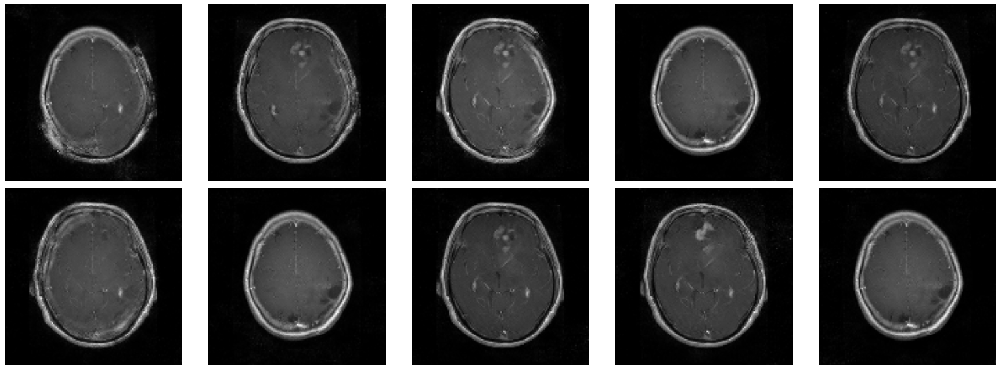

  0%|          | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 30ms/step


  0%|          | 1/3750 [00:00<11:49,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 2/3750 [00:00<09:49,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 3/3750 [00:00<10:00,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 4/3750 [00:00<09:32,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 5/3750 [00:00<09:49,  6.35it/s]

1/1 [==============================] - 0s 46ms/step


  0%|          | 6/3750 [00:00<10:16,  6.07it/s]

1/1 [==============================] - 0s 29ms/step


  0%|          | 7/3750 [00:01<09:53,  6.31it/s]

1/1 [==============================] - 0s 32ms/step


  0%|          | 8/3750 [00:01<09:49,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 9/3750 [00:01<10:26,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 10/3750 [00:01<10:21,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 11/3750 [00:01<10:01,  6.22it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 12/3750 [00:01<10:04,  6.19it/s]

1/1 [==============================] - 0s 33ms/step


  0%|          | 13/3750 [00:02<10:17,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 14/3750 [00:02<09:55,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 15/3750 [00:02<09:34,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 16/3750 [00:02<09:13,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 17/3750 [00:02<08:46,  7.09it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 18/3750 [00:02<08:53,  6.99it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 19/3750 [00:02<08:57,  6.94it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 20/3750 [00:03<09:31,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 21/3750 [00:03<10:05,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 22/3750 [00:03<09:55,  6.26it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 23/3750 [00:03<09:40,  6.42it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 24/3750 [00:03<09:30,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 25/3750 [00:03<09:17,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 26/3750 [00:04<09:19,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 27/3750 [00:04<09:11,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 28/3750 [00:04<09:21,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 29/3750 [00:04<09:14,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 30/3750 [00:04<09:54,  6.26it/s]

1/1 [==============================] - 0s 53ms/step


  1%|          | 31/3750 [00:04<10:49,  5.73it/s]

1/1 [==============================] - 0s 32ms/step


  1%|          | 32/3750 [00:05<10:33,  5.87it/s]

1/1 [==============================] - 0s 35ms/step


  1%|          | 33/3750 [00:05<10:21,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 34/3750 [00:05<09:46,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 35/3750 [00:05<09:34,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 36/3750 [00:05<10:13,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 37/3750 [00:05<09:55,  6.23it/s]

1/1 [==============================] - 0s 35ms/step


  1%|          | 38/3750 [00:06<10:06,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 39/3750 [00:06<10:21,  5.97it/s]

1/1 [==============================] - 0s 42ms/step


  1%|          | 40/3750 [00:06<11:25,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 41/3750 [00:06<11:15,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 42/3750 [00:06<10:18,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 43/3750 [00:06<09:57,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 44/3750 [00:07<09:44,  6.35it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 45/3750 [00:07<09:52,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 46/3750 [00:07<10:32,  5.86it/s]

1/1 [==============================] - 0s 33ms/step


  1%|▏         | 47/3750 [00:07<10:39,  5.79it/s]

1/1 [==============================] - 0s 51ms/step


  1%|▏         | 48/3750 [00:07<11:04,  5.57it/s]

1/1 [==============================] - 0s 33ms/step


  1%|▏         | 49/3750 [00:07<10:32,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 50/3750 [00:08<10:02,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


  1%|▏         | 51/3750 [00:08<09:33,  6.45it/s]

1/1 [==============================] - 0s 32ms/step


  1%|▏         | 52/3750 [00:08<09:16,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 53/3750 [00:08<09:09,  6.73it/s]

1/1 [==============================] - 0s 26ms/step


  1%|▏         | 54/3750 [00:08<09:10,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 55/3750 [00:08<08:58,  6.86it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 56/3750 [00:08<08:43,  7.06it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 57/3750 [00:09<08:43,  7.05it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 58/3750 [00:09<08:52,  6.94it/s]

1/1 [==============================] - 0s 43ms/step


  2%|▏         | 59/3750 [00:09<09:23,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 60/3750 [00:09<09:42,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 61/3750 [00:09<09:32,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 62/3750 [00:09<09:19,  6.59it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 63/3750 [00:09<09:15,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 64/3750 [00:10<09:15,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 65/3750 [00:10<09:01,  6.80it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 66/3750 [00:10<09:14,  6.64it/s]

1/1 [==============================] - 0s 51ms/step


  2%|▏         | 67/3750 [00:10<09:59,  6.14it/s]

1/1 [==============================] - 0s 38ms/step


  2%|▏         | 68/3750 [00:10<10:21,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 69/3750 [00:10<10:00,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 70/3750 [00:11<09:58,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 71/3750 [00:11<09:54,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 72/3750 [00:11<09:46,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 73/3750 [00:11<09:33,  6.41it/s]

1/1 [==============================] - 0s 33ms/step


  2%|▏         | 74/3750 [00:11<09:59,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 75/3750 [00:11<09:33,  6.41it/s]

1/1 [==============================] - 0s 38ms/step


  2%|▏         | 76/3750 [00:12<09:48,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 77/3750 [00:12<09:35,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 78/3750 [00:12<09:34,  6.39it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 79/3750 [00:12<09:27,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 80/3750 [00:12<09:37,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 81/3750 [00:12<09:46,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 82/3750 [00:12<09:29,  6.44it/s]

1/1 [==============================] - 0s 36ms/step


  2%|▏         | 83/3750 [00:13<09:43,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 84/3750 [00:13<10:00,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 85/3750 [00:13<10:50,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 86/3750 [00:13<10:26,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 87/3750 [00:13<09:55,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 88/3750 [00:13<09:37,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 89/3750 [00:14<09:26,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 90/3750 [00:14<09:14,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 91/3750 [00:14<09:24,  6.48it/s]

1/1 [==============================] - 0s 38ms/step


  2%|▏         | 92/3750 [00:14<10:08,  6.02it/s]

1/1 [==============================] - 0s 46ms/step


  2%|▏         | 93/3750 [00:14<10:53,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 94/3750 [00:14<10:09,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 95/3750 [00:15<09:40,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 96/3750 [00:15<09:17,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 97/3750 [00:15<09:56,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 98/3750 [00:15<09:34,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 99/3750 [00:15<09:14,  6.59it/s]

1/1 [==============================] - 0s 36ms/step


  3%|▎         | 100/3750 [00:15<09:19,  6.52it/s]

1/1 [==============================] - 0s 46ms/step


  3%|▎         | 101/3750 [00:16<09:48,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 102/3750 [00:16<10:30,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 103/3750 [00:16<10:27,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 104/3750 [00:16<09:54,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 105/3750 [00:16<09:15,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 106/3750 [00:16<09:02,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 107/3750 [00:17<09:45,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 108/3750 [00:17<09:22,  6.47it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 109/3750 [00:17<09:37,  6.30it/s]

1/1 [==============================] - 0s 33ms/step


  3%|▎         | 110/3750 [00:17<09:55,  6.12it/s]

1/1 [==============================] - 0s 49ms/step


  3%|▎         | 111/3750 [00:17<10:43,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 112/3750 [00:17<09:58,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 113/3750 [00:17<09:31,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 114/3750 [00:18<09:31,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 115/3750 [00:18<09:21,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 116/3750 [00:18<09:02,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 117/3750 [00:18<08:46,  6.90it/s]

1/1 [==============================] - 0s 32ms/step


  3%|▎         | 118/3750 [00:18<09:19,  6.49it/s]

1/1 [==============================] - 0s 35ms/step


  3%|▎         | 119/3750 [00:18<09:19,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 120/3750 [00:19<08:50,  6.84it/s]

1/1 [==============================] - 0s 44ms/step


  3%|▎         | 121/3750 [00:19<09:31,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 122/3750 [00:19<09:24,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 123/3750 [00:19<08:57,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 124/3750 [00:19<08:47,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 125/3750 [00:19<08:34,  7.04it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 126/3750 [00:19<08:39,  6.97it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 127/3750 [00:20<08:22,  7.21it/s]

1/1 [==============================] - 0s 48ms/step


  3%|▎         | 128/3750 [00:20<09:56,  6.07it/s]

1/1 [==============================] - 0s 47ms/step


  3%|▎         | 129/3750 [00:20<10:45,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 130/3750 [00:20<10:09,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 131/3750 [00:20<09:43,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 132/3750 [00:20<09:35,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 133/3750 [00:21<09:19,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 134/3750 [00:21<09:02,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 135/3750 [00:21<08:46,  6.86it/s]

1/1 [==============================] - 0s 37ms/step


  4%|▎         | 136/3750 [00:21<09:12,  6.54it/s]

1/1 [==============================] - 0s 52ms/step


  4%|▎         | 137/3750 [00:21<10:06,  5.96it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▎         | 138/3750 [00:21<10:27,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 139/3750 [00:22<10:01,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 140/3750 [00:22<09:36,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 141/3750 [00:22<09:29,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 142/3750 [00:22<09:25,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 143/3750 [00:22<09:16,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 144/3750 [00:22<09:10,  6.55it/s]

1/1 [==============================] - 0s 37ms/step


  4%|▍         | 145/3750 [00:22<09:25,  6.37it/s]

1/1 [==============================] - 0s 36ms/step


  4%|▍         | 146/3750 [00:23<10:07,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 147/3750 [00:23<09:47,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 148/3750 [00:23<09:35,  6.26it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 149/3750 [00:23<09:17,  6.46it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 150/3750 [00:23<08:49,  6.80it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 151/3750 [00:23<08:49,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 152/3750 [00:24<08:56,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 153/3750 [00:24<09:13,  6.49it/s]

1/1 [==============================] - 0s 49ms/step


  4%|▍         | 154/3750 [00:24<09:49,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 155/3750 [00:24<09:33,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 156/3750 [00:24<09:08,  6.56it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 157/3750 [00:24<09:27,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 158/3750 [00:24<09:25,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 159/3750 [00:25<09:19,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 160/3750 [00:25<09:07,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 161/3750 [00:25<08:42,  6.87it/s]

1/1 [==============================] - 0s 37ms/step


  4%|▍         | 162/3750 [00:25<09:00,  6.63it/s]

1/1 [==============================] - 0s 53ms/step


  4%|▍         | 163/3750 [00:25<10:37,  5.63it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▍         | 164/3750 [00:25<10:16,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 165/3750 [00:26<09:40,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 166/3750 [00:26<09:32,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 167/3750 [00:26<09:16,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 168/3750 [00:26<09:33,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 169/3750 [00:26<08:49,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 170/3750 [00:26<09:10,  6.50it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▍         | 171/3750 [00:27<09:13,  6.47it/s]

1/1 [==============================] - 0s 51ms/step


  5%|▍         | 172/3750 [00:27<09:35,  6.22it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▍         | 173/3750 [00:27<09:27,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 174/3750 [00:27<08:55,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 175/3750 [00:27<08:27,  7.05it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▍         | 176/3750 [00:27<08:13,  7.24it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 177/3750 [00:27<08:28,  7.03it/s]

1/1 [==============================] - 0s 33ms/step


  5%|▍         | 178/3750 [00:28<08:32,  6.97it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 179/3750 [00:28<08:32,  6.96it/s]

1/1 [==============================] - 0s 51ms/step


  5%|▍         | 180/3750 [00:28<09:53,  6.01it/s]

1/1 [==============================] - 0s 41ms/step


  5%|▍         | 181/3750 [00:28<10:05,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▍         | 182/3750 [00:28<09:51,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 183/3750 [00:28<09:40,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 184/3750 [00:29<09:46,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 185/3750 [00:29<09:12,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 186/3750 [00:29<09:11,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 187/3750 [00:29<09:40,  6.14it/s]

1/1 [==============================] - 0s 33ms/step


  5%|▌         | 188/3750 [00:29<09:28,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 189/3750 [00:29<09:46,  6.07it/s]

1/1 [==============================] - 0s 48ms/step


  5%|▌         | 190/3750 [00:30<10:31,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 191/3750 [00:30<09:56,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 192/3750 [00:30<09:40,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 193/3750 [00:30<10:15,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 194/3750 [00:30<09:46,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 195/3750 [00:30<09:15,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▌         | 196/3750 [00:31<09:37,  6.16it/s]

1/1 [==============================] - 0s 35ms/step


  5%|▌         | 197/3750 [00:31<09:55,  5.96it/s]

1/1 [==============================] - 0s 32ms/step


  5%|▌         | 198/3750 [00:31<09:48,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 199/3750 [00:31<10:06,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 200/3750 [00:31<09:39,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 201/3750 [00:31<09:05,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 202/3750 [00:31<08:51,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 203/3750 [00:32<09:03,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 204/3750 [00:32<09:08,  6.47it/s]

1/1 [==============================] - 0s 33ms/step


  5%|▌         | 205/3750 [00:32<09:10,  6.44it/s]

1/1 [==============================] - 0s 47ms/step


  5%|▌         | 206/3750 [00:32<09:25,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▌         | 207/3750 [00:32<09:05,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 208/3750 [00:32<08:55,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 209/3750 [00:33<08:52,  6.65it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 210/3750 [00:33<08:42,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 211/3750 [00:33<08:40,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 212/3750 [00:33<08:48,  6.69it/s]

1/1 [==============================] - 0s 43ms/step


  6%|▌         | 213/3750 [00:33<09:51,  5.97it/s]

1/1 [==============================] - 0s 55ms/step


  6%|▌         | 214/3750 [00:33<10:21,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 215/3750 [00:34<09:44,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 216/3750 [00:34<09:29,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 217/3750 [00:34<09:07,  6.46it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 218/3750 [00:34<08:46,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 219/3750 [00:34<08:36,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 220/3750 [00:34<08:24,  7.00it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 221/3750 [00:34<08:28,  6.94it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 222/3750 [00:35<08:54,  6.60it/s]

1/1 [==============================] - 0s 35ms/step


  6%|▌         | 223/3750 [00:35<09:47,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 224/3750 [00:35<10:08,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 225/3750 [00:35<09:53,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 226/3750 [00:35<09:38,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 227/3750 [00:35<09:25,  6.23it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 228/3750 [00:36<08:56,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 229/3750 [00:36<08:45,  6.70it/s]

1/1 [==============================] - 0s 44ms/step


  6%|▌         | 230/3750 [00:36<09:36,  6.11it/s]

1/1 [==============================] - 0s 37ms/step


  6%|▌         | 231/3750 [00:36<09:58,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 232/3750 [00:36<09:27,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 233/3750 [00:36<09:45,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 234/3750 [00:37<09:35,  6.10it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▋         | 235/3750 [00:37<09:12,  6.37it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▋         | 236/3750 [00:37<09:07,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▋         | 237/3750 [00:37<08:47,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 238/3750 [00:37<09:22,  6.25it/s]

1/1 [==============================] - 0s 48ms/step


  6%|▋         | 239/3750 [00:37<10:04,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▋         | 240/3750 [00:37<09:43,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 241/3750 [00:38<09:29,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 242/3750 [00:38<09:00,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 243/3750 [00:38<09:34,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 244/3750 [00:38<09:13,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 245/3750 [00:38<09:12,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 246/3750 [00:38<09:10,  6.36it/s]

1/1 [==============================] - 0s 47ms/step


  7%|▋         | 247/3750 [00:39<09:48,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 248/3750 [00:39<10:03,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 249/3750 [00:39<09:49,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 250/3750 [00:39<09:29,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 251/3750 [00:39<09:04,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 252/3750 [00:39<08:53,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 253/3750 [00:40<09:20,  6.24it/s]

1/1 [==============================] - 0s 39ms/step


  7%|▋         | 254/3750 [00:40<09:56,  5.86it/s]

1/1 [==============================] - 0s 36ms/step


  7%|▋         | 255/3750 [00:40<10:07,  5.75it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 256/3750 [00:40<10:00,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 257/3750 [00:40<09:21,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 258/3750 [00:40<09:02,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 259/3750 [00:41<09:40,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 260/3750 [00:41<09:28,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 261/3750 [00:41<09:29,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 262/3750 [00:41<09:56,  5.85it/s]

1/1 [==============================] - 0s 56ms/step


  7%|▋         | 263/3750 [00:41<10:46,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 264/3750 [00:41<10:40,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 265/3750 [00:42<10:14,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 266/3750 [00:42<09:58,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 267/3750 [00:42<10:24,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 268/3750 [00:42<10:40,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 269/3750 [00:42<10:57,  5.29it/s]

1/1 [==============================] - 0s 55ms/step


  7%|▋         | 270/3750 [00:43<11:43,  4.95it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 271/3750 [00:43<11:53,  4.88it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 272/3750 [00:43<11:05,  5.23it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 273/3750 [00:43<10:21,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 274/3750 [00:43<09:44,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 275/3750 [00:43<09:40,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 276/3750 [00:44<09:25,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 277/3750 [00:44<09:12,  6.29it/s]

1/1 [==============================] - 0s 38ms/step


  7%|▋         | 278/3750 [00:44<09:39,  5.99it/s]

1/1 [==============================] - 0s 52ms/step


  7%|▋         | 279/3750 [00:44<10:19,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 280/3750 [00:44<09:42,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 281/3750 [00:44<09:19,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 282/3750 [00:45<09:03,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 283/3750 [00:45<09:01,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 284/3750 [00:45<09:24,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 285/3750 [00:45<09:06,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 286/3750 [00:45<09:01,  6.40it/s]

1/1 [==============================] - 0s 33ms/step


  8%|▊         | 287/3750 [00:45<09:38,  5.99it/s]

1/1 [==============================] - 0s 35ms/step


  8%|▊         | 288/3750 [00:46<09:50,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 289/3750 [00:46<09:22,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 290/3750 [00:46<09:06,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 291/3750 [00:46<09:40,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 292/3750 [00:46<09:10,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 293/3750 [00:46<09:18,  6.19it/s]

1/1 [==============================] - 0s 36ms/step


  8%|▊         | 294/3750 [00:47<09:18,  6.19it/s]

1/1 [==============================] - 0s 35ms/step


  8%|▊         | 295/3750 [00:47<09:27,  6.09it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 296/3750 [00:47<10:04,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 297/3750 [00:47<09:23,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 298/3750 [00:47<09:19,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 299/3750 [00:47<09:10,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 300/3750 [00:48<08:43,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 301/3750 [00:48<08:46,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 302/3750 [00:48<09:12,  6.24it/s]

1/1 [==============================] - 0s 36ms/step


  8%|▊         | 303/3750 [00:48<10:07,  5.68it/s]

1/1 [==============================] - 0s 46ms/step


  8%|▊         | 304/3750 [00:48<10:11,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 305/3750 [00:48<09:43,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 306/3750 [00:49<09:44,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 307/3750 [00:49<09:22,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 308/3750 [00:49<09:42,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 309/3750 [00:49<09:26,  6.08it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 310/3750 [00:49<10:04,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 311/3750 [00:49<09:53,  5.79it/s]

1/1 [==============================] - 0s 46ms/step


  8%|▊         | 312/3750 [00:50<10:36,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 313/3750 [00:50<10:00,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 314/3750 [00:50<09:25,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 315/3750 [00:50<09:00,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 316/3750 [00:50<08:51,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 317/3750 [00:50<08:38,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 318/3750 [00:50<08:44,  6.55it/s]

1/1 [==============================] - 0s 32ms/step


  9%|▊         | 319/3750 [00:51<08:57,  6.39it/s]

1/1 [==============================] - 0s 37ms/step


  9%|▊         | 320/3750 [00:51<09:59,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 321/3750 [00:51<09:28,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 322/3750 [00:51<09:03,  6.31it/s]

1/1 [==============================] - 0s 37ms/step


  9%|▊         | 323/3750 [00:51<08:47,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 324/3750 [00:51<08:28,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 325/3750 [00:52<08:21,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 326/3750 [00:52<08:21,  6.83it/s]

1/1 [==============================] - 0s 36ms/step


  9%|▊         | 327/3750 [00:52<08:31,  6.70it/s]

1/1 [==============================] - 0s 52ms/step


  9%|▊         | 328/3750 [00:52<09:13,  6.19it/s]

1/1 [==============================] - 0s 52ms/step


  9%|▉         | 329/3750 [00:52<10:18,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 330/3750 [00:52<09:41,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 331/3750 [00:53<09:19,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 332/3750 [00:53<09:00,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 333/3750 [00:53<08:49,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 334/3750 [00:53<08:38,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 335/3750 [00:53<08:30,  6.69it/s]

1/1 [==============================] - 0s 49ms/step


  9%|▉         | 336/3750 [00:53<09:26,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 337/3750 [00:54<15:33,  3.65it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 338/3750 [00:54<14:09,  4.02it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 339/3750 [00:54<12:21,  4.60it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 340/3750 [00:54<11:12,  5.07it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 341/3750 [00:55<10:13,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 342/3750 [00:55<09:41,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 343/3750 [00:55<09:48,  5.79it/s]

1/1 [==============================] - 0s 37ms/step


  9%|▉         | 344/3750 [00:55<09:45,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 345/3750 [00:55<09:46,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 346/3750 [00:55<09:57,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 347/3750 [00:56<09:29,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 348/3750 [00:56<09:05,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 349/3750 [00:56<08:43,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 350/3750 [00:56<08:33,  6.62it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 351/3750 [00:56<09:44,  5.81it/s]

1/1 [==============================] - 0s 53ms/step


  9%|▉         | 352/3750 [00:56<11:02,  5.13it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 353/3750 [00:57<10:56,  5.17it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 354/3750 [00:57<10:49,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 355/3750 [00:57<10:51,  5.21it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 356/3750 [00:57<10:44,  5.26it/s]

1/1 [==============================] - 0s 53ms/step


 10%|▉         | 357/3750 [00:57<11:06,  5.09it/s]

1/1 [==============================] - 0s 44ms/step


 10%|▉         | 358/3750 [00:58<11:25,  4.95it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 359/3750 [00:58<10:33,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 360/3750 [00:58<10:26,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 361/3750 [00:58<10:28,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 362/3750 [00:58<09:56,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 363/3750 [00:58<09:30,  5.94it/s]

1/1 [==============================] - 0s 34ms/step


 10%|▉         | 364/3750 [00:59<09:23,  6.00it/s]

1/1 [==============================] - 0s 54ms/step


 10%|▉         | 365/3750 [00:59<10:00,  5.64it/s]

1/1 [==============================] - 0s 31ms/step


 10%|▉         | 366/3750 [00:59<09:57,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 367/3750 [00:59<09:38,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 368/3750 [00:59<09:21,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 369/3750 [00:59<09:05,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 370/3750 [01:00<09:06,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 371/3750 [01:00<08:55,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 372/3750 [01:00<08:37,  6.53it/s]

1/1 [==============================] - 0s 30ms/step


 10%|▉         | 373/3750 [01:00<08:44,  6.44it/s]

1/1 [==============================] - 0s 27ms/step


 10%|▉         | 374/3750 [01:00<09:05,  6.19it/s]

1/1 [==============================] - 0s 49ms/step


 10%|█         | 375/3750 [01:00<09:38,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 376/3750 [01:01<09:52,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 377/3750 [01:01<09:21,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 378/3750 [01:01<09:02,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 379/3750 [01:01<09:04,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 380/3750 [01:01<08:48,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 381/3750 [01:01<08:42,  6.45it/s]

1/1 [==============================] - 0s 55ms/step


 10%|█         | 382/3750 [01:02<09:39,  5.81it/s]

1/1 [==============================] - 0s 45ms/step


 10%|█         | 383/3750 [01:02<10:07,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 384/3750 [01:02<10:10,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 385/3750 [01:02<10:18,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 386/3750 [01:02<10:31,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 387/3750 [01:03<10:01,  5.59it/s]

1/1 [==============================] - 0s 37ms/step


 10%|█         | 388/3750 [01:03<10:28,  5.35it/s]

1/1 [==============================] - 0s 33ms/step


 10%|█         | 389/3750 [01:03<10:58,  5.10it/s]

1/1 [==============================] - 0s 31ms/step


 10%|█         | 390/3750 [01:03<11:24,  4.91it/s]

1/1 [==============================] - 0s 32ms/step


 10%|█         | 391/3750 [01:03<11:13,  4.99it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 392/3750 [01:04<10:42,  5.23it/s]

1/1 [==============================] - 0s 45ms/step


 10%|█         | 393/3750 [01:04<11:22,  4.92it/s]

1/1 [==============================] - 0s 40ms/step


 11%|█         | 394/3750 [01:04<11:36,  4.82it/s]

1/1 [==============================] - 0s 56ms/step


 11%|█         | 395/3750 [01:04<12:07,  4.61it/s]

1/1 [==============================] - 0s 54ms/step


 11%|█         | 396/3750 [01:04<12:09,  4.60it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 397/3750 [01:05<12:04,  4.63it/s]

1/1 [==============================] - 0s 35ms/step


 11%|█         | 398/3750 [01:05<12:30,  4.46it/s]

1/1 [==============================] - 0s 53ms/step


 11%|█         | 399/3750 [01:05<12:22,  4.52it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 400/3750 [01:05<12:38,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 401/3750 [01:06<12:09,  4.59it/s]

1/1 [==============================] - 0s 52ms/step


 11%|█         | 402/3750 [01:06<12:04,  4.62it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 403/3750 [01:06<12:03,  4.62it/s]

1/1 [==============================] - 0s 33ms/step


 11%|█         | 404/3750 [01:06<11:43,  4.76it/s]

1/1 [==============================] - 0s 46ms/step


 11%|█         | 405/3750 [01:06<11:53,  4.69it/s]

1/1 [==============================] - 0s 52ms/step


 11%|█         | 406/3750 [01:07<11:53,  4.69it/s]

1/1 [==============================] - 0s 48ms/step


 11%|█         | 407/3750 [01:07<12:31,  4.45it/s]

1/1 [==============================] - 0s 36ms/step


 11%|█         | 408/3750 [01:07<12:23,  4.50it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 409/3750 [01:07<12:00,  4.64it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█         | 410/3750 [01:07<11:44,  4.74it/s]

1/1 [==============================] - 0s 35ms/step


 11%|█         | 411/3750 [01:08<11:53,  4.68it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 412/3750 [01:08<11:38,  4.78it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 413/3750 [01:08<10:59,  5.06it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 414/3750 [01:08<10:22,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 415/3750 [01:08<09:57,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 416/3750 [01:09<09:36,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 417/3750 [01:09<09:25,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 418/3750 [01:09<09:48,  5.66it/s]

1/1 [==============================] - 0s 35ms/step


 11%|█         | 419/3750 [01:09<10:22,  5.35it/s]

1/1 [==============================] - 0s 58ms/step


 11%|█         | 420/3750 [01:09<10:35,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 421/3750 [01:09<10:40,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 422/3750 [01:10<10:06,  5.49it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█▏        | 423/3750 [01:10<09:22,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 424/3750 [01:10<08:48,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 425/3750 [01:10<08:41,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 426/3750 [01:10<08:25,  6.57it/s]

1/1 [==============================] - 0s 34ms/step


 11%|█▏        | 427/3750 [01:10<09:02,  6.12it/s]

1/1 [==============================] - 0s 46ms/step


 11%|█▏        | 428/3750 [01:11<09:16,  5.97it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█▏        | 429/3750 [01:11<09:42,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 430/3750 [01:11<08:55,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 431/3750 [01:11<08:39,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 432/3750 [01:11<08:33,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 433/3750 [01:11<08:13,  6.72it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 434/3750 [01:11<08:15,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 435/3750 [01:12<08:07,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 436/3750 [01:12<08:08,  6.78it/s]

1/1 [==============================] - 0s 55ms/step


 12%|█▏        | 437/3750 [01:12<09:07,  6.05it/s]

1/1 [==============================] - 0s 40ms/step


 12%|█▏        | 438/3750 [01:12<09:11,  6.00it/s]

1/1 [==============================] - 0s 34ms/step


 12%|█▏        | 439/3750 [01:12<09:04,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 440/3750 [01:12<09:25,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 441/3750 [01:13<09:05,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 442/3750 [01:13<08:49,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 443/3750 [01:13<08:28,  6.50it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 444/3750 [01:13<08:24,  6.55it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 445/3750 [01:13<08:43,  6.32it/s]

1/1 [==============================] - 0s 51ms/step


 12%|█▏        | 446/3750 [01:13<09:01,  6.10it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 447/3750 [01:14<09:29,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 448/3750 [01:14<09:01,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 449/3750 [01:14<08:43,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 450/3750 [01:14<08:32,  6.44it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 451/3750 [01:14<08:09,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 452/3750 [01:14<08:05,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 453/3750 [01:14<08:02,  6.84it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 454/3750 [01:15<07:49,  7.02it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 455/3750 [01:15<08:18,  6.61it/s]

1/1 [==============================] - 0s 47ms/step


 12%|█▏        | 456/3750 [01:15<09:00,  6.10it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 457/3750 [01:15<08:32,  6.42it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 458/3750 [01:15<08:33,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 459/3750 [01:15<08:53,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 460/3750 [01:16<08:48,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 461/3750 [01:16<08:25,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 462/3750 [01:16<08:08,  6.73it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 463/3750 [01:16<08:10,  6.70it/s]

1/1 [==============================] - 0s 53ms/step


 12%|█▏        | 464/3750 [01:16<08:52,  6.17it/s]

1/1 [==============================] - 0s 34ms/step


 12%|█▏        | 465/3750 [01:16<09:04,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 466/3750 [01:17<08:36,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 467/3750 [01:17<09:07,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 468/3750 [01:17<08:53,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 469/3750 [01:17<08:38,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 470/3750 [01:17<09:09,  5.97it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 471/3750 [01:17<08:56,  6.11it/s]

1/1 [==============================] - 0s 42ms/step


 13%|█▎        | 472/3750 [01:18<08:55,  6.12it/s]

1/1 [==============================] - 0s 39ms/step


 13%|█▎        | 473/3750 [01:18<09:14,  5.91it/s]

1/1 [==============================] - 0s 46ms/step


 13%|█▎        | 474/3750 [01:18<09:37,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 475/3750 [01:18<08:52,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 476/3750 [01:18<08:42,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 477/3750 [01:18<08:45,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 478/3750 [01:18<08:30,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 479/3750 [01:19<08:31,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 480/3750 [01:19<08:58,  6.08it/s]

1/1 [==============================] - 0s 40ms/step


 13%|█▎        | 481/3750 [01:19<09:20,  5.83it/s]

1/1 [==============================] - 0s 52ms/step


 13%|█▎        | 482/3750 [01:19<09:43,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 483/3750 [01:19<09:46,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 484/3750 [01:20<09:17,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 485/3750 [01:20<09:01,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 486/3750 [01:20<08:46,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 487/3750 [01:20<08:38,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 488/3750 [01:20<09:08,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 489/3750 [01:20<09:13,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 490/3750 [01:21<09:16,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 491/3750 [01:21<09:22,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 492/3750 [01:21<09:15,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 493/3750 [01:21<08:52,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 494/3750 [01:21<08:52,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 495/3750 [01:21<09:26,  5.75it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 496/3750 [01:22<09:21,  5.79it/s]

1/1 [==============================] - 0s 43ms/step


 13%|█▎        | 497/3750 [01:22<09:38,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 498/3750 [01:22<10:40,  5.08it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 499/3750 [01:22<10:06,  5.36it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 500/3750 [01:22<09:47,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 501/3750 [01:22<09:29,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 502/3750 [01:23<08:56,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 503/3750 [01:23<08:51,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 504/3750 [01:23<08:46,  6.16it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 505/3750 [01:23<09:51,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 506/3750 [01:23<09:12,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 507/3750 [01:23<08:52,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 508/3750 [01:24<08:59,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 509/3750 [01:24<09:25,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 510/3750 [01:24<09:38,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 511/3750 [01:24<09:20,  5.78it/s]

1/1 [==============================] - 0s 59ms/step


 14%|█▎        | 512/3750 [01:24<09:52,  5.47it/s]

1/1 [==============================] - 0s 38ms/step


 14%|█▎        | 513/3750 [01:25<10:40,  5.06it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 514/3750 [01:25<09:42,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 515/3750 [01:25<09:09,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 516/3750 [01:25<09:11,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 517/3750 [01:25<08:43,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 518/3750 [01:25<08:25,  6.40it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▍        | 519/3750 [01:26<08:30,  6.33it/s]

1/1 [==============================] - 0s 42ms/step


 14%|█▍        | 520/3750 [01:26<08:47,  6.12it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 521/3750 [01:26<08:52,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 522/3750 [01:26<08:50,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 523/3750 [01:26<09:12,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 524/3750 [01:26<08:56,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 525/3750 [01:27<08:46,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 526/3750 [01:27<08:40,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 527/3750 [01:27<08:13,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 528/3750 [01:27<08:06,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 529/3750 [01:27<08:16,  6.49it/s]

1/1 [==============================] - 0s 49ms/step


 14%|█▍        | 530/3750 [01:27<08:52,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 531/3750 [01:28<09:17,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 532/3750 [01:28<08:56,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 533/3750 [01:28<08:32,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 534/3750 [01:28<08:18,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 535/3750 [01:28<08:14,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 536/3750 [01:28<08:04,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 537/3750 [01:28<07:58,  6.72it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▍        | 538/3750 [01:29<08:56,  5.99it/s]

1/1 [==============================] - 0s 36ms/step


 14%|█▍        | 539/3750 [01:29<08:56,  5.98it/s]

1/1 [==============================] - 0s 36ms/step


 14%|█▍        | 540/3750 [01:29<08:54,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 541/3750 [01:29<08:38,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 542/3750 [01:29<08:34,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 543/3750 [01:29<08:14,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 544/3750 [01:30<07:51,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 545/3750 [01:30<07:48,  6.84it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 546/3750 [01:30<08:25,  6.34it/s]

1/1 [==============================] - 0s 48ms/step


 15%|█▍        | 547/3750 [01:30<09:19,  5.72it/s]

1/1 [==============================] - 0s 49ms/step


 15%|█▍        | 548/3750 [01:30<09:25,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 549/3750 [01:30<08:54,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 550/3750 [01:31<08:28,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 551/3750 [01:31<08:14,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 552/3750 [01:31<08:10,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 553/3750 [01:31<08:15,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 554/3750 [01:31<07:58,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 555/3750 [01:31<08:03,  6.61it/s]

1/1 [==============================] - 0s 53ms/step


 15%|█▍        | 556/3750 [01:31<08:52,  6.00it/s]

1/1 [==============================] - 0s 47ms/step


 15%|█▍        | 557/3750 [01:32<09:34,  5.56it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 558/3750 [01:32<09:34,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 559/3750 [01:32<09:45,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 560/3750 [01:32<09:04,  5.85it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 561/3750 [01:32<08:52,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 562/3750 [01:33<08:46,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 563/3750 [01:33<08:55,  5.95it/s]

1/1 [==============================] - 0s 36ms/step


 15%|█▌        | 564/3750 [01:33<09:18,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 565/3750 [01:33<09:26,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 566/3750 [01:33<08:57,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 567/3750 [01:33<09:01,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 568/3750 [01:34<08:36,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 569/3750 [01:34<08:20,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 570/3750 [01:34<08:16,  6.41it/s]

1/1 [==============================] - 0s 33ms/step


 15%|█▌        | 571/3750 [01:34<08:20,  6.35it/s]

1/1 [==============================] - 0s 46ms/step


 15%|█▌        | 572/3750 [01:34<08:58,  5.90it/s]

1/1 [==============================] - 0s 48ms/step


 15%|█▌        | 573/3750 [01:34<08:56,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 574/3750 [01:35<08:40,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 575/3750 [01:35<08:17,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 576/3750 [01:35<08:06,  6.53it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▌        | 577/3750 [01:35<08:05,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 578/3750 [01:35<07:58,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 579/3750 [01:35<07:41,  6.87it/s]

1/1 [==============================] - 0s 39ms/step


 15%|█▌        | 580/3750 [01:35<08:07,  6.50it/s]

1/1 [==============================] - 0s 47ms/step


 15%|█▌        | 581/3750 [01:36<08:27,  6.25it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 582/3750 [01:36<09:04,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 583/3750 [01:36<08:24,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 584/3750 [01:36<08:03,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 585/3750 [01:36<07:59,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 586/3750 [01:36<07:59,  6.60it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 587/3750 [01:36<07:50,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 588/3750 [01:37<07:53,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 589/3750 [01:37<07:37,  6.91it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 590/3750 [01:37<08:07,  6.48it/s]

1/1 [==============================] - 0s 38ms/step


 16%|█▌        | 591/3750 [01:37<08:22,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 592/3750 [01:37<08:02,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 593/3750 [01:37<07:57,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 594/3750 [01:38<07:51,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 595/3750 [01:38<07:52,  6.68it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 596/3750 [01:38<07:59,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 597/3750 [01:38<07:44,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 598/3750 [01:38<07:45,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 599/3750 [01:38<07:45,  6.77it/s]

1/1 [==============================] - 0s 54ms/step


 16%|█▌        | 600/3750 [01:38<08:28,  6.19it/s]

1/1 [==============================] - 0s 36ms/step


 16%|█▌        | 601/3750 [01:39<09:01,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 602/3750 [01:39<08:37,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 603/3750 [01:39<08:04,  6.50it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 604/3750 [01:39<07:48,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 605/3750 [01:39<07:51,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 606/3750 [01:39<07:44,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 607/3750 [01:40<07:36,  6.89it/s]

1/1 [==============================] - 0s 40ms/step


 16%|█▌        | 608/3750 [01:40<07:49,  6.69it/s]

1/1 [==============================] - 0s 44ms/step


 16%|█▌        | 609/3750 [01:40<08:08,  6.43it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▋        | 610/3750 [01:40<08:30,  6.15it/s]

1/1 [==============================] - 0s 34ms/step


 16%|█▋        | 611/3750 [01:40<08:21,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 612/3750 [01:40<08:35,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 613/3750 [01:40<08:12,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 614/3750 [01:41<07:50,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 615/3750 [01:41<07:42,  6.78it/s]

1/1 [==============================] - 0s 32ms/step


 16%|█▋        | 616/3750 [01:41<07:31,  6.94it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 617/3750 [01:41<07:30,  6.96it/s]

1/1 [==============================] - 0s 43ms/step


 16%|█▋        | 618/3750 [01:41<08:31,  6.12it/s]

1/1 [==============================] - 0s 40ms/step


 17%|█▋        | 619/3750 [01:41<08:29,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 620/3750 [01:42<08:03,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 621/3750 [01:42<08:37,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 622/3750 [01:42<08:20,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 623/3750 [01:42<08:08,  6.41it/s]

1/1 [==============================] - 0s 33ms/step


 17%|█▋        | 624/3750 [01:42<08:34,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 625/3750 [01:42<08:32,  6.10it/s]

1/1 [==============================] - 0s 50ms/step


 17%|█▋        | 626/3750 [01:43<08:55,  5.83it/s]

1/1 [==============================] - 0s 46ms/step


 17%|█▋        | 627/3750 [01:43<08:56,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 628/3750 [01:43<08:31,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 629/3750 [01:43<08:23,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 630/3750 [01:43<08:07,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 631/3750 [01:43<08:03,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 632/3750 [01:43<07:58,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 633/3750 [01:44<07:52,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 634/3750 [01:44<07:49,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 635/3750 [01:44<08:06,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 636/3750 [01:44<08:14,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 637/3750 [01:44<08:12,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 638/3750 [01:44<07:54,  6.55it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 639/3750 [01:45<08:13,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 640/3750 [01:45<07:55,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 641/3750 [01:45<08:03,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 642/3750 [01:45<07:48,  6.64it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 643/3750 [01:45<07:48,  6.63it/s]

1/1 [==============================] - 0s 35ms/step


 17%|█▋        | 644/3750 [01:45<08:14,  6.28it/s]

1/1 [==============================] - 0s 34ms/step


 17%|█▋        | 645/3750 [01:46<08:28,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 646/3750 [01:46<08:15,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 647/3750 [01:46<08:03,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 648/3750 [01:46<07:49,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 649/3750 [01:46<07:37,  6.77it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 650/3750 [01:46<07:49,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 651/3750 [01:46<07:56,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 652/3750 [01:47<07:44,  6.67it/s]

1/1 [==============================] - 0s 39ms/step


 17%|█▋        | 653/3750 [01:47<08:26,  6.11it/s]

1/1 [==============================] - 0s 33ms/step


 17%|█▋        | 654/3750 [01:47<09:17,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 655/3750 [01:47<08:42,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 656/3750 [01:47<08:38,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 657/3750 [01:47<08:37,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 658/3750 [01:48<08:08,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 659/3750 [01:48<08:04,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 660/3750 [01:48<08:00,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 661/3750 [01:48<08:35,  5.99it/s]

1/1 [==============================] - 0s 46ms/step


 18%|█▊        | 662/3750 [01:48<08:57,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 663/3750 [01:48<08:36,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 664/3750 [01:49<08:55,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 665/3750 [01:49<08:24,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 666/3750 [01:49<08:13,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 667/3750 [01:49<08:05,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 668/3750 [01:49<08:01,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 669/3750 [01:49<07:57,  6.45it/s]

1/1 [==============================] - 0s 32ms/step


 18%|█▊        | 670/3750 [01:50<08:31,  6.02it/s]

1/1 [==============================] - 0s 45ms/step


 18%|█▊        | 671/3750 [01:50<09:21,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 672/3750 [01:50<09:02,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 673/3750 [01:50<09:14,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 674/3750 [01:50<08:51,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 675/3750 [01:50<09:02,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 676/3750 [01:51<08:34,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 677/3750 [01:51<08:50,  5.80it/s]

1/1 [==============================] - 0s 48ms/step


 18%|█▊        | 678/3750 [01:51<09:26,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 679/3750 [01:51<08:57,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 680/3750 [01:51<08:20,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 681/3750 [01:51<08:32,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 682/3750 [01:52<08:18,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 683/3750 [01:52<08:45,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 684/3750 [01:52<08:37,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 685/3750 [01:52<08:31,  5.99it/s]

1/1 [==============================] - 0s 51ms/step


 18%|█▊        | 686/3750 [01:52<09:23,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 687/3750 [01:53<08:42,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 688/3750 [01:53<08:23,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 689/3750 [01:53<08:45,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 690/3750 [01:53<08:14,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 691/3750 [01:53<07:57,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 692/3750 [01:53<07:47,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 693/3750 [01:53<08:02,  6.34it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▊        | 694/3750 [01:54<08:14,  6.18it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▊        | 695/3750 [01:54<08:28,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▊        | 696/3750 [01:54<08:17,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 697/3750 [01:54<08:35,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 698/3750 [01:54<08:50,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 699/3750 [01:54<08:27,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 700/3750 [01:55<08:45,  5.81it/s]

1/1 [==============================] - 0s 36ms/step


 19%|█▊        | 701/3750 [01:55<08:34,  5.92it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▊        | 702/3750 [01:55<08:47,  5.78it/s]

1/1 [==============================] - 0s 35ms/step


 19%|█▊        | 703/3750 [01:55<08:48,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 704/3750 [01:55<08:27,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 705/3750 [01:55<08:01,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 706/3750 [01:56<08:43,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 707/3750 [01:56<09:08,  5.55it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 708/3750 [01:56<08:50,  5.73it/s]

1/1 [==============================] - 0s 49ms/step


 19%|█▉        | 709/3750 [01:56<08:57,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 710/3750 [01:56<08:38,  5.86it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▉        | 711/3750 [01:57<09:09,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 712/3750 [01:57<08:43,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 713/3750 [01:57<08:16,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 714/3750 [01:57<08:02,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 715/3750 [01:57<07:57,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 716/3750 [01:57<07:31,  6.71it/s]

1/1 [==============================] - 0s 36ms/step


 19%|█▉        | 717/3750 [01:58<08:17,  6.10it/s]

1/1 [==============================] - 0s 40ms/step


 19%|█▉        | 718/3750 [01:58<08:20,  6.06it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 719/3750 [01:58<08:16,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 720/3750 [01:58<07:49,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 721/3750 [01:58<07:47,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 722/3750 [01:58<07:41,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 723/3750 [01:58<07:37,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 724/3750 [01:59<07:33,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 725/3750 [01:59<07:33,  6.68it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 726/3750 [01:59<07:45,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 727/3750 [01:59<08:11,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 728/3750 [01:59<08:46,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 729/3750 [01:59<09:03,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 730/3750 [02:00<09:16,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 731/3750 [02:00<09:29,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 732/3750 [02:00<09:04,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 733/3750 [02:00<08:38,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 734/3750 [02:00<08:41,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 20%|█▉        | 735/3750 [02:01<08:40,  5.79it/s]

1/1 [==============================] - 0s 39ms/step


 20%|█▉        | 736/3750 [02:01<08:44,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 737/3750 [02:01<08:22,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 738/3750 [02:01<08:03,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 739/3750 [02:01<07:55,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 740/3750 [02:01<07:57,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 741/3750 [02:01<07:36,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 742/3750 [02:02<07:37,  6.57it/s]

1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 743/3750 [02:02<07:45,  6.46it/s]

1/1 [==============================] - 0s 43ms/step


 20%|█▉        | 744/3750 [02:02<08:31,  5.88it/s]

1/1 [==============================] - 0s 29ms/step


 20%|█▉        | 745/3750 [02:02<08:32,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 746/3750 [02:02<08:29,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 747/3750 [02:02<08:35,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 748/3750 [02:03<08:43,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 749/3750 [02:03<08:22,  5.97it/s]

1/1 [==============================] - 0s 34ms/step


 20%|██        | 750/3750 [02:03<08:32,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 751/3750 [02:03<08:39,  5.77it/s]

1/1 [==============================] - 0s 45ms/step


 20%|██        | 752/3750 [02:03<09:05,  5.49it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 753/3750 [02:04<09:23,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 754/3750 [02:04<08:39,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 755/3750 [02:04<08:39,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 756/3750 [02:04<08:32,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 757/3750 [02:04<08:22,  5.95it/s]

1/1 [==============================] - 0s 36ms/step


 20%|██        | 758/3750 [02:04<08:30,  5.86it/s]

1/1 [==============================] - 0s 45ms/step


 20%|██        | 759/3750 [02:05<09:06,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 760/3750 [02:05<08:26,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 761/3750 [02:05<08:25,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 762/3750 [02:05<08:56,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 763/3750 [02:05<08:23,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 764/3750 [02:05<07:57,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 765/3750 [02:06<07:40,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 766/3750 [02:06<07:37,  6.53it/s]

1/1 [==============================] - 0s 41ms/step


 20%|██        | 767/3750 [02:06<08:20,  5.96it/s]

1/1 [==============================] - 0s 46ms/step


 20%|██        | 768/3750 [02:06<09:21,  5.31it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 769/3750 [02:06<08:54,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 770/3750 [02:06<08:18,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 771/3750 [02:07<08:05,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 772/3750 [02:07<08:05,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 773/3750 [02:07<07:42,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 774/3750 [02:07<07:39,  6.47it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 775/3750 [02:07<07:29,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 776/3750 [02:07<07:20,  6.76it/s]

1/1 [==============================] - 0s 48ms/step


 21%|██        | 777/3750 [02:08<08:11,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 778/3750 [02:08<08:04,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 779/3750 [02:08<08:25,  5.88it/s]

1/1 [==============================] - 0s 36ms/step


 21%|██        | 780/3750 [02:08<08:18,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 781/3750 [02:08<08:00,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 782/3750 [02:08<07:52,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 783/3750 [02:09<08:25,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 784/3750 [02:09<08:19,  5.94it/s]

1/1 [==============================] - 0s 55ms/step


 21%|██        | 785/3750 [02:09<08:46,  5.63it/s]

1/1 [==============================] - 0s 36ms/step


 21%|██        | 786/3750 [02:09<09:09,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 787/3750 [02:09<08:29,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 788/3750 [02:09<08:11,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 789/3750 [02:10<08:29,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 790/3750 [02:10<08:31,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 791/3750 [02:10<08:12,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 792/3750 [02:10<07:58,  6.18it/s]

1/1 [==============================] - 0s 32ms/step


 21%|██        | 793/3750 [02:10<08:31,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 794/3750 [02:10<08:06,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 795/3750 [02:11<07:54,  6.23it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 796/3750 [02:11<07:44,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██▏       | 797/3750 [02:11<07:36,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██▏       | 798/3750 [02:11<08:09,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 799/3750 [02:11<07:53,  6.24it/s]

1/1 [==============================] - 0s 49ms/step


 21%|██▏       | 800/3750 [02:11<08:13,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 801/3750 [02:12<08:05,  6.07it/s]

1/1 [==============================] - 0s 32ms/step


 21%|██▏       | 802/3750 [02:12<08:29,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 803/3750 [02:12<08:14,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 804/3750 [02:12<07:56,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██▏       | 805/3750 [02:12<08:29,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 806/3750 [02:12<08:09,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 807/3750 [02:13<08:03,  6.09it/s]

1/1 [==============================] - 0s 50ms/step


 22%|██▏       | 808/3750 [02:13<08:26,  5.81it/s]

1/1 [==============================] - 0s 34ms/step


 22%|██▏       | 809/3750 [02:13<08:58,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 810/3750 [02:13<09:06,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 811/3750 [02:13<08:35,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 812/3750 [02:13<08:01,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 813/3750 [02:14<08:00,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 814/3750 [02:14<08:21,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 815/3750 [02:14<08:00,  6.11it/s]

1/1 [==============================] - 0s 36ms/step


 22%|██▏       | 816/3750 [02:14<08:35,  5.69it/s]

1/1 [==============================] - 0s 49ms/step


 22%|██▏       | 817/3750 [02:14<09:16,  5.27it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 818/3750 [02:14<08:42,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 819/3750 [02:15<08:09,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 820/3750 [02:15<07:55,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 821/3750 [02:15<07:48,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 822/3750 [02:15<07:40,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 823/3750 [02:15<07:11,  6.78it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 824/3750 [02:15<07:11,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 825/3750 [02:15<07:05,  6.87it/s]

1/1 [==============================] - 0s 45ms/step


 22%|██▏       | 826/3750 [02:16<07:32,  6.47it/s]

1/1 [==============================] - 0s 35ms/step


 22%|██▏       | 827/3750 [02:16<07:34,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 828/3750 [02:16<07:22,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 829/3750 [02:16<07:11,  6.77it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 830/3750 [02:16<07:05,  6.86it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 831/3750 [02:16<06:54,  7.04it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 832/3750 [02:17<06:54,  7.04it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 833/3750 [02:17<07:05,  6.86it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 834/3750 [02:17<07:29,  6.48it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 835/3750 [02:17<07:25,  6.55it/s]

1/1 [==============================] - 0s 46ms/step


 22%|██▏       | 836/3750 [02:17<07:44,  6.27it/s]

1/1 [==============================] - 0s 44ms/step


 22%|██▏       | 837/3750 [02:17<08:23,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 838/3750 [02:18<08:02,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 839/3750 [02:18<07:49,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 840/3750 [02:18<07:23,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 841/3750 [02:18<07:10,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 842/3750 [02:18<07:01,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 843/3750 [02:18<06:56,  6.97it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 844/3750 [02:18<07:04,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 845/3750 [02:19<07:11,  6.73it/s]

1/1 [==============================] - 0s 47ms/step


 23%|██▎       | 846/3750 [02:19<07:17,  6.64it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 847/3750 [02:19<06:59,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 848/3750 [02:19<07:00,  6.90it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 849/3750 [02:19<07:06,  6.81it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 850/3750 [02:19<07:00,  6.89it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 851/3750 [02:19<07:03,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 852/3750 [02:20<07:00,  6.89it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 853/3750 [02:20<06:52,  7.02it/s]

1/1 [==============================] - 0s 45ms/step


 23%|██▎       | 854/3750 [02:20<07:23,  6.52it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 855/3750 [02:20<07:27,  6.46it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 856/3750 [02:20<07:42,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 857/3750 [02:20<07:29,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 858/3750 [02:20<07:15,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 859/3750 [02:21<07:27,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 860/3750 [02:21<07:21,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 861/3750 [02:21<07:21,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 862/3750 [02:21<07:22,  6.52it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 863/3750 [02:21<07:36,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 864/3750 [02:21<07:53,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 865/3750 [02:22<08:03,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 866/3750 [02:22<07:44,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 867/3750 [02:22<07:20,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 868/3750 [02:22<07:47,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 869/3750 [02:22<07:29,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 870/3750 [02:22<07:07,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 871/3750 [02:22<06:59,  6.87it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 872/3750 [02:23<07:41,  6.24it/s]

1/1 [==============================] - 0s 33ms/step


 23%|██▎       | 873/3750 [02:23<08:16,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 874/3750 [02:23<07:58,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 875/3750 [02:23<08:18,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 876/3750 [02:23<07:53,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 877/3750 [02:24<07:30,  6.38it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 878/3750 [02:24<07:25,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 879/3750 [02:24<06:58,  6.86it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 880/3750 [02:24<07:30,  6.37it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 881/3750 [02:24<08:17,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▎       | 882/3750 [02:24<08:38,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 883/3750 [02:25<08:06,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 884/3750 [02:25<08:11,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 885/3750 [02:25<07:47,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 886/3750 [02:25<07:23,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 887/3750 [02:25<07:22,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 888/3750 [02:25<07:04,  6.74it/s]

1/1 [==============================] - 0s 51ms/step


 24%|██▎       | 889/3750 [02:25<07:45,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▎       | 890/3750 [02:26<07:30,  6.35it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 891/3750 [02:26<07:24,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 892/3750 [02:26<07:04,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 893/3750 [02:26<06:49,  6.98it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 894/3750 [02:26<07:02,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 895/3750 [02:26<07:05,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 896/3750 [02:26<06:51,  6.94it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 897/3750 [02:27<06:40,  7.13it/s]

1/1 [==============================] - 0s 35ms/step


 24%|██▍       | 898/3750 [02:27<07:26,  6.39it/s]

1/1 [==============================] - 0s 36ms/step


 24%|██▍       | 899/3750 [02:27<07:32,  6.30it/s]

1/1 [==============================] - 0s 44ms/step


 24%|██▍       | 900/3750 [02:27<07:51,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 901/3750 [02:27<07:27,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 902/3750 [02:27<07:08,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 903/3750 [02:28<07:10,  6.61it/s]

1/1 [==============================] - 0s 34ms/step


 24%|██▍       | 904/3750 [02:28<07:31,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 905/3750 [02:28<07:28,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 906/3750 [02:28<07:42,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 907/3750 [02:28<07:33,  6.27it/s]

1/1 [==============================] - 0s 46ms/step


 24%|██▍       | 908/3750 [02:28<07:53,  6.00it/s]

1/1 [==============================] - 0s 46ms/step


 24%|██▍       | 909/3750 [02:29<08:42,  5.44it/s]

1/1 [==============================] - 0s 35ms/step


 24%|██▍       | 910/3750 [02:29<08:42,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 911/3750 [02:29<08:04,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 912/3750 [02:29<07:45,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 913/3750 [02:29<07:34,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 914/3750 [02:29<07:24,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 915/3750 [02:30<07:13,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 916/3750 [02:30<07:13,  6.53it/s]

1/1 [==============================] - 0s 46ms/step


 24%|██▍       | 917/3750 [02:30<07:41,  6.14it/s]

1/1 [==============================] - 0s 43ms/step


 24%|██▍       | 918/3750 [02:30<07:52,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 919/3750 [02:30<07:26,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 920/3750 [02:30<07:53,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 921/3750 [02:31<07:57,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 922/3750 [02:31<07:38,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 923/3750 [02:31<07:39,  6.15it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▍       | 924/3750 [02:31<07:40,  6.13it/s]

1/1 [==============================] - 0s 48ms/step


 25%|██▍       | 925/3750 [02:31<08:19,  5.66it/s]

1/1 [==============================] - 0s 39ms/step


 25%|██▍       | 926/3750 [02:31<08:48,  5.34it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 927/3750 [02:32<08:34,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 928/3750 [02:32<08:25,  5.58it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▍       | 929/3750 [02:32<07:58,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 930/3750 [02:32<07:43,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 931/3750 [02:32<07:36,  6.18it/s]

1/1 [==============================] - 0s 42ms/step


 25%|██▍       | 932/3750 [02:32<08:07,  5.78it/s]

1/1 [==============================] - 0s 44ms/step


 25%|██▍       | 933/3750 [02:33<08:25,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 934/3750 [02:33<07:56,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 935/3750 [02:33<08:04,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 936/3750 [02:33<07:50,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 937/3750 [02:33<07:22,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 938/3750 [02:33<07:01,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 939/3750 [02:34<06:41,  7.00it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 940/3750 [02:34<06:44,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 941/3750 [02:34<06:34,  7.12it/s]

1/1 [==============================] - 0s 36ms/step


 25%|██▌       | 942/3750 [02:34<06:55,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 943/3750 [02:34<07:05,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 944/3750 [02:34<07:10,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 945/3750 [02:34<07:08,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 946/3750 [02:35<07:08,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 947/3750 [02:35<07:06,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 948/3750 [02:35<07:06,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 949/3750 [02:35<07:03,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 950/3750 [02:35<06:58,  6.68it/s]

1/1 [==============================] - 0s 36ms/step


 25%|██▌       | 951/3750 [02:35<07:19,  6.37it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 952/3750 [02:36<07:55,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 953/3750 [02:36<07:49,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 954/3750 [02:36<07:42,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 955/3750 [02:36<07:19,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 956/3750 [02:36<07:17,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 957/3750 [02:36<07:08,  6.52it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 958/3750 [02:36<07:07,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 959/3750 [02:37<07:36,  6.12it/s]

1/1 [==============================] - 0s 33ms/step


 26%|██▌       | 960/3750 [02:37<07:32,  6.17it/s]

1/1 [==============================] - 0s 34ms/step


 26%|██▌       | 961/3750 [02:37<07:40,  6.06it/s]

1/1 [==============================] - 0s 35ms/step


 26%|██▌       | 962/3750 [02:37<07:50,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 963/3750 [02:37<07:25,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 964/3750 [02:37<07:19,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 965/3750 [02:38<06:57,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 966/3750 [02:38<07:00,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 967/3750 [02:38<06:43,  6.89it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 968/3750 [02:38<06:43,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 969/3750 [02:38<06:38,  6.98it/s]

1/1 [==============================] - 0s 39ms/step


 26%|██▌       | 970/3750 [02:38<07:05,  6.53it/s]

1/1 [==============================] - 0s 52ms/step


 26%|██▌       | 971/3750 [02:39<07:43,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 972/3750 [02:39<08:06,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 973/3750 [02:39<07:46,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 974/3750 [02:39<07:26,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 975/3750 [02:39<07:09,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 976/3750 [02:39<07:08,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 977/3750 [02:39<07:04,  6.54it/s]

1/1 [==============================] - 0s 35ms/step


 26%|██▌       | 978/3750 [02:40<07:39,  6.03it/s]

1/1 [==============================] - 0s 51ms/step


 26%|██▌       | 979/3750 [02:40<08:22,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 980/3750 [02:40<08:24,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 981/3750 [02:40<07:57,  5.80it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 982/3750 [02:40<07:45,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 983/3750 [02:41<08:02,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 984/3750 [02:41<08:10,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▋       | 985/3750 [02:41<07:47,  5.92it/s]

1/1 [==============================] - 0s 45ms/step


 26%|██▋       | 986/3750 [02:41<08:20,  5.52it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▋       | 987/3750 [02:41<08:19,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 988/3750 [02:41<07:55,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 989/3750 [02:42<08:08,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 990/3750 [02:42<07:48,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▋       | 991/3750 [02:42<07:23,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▋       | 992/3750 [02:42<07:51,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▋       | 993/3750 [02:42<07:37,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 994/3750 [02:42<07:23,  6.21it/s]

1/1 [==============================] - 0s 37ms/step


 27%|██▋       | 995/3750 [02:43<07:38,  6.00it/s]

1/1 [==============================] - 0s 45ms/step


 27%|██▋       | 996/3750 [02:43<07:48,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 997/3750 [02:43<07:50,  5.85it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 998/3750 [02:43<07:29,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 999/3750 [02:43<07:13,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1000/3750 [02:43<06:58,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1001/3750 [02:44<06:58,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1002/3750 [02:44<06:56,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1003/3750 [02:44<06:41,  6.85it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1004/3750 [02:44<06:33,  6.97it/s]

1/1 [==============================] - 0s 49ms/step


 27%|██▋       | 1005/3750 [02:44<06:59,  6.55it/s]

1/1 [==============================] - 0s 48ms/step


 27%|██▋       | 1006/3750 [02:44<07:55,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1007/3750 [02:44<07:33,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 1008/3750 [02:45<07:15,  6.30it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 1009/3750 [02:45<07:18,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1010/3750 [02:45<06:57,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1011/3750 [02:45<06:53,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1012/3750 [02:45<06:57,  6.56it/s]

1/1 [==============================] - 0s 48ms/step


 27%|██▋       | 1013/3750 [02:45<07:33,  6.03it/s]

1/1 [==============================] - 0s 46ms/step


 27%|██▋       | 1014/3750 [02:46<08:06,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1015/3750 [02:46<07:29,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1016/3750 [02:46<07:05,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 1017/3750 [02:46<06:58,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1018/3750 [02:46<07:16,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1019/3750 [02:46<07:02,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1020/3750 [02:47<06:51,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1021/3750 [02:47<07:13,  6.30it/s]

1/1 [==============================] - 0s 53ms/step


 27%|██▋       | 1022/3750 [02:47<07:31,  6.04it/s]

1/1 [==============================] - 0s 45ms/step


 27%|██▋       | 1023/3750 [02:47<07:37,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1024/3750 [02:47<07:15,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1025/3750 [02:47<06:54,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1026/3750 [02:47<06:52,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1027/3750 [02:48<07:09,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 1028/3750 [02:48<06:59,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 1029/3750 [02:48<06:44,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 1030/3750 [02:48<06:49,  6.64it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 1031/3750 [02:48<06:42,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1032/3750 [02:48<06:55,  6.55it/s]

1/1 [==============================] - 0s 45ms/step


 28%|██▊       | 1033/3750 [02:49<07:25,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1034/3750 [02:49<07:03,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1035/3750 [02:49<06:46,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1036/3750 [02:49<06:42,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1037/3750 [02:49<06:32,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1038/3750 [02:49<06:37,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1039/3750 [02:49<06:32,  6.91it/s]

1/1 [==============================] - 0s 44ms/step


 28%|██▊       | 1040/3750 [02:50<07:23,  6.11it/s]

1/1 [==============================] - 0s 46ms/step


 28%|██▊       | 1041/3750 [02:50<07:36,  5.93it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 1042/3750 [02:50<07:34,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1043/3750 [02:50<07:01,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1044/3750 [02:50<06:50,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1045/3750 [02:50<06:32,  6.89it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1046/3750 [02:50<06:19,  7.13it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 1047/3750 [02:51<06:22,  7.07it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1048/3750 [02:51<06:30,  6.91it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1049/3750 [02:51<06:45,  6.66it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 1050/3750 [02:51<06:48,  6.61it/s]

1/1 [==============================] - 0s 43ms/step


 28%|██▊       | 1051/3750 [02:51<07:28,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1052/3750 [02:51<07:14,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1053/3750 [02:52<07:01,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1054/3750 [02:52<07:24,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 1055/3750 [02:52<07:05,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 1056/3750 [02:52<06:48,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1057/3750 [02:52<06:39,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1058/3750 [02:52<06:38,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1059/3750 [02:52<06:33,  6.83it/s]

1/1 [==============================] - 0s 45ms/step


 28%|██▊       | 1060/3750 [02:53<07:07,  6.29it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 1061/3750 [02:53<07:32,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1062/3750 [02:53<07:17,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1063/3750 [02:53<07:03,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 1064/3750 [02:53<06:44,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 1065/3750 [02:53<06:24,  6.98it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 1066/3750 [02:54<06:29,  6.90it/s]

1/1 [==============================] - 0s 51ms/step


 28%|██▊       | 1067/3750 [02:54<06:56,  6.44it/s]

1/1 [==============================] - 0s 42ms/step


 28%|██▊       | 1068/3750 [02:54<07:05,  6.31it/s]

1/1 [==============================] - 0s 46ms/step


 29%|██▊       | 1069/3750 [02:54<07:24,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 1070/3750 [02:54<06:56,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 1071/3750 [02:54<06:32,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 1072/3750 [02:55<06:31,  6.84it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 1073/3750 [02:55<06:29,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 1074/3750 [02:55<06:41,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 1075/3750 [02:55<06:32,  6.81it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 1076/3750 [02:55<06:41,  6.66it/s]

1/1 [==============================] - 0s 40ms/step


 29%|██▊       | 1077/3750 [02:55<06:57,  6.40it/s]

1/1 [==============================] - 0s 44ms/step


 29%|██▊       | 1078/3750 [02:55<07:12,  6.18it/s]

1/1 [==============================] - 0s 38ms/step


 29%|██▉       | 1079/3750 [02:56<07:35,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1080/3750 [02:56<07:14,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1081/3750 [02:56<06:59,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1082/3750 [02:56<06:48,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1083/3750 [02:56<06:39,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1084/3750 [02:56<06:33,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1085/3750 [02:56<06:24,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1086/3750 [02:57<06:28,  6.86it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▉       | 1087/3750 [02:57<06:37,  6.69it/s]

1/1 [==============================] - 0s 28ms/step


 29%|██▉       | 1088/3750 [02:57<06:33,  6.76it/s]

1/1 [==============================] - 0s 47ms/step


 29%|██▉       | 1089/3750 [02:57<07:23,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 1090/3750 [02:57<07:05,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1091/3750 [02:57<06:49,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1092/3750 [02:58<06:41,  6.61it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▉       | 1093/3750 [02:58<07:19,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1094/3750 [02:58<07:04,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1095/3750 [02:58<07:00,  6.32it/s]

1/1 [==============================] - 0s 44ms/step


 29%|██▉       | 1096/3750 [02:58<08:04,  5.47it/s]

1/1 [==============================] - 0s 51ms/step


 29%|██▉       | 1097/3750 [02:59<08:41,  5.09it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1098/3750 [02:59<08:01,  5.51it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 1099/3750 [02:59<07:45,  5.70it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 1100/3750 [02:59<07:24,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 1101/3750 [02:59<07:43,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1102/3750 [02:59<07:30,  5.88it/s]

1/1 [==============================] - 0s 50ms/step


 29%|██▉       | 1103/3750 [03:00<07:54,  5.58it/s]

1/1 [==============================] - 0s 48ms/step


 29%|██▉       | 1104/3750 [03:00<08:35,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 1105/3750 [03:00<08:17,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 1106/3750 [03:00<08:19,  5.30it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1107/3750 [03:00<08:27,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1108/3750 [03:01<07:51,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1109/3750 [03:01<07:32,  5.84it/s]

1/1 [==============================] - 0s 30ms/step


 30%|██▉       | 1110/3750 [03:01<07:42,  5.71it/s]

1/1 [==============================] - 0s 36ms/step


 30%|██▉       | 1111/3750 [03:01<07:49,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1112/3750 [03:01<07:34,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1113/3750 [03:01<07:08,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 1114/3750 [03:01<07:01,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1115/3750 [03:02<06:44,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1116/3750 [03:02<06:40,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1117/3750 [03:02<06:19,  6.93it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1118/3750 [03:02<06:22,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1119/3750 [03:02<06:20,  6.91it/s]

1/1 [==============================] - 0s 45ms/step


 30%|██▉       | 1120/3750 [03:02<06:55,  6.33it/s]

1/1 [==============================] - 0s 50ms/step


 30%|██▉       | 1121/3750 [03:03<07:27,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1122/3750 [03:03<07:08,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1123/3750 [03:03<06:45,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1124/3750 [03:03<06:55,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1125/3750 [03:03<06:34,  6.66it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1126/3750 [03:03<06:12,  7.04it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1127/3750 [03:03<06:12,  7.04it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1128/3750 [03:04<06:20,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1129/3750 [03:04<06:30,  6.71it/s]

1/1 [==============================] - 0s 28ms/step


 30%|███       | 1130/3750 [03:04<06:42,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1131/3750 [03:04<06:46,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1132/3750 [03:04<06:37,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1133/3750 [03:04<07:08,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1134/3750 [03:05<06:46,  6.44it/s]

1/1 [==============================] - 0s 31ms/step


 30%|███       | 1135/3750 [03:05<06:41,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1136/3750 [03:05<06:40,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1137/3750 [03:05<06:35,  6.61it/s]

1/1 [==============================] - 0s 33ms/step


 30%|███       | 1138/3750 [03:05<06:40,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1139/3750 [03:05<07:11,  6.05it/s]

1/1 [==============================] - 0s 43ms/step


 30%|███       | 1140/3750 [03:06<07:21,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1141/3750 [03:06<07:02,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1142/3750 [03:06<06:46,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1143/3750 [03:06<06:37,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1144/3750 [03:06<06:19,  6.86it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1145/3750 [03:06<06:13,  6.97it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███       | 1146/3750 [03:06<06:02,  7.19it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1147/3750 [03:06<05:58,  7.26it/s]

1/1 [==============================] - 0s 52ms/step


 31%|███       | 1148/3750 [03:07<06:28,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1149/3750 [03:07<06:27,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1150/3750 [03:07<06:33,  6.61it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1151/3750 [03:07<06:49,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1152/3750 [03:07<06:36,  6.55it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1153/3750 [03:07<06:35,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1154/3750 [03:08<06:18,  6.87it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1155/3750 [03:08<06:17,  6.87it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1156/3750 [03:08<06:12,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1157/3750 [03:08<06:07,  7.05it/s]

1/1 [==============================] - 0s 35ms/step


 31%|███       | 1158/3750 [03:08<06:31,  6.61it/s]

1/1 [==============================] - 0s 46ms/step


 31%|███       | 1159/3750 [03:08<06:55,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1160/3750 [03:08<06:35,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1161/3750 [03:09<06:37,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1162/3750 [03:09<06:34,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1163/3750 [03:09<06:36,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1164/3750 [03:09<06:33,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1165/3750 [03:09<06:51,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1166/3750 [03:09<06:45,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1167/3750 [03:10<07:03,  6.10it/s]

1/1 [==============================] - 0s 45ms/step


 31%|███       | 1168/3750 [03:10<07:20,  5.86it/s]

1/1 [==============================] - 0s 35ms/step


 31%|███       | 1169/3750 [03:10<07:10,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1170/3750 [03:10<06:50,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1171/3750 [03:10<06:45,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1172/3750 [03:10<06:52,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1173/3750 [03:11<07:05,  6.06it/s]

1/1 [==============================] - 0s 37ms/step


 31%|███▏      | 1174/3750 [03:11<07:04,  6.07it/s]

1/1 [==============================] - 0s 47ms/step


 31%|███▏      | 1175/3750 [03:11<07:36,  5.64it/s]

1/1 [==============================] - 0s 35ms/step


 31%|███▏      | 1176/3750 [03:11<07:22,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1177/3750 [03:11<06:59,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1178/3750 [03:11<06:35,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1179/3750 [03:12<06:48,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1180/3750 [03:12<06:51,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1181/3750 [03:12<06:40,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1182/3750 [03:12<06:33,  6.52it/s]

1/1 [==============================] - 0s 31ms/step


 32%|███▏      | 1183/3750 [03:12<06:34,  6.50it/s]

1/1 [==============================] - 0s 45ms/step


 32%|███▏      | 1184/3750 [03:12<06:42,  6.38it/s]

1/1 [==============================] - 0s 44ms/step


 32%|███▏      | 1185/3750 [03:12<07:03,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1186/3750 [03:13<06:38,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1187/3750 [03:13<06:55,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1188/3750 [03:13<06:45,  6.33it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1189/3750 [03:13<06:40,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1190/3750 [03:13<06:52,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1191/3750 [03:13<07:17,  5.85it/s]

1/1 [==============================] - 0s 37ms/step


 32%|███▏      | 1192/3750 [03:14<07:40,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1193/3750 [03:14<07:48,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1194/3750 [03:14<07:47,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1195/3750 [03:14<07:57,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1196/3750 [03:14<07:55,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1197/3750 [03:15<07:27,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1198/3750 [03:15<07:11,  5.91it/s]

1/1 [==============================] - 0s 50ms/step


 32%|███▏      | 1199/3750 [03:15<07:56,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1200/3750 [03:15<08:10,  5.20it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1201/3750 [03:15<07:42,  5.51it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 1202/3750 [03:16<07:56,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1203/3750 [03:16<07:26,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1204/3750 [03:16<07:15,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1205/3750 [03:16<07:25,  5.71it/s]

1/1 [==============================] - 0s 48ms/step


 32%|███▏      | 1206/3750 [03:16<08:11,  5.17it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1207/3750 [03:16<08:06,  5.23it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1208/3750 [03:17<07:34,  5.60it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1209/3750 [03:17<07:04,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1210/3750 [03:17<07:24,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1211/3750 [03:17<06:57,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1212/3750 [03:17<07:12,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1213/3750 [03:17<06:56,  6.10it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1214/3750 [03:18<06:54,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1215/3750 [03:18<06:47,  6.22it/s]

1/1 [==============================] - 0s 56ms/step


 32%|███▏      | 1216/3750 [03:18<07:12,  5.85it/s]

1/1 [==============================] - 0s 34ms/step


 32%|███▏      | 1217/3750 [03:18<07:07,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1218/3750 [03:18<06:53,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1219/3750 [03:18<06:44,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1220/3750 [03:19<06:53,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1221/3750 [03:19<06:42,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1222/3750 [03:19<06:31,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1223/3750 [03:19<06:29,  6.48it/s]

1/1 [==============================] - 0s 52ms/step


 33%|███▎      | 1224/3750 [03:19<06:54,  6.09it/s]

1/1 [==============================] - 0s 44ms/step


 33%|███▎      | 1225/3750 [03:19<07:03,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1226/3750 [03:19<06:44,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1227/3750 [03:20<06:30,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1228/3750 [03:20<06:32,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1229/3750 [03:20<06:45,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1230/3750 [03:20<06:33,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1231/3750 [03:20<06:21,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1232/3750 [03:20<06:15,  6.70it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1233/3750 [03:21<06:22,  6.59it/s]

1/1 [==============================] - 0s 33ms/step


 33%|███▎      | 1234/3750 [03:21<06:31,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1235/3750 [03:21<06:57,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1236/3750 [03:21<06:41,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1237/3750 [03:21<06:41,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1238/3750 [03:21<06:20,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1239/3750 [03:21<06:21,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1240/3750 [03:22<06:23,  6.55it/s]

1/1 [==============================] - 0s 34ms/step


 33%|███▎      | 1241/3750 [03:22<06:43,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1242/3750 [03:22<06:51,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1243/3750 [03:22<06:37,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1244/3750 [03:22<06:33,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1245/3750 [03:22<06:21,  6.56it/s]

1/1 [==============================] - 0s 31ms/step


 33%|███▎      | 1246/3750 [03:23<06:24,  6.51it/s]

1/1 [==============================] - 0s 38ms/step


 33%|███▎      | 1247/3750 [03:23<06:36,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1248/3750 [03:23<06:32,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1249/3750 [03:23<06:20,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1250/3750 [03:23<06:15,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1251/3750 [03:23<06:37,  6.29it/s]

1/1 [==============================] - 0s 47ms/step


 33%|███▎      | 1252/3750 [03:24<06:54,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1253/3750 [03:24<06:48,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1254/3750 [03:24<06:26,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1255/3750 [03:24<06:11,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1256/3750 [03:24<06:07,  6.78it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1257/3750 [03:24<05:57,  6.98it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1258/3750 [03:24<05:53,  7.05it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1259/3750 [03:25<06:02,  6.88it/s]

1/1 [==============================] - 0s 45ms/step


 34%|███▎      | 1260/3750 [03:25<06:20,  6.54it/s]

1/1 [==============================] - 0s 49ms/step


 34%|███▎      | 1261/3750 [03:25<07:11,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1262/3750 [03:25<06:43,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1263/3750 [03:25<06:31,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1264/3750 [03:25<06:18,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1265/3750 [03:26<06:15,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1266/3750 [03:26<05:59,  6.91it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1267/3750 [03:26<05:54,  7.01it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1268/3750 [03:26<05:48,  7.13it/s]

1/1 [==============================] - 0s 34ms/step


 34%|███▍      | 1269/3750 [03:26<06:10,  6.69it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1270/3750 [03:26<06:17,  6.57it/s]

1/1 [==============================] - 0s 50ms/step


 34%|███▍      | 1271/3750 [03:26<06:43,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1272/3750 [03:27<06:27,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1273/3750 [03:27<06:19,  6.52it/s]

1/1 [==============================] - 0s 32ms/step


 34%|███▍      | 1274/3750 [03:27<06:07,  6.73it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1275/3750 [03:27<06:07,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1276/3750 [03:27<06:05,  6.77it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1277/3750 [03:27<06:18,  6.53it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1278/3750 [03:27<06:24,  6.43it/s]

1/1 [==============================] - 0s 43ms/step


 34%|███▍      | 1279/3750 [03:28<07:11,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1280/3750 [03:28<06:48,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1281/3750 [03:28<06:32,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1282/3750 [03:28<06:17,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1283/3750 [03:28<06:07,  6.72it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1284/3750 [03:28<06:08,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1285/3750 [03:29<05:56,  6.91it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1286/3750 [03:29<05:54,  6.95it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 1287/3750 [03:29<05:57,  6.89it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 1288/3750 [03:29<06:11,  6.63it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 1289/3750 [03:29<06:43,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1290/3750 [03:29<06:28,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1291/3750 [03:30<06:39,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1292/3750 [03:30<06:45,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1293/3750 [03:30<06:31,  6.28it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▍      | 1294/3750 [03:30<07:03,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1295/3750 [03:30<06:49,  5.99it/s]

1/1 [==============================] - 0s 45ms/step


 35%|███▍      | 1296/3750 [03:30<07:44,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1297/3750 [03:31<07:42,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1298/3750 [03:31<07:12,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▍      | 1299/3750 [03:31<06:53,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1300/3750 [03:31<06:48,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1301/3750 [03:31<06:32,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1302/3750 [03:31<06:33,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1303/3750 [03:32<06:28,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1304/3750 [03:32<06:49,  5.98it/s]

1/1 [==============================] - 0s 46ms/step


 35%|███▍      | 1305/3750 [03:32<07:24,  5.51it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▍      | 1306/3750 [03:32<07:02,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1307/3750 [03:32<06:42,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1308/3750 [03:32<06:26,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1309/3750 [03:33<06:21,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1310/3750 [03:33<06:16,  6.49it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▍      | 1311/3750 [03:33<06:07,  6.64it/s]

1/1 [==============================] - 0s 41ms/step


 35%|███▍      | 1312/3750 [03:33<06:20,  6.41it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▌      | 1313/3750 [03:33<06:46,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1314/3750 [03:33<06:46,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1315/3750 [03:34<06:36,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1316/3750 [03:34<06:26,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1317/3750 [03:34<06:35,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1318/3750 [03:34<06:23,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1319/3750 [03:34<06:36,  6.13it/s]

1/1 [==============================] - 0s 59ms/step


 35%|███▌      | 1320/3750 [03:34<07:00,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1321/3750 [03:35<06:44,  6.01it/s]

1/1 [==============================] - 0s 38ms/step


 35%|███▌      | 1322/3750 [03:35<07:01,  5.76it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1323/3750 [03:35<06:31,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1324/3750 [03:35<06:18,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1325/3750 [03:35<06:13,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1326/3750 [03:35<06:09,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1327/3750 [03:35<06:05,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1328/3750 [03:36<06:04,  6.65it/s]

1/1 [==============================] - 0s 55ms/step


 35%|███▌      | 1329/3750 [03:36<06:37,  6.08it/s]

1/1 [==============================] - 0s 43ms/step


 35%|███▌      | 1330/3750 [03:36<06:46,  5.95it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 1331/3750 [03:36<06:35,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1332/3750 [03:36<06:30,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1333/3750 [03:36<06:37,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1334/3750 [03:37<06:27,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1335/3750 [03:37<06:10,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1336/3750 [03:37<06:26,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1337/3750 [03:37<06:11,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1338/3750 [03:37<06:19,  6.36it/s]

1/1 [==============================] - 0s 38ms/step


 36%|███▌      | 1339/3750 [03:37<06:24,  6.27it/s]

1/1 [==============================] - 0s 52ms/step


 36%|███▌      | 1340/3750 [03:38<06:35,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1341/3750 [03:38<06:21,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1342/3750 [03:38<06:03,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1343/3750 [03:38<05:52,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1344/3750 [03:38<05:47,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1345/3750 [03:38<05:56,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1346/3750 [03:38<05:56,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1347/3750 [03:39<05:47,  6.92it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1348/3750 [03:39<05:59,  6.68it/s]

1/1 [==============================] - 0s 56ms/step


 36%|███▌      | 1349/3750 [03:39<06:24,  6.25it/s]

1/1 [==============================] - 0s 39ms/step


 36%|███▌      | 1350/3750 [03:39<07:01,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1351/3750 [03:39<06:39,  6.01it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1352/3750 [03:39<06:49,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1353/3750 [03:40<06:33,  6.09it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1354/3750 [03:40<06:22,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1355/3750 [03:40<06:34,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1356/3750 [03:40<06:15,  6.37it/s]

1/1 [==============================] - 0s 53ms/step


 36%|███▌      | 1357/3750 [03:40<06:43,  5.93it/s]

1/1 [==============================] - 0s 46ms/step


 36%|███▌      | 1358/3750 [03:40<06:51,  5.81it/s]

1/1 [==============================] - 0s 52ms/step


 36%|███▌      | 1359/3750 [03:41<06:48,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1360/3750 [03:41<06:21,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1361/3750 [03:41<06:17,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▋      | 1362/3750 [03:41<05:58,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1363/3750 [03:41<05:46,  6.88it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▋      | 1364/3750 [03:41<05:55,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1365/3750 [03:41<06:04,  6.55it/s]

1/1 [==============================] - 0s 53ms/step


 36%|███▋      | 1366/3750 [03:42<06:53,  5.76it/s]

1/1 [==============================] - 0s 47ms/step


 36%|███▋      | 1367/3750 [03:42<07:36,  5.22it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1368/3750 [03:42<07:07,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1369/3750 [03:42<06:43,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1370/3750 [03:42<06:33,  6.05it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1371/3750 [03:43<06:22,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1372/3750 [03:43<06:03,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1373/3750 [03:43<06:01,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1374/3750 [03:43<06:00,  6.58it/s]

1/1 [==============================] - 0s 52ms/step


 37%|███▋      | 1375/3750 [03:43<06:44,  5.87it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1376/3750 [03:43<07:05,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1377/3750 [03:43<06:40,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1378/3750 [03:44<06:31,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1379/3750 [03:44<06:18,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1380/3750 [03:44<06:01,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1381/3750 [03:44<05:53,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1382/3750 [03:44<05:52,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1383/3750 [03:44<05:45,  6.85it/s]

1/1 [==============================] - 0s 42ms/step


 37%|███▋      | 1384/3750 [03:45<06:12,  6.36it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1385/3750 [03:45<06:46,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1386/3750 [03:45<06:30,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1387/3750 [03:45<06:14,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1388/3750 [03:45<06:10,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1389/3750 [03:45<06:05,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1390/3750 [03:46<06:17,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1391/3750 [03:46<06:40,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1392/3750 [03:46<06:30,  6.04it/s]

1/1 [==============================] - 0s 38ms/step


 37%|███▋      | 1393/3750 [03:46<06:34,  5.98it/s]

1/1 [==============================] - 0s 51ms/step


 37%|███▋      | 1394/3750 [03:46<06:53,  5.69it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1395/3750 [03:46<06:53,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1396/3750 [03:47<06:54,  5.68it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1397/3750 [03:47<06:40,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1398/3750 [03:47<06:40,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1399/3750 [03:47<06:28,  6.05it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1400/3750 [03:47<06:25,  6.10it/s]

1/1 [==============================] - 0s 55ms/step


 37%|███▋      | 1401/3750 [03:47<06:53,  5.68it/s]

1/1 [==============================] - 0s 45ms/step


 37%|███▋      | 1402/3750 [03:48<07:07,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1403/3750 [03:48<06:46,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1404/3750 [03:48<06:24,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1405/3750 [03:48<06:10,  6.33it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1406/3750 [03:48<06:16,  6.23it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1407/3750 [03:49<09:51,  3.96it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1408/3750 [03:49<08:47,  4.44it/s]

1/1 [==============================] - 0s 50ms/step


 38%|███▊      | 1409/3750 [03:49<08:07,  4.80it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1410/3750 [03:49<07:28,  5.22it/s]

1/1 [==============================] - 0s 34ms/step


 38%|███▊      | 1411/3750 [03:49<07:49,  4.98it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1412/3750 [03:50<07:02,  5.53it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1413/3750 [03:50<06:41,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1414/3750 [03:50<06:32,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1415/3750 [03:50<06:10,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1416/3750 [03:50<06:10,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1417/3750 [03:50<06:11,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1418/3750 [03:50<06:09,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1419/3750 [03:51<05:49,  6.68it/s]

1/1 [==============================] - 0s 34ms/step


 38%|███▊      | 1420/3750 [03:51<06:13,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1421/3750 [03:51<06:03,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1422/3750 [03:51<05:52,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1423/3750 [03:51<05:37,  6.89it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1424/3750 [03:51<05:34,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1425/3750 [03:51<05:34,  6.94it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1426/3750 [03:52<05:54,  6.55it/s]

1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 1427/3750 [03:52<06:14,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1428/3750 [03:52<06:11,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1429/3750 [03:52<06:00,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1430/3750 [03:52<05:53,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1431/3750 [03:52<05:44,  6.73it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1432/3750 [03:53<05:35,  6.92it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1433/3750 [03:53<05:32,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1434/3750 [03:53<05:23,  7.16it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1435/3750 [03:53<05:28,  7.05it/s]

1/1 [==============================] - 0s 45ms/step


 38%|███▊      | 1436/3750 [03:53<06:11,  6.24it/s]

1/1 [==============================] - 0s 48ms/step


 38%|███▊      | 1437/3750 [03:53<06:49,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1438/3750 [03:54<06:24,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1439/3750 [03:54<06:06,  6.31it/s]

1/1 [==============================] - 0s 34ms/step


 38%|███▊      | 1440/3750 [03:54<06:00,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1441/3750 [03:54<05:44,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1442/3750 [03:54<05:25,  7.10it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1443/3750 [03:54<05:21,  7.18it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1444/3750 [03:54<05:45,  6.67it/s]

1/1 [==============================] - 0s 58ms/step


 39%|███▊      | 1445/3750 [03:55<06:28,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▊      | 1446/3750 [03:55<06:25,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1447/3750 [03:55<06:13,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1448/3750 [03:55<06:04,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1449/3750 [03:55<05:48,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1450/3750 [03:55<05:33,  6.90it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1451/3750 [03:55<05:30,  6.96it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1452/3750 [03:56<05:32,  6.92it/s]

1/1 [==============================] - 0s 48ms/step


 39%|███▊      | 1453/3750 [03:56<05:58,  6.40it/s]

1/1 [==============================] - 0s 34ms/step


 39%|███▉      | 1454/3750 [03:56<06:03,  6.31it/s]

1/1 [==============================] - 0s 40ms/step


 39%|███▉      | 1455/3750 [03:56<06:37,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1456/3750 [03:56<06:17,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1457/3750 [03:56<06:04,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1458/3750 [03:57<05:51,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1459/3750 [03:57<05:53,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1460/3750 [03:57<06:04,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1461/3750 [03:57<06:09,  6.19it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1462/3750 [03:57<06:01,  6.33it/s]

1/1 [==============================] - 0s 43ms/step


 39%|███▉      | 1463/3750 [03:57<06:08,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1464/3750 [03:58<05:50,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1465/3750 [03:58<05:39,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1466/3750 [03:58<05:42,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1467/3750 [03:58<05:34,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1468/3750 [03:58<05:35,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1469/3750 [03:58<05:36,  6.78it/s]

1/1 [==============================] - 0s 34ms/step


 39%|███▉      | 1470/3750 [03:58<06:18,  6.02it/s]

1/1 [==============================] - 0s 48ms/step


 39%|███▉      | 1471/3750 [03:59<06:44,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1472/3750 [03:59<06:19,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1473/3750 [03:59<06:25,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1474/3750 [03:59<05:54,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1475/3750 [03:59<05:41,  6.66it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1476/3750 [03:59<05:37,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1477/3750 [04:00<05:32,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1478/3750 [04:00<05:30,  6.88it/s]

1/1 [==============================] - 0s 49ms/step


 39%|███▉      | 1479/3750 [04:00<06:14,  6.06it/s]

1/1 [==============================] - 0s 34ms/step


 39%|███▉      | 1480/3750 [04:00<06:15,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1481/3750 [04:00<05:52,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1482/3750 [04:00<05:35,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1483/3750 [04:01<05:56,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1484/3750 [04:01<05:44,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1485/3750 [04:01<06:03,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1486/3750 [04:01<05:50,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1487/3750 [04:01<06:06,  6.17it/s]

1/1 [==============================] - 0s 33ms/step


 40%|███▉      | 1488/3750 [04:01<05:59,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1489/3750 [04:01<05:48,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1490/3750 [04:02<05:45,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1491/3750 [04:02<05:38,  6.66it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1492/3750 [04:02<05:28,  6.86it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1493/3750 [04:02<05:28,  6.88it/s]

1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 1494/3750 [04:02<05:20,  7.03it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1495/3750 [04:02<05:11,  7.23it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1496/3750 [04:02<05:07,  7.32it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1497/3750 [04:03<05:23,  6.96it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1498/3750 [04:03<05:31,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1499/3750 [04:03<05:39,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1500/3750 [04:03<05:33,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1501/3750 [04:03<05:26,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1502/3750 [04:03<05:15,  7.14it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1503/3750 [04:03<05:13,  7.17it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1504/3750 [04:04<05:17,  7.07it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1505/3750 [04:04<05:13,  7.16it/s]

1/1 [==============================] - 0s 38ms/step


 40%|████      | 1506/3750 [04:04<05:18,  7.04it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1507/3750 [04:04<05:23,  6.94it/s]

1/1 [==============================] - 0s 33ms/step


 40%|████      | 1508/3750 [04:04<05:30,  6.79it/s]

1/1 [==============================] - 0s 48ms/step


 40%|████      | 1509/3750 [04:04<05:47,  6.44it/s]

1/1 [==============================] - 0s 51ms/step


 40%|████      | 1510/3750 [04:05<06:00,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1511/3750 [04:05<05:51,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1512/3750 [04:05<05:35,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1513/3750 [04:05<05:29,  6.78it/s]

1/1 [==============================] - 0s 26ms/step


 40%|████      | 1514/3750 [04:05<05:14,  7.12it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1515/3750 [04:05<05:15,  7.09it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1516/3750 [04:05<05:08,  7.24it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1517/3750 [04:05<05:14,  7.10it/s]

1/1 [==============================] - 0s 46ms/step


 40%|████      | 1518/3750 [04:06<05:45,  6.46it/s]

1/1 [==============================] - 0s 51ms/step


 41%|████      | 1519/3750 [04:06<05:54,  6.29it/s]

1/1 [==============================] - 0s 36ms/step


 41%|████      | 1520/3750 [04:06<05:55,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1521/3750 [04:06<05:32,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1522/3750 [04:06<05:37,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1523/3750 [04:06<05:35,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1524/3750 [04:07<05:33,  6.68it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1525/3750 [04:07<05:33,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1526/3750 [04:07<05:28,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1527/3750 [04:07<05:24,  6.85it/s]

1/1 [==============================] - 0s 33ms/step


 41%|████      | 1528/3750 [04:07<05:25,  6.82it/s]

1/1 [==============================] - 0s 39ms/step


 41%|████      | 1529/3750 [04:07<05:45,  6.43it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1530/3750 [04:08<05:49,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1531/3750 [04:08<05:44,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1532/3750 [04:08<05:37,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1533/3750 [04:08<05:33,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1534/3750 [04:08<05:29,  6.72it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1535/3750 [04:08<05:30,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1536/3750 [04:08<06:01,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1537/3750 [04:09<05:58,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1538/3750 [04:09<06:11,  5.96it/s]

1/1 [==============================] - 0s 52ms/step


 41%|████      | 1539/3750 [04:09<06:21,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1540/3750 [04:09<06:02,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1541/3750 [04:09<06:11,  5.95it/s]

1/1 [==============================] - 0s 37ms/step


 41%|████      | 1542/3750 [04:09<06:19,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1543/3750 [04:10<06:00,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1544/3750 [04:10<05:47,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1545/3750 [04:10<05:32,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1546/3750 [04:10<05:25,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1547/3750 [04:10<05:36,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1548/3750 [04:10<05:44,  6.39it/s]

1/1 [==============================] - 0s 40ms/step


 41%|████▏     | 1549/3750 [04:11<05:54,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1550/3750 [04:11<05:43,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1551/3750 [04:11<05:59,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1552/3750 [04:11<05:44,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1553/3750 [04:11<05:35,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1554/3750 [04:11<05:39,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1555/3750 [04:11<05:27,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1556/3750 [04:12<05:31,  6.62it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1557/3750 [04:12<05:31,  6.61it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1558/3750 [04:12<05:33,  6.58it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1559/3750 [04:12<05:28,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1560/3750 [04:12<05:25,  6.73it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1561/3750 [04:12<05:21,  6.82it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1562/3750 [04:12<05:27,  6.69it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1563/3750 [04:13<05:21,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1564/3750 [04:13<05:18,  6.86it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1565/3750 [04:13<05:15,  6.93it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1566/3750 [04:13<05:08,  7.08it/s]

1/1 [==============================] - 0s 43ms/step


 42%|████▏     | 1567/3750 [04:13<05:22,  6.76it/s]

1/1 [==============================] - 0s 49ms/step


 42%|████▏     | 1568/3750 [04:13<05:55,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1569/3750 [04:14<05:31,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1570/3750 [04:14<05:23,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1571/3750 [04:14<05:21,  6.78it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1572/3750 [04:14<05:41,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1573/3750 [04:14<05:34,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1574/3750 [04:14<05:19,  6.82it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1575/3750 [04:14<05:17,  6.84it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1576/3750 [04:15<05:14,  6.90it/s]

1/1 [==============================] - 0s 36ms/step


 42%|████▏     | 1577/3750 [04:15<05:28,  6.61it/s]

1/1 [==============================] - 0s 52ms/step


 42%|████▏     | 1578/3750 [04:15<06:19,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1579/3750 [04:15<06:05,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1580/3750 [04:15<05:47,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1581/3750 [04:15<05:37,  6.42it/s]

1/1 [==============================] - 0s 33ms/step


 42%|████▏     | 1582/3750 [04:16<05:32,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1583/3750 [04:16<05:34,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1584/3750 [04:16<05:31,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1585/3750 [04:16<05:24,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1586/3750 [04:16<05:18,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1587/3750 [04:16<05:18,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1588/3750 [04:16<05:31,  6.53it/s]

1/1 [==============================] - 0s 37ms/step


 42%|████▏     | 1589/3750 [04:17<05:20,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1590/3750 [04:17<05:06,  7.04it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1591/3750 [04:17<05:01,  7.16it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1592/3750 [04:17<05:00,  7.18it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1593/3750 [04:17<05:12,  6.90it/s]

1/1 [==============================] - 0s 34ms/step


 43%|████▎     | 1594/3750 [04:17<05:35,  6.43it/s]

1/1 [==============================] - 0s 37ms/step


 43%|████▎     | 1595/3750 [04:18<06:10,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1596/3750 [04:18<05:54,  6.08it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1597/3750 [04:18<05:42,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1598/3750 [04:18<05:44,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1599/3750 [04:18<05:34,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1600/3750 [04:18<05:23,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1601/3750 [04:18<05:12,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1602/3750 [04:19<05:15,  6.81it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1603/3750 [04:19<05:38,  6.34it/s]

1/1 [==============================] - 0s 46ms/step


 43%|████▎     | 1604/3750 [04:19<06:39,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1605/3750 [04:19<06:30,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1606/3750 [04:19<06:13,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1607/3750 [04:20<06:16,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1608/3750 [04:20<06:02,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1609/3750 [04:20<05:43,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1610/3750 [04:20<05:49,  6.12it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1611/3750 [04:20<06:11,  5.76it/s]

1/1 [==============================] - 0s 38ms/step


 43%|████▎     | 1612/3750 [04:20<06:34,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1613/3750 [04:21<06:02,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1614/3750 [04:21<05:54,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1615/3750 [04:21<05:35,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1616/3750 [04:21<05:24,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1617/3750 [04:21<05:05,  6.98it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1618/3750 [04:21<05:02,  7.04it/s]

1/1 [==============================] - 0s 49ms/step


 43%|████▎     | 1619/3750 [04:21<05:37,  6.32it/s]

1/1 [==============================] - 0s 47ms/step


 43%|████▎     | 1620/3750 [04:22<05:45,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1621/3750 [04:22<05:31,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1622/3750 [04:22<05:21,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1623/3750 [04:22<05:31,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1624/3750 [04:22<05:20,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1625/3750 [04:22<05:08,  6.89it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1626/3750 [04:22<05:03,  7.01it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1627/3750 [04:23<05:03,  6.99it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1628/3750 [04:23<04:52,  7.26it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1629/3750 [04:23<04:57,  7.13it/s]

1/1 [==============================] - 0s 45ms/step


 43%|████▎     | 1630/3750 [04:23<05:25,  6.51it/s]

1/1 [==============================] - 0s 32ms/step


 43%|████▎     | 1631/3750 [04:23<05:20,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1632/3750 [04:23<05:23,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1633/3750 [04:23<05:19,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1634/3750 [04:24<05:02,  6.99it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1635/3750 [04:24<05:00,  7.04it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1636/3750 [04:24<05:07,  6.88it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▎     | 1637/3750 [04:24<05:05,  6.93it/s]

1/1 [==============================] - 0s 33ms/step


 44%|████▎     | 1638/3750 [04:24<05:29,  6.41it/s]

1/1 [==============================] - 0s 48ms/step


 44%|████▎     | 1639/3750 [04:24<05:49,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1640/3750 [04:25<05:34,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1641/3750 [04:25<05:26,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1642/3750 [04:25<05:15,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1643/3750 [04:25<05:12,  6.74it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1644/3750 [04:25<04:58,  7.06it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1645/3750 [04:25<04:51,  7.22it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1646/3750 [04:25<04:50,  7.26it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1647/3750 [04:26<05:01,  6.97it/s]

1/1 [==============================] - 0s 45ms/step


 44%|████▍     | 1648/3750 [04:26<05:24,  6.47it/s]

1/1 [==============================] - 0s 45ms/step


 44%|████▍     | 1649/3750 [04:26<05:42,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1650/3750 [04:26<05:30,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1651/3750 [04:26<05:16,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1652/3750 [04:26<05:10,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1653/3750 [04:26<05:13,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1654/3750 [04:27<05:08,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1655/3750 [04:27<05:05,  6.86it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1656/3750 [04:27<05:12,  6.69it/s]

1/1 [==============================] - 0s 32ms/step


 44%|████▍     | 1657/3750 [04:27<05:06,  6.83it/s]

1/1 [==============================] - 0s 33ms/step


 44%|████▍     | 1658/3750 [04:27<05:36,  6.22it/s]

1/1 [==============================] - 0s 48ms/step


 44%|████▍     | 1659/3750 [04:27<06:17,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1660/3750 [04:28<05:58,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1661/3750 [04:28<06:09,  5.65it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1662/3750 [04:28<06:19,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1663/3750 [04:28<06:17,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1664/3750 [04:28<05:51,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1665/3750 [04:29<06:02,  5.75it/s]

1/1 [==============================] - 0s 42ms/step


 44%|████▍     | 1666/3750 [04:29<06:10,  5.62it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1667/3750 [04:29<06:04,  5.72it/s]

1/1 [==============================] - 0s 31ms/step


 44%|████▍     | 1668/3750 [04:29<06:06,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1669/3750 [04:29<05:44,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1670/3750 [04:29<05:32,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1671/3750 [04:29<05:20,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1672/3750 [04:30<05:16,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1673/3750 [04:30<05:29,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1674/3750 [04:30<05:49,  5.95it/s]

1/1 [==============================] - 0s 35ms/step


 45%|████▍     | 1675/3750 [04:30<05:45,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1676/3750 [04:30<05:56,  5.82it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▍     | 1677/3750 [04:30<05:31,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1678/3750 [04:31<05:20,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1679/3750 [04:31<05:01,  6.87it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1680/3750 [04:31<05:04,  6.80it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▍     | 1681/3750 [04:31<05:04,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1682/3750 [04:31<05:07,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1683/3750 [04:31<05:05,  6.76it/s]

1/1 [==============================] - 0s 46ms/step


 45%|████▍     | 1684/3750 [04:32<05:43,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1685/3750 [04:32<05:35,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1686/3750 [04:32<05:15,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1687/3750 [04:32<05:12,  6.59it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▌     | 1688/3750 [04:32<05:02,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1689/3750 [04:32<05:00,  6.85it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▌     | 1690/3750 [04:32<04:51,  7.07it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1691/3750 [04:33<04:48,  7.13it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1692/3750 [04:33<04:53,  7.01it/s]

1/1 [==============================] - 0s 51ms/step


 45%|████▌     | 1693/3750 [04:33<05:16,  6.50it/s]

1/1 [==============================] - 0s 50ms/step


 45%|████▌     | 1694/3750 [04:33<05:24,  6.34it/s]

1/1 [==============================] - 0s 36ms/step


 45%|████▌     | 1695/3750 [04:33<05:19,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1696/3750 [04:33<05:03,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1697/3750 [04:33<04:55,  6.95it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1698/3750 [04:34<04:46,  7.17it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1699/3750 [04:34<04:47,  7.14it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1700/3750 [04:34<04:49,  7.08it/s]

1/1 [==============================] - 0s 50ms/step


 45%|████▌     | 1701/3750 [04:34<05:40,  6.02it/s]

1/1 [==============================] - 0s 34ms/step


 45%|████▌     | 1702/3750 [04:34<05:39,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1703/3750 [04:34<05:33,  6.15it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1704/3750 [04:35<05:25,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1705/3750 [04:35<05:05,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1706/3750 [04:35<05:07,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1707/3750 [04:35<05:00,  6.80it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1708/3750 [04:35<05:02,  6.74it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1709/3750 [04:35<05:02,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1710/3750 [04:35<05:04,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1711/3750 [04:36<05:07,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1712/3750 [04:36<05:07,  6.63it/s]

1/1 [==============================] - 0s 37ms/step


 46%|████▌     | 1713/3750 [04:36<05:36,  6.05it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1714/3750 [04:36<05:14,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1715/3750 [04:36<05:07,  6.62it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1716/3750 [04:36<05:06,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1717/3750 [04:36<04:55,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1718/3750 [04:37<05:01,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1719/3750 [04:37<04:54,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1720/3750 [04:37<05:01,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1721/3750 [04:37<05:01,  6.72it/s]

1/1 [==============================] - 0s 39ms/step


 46%|████▌     | 1722/3750 [04:37<05:11,  6.51it/s]

1/1 [==============================] - 0s 45ms/step


 46%|████▌     | 1723/3750 [04:37<05:18,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1724/3750 [04:38<05:05,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1725/3750 [04:38<05:01,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1726/3750 [04:38<05:02,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1727/3750 [04:38<04:57,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1728/3750 [04:38<04:52,  6.91it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1729/3750 [04:38<04:50,  6.95it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1730/3750 [04:38<04:48,  7.01it/s]

1/1 [==============================] - 0s 56ms/step


 46%|████▌     | 1731/3750 [04:39<05:30,  6.11it/s]

1/1 [==============================] - 0s 48ms/step


 46%|████▌     | 1732/3750 [04:39<05:41,  5.91it/s]

1/1 [==============================] - 0s 40ms/step


 46%|████▌     | 1733/3750 [04:39<06:03,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1734/3750 [04:39<05:36,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 1735/3750 [04:39<05:24,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1736/3750 [04:39<05:38,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1737/3750 [04:40<05:28,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1738/3750 [04:40<05:34,  6.01it/s]

1/1 [==============================] - 0s 33ms/step


 46%|████▋     | 1739/3750 [04:40<05:24,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 1740/3750 [04:40<05:38,  5.94it/s]

1/1 [==============================] - 0s 53ms/step


 46%|████▋     | 1741/3750 [04:40<06:13,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1742/3750 [04:41<06:00,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1743/3750 [04:41<05:43,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1744/3750 [04:41<05:28,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1745/3750 [04:41<05:19,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1746/3750 [04:41<05:12,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1747/3750 [04:41<04:58,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1748/3750 [04:41<04:52,  6.85it/s]

1/1 [==============================] - 0s 40ms/step


 47%|████▋     | 1749/3750 [04:42<05:22,  6.20it/s]

1/1 [==============================] - 0s 45ms/step


 47%|████▋     | 1750/3750 [04:42<06:00,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1751/3750 [04:42<05:39,  5.88it/s]

1/1 [==============================] - 0s 32ms/step


 47%|████▋     | 1752/3750 [04:42<05:42,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1753/3750 [04:42<05:27,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1754/3750 [04:42<05:12,  6.38it/s]

1/1 [==============================] - 0s 31ms/step


 47%|████▋     | 1755/3750 [04:43<05:10,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1756/3750 [04:43<04:47,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1757/3750 [04:43<04:47,  6.93it/s]

1/1 [==============================] - 0s 37ms/step


 47%|████▋     | 1758/3750 [04:43<05:02,  6.59it/s]

1/1 [==============================] - 0s 46ms/step


 47%|████▋     | 1759/3750 [04:43<05:23,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1760/3750 [04:43<05:47,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1761/3750 [04:44<05:23,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1762/3750 [04:44<05:16,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1763/3750 [04:44<05:05,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1764/3750 [04:44<05:04,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1765/3750 [04:44<05:05,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1766/3750 [04:44<05:01,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1767/3750 [04:44<04:59,  6.62it/s]

1/1 [==============================] - 0s 47ms/step


 47%|████▋     | 1768/3750 [04:45<05:26,  6.07it/s]

1/1 [==============================] - 0s 44ms/step


 47%|████▋     | 1769/3750 [04:45<05:34,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1770/3750 [04:45<05:22,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1771/3750 [04:45<05:13,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1772/3750 [04:45<04:58,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1773/3750 [04:45<04:47,  6.88it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1774/3750 [04:45<04:46,  6.89it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 1775/3750 [04:46<04:48,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1776/3750 [04:46<04:47,  6.86it/s]

1/1 [==============================] - 0s 55ms/step


 47%|████▋     | 1777/3750 [04:46<05:07,  6.41it/s]

1/1 [==============================] - 0s 49ms/step


 47%|████▋     | 1778/3750 [04:46<05:24,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1779/3750 [04:46<05:09,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1780/3750 [04:46<04:59,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1781/3750 [04:47<04:50,  6.77it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1782/3750 [04:47<04:53,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1783/3750 [04:47<04:49,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1784/3750 [04:47<04:40,  7.02it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1785/3750 [04:47<04:40,  7.02it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1786/3750 [04:47<04:40,  6.99it/s]

1/1 [==============================] - 0s 45ms/step


 48%|████▊     | 1787/3750 [04:47<04:59,  6.55it/s]

1/1 [==============================] - 0s 47ms/step


 48%|████▊     | 1788/3750 [04:48<05:19,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1789/3750 [04:48<05:15,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1790/3750 [04:48<05:05,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1791/3750 [04:48<04:54,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1792/3750 [04:48<04:55,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1793/3750 [04:48<04:53,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1794/3750 [04:49<04:53,  6.67it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1795/3750 [04:49<04:54,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1796/3750 [04:49<05:06,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1797/3750 [04:49<05:23,  6.04it/s]

1/1 [==============================] - 0s 41ms/step


 48%|████▊     | 1798/3750 [04:49<05:24,  6.01it/s]

1/1 [==============================] - 0s 35ms/step


 48%|████▊     | 1799/3750 [04:49<05:22,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1800/3750 [04:50<05:12,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1801/3750 [04:50<05:04,  6.41it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1802/3750 [04:50<05:00,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1803/3750 [04:50<04:45,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1804/3750 [04:50<04:41,  6.90it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1805/3750 [04:50<04:43,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1806/3750 [04:50<04:36,  7.04it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1807/3750 [04:51<04:58,  6.51it/s]

1/1 [==============================] - 0s 37ms/step


 48%|████▊     | 1808/3750 [04:51<05:08,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1809/3750 [04:51<04:53,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1810/3750 [04:51<04:46,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1811/3750 [04:51<04:43,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1812/3750 [04:51<04:41,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1813/3750 [04:51<04:40,  6.90it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1814/3750 [04:52<04:29,  7.17it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1815/3750 [04:52<04:30,  7.17it/s]

1/1 [==============================] - 0s 55ms/step


 48%|████▊     | 1816/3750 [04:52<04:56,  6.53it/s]

1/1 [==============================] - 0s 50ms/step


 48%|████▊     | 1817/3750 [04:52<05:12,  6.19it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1818/3750 [04:52<05:01,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1819/3750 [04:52<04:49,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1820/3750 [04:52<04:37,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1821/3750 [04:53<04:35,  7.00it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1822/3750 [04:53<04:28,  7.17it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1823/3750 [04:53<04:40,  6.88it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1824/3750 [04:53<04:42,  6.81it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1825/3750 [04:53<05:05,  6.31it/s]

1/1 [==============================] - 0s 47ms/step


 49%|████▊     | 1826/3750 [04:53<05:40,  5.65it/s]

1/1 [==============================] - 0s 35ms/step


 49%|████▊     | 1827/3750 [04:54<05:53,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1828/3750 [04:54<05:29,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1829/3750 [04:54<05:29,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1830/3750 [04:54<05:17,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1831/3750 [04:54<04:57,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1832/3750 [04:54<04:43,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1833/3750 [04:55<04:54,  6.52it/s]

1/1 [==============================] - 0s 47ms/step


 49%|████▉     | 1834/3750 [04:55<05:03,  6.31it/s]

1/1 [==============================] - 0s 52ms/step


 49%|████▉     | 1835/3750 [04:55<05:21,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1836/3750 [04:55<05:16,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1837/3750 [04:55<05:09,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1838/3750 [04:55<05:24,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1839/3750 [04:56<05:12,  6.11it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1840/3750 [04:56<05:04,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1841/3750 [04:56<04:59,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1842/3750 [04:56<05:08,  6.18it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1843/3750 [04:56<05:17,  6.01it/s]

1/1 [==============================] - 0s 53ms/step


 49%|████▉     | 1844/3750 [04:56<05:34,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1845/3750 [04:57<05:08,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1846/3750 [04:57<04:48,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1847/3750 [04:57<04:48,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1848/3750 [04:57<04:36,  6.87it/s]

1/1 [==============================] - 0s 36ms/step


 49%|████▉     | 1849/3750 [04:57<04:37,  6.85it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1850/3750 [04:57<04:26,  7.14it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1851/3750 [04:57<04:29,  7.05it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1852/3750 [04:58<04:31,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1853/3750 [04:58<04:52,  6.49it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1854/3750 [04:58<04:59,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1855/3750 [04:58<05:19,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1856/3750 [04:58<05:03,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1857/3750 [04:58<04:50,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1858/3750 [04:58<04:52,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1859/3750 [04:59<04:49,  6.53it/s]

1/1 [==============================] - 0s 38ms/step


 50%|████▉     | 1860/3750 [04:59<04:53,  6.44it/s]

1/1 [==============================] - 0s 44ms/step


 50%|████▉     | 1861/3750 [04:59<05:02,  6.23it/s]

1/1 [==============================] - 0s 33ms/step


 50%|████▉     | 1862/3750 [04:59<05:06,  6.16it/s]

1/1 [==============================] - 0s 29ms/step


 50%|████▉     | 1863/3750 [04:59<05:04,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1864/3750 [04:59<04:54,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1865/3750 [05:00<04:55,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1866/3750 [05:00<04:52,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1867/3750 [05:00<04:33,  6.88it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1868/3750 [05:00<04:31,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1869/3750 [05:00<04:34,  6.85it/s]

1/1 [==============================] - 0s 46ms/step


 50%|████▉     | 1870/3750 [05:00<04:48,  6.52it/s]

1/1 [==============================] - 0s 49ms/step


 50%|████▉     | 1871/3750 [05:01<05:22,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1872/3750 [05:01<05:13,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1873/3750 [05:01<05:02,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1874/3750 [05:01<05:00,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1875/3750 [05:01<04:47,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1876/3750 [05:01<05:02,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1877/3750 [05:01<04:46,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1878/3750 [05:02<04:38,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1879/3750 [05:02<04:34,  6.82it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1880/3750 [05:02<04:49,  6.47it/s]

1/1 [==============================] - 0s 50ms/step


 50%|█████     | 1881/3750 [05:02<05:04,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


 50%|█████     | 1882/3750 [05:02<05:07,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1883/3750 [05:02<04:50,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1884/3750 [05:03<04:49,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1885/3750 [05:03<04:43,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1886/3750 [05:03<04:35,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1887/3750 [05:03<04:33,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1888/3750 [05:03<04:35,  6.76it/s]

1/1 [==============================] - 0s 34ms/step


 50%|█████     | 1889/3750 [05:03<04:42,  6.58it/s]

1/1 [==============================] - 0s 56ms/step


 50%|█████     | 1890/3750 [05:03<05:01,  6.16it/s]

1/1 [==============================] - 0s 44ms/step


 50%|█████     | 1891/3750 [05:04<05:31,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1892/3750 [05:04<05:18,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1893/3750 [05:04<05:07,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1894/3750 [05:04<05:02,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1895/3750 [05:04<04:52,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1896/3750 [05:04<04:40,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1897/3750 [05:05<04:32,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1898/3750 [05:05<04:33,  6.77it/s]

1/1 [==============================] - 0s 33ms/step


 51%|█████     | 1899/3750 [05:05<04:42,  6.55it/s]

1/1 [==============================] - 0s 46ms/step


 51%|█████     | 1900/3750 [05:05<05:13,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1901/3750 [05:05<04:59,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1902/3750 [05:05<04:59,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1903/3750 [05:06<04:48,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1904/3750 [05:06<04:47,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1905/3750 [05:06<04:44,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1906/3750 [05:06<04:39,  6.60it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1907/3750 [05:06<04:46,  6.42it/s]

1/1 [==============================] - 0s 53ms/step


 51%|█████     | 1908/3750 [05:06<05:00,  6.14it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████     | 1909/3750 [05:06<04:51,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1910/3750 [05:07<04:47,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1911/3750 [05:07<04:45,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1912/3750 [05:07<04:36,  6.64it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1913/3750 [05:07<04:35,  6.67it/s]

1/1 [==============================] - 0s 31ms/step


 51%|█████     | 1914/3750 [05:07<04:40,  6.55it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1915/3750 [05:07<04:41,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1916/3750 [05:08<04:32,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1917/3750 [05:08<04:38,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1918/3750 [05:08<04:47,  6.37it/s]

1/1 [==============================] - 0s 39ms/step


 51%|█████     | 1919/3750 [05:08<05:04,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1920/3750 [05:08<05:25,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1921/3750 [05:08<05:20,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1922/3750 [05:09<05:05,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1923/3750 [05:09<04:54,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1924/3750 [05:09<04:41,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1925/3750 [05:09<04:38,  6.55it/s]

1/1 [==============================] - 0s 36ms/step


 51%|█████▏    | 1926/3750 [05:09<04:38,  6.56it/s]

1/1 [==============================] - 0s 33ms/step


 51%|█████▏    | 1927/3750 [05:09<04:43,  6.42it/s]

1/1 [==============================] - 0s 47ms/step


 51%|█████▏    | 1928/3750 [05:10<05:01,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1929/3750 [05:10<04:51,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 1930/3750 [05:10<04:40,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1931/3750 [05:10<04:30,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1932/3750 [05:10<04:34,  6.62it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1933/3750 [05:10<04:36,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1934/3750 [05:10<04:32,  6.67it/s]

1/1 [==============================] - 0s 40ms/step


 52%|█████▏    | 1935/3750 [05:11<04:53,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1936/3750 [05:11<05:00,  6.04it/s]

1/1 [==============================] - 0s 45ms/step


 52%|█████▏    | 1937/3750 [05:11<05:14,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1938/3750 [05:11<05:11,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1939/3750 [05:11<05:02,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1940/3750 [05:11<04:49,  6.25it/s]

1/1 [==============================] - 0s 31ms/step


 52%|█████▏    | 1941/3750 [05:12<04:43,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1942/3750 [05:12<04:41,  6.43it/s]

1/1 [==============================] - 0s 42ms/step


 52%|█████▏    | 1943/3750 [05:12<05:08,  5.86it/s]

1/1 [==============================] - 0s 50ms/step


 52%|█████▏    | 1944/3750 [05:12<05:24,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1945/3750 [05:12<05:41,  5.29it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1946/3750 [05:12<05:19,  5.65it/s]

1/1 [==============================] - 0s 34ms/step


 52%|█████▏    | 1947/3750 [05:13<05:16,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1948/3750 [05:13<05:00,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1949/3750 [05:13<04:50,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1950/3750 [05:13<04:45,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1951/3750 [05:13<04:44,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1952/3750 [05:13<04:54,  6.10it/s]

1/1 [==============================] - 0s 47ms/step


 52%|█████▏    | 1953/3750 [05:14<05:21,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1954/3750 [05:14<05:10,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1955/3750 [05:14<04:54,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1956/3750 [05:14<05:01,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1957/3750 [05:14<04:51,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1958/3750 [05:14<04:42,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1959/3750 [05:15<04:53,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1960/3750 [05:15<04:49,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1961/3750 [05:15<04:57,  6.02it/s]

1/1 [==============================] - 0s 51ms/step


 52%|█████▏    | 1962/3750 [05:15<05:26,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1963/3750 [05:15<05:04,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1964/3750 [05:15<04:55,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1965/3750 [05:16<04:54,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1966/3750 [05:16<04:59,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1967/3750 [05:16<04:46,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1968/3750 [05:16<04:41,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1969/3750 [05:16<04:26,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1970/3750 [05:16<04:47,  6.20it/s]

1/1 [==============================] - 0s 53ms/step


 53%|█████▎    | 1971/3750 [05:17<05:25,  5.47it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1972/3750 [05:17<04:58,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1973/3750 [05:17<04:44,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1974/3750 [05:17<04:36,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1975/3750 [05:17<04:31,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1976/3750 [05:17<04:28,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1977/3750 [05:17<04:17,  6.89it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1978/3750 [05:18<04:18,  6.85it/s]

1/1 [==============================] - 0s 47ms/step


 53%|█████▎    | 1979/3750 [05:18<04:38,  6.36it/s]

1/1 [==============================] - 0s 47ms/step


 53%|█████▎    | 1980/3750 [05:18<04:57,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1981/3750 [05:18<04:49,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1982/3750 [05:18<04:32,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1983/3750 [05:18<04:26,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1984/3750 [05:19<04:19,  6.80it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1985/3750 [05:19<04:20,  6.77it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1986/3750 [05:19<04:40,  6.28it/s]

1/1 [==============================] - 0s 37ms/step


 53%|█████▎    | 1987/3750 [05:19<04:56,  5.94it/s]

1/1 [==============================] - 0s 45ms/step


 53%|█████▎    | 1988/3750 [05:19<05:10,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1989/3750 [05:19<04:52,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1990/3750 [05:20<04:40,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1991/3750 [05:20<04:21,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1992/3750 [05:20<04:11,  6.99it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1993/3750 [05:20<04:18,  6.80it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1994/3750 [05:20<04:26,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1995/3750 [05:20<04:19,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1996/3750 [05:20<04:13,  6.93it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1997/3750 [05:21<04:17,  6.82it/s]

1/1 [==============================] - 0s 34ms/step


 53%|█████▎    | 1998/3750 [05:21<04:24,  6.63it/s]

1/1 [==============================] - 0s 54ms/step


 53%|█████▎    | 1999/3750 [05:21<04:40,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 2000/3750 [05:21<04:27,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 2001/3750 [05:21<04:21,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 2002/3750 [05:21<04:16,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 2003/3750 [05:21<04:15,  6.85it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 2004/3750 [05:22<04:15,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 2005/3750 [05:22<04:12,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 2006/3750 [05:22<04:12,  6.91it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 2007/3750 [05:22<04:31,  6.42it/s]

1/1 [==============================] - 0s 49ms/step


 54%|█████▎    | 2008/3750 [05:22<05:02,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2009/3750 [05:22<04:44,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 2010/3750 [05:23<04:31,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2011/3750 [05:23<04:23,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 2012/3750 [05:23<04:10,  6.95it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2013/3750 [05:23<04:11,  6.90it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▎    | 2014/3750 [05:23<04:11,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 2015/3750 [05:23<04:31,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2016/3750 [05:24<04:38,  6.22it/s]

1/1 [==============================] - 0s 59ms/step


 54%|█████▍    | 2017/3750 [05:24<04:59,  5.79it/s]

1/1 [==============================] - 0s 35ms/step


 54%|█████▍    | 2018/3750 [05:24<05:02,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2019/3750 [05:24<04:48,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 2020/3750 [05:24<04:57,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2021/3750 [05:24<04:46,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2022/3750 [05:25<04:35,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2023/3750 [05:25<04:27,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 2024/3750 [05:25<04:40,  6.16it/s]

1/1 [==============================] - 0s 44ms/step


 54%|█████▍    | 2025/3750 [05:25<04:46,  6.03it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▍    | 2026/3750 [05:25<04:46,  6.02it/s]

1/1 [==============================] - 0s 32ms/step


 54%|█████▍    | 2027/3750 [05:25<04:57,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2028/3750 [05:26<04:47,  5.99it/s]

1/1 [==============================] - 0s 32ms/step


 54%|█████▍    | 2029/3750 [05:26<04:46,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2030/3750 [05:26<05:00,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2031/3750 [05:26<04:54,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2032/3750 [05:26<04:45,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 2033/3750 [05:26<04:41,  6.10it/s]

1/1 [==============================] - 0s 44ms/step


 54%|█████▍    | 2034/3750 [05:27<04:51,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 2035/3750 [05:27<04:53,  5.85it/s]

1/1 [==============================] - 0s 39ms/step


 54%|█████▍    | 2036/3750 [05:27<05:03,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2037/3750 [05:27<05:13,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 2038/3750 [05:27<04:57,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 2039/3750 [05:27<04:41,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 2040/3750 [05:28<04:27,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 2041/3750 [05:28<04:37,  6.16it/s]

1/1 [==============================] - 0s 35ms/step


 54%|█████▍    | 2042/3750 [05:28<04:34,  6.23it/s]

1/1 [==============================] - 0s 48ms/step


 54%|█████▍    | 2043/3750 [05:28<04:45,  5.98it/s]

1/1 [==============================] - 0s 37ms/step


 55%|█████▍    | 2044/3750 [05:28<04:58,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2045/3750 [05:28<04:39,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2046/3750 [05:29<04:41,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2047/3750 [05:29<04:38,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2048/3750 [05:29<04:26,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2049/3750 [05:29<04:17,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2050/3750 [05:29<04:08,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2051/3750 [05:29<04:12,  6.72it/s]

1/1 [==============================] - 0s 49ms/step


 55%|█████▍    | 2052/3750 [05:29<04:33,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 2053/3750 [05:30<04:41,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2054/3750 [05:30<04:54,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2055/3750 [05:30<04:36,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2056/3750 [05:30<04:25,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 2057/3750 [05:30<04:24,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 2058/3750 [05:30<04:09,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2059/3750 [05:31<04:05,  6.89it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 2060/3750 [05:31<04:05,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 2061/3750 [05:31<04:11,  6.72it/s]

1/1 [==============================] - 0s 32ms/step


 55%|█████▍    | 2062/3750 [05:31<04:34,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2063/3750 [05:31<04:36,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2064/3750 [05:31<04:23,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 2065/3750 [05:31<04:15,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 2066/3750 [05:32<04:12,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 2067/3750 [05:32<04:15,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2068/3750 [05:32<04:12,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2069/3750 [05:32<04:08,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2070/3750 [05:32<04:03,  6.90it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 2071/3750 [05:32<04:27,  6.27it/s]

1/1 [==============================] - 0s 34ms/step


 55%|█████▌    | 2072/3750 [05:33<04:56,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2073/3750 [05:33<04:43,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 2074/3750 [05:33<04:43,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 2075/3750 [05:33<04:33,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2076/3750 [05:33<04:45,  5.87it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▌    | 2077/3750 [05:33<04:25,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 2078/3750 [05:34<04:19,  6.44it/s]

1/1 [==============================] - 0s 46ms/step


 55%|█████▌    | 2079/3750 [05:34<04:27,  6.26it/s]

1/1 [==============================] - 0s 38ms/step


 55%|█████▌    | 2080/3750 [05:34<04:58,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 2081/3750 [05:34<04:43,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2082/3750 [05:34<04:27,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2083/3750 [05:34<04:07,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2084/3750 [05:35<04:07,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2085/3750 [05:35<04:08,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2086/3750 [05:35<04:05,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2087/3750 [05:35<03:56,  7.04it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 2088/3750 [05:35<03:58,  6.97it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2089/3750 [05:35<03:55,  7.06it/s]

1/1 [==============================] - 0s 33ms/step


 56%|█████▌    | 2090/3750 [05:35<03:57,  7.00it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 2091/3750 [05:36<04:00,  6.91it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 2092/3750 [05:36<04:00,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2093/3750 [05:36<03:52,  7.14it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2094/3750 [05:36<03:42,  7.44it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 2095/3750 [05:36<04:05,  6.73it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 2096/3750 [05:36<03:59,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2097/3750 [05:36<03:57,  6.96it/s]

1/1 [==============================] - 0s 44ms/step


 56%|█████▌    | 2098/3750 [05:37<04:19,  6.36it/s]

1/1 [==============================] - 0s 50ms/step


 56%|█████▌    | 2099/3750 [05:37<04:29,  6.12it/s]

1/1 [==============================] - 0s 51ms/step


 56%|█████▌    | 2100/3750 [05:37<04:54,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2101/3750 [05:37<04:41,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 2102/3750 [05:37<04:30,  6.10it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2103/3750 [05:37<04:26,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 2104/3750 [05:38<04:18,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 2105/3750 [05:38<04:12,  6.50it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 2106/3750 [05:38<04:04,  6.73it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 2107/3750 [05:38<04:08,  6.62it/s]

1/1 [==============================] - 0s 37ms/step


 56%|█████▌    | 2108/3750 [05:38<04:53,  5.59it/s]

1/1 [==============================] - 0s 36ms/step


 56%|█████▌    | 2109/3750 [05:38<04:50,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 2110/3750 [05:39<04:58,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 2111/3750 [05:39<04:45,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 2112/3750 [05:39<04:32,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 2113/3750 [05:39<04:13,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 2114/3750 [05:39<04:00,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 2115/3750 [05:39<04:03,  6.73it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▋    | 2116/3750 [05:39<04:14,  6.42it/s]

1/1 [==============================] - 0s 33ms/step


 56%|█████▋    | 2117/3750 [05:40<04:20,  6.26it/s]

1/1 [==============================] - 0s 50ms/step


 56%|█████▋    | 2118/3750 [05:40<04:45,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2119/3750 [05:40<04:34,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2120/3750 [05:40<04:22,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2121/3750 [05:40<04:12,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2122/3750 [05:40<04:07,  6.57it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2123/3750 [05:41<04:04,  6.67it/s]

1/1 [==============================] - 0s 34ms/step


 57%|█████▋    | 2124/3750 [05:41<04:02,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2125/3750 [05:41<03:54,  6.93it/s]

1/1 [==============================] - 0s 33ms/step


 57%|█████▋    | 2126/3750 [05:41<04:25,  6.13it/s]

1/1 [==============================] - 0s 45ms/step


 57%|█████▋    | 2127/3750 [05:41<04:35,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2128/3750 [05:41<04:20,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2129/3750 [05:42<04:10,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2130/3750 [05:42<04:03,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2131/3750 [05:42<03:59,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2132/3750 [05:42<03:56,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2133/3750 [05:42<03:51,  6.99it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2134/3750 [05:42<03:52,  6.95it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2135/3750 [05:42<03:45,  7.16it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 2136/3750 [05:43<03:45,  7.17it/s]

1/1 [==============================] - 0s 43ms/step


 57%|█████▋    | 2137/3750 [05:43<04:11,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2138/3750 [05:43<04:03,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2139/3750 [05:43<04:01,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2140/3750 [05:43<03:55,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2141/3750 [05:43<03:58,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2142/3750 [05:43<03:58,  6.74it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2143/3750 [05:44<03:53,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2144/3750 [05:44<04:06,  6.53it/s]

1/1 [==============================] - 0s 55ms/step


 57%|█████▋    | 2145/3750 [05:44<04:20,  6.16it/s]

1/1 [==============================] - 0s 45ms/step


 57%|█████▋    | 2146/3750 [05:44<04:41,  5.69it/s]

1/1 [==============================] - 0s 38ms/step


 57%|█████▋    | 2147/3750 [05:44<04:40,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2148/3750 [05:44<04:24,  6.05it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2149/3750 [05:45<04:36,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2150/3750 [05:45<04:48,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 2151/3750 [05:45<04:46,  5.59it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 2152/3750 [05:45<04:33,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2153/3750 [05:45<04:29,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 2154/3750 [05:46<04:27,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 2155/3750 [05:46<04:22,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 2156/3750 [05:46<04:12,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2157/3750 [05:46<04:05,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2158/3750 [05:46<03:54,  6.79it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2159/3750 [05:46<04:00,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2160/3750 [05:46<03:53,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2161/3750 [05:47<04:14,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2162/3750 [05:47<04:05,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2163/3750 [05:47<04:02,  6.55it/s]

1/1 [==============================] - 0s 48ms/step


 58%|█████▊    | 2164/3750 [05:47<04:21,  6.06it/s]

1/1 [==============================] - 0s 36ms/step


 58%|█████▊    | 2165/3750 [05:47<04:27,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2166/3750 [05:47<04:17,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 2167/3750 [05:48<04:09,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2168/3750 [05:48<03:58,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2169/3750 [05:48<04:19,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2170/3750 [05:48<04:05,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2171/3750 [05:48<03:59,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2172/3750 [05:48<03:57,  6.65it/s]

1/1 [==============================] - 0s 36ms/step


 58%|█████▊    | 2173/3750 [05:48<04:07,  6.38it/s]

1/1 [==============================] - 0s 39ms/step


 58%|█████▊    | 2174/3750 [05:49<04:32,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2175/3750 [05:49<04:17,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2176/3750 [05:49<04:17,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2177/3750 [05:49<04:27,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2178/3750 [05:49<04:20,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2179/3750 [05:49<04:14,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2180/3750 [05:50<04:11,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 2181/3750 [05:50<04:09,  6.30it/s]

1/1 [==============================] - 0s 38ms/step


 58%|█████▊    | 2182/3750 [05:50<04:33,  5.74it/s]

1/1 [==============================] - 0s 50ms/step


 58%|█████▊    | 2183/3750 [05:50<04:37,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 2184/3750 [05:50<04:20,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2185/3750 [05:50<04:06,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2186/3750 [05:51<04:05,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 2187/3750 [05:51<03:58,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 2188/3750 [05:51<03:58,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 2189/3750 [05:51<04:10,  6.23it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 2190/3750 [05:51<04:03,  6.42it/s]

1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 2191/3750 [05:51<04:06,  6.33it/s]

1/1 [==============================] - 0s 58ms/step


 58%|█████▊    | 2192/3750 [05:52<04:38,  5.60it/s]

1/1 [==============================] - 0s 47ms/step


 58%|█████▊    | 2193/3750 [05:52<04:43,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▊    | 2194/3750 [05:52<04:23,  5.91it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▊    | 2195/3750 [05:52<04:12,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▊    | 2196/3750 [05:52<04:06,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2197/3750 [05:52<03:54,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 2198/3750 [05:53<03:48,  6.79it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▊    | 2199/3750 [05:53<04:13,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2200/3750 [05:53<04:17,  6.01it/s]

1/1 [==============================] - 0s 51ms/step


 59%|█████▊    | 2201/3750 [05:53<04:29,  5.75it/s]

1/1 [==============================] - 0s 39ms/step


 59%|█████▊    | 2202/3750 [05:53<04:28,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 2203/3750 [05:53<04:11,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2204/3750 [05:54<04:21,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 2205/3750 [05:54<04:11,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2206/3750 [05:54<04:06,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2207/3750 [05:54<03:59,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2208/3750 [05:54<04:02,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2209/3750 [05:54<03:57,  6.50it/s]

1/1 [==============================] - 0s 47ms/step


 59%|█████▉    | 2210/3750 [05:55<04:15,  6.03it/s]

1/1 [==============================] - 0s 50ms/step


 59%|█████▉    | 2211/3750 [05:55<04:40,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 2212/3750 [05:55<04:41,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2213/3750 [05:55<04:22,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2214/3750 [05:55<04:16,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2215/3750 [05:55<04:08,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 2216/3750 [05:56<04:01,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 2217/3750 [05:56<03:56,  6.49it/s]

1/1 [==============================] - 0s 53ms/step


 59%|█████▉    | 2218/3750 [05:56<04:24,  5.79it/s]

1/1 [==============================] - 0s 37ms/step


 59%|█████▉    | 2219/3750 [05:56<04:29,  5.69it/s]

1/1 [==============================] - 0s 35ms/step


 59%|█████▉    | 2220/3750 [05:56<04:36,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 2221/3750 [05:56<04:37,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2222/3750 [05:57<04:22,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2223/3750 [05:57<04:12,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2224/3750 [05:57<04:03,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 2225/3750 [05:57<04:11,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2226/3750 [05:57<04:02,  6.28it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▉    | 2227/3750 [05:57<04:03,  6.26it/s]

1/1 [==============================] - 0s 49ms/step


 59%|█████▉    | 2228/3750 [05:58<04:24,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 2229/3750 [05:58<04:14,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 2230/3750 [05:58<04:22,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 2231/3750 [05:58<04:30,  5.62it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 2232/3750 [05:58<04:22,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2233/3750 [05:58<04:08,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2234/3750 [05:59<04:03,  6.23it/s]

1/1 [==============================] - 0s 36ms/step


 60%|█████▉    | 2235/3750 [05:59<04:05,  6.18it/s]

1/1 [==============================] - 0s 32ms/step


 60%|█████▉    | 2236/3750 [05:59<04:07,  6.13it/s]

1/1 [==============================] - 0s 40ms/step


 60%|█████▉    | 2237/3750 [05:59<04:13,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2238/3750 [05:59<04:06,  6.13it/s]

1/1 [==============================] - 0s 33ms/step


 60%|█████▉    | 2239/3750 [05:59<04:02,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2240/3750 [06:00<04:05,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2241/3750 [06:00<04:16,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2242/3750 [06:00<04:07,  6.08it/s]

1/1 [==============================] - 0s 32ms/step


 60%|█████▉    | 2243/3750 [06:00<04:17,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2244/3750 [06:00<04:20,  5.78it/s]

1/1 [==============================] - 0s 44ms/step


 60%|█████▉    | 2245/3750 [06:00<04:22,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2246/3750 [06:01<04:09,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2247/3750 [06:01<03:58,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2248/3750 [06:01<03:55,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2249/3750 [06:01<03:54,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2250/3750 [06:01<03:44,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2251/3750 [06:01<04:00,  6.23it/s]

1/1 [==============================] - 0s 48ms/step


 60%|██████    | 2252/3750 [06:02<04:18,  5.79it/s]

1/1 [==============================] - 0s 38ms/step


 60%|██████    | 2253/3750 [06:02<04:19,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2254/3750 [06:02<04:25,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2255/3750 [06:02<04:24,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2256/3750 [06:02<04:08,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2257/3750 [06:02<04:05,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2258/3750 [06:03<03:57,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2259/3750 [06:03<03:50,  6.48it/s]

1/1 [==============================] - 0s 50ms/step


 60%|██████    | 2260/3750 [06:03<04:07,  6.02it/s]

1/1 [==============================] - 0s 47ms/step


 60%|██████    | 2261/3750 [06:03<04:16,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2262/3750 [06:03<04:17,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2263/3750 [06:03<04:07,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2264/3750 [06:04<04:12,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2265/3750 [06:04<04:03,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2266/3750 [06:04<04:08,  5.98it/s]

1/1 [==============================] - 0s 33ms/step


 60%|██████    | 2267/3750 [06:04<03:59,  6.20it/s]

1/1 [==============================] - 0s 45ms/step


 60%|██████    | 2268/3750 [06:04<04:11,  5.90it/s]

1/1 [==============================] - 0s 48ms/step


 61%|██████    | 2269/3750 [06:04<04:15,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2270/3750 [06:05<04:11,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2271/3750 [06:05<03:56,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2272/3750 [06:05<03:53,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2273/3750 [06:05<03:50,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2274/3750 [06:05<03:48,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2275/3750 [06:05<03:57,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2276/3750 [06:06<04:05,  6.01it/s]

1/1 [==============================] - 0s 52ms/step


 61%|██████    | 2277/3750 [06:06<04:08,  5.92it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████    | 2278/3750 [06:06<04:08,  5.93it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2279/3750 [06:06<03:55,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2280/3750 [06:06<04:08,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2281/3750 [06:06<04:00,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2282/3750 [06:07<04:10,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2283/3750 [06:07<04:13,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2284/3750 [06:07<04:17,  5.69it/s]

1/1 [==============================] - 0s 49ms/step


 61%|██████    | 2285/3750 [06:07<04:26,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2286/3750 [06:07<04:27,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2287/3750 [06:07<04:34,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2288/3750 [06:08<04:35,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2289/3750 [06:08<04:14,  5.74it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2290/3750 [06:08<04:02,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2291/3750 [06:08<03:55,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2292/3750 [06:08<03:46,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2293/3750 [06:08<03:43,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2294/3750 [06:09<03:46,  6.43it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████    | 2295/3750 [06:09<03:51,  6.30it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2296/3750 [06:09<03:50,  6.30it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 2297/3750 [06:09<03:38,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2298/3750 [06:09<03:32,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2299/3750 [06:09<03:32,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2300/3750 [06:09<03:31,  6.86it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████▏   | 2301/3750 [06:10<03:26,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2302/3750 [06:10<03:47,  6.36it/s]

1/1 [==============================] - 0s 42ms/step


 61%|██████▏   | 2303/3750 [06:10<03:59,  6.04it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████▏   | 2304/3750 [06:10<04:11,  5.75it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████▏   | 2305/3750 [06:10<03:56,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2306/3750 [06:10<03:46,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2307/3750 [06:11<03:53,  6.19it/s]

1/1 [==============================] - 0s 36ms/step


 62%|██████▏   | 2308/3750 [06:11<03:48,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2309/3750 [06:11<03:39,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2310/3750 [06:11<03:37,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2311/3750 [06:11<03:34,  6.70it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2312/3750 [06:11<03:36,  6.64it/s]

1/1 [==============================] - 0s 52ms/step


 62%|██████▏   | 2313/3750 [06:12<04:03,  5.90it/s]

1/1 [==============================] - 0s 45ms/step


 62%|██████▏   | 2314/3750 [06:12<04:08,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2315/3750 [06:12<04:10,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2316/3750 [06:12<04:02,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2317/3750 [06:12<03:45,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2318/3750 [06:12<03:37,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2319/3750 [06:12<03:30,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2320/3750 [06:13<03:35,  6.63it/s]

1/1 [==============================] - 0s 50ms/step


 62%|██████▏   | 2321/3750 [06:13<04:03,  5.87it/s]

1/1 [==============================] - 0s 47ms/step


 62%|██████▏   | 2322/3750 [06:13<04:10,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2323/3750 [06:13<04:10,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2324/3750 [06:13<03:51,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2325/3750 [06:13<03:41,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2326/3750 [06:14<03:28,  6.84it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2327/3750 [06:14<03:22,  7.03it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2328/3750 [06:14<03:22,  7.01it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2329/3750 [06:14<03:16,  7.23it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2330/3750 [06:14<03:22,  7.01it/s]

1/1 [==============================] - 0s 49ms/step


 62%|██████▏   | 2331/3750 [06:14<03:39,  6.46it/s]

1/1 [==============================] - 0s 34ms/step


 62%|██████▏   | 2332/3750 [06:14<03:43,  6.33it/s]

1/1 [==============================] - 0s 43ms/step


 62%|██████▏   | 2333/3750 [06:15<03:54,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2334/3750 [06:15<03:42,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2335/3750 [06:15<03:25,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2336/3750 [06:15<03:16,  7.18it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2337/3750 [06:15<03:19,  7.09it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2338/3750 [06:15<03:19,  7.07it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2339/3750 [06:15<03:18,  7.12it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2340/3750 [06:16<03:16,  7.17it/s]

1/1 [==============================] - 0s 45ms/step


 62%|██████▏   | 2341/3750 [06:16<03:33,  6.60it/s]

1/1 [==============================] - 0s 44ms/step


 62%|██████▏   | 2342/3750 [06:16<03:40,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2343/3750 [06:16<03:31,  6.65it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2344/3750 [06:16<03:21,  6.98it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2345/3750 [06:16<03:18,  7.09it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2346/3750 [06:16<03:08,  7.44it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2347/3750 [06:17<03:11,  7.34it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2348/3750 [06:17<03:12,  7.30it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2349/3750 [06:17<03:23,  6.88it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2350/3750 [06:17<03:20,  6.98it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2351/3750 [06:17<03:17,  7.08it/s]

1/1 [==============================] - 0s 44ms/step


 63%|██████▎   | 2352/3750 [06:17<03:27,  6.72it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2353/3750 [06:18<03:33,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2354/3750 [06:18<03:29,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2355/3750 [06:18<03:24,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2356/3750 [06:18<03:18,  7.01it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2357/3750 [06:18<03:12,  7.25it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2358/3750 [06:18<03:06,  7.48it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2359/3750 [06:18<03:08,  7.40it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2360/3750 [06:18<03:10,  7.30it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2361/3750 [06:19<03:08,  7.36it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2362/3750 [06:19<03:11,  7.26it/s]

1/1 [==============================] - 0s 48ms/step


 63%|██████▎   | 2363/3750 [06:19<03:34,  6.45it/s]

1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 2364/3750 [06:19<03:33,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2365/3750 [06:19<03:23,  6.81it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2366/3750 [06:19<03:22,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2367/3750 [06:20<03:20,  6.89it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2368/3750 [06:20<03:28,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2369/3750 [06:20<03:23,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2370/3750 [06:20<03:24,  6.76it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 2371/3750 [06:20<03:29,  6.59it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2372/3750 [06:20<03:34,  6.42it/s]

1/1 [==============================] - 0s 38ms/step


 63%|██████▎   | 2373/3750 [06:20<03:41,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2374/3750 [06:21<03:35,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2375/3750 [06:21<03:29,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2376/3750 [06:21<03:19,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2377/3750 [06:21<03:22,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2378/3750 [06:21<03:23,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2379/3750 [06:21<03:22,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2380/3750 [06:21<03:22,  6.77it/s]

1/1 [==============================] - 0s 54ms/step


 63%|██████▎   | 2381/3750 [06:22<03:43,  6.12it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▎   | 2382/3750 [06:22<03:47,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▎   | 2383/3750 [06:22<03:42,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2384/3750 [06:22<03:36,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2385/3750 [06:22<03:45,  6.06it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▎   | 2386/3750 [06:22<03:35,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2387/3750 [06:23<03:30,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2388/3750 [06:23<03:44,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2389/3750 [06:23<03:55,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▎   | 2390/3750 [06:23<04:04,  5.56it/s]

1/1 [==============================] - 0s 33ms/step


 64%|██████▍   | 2391/3750 [06:23<03:57,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2392/3750 [06:24<03:48,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2393/3750 [06:24<03:45,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2394/3750 [06:24<03:44,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2395/3750 [06:24<03:44,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2396/3750 [06:24<03:33,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2397/3750 [06:24<03:34,  6.31it/s]

1/1 [==============================] - 0s 34ms/step


 64%|██████▍   | 2398/3750 [06:24<03:39,  6.16it/s]

1/1 [==============================] - 0s 34ms/step


 64%|██████▍   | 2399/3750 [06:25<03:43,  6.06it/s]

1/1 [==============================] - 0s 37ms/step


 64%|██████▍   | 2400/3750 [06:25<03:54,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2401/3750 [06:25<03:45,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2402/3750 [06:25<03:51,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2403/3750 [06:25<03:40,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2404/3750 [06:26<03:49,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2405/3750 [06:26<03:44,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2406/3750 [06:26<03:35,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2407/3750 [06:26<03:38,  6.14it/s]

1/1 [==============================] - 0s 49ms/step


 64%|██████▍   | 2408/3750 [06:26<03:57,  5.65it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2409/3750 [06:26<03:44,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2410/3750 [06:26<03:35,  6.21it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2411/3750 [06:27<03:33,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2412/3750 [06:27<03:38,  6.11it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2413/3750 [06:27<03:36,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2414/3750 [06:27<03:28,  6.41it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2415/3750 [06:27<03:39,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2416/3750 [06:27<03:40,  6.04it/s]

1/1 [==============================] - 0s 47ms/step


 64%|██████▍   | 2417/3750 [06:28<03:49,  5.81it/s]

1/1 [==============================] - 0s 32ms/step


 64%|██████▍   | 2418/3750 [06:28<03:44,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2419/3750 [06:28<03:36,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2420/3750 [06:28<03:26,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2421/3750 [06:28<03:34,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2422/3750 [06:28<03:23,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2423/3750 [06:29<03:18,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2424/3750 [06:29<03:17,  6.70it/s]

1/1 [==============================] - 0s 46ms/step


 65%|██████▍   | 2425/3750 [06:29<03:28,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2426/3750 [06:29<03:30,  6.30it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2427/3750 [06:29<03:35,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2428/3750 [06:29<03:24,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2429/3750 [06:29<03:22,  6.53it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2430/3750 [06:30<03:37,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2431/3750 [06:30<03:45,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2432/3750 [06:30<03:39,  6.00it/s]

1/1 [==============================] - 0s 51ms/step


 65%|██████▍   | 2433/3750 [06:30<03:50,  5.72it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▍   | 2434/3750 [06:30<03:57,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2435/3750 [06:31<03:52,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2436/3750 [06:31<03:43,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▍   | 2437/3750 [06:31<03:53,  5.63it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2438/3750 [06:31<04:01,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2439/3750 [06:31<03:52,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2440/3750 [06:31<03:50,  5.67it/s]

1/1 [==============================] - 0s 36ms/step


 65%|██████▌   | 2441/3750 [06:32<03:48,  5.73it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2442/3750 [06:32<03:55,  5.55it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▌   | 2443/3750 [06:32<04:02,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2444/3750 [06:32<03:56,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2445/3750 [06:32<03:43,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2446/3750 [06:32<03:31,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2447/3750 [06:33<03:31,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2448/3750 [06:33<03:23,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2449/3750 [06:33<03:20,  6.50it/s]

1/1 [==============================] - 0s 33ms/step


 65%|██████▌   | 2450/3750 [06:33<03:26,  6.29it/s]

1/1 [==============================] - 0s 47ms/step


 65%|██████▌   | 2451/3750 [06:33<03:38,  5.93it/s]

1/1 [==============================] - 0s 36ms/step


 65%|██████▌   | 2452/3750 [06:33<03:37,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2453/3750 [06:34<03:29,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2454/3750 [06:34<03:28,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2455/3750 [06:34<03:43,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2456/3750 [06:34<03:30,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2457/3750 [06:34<03:18,  6.52it/s]

1/1 [==============================] - 0s 39ms/step


 66%|██████▌   | 2458/3750 [06:34<03:40,  5.87it/s]

1/1 [==============================] - 0s 40ms/step


 66%|██████▌   | 2459/3750 [06:35<03:50,  5.61it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2460/3750 [06:35<03:52,  5.54it/s]

1/1 [==============================] - 0s 34ms/step


 66%|██████▌   | 2461/3750 [06:35<03:49,  5.63it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2462/3750 [06:35<03:48,  5.64it/s]

1/1 [==============================] - 0s 45ms/step


 66%|██████▌   | 2463/3750 [06:35<03:52,  5.55it/s]

1/1 [==============================] - 0s 41ms/step


 66%|██████▌   | 2464/3750 [06:36<03:52,  5.54it/s]

1/1 [==============================] - 0s 37ms/step


 66%|██████▌   | 2465/3750 [06:36<04:19,  4.95it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2466/3750 [06:36<04:19,  4.95it/s]

1/1 [==============================] - 0s 47ms/step


 66%|██████▌   | 2467/3750 [06:36<04:17,  4.98it/s]

1/1 [==============================] - 0s 40ms/step


 66%|██████▌   | 2468/3750 [06:36<04:12,  5.08it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▌   | 2469/3750 [06:37<04:18,  4.96it/s]

1/1 [==============================] - 0s 51ms/step


 66%|██████▌   | 2470/3750 [06:37<04:15,  5.01it/s]

1/1 [==============================] - 0s 49ms/step


 66%|██████▌   | 2471/3750 [06:37<04:20,  4.90it/s]

1/1 [==============================] - 0s 40ms/step


 66%|██████▌   | 2472/3750 [06:37<04:13,  5.03it/s]

1/1 [==============================] - 0s 59ms/step


 66%|██████▌   | 2473/3750 [06:37<04:14,  5.02it/s]

1/1 [==============================] - 0s 49ms/step


 66%|██████▌   | 2474/3750 [06:38<04:27,  4.77it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2475/3750 [06:38<04:23,  4.84it/s]

1/1 [==============================] - 0s 38ms/step


 66%|██████▌   | 2476/3750 [06:38<06:41,  3.17it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2477/3750 [06:39<06:01,  3.52it/s]

1/1 [==============================] - 0s 42ms/step


 66%|██████▌   | 2478/3750 [06:39<05:33,  3.81it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2479/3750 [06:39<05:07,  4.14it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2480/3750 [06:39<04:28,  4.73it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2481/3750 [06:39<04:24,  4.79it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2482/3750 [06:40<04:02,  5.24it/s]

1/1 [==============================] - 0s 34ms/step


 66%|██████▌   | 2483/3750 [06:40<04:09,  5.09it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2484/3750 [06:40<04:05,  5.16it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▋   | 2485/3750 [06:40<03:51,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2486/3750 [06:40<03:58,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2487/3750 [06:40<03:44,  5.62it/s]

1/1 [==============================] - 0s 42ms/step


 66%|██████▋   | 2488/3750 [06:41<03:58,  5.29it/s]

1/1 [==============================] - 0s 37ms/step


 66%|██████▋   | 2489/3750 [06:41<03:49,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2490/3750 [06:41<03:34,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2491/3750 [06:41<03:30,  5.97it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▋   | 2492/3750 [06:41<03:32,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▋   | 2493/3750 [06:41<03:42,  5.65it/s]

1/1 [==============================] - 0s 33ms/step


 67%|██████▋   | 2494/3750 [06:42<03:41,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2495/3750 [06:42<03:44,  5.60it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2496/3750 [06:42<03:40,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2497/3750 [06:42<03:32,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2498/3750 [06:42<03:26,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2499/3750 [06:42<03:30,  5.95it/s]

1/1 [==============================] - 0s 66ms/step


 67%|██████▋   | 2500/3750 [06:43<03:50,  5.43it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2501/3750 [06:43<03:51,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2502/3750 [06:43<03:39,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2503/3750 [06:43<03:25,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2504/3750 [06:43<03:18,  6.28it/s]

1/1 [==============================] - 0s 32ms/step


 67%|██████▋   | 2505/3750 [06:44<03:29,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2506/3750 [06:44<03:18,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2507/3750 [06:44<03:22,  6.15it/s]

1/1 [==============================] - 0s 33ms/step


 67%|██████▋   | 2508/3750 [06:44<03:21,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2509/3750 [06:44<03:25,  6.03it/s]

1/1 [==============================] - 0s 34ms/step


 67%|██████▋   | 2510/3750 [06:44<03:37,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2511/3750 [06:45<03:39,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2512/3750 [06:45<03:28,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2513/3750 [06:45<03:17,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2514/3750 [06:45<03:11,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2515/3750 [06:45<03:16,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2516/3750 [06:45<03:14,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2517/3750 [06:45<03:12,  6.40it/s]

1/1 [==============================] - 0s 46ms/step


 67%|██████▋   | 2518/3750 [06:46<03:45,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2519/3750 [06:46<03:27,  5.93it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2520/3750 [06:46<03:21,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2521/3750 [06:46<03:12,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2522/3750 [06:46<03:00,  6.79it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2523/3750 [06:46<03:00,  6.78it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2524/3750 [06:47<02:54,  7.01it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2525/3750 [06:47<03:04,  6.66it/s]

1/1 [==============================] - 0s 47ms/step


 67%|██████▋   | 2526/3750 [06:47<03:11,  6.38it/s]

1/1 [==============================] - 0s 39ms/step


 67%|██████▋   | 2527/3750 [06:47<03:17,  6.18it/s]

1/1 [==============================] - 0s 42ms/step


 67%|██████▋   | 2528/3750 [06:47<03:37,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2529/3750 [06:47<03:21,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2530/3750 [06:48<03:19,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2531/3750 [06:48<03:10,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2532/3750 [06:48<03:04,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2533/3750 [06:48<02:57,  6.87it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2534/3750 [06:48<02:57,  6.85it/s]

1/1 [==============================] - 0s 36ms/step


 68%|██████▊   | 2535/3750 [06:48<03:15,  6.21it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2536/3750 [06:48<03:20,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2537/3750 [06:49<03:16,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2538/3750 [06:49<03:14,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2539/3750 [06:49<03:08,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2540/3750 [06:49<03:05,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2541/3750 [06:49<03:00,  6.68it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2542/3750 [06:49<02:58,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2543/3750 [06:50<02:58,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2544/3750 [06:50<03:01,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2545/3750 [06:50<03:04,  6.53it/s]

1/1 [==============================] - 0s 44ms/step


 68%|██████▊   | 2546/3750 [06:50<03:17,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2547/3750 [06:50<03:25,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2548/3750 [06:50<03:24,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2549/3750 [06:51<03:17,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2550/3750 [06:51<03:10,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2551/3750 [06:51<03:09,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2552/3750 [06:51<03:07,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2553/3750 [06:51<03:08,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2554/3750 [06:51<03:20,  5.97it/s]

1/1 [==============================] - 0s 35ms/step


 68%|██████▊   | 2555/3750 [06:52<03:30,  5.67it/s]

1/1 [==============================] - 0s 49ms/step


 68%|██████▊   | 2556/3750 [06:52<03:33,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2557/3750 [06:52<03:23,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2558/3750 [06:52<03:09,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2559/3750 [06:52<02:58,  6.66it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2560/3750 [06:52<03:14,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2561/3750 [06:53<03:16,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2562/3750 [06:53<03:08,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2563/3750 [06:53<03:14,  6.12it/s]

1/1 [==============================] - 0s 49ms/step


 68%|██████▊   | 2564/3750 [06:53<03:20,  5.90it/s]

1/1 [==============================] - 0s 43ms/step


 68%|██████▊   | 2565/3750 [06:53<03:18,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2566/3750 [06:53<03:13,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2567/3750 [06:53<02:58,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2568/3750 [06:54<02:56,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2569/3750 [06:54<02:53,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2570/3750 [06:54<02:45,  7.13it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2571/3750 [06:54<02:47,  7.06it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2572/3750 [06:54<02:50,  6.91it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▊   | 2573/3750 [06:54<02:58,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2574/3750 [06:54<03:03,  6.40it/s]

1/1 [==============================] - 0s 51ms/step


 69%|██████▊   | 2575/3750 [06:55<03:11,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2576/3750 [06:55<03:03,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 2577/3750 [06:55<03:00,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2578/3750 [06:55<02:57,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2579/3750 [06:55<02:51,  6.82it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2580/3750 [06:55<02:50,  6.88it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2581/3750 [06:56<02:51,  6.82it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 2582/3750 [06:56<03:16,  5.93it/s]

1/1 [==============================] - 0s 36ms/step


 69%|██████▉   | 2583/3750 [06:56<03:26,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2584/3750 [06:56<03:17,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2585/3750 [06:56<03:09,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2586/3750 [06:56<02:59,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2587/3750 [06:57<03:02,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2588/3750 [06:57<02:56,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2589/3750 [06:57<02:53,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2590/3750 [06:57<02:47,  6.91it/s]

1/1 [==============================] - 0s 37ms/step


 69%|██████▉   | 2591/3750 [06:57<02:54,  6.65it/s]

1/1 [==============================] - 0s 48ms/step


 69%|██████▉   | 2592/3750 [06:57<03:05,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2593/3750 [06:57<02:58,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2594/3750 [06:58<02:56,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2595/3750 [06:58<02:55,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2596/3750 [06:58<02:54,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2597/3750 [06:58<02:53,  6.66it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2598/3750 [06:58<02:50,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2599/3750 [06:58<02:49,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2600/3750 [06:58<02:51,  6.70it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2601/3750 [06:59<02:55,  6.53it/s]

1/1 [==============================] - 0s 41ms/step


 69%|██████▉   | 2602/3750 [06:59<03:09,  6.04it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▉   | 2603/3750 [06:59<03:08,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2604/3750 [06:59<03:00,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2605/3750 [06:59<03:00,  6.33it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▉   | 2606/3750 [06:59<02:57,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2607/3750 [07:00<02:55,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2608/3750 [07:00<02:47,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2609/3750 [07:00<02:39,  7.15it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2610/3750 [07:00<02:37,  7.22it/s]

1/1 [==============================] - 0s 44ms/step


 70%|██████▉   | 2611/3750 [07:00<02:50,  6.67it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2612/3750 [07:00<02:52,  6.61it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2613/3750 [07:01<03:04,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2614/3750 [07:01<03:13,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2615/3750 [07:01<03:08,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2616/3750 [07:01<03:01,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2617/3750 [07:01<03:00,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2618/3750 [07:01<03:02,  6.22it/s]

1/1 [==============================] - 0s 42ms/step


 70%|██████▉   | 2619/3750 [07:02<03:17,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 2620/3750 [07:02<03:24,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2621/3750 [07:02<03:16,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2622/3750 [07:02<03:06,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2623/3750 [07:02<03:14,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2624/3750 [07:02<03:04,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2625/3750 [07:03<03:08,  5.96it/s]

1/1 [==============================] - 0s 34ms/step


 70%|███████   | 2626/3750 [07:03<03:06,  6.02it/s]

1/1 [==============================] - 0s 46ms/step


 70%|███████   | 2627/3750 [07:03<03:25,  5.47it/s]

1/1 [==============================] - 0s 36ms/step


 70%|███████   | 2628/3750 [07:03<03:29,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2629/3750 [07:03<03:25,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2630/3750 [07:03<03:12,  5.81it/s]

1/1 [==============================] - 0s 34ms/step


 70%|███████   | 2631/3750 [07:04<03:17,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2632/3750 [07:04<03:08,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2633/3750 [07:04<03:07,  5.95it/s]

1/1 [==============================] - 0s 52ms/step


 70%|███████   | 2634/3750 [07:04<03:21,  5.53it/s]

1/1 [==============================] - 0s 47ms/step


 70%|███████   | 2635/3750 [07:04<03:20,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2636/3750 [07:05<03:19,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2637/3750 [07:05<03:12,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


 70%|███████   | 2638/3750 [07:05<03:06,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2639/3750 [07:05<02:57,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2640/3750 [07:05<02:51,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2641/3750 [07:05<02:49,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2642/3750 [07:05<02:47,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2643/3750 [07:06<02:48,  6.55it/s]

1/1 [==============================] - 0s 32ms/step


 71%|███████   | 2644/3750 [07:06<02:57,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2645/3750 [07:06<03:10,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2646/3750 [07:06<03:16,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2647/3750 [07:06<03:05,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2648/3750 [07:06<03:03,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2649/3750 [07:07<03:12,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2650/3750 [07:07<03:17,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2651/3750 [07:07<03:09,  5.79it/s]

1/1 [==============================] - 0s 39ms/step


 71%|███████   | 2652/3750 [07:07<03:10,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2653/3750 [07:07<03:17,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2654/3750 [07:07<03:03,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2655/3750 [07:08<02:59,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2656/3750 [07:08<02:51,  6.40it/s]

1/1 [==============================] - 0s 32ms/step


 71%|███████   | 2657/3750 [07:08<02:46,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2658/3750 [07:08<02:46,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2659/3750 [07:08<02:43,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2660/3750 [07:08<02:41,  6.73it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2661/3750 [07:09<02:40,  6.76it/s]

1/1 [==============================] - 0s 39ms/step


 71%|███████   | 2662/3750 [07:09<02:54,  6.24it/s]

1/1 [==============================] - 0s 53ms/step


 71%|███████   | 2663/3750 [07:09<03:04,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2664/3750 [07:09<02:56,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2665/3750 [07:09<02:50,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2666/3750 [07:09<02:46,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2667/3750 [07:10<02:55,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2668/3750 [07:10<02:55,  6.18it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████   | 2669/3750 [07:10<02:59,  6.03it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2670/3750 [07:10<02:52,  6.25it/s]

1/1 [==============================] - 0s 48ms/step


 71%|███████   | 2671/3750 [07:10<03:10,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2672/3750 [07:10<02:58,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████▏  | 2673/3750 [07:11<03:02,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2674/3750 [07:11<02:50,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2675/3750 [07:11<02:56,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2676/3750 [07:11<02:51,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2677/3750 [07:11<02:47,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2678/3750 [07:11<03:01,  5.89it/s]

1/1 [==============================] - 0s 46ms/step


 71%|███████▏  | 2679/3750 [07:12<03:14,  5.51it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████▏  | 2680/3750 [07:12<03:10,  5.61it/s]

1/1 [==============================] - 0s 39ms/step


 71%|███████▏  | 2681/3750 [07:12<03:17,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2682/3750 [07:12<03:05,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2683/3750 [07:12<02:58,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2684/3750 [07:12<02:53,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2685/3750 [07:13<02:45,  6.45it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2686/3750 [07:13<02:45,  6.42it/s]

1/1 [==============================] - 0s 46ms/step


 72%|███████▏  | 2687/3750 [07:13<02:56,  6.04it/s]

1/1 [==============================] - 0s 46ms/step


 72%|███████▏  | 2688/3750 [07:13<03:01,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2689/3750 [07:13<02:58,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2690/3750 [07:13<02:50,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2691/3750 [07:13<02:47,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2692/3750 [07:14<02:45,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2693/3750 [07:14<02:43,  6.46it/s]

1/1 [==============================] - 0s 35ms/step


 72%|███████▏  | 2694/3750 [07:14<02:42,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2695/3750 [07:14<02:36,  6.74it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2696/3750 [07:14<02:42,  6.50it/s]

1/1 [==============================] - 0s 41ms/step


 72%|███████▏  | 2697/3750 [07:14<02:47,  6.30it/s]

1/1 [==============================] - 0s 33ms/step


 72%|███████▏  | 2698/3750 [07:15<02:46,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2699/3750 [07:15<02:43,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2700/3750 [07:15<02:35,  6.74it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2701/3750 [07:15<02:37,  6.66it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2702/3750 [07:15<02:32,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2703/3750 [07:15<02:28,  7.03it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2704/3750 [07:15<02:22,  7.33it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2705/3750 [07:16<02:21,  7.39it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2706/3750 [07:16<02:31,  6.89it/s]

1/1 [==============================] - 0s 50ms/step


 72%|███████▏  | 2707/3750 [07:16<02:45,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2708/3750 [07:16<02:54,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2709/3750 [07:16<02:49,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2710/3750 [07:16<02:44,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2711/3750 [07:17<02:36,  6.64it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2712/3750 [07:17<02:32,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2713/3750 [07:17<02:27,  7.04it/s]

1/1 [==============================] - 0s 38ms/step


 72%|███████▏  | 2714/3750 [07:17<02:39,  6.49it/s]

1/1 [==============================] - 0s 34ms/step


 72%|███████▏  | 2715/3750 [07:17<02:52,  6.00it/s]

1/1 [==============================] - 0s 47ms/step


 72%|███████▏  | 2716/3750 [07:17<02:54,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2717/3750 [07:17<02:46,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2718/3750 [07:18<02:36,  6.58it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2719/3750 [07:18<02:31,  6.79it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2720/3750 [07:18<02:35,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2721/3750 [07:18<02:33,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2722/3750 [07:18<02:32,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2723/3750 [07:18<02:29,  6.88it/s]

1/1 [==============================] - 0s 36ms/step


 73%|███████▎  | 2724/3750 [07:19<02:35,  6.61it/s]

1/1 [==============================] - 0s 47ms/step


 73%|███████▎  | 2725/3750 [07:19<02:44,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2726/3750 [07:19<02:37,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2727/3750 [07:19<02:30,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2728/3750 [07:19<02:29,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2729/3750 [07:19<02:29,  6.84it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2730/3750 [07:19<02:27,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2731/3750 [07:20<02:38,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2732/3750 [07:20<02:47,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2733/3750 [07:20<02:51,  5.94it/s]

1/1 [==============================] - 0s 45ms/step


 73%|███████▎  | 2734/3750 [07:20<02:51,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2735/3750 [07:20<02:49,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2736/3750 [07:20<02:39,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2737/3750 [07:21<02:32,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2738/3750 [07:21<02:28,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2739/3750 [07:21<02:30,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2740/3750 [07:21<02:24,  6.98it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2741/3750 [07:21<02:22,  7.06it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2742/3750 [07:21<02:24,  6.96it/s]

1/1 [==============================] - 0s 49ms/step


 73%|███████▎  | 2743/3750 [07:21<02:38,  6.34it/s]

1/1 [==============================] - 0s 33ms/step


 73%|███████▎  | 2744/3750 [07:22<02:43,  6.17it/s]

1/1 [==============================] - 0s 37ms/step


 73%|███████▎  | 2745/3750 [07:22<02:43,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2746/3750 [07:22<02:36,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2747/3750 [07:22<02:34,  6.48it/s]

1/1 [==============================] - 0s 36ms/step


 73%|███████▎  | 2748/3750 [07:22<02:44,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2749/3750 [07:22<02:38,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2750/3750 [07:23<02:33,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2751/3750 [07:23<02:31,  6.60it/s]

1/1 [==============================] - 0s 50ms/step


 73%|███████▎  | 2752/3750 [07:23<02:50,  5.87it/s]

1/1 [==============================] - 0s 49ms/step


 73%|███████▎  | 2753/3750 [07:23<02:52,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2754/3750 [07:23<02:55,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2755/3750 [07:23<02:43,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2756/3750 [07:24<02:37,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2757/3750 [07:24<02:34,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2758/3750 [07:24<02:35,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2759/3750 [07:24<02:36,  6.32it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▎  | 2760/3750 [07:24<02:42,  6.10it/s]

1/1 [==============================] - 0s 36ms/step


 74%|███████▎  | 2761/3750 [07:24<02:54,  5.66it/s]

1/1 [==============================] - 0s 43ms/step


 74%|███████▎  | 2762/3750 [07:25<03:03,  5.38it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2763/3750 [07:25<02:47,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2764/3750 [07:25<02:37,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2765/3750 [07:25<02:33,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2766/3750 [07:25<02:27,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2767/3750 [07:25<02:36,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2768/3750 [07:26<02:43,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2769/3750 [07:26<02:43,  6.01it/s]

1/1 [==============================] - 0s 34ms/step


 74%|███████▍  | 2770/3750 [07:26<02:50,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2771/3750 [07:26<02:43,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2772/3750 [07:26<02:40,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2773/3750 [07:26<02:36,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2774/3750 [07:26<02:31,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2775/3750 [07:27<02:28,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2776/3750 [07:27<02:36,  6.21it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2777/3750 [07:27<02:28,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2778/3750 [07:27<02:36,  6.19it/s]

1/1 [==============================] - 0s 35ms/step


 74%|███████▍  | 2779/3750 [07:27<02:38,  6.13it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 2780/3750 [07:27<02:47,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2781/3750 [07:28<02:46,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2782/3750 [07:28<02:50,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2783/3750 [07:28<02:41,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2784/3750 [07:28<02:46,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2785/3750 [07:28<02:39,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2786/3750 [07:28<02:43,  5.90it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2787/3750 [07:29<02:48,  5.70it/s]

1/1 [==============================] - 0s 44ms/step


 74%|███████▍  | 2788/3750 [07:29<02:51,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2789/3750 [07:29<02:47,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2790/3750 [07:29<02:51,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2791/3750 [07:29<02:52,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2792/3750 [07:30<02:42,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2793/3750 [07:30<02:36,  6.11it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▍  | 2794/3750 [07:30<02:41,  5.91it/s]

1/1 [==============================] - 0s 42ms/step


 75%|███████▍  | 2795/3750 [07:30<03:03,  5.22it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2796/3750 [07:30<02:49,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2797/3750 [07:30<02:39,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2798/3750 [07:31<02:30,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2799/3750 [07:31<02:26,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2800/3750 [07:31<02:22,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2801/3750 [07:31<02:22,  6.67it/s]

1/1 [==============================] - 0s 47ms/step


 75%|███████▍  | 2802/3750 [07:31<02:29,  6.36it/s]

1/1 [==============================] - 0s 37ms/step


 75%|███████▍  | 2803/3750 [07:31<02:30,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2804/3750 [07:31<02:27,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2805/3750 [07:32<02:23,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2806/3750 [07:32<02:33,  6.17it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▍  | 2807/3750 [07:32<02:30,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2808/3750 [07:32<02:26,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2809/3750 [07:32<02:29,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2810/3750 [07:32<02:27,  6.39it/s]

1/1 [==============================] - 0s 42ms/step


 75%|███████▍  | 2811/3750 [07:33<02:30,  6.22it/s]

1/1 [==============================] - 0s 49ms/step


 75%|███████▍  | 2812/3750 [07:33<02:48,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2813/3750 [07:33<02:44,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2814/3750 [07:33<02:35,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2815/3750 [07:33<02:26,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2816/3750 [07:33<02:20,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2817/3750 [07:34<02:17,  6.78it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2818/3750 [07:34<02:13,  6.96it/s]

1/1 [==============================] - 0s 43ms/step


 75%|███████▌  | 2819/3750 [07:34<02:24,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2820/3750 [07:34<02:24,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2821/3750 [07:34<02:22,  6.53it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▌  | 2822/3750 [07:34<02:29,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2823/3750 [07:34<02:25,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2824/3750 [07:35<02:19,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2825/3750 [07:35<02:13,  6.93it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2826/3750 [07:35<02:10,  7.09it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2827/3750 [07:35<02:13,  6.94it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▌  | 2828/3750 [07:35<02:25,  6.35it/s]

1/1 [==============================] - 0s 48ms/step


 75%|███████▌  | 2829/3750 [07:35<02:30,  6.11it/s]

1/1 [==============================] - 0s 37ms/step


 75%|███████▌  | 2830/3750 [07:36<02:32,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2831/3750 [07:36<02:26,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2832/3750 [07:36<02:18,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2833/3750 [07:36<02:14,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2834/3750 [07:36<02:10,  7.02it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2835/3750 [07:36<02:10,  7.02it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2836/3750 [07:36<02:11,  6.97it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2837/3750 [07:37<02:12,  6.89it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2838/3750 [07:37<02:25,  6.28it/s]

1/1 [==============================] - 0s 35ms/step


 76%|███████▌  | 2839/3750 [07:37<02:28,  6.15it/s]

1/1 [==============================] - 0s 45ms/step


 76%|███████▌  | 2840/3750 [07:37<02:30,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2841/3750 [07:37<02:23,  6.33it/s]

1/1 [==============================] - 0s 31ms/step


 76%|███████▌  | 2842/3750 [07:37<02:28,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2843/3750 [07:38<02:23,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2844/3750 [07:38<02:23,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2845/3750 [07:38<02:16,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2846/3750 [07:38<02:13,  6.77it/s]

1/1 [==============================] - 0s 51ms/step


 76%|███████▌  | 2847/3750 [07:38<02:20,  6.42it/s]

1/1 [==============================] - 0s 50ms/step


 76%|███████▌  | 2848/3750 [07:38<02:23,  6.27it/s]

1/1 [==============================] - 0s 49ms/step


 76%|███████▌  | 2849/3750 [07:38<02:28,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2850/3750 [07:39<02:22,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2851/3750 [07:39<02:29,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2852/3750 [07:39<02:25,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2853/3750 [07:39<02:17,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2854/3750 [07:39<02:13,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2855/3750 [07:39<02:14,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2856/3750 [07:40<02:16,  6.56it/s]

1/1 [==============================] - 0s 42ms/step


 76%|███████▌  | 2857/3750 [07:40<02:24,  6.18it/s]

1/1 [==============================] - 0s 35ms/step


 76%|███████▌  | 2858/3750 [07:40<02:25,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2859/3750 [07:40<02:21,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2860/3750 [07:40<02:14,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2861/3750 [07:40<02:14,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2862/3750 [07:40<02:12,  6.71it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2863/3750 [07:41<02:10,  6.80it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▋  | 2864/3750 [07:41<02:15,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2865/3750 [07:41<02:24,  6.12it/s]

1/1 [==============================] - 0s 48ms/step


 76%|███████▋  | 2866/3750 [07:41<02:30,  5.86it/s]

1/1 [==============================] - 0s 39ms/step


 76%|███████▋  | 2867/3750 [07:41<02:30,  5.86it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▋  | 2868/3750 [07:42<02:38,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2869/3750 [07:42<02:30,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2870/3750 [07:42<02:22,  6.16it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2871/3750 [07:42<02:19,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2872/3750 [07:42<02:16,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2873/3750 [07:42<02:10,  6.74it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2874/3750 [07:42<02:07,  6.88it/s]

1/1 [==============================] - 0s 37ms/step


 77%|███████▋  | 2875/3750 [07:43<02:15,  6.45it/s]

1/1 [==============================] - 0s 50ms/step


 77%|███████▋  | 2876/3750 [07:43<02:23,  6.08it/s]

1/1 [==============================] - 0s 48ms/step


 77%|███████▋  | 2877/3750 [07:43<02:26,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2878/3750 [07:43<02:20,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2879/3750 [07:43<02:14,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2880/3750 [07:43<02:06,  6.90it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2881/3750 [07:43<02:04,  7.00it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2882/3750 [07:44<02:04,  6.98it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2883/3750 [07:44<02:01,  7.12it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2884/3750 [07:44<02:00,  7.22it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2885/3750 [07:44<02:01,  7.12it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2886/3750 [07:44<02:09,  6.67it/s]

1/1 [==============================] - 0s 49ms/step


 77%|███████▋  | 2887/3750 [07:44<02:15,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2888/3750 [07:45<02:11,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2889/3750 [07:45<02:07,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2890/3750 [07:45<02:03,  6.96it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2891/3750 [07:45<02:06,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2892/3750 [07:45<02:04,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2893/3750 [07:45<02:04,  6.87it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2894/3750 [07:45<02:03,  6.94it/s]

1/1 [==============================] - 0s 33ms/step


 77%|███████▋  | 2895/3750 [07:46<02:05,  6.79it/s]

1/1 [==============================] - 0s 30ms/step


 77%|███████▋  | 2896/3750 [07:46<02:07,  6.69it/s]

1/1 [==============================] - 0s 44ms/step


 77%|███████▋  | 2897/3750 [07:46<02:20,  6.07it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2898/3750 [07:46<02:26,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2899/3750 [07:46<02:19,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2900/3750 [07:46<02:12,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2901/3750 [07:47<02:13,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2902/3750 [07:47<02:12,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2903/3750 [07:47<02:08,  6.61it/s]

1/1 [==============================] - 0s 33ms/step


 77%|███████▋  | 2904/3750 [07:47<02:10,  6.48it/s]

1/1 [==============================] - 0s 32ms/step


 77%|███████▋  | 2905/3750 [07:47<02:10,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2906/3750 [07:47<02:05,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2907/3750 [07:47<02:03,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2908/3750 [07:48<02:00,  6.99it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2909/3750 [07:48<01:58,  7.09it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2910/3750 [07:48<01:55,  7.26it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2911/3750 [07:48<01:57,  7.14it/s]

1/1 [==============================] - 0s 39ms/step


 78%|███████▊  | 2912/3750 [07:48<02:04,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2913/3750 [07:48<02:03,  6.76it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2914/3750 [07:48<02:06,  6.59it/s]

1/1 [==============================] - 0s 34ms/step


 78%|███████▊  | 2915/3750 [07:49<02:12,  6.31it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2916/3750 [07:49<02:12,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2917/3750 [07:49<02:18,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2918/3750 [07:49<02:11,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2919/3750 [07:49<02:09,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2920/3750 [07:49<02:06,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2921/3750 [07:50<01:59,  6.94it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2922/3750 [07:50<01:58,  6.98it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2923/3750 [07:50<02:00,  6.88it/s]

1/1 [==============================] - 0s 42ms/step


 78%|███████▊  | 2924/3750 [07:50<02:05,  6.57it/s]

1/1 [==============================] - 0s 35ms/step


 78%|███████▊  | 2925/3750 [07:50<02:16,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2926/3750 [07:50<02:12,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2927/3750 [07:50<02:15,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2928/3750 [07:51<02:12,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2929/3750 [07:51<02:09,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2930/3750 [07:51<02:11,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2931/3750 [07:51<02:17,  5.95it/s]

1/1 [==============================] - 0s 33ms/step


 78%|███████▊  | 2932/3750 [07:51<02:17,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2933/3750 [07:52<02:24,  5.65it/s]

1/1 [==============================] - 0s 32ms/step


 78%|███████▊  | 2934/3750 [07:52<02:22,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2935/3750 [07:52<02:19,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2936/3750 [07:52<02:10,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2937/3750 [07:52<02:06,  6.41it/s]

1/1 [==============================] - 0s 32ms/step


 78%|███████▊  | 2938/3750 [07:52<02:03,  6.57it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2939/3750 [07:52<01:58,  6.82it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2940/3750 [07:53<01:56,  6.97it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2941/3750 [07:53<01:59,  6.78it/s]

1/1 [==============================] - 0s 50ms/step


 78%|███████▊  | 2942/3750 [07:53<02:07,  6.33it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2943/3750 [07:53<02:09,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2944/3750 [07:53<02:01,  6.64it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▊  | 2945/3750 [07:53<01:59,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2946/3750 [07:53<01:55,  6.96it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2947/3750 [07:54<01:52,  7.16it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2948/3750 [07:54<01:51,  7.20it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2949/3750 [07:54<01:53,  7.05it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2950/3750 [07:54<01:53,  7.06it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2951/3750 [07:54<01:56,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2952/3750 [07:54<01:54,  6.94it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2953/3750 [07:54<02:04,  6.38it/s]

1/1 [==============================] - 0s 40ms/step


 79%|███████▉  | 2954/3750 [07:55<02:18,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2955/3750 [07:55<02:09,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2956/3750 [07:55<02:06,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2957/3750 [07:55<02:04,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2958/3750 [07:55<02:04,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2959/3750 [07:55<02:09,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2960/3750 [07:56<02:05,  6.31it/s]

1/1 [==============================] - 0s 63ms/step


 79%|███████▉  | 2961/3750 [07:56<02:15,  5.82it/s]

1/1 [==============================] - 0s 48ms/step


 79%|███████▉  | 2962/3750 [07:56<02:26,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2963/3750 [07:56<02:18,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2964/3750 [07:56<02:20,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2965/3750 [07:57<02:18,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2966/3750 [07:57<02:21,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2967/3750 [07:57<02:23,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2968/3750 [07:57<02:18,  5.65it/s]

1/1 [==============================] - 0s 50ms/step


 79%|███████▉  | 2969/3750 [07:57<02:20,  5.56it/s]

1/1 [==============================] - 0s 45ms/step


 79%|███████▉  | 2970/3750 [07:57<02:26,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2971/3750 [07:58<02:19,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2972/3750 [07:58<02:17,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2973/3750 [07:58<02:10,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2974/3750 [07:58<02:07,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2975/3750 [07:58<02:06,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2976/3750 [07:58<02:12,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2977/3750 [07:59<02:09,  5.97it/s]

1/1 [==============================] - 0s 46ms/step


 79%|███████▉  | 2978/3750 [07:59<02:24,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2979/3750 [07:59<02:16,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2980/3750 [07:59<02:16,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2981/3750 [07:59<02:11,  5.85it/s]

1/1 [==============================] - 0s 29ms/step


 80%|███████▉  | 2982/3750 [07:59<02:06,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2983/3750 [08:00<02:00,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2984/3750 [08:00<02:00,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2985/3750 [08:00<01:58,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2986/3750 [08:00<02:08,  5.96it/s]

1/1 [==============================] - 0s 42ms/step


 80%|███████▉  | 2987/3750 [08:00<02:08,  5.93it/s]

1/1 [==============================] - 0s 38ms/step


 80%|███████▉  | 2988/3750 [08:00<02:08,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2989/3750 [08:01<02:09,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2990/3750 [08:01<02:01,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2991/3750 [08:01<01:57,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 80%|███████▉  | 2992/3750 [08:01<01:51,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2993/3750 [08:01<01:48,  6.97it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2994/3750 [08:01<01:47,  7.05it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2995/3750 [08:01<01:48,  6.97it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2996/3750 [08:02<01:48,  6.94it/s]

1/1 [==============================] - 0s 34ms/step


 80%|███████▉  | 2997/3750 [08:02<02:00,  6.27it/s]

1/1 [==============================] - 0s 51ms/step


 80%|███████▉  | 2998/3750 [08:02<02:07,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2999/3750 [08:02<02:10,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 3000/3750 [08:02<01:59,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3001/3750 [08:02<01:56,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3002/3750 [08:03<01:52,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3003/3750 [08:03<01:49,  6.81it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3004/3750 [08:03<01:53,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3005/3750 [08:03<01:46,  7.02it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3006/3750 [08:03<01:45,  7.06it/s]

1/1 [==============================] - 0s 40ms/step


 80%|████████  | 3007/3750 [08:03<01:52,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3008/3750 [08:03<01:50,  6.70it/s]

1/1 [==============================] - 0s 29ms/step


 80%|████████  | 3009/3750 [08:04<01:54,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3010/3750 [08:04<01:55,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3011/3750 [08:04<01:51,  6.65it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 3012/3750 [08:04<01:48,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 3013/3750 [08:04<01:48,  6.82it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 3014/3750 [08:04<01:46,  6.92it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 3015/3750 [08:05<01:49,  6.74it/s]

1/1 [==============================] - 0s 31ms/step


 80%|████████  | 3016/3750 [08:05<01:50,  6.65it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 3017/3750 [08:05<01:58,  6.21it/s]

1/1 [==============================] - 0s 42ms/step


 80%|████████  | 3018/3750 [08:05<02:03,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3019/3750 [08:05<01:57,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3020/3750 [08:05<01:53,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3021/3750 [08:05<01:50,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3022/3750 [08:06<01:47,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3023/3750 [08:06<01:47,  6.74it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3024/3750 [08:06<01:45,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3025/3750 [08:06<01:45,  6.87it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3026/3750 [08:06<01:44,  6.96it/s]

1/1 [==============================] - 0s 31ms/step


 81%|████████  | 3027/3750 [08:06<01:47,  6.72it/s]

1/1 [==============================] - 0s 44ms/step


 81%|████████  | 3028/3750 [08:07<01:52,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3029/3750 [08:07<01:51,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3030/3750 [08:07<01:56,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3031/3750 [08:07<01:52,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3032/3750 [08:07<01:45,  6.83it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3033/3750 [08:07<01:42,  6.98it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3034/3750 [08:07<01:44,  6.86it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 3035/3750 [08:08<01:48,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3036/3750 [08:08<01:47,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3037/3750 [08:08<01:50,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3038/3750 [08:08<01:49,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3039/3750 [08:08<01:44,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3040/3750 [08:08<01:40,  7.05it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3041/3750 [08:08<01:38,  7.22it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3042/3750 [08:09<01:39,  7.12it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 3043/3750 [08:09<01:41,  6.96it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 3044/3750 [08:09<01:41,  6.96it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 3045/3750 [08:09<01:48,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 3046/3750 [08:09<01:51,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 3047/3750 [08:09<01:55,  6.08it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████▏ | 3048/3750 [08:10<01:51,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3049/3750 [08:10<01:56,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 3050/3750 [08:10<01:54,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 3051/3750 [08:10<01:51,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3052/3750 [08:10<01:49,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 3053/3750 [08:10<01:45,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 3054/3750 [08:10<01:42,  6.78it/s]

1/1 [==============================] - 0s 36ms/step


 81%|████████▏ | 3055/3750 [08:11<01:41,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 3056/3750 [08:11<01:48,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3057/3750 [08:11<01:48,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3058/3750 [08:11<01:46,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3059/3750 [08:11<01:42,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3060/3750 [08:11<01:40,  6.87it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3061/3750 [08:12<01:44,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3062/3750 [08:12<01:43,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3063/3750 [08:12<01:42,  6.69it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 3064/3750 [08:12<01:41,  6.76it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 3065/3750 [08:12<01:55,  5.93it/s]

1/1 [==============================] - 0s 46ms/step


 82%|████████▏ | 3066/3750 [08:12<02:08,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3067/3750 [08:13<02:06,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3068/3750 [08:13<02:08,  5.30it/s]

1/1 [==============================] - 0s 34ms/step


 82%|████████▏ | 3069/3750 [08:13<02:08,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3070/3750 [08:13<02:01,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 3071/3750 [08:13<01:53,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3072/3750 [08:13<01:47,  6.30it/s]

1/1 [==============================] - 0s 49ms/step


 82%|████████▏ | 3073/3750 [08:14<01:52,  6.03it/s]

1/1 [==============================] - 0s 47ms/step


 82%|████████▏ | 3074/3750 [08:14<01:55,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3075/3750 [08:14<01:57,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3076/3750 [08:14<01:53,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3077/3750 [08:14<01:48,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3078/3750 [08:14<01:52,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3079/3750 [08:15<01:46,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3080/3750 [08:15<01:47,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3081/3750 [08:15<01:44,  6.38it/s]

1/1 [==============================] - 0s 34ms/step


 82%|████████▏ | 3082/3750 [08:15<01:48,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3083/3750 [08:15<01:51,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 3084/3750 [08:15<01:50,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3085/3750 [08:16<01:48,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 3086/3750 [08:16<01:48,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3087/3750 [08:16<01:45,  6.28it/s]

1/1 [==============================] - 0s 31ms/step


 82%|████████▏ | 3088/3750 [08:16<01:50,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3089/3750 [08:16<01:47,  6.16it/s]

1/1 [==============================] - 0s 46ms/step


 82%|████████▏ | 3090/3750 [08:16<02:01,  5.45it/s]

1/1 [==============================] - 0s 49ms/step


 82%|████████▏ | 3091/3750 [08:17<02:08,  5.12it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 3092/3750 [08:17<02:01,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 3093/3750 [08:17<01:56,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3094/3750 [08:17<01:57,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3095/3750 [08:17<01:51,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3096/3750 [08:18<01:49,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3097/3750 [08:18<01:47,  6.10it/s]

1/1 [==============================] - 0s 52ms/step


 83%|████████▎ | 3098/3750 [08:18<01:54,  5.71it/s]

1/1 [==============================] - 0s 39ms/step


 83%|████████▎ | 3099/3750 [08:18<01:54,  5.70it/s]

1/1 [==============================] - 0s 41ms/step


 83%|████████▎ | 3100/3750 [08:18<01:49,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3101/3750 [08:18<01:53,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3102/3750 [08:19<01:47,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3103/3750 [08:19<01:43,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3104/3750 [08:19<01:41,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3105/3750 [08:19<01:40,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3106/3750 [08:19<01:40,  6.38it/s]

1/1 [==============================] - 0s 56ms/step


 83%|████████▎ | 3107/3750 [08:19<01:56,  5.54it/s]

1/1 [==============================] - 0s 48ms/step


 83%|████████▎ | 3108/3750 [08:20<02:03,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3109/3750 [08:20<02:03,  5.18it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3110/3750 [08:20<01:54,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3111/3750 [08:20<01:47,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3112/3750 [08:20<01:43,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 3113/3750 [08:20<01:47,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3114/3750 [08:21<01:40,  6.32it/s]

1/1 [==============================] - 0s 37ms/step


 83%|████████▎ | 3115/3750 [08:21<01:41,  6.29it/s]

1/1 [==============================] - 0s 53ms/step


 83%|████████▎ | 3116/3750 [08:21<01:50,  5.74it/s]

1/1 [==============================] - 0s 43ms/step


 83%|████████▎ | 3117/3750 [08:21<02:01,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3118/3750 [08:21<01:50,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 3119/3750 [08:21<01:41,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 3120/3750 [08:22<01:38,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3121/3750 [08:22<01:36,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3122/3750 [08:22<01:33,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3123/3750 [08:22<01:31,  6.89it/s]

1/1 [==============================] - 0s 34ms/step


 83%|████████▎ | 3124/3750 [08:22<01:39,  6.27it/s]

1/1 [==============================] - 0s 32ms/step


 83%|████████▎ | 3125/3750 [08:22<01:45,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3126/3750 [08:22<01:39,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3127/3750 [08:23<01:37,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 3128/3750 [08:23<01:36,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 3129/3750 [08:23<01:34,  6.55it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 3130/3750 [08:23<01:33,  6.62it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 3131/3750 [08:23<01:31,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 3132/3750 [08:23<01:28,  6.98it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 3133/3750 [08:23<01:26,  7.17it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▎ | 3134/3750 [08:24<01:26,  7.10it/s]

1/1 [==============================] - 0s 42ms/step


 84%|████████▎ | 3135/3750 [08:24<01:31,  6.73it/s]

1/1 [==============================] - 0s 34ms/step


 84%|████████▎ | 3136/3750 [08:24<01:36,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 3137/3750 [08:24<01:36,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 3138/3750 [08:24<01:34,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 3139/3750 [08:24<01:32,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 3140/3750 [08:25<01:29,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3141/3750 [08:25<01:29,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3142/3750 [08:25<01:26,  7.07it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3143/3750 [08:25<01:26,  7.05it/s]

1/1 [==============================] - 0s 55ms/step


 84%|████████▍ | 3144/3750 [08:25<01:33,  6.47it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 3145/3750 [08:25<01:30,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3146/3750 [08:25<01:29,  6.73it/s]

1/1 [==============================] - 0s 49ms/step


 84%|████████▍ | 3147/3750 [08:26<01:36,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3148/3750 [08:26<01:33,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3149/3750 [08:26<01:31,  6.59it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3150/3750 [08:26<01:29,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3151/3750 [08:26<01:28,  6.81it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 3152/3750 [08:26<01:28,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3153/3750 [08:27<01:27,  6.86it/s]

1/1 [==============================] - 0s 32ms/step


 84%|████████▍ | 3154/3750 [08:27<01:27,  6.84it/s]

1/1 [==============================] - 0s 33ms/step


 84%|████████▍ | 3155/3750 [08:27<01:30,  6.57it/s]

1/1 [==============================] - 0s 49ms/step


 84%|████████▍ | 3156/3750 [08:27<01:34,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 3157/3750 [08:27<01:31,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3158/3750 [08:27<01:30,  6.57it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 3159/3750 [08:27<01:32,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3160/3750 [08:28<01:29,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 3161/3750 [08:28<01:26,  6.80it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3162/3750 [08:28<01:24,  6.98it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 3163/3750 [08:28<01:22,  7.09it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 3164/3750 [08:28<01:20,  7.32it/s]

1/1 [==============================] - 0s 49ms/step


 84%|████████▍ | 3165/3750 [08:28<01:34,  6.18it/s]

1/1 [==============================] - 0s 32ms/step


 84%|████████▍ | 3166/3750 [08:29<01:40,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 3167/3750 [08:29<01:37,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 3168/3750 [08:29<01:31,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3169/3750 [08:29<01:27,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3170/3750 [08:29<01:29,  6.51it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 3171/3750 [08:29<01:26,  6.71it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3172/3750 [08:29<01:23,  6.90it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 3173/3750 [08:30<01:23,  6.90it/s]

1/1 [==============================] - 0s 35ms/step


 85%|████████▍ | 3174/3750 [08:30<01:23,  6.94it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▍ | 3175/3750 [08:30<01:25,  6.74it/s]

1/1 [==============================] - 0s 51ms/step


 85%|████████▍ | 3176/3750 [08:30<01:27,  6.53it/s]

1/1 [==============================] - 0s 45ms/step


 85%|████████▍ | 3177/3750 [08:30<01:40,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3178/3750 [08:30<01:34,  6.08it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 3179/3750 [08:31<01:35,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3180/3750 [08:31<01:30,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3181/3750 [08:31<01:27,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 3182/3750 [08:31<01:23,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3183/3750 [08:31<01:25,  6.63it/s]

1/1 [==============================] - 0s 37ms/step


 85%|████████▍ | 3184/3750 [08:31<01:33,  6.07it/s]

1/1 [==============================] - 0s 46ms/step


 85%|████████▍ | 3185/3750 [08:32<01:37,  5.80it/s]

1/1 [==============================] - 0s 34ms/step


 85%|████████▍ | 3186/3750 [08:32<01:36,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 3187/3750 [08:32<01:38,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 3188/3750 [08:32<01:35,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 3189/3750 [08:32<01:30,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3190/3750 [08:32<01:26,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3191/3750 [08:32<01:22,  6.77it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 3192/3750 [08:33<01:28,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3193/3750 [08:33<01:30,  6.16it/s]

1/1 [==============================] - 0s 46ms/step


 85%|████████▌ | 3194/3750 [08:33<01:37,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3195/3750 [08:33<01:36,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 3196/3750 [08:33<01:29,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 3197/3750 [08:33<01:30,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 3198/3750 [08:34<01:29,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3199/3750 [08:34<01:26,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3200/3750 [08:34<01:29,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 3201/3750 [08:34<01:27,  6.25it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 3202/3750 [08:34<01:29,  6.16it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▌ | 3203/3750 [08:34<01:31,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3204/3750 [08:35<01:34,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 3205/3750 [08:35<01:30,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 3206/3750 [08:35<01:26,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3207/3750 [08:35<01:23,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3208/3750 [08:35<01:27,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3209/3750 [08:35<01:25,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3210/3750 [08:36<01:23,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 3211/3750 [08:36<01:22,  6.53it/s]

1/1 [==============================] - 0s 49ms/step


 86%|████████▌ | 3212/3750 [08:36<01:30,  5.93it/s]

1/1 [==============================] - 0s 46ms/step


 86%|████████▌ | 3213/3750 [08:36<01:37,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 3214/3750 [08:36<01:36,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3215/3750 [08:36<01:29,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3216/3750 [08:37<01:24,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3217/3750 [08:37<01:29,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3218/3750 [08:37<01:23,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3219/3750 [08:37<01:22,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 3220/3750 [08:37<01:17,  6.81it/s]

1/1 [==============================] - 0s 55ms/step


 86%|████████▌ | 3221/3750 [08:37<01:23,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3222/3750 [08:37<01:21,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3223/3750 [08:38<01:25,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 3224/3750 [08:38<01:26,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3225/3750 [08:38<01:23,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3226/3750 [08:38<01:18,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3227/3750 [08:38<01:20,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3228/3750 [08:38<01:17,  6.71it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 3229/3750 [08:39<01:22,  6.35it/s]

1/1 [==============================] - 0s 37ms/step


 86%|████████▌ | 3230/3750 [08:39<01:24,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 3231/3750 [08:39<01:20,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 3232/3750 [08:39<01:23,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3233/3750 [08:39<01:26,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 3234/3750 [08:39<01:22,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3235/3750 [08:40<01:25,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 3236/3750 [08:40<01:29,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3237/3750 [08:40<01:25,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 3238/3750 [08:40<01:23,  6.14it/s]

1/1 [==============================] - 0s 37ms/step


 86%|████████▋ | 3239/3750 [08:40<01:23,  6.08it/s]

1/1 [==============================] - 0s 44ms/step


 86%|████████▋ | 3240/3750 [08:40<01:23,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▋ | 3241/3750 [08:41<01:23,  6.06it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▋ | 3242/3750 [08:41<01:23,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 3243/3750 [08:41<01:23,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3244/3750 [08:41<01:20,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3245/3750 [08:41<01:19,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3246/3750 [08:41<01:17,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3247/3750 [08:42<01:16,  6.57it/s]

1/1 [==============================] - 0s 52ms/step


 87%|████████▋ | 3248/3750 [08:42<01:21,  6.20it/s]

1/1 [==============================] - 0s 48ms/step


 87%|████████▋ | 3249/3750 [08:42<01:29,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3250/3750 [08:42<01:25,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3251/3750 [08:42<01:21,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3252/3750 [08:42<01:16,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3253/3750 [08:42<01:15,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 3254/3750 [08:43<01:10,  7.00it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3255/3750 [08:43<01:13,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3256/3750 [08:43<01:12,  6.79it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 3257/3750 [08:43<01:14,  6.66it/s]

1/1 [==============================] - 0s 42ms/step


 87%|████████▋ | 3258/3750 [08:43<01:21,  6.02it/s]

1/1 [==============================] - 0s 42ms/step


 87%|████████▋ | 3259/3750 [08:44<01:30,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3260/3750 [08:44<01:24,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3261/3750 [08:44<01:20,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3262/3750 [08:44<01:16,  6.42it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 3263/3750 [08:44<01:16,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3264/3750 [08:44<01:14,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3265/3750 [08:44<01:15,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3266/3750 [08:45<01:15,  6.40it/s]

1/1 [==============================] - 0s 34ms/step


 87%|████████▋ | 3267/3750 [08:45<01:17,  6.22it/s]

1/1 [==============================] - 0s 37ms/step


 87%|████████▋ | 3268/3750 [08:45<01:18,  6.16it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 3269/3750 [08:45<01:20,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3270/3750 [08:45<01:16,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3271/3750 [08:45<01:11,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3272/3750 [08:45<01:10,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 3273/3750 [08:46<01:08,  6.95it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 3274/3750 [08:46<01:08,  6.95it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3275/3750 [08:46<01:13,  6.50it/s]

1/1 [==============================] - 0s 38ms/step


 87%|████████▋ | 3276/3750 [08:46<01:15,  6.28it/s]

1/1 [==============================] - 0s 45ms/step


 87%|████████▋ | 3277/3750 [08:46<01:22,  5.71it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 3278/3750 [08:46<01:16,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 3279/3750 [08:47<01:12,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 3280/3750 [08:47<01:10,  6.71it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 3281/3750 [08:47<01:10,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3282/3750 [08:47<01:07,  6.88it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3283/3750 [08:47<01:08,  6.86it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3284/3750 [08:47<01:05,  7.17it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 3285/3750 [08:47<01:05,  7.08it/s]

1/1 [==============================] - 0s 33ms/step


 88%|████████▊ | 3286/3750 [08:48<01:06,  6.97it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 3287/3750 [08:48<01:11,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3288/3750 [08:48<01:14,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3289/3750 [08:48<01:13,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3290/3750 [08:48<01:12,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3291/3750 [08:48<01:08,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3292/3750 [08:49<01:08,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3293/3750 [08:49<01:08,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3294/3750 [08:49<01:12,  6.33it/s]

1/1 [==============================] - 0s 47ms/step


 88%|████████▊ | 3295/3750 [08:49<01:15,  6.02it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 3296/3750 [08:49<01:18,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3297/3750 [08:49<01:13,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 3298/3750 [08:49<01:09,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3299/3750 [08:50<01:13,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3300/3750 [08:50<01:12,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3301/3750 [08:50<01:08,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3302/3750 [08:50<01:08,  6.57it/s]

1/1 [==============================] - 0s 48ms/step


 88%|████████▊ | 3303/3750 [08:50<01:15,  5.96it/s]

1/1 [==============================] - 0s 49ms/step


 88%|████████▊ | 3304/3750 [08:51<01:17,  5.75it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 3305/3750 [08:51<01:14,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3306/3750 [08:51<01:16,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 3307/3750 [08:51<01:13,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3308/3750 [08:51<01:10,  6.24it/s]

1/1 [==============================] - 0s 33ms/step


 88%|████████▊ | 3309/3750 [08:51<01:10,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3310/3750 [08:51<01:07,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3311/3750 [08:52<01:04,  6.83it/s]

1/1 [==============================] - 0s 51ms/step


 88%|████████▊ | 3312/3750 [08:52<01:15,  5.83it/s]

1/1 [==============================] - 0s 52ms/step


 88%|████████▊ | 3313/3750 [08:52<01:21,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 3314/3750 [08:52<01:15,  5.75it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 3315/3750 [08:52<01:13,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3316/3750 [08:52<01:09,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 3317/3750 [08:53<01:11,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 3318/3750 [08:53<01:09,  6.18it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▊ | 3319/3750 [08:53<01:08,  6.31it/s]

1/1 [==============================] - 0s 34ms/step


 89%|████████▊ | 3320/3750 [08:53<01:12,  5.96it/s]

1/1 [==============================] - 0s 47ms/step


 89%|████████▊ | 3321/3750 [08:53<01:19,  5.41it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 3322/3750 [08:54<01:15,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 3323/3750 [08:54<01:13,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3324/3750 [08:54<01:14,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3325/3750 [08:54<01:10,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3326/3750 [08:54<01:07,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 3327/3750 [08:54<01:06,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 3328/3750 [08:54<01:05,  6.47it/s]

1/1 [==============================] - 0s 57ms/step


 89%|████████▉ | 3329/3750 [08:55<01:10,  5.98it/s]

1/1 [==============================] - 0s 42ms/step


 89%|████████▉ | 3330/3750 [08:55<01:10,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 3331/3750 [08:55<01:09,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3332/3750 [08:55<01:04,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3333/3750 [08:55<01:01,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3334/3750 [08:55<01:01,  6.76it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3335/3750 [08:56<01:00,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3336/3750 [08:56<01:01,  6.77it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 3337/3750 [08:56<01:06,  6.20it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 3338/3750 [08:56<01:03,  6.50it/s]

1/1 [==============================] - 0s 35ms/step


 89%|████████▉ | 3339/3750 [08:56<01:08,  5.96it/s]

1/1 [==============================] - 0s 45ms/step


 89%|████████▉ | 3340/3750 [08:56<01:09,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3341/3750 [08:57<01:07,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3342/3750 [08:57<01:05,  6.27it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 3343/3750 [08:57<01:03,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3344/3750 [08:57<01:01,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3345/3750 [08:57<01:02,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3346/3750 [08:57<01:02,  6.51it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▉ | 3347/3750 [08:57<01:01,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3348/3750 [08:58<01:00,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3349/3750 [08:58<01:00,  6.65it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▉ | 3350/3750 [08:58<01:00,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 3351/3750 [08:58<00:59,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 3352/3750 [08:58<00:58,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 3353/3750 [08:58<00:58,  6.74it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3354/3750 [08:58<00:58,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 3355/3750 [08:59<00:57,  6.83it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 3356/3750 [08:59<00:57,  6.83it/s]

1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 3357/3750 [08:59<00:57,  6.80it/s]

1/1 [==============================] - 0s 53ms/step


 90%|████████▉ | 3358/3750 [08:59<01:04,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3359/3750 [08:59<01:03,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3360/3750 [08:59<00:59,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3361/3750 [09:00<01:01,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3362/3750 [09:00<01:00,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3363/3750 [09:00<00:58,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3364/3750 [09:00<00:56,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3365/3750 [09:00<00:56,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3366/3750 [09:00<00:56,  6.77it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3367/3750 [09:01<01:02,  6.09it/s]

1/1 [==============================] - 0s 32ms/step


 90%|████████▉ | 3368/3750 [09:01<01:07,  5.68it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3369/3750 [09:01<01:04,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3370/3750 [09:01<01:01,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3371/3750 [09:01<00:59,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3372/3750 [09:01<00:58,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3373/3750 [09:01<00:55,  6.77it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3374/3750 [09:02<00:54,  6.91it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3375/3750 [09:02<00:54,  6.92it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 3376/3750 [09:02<00:54,  6.87it/s]

1/1 [==============================] - 0s 45ms/step


 90%|█████████ | 3377/3750 [09:02<00:57,  6.49it/s]

1/1 [==============================] - 0s 59ms/step


 90%|█████████ | 3378/3750 [09:02<01:01,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3379/3750 [09:02<01:01,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3380/3750 [09:03<00:58,  6.27it/s]

1/1 [==============================] - 0s 40ms/step


 90%|█████████ | 3381/3750 [09:03<01:01,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


 90%|█████████ | 3382/3750 [09:03<00:59,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 3383/3750 [09:03<00:55,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3384/3750 [09:03<00:55,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3385/3750 [09:03<00:54,  6.73it/s]

1/1 [==============================] - 0s 37ms/step


 90%|█████████ | 3386/3750 [09:03<01:00,  6.03it/s]

1/1 [==============================] - 0s 39ms/step


 90%|█████████ | 3387/3750 [09:04<01:02,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3388/3750 [09:04<01:01,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3389/3750 [09:04<00:57,  6.23it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 3390/3750 [09:04<00:57,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3391/3750 [09:04<00:56,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3392/3750 [09:04<00:56,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3393/3750 [09:05<00:54,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3394/3750 [09:05<00:52,  6.75it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3395/3750 [09:05<00:52,  6.74it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 3396/3750 [09:05<00:55,  6.38it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████ | 3397/3750 [09:05<00:56,  6.24it/s]

1/1 [==============================] - 0s 35ms/step


 91%|█████████ | 3398/3750 [09:05<00:59,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3399/3750 [09:06<00:57,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3400/3750 [09:06<00:56,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3401/3750 [09:06<00:55,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3402/3750 [09:06<00:54,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3403/3750 [09:06<00:53,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3404/3750 [09:06<00:52,  6.56it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3405/3750 [09:06<00:51,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3406/3750 [09:07<00:54,  6.26it/s]

1/1 [==============================] - 0s 42ms/step


 91%|█████████ | 3407/3750 [09:07<00:56,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3408/3750 [09:07<00:58,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3409/3750 [09:07<00:59,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3410/3750 [09:07<00:58,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3411/3750 [09:08<00:55,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3412/3750 [09:08<00:54,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3413/3750 [09:08<00:53,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3414/3750 [09:08<00:52,  6.44it/s]

1/1 [==============================] - 0s 40ms/step


 91%|█████████ | 3415/3750 [09:08<00:53,  6.22it/s]

1/1 [==============================] - 0s 42ms/step


 91%|█████████ | 3416/3750 [09:08<00:56,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3417/3750 [09:08<00:53,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3418/3750 [09:09<00:50,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3419/3750 [09:09<00:49,  6.73it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3420/3750 [09:09<00:48,  6.87it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3421/3750 [09:09<00:47,  6.92it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3422/3750 [09:09<00:49,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3423/3750 [09:09<00:50,  6.48it/s]

1/1 [==============================] - 0s 56ms/step


 91%|█████████▏| 3424/3750 [09:10<00:53,  6.13it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████▏| 3425/3750 [09:10<00:54,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████▏| 3426/3750 [09:10<00:51,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████▏| 3427/3750 [09:10<00:50,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████▏| 3428/3750 [09:10<00:48,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3429/3750 [09:10<00:47,  6.79it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3430/3750 [09:10<00:45,  6.96it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3431/3750 [09:11<00:46,  6.82it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3432/3750 [09:11<00:46,  6.84it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3433/3750 [09:11<00:47,  6.69it/s]

1/1 [==============================] - 0s 45ms/step


 92%|█████████▏| 3434/3750 [09:11<00:50,  6.24it/s]

1/1 [==============================] - 0s 50ms/step


 92%|█████████▏| 3435/3750 [09:11<00:56,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3436/3750 [09:11<00:53,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3437/3750 [09:12<00:50,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3438/3750 [09:12<00:48,  6.43it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3439/3750 [09:12<00:46,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3440/3750 [09:12<00:45,  6.75it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3441/3750 [09:12<00:45,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3442/3750 [09:12<00:44,  6.94it/s]

1/1 [==============================] - 0s 38ms/step


 92%|█████████▏| 3443/3750 [09:12<00:47,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3444/3750 [09:13<00:47,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3445/3750 [09:13<00:45,  6.65it/s]

1/1 [==============================] - 0s 33ms/step


 92%|█████████▏| 3446/3750 [09:13<00:46,  6.53it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3447/3750 [09:13<00:48,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3448/3750 [09:13<00:46,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3449/3750 [09:13<00:45,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3450/3750 [09:14<00:44,  6.72it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3451/3750 [09:14<00:43,  6.89it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3452/3750 [09:14<00:42,  7.00it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3453/3750 [09:14<00:42,  6.91it/s]

1/1 [==============================] - 0s 47ms/step


 92%|█████████▏| 3454/3750 [09:14<00:45,  6.49it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3455/3750 [09:14<00:46,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3456/3750 [09:14<00:47,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3457/3750 [09:15<00:47,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3458/3750 [09:15<00:45,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3459/3750 [09:15<00:44,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3460/3750 [09:15<00:43,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3461/3750 [09:15<00:45,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3462/3750 [09:15<00:43,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3463/3750 [09:16<00:43,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3464/3750 [09:16<00:45,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3465/3750 [09:16<00:47,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3466/3750 [09:16<00:45,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3467/3750 [09:16<00:43,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3468/3750 [09:16<00:42,  6.68it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3469/3750 [09:16<00:41,  6.73it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3470/3750 [09:17<00:41,  6.73it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3471/3750 [09:17<00:40,  6.91it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3472/3750 [09:17<00:41,  6.76it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3473/3750 [09:17<00:40,  6.77it/s]

1/1 [==============================] - 0s 48ms/step


 93%|█████████▎| 3474/3750 [09:17<00:44,  6.25it/s]

1/1 [==============================] - 0s 56ms/step


 93%|█████████▎| 3475/3750 [09:17<00:49,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3476/3750 [09:18<00:45,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3477/3750 [09:18<00:46,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3478/3750 [09:18<00:44,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3479/3750 [09:18<00:43,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3480/3750 [09:18<00:44,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3481/3750 [09:18<00:42,  6.39it/s]

1/1 [==============================] - 0s 56ms/step


 93%|█████████▎| 3482/3750 [09:19<00:43,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3483/3750 [09:19<00:43,  6.16it/s]

1/1 [==============================] - 0s 41ms/step


 93%|█████████▎| 3484/3750 [09:19<00:44,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3485/3750 [09:19<00:45,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3486/3750 [09:19<00:45,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3487/3750 [09:19<00:46,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3488/3750 [09:20<00:45,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3489/3750 [09:20<00:43,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3490/3750 [09:20<00:42,  6.08it/s]

1/1 [==============================] - 0s 40ms/step


 93%|█████████▎| 3491/3750 [09:20<00:43,  5.90it/s]

1/1 [==============================] - 0s 45ms/step


 93%|█████████▎| 3492/3750 [09:20<00:45,  5.70it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3493/3750 [09:20<00:49,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3494/3750 [09:21<00:45,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3495/3750 [09:21<00:42,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3496/3750 [09:21<00:40,  6.23it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3497/3750 [09:21<00:39,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3498/3750 [09:21<00:40,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3499/3750 [09:21<00:39,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3500/3750 [09:22<00:39,  6.34it/s]

1/1 [==============================] - 0s 43ms/step


 93%|█████████▎| 3501/3750 [09:22<00:42,  5.87it/s]

1/1 [==============================] - 0s 33ms/step


 93%|█████████▎| 3502/3750 [09:22<00:43,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3503/3750 [09:22<00:41,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3504/3750 [09:22<00:40,  6.02it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3505/3750 [09:22<00:39,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3506/3750 [09:23<00:38,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3507/3750 [09:23<00:37,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3508/3750 [09:23<00:38,  6.23it/s]

1/1 [==============================] - 0s 54ms/step


 94%|█████████▎| 3509/3750 [09:23<00:41,  5.85it/s]

1/1 [==============================] - 0s 37ms/step


 94%|█████████▎| 3510/3750 [09:23<00:41,  5.79it/s]

1/1 [==============================] - 0s 46ms/step


 94%|█████████▎| 3511/3750 [09:23<00:44,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3512/3750 [09:24<00:41,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3513/3750 [09:24<00:39,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3514/3750 [09:24<00:38,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3515/3750 [09:24<00:36,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3516/3750 [09:24<00:36,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3517/3750 [09:24<00:36,  6.44it/s]

1/1 [==============================] - 0s 40ms/step


 94%|█████████▍| 3518/3750 [09:25<00:37,  6.21it/s]

1/1 [==============================] - 0s 54ms/step


 94%|█████████▍| 3519/3750 [09:25<00:38,  5.93it/s]

1/1 [==============================] - 0s 33ms/step


 94%|█████████▍| 3520/3750 [09:25<00:40,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3521/3750 [09:25<00:38,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3522/3750 [09:25<00:37,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3523/3750 [09:25<00:34,  6.50it/s]

1/1 [==============================] - 0s 36ms/step


 94%|█████████▍| 3524/3750 [09:26<00:34,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3525/3750 [09:26<00:35,  6.40it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 3526/3750 [09:26<00:36,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3527/3750 [09:26<00:35,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3528/3750 [09:26<00:35,  6.30it/s]

1/1 [==============================] - 0s 43ms/step


 94%|█████████▍| 3529/3750 [09:26<00:35,  6.20it/s]

1/1 [==============================] - 0s 48ms/step


 94%|█████████▍| 3530/3750 [09:27<00:36,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3531/3750 [09:27<00:33,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3532/3750 [09:27<00:33,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3533/3750 [09:27<00:32,  6.78it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3534/3750 [09:27<00:30,  7.02it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3535/3750 [09:27<00:31,  6.84it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3536/3750 [09:28<00:50,  4.25it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3537/3750 [09:28<00:44,  4.79it/s]

1/1 [==============================] - 0s 33ms/step


 94%|█████████▍| 3538/3750 [09:28<00:40,  5.19it/s]

1/1 [==============================] - 0s 35ms/step


 94%|█████████▍| 3539/3750 [09:28<00:41,  5.04it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3540/3750 [09:28<00:39,  5.28it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3541/3750 [09:28<00:36,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3542/3750 [09:29<00:37,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3543/3750 [09:29<00:34,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3544/3750 [09:29<00:33,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3545/3750 [09:29<00:33,  6.14it/s]

1/1 [==============================] - 0s 36ms/step


 95%|█████████▍| 3546/3750 [09:29<00:34,  5.96it/s]

1/1 [==============================] - 0s 46ms/step


 95%|█████████▍| 3547/3750 [09:29<00:35,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 3548/3750 [09:30<00:37,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3549/3750 [09:30<00:35,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3550/3750 [09:30<00:34,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3551/3750 [09:30<00:32,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3552/3750 [09:30<00:33,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3553/3750 [09:30<00:31,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3554/3750 [09:31<00:32,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3555/3750 [09:31<00:32,  5.92it/s]

1/1 [==============================] - 0s 50ms/step


 95%|█████████▍| 3556/3750 [09:31<00:35,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 3557/3750 [09:31<00:33,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3558/3750 [09:31<00:33,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3559/3750 [09:32<00:31,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3560/3750 [09:32<00:30,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3561/3750 [09:32<00:29,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3562/3750 [09:32<00:28,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3563/3750 [09:32<00:28,  6.58it/s]

1/1 [==============================] - 0s 54ms/step


 95%|█████████▌| 3564/3750 [09:32<00:30,  6.00it/s]

1/1 [==============================] - 0s 48ms/step


 95%|█████████▌| 3565/3750 [09:33<00:32,  5.68it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3566/3750 [09:33<00:31,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3567/3750 [09:33<00:29,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3568/3750 [09:33<00:28,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3569/3750 [09:33<00:27,  6.59it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3570/3750 [09:33<00:26,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3571/3750 [09:33<00:26,  6.88it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3572/3750 [09:34<00:25,  6.86it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3573/3750 [09:34<00:25,  6.92it/s]

1/1 [==============================] - 0s 37ms/step


 95%|█████████▌| 3574/3750 [09:34<00:26,  6.59it/s]

1/1 [==============================] - 0s 39ms/step


 95%|█████████▌| 3575/3750 [09:34<00:27,  6.30it/s]

1/1 [==============================] - 0s 36ms/step


 95%|█████████▌| 3576/3750 [09:34<00:30,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▌| 3577/3750 [09:34<00:27,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3578/3750 [09:34<00:26,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3579/3750 [09:35<00:25,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3580/3750 [09:35<00:27,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3581/3750 [09:35<00:26,  6.30it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3582/3750 [09:35<00:26,  6.31it/s]

1/1 [==============================] - 0s 35ms/step


 96%|█████████▌| 3583/3750 [09:35<00:28,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3584/3750 [09:35<00:27,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3585/3750 [09:36<00:26,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3586/3750 [09:36<00:27,  6.01it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▌| 3587/3750 [09:36<00:26,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3588/3750 [09:36<00:25,  6.25it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3589/3750 [09:36<00:25,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3590/3750 [09:36<00:24,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3591/3750 [09:37<00:24,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3592/3750 [09:37<00:25,  6.19it/s]

1/1 [==============================] - 0s 50ms/step


 96%|█████████▌| 3593/3750 [09:37<00:26,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3594/3750 [09:37<00:25,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3595/3750 [09:37<00:25,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3596/3750 [09:37<00:23,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3597/3750 [09:38<00:23,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3598/3750 [09:38<00:22,  6.63it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3599/3750 [09:38<00:22,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3600/3750 [09:38<00:21,  6.83it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3601/3750 [09:38<00:21,  6.86it/s]

1/1 [==============================] - 0s 50ms/step


 96%|█████████▌| 3602/3750 [09:38<00:22,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3603/3750 [09:38<00:22,  6.56it/s]

1/1 [==============================] - 0s 44ms/step


 96%|█████████▌| 3604/3750 [09:39<00:22,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3605/3750 [09:39<00:22,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3606/3750 [09:39<00:21,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3607/3750 [09:39<00:21,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3608/3750 [09:39<00:20,  6.80it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3609/3750 [09:39<00:19,  7.20it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3610/3750 [09:39<00:19,  7.13it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3611/3750 [09:40<00:19,  7.29it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3612/3750 [09:40<00:19,  7.14it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3613/3750 [09:40<00:19,  6.95it/s]

1/1 [==============================] - 0s 41ms/step


 96%|█████████▋| 3614/3750 [09:40<00:21,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3615/3750 [09:40<00:22,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3616/3750 [09:40<00:21,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▋| 3617/3750 [09:41<00:20,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3618/3750 [09:41<00:19,  6.81it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3619/3750 [09:41<00:19,  6.80it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3620/3750 [09:41<00:18,  6.87it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3621/3750 [09:41<00:18,  7.09it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3622/3750 [09:41<00:18,  6.87it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3623/3750 [09:41<00:20,  6.22it/s]

1/1 [==============================] - 0s 46ms/step


 97%|█████████▋| 3624/3750 [09:42<00:22,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3625/3750 [09:42<00:20,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3626/3750 [09:42<00:19,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3627/3750 [09:42<00:18,  6.51it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3628/3750 [09:42<00:17,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3629/3750 [09:42<00:17,  7.08it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3630/3750 [09:42<00:17,  6.92it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3631/3750 [09:43<00:16,  7.08it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3632/3750 [09:43<00:16,  7.08it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3633/3750 [09:43<00:17,  6.78it/s]

1/1 [==============================] - 0s 43ms/step


 97%|█████████▋| 3634/3750 [09:43<00:18,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3635/3750 [09:43<00:17,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3636/3750 [09:43<00:16,  6.79it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3637/3750 [09:43<00:15,  7.07it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3638/3750 [09:44<00:16,  6.96it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3639/3750 [09:44<00:16,  6.82it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3640/3750 [09:44<00:16,  6.66it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3641/3750 [09:44<00:16,  6.77it/s]

1/1 [==============================] - 0s 38ms/step


 97%|█████████▋| 3642/3750 [09:44<00:16,  6.61it/s]

1/1 [==============================] - 0s 35ms/step


 97%|█████████▋| 3643/3750 [09:44<00:16,  6.43it/s]

1/1 [==============================] - 0s 38ms/step


 97%|█████████▋| 3644/3750 [09:45<00:16,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3645/3750 [09:45<00:16,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3646/3750 [09:45<00:15,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3647/3750 [09:45<00:14,  6.88it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3648/3750 [09:45<00:15,  6.79it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3649/3750 [09:45<00:14,  6.83it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3650/3750 [09:45<00:14,  6.81it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3651/3750 [09:46<00:14,  6.79it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3652/3750 [09:46<00:14,  6.90it/s]

1/1 [==============================] - 0s 46ms/step


 97%|█████████▋| 3653/3750 [09:46<00:15,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3654/3750 [09:46<00:16,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3655/3750 [09:46<00:15,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3656/3750 [09:46<00:14,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3657/3750 [09:47<00:13,  6.69it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3658/3750 [09:47<00:12,  7.13it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3659/3750 [09:47<00:12,  7.12it/s]

1/1 [==============================] - 0s 36ms/step


 98%|█████████▊| 3660/3750 [09:47<00:13,  6.73it/s]

1/1 [==============================] - 0s 37ms/step


 98%|█████████▊| 3661/3750 [09:47<00:14,  6.09it/s]

1/1 [==============================] - 0s 34ms/step


 98%|█████████▊| 3662/3750 [09:47<00:14,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3663/3750 [09:47<00:13,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3664/3750 [09:48<00:12,  6.77it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3665/3750 [09:48<00:12,  7.03it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3666/3750 [09:48<00:11,  7.15it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3667/3750 [09:48<00:11,  7.08it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3668/3750 [09:48<00:11,  7.28it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3669/3750 [09:48<00:11,  7.14it/s]

1/1 [==============================] - 0s 49ms/step


 98%|█████████▊| 3670/3750 [09:48<00:12,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3671/3750 [09:49<00:11,  6.59it/s]

1/1 [==============================] - 0s 56ms/step


 98%|█████████▊| 3672/3750 [09:49<00:13,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3673/3750 [09:49<00:12,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3674/3750 [09:49<00:11,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3675/3750 [09:49<00:11,  6.68it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3676/3750 [09:49<00:10,  6.78it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3677/3750 [09:50<00:10,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3678/3750 [09:50<00:11,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3679/3750 [09:50<00:11,  6.19it/s]

1/1 [==============================] - 0s 42ms/step


 98%|█████████▊| 3680/3750 [09:50<00:11,  6.08it/s]

1/1 [==============================] - 0s 35ms/step


 98%|█████████▊| 3681/3750 [09:50<00:11,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3682/3750 [09:50<00:11,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3683/3750 [09:50<00:10,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3684/3750 [09:51<00:10,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3685/3750 [09:51<00:09,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3686/3750 [09:51<00:09,  6.78it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3687/3750 [09:51<00:09,  6.92it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3688/3750 [09:51<00:09,  6.85it/s]

1/1 [==============================] - 0s 45ms/step


 98%|█████████▊| 3689/3750 [09:51<00:10,  6.08it/s]

1/1 [==============================] - 0s 42ms/step


 98%|█████████▊| 3690/3750 [09:52<00:10,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3691/3750 [09:52<00:09,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3692/3750 [09:52<00:08,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3693/3750 [09:52<00:08,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3694/3750 [09:52<00:08,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3695/3750 [09:52<00:08,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3696/3750 [09:53<00:08,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3697/3750 [09:53<00:08,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▊| 3698/3750 [09:53<00:07,  6.52it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▊| 3699/3750 [09:53<00:08,  5.91it/s]

1/1 [==============================] - 0s 49ms/step


 99%|█████████▊| 3700/3750 [09:53<00:09,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▊| 3701/3750 [09:53<00:08,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3702/3750 [09:54<00:07,  6.16it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▊| 3703/3750 [09:54<00:07,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3704/3750 [09:54<00:07,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3705/3750 [09:54<00:06,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3706/3750 [09:54<00:06,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3707/3750 [09:54<00:06,  6.25it/s]

1/1 [==============================] - 0s 38ms/step


 99%|█████████▉| 3708/3750 [09:54<00:06,  6.19it/s]

1/1 [==============================] - 0s 46ms/step


 99%|█████████▉| 3709/3750 [09:55<00:06,  6.12it/s]

1/1 [==============================] - 0s 34ms/step


 99%|█████████▉| 3710/3750 [09:55<00:06,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3711/3750 [09:55<00:06,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3712/3750 [09:55<00:06,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3713/3750 [09:55<00:06,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3714/3750 [09:55<00:05,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 3715/3750 [09:56<00:05,  6.25it/s]

1/1 [==============================] - 0s 34ms/step


 99%|█████████▉| 3716/3750 [09:56<00:05,  6.29it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 3717/3750 [09:56<00:05,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3718/3750 [09:56<00:05,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3719/3750 [09:56<00:05,  6.05it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3720/3750 [09:56<00:05,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3721/3750 [09:57<00:04,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3722/3750 [09:57<00:04,  6.51it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3723/3750 [09:57<00:04,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3724/3750 [09:57<00:04,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3725/3750 [09:57<00:03,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3726/3750 [09:57<00:03,  6.63it/s]

1/1 [==============================] - 0s 46ms/step


 99%|█████████▉| 3727/3750 [09:58<00:03,  6.40it/s]

1/1 [==============================] - 0s 53ms/step


 99%|█████████▉| 3728/3750 [09:58<00:03,  6.03it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3729/3750 [09:58<00:03,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 3730/3750 [09:58<00:03,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3731/3750 [09:58<00:03,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3732/3750 [09:58<00:02,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3733/3750 [09:58<00:02,  6.34it/s]

1/1 [==============================] - 0s 31ms/step


100%|█████████▉| 3734/3750 [09:59<00:02,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3735/3750 [09:59<00:02,  6.12it/s]

1/1 [==============================] - 0s 37ms/step


100%|█████████▉| 3736/3750 [09:59<00:02,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3737/3750 [09:59<00:02,  6.49it/s]

1/1 [==============================] - 0s 46ms/step


100%|█████████▉| 3738/3750 [09:59<00:02,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3739/3750 [09:59<00:01,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3740/3750 [10:00<00:01,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3741/3750 [10:00<00:01,  6.66it/s]

1/1 [==============================] - 0s 31ms/step


100%|█████████▉| 3742/3750 [10:00<00:01,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3743/3750 [10:00<00:01,  6.83it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3744/3750 [10:00<00:00,  7.16it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3745/3750 [10:00<00:00,  7.18it/s]

1/1 [==============================] - 0s 35ms/step


100%|█████████▉| 3746/3750 [10:00<00:00,  6.90it/s]

1/1 [==============================] - 0s 29ms/step


100%|█████████▉| 3747/3750 [10:01<00:00,  6.74it/s]

1/1 [==============================] - 0s 46ms/step


100%|█████████▉| 3748/3750 [10:01<00:00,  6.30it/s]

1/1 [==============================] - 0s 32ms/step


100%|█████████▉| 3749/3750 [10:01<00:00,  5.95it/s]

1/1 [==============================] - 0s 30ms/step


100%|██████████| 3750/3750 [10:01<00:00,  6.23it/s]


EPOCH: 10 Generator Loss: 4.5445 Discriminator Loss: 0.0359
1/1 [==============================] - 0s 25ms/step


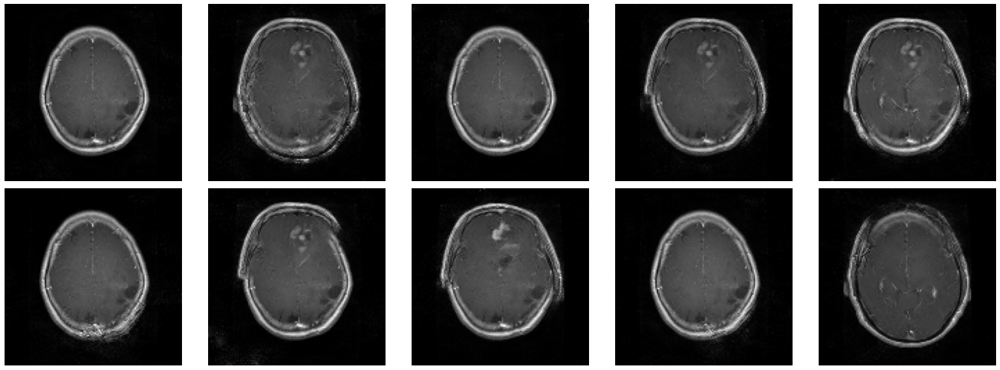

In [17]:
np.random.seed(SEED)
for epoch in range(EPOCHS):
    for batch in tqdm(range(STEPS_PER_EPOCH)):

        noise = np.random.normal(0,1, size=(BATCH_SIZE, NOISE_DIM))
        fake_X = generator.predict(noise)
        
        idx = np.random.randint(0, X_train.shape[0], size=BATCH_SIZE)
        real_X = X_train[idx]

        X = np.concatenate((real_X, fake_X))

        disc_y = np.zeros(2*BATCH_SIZE)
        disc_y[:BATCH_SIZE] = 1

        d_loss = discriminator.train_on_batch(X, disc_y)
        
        y_gen = np.ones(BATCH_SIZE)
        g_loss = gan.train_on_batch(noise, y_gen)

    print(f"EPOCH: {epoch + 1} Generator Loss: {g_loss:.4f} Discriminator Loss: {d_loss:.4f}")
    noise = np.random.normal(0, 1, size=(10,NOISE_DIM))
    sample_images(noise, (2,5))

# Generate Output images from GAN

4/4 [==============================] - 1s 41ms/step


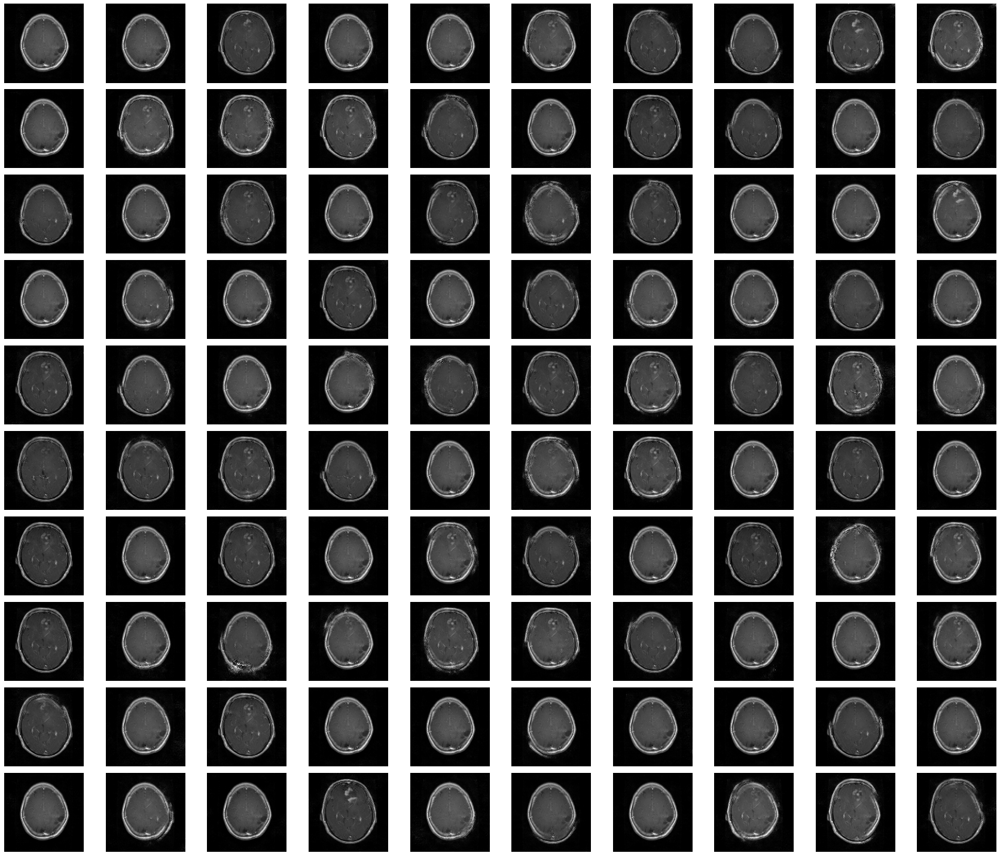

In [18]:
noise = np.random.normal(0, 1, size=(100, NOISE_DIM))
sample_images(noise, (10,10), (24,20), save=True)

# Testing the Generated sample: Plotting the Distributions

In [19]:
generated_images = generator.predict(noise)
generated_images.shape

4/4 [==============================] - 0s 74ms/step


(100, 128, 128, 1)

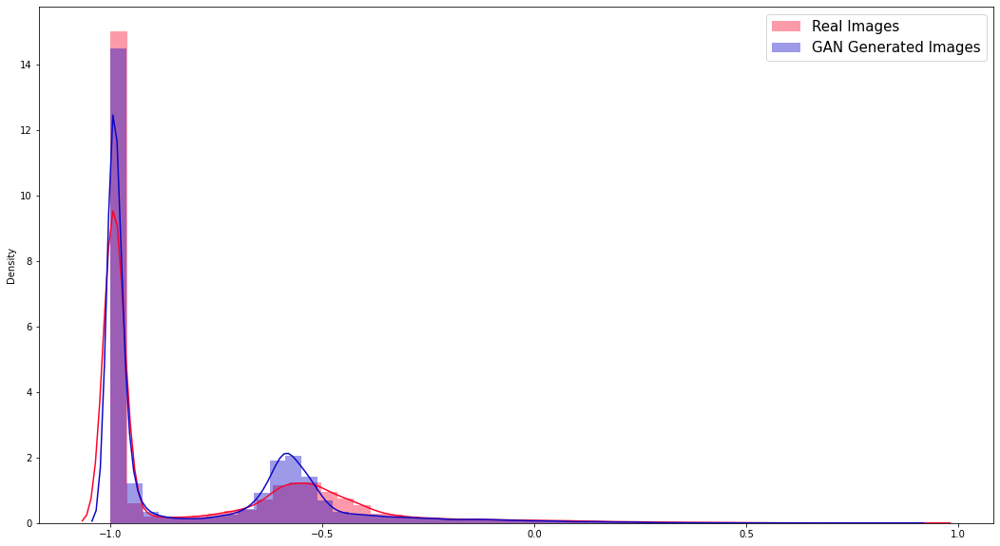

In [20]:
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(18,10))

sns.distplot(X_train, label='Real Images', hist=True, color='#fc0328', ax=axs)
sns.distplot(generated_images, label='GAN Generated Images', hist=True, color='#0c06c7', ax=axs)

axs.legend(loc='upper right', prop={'size': 15})

plt.show()



####  The distribution of generated images is similar to that of real images, as can be seen from the plot. This leads us to the conclusion that the generated photos accurately capture the majority of the variances in the genuine ones.
